# Multiclass Support Vector Machine exercise

*Complete and hand in this completed worksheet (including its outputs and any supporting code outside of the worksheet) with your assignment submission. For more details see the [assignments page](http://vision.stanford.edu/teaching/cs231n/assignments.html) on the course website.*

In this exercise you will:
    
- implement a fully-vectorized **loss function** for the SVM
- implement the fully-vectorized expression for its **analytic gradient**
- **check your implementation** using numerical gradient
- use a validation set to **tune the learning rate and regularization** strength
- **optimize** the loss function with **SGD**
- **visualize** the final learned weights


In [26]:
# Run some setup code for this notebook.

import random
import numpy as np
from cs231n.data_utils import load_CIFAR10
import matplotlib.pyplot as plt

# This is a bit of magic to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## CIFAR-10 Data Loading and Preprocessing

In [27]:
# Load the raw CIFAR-10 data.
cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)

# As a sanity check, we print out the size of the training and test data.
print 'Training data shape: ', X_train.shape
print 'Training labels shape: ', y_train.shape
print 'Test data shape: ', X_test.shape
print 'Test labels shape: ', y_test.shape

Training data shape:  (50000, 32, 32, 3)
Training labels shape:  (50000,)
Test data shape:  (10000, 32, 32, 3)
Test labels shape:  (10000,)


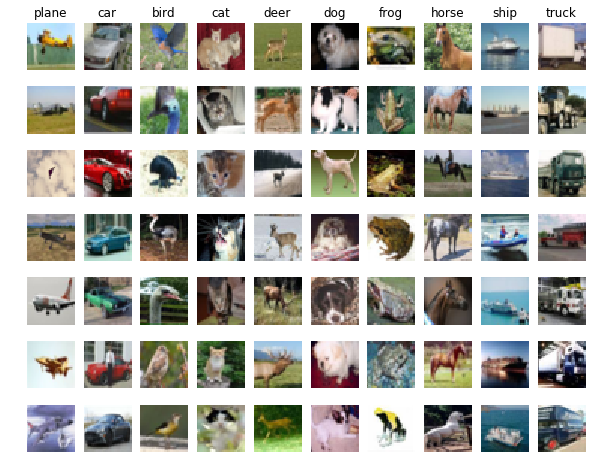

In [28]:
# Visualize some examples from the dataset.
# We show a few examples of training images from each class.
classes = ['plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
num_classes = len(classes)
samples_per_class = 7
for y, cls in enumerate(classes):
    idxs = np.flatnonzero(y_train == y)
    idxs = np.random.choice(idxs, samples_per_class, replace=False)
    for i, idx in enumerate(idxs):
        plt_idx = i * num_classes + y + 1
        plt.subplot(samples_per_class, num_classes, plt_idx)
        plt.imshow(X_train[idx].astype('uint8'))
        plt.axis('off')
        if i == 0:
            plt.title(cls)
plt.show()

In [29]:
# Split the data into train, val, and test sets. In addition we will
# create a small development set as a subset of the training data;
# we can use this for development so our code runs faster.
num_training = 49000
num_validation = 1000
num_test = 1000
num_dev = 500

# Our validation set will be num_validation points from the original
# training set.
mask = range(num_training, num_training + num_validation)
X_val = X_train[mask]
y_val = y_train[mask]

# Our training set will be the first num_train points from the original
# training set.
mask = range(num_training)
X_train = X_train[mask]
y_train = y_train[mask]

# We will also make a development set, which is a small subset of
# the training set.
mask = np.random.choice(num_training, num_dev, replace=False)
X_dev = X_train[mask]
y_dev = y_train[mask]

# We use the first num_test points of the original test set as our
# test set.
mask = range(num_test)
X_test = X_test[mask]
y_test = y_test[mask]

print 'Train data shape: ', X_train.shape
print 'Train labels shape: ', y_train.shape
print 'Validation data shape: ', X_val.shape
print 'Validation labels shape: ', y_val.shape
print 'Test data shape: ', X_test.shape
print 'Test labels shape: ', y_test.shape

Train data shape:  (49000, 32, 32, 3)
Train labels shape:  (49000,)
Validation data shape:  (1000, 32, 32, 3)
Validation labels shape:  (1000,)
Test data shape:  (1000, 32, 32, 3)
Test labels shape:  (1000,)


In [30]:
# Preprocessing: reshape the image data into rows
X_train = np.reshape(X_train, (X_train.shape[0], -1))
X_val = np.reshape(X_val, (X_val.shape[0], -1))
X_test = np.reshape(X_test, (X_test.shape[0], -1))
X_dev = np.reshape(X_dev, (X_dev.shape[0], -1))

# As a sanity check, print out the shapes of the data
print 'Training data shape: ', X_train.shape
print 'Validation data shape: ', X_val.shape
print 'Test data shape: ', X_test.shape
print 'dev data shape: ', X_dev.shape

Training data shape:  (49000, 3072)
Validation data shape:  (1000, 3072)
Test data shape:  (1000, 3072)
dev data shape:  (500, 3072)


[ 130.64189796  135.98173469  132.47391837  130.05569388  135.34804082
  131.75402041  130.96055102  136.14328571  132.47636735  131.48467347]
(3072,)


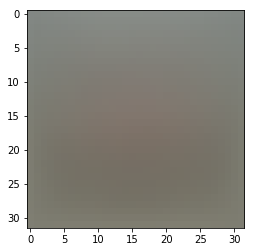

In [31]:
# Preprocessing: subtract the mean image
# first: compute the image mean based on the training data
mean_image = np.mean(X_train, axis=0)
print mean_image[:10] # print a few of the elements
print mean_image.shape
plt.figure(figsize=(4,4))
plt.imshow(mean_image.reshape((32,32,3)).astype('uint8')) # visualize the mean image
plt.show()

In [32]:
# second: subtract the mean image from train and test data
X_train -= mean_image
X_val -= mean_image
X_test -= mean_image
X_dev -= mean_image

In [33]:
# third: append the bias dimension of ones (i.e. bias trick) so that our SVM
# only has to worry about optimizing a single weight matrix W.
print X_train.shape, X_val.shape, X_test.shape, X_dev.shape

X_train = np.hstack([X_train, np.ones((X_train.shape[0], 1))])
X_val = np.hstack([X_val, np.ones((X_val.shape[0], 1))])
X_test = np.hstack([X_test, np.ones((X_test.shape[0], 1))])
X_dev = np.hstack([X_dev, np.ones((X_dev.shape[0], 1))])

print X_train.shape, X_val.shape, X_test.shape, X_dev.shape

(49000, 3072) (1000, 3072) (1000, 3072) (500, 3072)
(49000, 3073) (1000, 3073) (1000, 3073) (500, 3073)


## SVM Classifier

Your code for this section will all be written inside **cs231n/classifiers/linear_svm.py**. 

As you can see, we have prefilled the function `compute_loss_naive` which uses for loops to evaluate the multiclass SVM loss function. 

In [34]:
# Evaluate the naive implementation of the loss we provided for you:
from cs231n.classifiers.linear_svm import svm_loss_naive
import time

# generate a random SVM weight matrix of small numbers
W = np.random.randn(3073, 10) * 0.0001 

loss, grad = svm_loss_naive(W, X_dev, y_dev, 0.00001)
print 'loss: %f' % (loss,)
print(grad)

[[ -2.62085407e+01   5.57671621e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00   1.68939911e+01 ...,  -5.14483461e+00
   -6.30064860e+01  -4.73412964e+01]
 ..., 
 [ -1.04955827e+01   1.00627608e+00  -2.92875445e+00 ...,  -1.10864173e+01
    1.47842570e+01  -9.81039820e+00]
 [ -2.42687863e+01  -4.90799143e-01   4.86881629e+00 ...,   2.72878629e+00
   -5.78527371e+00  -1.05567391e+01]
 [  3.20000005e-02   2.00000104e-03   3.79999989e-02 ...,  -3.19999989e-02
   -1.71999999e-01   1.42000000e-01]]
loss: 9.371715
[[ -2.62085407e+01   5.57671621e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00   1.68939911e+01 ...,  -5.14483461e+00
   -6.

The `grad` returned from the function above is right now all zero. Derive and implement the gradient for the SVM cost function and implement it inline inside the function `svm_loss_naive`. You will find it helpful to interleave your new code inside the existing function.

To check that you have correctly implemented the gradient correctly, you can numerically estimate the gradient of the loss function and compare the numeric estimate to the gradient that you computed. We have provided code that does this for you:

In [35]:
# Once you've implemented the gradient, recompute it with the code below
# and gradient check it with the function we provided for you

# Compute the loss and its gradient at W.
loss, grad = svm_loss_naive(W, X_dev, y_dev, 0.0)

# Numerically compute the gradient along several randomly chosen dimensions, and
# compare them with your analytically computed gradient. The numbers should match
# almost exactly along all dimensions.
from cs231n.gradient_check import grad_check_sparse
f = lambda w: svm_loss_naive(w, X_dev, y_dev, 0.0)[0]
grad_numerical = grad_check_sparse(f, W, grad)

# do the gradient check once again with regularization turned on
# you didn't forget the regularization gradient did you?
loss, grad = svm_loss_naive(W, X_dev, y_dev, 1e2)
f = lambda w: svm_loss_naive(w, X_dev, y_dev, 1e2)[0]
grad_numerical = grad_check_sparse(f, W, grad)

[[ -2.62085407e+01   5.57671620e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00   1.68939911e+01 ...,  -5.14483461e+00
   -6.30064860e+01  -4.73412964e+01]
 ..., 
 [ -1.04955827e+01   1.00627608e+00  -2.92875445e+00 ...,  -1.10864173e+01
    1.47842570e+01  -9.81039820e+00]
 [ -2.42687863e+01  -4.90799143e-01   4.86881629e+00 ...,   2.72878629e+00
   -5.78527371e+00  -1.05567391e+01]
 [  3.20000000e-02   2.00000000e-03   3.80000000e-02 ...,  -3.20000000e-02
   -1.72000000e-01   1.42000000e-01]]
[[ -2.62085407e+01   5.57671620e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00   1.68939911e+01 ...,  -5.14483461e+00
   -6.30064860e+01  -

[[ -2.62085407e+01   5.57671620e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00   1.68939911e+01 ...,  -5.14483461e+00
   -6.30064860e+01  -4.73412964e+01]
 ..., 
 [ -1.04955827e+01   1.00627608e+00  -2.92875445e+00 ...,  -1.10864173e+01
    1.47842570e+01  -9.81039820e+00]
 [ -2.42687863e+01  -4.90799143e-01   4.86881629e+00 ...,   2.72878629e+00
   -5.78527371e+00  -1.05567391e+01]
 [  3.20000000e-02   2.00000000e-03   3.80000000e-02 ...,  -3.20000000e-02
   -1.72000000e-01   1.42000000e-01]]
numerical: 19.836758 analytic: 19.836758, relative error: 1.031414e-11
[[ -2.62085407e+01   5.57671620e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61

[[ -2.62161306e+01   5.59271483e+00   6.17887482e+00 ...,  -5.56671780e+00
   -3.58457519e+01  -3.39133608e+01]
 [ -3.15355220e+01   7.95951233e+00   2.69203498e+00 ...,  -4.54513959e+00
   -4.20881861e+01  -4.08873397e+01]
 [ -4.40922273e+01   9.61917801e+00   1.69118632e+01 ...,  -5.15067601e+00
   -6.30223475e+01  -4.73407563e+01]
 ..., 
 [ -1.05137539e+01   9.93315025e-01  -2.93719047e+00 ...,  -1.10814324e+01
    1.47812264e+01  -9.80555356e+00]
 [ -2.42611070e+01  -4.93982593e-01   4.86634211e+00 ...,   2.73173274e+00
   -5.78709978e+00  -1.05731732e+01]
 [  3.73056308e-02   1.24279875e-02   2.70854234e-02 ...,  -2.13276743e-02
   -1.66788091e-01   1.43988778e-01]]
[[ -2.62161306e+01   5.59271483e+00   6.17887482e+00 ...,  -5.56671780e+00
   -3.58457519e+01  -3.39133608e+01]
 [ -3.15355220e+01   7.95951233e+00   2.69203498e+00 ...,  -4.54513959e+00
   -4.20881861e+01  -4.08873397e+01]
 [ -4.40922273e+01   9.61917801e+00   1.69118632e+01 ...,  -5.15067601e+00
   -6.30223475e+01  -

[[ -2.62161306e+01   5.59271483e+00   6.17887482e+00 ...,  -5.56671780e+00
   -3.58457519e+01  -3.39133608e+01]
 [ -3.15355220e+01   7.95951233e+00   2.69203498e+00 ...,  -4.54513959e+00
   -4.20881861e+01  -4.08873397e+01]
 [ -4.40922273e+01   9.61917801e+00   1.69118632e+01 ...,  -5.15067601e+00
   -6.30223475e+01  -4.73407563e+01]
 ..., 
 [ -1.05137539e+01   9.93315025e-01  -2.93719047e+00 ...,  -1.10814324e+01
    1.47812264e+01  -9.80555356e+00]
 [ -2.42611070e+01  -4.93982593e-01   4.86634211e+00 ...,   2.73173274e+00
   -5.78709978e+00  -1.05731732e+01]
 [  3.73056308e-02   1.24279875e-02   2.70854234e-02 ...,  -2.13276743e-02
   -1.66788091e-01   1.43988778e-01]]
[[ -2.62161306e+01   5.59271483e+00   6.17887482e+00 ...,  -5.56671780e+00
   -3.58457519e+01  -3.39133608e+01]
 [ -3.15355220e+01   7.95951233e+00   2.69203498e+00 ...,  -4.54513959e+00
   -4.20881861e+01  -4.08873397e+01]
 [ -4.40922273e+01   9.61917801e+00   1.69118632e+01 ...,  -5.15067601e+00
   -6.30223475e+01  -

### Inline Question 1:
It is possible that once in a while a dimension in the gradcheck will not match exactly. What could such a discrepancy be caused by? Is it a reason for concern? What is a simple example in one dimension where a gradient check could fail? *Hint: the SVM loss function is not strictly speaking differentiable*

**Your Answer:** *in zero loss function is not differentiable so the numerical will fail to check.*

In [36]:
# Next implement the function svm_loss_vectorized; for now only compute the loss;
# we will implement the gradient in a moment.
tic = time.time()
loss_naive, grad_naive = svm_loss_naive(W, X_dev, y_dev, 0.00001)
toc = time.time()
print 'Naive loss: %e computed in %fs' % (loss_naive, toc - tic)

from cs231n.classifiers.linear_svm import svm_loss_vectorized
tic = time.time()
loss_vectorized, _ = svm_loss_vectorized(W, X_dev, y_dev, 0.00001)
toc = time.time()
print 'Vectorized loss: %e computed in %fs' % (loss_vectorized, toc - tic)

# The losses should match but your vectorized implementation should be much faster.
print 'difference: %f' % (loss_naive - loss_vectorized)

[[ -2.62085407e+01   5.57671621e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00   1.68939911e+01 ...,  -5.14483461e+00
   -6.30064860e+01  -4.73412964e+01]
 ..., 
 [ -1.04955827e+01   1.00627608e+00  -2.92875445e+00 ...,  -1.10864173e+01
    1.47842570e+01  -9.81039820e+00]
 [ -2.42687863e+01  -4.90799143e-01   4.86881629e+00 ...,   2.72878629e+00
   -5.78527371e+00  -1.05567391e+01]
 [  3.20000005e-02   2.00000104e-03   3.79999989e-02 ...,  -3.19999989e-02
   -1.71999999e-01   1.42000000e-01]]
Naive loss: 9.371715e+00 computed in 0.167077s
9.37171469896
[[ -2.62085407e+01   5.57671621e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00

In [37]:
# Complete the implementation of svm_loss_vectorized, and compute the gradient
# of the loss function in a vectorized way.

# The naive implementation and the vectorized implementation should match, but
# the vectorized version should still be much faster.
tic = time.time()
_, grad_naive = svm_loss_naive(W, X_dev, y_dev, 0.00001)
toc = time.time()
print 'Naive loss and gradient: computed in %fs' % (toc - tic)

tic = time.time()
_, grad_vectorized = svm_loss_vectorized(W, X_dev, y_dev, 0.00001)
toc = time.time()
print 'Vectorized loss and gradient: computed in %fs' % (toc - tic)

# The loss is a single number, so it is easy to compare the values computed
# by the two implementations. The gradient on the other hand is a matrix, so
# we use the Frobenius norm to compare them.
difference = np.linalg.norm(grad_naive - grad_vectorized, ord='fro')
print 'difference: %f' % difference

[[ -2.62085407e+01   5.57671621e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00   1.68939911e+01 ...,  -5.14483461e+00
   -6.30064860e+01  -4.73412964e+01]
 ..., 
 [ -1.04955827e+01   1.00627608e+00  -2.92875445e+00 ...,  -1.10864173e+01
    1.47842570e+01  -9.81039820e+00]
 [ -2.42687863e+01  -4.90799143e-01   4.86881629e+00 ...,   2.72878629e+00
   -5.78527371e+00  -1.05567391e+01]
 [  3.20000005e-02   2.00000104e-03   3.79999989e-02 ...,  -3.19999989e-02
   -1.71999999e-01   1.42000000e-01]]
Naive loss and gradient: computed in 0.167236s
9.37171469896
[[ -2.62085407e+01   5.57671621e+00   6.19360788e+00 ...,  -5.54945927e+00
   -3.58495936e+01  -3.39171495e+01]
 [ -3.15374155e+01   7.96003653e+00   2.70269408e+00 ...,  -4.55058449e+00
   -4.20991416e+01  -4.08914063e+01]
 [ -4.40631654e+01   9.61105216e+00

### Stochastic Gradient Descent

We now have vectorized and efficient expressions for the loss, the gradient and our gradient matches the numerical gradient. We are therefore ready to do SGD to minimize the loss.

In [38]:
# In the file linear_classifier.py, implement SGD in the function
# LinearClassifier.train() and then run it with the code below.
from cs231n.classifiers import LinearSVM
svm = LinearSVM()
tic = time.time()
loss_hist = svm.train(X_train, y_train, learning_rate=1e-7, reg=5e4,
                      num_iters=1500, verbose=True)
toc = time.time()
print 'That took %fs' % (toc - tic)

778.305037908
[[-43.03001649 -49.35694886  36.62299269 ...,   8.19307969 -51.26860854
  -41.42723209]
 [ 34.69406681   7.36302582 -40.98922559 ...,  -4.99327319 -99.59559543
   22.77582459]
 [ -1.76551406  24.85905061 -49.60529493 ...,  23.65537468 -59.13186641
   16.15903409]
 ..., 
 [ 96.24153301  10.35770881 -28.28214166 ..., -42.31363097  34.22982754
  -15.03107176]
 [ -3.19073067 -58.53900623  36.53668603 ...,  74.94218076  81.5603975
  -37.82257065]
 [-61.63246486 -51.19498365  22.19539642 ..., -45.69723976  10.44686334
   17.36864747]]
iteration 0 / 1500: loss 778.305038
770.833286301
[[-53.74192549 -55.1454685   21.75308722 ...,  -7.70288571 -45.86875162
  -29.08935287]
 [ 23.07539087  -0.91778471 -50.30937079 ..., -18.93330682 -98.85871338
   37.45749342]
 [-13.99661976  18.59868984 -59.18489886 ...,  12.6320978  -60.81777197
   34.99902137]
 ..., 
 [ 88.36598372  15.61851251 -30.44642116 ..., -50.83206281  32.59539595
  -29.99177517]
 [-17.44589916 -48.91328763  37.52100046 .

518.474772032
[[-29.58278983 -42.83899072  49.14951854 ...,  -9.07646252 -13.73003297
  -25.79937911]
 [ 39.63385567   7.50573378 -14.59313275 ..., -27.46099409 -51.05066127
   26.545464  ]
 [ 17.43263027  24.59934587 -22.16479564 ..., -13.98264468  -9.26785333
   25.22795288]
 ..., 
 [ 95.06434523   9.79358417 -22.3006354  ..., -55.51145301  20.62319818
  -23.3984155 ]
 [ 11.48603735 -47.72616067  34.61478935 ...,  33.07889314  69.07954926
  -41.21726041]
 [-50.52900455 -42.07350573  18.13937537 ..., -37.28240908   8.73889384
   14.1620276 ]]
513.523493662
[[ -36.30035037  -46.35702495   42.81637167 ...,  -13.65077582   -6.6752324
   -23.27501068]
 [  34.44025271    1.91156124  -26.22824923 ...,  -30.36969371
   -54.48070491   28.87801066]
 [  11.12698753   18.33900179  -39.98873309 ...,  -14.92666594
   -24.41407773   33.23470434]
 ..., 
 [ 101.18353371   14.11719257   -9.53463794 ...,  -60.76148799
    37.29005035  -23.84435281]
 [  24.50371431  -43.93156844   38.80476041 ...,   29.

[[-17.33861631 -23.5390605   29.73680918 ..., -20.43630111 -10.39670957
  -20.18076091]
 [ 37.055783    18.0200863  -23.70802993 ..., -31.11664143 -39.59874271
   22.84973527]
 [ 18.27825774  35.04217162 -23.57211767 ..., -21.12289864  -4.29953889
   19.51697681]
 ..., 
 [ 75.75670388  21.82964705 -17.83720422 ..., -66.78649681  24.94575741
  -19.97315819]
 [  9.29198494 -26.00030987  32.5899305  ...,   5.60826427  59.97442234
  -35.27445796]
 [-42.2182303  -34.88623315  14.84075033 ..., -31.26456499   7.19454729
   11.94392619]]
357.795341062
[[-15.19722762 -46.66879581  32.58352799 ..., -23.50547144 -22.10688806
   -6.98745782]
 [ 45.59150868  -8.60549373 -19.38181835 ..., -35.509597   -51.7111143
   37.86356874]
 [ 27.15580095   8.21413627 -22.08330279 ..., -19.43519762 -20.46356282
   37.78415336]
 ..., 
 [ 96.23551261  -4.16091343 -15.87004105 ..., -55.22152106  18.11826781
   -7.63778668]
 [ 29.81354859 -51.2854369   29.57416084 ...,  20.64325724  53.98254165
  -20.98113067]
 [-4

228.783990874
[[-18.10561903 -23.43836456  35.35098224 ...,  -3.58076221   3.46239601
  -29.85780537]
 [ 29.12025542  11.76647144  -8.08724515 ..., -13.21935389 -22.56182643
    6.46196081]
 [ 18.8404689   27.17515521 -12.13158625 ...,   0.90767431   4.71658473
   -0.98271183]
 ..., 
 [ 61.18474404  16.32091054  -6.5606424  ..., -45.31456847  15.81153316
  -16.72524523]
 [ 12.81141696 -20.98051979  25.99032807 ...,  18.99552376  43.28518047
  -30.73282594]
 [-33.4422036  -27.9433891   11.86632364 ..., -24.76022539   5.7287447
    9.22012692]]
226.848756551
[[-28.08009094 -24.51850488  22.30412437 ...,   5.23720874  -9.30096342
   -8.06172584]
 [ 17.90965414   6.81083552 -22.93696862 ...,  -7.52197855 -32.09856066
   29.27974234]
 [  5.33126655  18.13134372 -23.27151669 ...,   6.46496165  -2.14884615
   25.96983214]
 ..., 
 [ 56.71882032  13.79346313  -7.37125837 ..., -39.89333277  22.28092652
   -2.8909288 ]
 [  3.85235987 -22.38554219  27.99449    ...,  21.08257614  54.43376528
  -14.

144.619147715
[[-24.74635339 -23.29793619  -0.81818524 ...,  -4.29207125  -2.4540202
    1.3123814 ]
 [ 11.69269858  -0.8780457  -37.532457   ..., -10.93024439 -22.23496257
   30.29444844]
 [  0.68304912   8.5992088  -36.5266837  ...,   1.43388249  -0.11174224
   27.42472208]
 ..., 
 [ 42.82760348  13.97500058 -31.19501782 ..., -25.15456568  20.94145014
    3.02385733]
 [  4.17196251 -17.28932969   2.27260523 ...,  20.8431864   43.62441206
   -4.30525946]
 [-26.4693388  -22.37187683   9.45814744 ..., -19.62747553   4.56583573
    7.65324295]]
144.253871738
[[ -7.96985081 -28.53732834   9.49499252 ..., -17.92895467   0.20331704
   -9.00640969]
 [ 23.49259121  -3.87824424 -18.44178094 ..., -26.41305898 -20.91750919
   20.08633232]
 [ 11.71228653   6.32107928 -21.61724681 ..., -15.37430795  -3.15935782
   22.88025112]
 ..., 
 [ 47.65104179   9.13880885  -0.87126599 ..., -47.59242836   1.77140575
  -20.46368563]
 [  5.58706413 -20.30563876  27.92031291 ...,   1.62291262  26.39332
  -29.542

[[-17.33484414 -23.0390634   29.80885167 ...,  28.85573109   5.13401194
  -25.45299057]
 [ 16.27154062  -4.6852256   -2.69258884 ...,  25.0811879  -13.20565523
    0.57979432]
 [  6.01502545   1.48858228  -7.20378769 ...,  31.99953909   1.78408131
   11.80502534]
 ..., 
 [ 27.14303112  14.22464458 -11.31400175 ..., -20.35759931  19.92638873
  -13.00109757]
 [ -5.94571842  -7.69622051  12.87487597 ...,  12.53841482  38.86648567
  -17.05211413]
 [-21.26326055 -17.48022265   7.62919423 ..., -15.83077038   3.56606957
    5.99159003]]
93.3640866675
[[-25.84421737 -17.17596298   8.72852271 ...,  15.69516774  -9.21091505
   -2.93758327]
 [  0.89563955  -0.14588621 -18.5663861  ...,  10.34852176 -20.914079
   25.67052545]
 [-11.02189763   5.88244345 -26.35385651 ...,  13.12345364   0.95594336
   27.29654409]
 ..., 
 [ 34.57576698  15.41042339  -2.17172562 ..., -26.97510519  -1.29910199
   -2.08644514]
 [  1.49902088 -14.53771797  19.43056587 ...,   8.69578703  16.9101661
   -8.0718857 ]
 [-21.

[[-15.63420196  -7.21724855  23.51312082 ..., -13.08216891   1.49957324
  -11.12122889]
 [  2.4989695    7.05563745  -0.59710337 ..., -21.26188411  -9.07179305
   10.0269426 ]
 [ -7.41371368   9.21667755   7.532196   ..., -18.4698396    7.34023112
    8.95563497]
 ..., 
 [ 22.83647794  21.41985824 -12.62960182 ..., -25.49633003   3.08980627
    0.12381308]
 [ -6.7197655    3.05702856   7.31296718 ...,   9.46274184  19.91070165
   -5.83171282]
 [-16.65074904 -14.22429014   6.01944023 ..., -12.68414333   3.01652584
    4.8366827 ]]
60.96204971
[[ -3.48437473 -10.35410322   9.41177277 ..., -12.92743399  12.24849435
  -15.78987968]
 [ 19.93400884   2.96056488 -13.31313622 ..., -12.80984407  -1.00661674
    0.78735584]
 [  7.96233387   9.54552743 -12.00120294 ...,  -4.31644714  11.31326915
    1.71663924]
 ..., 
 [ 22.37866004   6.66210058  -1.69682279 ..., -27.74332675  15.24297683
   -5.50766477]
 [ -5.76722453 -12.94713444  20.62430805 ...,   5.29944528  33.06514385
  -12.6995414 ]
 [-16

[[ -3.00648819  -7.31329413  17.12085471 ...,  -8.96932631 -11.63191679
   -9.05793375]
 [ 12.68457737   2.82576224  -3.09733774 ..., -15.67764797 -20.41229705
    6.77408331]
 [  6.05853037   5.19397953 -12.88057768 ..., -11.42473099  -7.35794541
   10.53760628]
 ..., 
 [ 19.96133381  -0.47980148  -0.42167621 ...,  -5.47216039  10.93675456
   -6.46750906]
 [  0.34767266 -20.33354463  13.24350091 ...,  18.42781297  23.50856628
   -9.01357906]
 [-13.43050912 -10.97774255   4.68667674 ...,  -9.92987443   2.20860561
    3.79739899]]
39.8637651134
[[-10.67855065 -31.66409113  -4.65647293 ...,   7.83139767   7.8499581
   11.49043112]
 [  4.90706775 -19.0375676  -20.5906638  ...,   7.24384537  -1.65249576
   26.56756442]
 [ -2.0804582  -13.39798915 -29.89197949 ...,  14.90182655  11.04775656
   33.21363641]
 ..., 
 [ 28.74342918 -10.91915186 -18.05559518 ...,  -3.35133265  -0.8972231
   -9.92018743]
 [ 15.37595573 -26.54997548  -7.07368873 ...,  19.25774676  10.70608773
  -12.31057331]
 [-13

[[ -2.05379673 -14.7159681   13.54501146 ...,  19.44752886 -10.30144592
  -20.52129842]
 [  9.16861839  -1.8765411    0.02847373 ...,  15.22756956 -19.19262803
  -10.99461675]
 [  2.13248146   0.8061087   -1.33367104 ...,  21.77974568 -13.04678229
   -8.27991823]
 ..., 
 [ 10.63702127   1.27796091  -8.21045876 ..., -13.36868526   5.90287882
   -9.98970704]
 [ -4.36103421  -5.38301032   6.78078377 ...,   4.84725334  12.66778414
  -14.51086595]
 [-10.37334761  -8.57534614   3.95709671 ...,  -7.95551551   1.75974932
    3.02823672]]
27.1632069489
[[-20.06626275   5.28166725   7.84759079 ...,  20.52893938  -1.24227083
    0.14326868]
 [ -6.3266997   17.76845793  -3.24267323 ...,  16.86789293  -9.61346846
    9.35688593]
 [ -8.32707095  18.03581856  -4.70093717 ...,  23.19793348  -2.54448409
    7.00652585]
 ..., 
 [  6.53001616  20.00844131  -3.75199871 ..., -14.35579857   5.90252157
   -6.73098626]
 [ -7.30633404   4.85480188   7.01385628 ...,  -0.95894864  15.85952022
   -8.57239305]
 [-

19.0292350336
[[-11.26152966 -16.72195636  -0.79152644 ...,  22.97192133  -6.88439335
  -22.08294484]
 [  4.90666482  -8.5841145   -9.62213186 ...,  20.25197884 -11.6351073
  -13.15692776]
 [  1.14213138  -4.44648535  -3.59878918 ...,  25.03508908 -10.45379593
  -15.16544735]
 ..., 
 [ 26.47859915  -2.38106006 -10.58386181 ..., -13.36869298  -2.70544549
   -1.90642103]
 [ 11.69955897 -12.59352912   1.50281711 ...,   4.05023432  -1.92997486
   -5.67665206]
 [ -8.41746295  -6.66495714   2.91607443 ...,  -6.38728975   1.1831145
    2.42626582]]
19.3727868543
[[ -4.60816293   0.54773669  -7.71709431 ...,  -5.12834563  -5.81358822
  -10.24215859]
 [  6.6623371    7.17723056 -18.08858753 ...,  -8.03343616 -10.55599554
   -2.42086914]
 [  6.73635399   7.16135768 -21.43731565 ..., -10.96674024  -6.57055042
    1.43827111]
 ..., 
 [ 16.83554779   8.60115054  -2.0304527  ..., -20.96267645  -4.757055
    5.77518169]
 [  1.20218332  -2.61671576   3.98519588 ...,  -7.16287971   4.8098143
    2.4407

13.9840776156
[[ -0.22280657   7.63317168  -8.90624242 ...,  -1.96619922  -4.61990021
    4.5100267 ]
 [  8.28278597  12.10148881 -26.36359261 ...,  -2.38389344 -10.98886672
   15.13084386]
 [  0.92628208  14.94025372 -24.32834574 ...,   0.36432841  -6.39384727
   17.34046199]
 ..., 
 [ 17.23512116  12.69454068  -2.18587555 ...,   0.77761516   5.11734159
   -4.33493309]
 [  3.91829456   4.45915975  15.92328108 ...,  10.78911478  11.9763632
   -5.51610027]
 [ -6.74280535  -5.5465696    2.22390342 ...,  -4.83902474   1.32150158
    1.8651089 ]]
13.9441720723
[[ -2.86855019   2.67895837  -2.85985355 ...,  -6.98728138   7.18978838
   -2.3071519 ]
 [  2.79000215   7.01643799  -0.98040475 ...,  -8.0989602    0.44733323
    3.79046362]
 [ -8.05780546  11.40870449   2.74775211 ...,  -4.81568977   4.16027523
    2.88665091]
 ..., 
 [  6.17859249  -1.145481    -0.52459311 ..., -16.32349618   8.52845652
    5.66881219]
 [ -3.63632905  -4.86312533   7.38869681 ...,  -5.45576008  11.68339353
    6.

10.2058544009
[[ -8.34008948  -8.55892011  -2.87987355 ...,   5.10854947 -16.0603255
    4.44570617]
 [ -1.37342802  -0.993404    -8.7738904  ...,   4.44150107 -18.18450906
    8.50087066]
 [ -9.4986357   -3.43941707  -9.54356818 ...,   6.26500339 -14.64861356
   11.16895918]
 ..., 
 [  7.18771887   0.20561538 -11.27964723 ..., -15.11172818  -5.76135814
    0.82109594]
 [ -6.4536453   -2.23147297  -8.37378537 ...,   1.24488339  -0.32571866
   -0.5651058 ]
 [ -5.23843028  -4.42954503   1.95917889 ...,  -4.1725757    0.88350809
    1.56093722]]
11.0650875468
[[ -2.04778026  18.28870439   9.58057327 ...,   6.61557162 -16.82928081
  -26.56803981]
 [ 10.00642994  21.37512475   7.54452242 ...,   5.2973303  -21.96303856
  -17.20512706]
 [ 14.2759885   18.53536594  10.62099762 ...,   4.99015429 -14.83458805
  -16.23651357]
 ..., 
 [ 26.76659578  14.94150526 -23.63670001 ..., -10.69043158  -9.26341012
   -8.89719852]
 [ 20.11757579  10.56676797 -18.05692716 ...,  -0.97215245  -1.58607721
  -12.

8.63920300145
[[  1.11699096  -6.53892486  -3.80391394 ..., -19.11230455  -3.95764491
   -5.34980678]
 [  9.71025102  -2.64112416  -3.05419351 ..., -22.15220693  -7.7612851
    2.977136  ]
 [  7.22779024  -1.90942237  -4.89196987 ..., -25.64815144  -5.02498748
   11.6509783 ]
 ..., 
 [  0.57387512   0.09532895  12.32843381 ...,  -1.96974797  12.98680089
    5.8462178 ]
 [ -9.33684594  -5.00702794  19.63846918 ...,   4.95916611  17.77153185
    6.72201109]
 [ -4.13364523  -3.59007092   1.47516854 ...,  -3.08938145   0.75949964
    1.00109323]]
8.86370696215
[[ -9.26788226  -1.34950687  -4.71310386 ...,  11.58437157   1.18677179
  -18.15390376]
 [ -1.55514973   1.56089422  -6.51883122 ...,  12.13937605  -1.59275265
   -9.37345733]
 [ -4.38062932  -0.60407057 -12.09987961 ...,  18.99376299   6.52224623
   -8.10864741]
 ..., 
 [  5.90424044  19.16587965  -6.26251815 ...,   1.64131261   0.06479628
  -10.0905737 ]
 [ -1.96032243  14.03897934  -5.87172103 ...,  12.80138957   4.83866776
   -6.

[[-26.7823409  -11.49756418  16.59420401 ...,  -5.81043769  13.90595076
    3.73616747]
 [-19.10997963  -6.79110966  13.50607931 ...,  -1.14672641   6.41452687
    4.6594353 ]
 [-19.78859414  -5.30005005  10.97330574 ...,   6.37128182   4.68391025
    7.11878248]
 ..., 
 [ -3.55582335   3.71404341   9.56243859 ...,  -8.65469626   6.54018861
   -5.4251933 ]
 [ -6.73188937  -0.4092067    5.55652361 ...,  -3.31513178  10.65762873
   -4.59680587]
 [ -3.64077887  -2.74276259   1.30433884 ...,  -2.66285805   0.64560462
    0.86331665]]
7.45431254635
[[-10.81130297  -1.48419902 -12.94538741 ...,  15.67388307  -0.48067389
   -2.24214183]
 [ -4.19794555   2.89595099 -25.10010414 ...,   9.66412151  -3.3766325
    3.7014121 ]
 [  0.29210781   5.86088408 -23.22177711 ...,   5.21172827  -2.49820522
    5.45607979]
 ..., 
 [ -0.26403974  12.53894013  -8.68798177 ...,  -0.51277135  -2.99561029
    0.14400328]
 [ -9.06507778  11.2649122   -4.66634472 ...,   1.79956388   0.36436201
    3.68018459]
 [ -

[[  3.20911025   6.59852653   1.02570766 ...,   1.66678818 -11.8681004
    4.89619192]
 [  9.25104321   9.72901164  -6.91784204 ...,  -1.59558948 -12.90855828
    8.45330855]
 [  4.80581344   9.016068   -17.83484651 ...,  -0.71886374 -13.4283269
   12.38538595]
 ..., 
 [ 23.78106871   9.16180537  -1.744694   ...,  -5.94178709  -1.27089277
   -4.65024775]
 [ 20.9725707    4.33785757   3.41228914 ...,  -7.5423129   -1.55229734
   -6.24546414]
 [ -2.68366808  -2.02264205   0.65954862 ...,  -1.94357766   0.41581901
    0.72125839]]
7.28678094528
[[  1.15493136e+01  -1.53318140e+00  -1.62622588e+01 ...,   3.09107864e+01
   -2.03652623e-03  -7.77105986e+00]
 [  9.93316707e+00   1.85762678e+00  -2.43928875e+01 ...,   3.03291920e+01
    6.41979727e+00  -7.82231412e+00]
 [  6.07410947e+00   5.04207542e+00  -1.60701506e+01 ...,   3.42626663e+01
    1.13596194e+01  -1.30041936e+01]
 ..., 
 [  1.29427009e+01  -2.54470978e+00   6.11790281e-01 ...,  -1.55612353e+01
   -6.41851095e+00  -5.80957284e+0

6.49929949588
[[  0.53834157   7.77945109   4.40749944 ...,   9.38155237 -10.74151081
   -3.02908446]
 [  4.18349188   9.99849765   0.61793502 ...,   9.38417768 -12.36447043
    2.83288029]
 [  7.4273213   10.38340471  -4.42327182 ...,  16.89279183 -12.44297597
    4.13399778]
 ..., 
 [ -2.94141736   5.07926358  -4.05408366 ...,   9.29163814  -5.42324736
  -11.43983023]
 [ -3.37220234   0.5552729   -2.11695838 ...,   9.89065128  -2.20593068
  -11.94208105]
 [ -1.83365198  -1.76791237   0.68688849 ...,  -1.69011084   0.11145559
    0.62758215]]
6.0652163067
[[ 12.76328639   7.00099251 -37.69791765 ...,  21.82630083 -11.93087846
    2.11785147]
 [ 13.7033734    8.49505771 -36.94650159 ...,  24.24479098 -17.39499961
    4.77380722]
 [  8.20918592   3.88120463 -30.37593914 ...,  26.12230685 -17.09947926
    3.4209582 ]
 ..., 
 [  2.77654034  22.72060073 -11.76120508 ..., -19.16845556 -13.2661152
    5.35305913]
 [ -4.9134399   24.03353297  -1.06628788 ..., -23.60485983 -13.30283888
    6.5

    0.43709725]]
6.04001175118
[[  5.68432352e+00  -3.88931073e+00   2.08907592e+00 ...,   7.10589117e+00
   -4.52993593e-01   1.47738564e+00]
 [  6.48871674e+00  -9.85481057e-01   7.30784258e-03 ...,   5.94153902e+00
   -4.16871343e-01   5.36285700e+00]
 [  1.10656837e+00   1.75518021e-01  -5.67263894e+00 ...,   1.29508376e+01
    4.05495648e+00   9.53139087e+00]
 ..., 
 [  8.68808893e+00  -1.40310462e+01   5.62182196e+00 ...,  -3.16023132e-01
    1.10561027e+01  -4.09187494e+00]
 [  8.64747267e+00  -1.56730049e+01  -3.64547184e+00 ...,   1.11225616e+01
    1.37112609e+01  -6.69982497e+00]
 [ -1.90671575e+00  -1.33010293e+00   7.63399795e-01 ...,  -1.62900907e+00
    3.63702298e-01   6.24911762e-01]]
5.99994616526
[[ 14.00647487   1.98625041   1.45092686 ...,   8.68964998 -10.31893812
   -9.95699323]
 [ 14.69538285   6.67026829   0.91019375 ...,   5.63368081 -13.34969566
   -5.02788432]
 [  8.6694039    6.5033141   -2.17010268 ...,   0.55836401 -12.90268789
   -3.20437363]
 ..., 
 [  

5.98519295294
[[  6.69512448 -12.35345969  -3.69323647 ...,   0.04956844 -10.59005298
   -7.64263395]
 [  9.52390644 -11.06271155  -3.3489387  ...,  -4.47790358 -10.03298488
   -3.7356257 ]
 [  6.60876464 -20.05510561   0.41616672 ...,  -1.68808152  -7.8028602
   -6.27443974]
 ..., 
 [ 13.51787225  -2.46860836  11.74249977 ...,  -4.18663944   0.92083206
    2.96955848]
 [  7.86903532  -4.79597571  18.91224743 ...,  -3.07236462  -0.03219704
    0.88422324]
 [ -1.28511501  -1.32983664   0.63370007 ...,  -0.9997894    0.19250722
    0.45624735]]
5.56745300834
[[ -0.63872267 -18.34642382  21.86161737 ...,  -3.72943052  -4.34815016
    6.00760697]
 [ -2.75398707 -18.34728371  24.73022589 ...,  -2.54213498  -0.68236332
    5.99086059]
 [ -4.83217041 -16.88752723  23.23076201 ...,   2.50768399   1.70930614
    5.34880266]
 ..., 
 [-11.72178773   0.19238611  15.73150034 ..., -11.66516869  -9.95032108
   16.15314579]
 [-15.11431629   4.04112417  24.48850833 ...,  -7.33092351  -5.81202534
   13.

[[ -5.26966309 -15.77076754  20.40802843 ...,  27.24871357  -8.12281743
    2.50894293]
 [ -4.67603502 -14.8119078   21.23801931 ...,  24.4571142   -9.67309681
    5.96361094]
 [ -5.05300813 -13.6179881   27.50364615 ...,  28.83434103  -8.32333198
    6.74819246]
 ..., 
 [ -1.5607426   -2.35071759  23.80314039 ..., -17.14009988 -11.00874496
    2.9773488 ]
 [ -5.64214433  -6.00114631  26.22944558 ...,  -4.01962243  -3.58989394
    2.73385996]
 [ -0.97854283  -0.89063694   0.42506529 ...,  -1.03368255   0.32911735
    0.38104925]]
5.09748325727
[[  6.29205675  -0.48056187  11.08254156 ...,  -2.60472786  -9.31247192
    8.09575811]
 [  2.63261913   0.90069051  11.09920371 ...,  -4.9844178   -8.57484561
    6.54340462]
 [  1.15014814  -0.80698469  11.58951853 ...,  -0.29911496 -11.02401818
    7.25925741]
 ..., 
 [ -6.92086828   3.46499274  -9.35293    ...,  -3.84091653   9.05264734
  -10.54325998]
 [-10.99992718   4.63082513 -11.76364593 ...,   1.67961068   8.57993553
  -11.62693576]
 [ 

5.57923208813
[[ -5.75093305 -10.64857808  14.19469242 ...,  -3.75164133 -11.04502657
   15.7370188 ]
 [ -3.90129754 -11.19003394   8.18463352 ..., -12.47268356  -7.956491
   22.04457019]
 [ -4.5736959  -10.08464378   5.67092944 ..., -13.36626094  -4.13105148
   23.30836002]
 ..., 
 [  3.04090272  -1.31523315  -2.59650468 ..., -14.25814683  -1.61063758
    4.20592866]
 [  1.9817834   -1.39376769  -0.76222833 ...,  -8.1549868   -0.65809539
    1.2681615 ]
 [ -0.89062552  -0.84130656   0.48006834 ...,  -0.44504635   0.11208669
    0.14436229]]
5.28651026074
[[ -3.02272001   6.87010348  15.8602409  ...,  -5.46240863   1.24050295
    0.07816361]
 [ -3.7635033    5.93246878   3.97368739 ...,  -7.11988647   0.10228686
    2.90290907]
 [ -0.71113272  -0.36450362   7.40290235 ...,  -5.09095004   1.47066928
    5.73940414]
 ..., 
 [ -1.52945445   5.33307649  -3.58148338 ...,  11.3136337    0.70982336
   -2.33818302]
 [ -5.38504838  -0.08076242  -1.12853504 ...,  10.18068099   0.78217151
    0.8

5.33403152114
[[ -1.26683718 -17.45850618   8.65870018 ...,  11.71466076  -0.34964799
   -1.54109926]
 [ -3.78236371 -16.60104142   8.348507   ...,  15.95660717   1.8349358
    1.08332136]
 [-12.56847886 -17.62681388  11.05902889 ...,  18.15112799   7.28182951
    3.68949674]
 ..., 
 [  0.23004273  -0.20934984   6.83515294 ...,  -6.48587269  -1.50112215
    2.81923775]
 [ -2.88628081   5.53230178   5.44281146 ...,  -3.64655701   0.82655024
    2.19986917]
 [ -0.7044319   -0.66075382   0.02220044 ...,  -0.51741249   0.35500781
    0.3863027 ]]
4.95646470074
[[  6.31486854   3.08895645  13.01790444 ...,  -2.45452132  -3.13033036
   -0.54575724]
 [  5.06682209   2.84840205  14.13852263 ...,  -4.67116668  -1.22471847
    6.57370373]
 [  0.53725476   2.84373427  16.36838395 ..., -10.96175867   1.84259587
    5.82505048]
 ..., 
 [  2.12596312  -8.92522105   1.63705227 ...,  -3.68825884  -0.57502879
   12.91839217]
 [ -3.12284298 -16.0824433    2.61775597 ...,  -2.21727708   3.05728892
   11.

[[  5.71815774 -10.54172491   2.10761742 ..., -22.29790863  -1.48997844
   -0.82373282]
 [  7.62628883  -5.56175112  -2.50588778 ..., -21.17950903  -2.94351123
    2.21669094]
 [  4.14197021 -10.45457776   1.46686605 ..., -22.05973326   0.5823552
    9.29966516]
 ..., 
 [  9.01847235  -0.56941453  -7.54227758 ...,   4.99287032  -3.88563438
   -0.94141232]
 [  1.56656231  -5.55084865  -0.37100403 ...,  -0.72176868  -2.04008392
    0.79837979]
 [ -0.68610597  -0.85195896   0.61479072 ...,  -0.61157196   0.1261252
    0.39909943]]
5.5345666433
[[ -3.00962285e+00  -5.43376186e-01   1.86218466e+01 ...,  -6.66996878e+00
   -8.06327161e+00  -3.53099732e+00]
 [  5.37498392e+00  -2.25855410e+00   9.15040849e+00 ...,  -5.01139669e+00
   -6.11434163e+00  -2.10032874e+00]
 [  1.17788685e+01  -3.26211079e+00   5.00099152e+00 ...,  -4.97663235e+00
   -5.39633902e+00   4.77190299e-01]
 ..., 
 [ -8.24281593e+00   2.74154583e-01   5.19053870e+00 ...,  -6.35256791e+00
   -1.24753474e+01  -3.53656853e+00

[[  1.45155257e+01   3.99803621e+00   6.53913610e+00 ...,   1.89809631e+00
   -2.11308660e+01   1.41924531e+00]
 [  1.11689318e+01   1.73491369e+00   3.96238931e+00 ...,   4.01531983e+00
   -1.81747164e+01   1.73225016e+00]
 [  1.20177325e+01   6.88576161e+00  -2.16951586e+00 ...,   1.90807174e+00
   -1.62559255e+01  -3.19025398e+00]
 ..., 
 [  1.26313984e+00   5.01335921e+00   1.99961763e+01 ...,  -7.21350954e+00
   -1.51712016e+01  -7.94148652e+00]
 [  1.86350387e+00   5.47962060e+00   1.56294874e+01 ...,  -6.63543759e+00
   -1.63610139e+01  -1.00217023e+01]
 [ -4.78752128e-01  -3.88344951e-01   2.68828308e-01 ...,  -2.25165800e-01
    7.65705715e-03   1.25492295e-01]]
5.87220309067
[[-15.3898899   -0.7444204    2.59637328 ..., -17.6946708    4.73776058
    2.10295929]
 [ -3.41154758  -5.49312159   4.60129879 ..., -19.75594401   3.26834905
    1.67041544]
 [ -6.42683451 -10.98525434   5.474506   ..., -17.92566392   4.18348393
    4.99330545]
 ..., 
 [ 22.07458496   2.98312384  18.801

5.24983530513
[[-12.77020606  -9.91205727  17.24752073 ...,   2.85007088   0.30819589
   -1.04140885]
 [-11.41166628 -10.63079613  18.16121436 ...,   2.2921273   -2.0431969
    4.57887673]
 [ -9.1537572  -12.23114333  20.51960916 ...,   3.16716299  -7.01423516
    4.23265032]
 ..., 
 [ -4.42556067   2.15456766  10.02316005 ...,  -0.71369675   0.36038571
   -2.33796775]
 [ -1.1583365    2.96124425   6.28600408 ...,  -3.16955212  -1.88389529
   -2.9834369 ]
 [ -0.26539462  -0.38977983   0.15701334 ...,  -0.07635553  -0.02931717
    0.06720459]]
5.41056159211
[[ -7.04605065e+00   1.97844278e+01   3.56682476e+00 ...,  -1.79711591e+00
    1.63503031e+01  -8.07120181e+00]
 [ -1.20706125e+01   1.80850063e+01   3.68212053e+00 ...,   2.19235595e+00
    1.85434803e+01  -8.65901765e+00]
 [ -1.57819229e+01   2.22812942e+01  -2.57768358e+00 ...,   1.16869600e+01
    1.85629225e+01  -1.08535129e+01]
 ..., 
 [ -3.11102511e+00   2.44381074e+00  -1.54068031e+01 ...,   6.49706316e+00
    1.84496270e+01 

4.77699906232
[[  9.62117950e+00  -1.86353531e+01  -1.88226988e+00 ...,  -1.13831878e+01
    3.75091855e-02   1.52787274e+01]
 [  5.18835028e+00  -1.51988491e+01  -1.09146732e+01 ...,  -1.24094956e+01
    1.09943244e-01   1.85558589e+01]
 [ -1.71514070e+00  -1.08365167e+01  -8.37699634e+00 ...,  -8.31779685e+00
   -1.60722242e+00   2.11050756e+01]
 ..., 
 [ -1.67418975e+01  -3.52405905e+00  -1.24390939e+01 ...,   1.31460697e+01
    6.72449879e+00   1.67112021e+01]
 [ -1.94004512e+01  -2.39717214e+00  -1.54949345e+01 ...,   1.00725419e+01
    5.88688827e+00   1.63100842e+01]
 [ -5.42295206e-01  -3.32467421e-01   2.99804234e-01 ...,  -4.09310655e-01
   -4.04932034e-03   2.39901998e-01]]
5.94924039323
[[ -7.30574467  -9.73802238 -17.83336435 ...,  -3.85052881   4.30813184
    4.26047611]
 [ -1.80549096  -9.14356251 -16.23793091 ...,  -4.57190018   4.35622006
    4.32670968]
 [  2.90893439 -11.43370495 -15.79665401 ...,  -1.99542541   4.25342186
    2.13009405]
 ..., 
 [ 10.99268667  -8.43

4.80661613384
[[ 18.81980488   4.55295232  -5.45520358 ..., -15.07896811  16.81178441
   -7.52224982]
 [ 16.3635772    6.34469672  -4.55256097 ..., -10.74797729  13.46986715
   -3.51679807]
 [ 16.34689038   4.68277042  -3.78768023 ..., -11.76146083   9.68360363
   -1.03435971]
 ..., 
 [  5.44646678   8.92891802 -13.5604779  ...,  -9.02077883  12.06272314
   -8.8087262 ]
 [  7.22375155   5.38283056 -10.90565891 ..., -18.24988043  12.15348056
   -7.12922616]
 [ -0.15873624  -0.10091825   0.30496472 ...,  -0.31792173  -0.10996757
    0.27784082]]
5.36578650951
[[ -8.849697   -19.52690734  10.47477612 ...,  -7.98330469   1.81366998
   10.62360673]
 [ -3.60591211 -17.7111135    7.31227939 ...,  -4.48912312   3.68690149
   10.94457572]
 [  1.62420164 -17.67933935  18.45208511 ...,  -3.26035067   2.0714452
    9.96694433]
 ..., 
 [  9.5862573  -13.25382453  24.99023796 ...,  -6.1920235    5.43553932
  -11.90661645]
 [ 14.39545279 -13.56406217  24.56780081 ...,  -5.63051103   5.64181601
  -13.

5.35702662389
[[-11.81757544  -0.24477678  15.77353195 ...,  15.03712071  -8.81881751
  -11.30961598]
 [  2.61861779  -2.85123275  10.6981437  ...,   9.4067013   -7.10551457
  -10.04895181]
 [ 10.36895918  -7.86294334  12.95921872 ...,   3.70361598   0.05637397
   -8.02336903]
 ..., 
 [  4.01213802 -13.85925211  10.43799843 ...,  -3.13236848  -2.37653278
   -5.27898858]
 [  7.28662768  -6.38772906  10.77965312 ...,  -2.92595014   2.53350824
  -10.1868729 ]
 [ -0.29817475  -0.36902146   0.30985559 ...,  -0.2499211    0.08522703
    0.10068284]]
5.164429667
[[ 16.36282846   2.33219017   5.45919429 ...,  -6.25786346  -4.42996066
   -2.82138035]
 [ 15.42018236  -0.74642862   2.24570298 ...,  -6.7014965   -6.17270384
   -1.55377542]
 [ 15.6612652    0.05215382   9.94164262 ..., -12.89942496  -8.3531477
   -2.04121014]
 ..., 
 [ 10.14727774  -1.67081462   8.80816844 ..., -12.15271807  -7.24239501
   -9.86532262]
 [ 12.56330383  -6.07277756   9.44154485 ..., -17.41023038  -4.80410573
   -9.53

4.82748620296
[[ -7.10519889e+00  -3.13118732e+00   1.63492351e+01 ...,  -2.19825834e+00
   -1.19305740e+01  -6.03394462e+00]
 [ -4.86455558e+00  -5.79070088e+00   1.39777486e+01 ...,  -1.91139027e+00
   -1.08708215e+01  -9.25687014e+00]
 [ -2.12809808e+00  -2.89359029e+00   1.02051979e+01 ...,  -6.41032823e-01
   -9.85325883e+00  -1.34689755e+01]
 ..., 
 [ -4.99762082e+00  -1.52327796e+00   1.00303940e+01 ...,   1.19913485e+00
   -1.60012902e+00   6.24552357e+00]
 [ -6.44841262e+00  -2.99555482e+00   1.02045671e+01 ...,   2.20273369e+00
    8.98092911e-01   5.97976360e+00]
 [  7.93756954e-02  -1.72363977e-01  -5.15514327e-03 ...,   8.83885802e-02
   -1.08571323e-02   6.81770674e-02]]
5.18359274187
[[  8.82100303e+00  -1.34558358e+01   5.73755608e+00 ...,  -1.47801722e+01
   -4.47085398e+00   1.79518339e+01]
 [  6.77903658e+00  -1.06157428e+01   2.04913841e+00 ...,  -1.53777466e+01
   -6.67018882e+00   2.10224050e+01]
 [  4.52649915e+00  -8.41518785e+00   5.91599764e+00 ...,  -1.557913

5.67467196903
[[  5.16217467   1.51617265   1.18644912 ...,   0.90147277  -7.8592116
    1.60259802]
 [  6.19516856   7.52557928  -1.33673219 ...,  -0.89641246  -6.40808494
    0.29835643]
 [  5.16416979  10.96434671  -0.71364218 ...,  -2.41848159  -3.80289175
   -2.21036099]
 ..., 
 [ 16.55107832  -0.91323945  -0.50904906 ..., -18.53775557 -14.62734034
    2.95102275]
 [ 14.49110822  -2.28103044  -4.62951852 ..., -17.97211414 -12.27825154
    3.40677777]
 [ -0.22870701   0.0946513   -0.1738254  ...,  -0.28775307   0.081592
    0.19340064]]
5.34046005917
[[  4.55180247e+00  -7.62623811e+00  -2.80381170e+00 ...,   1.54567282e+01
    2.22637013e+01  -2.29391974e+01]
 [  4.94074527e+00  -9.39561035e+00  -1.72726282e+00 ...,   1.45303528e+01
    1.91680193e+01  -1.72521537e+01]
 [  8.41306588e+00  -1.25930609e+01  -2.26181682e+00 ...,   1.59793710e+01
    1.51901462e+01  -1.26950471e+01]
 ..., 
 [  3.68505639e+00  -2.16559121e+00  -9.80487524e+00 ...,  -3.72781169e+00
    3.08609331e+01  -

5.79680116782
[[ -0.28225542  -2.11179658 -10.20746016 ...,  18.07407047  -3.20585922
    1.96590378]
 [  2.08497089   2.21767448 -12.60336081 ...,  20.96744883  -4.62658089
   -1.31101626]
 [  5.46512809   6.92601192  -8.94000516 ...,  23.58679598 -10.87055222
   -0.34240635]
 ..., 
 [ -4.90909696 -16.00744474   7.2439109  ...,  -8.90576176  -4.20934313
   18.88526378]
 [ -5.27518114 -15.64797398  11.48979724 ...,  -7.14472872 -10.28320995
   18.53038949]
 [ -0.096391    -0.10677711   0.22904773 ...,  -0.41603381  -0.20146119
   -0.05179502]]
5.60928318881
[[ -3.29324343e+00   6.10031567e+00   1.41295933e+01 ...,   2.75519409e+01
    1.68485810e+01  -1.05639929e+01]
 [  6.53646389e+00   6.44396059e+00   1.13718019e+01 ...,   2.10799177e+01
    1.16052964e+01  -1.10407398e+01]
 [  6.90304102e+00   5.35977247e+00   2.60784798e+01 ...,   1.97642947e+01
    6.49664728e+00  -1.24575200e+01]
 ..., 
 [  2.18799428e+01   1.40305378e+01  -1.28216662e+01 ...,  -7.71101663e+00
    1.85900020e+01

5.19590650852
[[ -1.91678520e+01  -5.95324123e+00   2.72615860e+01 ...,  -5.07999653e+00
    4.75760374e+00  -1.66375017e+00]
 [ -1.12358937e+01  -5.72436818e+00   2.69830946e+01 ...,  -8.31523676e+00
    1.38575640e+00  -4.95852923e+00]
 [ -8.90691886e+00   2.81863073e+00   1.86428421e+01 ...,  -1.06141210e+01
   -1.36725772e+00  -6.18292987e+00]
 ..., 
 [ -6.59896226e+00  -8.14399869e+00  -5.40985175e+00 ...,  -4.01343213e+00
   -8.18857691e-01  -1.56407092e+00]
 [ -9.30105351e+00  -6.64506011e+00  -2.96757947e+00 ...,  -1.40231590e+00
    9.41144546e-01  -2.05083664e+00]
 [ -1.75475170e-01  -1.24936860e-02  -1.36909983e-02 ...,   1.70447303e-01
    8.70829458e-02   1.00966903e-01]]
5.70377271796
[[  2.36674814e+01  -3.68482686e+00   7.89355467e+00 ...,   1.85519925e+01
   -1.06605755e+01  -5.94438397e+00]
 [  1.06874546e+01  -2.91428512e+00   7.70936641e+00 ...,   2.18225950e+01
   -8.77318157e+00  -3.01919321e+00]
 [  6.89607309e+00   1.23162411e+00  -2.84617682e+00 ...,   2.068610

5.467338372
[[-18.01514376   2.94151752  10.74140965 ...,  -4.17921664  -0.05735354
   19.53866783]
 [ -9.07958414  -1.98870293   7.01165002 ...,  -6.18610856   0.94284456
   19.23569031]
 [ -2.6949601   -7.75065838   9.77088541 ..., -10.16629511  -1.4799784
   19.6103629 ]
 ..., 
 [ -3.35983054 -16.08481758  23.56615406 ...,  -3.37067892  -1.81066311
   -3.05029806]
 [ -0.16792897 -18.10007567  20.48464266 ...,  -3.29186516  -2.8588807
    1.48087669]
 [ -0.06551553  -0.11690291   0.02946262 ...,  -0.3073914    0.08283333
    0.02821266]]
5.03748376551
[[-15.60020233   2.08282156  -0.58749883 ..., -10.43173597  -4.94564779
   14.45813654]
 [-16.52674336   1.18690283  -2.38224395 ...,  -4.40040608  -5.61705232
   15.71487716]
 [-20.52513673   2.84618022  -9.10344616 ...,  -6.11900996  -6.78283932
   16.47283271]
 ..., 
 [  0.5626429   11.04339916  -3.17066528 ...,   3.15502631  -8.2629902
    4.40271425]
 [ -0.04114932  11.20155757   2.56612945 ...,   1.84582345  -9.08059058
    6.6354

4.85563387716
[[  3.78854509  15.17196909  -4.78037565 ...,  13.92876958  -9.00290226
    3.2585342 ]
 [  2.47263501  12.45069763  -7.73377961 ...,  16.58003097  -2.01043312
    4.15025801]
 [  4.03402479  16.41241657  -8.85383029 ...,  18.43903005  -3.46266072
    3.61193777]
 ..., 
 [ -6.85720668   5.78190679   2.51132482 ...,   2.46799759  10.21444601
   -2.49477415]
 [ -9.47566726   4.94555321   7.2787577  ...,   2.37665582   6.08742479
   -3.90659205]
 [ -0.08329595   0.11915331   0.08702547 ...,  -0.35553106  -0.19594246
    0.0348649 ]]
5.2047544643
[[  5.14774471  -4.93946371   0.33754592 ...,   4.85736655  10.58157062
   -5.00728398]
 [  5.57890194  -3.70566555   2.52162449 ...,   4.18443694   6.2429068
   -5.71505961]
 [  2.19439854  -2.05301388   6.15041661 ...,   8.73226756   5.56434728
   -5.30264233]
 ..., 
 [ 14.25672629   6.58193807  -5.60811793 ...,   2.12087393  -2.29177887
    2.06318952]
 [ 13.89167894   6.97572901  -3.40059538 ...,   0.14494397  -2.55493519
    0.4

4.69904966081
[[  2.79734228 -10.07332826 -19.5391635  ...,  -7.10043189  -4.91491988
   -5.58676327]
 [ -3.57584017  -6.45846062 -11.61310269 ...,  -7.85044706  -3.78243303
   -2.71420841]
 [ -4.59930828  -8.18114214  -8.46071656 ...,  -2.44937061  -6.77705233
    1.31906541]
 ..., 
 [  4.35480568 -12.26842887   4.99833456 ...,  -3.1164444    2.63451481
   -9.4029508 ]
 [  0.54637495  -8.55129757   7.1120465  ...,  -1.79523603   1.84956448
   -8.45646067]
 [ -0.04685818   0.20978019   0.02644504 ...,   0.1962711   -0.40382609
    0.13069733]]
5.45652979437
[[ -1.26159014e+01  -4.42660978e+00  -8.85342830e+00 ...,  -2.13675976e+01
    3.41721961e+00   1.07155304e+01]
 [ -1.14174130e+01  -4.43762954e+00  -8.53156677e+00 ...,  -1.19443913e+01
    2.09951587e+00   1.05789744e+01]
 [ -1.40405293e+01  -4.25732296e+00   4.99154253e+00 ...,  -1.60841880e+01
    2.87330885e+00   9.33727600e+00]
 ..., 
 [  9.77172876e-01   3.99187001e+00  -6.87042936e+00 ...,   2.44998068e+00
   -1.32791980e+00

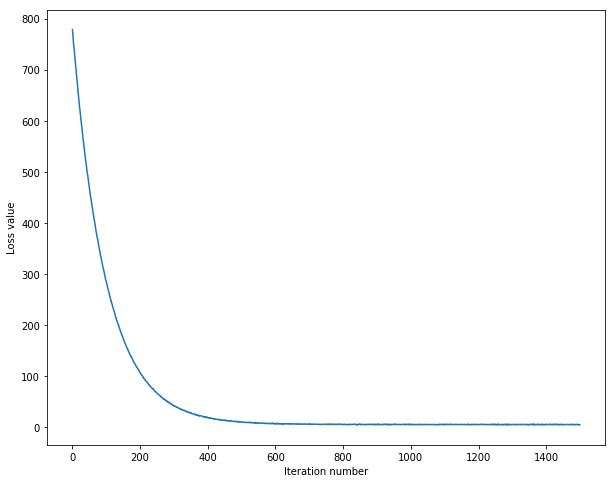

In [39]:
# A useful debugging strategy is to plot the loss as a function of
# iteration number:
plt.plot(loss_hist)
plt.xlabel('Iteration number')
plt.ylabel('Loss value')
plt.show()

In [40]:
# Write the LinearSVM.predict function and evaluate the performance on both the
# training and validation set
y_train_pred = svm.predict(X_train)
print 'training accuracy: %f' % (np.mean(y_train == y_train_pred), )
y_val_pred = svm.predict(X_val)
print 'validation accuracy: %f' % (np.mean(y_val == y_val_pred), )

training accuracy: 0.371184
validation accuracy: 0.384000


In [58]:
# Use the validation set to tune hyperparameters (regularization strength and
# learning rate). You should experiment with different ranges for the learning
# rates and regularization strengths; if you are careful you should be able to
# get a classification accuracy of about 0.4 on the validation set.
learning_rates = [1e-7, 2e-7, 3e-7, 5e-5, 8e-7]
regularization_strengths = [1e4, 2e4, 3e4, 4e4, 5e4, 6e4, 7e4, 8e4, 1e5]

# results is dictionary mapping tuples of the form
# (learning_rate, regularization_strength) to tuples of the form
# (training_accuracy, validation_accuracy). The accuracy is simply the fraction
# of data points that are correctly classified.
results = {}
best_val = -1   # The highest validation accuracy that we have seen so far.
best_svm = None # The LinearSVM object that achieved the highest validation rate.

################################################################################
# TODO:                                                                        #
# Write code that chooses the best hyperparameters by tuning on the validation #
# set. For each combination of hyperparameters, train a linear SVM on the      #
# training set, compute its accuracy on the training and validation sets, and  #
# store these numbers in the results dictionary. In addition, store the best   #
# validation accuracy in best_val and the LinearSVM object that achieves this  #
# accuracy in best_svm.                                                        #
#                                                                              #
# Hint: You should use a small value for num_iters as you develop your         #
# validation code so that the SVMs don't take much time to train; once you are #
# confident that your validation code works, you should rerun the validation   #
# code with a larger value for num_iters.                                      #
################################################################################
iters = 1500
svm = LinearSVM()
for lr in learning_rates:
    for rs in regularization_strengths:
        svm.train(X_train, y_train, learning_rate=lr, reg=rs, num_iters=iters)
        y_train_pred = svm.predict(X_train)
        accu_train = np.mean(y_train == y_train_pred)
        y_val_pred = svm.predict(X_val)
        accu_val = np.mean(y_val == y_val_pred)
        results[(lr, rs)] = (accu_train, accu_val)
        
        if best_val < accu_val:
            best_val = accu_val
            best_svm = svm
################################################################################
#                              END OF YOUR CODE                                #
################################################################################
    
# Print out results.
for lr, reg in sorted(results):
    train_accuracy, val_accuracy = results[(lr, reg)]
    if val_accuracy == best_val:
        learning_rate = lr
        reg = rs
        print 'lr %e reg %e train accuracy: %f val accuracy: %f' % (
                    lr, reg, train_accuracy, val_accuracy)
    
print 'best validation accuracy achieved during cross-validation: %f' % best_val

174.785883106
[[ 17.70537228  -3.54731897   2.19145921 ...,   7.62751786 -26.55983461
  -34.86471335]
 [  4.82722204 -12.9430099   -3.55780219 ...,  18.86675572 -23.52178805
  -36.56513145]
 [ 20.80615991 -34.20240592   9.36326577 ...,  20.86896116 -58.07146392
  -49.70878321]
 ..., 
 [  4.37610901  -1.0085205   12.70080109 ..., -32.00525586 -12.93982057
   10.56311881]
 [-20.83116112   3.60278179   4.73725045 ..., -23.46508775 -33.16744214
  -11.94712948]
 [  2.7271098  -10.96166581 -21.57854766 ...,  -0.8036477   -2.25016283
    6.97283274]]
174.011035224
[[ -6.76263748  -6.87106798   6.64937071 ...,  -0.4412914  -31.01803753
  -44.06528731]
 [-22.03660059 -14.01798934  -3.2940847  ...,  12.94578846 -25.83554942
  -39.27511887]
 [-14.47571176 -35.83237658  26.27449087 ...,  14.05759281 -58.86915266
  -51.79379137]
 ..., 
 [-17.30067486   3.85040149  34.91151947 ..., -28.7591253    1.38586415
    7.23082222]
 [-40.97730639   4.89311044  35.22839963 ..., -24.19067195 -21.09432827
  -21

[[ 14.24856769  -9.11924079  12.9912448  ...,  12.46808439 -10.39875379
  -24.48870639]
 [  1.497828   -21.63672764   1.79468796 ...,  22.67045284  -2.27600952
  -21.71705222]
 [  4.90104031 -40.07796705  11.06651778 ...,  31.738919   -25.15899587
  -28.89361947]
 ..., 
 [ -6.77499664   3.60675374  17.9358472  ..., -24.43315713  -2.29359778
   12.79301019]
 [-29.29611096  13.14095115   7.94269709 ..., -22.96755932 -17.33992415
   -9.04166948]
 [  2.60009595 -10.68621205 -21.11278022 ...,  -0.69796107  -2.18860979
    6.74121356]]
154.364595157
[[  5.02290014  -9.30265512  -4.56951726 ...,   4.4198061   -5.94355647
  -11.64428483]
 [ -4.08348717 -19.4957302  -12.69546285 ...,  17.67095586   1.58243078
   -5.19661374]
 [  6.74140009 -37.88130194  -1.66220139 ...,  21.86457192 -21.49431401
   -7.38655156]
 ..., 
 [ 13.88815877 -13.45168444  -2.74466498 ..., -18.12752805  -3.38529276
   24.28055433]
 [-12.03581056  -9.1932048  -11.31620703 ...,  -9.29963462 -16.94867423
    3.28034219]
 [ 

142.528638453
[[ 13.42878908 -14.0480314  -18.023244   ...,   4.71769031  -1.1358661
  -11.07932903]
 [  3.72315151 -21.88545682 -25.97241402 ...,  16.22544846   3.49700398
   -2.06337163]
 [ 17.53001213 -41.12673818  -8.19997422 ...,  13.2656487  -21.5570335
   -4.98017768]
 ..., 
 [  5.45005779  -5.96094277 -16.16653291 ...,   0.33473091   0.40405039
   11.76745047]
 [-12.30903087   0.95185773 -11.33486277 ...,  -3.34651696 -17.14203966
   -7.66004847]
 [  2.69877748 -10.49473861 -20.3285179  ...,  -0.53911873  -2.21932215
    6.54316959]]
141.763116661
[[ 14.48461722   8.36615092 -21.90491637 ...,  -1.31358065   9.62526977
  -23.48740368]
 [  7.7288804    0.86398578 -25.6324462  ...,  10.83184853  13.46350697
  -20.7156006 ]
 [ 21.18169967 -15.63196002 -10.80070873 ...,   7.33899244 -15.24547646
  -25.83382669]
 ..., 
 [ 14.51046651   4.97434389   6.28704138 ..., -16.38354913  -5.06135366
   -2.65675657]
 [ -9.92973469  11.08496587  -1.82155147 ..., -12.23122616 -20.01989762
  -19.1

132.648353624
[[  0.9909182   -3.48023281  -2.78194374 ..., -12.76194427  17.51894361
  -10.12520979]
 [-11.87121421 -11.54858301  -8.5143002  ...,   6.81800351  21.06846565
   -6.89007206]
 [ -1.29061737 -26.31912887   7.97499811 ...,   9.0670546   -3.72123207
  -12.89883169]
 ..., 
 [ -0.2793638    0.49815806  12.02053727 ...,  -5.84428463   7.09505768
    8.65182676]
 [-18.34087288   9.77274055   6.53610168 ...,  -6.10417917  -4.94520142
  -11.2807036 ]
 [  2.40504559 -10.00628869 -19.32345423 ...,  -0.62861061  -2.02337908
    6.16801599]]
131.583327574
[[ 10.96962289   5.24250436 -15.45355302 ...,  -2.45979111  -5.83587166
    1.77565848]
 [  2.3966616   -5.37758239 -27.69279508 ...,  12.65819469   0.79947474
    8.81736597]
 [ 14.27960774 -21.87359219 -14.02584587 ...,  17.56085652 -21.6916839
    7.21984959]
 ..., 
 [  5.50850781   5.13851868  -4.23666776 ...,  -9.85825586  -7.68412391
   17.25231616]
 [-10.13950843   9.06495495  -7.90648156 ...,  -8.66702785 -16.88632479
   -0.

[[  6.34575093   8.68880921   5.50455154 ...,   1.86753626  -7.67910479
  -10.43586345]
 [ -6.4201108   -3.41177734   6.21944086 ...,   8.70622507  -0.15890925
   -4.04563191]
 [  3.97438352 -21.34657959  20.00084588 ...,  15.12930593 -20.45122203
   -9.0994278 ]
 ..., 
 [  0.66467619  -0.37874224   1.44808136 ...,   2.95226628  -7.34562786
    3.30867746]
 [-17.2353325    9.69991601   0.73274831 ...,   4.64235688 -18.46655531
  -19.50625933]
 [  2.40915718  -9.36693833 -18.85467266 ...,  -0.71599455  -1.9411538
    5.7882313 ]]
118.419682007
[[  0.64731028  10.39349999   0.4958375  ...,  -4.44585321  -5.29730303
   -3.69208381]
 [ -5.98777742   1.24298137  -7.88668726 ...,   4.9425418   -0.70185545
    5.55087954]
 [  9.13171322 -15.31544933   7.22347545 ...,   2.43884908 -22.88020468
    6.97569264]
 ..., 
 [ -4.70408645  -0.30597166  -2.52767652 ...,  -9.16272477  -2.01174917
   11.93900429]
 [-24.69307574   7.65513038 -10.68498229 ..., -11.65716762 -13.39516161
   -6.60569521]
 [  

108.141684617
[[  1.53882984  12.51308816 -18.45917586 ..., -20.97760891   0.62819887
    2.24687017]
 [ -5.27967181   5.16481649 -22.00003029 ...,  -9.52866987   4.86754269
    7.11635519]
 [ 11.94319433  -6.85984704 -10.81834936 ..., -10.31353312 -18.45717989
    4.44808922]
 ..., 
 [  0.97144427   8.5040664    8.18948305 ..., -17.22162806   3.43219517
   15.35883447]
 [-10.38276148  11.91169814  -0.14552005 ..., -16.05348508  -6.93329264
   -5.53259562]
 [  2.29183172  -9.09782885 -17.64551468 ...,  -0.6476103   -1.93391958
    5.44100488]]
109.060811989
[[ 21.40533039  -6.98256728 -14.93997362 ...,  -6.0895364    7.56182761
   -3.27530955]
 [ 16.08907827 -12.18397843 -20.0924823  ...,   3.25994553  13.06712719
    2.8955174 ]
 [ 32.16120664 -29.03353107  -9.07674856 ...,   2.33547633  -8.25950516
    4.24046684]
 ..., 
 [ 10.60670058   0.12591539  -1.12956521 ..., -17.53130847   0.99462175
   20.43313849]
 [ -5.89829729  12.52481858 -10.65736167 ..., -18.54245302 -10.3293722
    6.

100.04369576
[[ -1.19233955   7.98199708 -25.95764163 ...,  -0.78463474   3.61704256
   -1.30611376]
 [ -8.60782543   0.97992444 -31.8975371  ...,   7.45699463   8.80502353
   10.50087734]
 [  8.56074454 -13.79015826 -25.68315383 ...,   5.25716578  -8.83616729
   11.63885893]
 ..., 
 [-12.31429661  -3.2308023   -1.58466708 ..., -23.12840181   1.51124513
   22.35053808]
 [-28.98495939   0.54837901 -10.72599402 ..., -10.68221088  -7.0850562
   -0.56016106]
 [  2.20593563  -8.58375674 -17.07637728 ...,  -0.74232585  -1.5869487
    5.23710092]]
99.3296397667
[[ 12.83810973  14.23043406 -11.18749419 ...,  -4.02641949   8.3400146
  -18.77794999]
 [  3.09523443   6.14876186 -19.97746609 ...,   4.77001722  13.48747412
  -10.48825364]
 [ 23.32640135  -9.53162892 -11.78007884 ...,   8.4997331   -4.00017786
  -13.3833238 ]
 ..., 
 [  7.29887646  -5.00895191  -0.87188649 ...,  -9.32886116  -4.31856448
   14.94354061]
 [ -5.46398729  -0.39317365  -4.89531088 ...,  -5.08140009 -12.506059
    0.57543

90.3724981834
[[  9.87324304  15.54671204   0.84610487 ..., -16.26697764  -8.58657796
  -11.5953806 ]
 [  1.19830719  11.13301277  -6.22868916 ...,  -3.48427588  -1.39464543
  -10.29923932]
 [  9.98872449  -3.18117285   1.34614521 ...,  -5.87912471 -18.28313603
  -16.53769525]
 ..., 
 [  0.8645858   12.54181713  -4.4579949  ...,  -7.70486045  -6.89752724
   13.63812709]
 [-15.95960808  18.53498327 -12.84990972 ..., -10.30493333 -11.74234009
   -2.72285772]
 [  2.07503231  -8.26895947 -15.9653797  ...,  -0.51159955  -1.62338095
    5.04041029]]
89.7736860654
[[ -0.3166302   -1.51173978  -7.77511277 ...,  -6.62523618  -5.09373444
   -5.16395532]
 [ -8.37289111  -9.4490335  -14.25273445 ...,   4.54964207   1.48120125
    2.35462165]
 [  0.67873577 -23.78429576  -6.91809216 ...,   5.75523401 -12.13063535
    2.89642837]
 ..., 
 [  8.67872122   2.74237327  -5.42560751 ...,  -9.1666658    5.77522907
   12.02140692]
 [ -7.58864847   5.10642686 -11.57606624 ...,  -9.23973554  -0.48361061
   -3

82.5364232574
[[  0.6541785    2.02599845   1.33753963 ..., -13.10191352   0.34538457
  -10.21436479]
 [ -6.20216961  -5.93934313  -5.95705157 ...,  -4.80342359   4.3099298
   -1.61680664]
 [  6.30636271 -17.19113305   2.10992253 ...,  -2.42982911 -12.78552341
   -1.59954917]
 ..., 
 [  9.78917342   3.47667084  11.00040623 ..., -13.18837171  -2.0676947
   14.51964583]
 [ -2.77872977   7.70058229   4.98988825 ..., -14.71691287 -11.25485242
   -0.77761838]
 [  1.9142277   -8.01783379 -15.31519381 ...,  -0.47373123  -1.66399212
    4.9034957 ]]
82.150507322
[[  1.29538198   0.31535562  -2.11055261 ...,   4.01132268  -7.40539949
   -4.45945481]
 [ -1.29459755 -11.26246756  -5.28730472 ...,   4.13893698  -0.04593268
    8.17081476]
 [  9.88951247 -25.52296539   6.12894485 ...,   1.95625215 -16.31245483
    7.50098487]
 ..., 
 [ -4.03026269   1.62805743  -5.53252805 ...,  -4.85085763   2.54763953
   17.17771843]
 [-20.06091889  10.673021   -16.03924735 ...,  -4.97313596  -4.269634
    3.2311

74.9735278893
[[  8.47785678  13.22163006  -5.07315551 ..., -19.45581269  -4.76181577
  -11.3408107 ]
 [  0.11167092   5.39475063 -11.68750651 ...,  -9.57397028   1.10455765
   -2.84630934]
 [  7.94659161  -5.15858175  -6.76414449 ...,  -3.08144061 -18.18746063
   -2.58962256]
 ..., 
 [  0.85731317   0.96330531  -3.81341303 ...,  -7.19620178  -0.35154872
   -1.11091473]
 [-15.69705943   8.20997941 -10.59364878 ...,  -0.02666609  -8.97665596
  -17.24538837]
 [  1.86782335  -7.49876391 -14.56379631 ...,  -0.69510158  -1.50320596
    4.69340606]]
75.5372048476
[[  3.18049352   8.10432159  13.69826948 ..., -17.3609182   -3.78945324
   -4.48065162]
 [ -0.38761881  -1.2236579   11.51771977 ...,  -9.71284376   5.68037094
   -2.27056354]
 [  8.9723187  -13.96522663  20.46553312 ...,  -6.59864223  -5.0040346
   -4.45253232]
 ..., 
 [  8.08266769 -10.67043473  12.32935712 ...,  -8.8472721   -2.43170289
   12.84432149]
 [ -7.35934309  -7.31230128  10.66391059 ...,  -9.02560299  -9.21963431
   -2.

68.0946123875
[[ -1.38795537   1.73361011  -3.60350164 ...,  10.85888322 -12.48595587
   -2.22840476]
 [ -7.80898857  -2.66009772  -8.48464843 ...,  20.06145804  -5.70731907
    1.9639529 ]
 [ -2.83647603 -15.19536496   0.70547588 ...,  20.7488743  -16.08592049
   -0.98568852]
 ..., 
 [ -3.41362725   8.59055342  -7.6440728  ...,   0.6206283   -2.20305495
   21.98912193]
 [-12.34656275  11.21796826 -15.86976333 ...,  -2.3568281   -7.13359653
    8.04751514]
 [  1.56527653  -7.29636829 -13.9318006  ...,  -0.39298804  -1.47012136
    4.49247148]]
68.8027084108
[[  1.4395785   -4.61609574   4.72682523 ...,  -9.9649479   -4.46772685
    5.67105283]
 [ -5.98796019  -8.16962946  -0.98235102 ...,  -1.09079525  -2.4610638
   11.56363282]
 [  2.94309718 -20.09829939  11.51057509 ...,  -2.30500438 -15.31405212
   11.16264452]
 ..., 
 [ -3.33309525  -1.18460203   8.09959862 ..., -14.94655722   5.11328933
   11.40955648]
 [-18.22902333   1.63969886   3.18207858 ..., -14.1215227   -0.55345008
    2.

62.4949648254
[[  2.74740493   8.9220417  -16.66220332 ...,  14.76785217  -5.16746272
  -14.03483714]
 [  1.39105628   3.32638091 -21.76574052 ...,  26.18114195  -0.48384109
  -10.74378774]
 [  8.37522758  -9.43418085 -22.88273909 ...,  26.39401869 -16.35147654
   -6.59575626]
 ..., 
 [ -0.54474202   2.03593573   0.22685391 ...,  -4.12516816  -0.12878073
   11.53558057]
 [-17.16802173   8.88230129 -11.72532633 ...,  -2.05352152  -8.95418738
    1.16565341]
 [  1.79251315  -6.66539571 -13.4672447  ...,  -0.51842258  -1.5657497
    4.18153458]]
63.3906322508
[[ -6.86770594  -6.82806208  -3.65077836 ..., -10.15157997  -0.96709383
    2.10173127]
 [ -7.95453579 -15.90904598  -3.66669161 ...,  -0.26864633   3.53547847
    4.11259533]
 [  5.11085358 -31.11524606  10.69090386 ...,   0.98675324 -12.87464792
    5.07925235]
 ..., 
 [ 12.01405333 -11.9619749    2.06888215 ..., -22.1227287    2.91533662
   24.51887642]
 [ -0.44395228  -4.9306303   -0.96354743 ..., -25.091318    -3.93914319
   10.

57.6383411555
[[ 14.16892408   1.78240183 -17.71621592 ...,   0.11465357  -5.2286305
   -4.72348829]
 [  7.37763971  -8.39767046 -21.89791427 ...,   7.96994872  -2.04448888
   -0.7688666 ]
 [ 13.03265122 -20.10952389 -10.50082309 ...,   4.70894372 -16.83717483
   -1.40023394]
 ..., 
 [  8.6272371    6.77978568 -20.23590056 ...,  -1.26631242   2.12548544
    8.39856158]
 [ -7.3638726   10.77172179 -22.55205795 ...,   5.9682022   -8.37703553
   -5.53220106]
 [  1.49764355  -6.41005729 -12.45871417 ...,  -0.4641921   -1.39936893
    4.09625676]]
58.2977897075
[[  2.35144271  19.1213983    1.09494703 ..., -15.55576548  10.06021496
  -10.24369766]
 [ -4.3548063    8.7301563   -2.48339084 ..., -11.25201663  12.64161938
   -4.48181916]
 [  3.6366606    1.78513073   1.46628712 ..., -10.02183073  -5.36631418
   -5.57200799]
 ..., 
 [ -3.28911912  -0.22409655  13.90139003 ...,  -9.92745387  -2.28150331
   15.99482588]
 [-11.74939301   5.70781935   1.87243839 ..., -13.04974243  -8.58379778
    4.

52.4260893655
[[ -1.70695071   4.8375219  -13.20128689 ...,  16.32574514  -7.48447372
    6.65559595]
 [-10.48492374   1.62981592 -19.04465651 ...,  21.80909849  -3.76924957
   14.41721846]
 [  3.05757681  -4.89206373 -11.7522888  ...,  18.31402673 -18.26669867
   18.6767335 ]
 ..., 
 [  0.28863662   3.71987471   0.36793522 ..., -12.44708232   4.33055096
   12.50910441]
 [-11.36422842   5.85475517  -0.12249117 ...,  -7.26101584  -4.37023848
    3.96376232]
 [  1.54257912  -6.27388273 -12.0982281  ...,  -0.52692132  -1.2751964
    4.01458905]]
52.808502454
[[  4.23019492  -8.42343021   4.37863776 ...,  -5.96075071   6.77980126
   -8.58970781]
 [  3.49711374 -13.81263583   0.7482009  ...,  -1.87414887  10.32961101
   -3.67865998]
 [ 14.76923617 -26.28084534   7.20026818 ...,  -4.18670138  -3.93580156
   -3.15402977]
 ..., 
 [  6.59508145  -7.310057    10.28359464 ...,  -1.15271728   3.90691061
    7.96555204]
 [ -5.54182776  -3.84811887   5.30860346 ...,  -0.53167125  -2.5128661
   -1.25

[[ -8.49696688   1.11826089  -5.50411082 ...,  -7.77116984   3.15703606
    4.0764566 ]
 [ -9.70504443  -6.11462736 -12.71516553 ...,  -0.47623233   6.64112658
    9.33839806]
 [  1.86905399 -10.73282986  -8.0963932  ...,  -3.95919522  -4.87983236
    6.27421446]
 ..., 
 [ -9.03301299  -2.40621717   7.05729944 ...,  -9.90207409  -0.31232503
   11.4940181 ]
 [-20.72747723   9.59925419   1.08031753 ..., -10.14025153 -10.28556357
    1.45734545]
 [  1.47374471  -5.93380178 -11.47383539 ...,  -0.49354162  -1.27515865
    3.68508116]]
48.9946608367
[[ 13.33869213  -9.85964788  -0.52776068 ...,   5.11998092  -9.66875751
   -8.52670669]
 [ 14.40502593 -19.66360406   2.77825729 ...,  14.26559084  -5.58631353
   -6.23895412]
 [ 31.34270656 -37.55472744  15.19307401 ...,  15.81454765 -18.34895375
   -6.25386323]
 ..., 
 [ 10.59378084   7.30049884   3.08280255 ...,  -3.28478017   1.12473669
   -2.18525266]
 [  3.87025882   8.2866528   -2.3918635  ...,  -6.33019699  -2.42717944
  -13.18818261]
 [ 

[[  7.03357845 -20.56216299  -0.41704731 ...,  -3.09745299   2.04825993
    2.32536687]
 [ -0.65917844 -23.9902317   -7.79973612 ...,   4.63837562   5.73773371
    5.79612715]
 [  5.99319103 -32.37742777  -5.9090175  ...,   3.53040919  -5.93117557
    6.37299684]
 ..., 
 [  0.56729225  -9.29375346  -4.40143192 ...,  -6.588758    -1.99054974
    9.10737644]
 [ -8.38729621   0.25882609 -10.25986591 ..., -11.71442105  -4.99399861
    0.66650818]
 [  1.44469269  -5.75912852 -11.17153645 ...,  -0.14620948  -1.10822178
    3.72962411]]
43.9151179849
[[  7.65265946   0.93660866 -13.82402954 ...,  -4.07327227  -3.24392261
   -5.86493074]
 [  7.04230268  -1.06633279 -21.49001853 ...,   9.03716174  -2.17056117
   -2.85186081]
 [ 19.34587151 -12.14268075 -11.50286991 ...,  14.2474894  -15.87889582
   -2.14150595]
 ..., 
 [ -3.92706321   1.65985009  -8.62253621 ...,   8.73813606   2.18211509
   -1.75329584]
 [-14.71188963   6.22056512 -11.57156104 ...,  14.94113909  -3.29806461
   -8.00120976]
 [ 

40.7344756188
[[-11.82405761  11.26017315   4.82484415 ...,  -7.14064568   3.64940082
  -15.3066864 ]
 [-15.03752515   5.16764326  -2.82347902 ...,   0.3978981    8.81914672
   -9.08142812]
 [ -5.84728866  -4.15141138 -13.67969205 ...,   1.98055971   0.94709703
   -7.77255818]
 ..., 
 [ -1.99380984   5.05991824   7.92397003 ..., -21.22720661   3.62084719
    7.23631659]
 [-13.44780737  11.71242804  -7.24339238 ..., -24.19249062  -0.03883367
   -3.84111151]
 [  1.32201178  -5.31125846 -10.58868289 ...,  -0.30941438  -1.12727491
    3.5386923 ]]
40.133191883
[[  4.88776645  -8.81801182   2.63785726 ..., -12.781343     4.85358938
    0.85922907]
 [ -1.89748763 -15.40017285  -2.29102085 ...,  -5.64713449   8.45496227
    5.25064412]
 [  6.15355863 -25.27354181   7.10846601 ...,  -4.84589921  -4.3243717
    3.4123454 ]
 ..., 
 [  4.65318397   4.4098424   -4.06171476 ...,  -5.48321859  -4.22053448
   14.81889578]
 [ -3.47935957   5.49865347  -6.95815756 ...,  -5.51628956 -10.0958034
    2.67

37.5683236415
[[  8.10803515 -23.80704318  11.06185293 ...,  -6.83929328  -1.5197466
    7.94407077]
 [  1.41615894 -24.71507952   6.39140826 ...,   3.12032601   3.05223579
   16.32719419]
 [  1.63008215 -32.72690698  10.45497148 ...,   6.40688918  -6.90734674
   18.62193778]
 ..., 
 [ 11.15877919 -14.58710405  -1.07379494 ...,   0.5989217   -1.59238516
   14.10595827]
 [ -3.5402541  -12.03970624  -5.20260656 ...,   3.30094095  -4.39305003
    2.95170441]
 [  1.3983548   -5.18650123 -10.29366173 ...,  -0.45292521  -0.92598492
    3.19489635]]
36.865318123
[[ 15.28225925  -0.64279746  -6.70073086 ..., -19.73411021  -5.68545604
   -4.98157697]
 [  9.49154636  -2.44381189  -8.58496019 ...,  -7.4103285   -2.16746032
   -0.64121056]
 [ 19.20138778 -15.27946314   0.29918896 ...,  -6.60349669 -11.63278674
   -0.5375111 ]
 ..., 
 [  6.16846327   7.98921652  10.02524008 ...,  -0.53304171   2.67178355
   12.66893884]
 [ -1.20678885  10.13836989   4.2277139  ...,  -3.49630213  -1.38269555
    4.7

34.4344202006
[[ -1.73841272  -6.71697863 -12.35558325 ...,  -4.28222383   4.20280798
   -9.72921046]
 [ -4.30228495 -10.59360259 -13.27272225 ...,   2.09300372   6.0276246
   -5.28843474]
 [  9.67242645 -21.26714123   0.41237348 ...,  -1.22649468  -7.6880043
   -9.71816042]
 ..., 
 [  4.65777449  -0.10133344  -3.76810465 ...,  -5.14352999  -4.61946155
   -2.26800334]
 [ -0.54323827   7.51474022  -4.72476757 ..., -13.46491031 -10.5410235
  -10.71055676]
 [  1.32462079  -4.73412849  -9.58893429 ...,  -0.29920223  -0.95658436
    2.9767664 ]]
34.4585015983
[[ -8.46414074  -1.48725359   2.22065774 ...,   5.25830727   6.03698476
   -1.57113748]
 [-11.34734338  -6.40193603  -1.14027147 ...,  12.9192898    9.83794391
    0.57931951]
 [ -5.98883312 -16.03398164   0.64828743 ...,  12.74705692  -3.54553263
    2.79257876]
 ..., 
 [ -0.55705186  -2.09591089  10.50445162 ...,   7.37715109  -4.38245025
    9.20790017]
 [ -7.50668004   6.88313333   4.57293791 ...,   4.36963389 -13.19056819
    0.85

[[ -6.24566606 -13.49807138  -8.10986389 ...,  14.61062776   6.67955647
   -3.26433423]
 [-14.10578098 -17.93209151  -5.98835365 ...,  18.45386655   8.70389172
    3.03976987]
 [ -3.80357081 -26.06710205  -3.5451739  ...,  19.24891033  -2.17837246
    4.67515918]
 ..., 
 [  3.40579824  -4.94225964  -8.00966161 ...,  -0.59819161   5.64657881
   10.02857822]
 [ -5.15889321  -1.00761118 -13.25697742 ...,   1.61500878   0.27049854
    1.14455917]
 [  1.27216769  -4.78424163  -9.40737631 ...,  -0.16427366  -0.84897265
    2.91086736]]
31.5034791152
[[  9.96797889   4.4372172    9.88358169 ...,  -2.95844124  -6.98941941
  -20.35755601]
 [  7.44140694   1.39093191   5.19402756 ...,   2.99212493   0.02226538
  -17.53436581]
 [  9.04999419  -4.97840454  14.91249985 ...,   4.27496672 -10.92036715
  -14.89108088]
 ..., 
 [ 14.73789816  11.27337282  -3.09333767 ..., -15.75744077  -5.8661543
   -0.73973281]
 [  8.95322068  12.72639857  -3.79857044 ..., -12.90968337 -10.04584053
  -10.0276111 ]
 [  

28.3904374131
[[  2.53751459e+00   1.00850453e+01  -9.00094368e-01 ...,  -1.29808025e+00
   -1.00720608e+01  -3.34218503e+00]
 [  1.24835696e+00   4.57364354e+00  -1.03752181e+01 ...,   5.20714398e+00
   -5.57158762e+00  -7.58470343e-03]
 [  9.36861810e+00  -3.22075266e+00  -8.55681136e+00 ...,   6.23272987e+00
   -1.41295693e+01   1.42770369e+00]
 ..., 
 [  3.65663037e+00   1.72284221e+01  -8.42871915e+00 ...,  -1.45975085e+00
    1.10345014e+00   7.32424536e+00]
 [ -9.94569225e-01   1.88810538e+01  -1.33656182e+01 ...,  -1.99642738e+00
   -4.90605271e+00  -1.60522547e+00]
 [  1.12112725e+00  -4.54889143e+00  -8.73292990e+00 ...,  -3.16131136e-01
   -9.06830383e-01   2.91284327e+00]]
28.7110610299
[[ 17.0564632   -1.108858     1.04938675 ..., -17.33239094   2.90665942
    5.34730756]
 [ 13.37320452  -4.82882959  -1.00966021 ..., -13.33605398  10.06044519
    7.00712594]
 [ 16.42581438 -12.46203252   1.78200627 ..., -16.59063388   1.90164683
    6.85371232]
 ..., 
 [  8.22625619  -0.59

26.5053980859
[[ -2.98536553   2.8204465    3.10195084 ...,  15.65997595  -1.93301689
  -14.86177432]
 [ -8.17900499  -3.13412377  -1.75270315 ...,  18.00912128  -1.25701206
   -9.46080163]
 [ -6.07733155  -9.34550628   3.1510085  ...,  15.6465741  -12.64518207
  -11.20372039]
 ..., 
 [  6.13286919  -0.40394441   7.69708016 ...,  -2.28775185  -4.45513793
    7.91235547]
 [ -3.40484978   3.15604078   2.49869881 ...,  -0.52497443  -9.05392653
    0.0919122 ]
 [  1.20035745  -4.16826145  -8.20335696 ...,  -0.33619371  -0.87587506
    2.70965195]]
26.2234583094
[[  1.63113372  -5.58558344  10.59482919 ...,  -9.81537964   8.05563949
    7.96018235]
 [ -2.1769219   -9.67089832   6.04731435 ...,  -6.72989244   9.81305771
   13.44274591]
 [  2.01218089 -19.13853036  15.37287973 ...,  -8.35800697   0.57326781
   13.94617925]
 ..., 
 [ -1.54654613  -2.16285026   5.7912692  ...,   5.42194366  14.71034456
   -2.24745893]
 [-10.40747064   2.96088689   5.09415939 ...,  11.75252697   5.01109953
  -12

24.7467149659
[[  9.800451    -6.99671308  -6.55703906 ...,   9.05911219  -5.3437804
  -17.45073488]
 [  5.80098342 -10.40386643 -10.6551149  ...,   9.81944302  -2.63694237
  -11.46176648]
 [  5.43188795 -11.64230975  -7.78320597 ...,   7.28054437  -9.7662697
   -6.89108961]
 ..., 
 [  4.2326983    2.65307666   3.80604583 ...,  -9.61750244  -4.62243992
    3.74524374]
 [ -3.48125994   4.33081371  -3.18412114 ...,  -9.73776937  -9.16078594
    1.96346809]
 [  0.93709498  -4.17809108  -7.9442803  ...,  -0.19353928  -0.82486015
    2.60163925]]
25.2015623406
[[ 10.1804133   10.80521649  -6.51277835 ...,  -2.68248049  -8.40306509
   -4.16970313]
 [  3.6024656    7.03525887  -4.46738224 ...,   2.32898429  -4.48903144
   -1.10512206]
 [  6.41721626  -2.97749315   5.09040418 ...,   5.52485097 -11.6236122
    2.45106229]
 ..., 
 [-15.5442793    2.13576072  -4.34484674 ...,   0.94728364  -2.68574687
   14.83787891]
 [-20.27772511   9.75445289  -5.51200559 ...,   0.6659534   -7.43761873
    7.61

[[-12.08104832   9.05485469  -0.28212348 ...,  14.44306893  -2.89914642
   17.18493311]
 [-10.6471024    6.315894    -5.11695843 ...,  19.65444874  -1.01407661
   18.6944206 ]
 [ -3.19415873  -1.57496744   2.50355089 ...,  20.2275256  -10.36069282
   14.49691146]
 ..., 
 [-11.11916115   8.46396518   5.07054201 ...,  -4.11578363   4.40927543
   12.1773946 ]
 [-20.64641858  12.14404751   1.50081696 ...,  -2.80795831   1.41594378
    2.02045099]
 [  1.03403721  -3.80554046  -7.64448464 ...,  -0.29601617  -0.8110828
    2.29011425]]
23.0761320612
[[  9.23535681e+00  -1.27956863e+01  -4.24758442e+00 ...,   6.35271270e+00
   -3.15334217e+00  -1.00242192e+00]
 [  6.09427531e+00  -1.62465178e+01  -9.69238944e+00 ...,   7.83780807e+00
    1.08285073e+00   2.89928792e+00]
 [  9.69007869e+00  -2.87649574e+01  -5.69735113e-01 ...,   5.06910154e+00
   -8.34402805e+00   1.10000465e-01]
 ..., 
 [  1.02747965e+00  -5.17778124e+00  -2.43669754e-01 ...,  -4.75389112e+00
    4.79176820e+00   2.18071352e+

20.6763769647
[[ 19.00628351  -9.2419778   -1.14869389 ..., -10.92902284   0.52003778
    3.12839044]
 [ 15.80892328 -13.60971565  -7.84928723 ...,  -9.07178489   2.13233589
    6.78462142]
 [ 22.87783894 -20.16541489  -4.40305876 ..., -13.65862918  -1.82784755
    6.28246117]
 ..., 
 [  6.87934178   4.30871142   0.69139825 ...,   0.6300514    0.37348146
   -0.11520045]
 [ -0.86372875  11.60505059  -5.54088961 ...,  -0.86300506  -3.05414735
   -7.46691641]
 [  0.97881826  -3.66875063  -7.23516045 ...,  -0.28626024  -0.76792162
    2.29275536]]
20.8984198324
[[ -4.22218114  -8.99013511   3.68319787 ...,   9.05788649 -13.10980634
   12.20249123]
 [ -7.4351734   -6.55918808  -2.80088998 ...,  13.35555169  -9.60052706
   15.11948068]
 [ -7.13973359  -7.8950109    7.19712675 ...,  21.5900517  -15.71206296
    9.50352606]
 ..., 
 [-13.23738491  13.338897   -11.26515193 ...,  -5.26369253  -5.57241366
   12.15733842]
 [-20.31594216  17.02649054 -10.14233586 ...,  -3.41918277  -8.01011035
    6

19.683558942
[[  5.03636828   1.20145284 -11.49524991 ...,   2.12595542  -2.98536666
    4.25988152]
 [  1.06962002  -3.53358569 -14.02993185 ...,   7.88803137  -0.93082494
    3.76731379]
 [  4.55593769 -13.06060007  -8.46229894 ...,  11.61969964  -5.86262602
    0.98905678]
 ..., 
 [ 13.27837102  -4.94879425  -1.18080742 ...,   5.17026438   6.03605974
    2.41713244]
 [  2.34527995  -1.56817683  -4.44824677 ...,   6.79463723   3.71826092
   -5.53118286]
 [  0.97015247  -3.43252719  -7.0224542  ...,  -0.07914487  -0.52195027
    2.13546484]]
19.3311593021
[[ -4.07343084  -6.62012015   6.73637962 ..., -10.7840085   11.23741728
   -9.67370244]
 [ -0.77373276  -9.07032608   5.56665522 ...,  -7.93449136  14.29627017
  -10.73218413]
 [  4.99062155 -18.09043069  14.61981478 ...,  -8.39639843   4.32775946
  -13.75297554]
 ..., 
 [  2.41783754  -2.01591606  10.8996991  ..., -10.56714507   4.8810351
   21.34419368]
 [ -0.52211891   0.85438492  10.57026148 ..., -11.45514884  -0.90654734
   12.0

[[ -1.28256709 -19.59316162  -0.49852421 ..., -15.6089908    0.70592642
    6.76612671]
 [-12.89765915 -18.55437678  -5.02729549 ..., -10.33117557   4.60523927
   10.07502758]
 [-12.39525325 -24.79104899  -3.11207528 ..., -12.67589111   1.46032745
    8.70647721]
 ..., 
 [ -9.33397709 -10.34952047   1.24804368 ...,  -6.48720043   3.16683069
   12.32004139]
 [-17.61312858 -10.77867933  -6.04654284 ...,  -9.75360726   0.64296943
    6.50609694]
 [  0.77864599  -3.44041805  -6.45573298 ...,  -0.26408103  -0.7330615
    2.29329632]]
17.8661890932
[[ 13.08922129   4.40778338   4.34640136 ..., -12.06959936   0.95836284
  -15.16935472]
 [  9.34806963  -0.22228362  -0.72637789 ...,  -4.73182603   2.92426413
  -12.28278724]
 [ 17.28868466  -5.99834447   2.06266843 ...,  -0.27747726  -3.310589
  -15.04614151]
 ..., 
 [ 13.15675321   8.32478578  -3.14426355 ...,   4.10465575   7.1133108
    0.66201523]
 [  7.91755098   7.36406506  -7.93059273 ...,   2.88324064   4.02729432
   -2.33547344]
 [  0.9

17.3460949141
[[  3.70754125  -4.27947294  11.78139393 ...,  -1.76928651 -11.0933472
    5.52025992]
 [  5.68631124  -7.75576079   7.1741751  ...,   3.05894388  -9.13308973
    5.24346602]
 [  9.68493524 -18.07296078   9.74701503 ...,   6.64865491 -16.66425526
    9.67414207]
 ..., 
 [ -1.03968836  -0.80635975  -0.42963613 ...,   0.98644724  -0.5220782
    5.13494023]
 [-10.7509778    3.57700704 -11.12318486 ...,   2.88316051  -2.28006105
    1.66537946]
 [  0.76832239  -3.26831483  -6.49577512 ...,  -0.05007947  -0.55087553
    1.89411138]]
17.0852136969
[[ 14.01359646  27.29956929  -9.90771961 ...,  -6.10309018   9.73761187
  -11.40056473]
 [ 11.52790809  21.48927814 -11.93480265 ...,   4.06677524   7.26348622
  -10.81577285]
 [ 16.45601051  16.58587238 -13.7106677  ...,   0.84863789  -2.63124244
   -8.73659758]
 ..., 
 [  6.95360643 -13.77329829 -12.80004935 ...,   3.01940161  11.80411816
    1.72239753]
 [  5.72982675  -6.36151639 -13.79198667 ...,  -1.46981908   5.93815901
   -5.2

15.6594930193
[[ -7.54773423 -15.20130286  -0.23588293 ...,   1.90624477  -8.6006662
    5.6870489 ]
 [-12.34406001 -19.15357574   0.23658227 ...,   8.05683253  -8.7452268
    5.58169571]
 [-10.70460515 -24.64298036   4.97987004 ...,  14.34672698 -19.73099836
    4.21713984]
 ..., 
 [-12.10866613 -12.08070338   6.69962299 ...,   6.04753245  -1.06197546
    6.15261965]
 [-15.58212743  -8.92957518   1.65613233 ...,   3.65411722  -9.08994862
    4.34795908]
 [  0.79137138  -2.85550692  -5.91204816 ...,  -0.35442498  -0.79978427
    2.09121049]]
15.7260715956
[[ 15.50376605   2.67457436  -5.36865061 ...,   5.08078883  -1.09902615
   -4.34215202]
 [  9.86374068  -0.72515278  -4.1732436  ...,   1.81099049   2.03698884
   -1.02279007]
 [  7.52925149  -2.92438064   2.96369731 ...,  -0.5648175   -2.65131185
    0.6894876 ]
 ..., 
 [  1.91189356   4.65085569  -0.85954806 ...,  -7.30398896  -6.95968573
   -2.28525052]
 [ -8.76653459   9.25533725  -6.5257488  ..., -13.04736761 -11.11677725
   -6.5

[[  1.10925797 -13.47451018   3.32662021 ...,   5.87913349   9.70162152
  -12.95452916]
 [ -1.3899824  -15.85249144  -0.41305097 ...,   8.69157034  11.36693296
   -6.94679589]
 [ -0.2248777  -25.12749567   4.37380182 ...,   9.84957363   7.70353827
   -3.82975469]
 ..., 
 [ -0.61520491  -0.34606765   8.068585   ...,  -4.41746939   0.78429085
   -8.35045674]
 [ -8.02188201   0.25333061  13.62184347 ...,  -0.59434662  -0.61134494
  -17.40441624]
 [  0.68528736  -3.18493148  -5.71240468 ...,  -0.0652233   -0.51527481
    1.69273994]]
14.5996119997
[[ -2.04827027  19.262138    -5.38576192 ...,  -3.54046095  -8.49530929
  -11.55508851]
 [  0.53159023  12.70438861  -5.40325425 ...,  -1.25986102  -4.69607785
  -10.92875317]
 [  7.91060799   7.85123877  -2.07931239 ...,   0.96581181 -10.06151261
  -13.39436004]
 ..., 
 [  0.22679071   8.35983188   3.71364621 ..., -11.14875804   6.72108288
    2.95117616]
 [ -2.69285584  11.25621871   0.82732448 ..., -11.92881656   2.40522783
   -1.41598611]
 [ 

13.3394548194
[[  9.23974201   6.39836827 -17.59829332 ...,  -3.36491637  -4.52391317
    1.94282529]
 [  1.21503702   6.23164717 -21.34753372 ...,  -1.28274943  -2.23414992
    3.29092251]
 [  0.88896872   2.68297866 -18.48623259 ...,  -1.95772415  -9.71224736
    1.44019089]
 ..., 
 [  1.58453138  -5.83452304  -6.4118327  ...,  -6.56056602   8.34969454
    3.15184894]
 [ -7.12782556  -6.79611463  -5.81583836 ...,  -5.41684062   5.96816879
    0.38264484]
 [  0.61022041  -2.92787117  -5.25976926 ...,  -0.06703494  -0.56705212
    1.6982175 ]]
13.6086287794
[[ -6.87456487e+00   7.78838888e+00   5.33386630e+00 ...,   2.30851569e+00
   -2.58082413e-02   6.36013941e+00]
 [ -5.08745659e+00   6.34523287e+00   4.18726126e+00 ...,   3.59981189e+00
    2.51326688e+00   5.72708363e+00]
 [  2.34625404e+00   4.94503486e+00   8.25753670e+00 ...,   6.16105928e+00
   -2.50227430e+00   4.83296825e+00]
 ..., 
 [ -2.86171601e+00  -7.76006892e+00  -5.46715434e+00 ...,  -1.24193426e+01
    1.15272525e+00

[[  7.93782268  22.84535621   6.50283174 ..., -18.94983425   8.65631187
    0.38269338]
 [  4.0927539   17.69797701  -0.78227571 ..., -14.61706258  11.0929542
    2.16022794]
 [  7.17302657  14.2666157    7.89613361 ..., -13.29026526   0.9921476
   -1.39685173]
 ..., 
 [ -0.62546155   6.89178086 -12.81107098 ...,  14.29468722   7.27307457
    9.64658126]
 [ -3.25175924  10.41368268 -11.3476676  ...,   9.22891002  -0.93572684
    6.89164972]
 [  0.75385938  -2.59176579  -5.10290841 ...,  -0.18541186  -0.73109095
    1.86471993]]
13.3545929468
[[ -1.7737633   -9.45130741  -7.20509007 ...,   0.8468864    2.34106648
   -6.45356666]
 [ -1.02780008 -12.08762045 -13.29131078 ...,   6.6309106    4.99560563
   -4.17503739]
 [  2.44376701 -15.10215153 -14.70150171 ...,   9.57567766   4.40900219
   -6.60988876]
 ..., 
 [ -2.69087936  -8.84423623  -0.8118795  ...,  -2.00203114   8.53909986
    5.16346774]
 [ -6.11654176  -6.50268172  -6.30031565 ...,  -2.76435746   8.20829675
   -1.77731478]
 [  0

[[ -5.11792052   7.10196695  -2.62143227 ...,  14.15296741   2.67791016
   -2.55472581]
 [-11.83559039   6.10264831   0.40151981 ...,  14.91327923   6.33993847
   -1.74469818]
 [-10.7604103    4.32952711   5.25463409 ...,  19.22427143   1.97869605
   -1.92808812]
 ..., 
 [-11.84555578  -2.71647031   2.42169045 ...,   0.05519285  13.03608587
   -3.86104105]
 [-17.80028291  -4.93548382   6.47787391 ...,   3.4562329   13.00574867
   -9.57562151]
 [  0.49294081  -2.45566091  -5.34497463 ...,  -0.15631101  -0.44407603
    1.60258758]]
12.1837233052
[[  6.58311995e-01  -1.50729706e+00  -1.66293349e+00 ...,   3.69611077e+00
   -3.53527356e+00  -2.64031343e+00]
 [  1.39206714e+00  -1.98819644e-01  -1.30776605e-01 ...,   6.82628840e+00
   -4.74923259e+00  -1.81583581e-01]
 [  8.15902379e+00   3.49675946e-01   8.31881333e+00 ...,   7.89422022e+00
   -1.53748253e+01   9.38296091e-01]
 ..., 
 [  1.31025016e+01   3.84848534e+00  -1.39922643e+01 ...,  -2.26277581e+00
   -1.14533465e+01   2.52317305e

19.1522275986
[[  3.38102089   6.22398601  -1.51655264 ..., -11.28661507  17.99721052
  -14.12483878]
 [  1.29152575   1.81467247  -6.22906217 ...,  -2.15379495  19.73748485
   -8.69033921]
 [  9.38044142  -3.45863322  -9.07056142 ...,   5.0844394   10.5886181
  -10.65851112]
 ..., 
 [ -1.80828116   5.99455696  -7.24464784 ...,  -0.93245859  -0.85937928
    2.35209634]
 [-13.1413609   12.35254637 -21.45087136 ...,   3.53007487  -5.93672993
   -9.46492691]
 [  1.34107289  -4.84784254  -9.08237993 ...,  -0.18632667  -1.25476407
    3.06125685]]
18.6816024289
[[ -4.34550391  -0.22400359   9.28033455 ...,  13.42771735   1.33074161
   -0.25104747]
 [-11.10834046  -4.89566912   8.35517657 ...,  22.46820652   4.3375762
    4.06375371]
 [ -7.15407967 -13.03702126   9.64584297 ...,  28.44883787  -2.24603873
    2.17811121]
 ..., 
 [-20.7969197  -13.7975848   12.58772308 ...,   8.23419     -3.96815031
   11.0425448 ]
 [-30.69513175  -6.37908158   3.85183752 ...,   0.49784329  -7.28474933
    1.5

15.9822637241
[[ -0.08222274  -8.22588359   6.33616093 ...,   2.62905943  13.63821649
   -2.39839771]
 [ -8.10126566 -14.71766911   5.37573371 ...,   7.35912252  17.89689793
    1.03916119]
 [ -3.92633486 -21.57699322  11.66977007 ...,  10.93064863   8.69864665
    2.6630118 ]
 ..., 
 [ -4.32540985   1.43335754   8.60138182 ...,  -9.705087     3.22974819
   17.70177695]
 [ -8.21918065   3.91293771   6.54438008 ..., -12.31058884  -2.96022087
    7.831501  ]
 [  1.12259538  -4.50453941  -8.48224183 ...,  -0.08484033  -0.92755976
    2.78140324]]
15.8377605997
[[-12.31817289   5.19712145  -5.14259017 ...,  -9.38443951   6.49820505
   -4.49508704]
 [-15.27588507   4.35914072  -1.09695857 ...,  -5.89290184   5.30162913
   -0.84901305]
 [ -9.67715587   3.85455138  17.81151951 ...,  -8.83164532  -6.88764064
    2.59112088]
 ..., 
 [-14.44297087   3.20343613  30.18172355 ...,   5.97410685   2.1044687
    9.79809094]
 [-24.47976157   7.27816755  35.82812847 ...,   0.16386091  -3.12640543
    1.

14.7849826642
[[ -1.49343235  -9.48618675  -8.87583645 ...,   7.69361445   9.18324823
   15.57390865]
 [ -3.43418461 -13.04551413 -12.29280633 ...,  15.22238584   6.18833883
   22.28094637]
 [  4.30137486 -20.01566794  -6.54895766 ...,  17.27785208  -3.13354486
   20.08109893]
 ..., 
 [ -0.22428158  -4.72979658  12.26735355 ...,  12.93840301   5.74012421
    7.19955016]
 [ -7.30924542  -1.66277213   7.20552251 ...,   5.25726614   0.71727173
    2.41412102]
 [  1.16638021  -4.27811253  -7.51620231 ...,  -0.29472547  -0.95563993
    2.31296789]]
14.5461033642
[[  7.69428594  -3.34140418   6.66252399 ...,  15.02917171  -4.87647011
  -14.84234212]
 [  2.69756948  -8.15759658  -0.5352299  ...,  23.11132474  -4.82257662
   -4.44377522]
 [  9.57046926 -15.58302845   0.47127128 ...,  20.95955597 -11.21519124
   -3.75965164]
 ..., 
 [  8.02751556  11.9784671   -4.85736564 ...,   6.320656    -5.54031278
    4.36673188]
 [ -0.41274693  15.13559627 -17.59493568 ...,   5.47585446  -3.24612852
   -1

12.806032569
[[  2.93305064   7.78629388 -20.9865603  ...,  -2.233932    17.04873865
   -2.72638207]
 [ -0.25094632   1.5497234  -14.0248334  ...,   5.40352165  16.24064782
    1.82060311]
 [  3.55860751  -2.76699221  -8.48804497 ...,  -1.35292894   7.45984788
    5.5002719 ]
 ..., 
 [  3.42808338  -1.88506388  -4.31794433 ...,   9.55512089   9.72878502
    4.36631074]
 [ -4.60424115   4.58357773 -14.7731588  ...,   7.23359925   4.75598475
    1.11024195]
 [  0.75454696  -3.56490785  -7.03652803 ...,  -0.04943726  -0.98074969
    2.22919942]]
13.0928242668
[[ -3.60075638   3.90650017 -12.78063463 ...,   3.7118877   -1.12373842
   -1.94363298]
 [ -3.00023882   1.07605303 -13.7263271  ...,   2.55625338  -2.50818041
    0.85988436]
 [  0.55142356  -3.06191313  -4.92291684 ...,   1.43769039 -11.65485549
    1.22344442]
 ..., 
 [ -4.98443115   3.5266038    8.83414257 ...,  -6.36003262  -3.88306439
   10.29466465]
 [-13.68391053  13.76627986   5.70139823 ...,  -8.63890223  -6.17344151
    3.

11.5206062926
[[ -1.46893362e+01  -9.14347733e+00  -3.24087675e+00 ...,   1.45531804e+01
    1.61902336e+00   6.95413266e+00]
 [ -1.46051229e+01  -8.73984262e+00  -9.21499050e+00 ...,   1.83048761e+01
    1.85516780e-01   7.65563599e+00]
 [ -8.54521525e+00  -1.16630844e+01  -8.55984022e+00 ...,   1.57983863e+01
   -8.67957320e+00   7.57331305e+00]
 ..., 
 [ -7.94449735e+00  -2.55998604e+00   3.19146735e+00 ...,   1.26319911e-01
   -9.18359588e+00   1.28759321e+01]
 [ -1.48125557e+01   2.81183655e+00  -1.37796499e+00 ...,   2.13796405e-03
   -1.40212189e+01   5.70807435e+00]
 [  9.50905756e-01  -3.42631771e+00  -6.33264049e+00 ...,  -1.04047372e-01
   -8.17548046e-01   2.00548780e+00]]
11.1660313487
[[ -8.01972027  -0.24424589   8.03178674 ...,   1.33654049   8.31764297
   -0.43261357]
 [-10.82319577  -6.08797926   8.37053999 ...,   2.53762702  10.27151564
    4.07569002]
 [ -5.34388503 -12.7984986    7.91277885 ...,  -0.72662333   0.55724207
    5.79368806]
 ..., 
 [-17.02586346  -1.22

10.1954534291
[[ -5.5790084   -4.61413962 -19.98896    ...,  15.48757218   3.11244891
  -19.69489009]
 [-10.30654601  -8.81194086 -17.85355905 ...,  20.38862628   3.02408516
  -15.84273717]
 [ -7.22296517 -14.08621321 -11.14550896 ...,  17.09835932  -2.22102841
  -12.37907979]
 ..., 
 [-11.71337785   1.60028445 -14.38537511 ...,   0.33278176   4.67033953
  -17.1830149 ]
 [-21.15298907   2.27734437 -15.38175237 ...,   1.98048245   3.21266388
  -27.14672905]
 [  0.80701327  -3.02265188  -5.631887   ...,  -0.2594347   -0.65096656
    1.28089031]]
10.2548309478
[[  7.85596351e-01  -1.01643026e+01  -6.05985942e+00 ...,   2.58871387e+01
    5.21771013e+00   3.20645851e-02]
 [ -2.33330741e+00  -1.13813262e+01  -6.28595704e+00 ...,   3.43945613e+01
    6.46913290e+00   2.76198504e+00]
 [ -6.91909847e-01  -1.76809098e+01  -2.02765182e+00 ...,   4.00744679e+01
    1.51997854e+00   5.01215428e+00]
 ..., 
 [ -5.40289640e+00  -3.33310061e+00  -1.64950713e+01 ...,   1.16122689e+01
    1.07042813e+01

9.4059749694
[[ -0.9311653    1.98674595  19.56470573 ..., -15.87124076  -4.07153766
    1.80553398]
 [ -6.96728553  -1.4049986   16.98684624 ..., -15.2477975   -0.74711977
    2.86829221]
 [ -4.78974491  -7.92781597  23.48052862 ..., -13.94160254  -4.9881866
    6.23164952]
 ..., 
 [ -3.46142232  -1.99301176  19.31919207 ..., -18.62729759   0.21351675
    3.85708088]
 [-12.79131081   1.05518587  15.7164599  ..., -14.95077267  -2.62343955
    1.66465811]
 [  0.64558004  -2.73918982  -5.57007562 ...,   0.1160058   -0.47151379
    1.68829717]]
9.28027748301
[[  6.34130581   8.82425858  -5.08195725 ...,   8.01857693  -1.38420479
   -4.6577727 ]
 [  3.62463985   4.17390731  -5.34276674 ...,  10.99004962  -1.89245206
    1.16655103]
 [ -0.9330344   -2.81539544  -5.50484529 ...,  11.76499883  -7.47581839
   10.99525173]
 ..., 
 [ -5.16468397  -3.02574329 -18.12427774 ...,  16.20494109  -7.10071437
    0.35177447]
 [-17.14177533  -4.13089878 -23.19598802 ...,  17.03206673  -5.50323552
   -3.2

8.07422986838
[[  2.79653772  -1.11824414 -13.79541876 ...,   4.91012685  -8.45223295
   14.18091965]
 [ -0.06846151   1.14511856 -14.25639591 ...,   9.00454774  -5.67052426
   13.01845378]
 [  1.88855329   1.04953977  -8.24369527 ...,  10.61455769  -9.30839807
   17.83402537]
 ..., 
 [  5.43538333   6.89010631 -10.43897302 ...,   6.97444101  -2.56489342
   -0.05127475]
 [  2.36719642   8.83524937 -15.41019109 ...,   5.99790498  -4.33854683
   -7.48402665]
 [  0.62431851  -2.58455145  -4.82380875 ...,  -0.04844902  -0.52014995
    1.36260097]]
8.1127359188
[[ 12.44303955   3.86770765  -7.57738925 ...,   1.76682854   4.76325254
  -14.98707066]
 [  7.58576215   4.02056812 -10.17633057 ...,   3.35151568   6.04599944
  -13.84230915]
 [  8.3734721    2.45135293  -7.11749094 ...,   1.52865612   2.00047955
  -10.14375145]
 ..., 
 [  2.57761052  -2.89296778  -0.8213616  ...,  -2.2774691    9.06161678
   -5.37910159]
 [ -7.5725594   -3.44735684   3.51666572 ...,   0.59079131   5.66613455
  -12.

7.95251059027
[[  7.157064    -5.19146154 -36.40509028 ...,  -2.96166519   4.80030588
    6.84334434]
 [  1.09992949  -3.42372669 -33.9033842  ...,  -1.2239115    8.58465482
    7.27961699]
 [  6.55920665  -5.18173484 -35.38442977 ...,  -1.24756725   5.57424791
    7.60720308]
 ..., 
 [  1.42965448   7.28215361   1.82412576 ...,   3.93426188   5.40883594
    4.0198625 ]
 [ -2.70115851   5.5338072    4.49078946 ...,   1.53849731   3.56643772
   -0.82879168]
 [  0.70107493  -2.2571799   -4.53114575 ...,  -0.15472265  -0.69509515
    1.53516695]]
8.10713278116
[[  7.2823112   15.00632067  -7.51535531 ...,  16.24746763  -0.19213269
  -14.38986786]
 [  5.43617708  13.47120291  -6.10292896 ...,  15.678445     1.13285081
  -11.59950857]
 [  7.2413713   11.59339006   3.43262093 ...,  11.95229748  -2.96637895
  -12.91953173]
 ..., 
 [ 11.0150617  -12.52690498   9.03049343 ...,   7.75070316   6.68577908
    3.06731258]
 [  6.84320738  -0.61530541  10.10887003 ...,   4.28241818   3.90131341
   -1

7.60356438094
[[ -1.77790155   2.17224345  -4.66668074 ...,  -2.10894406  -0.91418134
   16.38600952]
 [  3.75572936  -2.38991294  -4.01476284 ...,  -3.85416929  -2.47820772
   12.24747919]
 [  7.9981622   -3.35161392   0.92850204 ...,  -0.80648676 -10.32278061
    8.55062712]
 ..., 
 [ -3.52259158   1.3674885   -4.34918414 ..., -15.22942775  -1.58495964
   17.97495797]
 [ -6.66711091   3.24819205  -6.19454508 ..., -19.82026261  -2.52808002
   14.94858451]
 [  0.42948331  -1.85461963  -3.77933474 ...,  -0.0931767   -0.55204919
    1.1741089 ]]
6.75252237141
[[ 13.69511262 -14.12280828   5.77799283 ...,   9.31503659   0.21980906
  -10.00767566]
 [ 11.33650566 -11.19179995   3.03114322 ...,   7.27082221   0.527114
   -8.89400199]
 [ 13.30186057 -13.57693049   5.4214732  ...,   5.45588641  -1.33161341
  -11.97967066]
 ..., 
 [  6.94430095  -4.69563138   6.68567831 ..., -10.95171379  12.5759711
   -6.81821521]
 [  3.44430046  -7.67246076  11.22367687 ..., -16.81556852  10.06398471
  -15.57

6.64775768425
[[-21.12137443  12.48629884  -4.1635843  ...,   1.27921894  -4.68785321
    7.73826206]
 [-21.08534081   9.1221469  -11.38041849 ...,   7.23776791  -3.11316471
    5.78735062]
 [-15.95869111   6.16466874  -9.59740879 ...,   8.2340384   -5.70983613
    2.52990643]
 ..., 
 [-11.46418063  14.39896868   1.43166493 ...,  -4.8405198   -3.69852241
    4.27634155]
 [-16.809596    16.42357777   6.22592746 ...,  -4.95361763  -5.51133868
   -0.07825714]
 [  0.45777476  -1.97234328  -3.62190676 ...,  -0.04615572  -0.36442759
    1.30597301]]
7.8324669627
[[ -6.07467331  27.69200216  -3.66731621 ...,   1.28422989   5.07905607
   -1.48396916]
 [ -9.30488238  23.53317199   1.33213673 ...,  11.58781278   8.07370091
   -0.56543428]
 [ -2.55707903  14.06629614   8.00185276 ...,  17.61974583   2.9199964
   -0.34902114]
 ..., 
 [ -6.54640492  -4.11535089 -11.71554003 ...,  18.73774899   4.55870606
    3.96585499]
 [ -7.00789966  -1.72328653 -16.56264654 ...,  13.75616103   2.395699
   -0.272

6.32557267416
[[-2.41408122  2.40820005  4.49967648 ..., -4.84066738 -8.34567541
   3.96380741]
 [-6.01404407  3.9911991   1.01349019 ..., -4.58743955 -3.15518552
   7.07719655]
 [-4.90263014  3.06001231  5.99021704 ..., -6.8349429  -2.73105764
   6.14499327]
 ..., 
 [-5.53567954  7.00910287 -8.50521706 ..., -5.23064195  1.94168327
   9.59572253]
 [-4.93662112  6.81305308 -9.00023096 ..., -2.01439432  0.70848446
   8.4641206 ]
 [ 0.35423753 -1.63612815 -3.40663266 ...,  0.009748   -0.35150016
   0.7516769 ]]
6.42290121671
[[-10.71192091 -10.4345886    7.66273621 ...,   2.198441    -6.42033589
   -0.84983194]
 [-10.01521241  -5.33897513   2.66666882 ...,   0.50762564  -4.87741392
   -0.66510835]
 [ -1.74988917  -6.68423751   3.75816987 ...,  -0.03464138  -6.16850899
   -2.39501611]
 ..., 
 [ 10.40123467   9.93351977   6.706135   ...,   5.96876015 -13.42115683
   -1.46170361]
 [ -0.59182288  13.78237554   3.28889165 ...,   2.96953804 -11.05989822
   -3.13264692]
 [  0.17852905  -1.752855

6.1027528356
[[ 10.14073672 -10.2921523   -3.14899106 ...,   6.51913854   5.98558639
    0.700736  ]
 [  9.3399804   -5.59500107  -5.46370489 ...,   7.73852986   8.6967811
    1.64594704]
 [ 11.01434991  -7.56446305  -9.07245794 ...,   2.69991785   5.96034175
    4.38981697]
 ..., 
 [  7.58002017  -3.46389586  -4.52505686 ...,  -6.09385871   1.75731314
   -3.77804327]
 [ -0.53606113  -2.31277399 -12.44945749 ..., -14.66897772   4.67926075
   -7.75045869]
 [  0.39108924  -1.7385352   -3.28578305 ...,   0.26104662  -0.17367737
    0.78739589]]
6.64805466914
[[  0.27298882  -2.95808993   8.54021202 ..., -12.99207341  -4.79584315
  -17.56448374]
 [ -1.67306027  -5.26378811   7.44813579 ..., -13.01797475  -1.67890021
  -17.65524434]
 [  2.28073407  -8.17466167  12.94699105 ...,  -7.73908892  -4.07127362
  -19.58346328]
 ..., 
 [ -3.57530845  -4.44400684  12.0058953  ..., -18.41222447  -1.55604883
    6.07538751]
 [ -8.13397401  -6.86303059   7.79046286 ..., -16.95278119  -0.86817492
    8.2

6.24653877933
[[  5.37659349e+00  -4.88119313e+00  -4.11848459e-03 ...,   2.22267978e+01
    9.44090512e+00  -1.20839840e+01]
 [  3.34500306e+00  -8.06037518e+00  -3.45710066e+00 ...,   2.44844270e+01
    1.03846269e+01  -4.05371566e+00]
 [  1.29150204e+01  -1.07556384e+01   6.23670062e+00 ...,   2.15915092e+01
    7.12575677e+00  -4.87383949e+00]
 ..., 
 [ -4.05041176e+00  -6.02675727e-01  -3.73984514e+00 ...,   6.13829394e+00
    4.26888783e+00   2.48354827e+00]
 [ -6.26155806e+00   1.82340986e+00  -2.04481247e+00 ...,   3.65057592e+00
    1.00713864e+00   2.12692720e+00]
 [  1.50755236e-01  -1.21589308e+00  -2.93497750e+00 ...,  -1.32189503e-01
   -2.81961916e-01   8.47497842e-01]]
6.39675018745
[[  1.03395556e+01   3.04674742e+00  -6.43161249e+00 ...,  -6.96968354e+00
   -7.77000444e+00   7.11883218e+00]
 [  1.26660529e+01   3.41825680e+00  -1.62684283e+01 ...,  -5.53735006e+00
   -7.03395054e+00   8.34585299e+00]
 [  1.54081026e+01  -6.49820557e-01  -2.16811226e+01 ...,  -6.008544

6.40681608711
[[ 20.74047358  -3.44071008 -10.77293799 ...,  -3.67351548   0.57997688
   -3.04011233]
 [ 17.68180466   4.82603619 -12.49219381 ...,   0.17651341  -1.11549074
   -5.78626696]
 [ 21.70163707   6.29287701 -10.03809549 ...,   2.88642302  -7.26953291
   -4.3324338 ]
 ..., 
 [ 15.42849422  11.95610502  -4.65644602 ...,  -2.04116014  -3.30829825
  -13.90667634]
 [ 15.44191632  11.43108863  -6.06096839 ...,  -0.40582314  -5.77102563
  -13.72011791]
 [  0.39005266  -1.53184245  -2.45379893 ...,   0.0491571   -0.23351468
    0.84563052]]
5.70108367738
[[-26.74114165   3.57427787   5.32522829 ...,  24.71802135  14.90010162
  -18.52251017]
 [-25.43111609   7.5961331    6.86644364 ...,  26.11433385  12.02400045
  -16.43971739]
 [-24.23541764   9.36707248  15.32219703 ...,  21.53804201   4.01109391
  -14.72844138]
 ..., 
 [-16.08668848   6.20308342   7.35547503 ..., -13.3858819   13.91761222
    2.21817578]
 [-20.56802751  12.81433789   8.94123927 ..., -13.23505435  11.77545214
    0

[[ -1.50673675  -4.89792275   6.2554936  ...,  -8.29454442   8.7103519
    1.30863796]
 [ -4.0645935   -6.96140624   2.1213841  ...,  -8.41514229   6.35430377
    3.97613347]
 [ -7.02863874  -4.92046512  13.12732937 ...,  -7.83148922  -0.43523905
    5.52540039]
 ..., 
 [ -0.94960455  -1.22198628   4.86106366 ...,   5.40864197  -0.46737671
   10.17967253]
 [-10.06144685   5.99602883   6.82216535 ...,   2.13517513  -1.29717378
    9.87037857]
 [  0.34906326  -1.18577816  -2.33024514 ...,   0.06161952  -0.30049051
    1.03818924]]
5.80168566884
[[ 13.82732418  -7.62052619   6.23669791 ...,  -0.6274137   -0.44274472
  -11.91265881]
 [ 14.37807905  -5.56556557   7.32488112 ..., -11.82159976  -2.12267422
   -6.48067747]
 [ 17.7772665   -6.44038561   1.49998695 ..., -11.68552093  -5.58332531
   -0.9158    ]
 ..., 
 [  5.65384364  -7.20504802   5.32704766 ..., -19.35202266   0.30907968
    1.61736339]
 [  4.50866533  -2.81291823  -4.28641469 ..., -18.36717237  -4.13556229
    2.33942996]
 [  

5.24654667113
[[-10.54531493  -0.59262883  -2.34892193 ...,  13.79673202   4.19201603
   -3.61884154]
 [-13.36422749   2.82728367  -1.48063572 ...,  16.43880568   4.56389439
  -11.41249073]
 [-19.53302377   5.06318256  -0.52472873 ...,  12.53053846   5.30630433
  -12.11945236]
 ..., 
 [  0.88368404   0.13967433  -3.41955597 ...,  -0.06893584   8.89290545
  -10.58851822]
 [ -8.9096326    4.98622263  -7.96901707 ...,  -1.91331331  11.10919377
   -9.26429089]
 [  0.17072336  -1.11276031  -2.25604825 ...,  -0.15489674  -0.06001667
    0.56093037]]
5.44045344824
[[ -2.04932726   3.09609      6.81368102 ..., -15.31961257  13.32528822
   -1.81505059]
 [ -2.60265873   0.86726839   6.80823882 ..., -17.73569285  13.55230078
   -4.59229126]
 [ -2.50454609  -1.71853095   8.13762481 ..., -24.09719751  13.3596707
   -8.99682285]
 ..., 
 [ 13.91349748  -4.03077359  -4.22081481 ..., -10.48826042   6.75648413
    2.65060413]
 [ 10.50230024  -2.41273482 -15.1330576  ..., -10.3384074    5.50091753
   -2.

5.42966601874
[[ -9.8876625   14.50943585  -1.07433548 ...,  -1.04038488  -7.4814874
    9.58038545]
 [ -6.06837387   9.84571053  -3.86426615 ...,   3.25465897  -4.52488503
   13.19643956]
 [ -0.8510704    8.16338843  -2.49155702 ...,  10.98756179  -4.05008043
   12.494325  ]
 ..., 
 [ 13.24012585 -17.17251619  -6.46509375 ..., -16.66077609   1.77443566
   19.17688674]
 [ 16.13832283 -15.81535923  -9.63415388 ..., -11.46703898   2.56757228
   18.30863321]
 [  0.11733134  -1.22794179  -1.61400797 ...,  -0.18009444  -0.0937506
    0.73220613]]
5.53214530888
[[ -8.57572514   9.85142861 -26.93505609 ...,  -5.44806686  -1.42307769
   10.45382539]
 [ -4.56587182   8.94668136 -31.43856976 ...,  -7.89413351   2.14179025
   11.01696454]
 [ -0.49384662   9.27514696 -32.14911533 ..., -13.97517353   0.92962912
    8.62457492]
 ..., 
 [ -1.90859358   7.4846215  -21.64030928 ..., -22.37970964   6.09794148
    0.97802726]
 [ -4.65194524   5.08740435 -23.06105058 ..., -19.30915848   2.96438142
   -0.3

5.58607490297
[[  7.50888416  19.50379591 -17.11604532 ...,   9.69917655  -2.45451131
  -13.25623983]
 [  5.48786505  12.33862409 -17.56319009 ...,  11.69252404  -3.34593797
   -7.58907578]
 [  3.99255253   7.4214444  -17.80870715 ...,  12.63309495  -4.90387643
   -5.55629051]
 ..., 
 [ -9.55709134  -1.70640964  10.69320021 ...,   3.405125     3.81514613
    6.84453178]
 [-12.79966417  -3.25622962  11.22938705 ...,  -2.32452533   5.71432973
    3.65088088]
 [  0.49736959  -0.88334978  -1.75940533 ...,  -0.21075477  -0.14651033
    0.29269681]]
5.64969941149
[[ -8.51153647e+00  -4.57477301e+00   2.06715305e+01 ...,  -4.91076344e+00
   -8.06804903e+00  -2.80766827e+00]
 [ -9.69078211e+00  -1.69500603e-01   2.35094021e+01 ...,  -1.37257325e+00
   -6.06187161e+00  -1.34869202e+00]
 [ -1.22963869e+01  -1.41368155e+00   2.16329313e+01 ...,  -3.08747654e+00
   -7.79567807e+00  -7.44024467e+00]
 ..., 
 [ -1.62409543e+01   7.58736653e-01   8.52044932e+00 ...,   7.77316209e+00
   -1.74453886e+00

5.23100155642
[[-15.02751304  -2.34530233   0.80147486 ..., -10.58647882  11.66462634
    8.85361283]
 [-12.34367941  -5.73524657   0.34103784 ...,  -9.42374255  10.82200208
   11.05041095]
 [-17.15909548 -13.25163823   5.49275012 ...,  -8.9339244    7.0550522
   12.64564242]
 ..., 
 [ -6.08260341   0.94631118   1.03976119 ...,   0.12612403  -7.77902375
    7.44510765]
 [ -6.53104348  -0.59819156  -0.80346227 ...,  -4.87690054 -13.35236571
    4.14663538]
 [  0.23316567  -0.77706734  -1.51828683 ...,   0.14440412  -0.41395577
    0.68853491]]
5.82122865029
[[  9.86142739   1.30080726  18.94973763 ...,   5.26912118  -6.07941465
    4.2221903 ]
 [  7.54018601  -2.31395873  16.21279863 ...,   3.72599524  -6.97779244
    6.67057033]
 [  7.23654904  -2.30039577  16.73311319 ...,   7.22557508  -7.98677729
    5.92143889]
 ..., 
 [  9.11334996  -1.79196185  16.28335596 ..., -22.6551874    5.8482996
   -0.24548868]
 [  5.31499932   1.88200054  10.40408465 ..., -21.08724316   6.64949973
   -0.8

[[  7.03502302 -21.09368674   7.40172768 ...,   4.59936424  10.90281773
    4.92783497]
 [  4.95026662 -22.02569082   5.3410391  ...,   7.17947944   9.49005057
    3.13271436]
 [  4.29547428 -25.0289609   10.5817669  ...,   5.24891852   5.10053173
    3.3804088 ]
 ..., 
 [ 12.96071318 -11.46842508  -5.52722611 ...,  -3.72809793  -0.08262827
   -0.7090898 ]
 [ 14.99208787  -6.86346957  -4.90643387 ...,  -4.3028642   -3.38465022
   -0.46631412]
 [  0.15581161  -0.82670462  -1.48193482 ...,   0.14951559  -0.20031706
    0.48280656]]
4.75126125576
[[-12.74583753  -4.16964172   7.23384902 ..., -14.48361694   4.91432454
    0.40260777]
 [-13.27972524  -2.44026954   6.51800549 ..., -11.32389788   1.82113884
   -0.57882505]
 [ -6.63074708  -3.10944685  11.97188521 ..., -13.17731728  -5.91171138
    1.33575675]
 ..., 
 [-15.84089845  -2.12513517   8.62384426 ..., -13.74101071  -1.72973403
   11.98525777]
 [-12.60589845  -2.30471048  13.23044114 ..., -16.24635276  -7.99999663
    9.07561208]
 [ 

5.24791850911
[[  5.49198063e+00  -7.27967397e+00   8.47911112e-03 ...,   1.46384988e+01
   -4.80482351e+00  -1.12588414e+01]
 [  3.31405796e-01  -7.86857212e+00  -1.01961575e+00 ...,   2.46762574e+01
   -2.54431274e+00  -8.97222816e+00]
 [ -2.58726355e+00  -7.42050007e+00  -1.33099618e+00 ...,   3.10635948e+01
   -3.52762815e+00  -1.02446663e+01]
 ..., 
 [ -6.67571382e+00  -4.37773921e+00  -2.80187430e-01 ...,   4.77466577e+00
   -2.18620288e+00   2.37505327e+00]
 [ -1.04071215e+01   4.11352940e+00  -2.04915337e+00 ...,   3.69427810e+00
   -3.99192303e+00   1.87844416e+00]
 [  5.36361291e-02  -7.05832878e-01  -1.28169572e+00 ...,  -2.77506170e-01
   -9.96535303e-02   4.97940358e-01]]
5.74353313537
[[  6.77853024   3.2923518   -7.50690938 ...,   3.30746264   4.38090073
   -2.62699967]
 [  0.84138227   5.42152573 -12.3428505  ...,  11.35421096   5.00659783
   -0.65355309]
 [ -3.46867617   0.88592807 -14.90622541 ...,  10.89190025   4.25310078
    4.13186631]
 ..., 
 [ -0.35753096   2.74

5.2622250256
[[  7.7007482  -16.27345198  -2.51210106 ...,  -8.40050456  -3.29049127
    4.40540035]
 [  3.93341763 -17.70708206   1.13154905 ...,  -2.92286772  -1.69811836
    6.22522878]
 [  1.51688247 -19.98546106   4.400099   ...,  -2.42149366  -3.05362578
    9.65521418]
 ..., 
 [ 12.25422792  -7.1317494   -5.19249621 ...,  -4.26770723 -16.25221941
   -4.85017351]
 [  7.76433977 -13.09507992  -2.9308115  ...,  -6.45843918 -18.12531478
   -3.19378662]
 [ -0.03092127  -0.7385153   -1.19448084 ...,   0.02709316  -0.18677252
    0.57446387]]
5.35370824974
[[ -2.98742411  -2.24935181 -22.26397033 ...,  18.86964023  -1.11019499
   13.92929322]
 [ -3.84280533  -5.41929341 -28.31096507 ...,  18.58544384   0.23301768
   12.25485587]
 [ -5.61380394  -6.34709953 -32.32191997 ...,  17.13437035  -1.86360629
   10.88173069]
 ..., 
 [ -5.63285686 -18.35954059  -8.3612206  ...,  -4.08553631  17.34099115
    0.77744031]
 [ -7.66215034 -16.91083404 -12.38883845 ...,  -4.37946444  15.47100014
    0.

[[-13.47087372   7.96059725  11.46947197 ..., -12.42664511  -1.83006611
   -0.62297269]
 [-13.69755356   6.94396766  16.78640975 ..., -15.396085    -1.06420099
    2.60920417]
 [-12.40666343   2.52032081  16.87525725 ..., -11.3301142   -1.52887433
    4.19089641]
 ..., 
 [ -5.69555333   1.9639724   -2.43714131 ..., -14.81713723   4.48990456
   -7.13969641]
 [ -5.38286049  -2.31644136  -1.09178311 ..., -17.58791536   8.71705246
   -9.81579799]
 [  0.11619209  -0.62025408  -0.98967731 ...,  -0.07278474   0.0855642
    0.35120972]]
5.3329868192
[[ -7.56207432  15.23616218  15.4869717  ...,   5.2779038   -1.35137016
   -5.00699532]
 [ -9.62378856  10.55617565  13.83938948 ...,   3.24071176  -3.70819147
   -2.86112852]
 [ -4.34739398  10.19184507  16.67122367 ...,   1.74148052  -5.03705392
  -11.70478824]
 ..., 
 [ -9.35880916  -0.6716731    3.80946645 ...,   1.22508929   8.96968108
   -3.76406844]
 [ -5.28706262  -4.92078277   4.27143688 ...,  -2.51471596   6.56347478
   -1.4542864 ]
 [  0

5.35075936654
[[ -1.23797730e+01  -4.53601311e+00   6.67736070e+00 ...,  -1.26282137e+01
   -1.72513164e+01  -8.74359549e-01]
 [  2.79635683e+00   9.23143600e-02   7.92271506e+00 ...,  -1.78124844e+01
   -2.05009943e+01  -3.54216338e+00]
 [  1.15731937e+01   3.95087841e-01   7.03633292e+00 ...,  -1.35940477e+01
   -2.27896608e+01  -3.33285940e+00]
 ..., 
 [  2.24538349e-01  -9.29234200e+00  -7.45124527e+00 ...,  -1.21329678e-01
   -4.23332518e+00   2.33243671e-02]
 [ -1.86887937e+00  -8.11537962e+00  -5.18296042e+00 ...,   8.44877788e-01
   -4.37831781e+00  -2.26866933e-01]
 [  4.63652617e-02  -6.26560697e-01  -1.15433149e+00 ...,  -2.30965709e-03
   -7.75496151e-02   3.45812633e-01]]
5.50694251114
[[  1.10094449e+01   7.53065963e+00   2.38346434e+00 ...,   2.12756909e+01
   -1.55805962e+01  -9.32291522e+00]
 [  1.20140519e+01   9.63904759e+00  -1.21984262e+00 ...,   2.10296018e+01
   -1.70340107e+01  -5.43407446e+00]
 [  1.66747420e+01   8.92953624e+00  -4.35304506e+00 ...,   2.659522

5.4321475568
[[ -4.4731315    4.19411225   0.39877317 ...,   3.07220513  -5.57101587
   -2.72803207]
 [ -4.46432387  -0.4786489    0.5770354  ...,   7.7545111   -7.45476803
   -6.61152983]
 [ -8.65966163   2.35343743   1.34943082 ...,   7.80276507  -8.38240383
   -7.98197911]
 ..., 
 [  5.54912155  19.90172813   1.49651937 ...,  -8.79186565 -10.57724022
   -5.43783063]
 [  4.2042415   18.4254264    1.07803129 ..., -10.38185216 -11.15136454
   -0.16333893]
 [ -0.14041348  -0.40013952  -0.52565764 ...,  -0.1454102   -0.16131262
    0.35163285]]
4.49668144179
[[ -9.43040279  -4.8988373  -16.55587397 ..., -15.68640571  -0.88585414
   -2.10716866]
 [ -9.58637686  -5.97613905 -14.36441561 ..., -17.33035864   2.39187671
   -0.69415167]
 [-10.98160435  -5.90155251  -9.37083172 ..., -17.3594276   -1.53566127
   -1.49436127]
 ..., 
 [  1.60839228  -1.23134186 -12.3765055  ..., -12.84945049  -0.28297186
    9.98387197]
 [ -2.7270727    0.07961198  -9.47824906 ..., -17.28507345   0.8779789
    7.3

4.94000720784
[[  5.46149084  -8.56170491  -0.37548946 ...,   8.66969325  -2.81094025
   14.61595149]
 [  0.04215089 -10.54190715   7.9326056  ...,   5.80090163  -1.99721388
   11.58750441]
 [  1.5595519  -13.41722715  16.34995936 ...,   4.29983077  -2.04962535
   13.63395432]
 ..., 
 [ -1.51382979  -4.56803734   6.53570292 ...,   3.37919169  12.3105331
   -0.36391668]
 [  3.12661289  -2.14940462   6.45267346 ...,   0.32092092  10.98444895
   -3.64261217]
 [  0.22903852  -0.36621724  -0.83920857 ...,   0.44903515  -0.21382911
   -0.06679162]]
5.05098569951
[[  2.47489194   5.56980972  -5.6162246  ...,  -7.82362196  17.59079622
  -12.30419358]
 [  1.4327972    9.34118585  -8.84935553 ...,  -6.2724813   16.19760249
  -10.72765683]
 [  2.36747606  12.49747628 -15.89430546 ...,  -7.94809154  13.05814757
  -10.34151012]
 ..., 
 [  3.0797195   -2.94871677   2.19434907 ...,  -3.07160302   3.40212387
    1.35958789]
 [  0.30937681  -0.54405866   0.10374239 ...,  -6.96699735  -0.83050067
   -2.

4.81020762988
[[ -4.53083585   7.90770996 -20.93623267 ...,   8.15982847   7.31945437
    4.38231336]
 [ -8.63481366  12.41224155 -18.74439024 ...,   7.33521491   6.68500021
    5.12429832]
 [ -8.98330609   8.2940593  -22.60353568 ...,  10.44438805   6.92357469
    9.76921584]
 ..., 
 [ -3.25805356   1.46123969   7.78977758 ..., -10.31737453  -2.32867043
    3.87028837]
 [ -5.65298793  -2.1728575    7.27288711 ...,  -3.88422748  -3.05743152
    2.98604582]
 [  0.17722019  -0.51833815  -0.72360694 ...,  -0.10107179  -0.03885093
    0.102723  ]]
5.34424600119
[[ -1.82205566e+01   2.67274362e+01   1.40979378e+00 ...,   1.40169555e+01
   -1.44330225e+01  -5.16347903e+00]
 [  4.03843760e+00   2.26391293e+01  -5.39760911e+00 ...,   1.39131700e+01
   -1.47080045e+01  -1.03787584e+01]
 [  1.09139226e+01   2.71927765e+01  -3.12469942e+00 ...,   1.42551087e+01
   -1.57547508e+01  -1.12771928e+01]
 ..., 
 [  1.46880936e+01   1.12984699e+01  -6.10836239e+00 ...,  -2.64968509e+00
   -5.38625228e+00

[[  3.90045519 -21.76772194 -17.08786095 ...,   8.00696899   4.13211631
    9.3176684 ]
 [  2.82773086 -20.51452234 -14.37953901 ...,   9.64300634   1.92246793
    8.1833953 ]
 [  2.65442451 -19.95248176  -9.49266745 ...,   9.48701981  -1.59915555
    1.78540016]
 ..., 
 [  6.32537884  -2.87550854 -15.5693598  ...,  -3.02021916  14.13559934
    4.4056243 ]
 [  5.84676117   4.24007677 -11.43747298 ..., -11.78257331   7.68786836
    4.99963874]
 [ -0.05133644  -0.20972621  -0.7765339  ...,  -0.03748055  -0.28770692
    0.3417483 ]]
5.10819631592
[[ -5.39585960e+00   3.81088065e+00   3.47121182e+00 ...,   4.57754414e+00
    6.63881626e+00   5.97778419e+00]
 [ -6.32182868e+00   1.17778528e+00   3.48406037e+00 ...,   3.32497594e+00
    5.72474187e+00   6.11364943e+00]
 [ -1.47431944e+00  -1.18075109e+00   5.65729519e-01 ...,   8.80199039e-01
    5.59528010e+00   7.15950425e+00]
 ..., 
 [  8.80101053e+00   6.47990533e+00   1.96835974e+00 ...,  -2.82247709e+00
   -8.70142818e+00  -3.54372450e

5.54774505243
[[  4.87671442 -11.57760181  -3.88119864 ..., -10.86059513   3.34855748
    9.93091204]
 [  5.24866083 -12.27299209  -3.65433722 ...,  -9.576759     1.00006642
   12.73247005]
 [  8.47908969 -18.50311232   2.09983094 ..., -14.49455804  -0.68280601
   14.41451404]
 ..., 
 [  7.82821646   3.72683248  -6.20605964 ...,  -2.02920318   4.70699826
   -3.49149109]
 [ 11.78921505   1.17557794  -3.43351512 ...,   2.42642859   8.70295911
   -1.31956148]
 [  0.25352977  -0.27766706  -0.49594615 ...,  -0.05348471  -0.03507496
    0.48048997]]
5.12174844225
[[ -5.10651707   3.04579064 -13.14553114 ...,   3.47453698   6.42463118
  -10.55550305]
 [ -6.50185945   7.83427073 -11.32111528 ...,   5.86113891   5.26642241
   -8.98536938]
 [ -5.21754094   7.8531337    0.10193536 ...,   4.94227781   0.34121226
   -8.5927056 ]
 ..., 
 [ -7.58540119 -11.41287629 -16.34674548 ...,  19.19815359   1.31516059
   -0.51245341]
 [ -6.95948124 -13.07182678 -12.15662666 ...,  19.60466359   2.15151462
    0

[[  7.34055686  -1.55829912  -2.59014203 ...,   6.68882038  -5.65252743
  -14.73138192]
 [  4.41171565  -1.20985139  -2.69075777 ...,   8.26620946  -4.2052883
  -14.78281594]
 [  5.8939305   -4.00324099  -2.05078056 ...,  13.74674495  -5.2290739
  -13.01004715]
 ..., 
 [  0.51107234  -4.0399787    3.04943291 ...,   3.77856932  -0.52997987
   -2.28730363]
 [ -1.39593078  -4.50204109   2.82875561 ...,   7.83049374  -1.23097267
    0.11021265]
 [  0.33757131  -0.40040315  -0.49443998 ...,  -0.0630251   -0.47305471
    0.09830979]]
5.19378424829
[[  1.43202616  -3.26758181 -16.43415154 ...,   4.6202055    2.99688416
   13.74314799]
 [  3.89259528   4.31948617  -9.11354972 ...,   2.20196021   5.70787126
    9.25802827]
 [  3.23457897   3.93000407  -8.16407084 ...,  -0.20998833   5.49316547
    9.82279866]
 ..., 
 [ -2.99998164  12.61259554 -10.50286187 ...,  -0.44173272  -8.6730293
    1.15193383]
 [ -4.3772632    9.080008    -0.70185904 ...,  -0.62011367 -11.74739929
    2.09202222]
 [  0.

4.9822701007
[[  9.05997272e+00   1.07320856e+01   2.47373521e+00 ...,  -9.66393257e+00
    6.74565217e-01  -2.02428339e+01]
 [  3.22359854e+00   9.98696480e+00   1.04773578e+01 ...,  -1.01506136e+01
    2.46856228e+00  -1.64652199e+01]
 [  3.79711331e-01   1.09320533e+01   5.86098012e+00 ...,  -1.24947647e+01
    5.72534113e+00  -1.54574961e+01]
 ..., 
 [ -6.25526394e-01  -9.20136376e+00   4.73249089e-01 ...,  -1.43482869e-01
    3.39653972e+00   3.84220312e+00]
 [ -8.56157584e+00  -4.09989378e+00  -4.96427367e+00 ...,   2.20941652e+00
    4.36212584e+00   9.32932801e-01]
 [ -9.36680362e-02  -2.44551145e-01  -5.90949678e-01 ...,  -2.28320979e-01
    5.77636642e-02  -8.36067590e-03]]
5.45142296515
[[ -7.11115529e+00  -3.25876984e+00  -1.48117181e+01 ...,  -2.92254562e+00
    8.27970221e+00  -1.48023482e+01]
 [ -7.55892161e+00   9.94981688e-01  -1.17264281e+01 ...,  -4.13510679e+00
    9.24472108e+00  -1.08072895e+01]
 [ -8.48794054e+00   2.38732022e+00  -1.28222845e+01 ...,  -5.4348419

6.06530116675
[[ -6.72513305  13.4268131   -5.86453633 ...,  21.16303161   1.3130896
  -12.89228809]
 [ -3.36969261  12.42073497  -1.70464101 ...,  20.85496466   2.76308074
  -10.34115435]
 [ -4.18015886  15.0390311   -1.1974231  ...,  19.46196286   5.17189888
  -15.76354962]
 ..., 
 [  6.2981584    5.01179417 -20.7652754  ..., -19.15590325  -0.2813945
   -1.6733734 ]
 [  3.5034379    6.56486388 -21.59757926 ..., -25.02372783   1.58889688
   -6.15945124]
 [  0.18041595  -0.81500225  -0.345307   ...,   0.04233615   0.06584609
    0.23263717]]
5.42411203679
[[ -1.58749122  -9.75911193  19.80248432 ...,  -9.86342973   0.24671972
   19.47064572]
 [ -3.24522282 -10.63339917  18.19136322 ...,  -9.55979207  -1.38568809
   21.01432115]
 [  1.55396875 -10.47697967  15.3028008  ...,  -9.45455282  -0.1314413
   26.67795858]
 ..., 
 [ -1.65056751   3.44818695   3.97096124 ...,  19.77999956  -2.63696256
   -6.9174945 ]
 [ -2.08308741   7.36736      2.71711704 ...,  24.43929192  -2.42599838
   -3.38

5.12836736097
[[ -1.13379850e+01   6.07193825e+00  -1.80130723e+01 ...,  -1.57360113e+01
    4.67808478e+00   4.47504618e+00]
 [ -1.41249850e+01   5.61374411e+00  -2.05612457e+01 ...,  -1.31304065e+01
    5.14703383e+00   6.33922925e+00]
 [ -1.88166738e+01   1.32267735e+01  -2.18690510e+01 ...,  -7.87868832e+00
    6.05589034e+00   3.76083650e+00]
 ..., 
 [ -1.15932232e+01  -6.49107674e+00  -1.04851752e+01 ...,   1.71723108e+01
   -6.71172706e+00   1.46327354e+01]
 [ -1.42848300e+01  -9.02214349e-01  -1.63584665e+01 ...,   1.43507472e+01
   -3.87560180e+00   1.63933407e+01]
 [ -3.43448421e-02  -2.15775684e-01  -4.13535362e-01 ...,   1.55225620e-01
   -1.33318170e-02  -1.47905464e-03]]
4.86177464232
[[  7.98825818 -16.27857389   0.7164056  ..., -10.09150243  -5.16490202
   -3.31108263]
 [  8.33903383  -9.50601957  -0.47300945 ..., -13.46160912  -4.7888639
    4.77813401]
 [  4.19712355  -7.41207992  -5.68872687 ..., -10.45017961  -4.52042937
    9.41372705]
 ..., 
 [-11.39101989  -1.248

5.40763949022
[[  6.51947373   1.18367162  -2.89181126 ..., -11.36592005  -5.66817565
   -9.81529576]
 [  3.98930243  -3.09365112  -2.44905265 ...,  -9.44401431  -9.42422643
   -7.96308225]
 [  0.67470838  -7.76517576  -3.06504723 ...,  -6.11563515 -10.92490538
   -2.50997693]
 ..., 
 [ -3.98990893   2.46682957  -5.21645207 ...,  -0.98868515  -4.32508453
    5.19605492]
 [ -0.41730901  -0.81594411  -3.44989423 ...,  -0.68901099  -2.68576239
    4.50278478]
 [  0.05572207  -0.44770023  -0.25959333 ...,  -0.17403812  -0.03135578
    0.22984063]]
5.25068959222
[[ -4.28373286 -18.85474511  -0.58870878 ...,   4.71730036   5.13153255
    0.72952166]
 [ -1.0791267  -15.34181303  -7.41081519 ...,   9.06121263   3.9961238
    0.02608098]
 [ -3.65940228  -9.5782288   -7.96422046 ...,   8.57327788   5.47369628
    1.17544422]
 ..., 
 [  1.90101753 -17.46624521  -4.49686189 ...,  15.00081397  -2.0941958
    5.33753736]
 [  3.52090863 -15.79443628  -4.31464097 ...,  10.51098319  -4.66377368
   10.4

5.1439039836
[[ -7.90904088  -5.02632731   2.58735828 ...,  -6.8975348    6.4417686
   -3.17612638]
 [ -6.00327244  -7.3301746   -0.07976091 ...,  -3.11893556   6.70030701
   -3.51600398]
 [ -0.44315444   2.75773665   5.8938778  ...,  -3.94762124   3.04469092
   -5.01870826]
 ..., 
 [  6.51471691 -15.57550711  15.24371145 ...,  -1.08344025  -4.46211069
   -7.91479117]
 [ 14.28656344 -11.6453098   16.45053241 ...,  -1.44939893  -7.39952482
  -10.25971509]
 [ -0.12136622  -0.28975739  -0.62883482 ...,   0.04996344  -0.02408079
    0.17223341]]
4.83972104539
[[  5.05140961e+00   1.82146290e+01  -1.32066213e+01 ...,   7.71704321e+00
   -1.33525567e+01  -4.63683524e+00]
 [ -1.86144987e+00   1.67799210e+01  -4.22550326e+00 ...,   7.29459931e+00
   -1.29047939e+01  -4.25817281e+00]
 [ -5.70102028e+00   1.60838973e+01   4.94193413e+00 ...,   5.17554795e+00
   -1.37144432e+01  -5.34789193e+00]
 ..., 
 [ -8.89879989e+00   5.04686348e-01  -2.89165071e+00 ...,   7.69359824e+00
   -4.28372436e+00  

[[  7.05203941e+00   2.76644935e+01   6.80517559e+00 ...,  -5.90475554e+00
    9.08949195e+00  -3.11574952e+00]
 [  7.52839018e+00   2.51598185e+01   1.07932151e+01 ...,  -7.77315294e-01
    7.68889671e+00  -6.66648312e+00]
 [  8.93212505e+00   2.32683819e+01   9.85563884e+00 ...,   5.06371167e+00
    4.16301153e+00  -9.36224153e+00]
 ..., 
 [  2.18997909e+00   1.98965808e+00   1.34124037e+01 ...,   1.15577012e+01
    9.37679052e+00   3.61593345e+00]
 [  2.99491921e+00   1.75898959e+00   1.49538836e+01 ...,   1.24531284e+01
    5.18425508e+00   3.56963213e+00]
 [  2.85243345e-01  -2.29812791e-01  -4.65550213e-01 ...,  -1.20900306e-01
   -2.15278777e-01  -1.70214133e-02]]
4.64842449306
[[  2.49247237   8.82710875  -0.97226769 ..., -14.08244862   6.42556725
   -0.76552492]
 [  2.10206062   5.61232984  -2.09697273 ..., -11.86413845   9.09329584
    3.14662143]
 [  6.03748194   1.16070774  -9.25579828 ...,  -9.11313334  11.94654352
    2.56027907]
 ..., 
 [ -5.40488921   0.20350461   5.288

4.99747188683
[[  4.07486170e+00  -7.91224970e+00  -7.29839091e+00 ...,  -1.43732835e+01
    2.16433266e+01  -1.44141659e+01]
 [  3.36073551e+00  -6.99761397e+00  -4.38620466e+00 ...,  -9.90075969e+00
    1.86228111e+01  -1.64512020e+01]
 [  1.57610259e+00  -1.22339071e+01  -2.68963302e+00 ...,  -5.68557921e+00
    1.42695137e+01  -1.25348321e+01]
 ..., 
 [  2.47924240e+00  -3.09397266e-01  -1.39433619e+01 ...,   1.68456417e+00
    5.92763374e+00  -1.05284885e+00]
 [  1.92568242e+00  -1.25310352e+00  -1.56033451e+01 ...,   9.65988945e-01
    5.88764508e+00   6.71219004e+00]
 [  1.52047802e-01  -1.21661432e-01  -3.93811830e-01 ...,   3.69655065e-02
   -6.85519587e-02  -4.48607369e-03]]
5.00235525564
[[  5.26459773e+00   3.24943608e+01   8.77691518e+00 ...,  -7.62404910e+00
   -8.33690780e+00  -1.38524095e+01]
 [ -1.46281710e+00   3.11168947e+01   1.45156983e+01 ...,  -3.97523547e+00
   -4.82205279e+00  -1.32129443e+01]
 [ -7.55858123e+00   3.28060356e+01   1.65912826e+01 ...,  -3.859848

5.34675878054
[[-18.65867265   4.04710332   4.39691026 ...,  27.89305942   5.12829138
   -8.00520642]
 [-21.12172241   1.61244301   4.38258177 ...,  28.74028748   6.21133274
   -9.31570215]
 [-21.29883348   5.98385552  -0.68684226 ...,  23.26626152   7.51365853
   -8.21338281]
 ..., 
 [  7.2790126   12.51293148  -3.46301595 ...,   4.10610696  -2.66806343
   10.20876894]
 [  6.81692775  16.27163491  -8.17151194 ...,  -3.32046442   0.40721299
   10.61142901]
 [ -0.33534091  -0.09030809  -0.31648009 ...,  -0.04989249   0.05845661
    0.23087197]]
5.30259494251
[[ -1.46354266e+00   1.12067525e+01   1.57933122e+01 ...,   4.68512330e+00
    6.07000141e+00  -1.07228112e+01]
 [ -1.47906490e+00   5.90269700e+00   1.57902789e+01 ...,   7.23461458e+00
    6.80178547e+00  -6.06408106e-01]
 [ -3.87630780e+00   1.10853436e+00   9.72856439e+00 ...,   4.15724518e+00
    8.28481347e+00   4.52104101e+00]
 ..., 
 [ -5.53538484e+00  -5.70391711e+00  -2.00345384e+00 ...,   4.47792986e+00
    6.98303872e+00

4.94025995652
[[ 13.00467117   4.2559819   13.7617695  ...,  -5.06323418  -3.03995267
   -0.91777576]
 [  8.16235963  14.05340914  10.961687   ...,  -7.06999393  -3.14025019
    1.55848952]
 [  2.1110189   10.37145816  11.39361203 ...,  -5.56630062  -3.30940561
    6.31194945]
 ..., 
 [  6.81975196  -0.52587193  13.37140937 ...,  -8.77926099  -0.81204756
    5.24083082]
 [  6.19130016  -3.96078167   4.84379595 ...,  -8.34214921   0.53194043
    9.2104807 ]
 [ -0.01909469  -0.10381967  -0.2572559  ...,  -0.0682356    0.0735712
    0.04661806]]
5.5770729132
[[-18.23498294   1.91358548   4.17804909 ...,   7.40746134   4.40433729
    7.90622644]
 [-22.84251571  -0.22347711   2.19183867 ...,   5.05404717   2.19060883
    7.06219314]
 [-28.83550824   0.75323501  -1.97909289 ...,   3.07694093   5.74293669
    9.0703387 ]
 ..., 
 [ -7.37642934  -1.6572237  -15.0779669  ...,   1.65347312  -2.15152937
   -0.70935412]
 [-14.02940017  -1.50989289 -20.00654686 ...,  -0.15905634   0.24826103
    1.8

[[ 19.00539431 -15.09508523 -14.36277377 ...,  12.40863873  -1.99175585
    9.31788921]
 [ 16.42959469 -16.57483491 -15.40095616 ...,  11.69828526  -0.57705741
   10.68068367]
 [ 11.32239455 -17.56353167 -21.46866003 ...,  12.08456198  -3.06262191
   18.95451203]
 ..., 
 [ -0.21309902 -19.61510129  -4.21588863 ...,  -2.16447859   7.13554859
   24.4262665 ]
 [ -2.30823798 -20.97758959   1.57905018 ...,  -4.82178276   3.41000342
   26.46516422]
 [ -0.03085317  -0.10168203  -0.20508147 ...,   0.03425511  -0.05210029
    0.05455841]]
5.34343348394
[[  8.84317670e+00  -1.50176059e+00   3.00113978e+01 ...,   7.91597414e+00
   -5.83909303e+00  -4.14759803e+00]
 [  9.38147019e+00   5.68836000e+00   2.31386712e+01 ...,   3.76663785e+00
   -4.07039461e+00  -6.24199767e+00]
 [  4.55295022e+00   9.36911444e+00   2.75713566e+01 ...,   3.66859136e+00
   -2.93139200e+00  -7.60076437e+00]
 ..., 
 [  3.99855170e+00   3.60997177e+00   1.59270643e+01 ...,  -1.88971863e+00
    3.53641297e+00  -1.74568437e

[[  4.50035184  -0.11162042  -2.78463749 ...,  -9.75948573   6.57913334
   13.43529914]
 [  6.33011355  -3.9648161   -8.84200167 ...,  -5.38180044   3.85952883
   12.63551539]
 [ 11.56742608  -6.20782179  -0.05973061 ...,  -6.81812098   3.19948408
    6.90171552]
 ..., 
 [  4.97697347   0.20675404 -20.60920797 ...,   0.10376102   4.89931251
    4.62376078]
 [  4.32514168   1.93008566 -10.26637767 ...,   2.17832633   0.35938903
    2.37460234]
 [  0.25597213  -0.11751289  -0.17104361 ...,  -0.10814054  -0.06377834
    0.03994035]]
5.0272194674
[[ -7.97247329 -13.40290597  -2.19189235 ...,  -0.86284381  10.80483461
   -5.14777758]
 [ -8.1646074   -7.20157472  -4.98846648 ...,   4.21854599   9.7345028
   -3.51074728]
 [ -5.92831947   1.69558535 -10.04168244 ...,   3.65833216   5.58960256
   -1.63164228]
 ..., 
 [  5.74652092   3.43852561  -3.45219586 ...,  -8.23980087  -1.28365195
    1.14231317]
 [  4.03314912   5.23420969  -0.35453139 ..., -10.90511008  -1.05565271
    3.25651711]
 [  0

5.06953048767
[[  6.94625948   9.88962261  10.86509351 ...,  -0.20544684   3.76158607
   -9.81053859]
 [ 12.12849404   6.1844018    6.3872419  ...,   1.04609653   2.6472755
  -12.59460721]
 [  8.42622329  10.12918695   6.65513506 ...,   0.17146147   3.9622657
  -14.1187588 ]
 ..., 
 [  2.10006246  -0.58769478   3.10535733 ...,   7.52153202   1.56853321
  -10.20986555]
 [ -0.52489442   0.94172996  -3.0235676  ...,  10.9361144    5.06673533
  -10.78821045]
 [ -0.16900963  -0.22481775   0.17008816 ...,  -0.04107421  -0.10212088
   -0.05131297]]
5.4718475731
[[ -7.14816548e-01  -2.04566353e+01   2.77947990e+01 ...,   3.17368338e+00
    1.66488823e+01  -6.56881065e+00]
 [ -4.83560828e+00  -1.55704070e+01   2.36474863e+01 ...,   1.25968623e+01
    1.48495163e+01  -1.08039009e+01]
 [ -9.46329517e+00  -1.20633539e+01   2.24700423e+01 ...,   1.78793822e+01
    1.45206397e+01  -1.35772295e+01]
 ..., 
 [ -5.58982630e-01  -4.80763333e+00   2.96097758e+00 ...,   1.25006850e+01
   -1.19397920e+01  -

5.45100495086
[[ -1.92935465 -14.53573299 -27.09996109 ..., -10.76930747   9.0739828
    3.78803442]
 [ -0.23821514 -15.15586428 -22.64757826 ...,  -8.75086636   4.85229128
    3.06247729]
 [ -5.99080031 -15.14753282 -25.15317189 ..., -13.47030842   5.16332035
    2.20530309]
 ..., 
 [-11.85323975   3.97705224   6.30997069 ...,   4.60818087   0.62014381
  -22.37015464]
 [-13.63780023   6.22400512  10.78317873 ...,  -1.57875462   1.2640355
  -20.87057892]
 [  0.13355418   0.22019617  -0.22309645 ...,   0.24007758   0.0514661
    0.03130535]]
4.97529470192
[[ -1.23466418e+01   2.69386531e+01  -9.94045172e+00 ...,  -2.36264579e+01
   -5.58732598e+00   2.61451842e+01]
 [ -1.07198520e+01   2.62440324e+01  -5.87472685e+00 ...,  -3.06829015e+01
   -6.10527937e+00   2.15471939e+01]
 [ -8.81154607e+00   1.82274549e+01   3.14465722e+00 ...,  -3.19245922e+01
   -1.15339731e+01   2.63821223e+01]
 ..., 
 [ -1.51076641e+01   1.56480186e+01   2.09535057e+00 ...,  -5.42049102e+00
   -2.44949335e+00   

[[  5.28635220e+00  -1.23103645e+01   1.18280786e+01 ...,  -2.26000702e+01
    1.16085922e+01   7.60471283e+00]
 [  1.04515002e+01  -1.28018120e+01   2.31427384e+00 ...,  -1.97577148e+01
    9.51108187e+00   6.09327066e+00]
 [  1.27570972e+01  -1.37214771e+01  -2.65000351e+00 ...,  -7.97398310e+00
    7.17791272e+00   1.25111480e+00]
 ..., 
 [  1.14883186e+01  -1.10738974e+00  -4.55708722e+00 ...,   1.04681788e+01
   -8.59695081e+00   1.02794057e+01]
 [  1.13925773e+01   1.79067417e+00  -9.85722997e+00 ...,   1.22950564e+01
   -8.72040429e+00   9.69326916e+00]
 [  1.31907129e-02  -5.89250219e-03  -1.99741598e-01 ...,  -7.03180575e-02
   -1.35807330e-01   5.68463488e-02]]
4.8128741821
[[ -1.54780879e+01   3.56291840e+00  -9.44862318e+00 ...,   1.12188381e-01
   -9.01826133e+00   1.00153454e+01]
 [ -1.70500370e+01   7.39013218e+00  -8.02865062e+00 ...,   2.78984610e+00
   -9.40025954e+00   1.25276164e+01]
 [ -2.15014349e+01   9.10260075e+00  -1.03313155e+01 ...,   1.14196335e+01
   -1.24

4.568503598
[[ -0.65926227  -6.15563271  10.3522651  ...,  -7.82576135   4.4745922
    7.23179918]
 [ -3.36251522  -7.76207137  15.05538874 ...,  -4.61945158   4.92085597
    7.05409777]
 [ -8.8621041   -5.83054434  19.32913156 ..., -10.31073316   6.66316042
   12.84881027]
 ..., 
 [ -1.19282681 -11.66256419   2.56445023 ...,  -5.79082246   5.05025198
    2.53626393]
 [ -8.65170043 -11.63789823   2.14549347 ...,  -4.27430407   7.43505682
    7.7718235 ]
 [  0.09241409  -0.13227468  -0.3408958  ...,  -0.43370379   0.0718196
    0.12747619]]
5.22460230408
[[  1.94162294e+01  -6.76148989e+00  -2.24425428e+01 ...,   2.34707134e+00
   -5.24741260e+00   1.60725031e+01]
 [  2.08914764e+01  -1.03095158e+01  -1.96363983e+01 ...,  -3.17246516e+00
   -2.37908925e+00   1.54960176e+01]
 [  2.05579173e+01  -1.31190960e+01  -2.04665307e+01 ...,  -4.98569463e+00
    8.02910125e-01   1.22600253e+01]
 ..., 
 [ -3.09253078e+00  -1.31630981e+01  -6.23270557e+00 ...,   7.90297817e+00
   -5.41627919e+00   1

[[ -4.52945473e+00   1.46802321e+00  -6.78729668e+00 ...,   1.53306058e+01
    3.85032152e-01   1.58507357e+01]
 [ -3.67928674e+00   1.09776535e+00  -1.22506732e+01 ...,   2.02771767e+01
   -1.82733610e+00   1.72927643e+01]
 [ -6.11406459e+00   5.33609715e+00  -2.33879164e+01 ...,   2.41711151e+01
   -1.71020806e+00   1.60719521e+01]
 ..., 
 [  3.12906458e-01   1.13730510e+01  -6.49970971e+00 ...,  -1.25416890e+01
   -1.64049478e+00   3.50342578e+00]
 [ -1.33897046e-01   1.42659464e+01  -1.35071891e+01 ...,  -8.82869946e+00
    4.28837546e-01   6.25308458e+00]
 [ -2.14383950e-01   6.68520538e-02   1.92979522e-01 ...,  -1.61638461e-01
   -2.42996283e-03  -1.79387675e-01]]
5.11713079028
[[  1.95433506e+00   4.27287608e+00   1.67427295e+01 ...,   5.62110010e+00
    1.39508019e+01   4.95918453e-01]
 [  8.10586834e-01   7.83924096e-01   1.41996860e+01 ...,   3.01744107e+00
    1.51257944e+01   5.90360983e-01]
 [  1.47975474e+00   6.00430641e+00   9.70311878e+00 ...,   4.70166607e-01
    1.7

5.25851173112
[[  6.12856157   5.57794819   5.8929409  ...,   2.90042995   8.29171516
  -14.87014856]
 [  3.114021     6.78667836   6.39551973 ...,   7.05777711  11.30500898
  -13.77671965]
 [  6.14008543   2.86571862   9.99980155 ...,   9.12185145   6.43614019
  -12.59825707]
 ..., 
 [ 11.1515007   -6.03057819  -0.88657435 ...,   8.11818153   8.92106239
    1.13645492]
 [ 12.54537725  -6.03500255  -2.04335053 ...,   6.89007042   5.28422413
    0.30294662]
 [  0.08434531  -0.06247384  -0.139216   ...,   0.13212133  -0.27928603
    0.08297233]]
4.7291326466
[[  7.77308099e+00   9.02212751e+00  -2.35520029e+01 ...,   1.42033177e+01
   -7.30863448e+00  -3.44134832e+00]
 [  5.23559220e+00   6.70830455e+00  -2.37741918e+01 ...,   1.16228594e+01
   -7.54933972e+00   4.43278397e+00]
 [  7.51296925e+00   1.13031800e+00  -2.27513078e+01 ...,   1.36766392e+01
   -1.12916478e+01   7.80192954e+00]
 ..., 
 [  6.05494823e+00  -4.08026319e+00  -1.07509463e+00 ...,  -1.33447139e+00
    3.05380940e+00 

[[ -4.50249331e+00  -5.44910654e+00  -8.19164080e+00 ...,   3.76519073e+00
    1.60426780e+01  -1.79731761e+01]
 [ -1.85442661e+00  -5.48031261e+00  -7.26905130e+00 ...,   3.50729329e+00
    1.41967107e+01  -1.54774404e+01]
 [ -3.29999986e+00  -7.71675443e+00  -7.55161741e+00 ...,   1.07358109e+01
    1.55375270e+01  -1.84440946e+01]
 ..., 
 [  4.85466148e+00  -1.45975207e+00  -1.50376189e+01 ...,   8.75486210e+00
   -7.10171656e-01  -9.56968475e+00]
 [  3.03928532e-01  -1.84754690e+00  -1.31395455e+01 ...,   1.38832450e+01
    1.31886958e+00  -1.10021381e+01]
 [ -1.91584652e-01   1.59611575e-02   4.17922142e-02 ...,  -7.30792326e-02
    1.21089821e-01  -1.05104830e-01]]
5.00110835019
[[ -1.15869939e+01  -5.46454973e+00  -1.10925045e+01 ...,  -1.96140923e+00
    1.83144157e+01   2.29692519e+00]
 [ -6.88493629e+00  -8.08396299e+00  -7.27379670e+00 ...,  -7.97224000e-01
    1.82915634e+01  -4.53890760e+00]
 [ -1.07699231e+00  -9.90623457e+00  -1.55367950e+00 ...,  -1.75746205e+00
    2.0

5.37135022954
[[  1.00215100e+01  -1.62898066e+00   7.06906164e+00 ...,  -9.05015099e+00
    1.82043465e+01   9.40241560e-01]
 [  3.41684173e+00  -4.96858690e+00   1.47934252e+01 ...,  -6.67165189e+00
    1.85184692e+01  -5.90274116e+00]
 [  1.20349796e+00  -4.18279725e+00   1.17291407e+01 ...,  -4.00472366e+00
    1.95703237e+01  -1.22194340e+01]
 ..., 
 [ -1.06173018e+01   1.58298965e+01   1.08684456e+01 ...,  -9.23112422e+00
    3.78797815e-01  -5.37783468e+00]
 [ -1.07106726e+01   1.48029916e+01   1.37459306e+01 ...,  -4.77660821e+00
   -1.39351981e+00  -5.57453149e+00]
 [ -1.89904071e-02  -7.11533955e-03  -1.71119049e-01 ...,  -1.85751540e-02
    8.86584863e-03  -3.22949878e-02]]
4.94931487911
[[ -2.87257423e+00   1.94059063e+01   7.10285446e+00 ...,  -1.95431035e+01
   -5.72198988e+00   9.96001856e-01]
 [ -3.40514400e+00   1.80913189e+01   7.64904494e+00 ...,  -1.46067966e+01
   -7.14589898e+00   9.51497137e-02]
 [ -5.16509029e+00   2.02297511e+01   6.66895328e+00 ...,  -1.140829

4.75222257302
[[ -4.22031308e-01  -5.09617641e+00  -2.20967878e+01 ...,   1.70169056e+01
    2.13348075e-01   9.66585182e+00]
 [  3.76136612e+00  -1.82182225e+00  -2.17883054e+01 ...,   1.35122198e+01
   -3.96513591e+00   1.33863508e+01]
 [  8.06368853e+00  -3.15900018e+00  -1.64034783e+01 ...,   7.72521937e+00
   -5.63224320e+00   1.67549764e+01]
 ..., 
 [  1.87041704e+00   1.16080575e+01   8.08558468e+00 ...,  -1.84078910e+00
   -3.22130251e+00  -4.77139736e+00]
 [  2.34461552e+00   7.61221967e+00   2.01839315e+01 ...,  -5.90935774e+00
   -1.57960917e+00   1.30782820e+00]
 [  1.80570163e-01  -1.73380239e-01  -1.33467969e-01 ...,   1.79457806e-01
   -8.98504209e-03   8.55950780e-02]]
4.85830379375
[[-15.00991919   6.35232161  17.4875106  ...,  12.25011184   2.91155762
    8.20573967]
 [-14.25921032   7.34855189  20.7331325  ...,  12.29613516   3.28705643
    7.02036977]
 [-14.01913172   1.91784641  22.19762463 ...,  13.49626127   8.44221721
    5.38603777]
 ..., 
 [ -9.4126338   -9.08

5.2418472913
[[  1.30020940e+01   2.48200832e+01  -4.83117451e-01 ...,   1.50325884e+01
   -1.22079242e+01  -1.14515829e+00]
 [  1.12022814e+01   2.70443972e+01   6.61019357e-01 ...,   1.46627581e+01
   -1.30621285e+01  -2.64465148e+00]
 [  1.39847277e+01   3.03455306e+01  -1.22700775e-01 ...,   1.25081569e+01
   -1.60304908e+01  -5.23336764e+00]
 ..., 
 [  9.63886973e-01   1.51909283e+01  -1.19947285e+01 ...,   6.42279460e+00
   -8.63905944e+00   8.24392240e+00]
 [  3.58066033e-01   1.72288284e+01  -1.12423798e+01 ...,   2.25610017e+00
   -8.11435439e+00   8.89299003e+00]
 [  1.45862041e-01  -4.48196437e-01   9.73558950e-02 ...,   2.83384261e-01
   -9.03388159e-02   5.69833498e-03]]
5.08741951305
[[ -1.46744101e+01  -3.29644064e+00  -6.61291698e+00 ...,   1.42394513e+01
    2.36549007e+00   2.45179728e+01]
 [ -1.00880836e+01  -5.45842525e+00  -1.11193428e+01 ...,   1.68302994e+01
    4.92214921e+00   1.67442871e+01]
 [ -5.28187664e+00  -6.75113887e+00  -1.22446578e+01 ...,   1.5980677

4.88974804138
[[ -1.05180123e+01  -9.79618046e-01   8.53372001e+00 ...,  -5.60131482e+00
    2.11741384e+01  -1.22344403e+01]
 [ -6.18104833e+00  -1.61512086e+00   3.65687851e+00 ...,  -8.35569241e+00
    2.51751230e+01  -1.11731944e+01]
 [ -3.73615157e+00  -3.29886788e+00  -2.40836531e+00 ...,  -6.78849134e+00
    3.06462745e+01  -1.55224400e+01]
 ..., 
 [  6.33168692e+00   3.06698801e+00  -8.31314378e+00 ...,  -4.23638311e+00
   -4.62397815e+00   7.32866017e+00]
 [  3.03970138e+00   6.84199270e-01  -9.95324734e+00 ...,  -3.53712407e+00
   -1.12888369e+00   5.25329277e+00]
 [ -1.89198878e-01  -9.84078466e-02   1.35377586e-02 ...,  -1.21995579e-01
    7.14102173e-02  -1.63343296e-01]]
4.98368646143
[[ -8.59558090e+00   3.76247479e+00  -1.00694147e+01 ...,   1.07636647e+00
    5.49919698e+00  -5.96939324e+00]
 [ -7.44440008e+00   1.11401685e+00  -8.26473141e+00 ...,   1.84247976e+00
    7.75978028e+00  -4.91720896e+00]
 [ -1.07055092e+01   2.69965790e+00  -3.34955307e+00 ...,   5.386308

5.2443178531
[[  1.54258027e+01   1.21892762e+01   4.22339664e+00 ...,  -1.46646147e+01
    5.33915484e+00   3.77835632e+00]
 [  1.89716375e+01   1.07204156e+01   7.06754818e+00 ...,  -1.55510827e+01
    3.55414837e+00   3.95506064e+00]
 [  1.90156627e+01   1.07684386e+01   1.52095112e+01 ...,  -1.92619638e+01
    5.70862875e+00   2.95416947e+00]
 ..., 
 [  1.48986851e+01   5.92592633e+00   8.13797946e+00 ...,  -1.35628793e+01
   -9.40540619e-01   1.41547986e+00]
 [  1.36150292e+01   7.91755825e+00   7.43555756e+00 ...,  -1.64015546e+01
    1.59227130e+00   6.97528982e-02]
 [ -2.94880634e-02   6.96810639e-02  -9.70558566e-02 ...,  -1.58178062e-01
   -2.64353642e-03   3.77576343e-02]]
4.94603330373
[[ -1.50250242e+00   5.77443177e+00   5.91748114e+00 ...,  -2.76359252e+01
    7.73837462e+00  -1.27637889e+01]
 [ -8.88085584e-01   6.28206708e+00   3.08755574e+00 ...,  -2.53734249e+01
    3.50120276e+00  -8.18363108e+00]
 [ -2.76825453e+00   6.02193794e+00   4.41275045e+00 ...,  -2.5580243

5.37845106807
[[ -2.9454412    4.30132454  -4.45775198 ...,   2.12295437  10.60890002
    1.92597709]
 [  3.17432821  -2.49894961  -1.06409095 ...,   1.14660743   8.208839
    4.08853193]
 [  8.62796441 -13.10317112 -10.48545195 ...,   4.5119678   11.72000346
    5.17792824]
 ..., 
 [  2.52144818  18.13767069  -8.96352623 ...,   0.39634013 -10.42243699
    1.46778654]
 [  4.60791033  15.57479137  -6.65265754 ...,  -2.71919682  -7.76487438
   -1.43287051]
 [  0.22390929  -0.27597146  -0.07278511 ...,   0.15148957   0.02097786
   -0.09233237]]
5.1461301423
[[ -2.40964426e+00  -2.32209393e+01   1.52545117e+00 ...,   4.13885050e+00
    1.25667018e+01  -9.47277309e+00]
 [ -1.81866518e+00  -2.21010645e+01   1.79766305e+00 ...,   6.17869261e+00
    1.06689385e+01  -1.36059255e+01]
 [  1.37212501e+00  -2.69186675e+01   2.62359032e+00 ...,   4.22954190e+00
    7.46195223e+00  -1.24157353e+01]
 ..., 
 [ -2.56234392e+00  -1.41510203e+01  -3.66971769e+00 ...,  -4.04366889e+00
    7.98675971e+00   

5.14082765386
[[  9.04710386e+00  -1.01209686e+00  -5.75649378e+00 ...,   2.11645484e+01
    3.35552942e-01   7.80773442e+00]
 [  7.22968392e+00  -4.17136469e+00  -3.09056539e+00 ...,   1.89353190e+01
    2.41301048e+00   7.68663816e+00]
 [  3.58938101e+00  -4.34071039e+00  -1.14921152e-02 ...,   1.20941089e+01
    4.82613464e+00   6.61536150e+00]
 ..., 
 [ -5.98162769e-01  -1.80336817e+00   1.05998135e+01 ...,   1.68305989e+01
   -2.27041254e+00  -8.93385847e+00]
 [ -1.60181481e+00  -3.68194630e+00   1.36735333e+01 ...,   1.78306058e+01
    1.32322848e+00  -8.87872181e+00]
 [  6.87658837e-02   1.24683864e-01   1.37425754e-01 ...,  -1.81271881e-01
   -7.12743357e-02  -3.86327266e-02]]
5.76188089277
[[ -7.18618470e-01   1.38245205e+01   6.37199325e+00 ...,  -1.19637751e+01
   -8.81196778e-01   5.41400683e+00]
 [  7.81221972e-03   1.61713321e+01   4.79968794e+00 ...,  -1.16750487e+01
   -1.36477651e+00   8.46958284e+00]
 [  7.14835205e+00   1.47525726e+01   1.19978044e+01 ...,  -1.367975

[[ -3.20529599e+00   8.16632331e+00  -4.25718571e+00 ...,   1.73963225e-01
   -4.65452429e+00   3.09005592e+00]
 [  2.90936361e+00   8.14063166e+00  -7.13503361e+00 ...,   1.34234671e+00
   -9.94210512e+00  -2.95780704e-01]
 [  9.39829063e+00   1.13076598e+01  -9.87629863e+00 ...,   3.78316640e-01
   -1.38303196e+01  -1.38134465e+00]
 ..., 
 [  8.04069127e+00   7.25509797e+00  -1.02239190e+00 ...,  -1.14412405e+01
   -1.27433753e+00   7.11103967e+00]
 [  7.77481132e+00   8.93058230e+00  -1.20369547e+01 ...,  -8.13795288e+00
    2.24627622e-01   7.78694400e+00]
 [  2.10738425e-01   1.25407195e-02   5.88321871e-02 ...,   2.03662220e-02
   -1.27122275e-01   1.19543650e-01]]
5.28741575177
[[ -9.94292447e-01  -5.09601362e+00   3.46058584e+00 ...,  -3.91828203e+00
    8.45981082e+00   4.12639453e+00]
 [ -4.18694458e+00  -4.78342493e+00  -1.23362851e+00 ...,  -3.65049309e+00
    1.19379952e+01   5.70809745e+00]
 [ -4.14322812e+00  -1.89574153e+00   9.38330270e-01 ...,  -2.20362300e+00
    8.7

4.57639819061
[[ -8.38669225   0.76172705  11.93711682 ...,   9.36830836  -7.38274333
   -2.91710779]
 [ -6.87174554   3.34259311  12.00056513 ...,  11.64767922 -10.05487345
   -1.90577679]
 [ -6.93168262   6.8107305   10.07674797 ...,   9.14785714 -11.10318615
    3.7640779 ]
 ..., 
 [ -5.63738375  -8.10407241   7.74197679 ..., -11.56916175 -10.57592236
   -0.49646953]
 [-11.31374303  -6.68100983   8.27807735 ...,  -7.17738104  -9.93257455
    3.14202613]
 [ -0.06726888  -0.09529215   0.36116275 ...,  -0.2530974   -0.11221094
    0.08697154]]
5.46401843147
[[  2.33860211   1.92714555   2.42461792 ..., -10.6763185    0.29910052
    7.24910996]
 [  0.12142684   1.66464288   3.9846318  ...,  -8.10224086   4.10629576
    2.06430126]
 [ -1.95723615   2.96612525   3.22447568 ...,  -9.46991398   4.5590579
    1.07437281]
 ..., 
 [ -6.18614588  -1.20684672  14.35147984 ...,   1.46350696  10.46839765
  -10.93981155]
 [ -7.2307418   -1.85703537  16.97112741 ...,  -6.79073104  10.96024674
   -4.

5.5424212605
[[ -1.4414267   13.49427242  14.6684726  ...,  -1.50413787  -9.51960222
   17.55397879]
 [  3.20922673   9.70653087  20.47203391 ...,   0.78694117  -9.71718269
   23.75701297]
 [  6.94493232   7.22953111  28.25879479 ...,  -5.85129263  -9.54782448
   28.56749444]
 ..., 
 [ -3.3206969   17.01999092  19.80120192 ...,  -9.81868393 -13.52526348
    4.40020591]
 [  2.14052716  14.17531729  23.85376228 ..., -12.7376089  -15.49434944
    2.81216079]
 [  0.08931421  -0.0971704   -0.15436493 ...,  -0.27358838   0.05765857
   -0.12795177]]
4.96565086435
[[ -3.07037905  15.51551297  10.21341973 ...,  -6.72330944  -1.62141494
   10.43483073]
 [ -4.25658819  15.47622403   9.26107444 ...,  -5.000762    -2.66330512
   12.27464601]
 [ -9.45009779  11.49864721  12.56717044 ...,  -3.81458794  -5.07207224
   17.00022706]
 ..., 
 [ -1.16970746  16.45495829   7.62524933 ...,  -1.77402747 -10.3017583
   -2.29127715]
 [ -4.19492228  13.10376348   4.75721171 ...,   3.83871321  -7.82187282
   -0.5

[[  1.59559720e+00   2.07090232e+01  -2.25911270e+00 ...,   3.35778038e+00
   -1.36800076e+01   5.30869520e+00]
 [ -3.00613376e+00   1.85598322e+01   1.13181803e+00 ...,   3.30179643e+00
   -1.53065977e+01   9.01440115e+00]
 [  3.18208256e+00   1.25322437e+01  -1.14489075e+00 ...,   2.50327324e+00
   -1.86356598e+01   1.24162715e+01]
 ..., 
 [ -2.04976480e+01  -6.02764661e+00   4.03773755e+00 ...,   3.30418098e+01
   -1.37001282e+01  -1.55049763e+01]
 [ -1.40361650e+01  -7.08787206e+00   3.45889028e+00 ...,   3.38386485e+01
   -1.49562581e+01  -1.37484532e+01]
 [ -2.00198589e-02   1.00237582e-01   2.01178559e-01 ...,  -2.30899277e-01
   -1.18202683e-01  -8.99578959e-02]]
5.25658847137
[[  6.49830106e-01  -4.65533305e+00   1.73076646e+01 ...,   1.55324340e+01
    1.00125857e+01  -3.04723089e+00]
 [  2.53961984e+00  -4.36249120e+00   1.69384226e+01 ...,   1.62152931e+01
    6.91169655e+00  -5.52642049e-01]
 [  2.68751407e+00  -4.86770037e+00   1.09335439e+01 ...,   1.48077610e+01
    5.7

5.2845321702
[[ -2.14051629e+00   1.52331572e-01   2.78984616e+00 ...,   1.26507670e+01
    3.01802052e+00   1.26649468e+00]
 [ -2.01879756e+00  -6.30844687e-01   7.20097218e+00 ...,   1.12726325e+01
    2.44597969e+00   3.51290537e+00]
 [ -3.47685839e-01   8.43904520e-01  -1.69056391e+00 ...,   1.43352060e+01
   -1.22047470e+00   5.20774190e+00]
 ..., 
 [ -5.69660741e+00   1.30775516e+00   2.25514523e+00 ...,   1.35274084e+00
    7.97252010e+00   2.26355672e+00]
 [ -8.11866134e+00   2.19932992e+00   2.82623384e+00 ...,   2.45061442e+00
    7.53120481e+00   1.89288916e-01]
 [ -1.05320498e-01   1.15353866e-02  -2.26322312e-01 ...,   1.95393331e-02
   -1.70066840e-02   1.41005398e-01]]
5.28141738473
[[ -8.98699984e+00  -1.21738685e+01  -1.11262629e+01 ...,  -7.40292839e+00
    5.07291901e+00   2.09046888e-02]
 [ -2.53865444e+00  -1.19895001e+01  -1.24565894e+01 ...,  -5.86673339e+00
    2.19909838e+00  -4.72724670e-01]
 [ -2.69294686e+00  -1.58194096e+01  -1.71950818e+01 ...,   1.4214179

5.60929397045
[[  1.47153063e+01  -3.31877134e+00  -6.13745368e+00 ...,  -1.22028474e+01
    1.32669116e+01   5.72673667e+00]
 [  1.67061278e+01  -1.46173915e+00  -4.42163353e+00 ...,  -1.25237924e+01
    1.02787584e+01   3.39535246e+00]
 [  2.06531242e+01  -7.46431435e+00  -5.90501786e+00 ...,  -1.52768209e+01
    5.91207323e+00   6.88409875e+00]
 ..., 
 [  6.47155825e+00   4.06139875e+00  -1.44109407e+01 ...,   7.62103500e+00
    2.94977985e-01  -7.69441837e-01]
 [  8.86507224e+00   6.66647968e+00  -1.32654852e+01 ...,   7.53427028e+00
   -1.60158200e-01  -3.10890722e+00]
 [  7.10771030e-02  -1.54255093e-01   1.46225789e-01 ...,  -1.47031399e-02
   -1.10851420e-01   1.09082286e-02]]
5.25775270549
[[ -4.16164173e+00  -5.83212747e+00  -4.20863397e+00 ...,   2.33893699e+01
   -7.66065999e+00  -4.79915884e+00]
 [ -2.38974416e+00  -8.70242230e+00  -6.96421353e+00 ...,   2.21817697e+01
   -7.52043398e+00  -1.40257339e+00]
 [ -2.28955093e+00  -1.15198794e+01  -1.21756489e+01 ...,   1.949114

5.1840023518
[[ -4.39406139e+00   1.20593205e+01  -5.28760242e-01 ...,  -3.84508176e+00
   -2.71090098e+00  -1.21342081e+01]
 [ -5.93113790e+00   1.57171691e+01   5.77880968e-01 ...,  -2.25871493e+00
   -2.60369185e+00  -7.90653062e+00]
 [ -3.07691052e+00   1.50350392e+01   2.57521409e+00 ...,  -3.11022072e-01
   -1.14797355e+00  -1.81115625e+00]
 ..., 
 [ -1.05479017e+01   1.36683241e+01  -9.69004721e+00 ...,  -1.84403507e+00
   -1.07230273e-01   8.23988435e+00]
 [ -9.26644562e+00   1.51688031e+01  -1.46682873e+01 ...,   1.30140732e+00
    3.92535479e-01   1.28489497e+01]
 [ -1.10528590e-01  -5.49020467e-02  -1.61713170e-01 ...,  -2.02843997e-02
    1.89852873e-01   1.05875158e-02]]
4.66357622729
[[  6.40344487  -2.86141877   6.55353328 ..., -26.10898519  12.35665876
   -6.69935875]
 [  4.45738613  -1.7634299    2.35281416 ..., -22.18349134   9.46500953
   -5.41018552]
 [  0.50336347  -1.58534895   6.44950824 ..., -18.95980594   8.092102
   -6.6741134 ]
 ..., 
 [  5.05926365  -6.90594

4.33035429642
[[ -5.42034104e+00   4.12114960e+00   2.17429306e+01 ...,  -3.42143237e+00
    3.30814632e+00  -1.31656755e+01]
 [ -8.11811894e+00   7.27340828e+00   1.70773910e+01 ...,  -4.00457632e+00
    1.51264391e+00  -9.08567622e+00]
 [ -9.67156980e+00   5.42817448e+00   1.22600203e+01 ...,  -6.59860752e+00
    3.44110075e+00  -3.25858668e+00]
 ..., 
 [  2.93041212e+00  -3.34672513e+00   1.15808216e+01 ...,  -4.28805845e+00
   -1.13195632e+00  -1.67885098e+01]
 [  2.26052035e+00  -3.26088448e+00   8.19030667e+00 ...,  -1.15580617e+01
    3.60965851e-01  -1.41450754e+01]
 [  1.38322875e-03  -2.19411675e-01  -1.25013988e-01 ...,   3.16508766e-02
    1.46199918e-01   3.06828967e-02]]
5.30902280809
[[ -1.79870523e+01  -8.09861314e+00  -1.15038514e+01 ...,   4.72643264e+00
    1.80279533e+01   8.62537477e+00]
 [ -1.50609564e+01  -1.39864941e+01  -1.71112156e+01 ...,   7.78435527e+00
    1.48129917e+01   1.17089553e+01]
 [ -1.29756849e+01  -1.82128715e+01  -2.26001503e+01 ...,   7.521426

5.22378968463
[[  9.35703619e-01   6.00930514e+00   6.10270900e+00 ...,  -2.15014799e+01
    3.57551576e+00   3.81962319e+00]
 [  2.39360075e+00   5.21520352e+00   1.22567753e-01 ...,  -2.41745109e+01
    1.26442736e+00   6.70407118e+00]
 [  2.63301879e+00   7.04670804e+00  -2.50970627e+00 ...,  -2.04508225e+01
    1.36955522e+00   1.04558875e+01]
 ..., 
 [  1.10362821e+01   5.60937994e+00  -4.10427322e+00 ...,  -1.80766429e+01
    6.21735464e+00   7.87422713e+00]
 [  7.46254828e+00   7.71755383e+00  -3.55842669e+00 ...,  -1.41365381e+01
    8.50314819e+00   8.75807721e+00]
 [ -1.30033899e-01   4.71761382e-02  -2.20881994e-02 ...,   3.22061179e-02
    3.63631766e-02  -3.85458564e-02]]
4.86760996221
[[ -2.47746624e+00   3.31736282e+00   1.27323102e+00 ...,   5.83543918e+00
   -8.09824467e+00  -1.16617028e+01]
 [ -3.54686396e+00   4.33842944e+00   1.68579891e+00 ...,  -1.24582661e+00
   -9.86391810e+00  -3.62728847e+00]
 [ -2.92914492e+00   4.96721712e+00   4.01350684e+00 ...,   1.214177

4.98864913228
[[  5.6507117  -24.0307258    8.01315314 ...,   1.19785273   7.71320962
   -2.06349723]
 [  8.1320983  -25.46145147  11.88287848 ...,  -1.29555393   6.99624309
  -10.38793846]
 [  9.55065184 -19.29841311   6.45707944 ...,   0.88209292   9.67422778
  -10.600173  ]
 ..., 
 [ 14.08435766  -8.06074577  -6.23435049 ...,  -1.49591959   3.54217227
    2.97833079]
 [ 12.75920911  -6.98864767  -2.88083598 ...,  -5.82500554   4.75090075
    5.15549312]
 [ -0.03621503  -0.0472607   -0.03807268 ...,   0.33166185  -0.03437495
   -0.11817104]]
5.36392474911
[[ -2.50614808e+00   1.14713103e+01   3.57079614e+00 ...,   1.46203621e+01
   -8.74720455e+00  -6.46122354e+00]
 [ -4.24988213e+00   9.44238056e+00   1.78135155e+00 ...,   1.72290344e+01
   -5.50018933e+00  -3.34651497e-01]
 [ -6.62176832e+00   1.03269771e+01   6.19518561e+00 ...,   1.73884372e+01
   -5.29975219e+00  -7.67794556e-01]
 ..., 
 [ -1.80728385e+01   2.49872048e+00  -2.94682085e+00 ...,   6.61000042e+00
   -5.90026295e+00

5.37873929565
[[ -1.49178322e+01  -6.91991574e+00   1.06847034e+01 ...,  -1.07238945e+01
   -2.30710272e+00   5.47032986e+00]
 [ -8.49176576e+00  -3.81142040e+00   7.98972679e+00 ...,  -8.67531745e+00
   -1.71121526e+00   5.08991010e-01]
 [ -1.02569076e+01   7.50068135e-01   1.53459578e+01 ...,  -9.59574850e+00
   -5.79498370e+00   2.06095397e+00]
 ..., 
 [  1.21055894e+00  -1.34666934e+01  -3.18371614e-01 ...,   2.29643957e+00
   -2.66428328e+00  -1.24281815e+00]
 [  1.12209338e+00  -1.18270645e+01   2.92626569e+00 ...,  -2.41895778e+00
   -5.05077453e+00   1.90543524e+00]
 [ -5.85192957e-02  -7.00838465e-02  -1.03345419e-01 ...,   6.93687059e-03
   -1.13205152e-02   1.03907558e-02]]
5.4254978136
[[ -1.29147812e+01  -5.22674752e-01  -5.99185373e+00 ...,  -8.08295290e-01
    4.78793590e+00  -2.37531762e-01]
 [ -1.24314518e+01   2.30727273e+00  -7.95131603e-01 ...,  -9.23538631e-01
    8.11745614e+00   2.04869025e+00]
 [ -8.53109634e+00   7.35092339e-03  -9.87992668e+00 ...,  -4.8265385

5.30610648179
[[ -3.61321611e+00  -2.33533710e+01   8.29493297e+00 ...,  -1.65524963e+01
    2.92812223e+00   1.21273919e+00]
 [ -9.11084667e-01  -2.67486288e+01   1.00213079e+01 ...,  -7.92830474e+00
    1.70017308e+00  -2.08679084e+00]
 [  1.44734409e-01  -2.85235524e+01   6.54484676e+00 ...,  -3.50142982e+00
   -1.16798757e+00  -2.31884584e+00]
 ..., 
 [ -4.79662220e+00  -6.03014096e+00  -9.49074251e+00 ...,  -8.83455522e+00
   -1.04896001e+01   9.61934577e-01]
 [ -4.08141376e+00  -9.00978615e+00  -9.98631573e+00 ...,  -4.08369749e+00
   -1.59315573e+01   1.21672488e+00]
 [  1.12670044e-01   1.91425220e-02   3.63156206e-01 ...,  -6.84095893e-02
   -1.85460943e-01  -1.52870391e-01]]
5.04715109461
[[ -2.31352600e+00  -1.75771196e+01  -1.73125034e+00 ...,  -2.85145641e+00
    2.15529630e+01   3.19852834e+00]
 [ -1.63472349e+00  -1.72219996e+01  -5.69336658e+00 ...,  -7.45302979e+00
    2.12607469e+01   4.17194458e+00]
 [ -4.11160473e+00  -9.37997982e+00  -1.33675255e+01 ...,  -5.924838

[[  6.45710088e+00  -1.74140285e+01   4.22359346e+00 ...,   4.22357308e+00
   -3.27123031e+00  -1.74111143e+01]
 [  8.22460952e+00  -2.00563861e+01   3.64033970e+00 ...,  -5.85256217e-01
   -3.06586747e-01  -1.74670534e+01]
 [  8.09831626e+00  -1.21738576e+01   1.09890894e+01 ...,   8.08485387e-01
   -1.11801634e+00  -1.77218142e+01]
 ..., 
 [  1.63788256e+01  -1.20423365e+01   5.99222051e+00 ...,  -8.29602225e+00
    7.23027444e-01  -1.09097836e+01]
 [  1.59842046e+01  -1.24969497e+01   1.41310728e+01 ...,  -7.20625559e+00
    4.56183920e+00  -1.23156563e+01]
 [  3.49952072e-02  -1.72635050e-01   1.31732815e-02 ...,   2.33197521e-01
    4.60037712e-02  -1.29766953e-01]]
5.45124505257
[[ -7.78639538e+00   2.23636670e+01   4.19402764e-01 ...,   1.35485695e+00
   -8.09554467e+00   5.52156953e+00]
 [ -5.92648534e+00   2.51623098e+01  -5.17714411e+00 ...,   3.35459603e+00
   -8.61844254e+00   6.62628525e+00]
 [ -8.74114129e+00   2.67347933e+01  -1.51590400e+01 ...,   8.12455798e+00
   -7.3

5.60015893665
[[ -5.64696359   2.43193342  32.32484933 ..., -15.99005285   5.12950405
   16.65295724]
 [ -8.67278472   1.95536358  28.12068951 ...,  -8.27969236   6.79078839
   17.36843135]
 [ -8.62887526   9.2020713   28.75972777 ...,  -4.69215557   4.42338461
   13.9820956 ]
 ..., 
 [ -9.28794609  16.46102269  16.8564131  ...,   6.36270682 -10.7206413
    0.36060502]
 [ -9.47088389  18.17032042  12.08773859 ...,   7.50985016  -8.92564544
   -1.32942778]
 [ -0.09706736   0.06049956  -0.29730943 ...,   0.06837613  -0.05428653
    0.27621167]]
5.01097169868
[[ -3.51275533  -2.02769135  20.13514258 ..., -10.89214008  14.4855393
    4.92915204]
 [ -1.83944052  -0.74229818  17.22905165 ..., -11.14111696  15.73599973
    4.61119487]
 [  3.18585657  -1.96414862  13.81803498 ...,  -7.78023491  20.33408168
    3.29258252]
 ..., 
 [ -8.22318614  -7.03640221   1.76316051 ...,   8.55070701  -1.61981342
   13.73049525]
 [ -3.61291464 -14.67147443   1.29152478 ...,   9.34482147   0.35811285
   14.3

5.18682857526
[[  8.81691236e-01   4.46278635e-01   7.94777979e+00 ...,  -2.67020863e+00
   -7.03611606e+00  -1.26007617e+00]
 [  1.60706680e-01  -8.33019930e-01   2.73572566e+00 ...,   2.51143099e+00
   -7.49160086e+00  -1.73270487e+00]
 [  1.84345007e+00   1.30141087e+00  -5.28463375e+00 ...,   3.41068870e+00
   -7.14176053e+00  -2.19213494e+00]
 ..., 
 [ -4.65615269e+00   1.82846191e+00  -3.25719226e+00 ...,   2.76163524e+01
    1.12658718e+01  -7.97138064e+00]
 [ -1.04260563e+01   4.65389205e+00  -4.32817979e+00 ...,   2.71691389e+01
    9.36165957e+00  -6.22604652e+00]
 [  4.13706630e-02   2.06507545e-01  -1.31898841e-01 ...,   1.56743482e-01
   -2.18477751e-01  -4.84413393e-03]]
5.02513392367
[[ -9.35132971e+00   1.14475016e+01  -1.59598574e+01 ...,  -5.25391902e+00
    4.51611525e+00   4.20878240e+00]
 [ -7.05710502e+00   1.47213851e+01  -1.65459249e+01 ...,  -1.11062392e+00
    2.89637932e+00   3.77712544e+00]
 [ -7.62238108e+00   1.63480977e+01  -1.74748660e+01 ...,   8.141769

5.24089566892
[[ -6.6268881    0.71366614   8.90086554 ...,  -5.61369838   4.55245837
    2.17464851]
 [-10.98692686  -0.36207318   8.9890666  ...,  -3.73496398   5.54618597
    2.80159783]
 [-16.13336008   0.42099346   9.44082615 ...,  -4.90259438   7.00167565
    3.3564159 ]
 ..., 
 [ -3.70726489  -9.96740938  -1.1289048  ..., -13.54437702   6.41076929
   -0.97362487]
 [-10.11255913  -9.46787338   0.2014197  ..., -18.98634327   4.37594046
   -2.31662567]
 [ -0.08035042  -0.40044134   0.09045856 ...,   0.29123886  -0.02743965
    0.10541172]]
4.77410603228
[[  2.47846904  14.8221275   -8.75484089 ...,   4.18831774   8.52529598
  -28.77414856]
 [  4.67731778  17.62903277 -10.41204937 ...,   5.00842333  10.2035446
  -29.13828458]
 [  8.90373703  18.4384603  -16.35252552 ...,   6.41229906  12.39051691
  -37.30189853]
 ..., 
 [  1.87259601   4.22266066  -9.49280836 ..., -14.00693298  10.8866752
    1.08970024]
 [  4.27201539   3.5831074  -16.22527241 ...,  -7.08643433  13.24342599
   -0.4

[[ -2.62069721   1.19581302   8.9456401  ...,  -3.72480143  -1.10141346
   -1.44758492]
 [ -2.30990906   0.81542042   9.58543241 ...,   1.4656489   -0.26457579
   -0.96346282]
 [  1.04987224   2.76683357   8.85001284 ...,   0.51156781  -0.77484022
    1.32347705]
 ..., 
 [ -4.31274336   4.03313137  15.53368075 ...,   1.60750871   3.9710019
    4.14317811]
 [ -1.30731024   3.87969948  10.68229474 ...,  11.32469815   4.11805303
    5.2284278 ]
 [ -0.11926674   0.0394213    0.32089528 ...,  -0.23642421  -0.04027361
    0.14801154]]
5.01694524654
[[  2.75208190e+00  -1.47552863e+01   4.55347438e+00 ...,   4.49776563e+00
    7.43343087e+00   2.93276675e+00]
 [  2.96725302e+00  -1.54224989e+01   5.56115446e+00 ...,   3.54298273e+00
    9.19303507e+00   3.93838476e-01]
 [  2.41984581e+00  -1.82633846e+01   1.11286363e+01 ...,   3.78158582e+00
    1.22679761e+01  -2.96533798e-01]
 ..., 
 [ -7.81840586e+00  -6.12820156e+00   4.01682759e-01 ...,   8.93023582e+00
    2.59685136e+00  -9.14012807e+

4.9531215422
[[  5.97147552   9.95746001  11.38644163 ...,  10.9595034    3.25508077
   -3.79666962]
 [  8.20217498  11.54268177   9.43321546 ...,  16.35736833   4.55747054
   -3.24993222]
 [  9.36610355  10.76187148   9.83878892 ...,  22.18807886   4.86029602
  -12.81621127]
 ..., 
 [  8.01341661  -0.3967376    7.00562324 ...,   9.3531269   -2.81801365
   -0.18498303]
 [  5.71741667  -1.94427599   6.40261396 ...,  13.4691872   -4.0282615
    0.62229376]
 [  0.10554054  -0.06476985   0.08168691 ...,   0.22288731  -0.0668603
   -0.288931  ]]
5.88753775632
[[ -5.38747753  -1.13703411 -12.32423842 ...,  -9.47250828   3.85216341
    6.06361553]
 [ -9.17691229  -0.6770961  -10.74707455 ..., -17.21908869   0.78940035
    9.14674353]
 [ -8.49818658   6.59295256 -13.51921766 ..., -20.37928039  -4.54855679
   19.28494235]
 ..., 
 [  2.55170009   0.59816363 -15.45172497 ...,   1.57016092   0.60667759
    7.24132629]
 [  7.647517     4.35865111 -16.7070565  ...,   7.63216902  -1.99126202
    5.92

5.07922778483
[[ -2.69929507   5.52604898  -9.25512511 ...,  -0.02658003  14.02443588
    4.13244139]
 [ -2.67254687   1.46894969  -8.42916762 ...,   5.79780172  16.20688789
    3.99651215]
 [ -9.71174412  -0.8479775  -10.39419593 ...,  -2.87426241  19.98249115
    3.9285817 ]
 ..., 
 [ -7.61736034   3.66783613   8.36758613 ...,  -8.27970829  -3.53618691
    8.17606085]
 [ -7.09007852   4.89148903  10.4304601  ..., -12.90389675  -1.13870674
    7.16933212]
 [ -0.06689398   0.06486585   0.10508896 ...,  -0.02493804   0.02018345
    0.12589153]]
5.14983032734
[[  6.91724517   3.20573529  16.86865457 ...,  -7.88981749   5.60087171
   17.28226346]
 [  3.05869127   7.40816521   7.52724292 ...,  -5.61785531   9.01269963
   13.15906488]
 [  8.56288531  17.03304482  -3.5330518  ...,  -0.09878639   7.11597405
   13.54578085]
 ..., 
 [  4.05725033  -1.99114501   8.51389946 ...,  17.72977504   4.12778927
    8.34231334]
 [ 12.38129465   2.84492521   5.01356683 ...,  19.10666098   4.47686309
    7

[[  2.24394915e+00  -5.04644629e+00   4.87848934e+00 ...,  -1.13522387e+01
    8.40216038e+00   1.38781951e+01]
 [  5.14569446e+00  -6.55514980e+00   5.26453141e+00 ...,  -1.19016378e+01
    8.13865591e+00   7.49408241e+00]
 [  1.14922034e+01  -6.44763911e+00  -1.19990589e+00 ...,  -1.50780182e+01
    1.35456397e+01   3.38081460e+00]
 ..., 
 [ -1.20012762e+01   3.02641442e+00  -1.99575917e+01 ...,   2.06234965e+00
    3.58429079e-01   1.80035564e+01]
 [ -4.02153008e+00  -1.60603268e+00  -1.55977332e+01 ...,  -1.23251539e+00
    3.16465988e+00   1.64799237e+01]
 [ -8.86475364e-02   1.23030716e-01  -7.87285157e-02 ...,   8.41938034e-02
   -3.03426875e-02  -7.74372052e-03]]
5.01761316745
[[  1.12011551e+01  -1.42244224e+00  -2.10065309e+00 ...,   5.35685426e+00
    5.84064663e+00  -1.76231770e+00]
 [  1.18772122e+01   2.17397029e+00  -9.63125274e+00 ...,   1.89631114e+00
    5.12018802e+00  -1.08589392e+00]
 [  9.61673400e+00   1.51265206e+00  -9.33721504e+00 ...,   3.55814310e+00
    2.8

5.16336274609
[[  3.80847784 -12.61174068   6.24105053 ...,   3.81941371   0.97139793
   -1.01816081]
 [  9.58620796 -11.68697969   4.24646067 ...,   5.80611584  -3.03131681
   -2.02100152]
 [  7.48717184  -9.64703046  13.25811874 ...,   7.05793512  -4.76862316
   -3.9162201 ]
 ..., 
 [ 12.517151     2.16432986   5.37841076 ...,  -6.55509738 -12.29464277
    4.93959293]
 [  7.46831362   3.10400894  11.81039828 ...,  -9.33783014 -10.93634096
    4.88768044]
 [ -0.0696191   -0.06400088  -0.04502631 ...,   0.20523795  -0.06010073
    0.03518888]]
5.38298930959
[[ 15.27854831 -18.78308423 -12.04854214 ...,   9.43802147  -9.79204899
   14.86381694]
 [ 12.72185854 -13.6553231   -8.6952512  ...,  10.81706944  -9.96763899
   13.69799575]
 [ 13.82828866 -14.64607274  -6.11202251 ...,  16.8960297  -11.29483173
   15.51574886]
 ..., 
 [ 15.92449015  -4.59501766 -16.44103227 ...,   2.22991117  -1.39373073
    9.4217366 ]
 [ 19.1604168   -5.63140924 -10.58783688 ...,   1.72750189  -2.09155916
    9

5.62528761722
[[ -6.01895886  12.62680856  12.73218019 ..., -17.59330202   5.47216258
    2.42080194]
 [ -6.99474198  11.67269375  12.66600818 ..., -16.03057269   5.8058552
    1.88147765]
 [ -6.44732082  12.12756238   9.25614051 ..., -12.9428011    7.66696061
    0.27487913]
 ..., 
 [ -2.00296917 -12.44610141   9.73108272 ...,  -8.80842976  12.98750689
    8.25427703]
 [ -2.46997766  -8.06673193   2.58611841 ...,  -6.76338519  12.02296091
    6.97904785]
 [ -0.15451501  -0.09341767  -0.03685796 ...,   0.14659902  -0.06794795
    0.09988686]]
5.34954899352
[[  2.85180452  -6.10417316  -5.66111649 ...,  -8.1640434    0.84878781
   14.74777496]
 [  4.87816862  -5.5694307   -7.95034055 ...,  -7.52227234   6.38653586
   12.43648593]
 [  3.71051051  -3.16442746 -15.34758242 ...,  -7.33470357  12.72472787
   15.25275859]
 ..., 
 [ -6.28268627 -13.7218068  -12.43744079 ..., -13.13440787   5.98727441
   10.64262441]
 [-12.90798204  -7.32935786 -20.06300749 ...,  -4.87335094  10.10384335
   10.

[[ -1.21363488e+01  -1.90342469e+01   1.68872165e+01 ...,  -6.49502913e+00
   -8.19448130e+00   2.15944034e-01]
 [ -1.31846516e+01  -2.06497918e+01   1.37480051e+01 ...,  -6.95653036e-01
   -6.68742988e+00   2.74269209e+00]
 [ -1.49646975e+01  -2.28259787e+01   1.38031015e+01 ...,   4.02412157e+00
   -9.74977482e+00   1.62662111e+00]
 ..., 
 [  6.30666733e+00  -3.56364280e+00   7.85487672e+00 ...,  -3.92866612e+00
    5.04987379e+00  -9.42706426e+00]
 [  6.66668375e+00  -5.22239616e+00   1.09943667e+01 ...,  -7.37830279e+00
    4.95584656e+00  -8.28422181e+00]
 [ -1.34981672e-02   1.88394188e-01   1.93921320e-01 ...,  -2.60728254e-01
   -1.43183935e-01   1.98579979e-01]]
5.2793792131
[[  5.51645352   1.91162148   4.20828448 ...,   0.3791918    6.17991703
  -11.0527577 ]
 [  3.65753904  -1.3523069    3.51207688 ...,  -2.0355643    6.6879729
  -13.16791338]
 [  2.5593788    3.87802235   8.39191259 ...,  -6.91654226   6.8994406
  -13.15436374]
 ..., 
 [  0.08229944   4.20696034  -0.631406

5.66901555364
[[  3.61172214e+00   2.41295097e+01   1.11545537e+01 ...,   3.37485994e-01
   -6.52701863e+00  -7.77991685e+00]
 [  5.84609626e+00   2.41701645e+01   1.15070670e+01 ...,  -6.33388308e+00
   -3.88083107e+00  -3.04164787e+00]
 [  7.25796823e+00   3.20221471e+01   1.42888255e+01 ...,  -1.61718795e+01
   -2.98217587e+00  -1.80979265e+00]
 ..., 
 [  1.69251244e+00   1.56604066e+01   4.36533627e+00 ...,   7.90237200e+00
   -7.86956528e+00  -4.78168130e+00]
 [ -2.90893475e+00   1.91531331e+01  -2.13770772e+00 ...,   7.08483117e+00
   -7.93225248e+00  -6.37230741e+00]
 [ -3.20679587e-02  -1.97894195e-01  -3.01555695e-01 ...,   7.77032747e-02
   -1.68325453e-02   1.92162136e-01]]
5.49962237924
[[  6.14116066e+00  -4.28119817e+00  -2.83420251e+01 ...,   1.30292784e+01
    6.65496680e+00   1.19942109e+01]
 [  5.17688994e+00  -5.07968963e+00  -2.84804908e+01 ...,   1.38400826e+01
    5.51279735e+00   1.10265917e+01]
 [  3.84026268e+00  -3.41333329e+00  -2.08083743e+01 ...,   1.323335

[[ -1.43949747e+01   1.30184005e+01  -1.19858738e+01 ...,  -3.35934185e+00
   -8.51860396e+00   2.24302908e+01]
 [ -6.98179831e+00   1.50340803e+01  -1.45130069e+01 ...,  -3.95808540e+00
   -7.38425722e+00   1.72930209e+01]
 [ -8.67933912e+00   1.44572786e+01  -2.25577644e+01 ...,  -4.97185210e+00
   -6.61053152e+00   1.82392120e+01]
 ..., 
 [ -2.51491812e+00   5.36225323e+00  -1.05909982e+01 ...,   2.61382791e+00
   -4.54289625e+00  -3.98478265e+00]
 [ -3.94522801e+00   5.36263115e+00  -1.25460780e+01 ...,   4.03417113e+00
   -1.76821051e+00  -6.54241273e-01]
 [  1.12439064e-01   1.76016544e-02   7.58937235e-02 ...,   1.35668051e-01
    6.96558756e-02  -3.62245351e-02]]
5.17037988168
[[ -1.27482722e+01   3.22761160e+00   1.94267852e+00 ...,  -1.05374244e+00
   -1.52195967e+01   1.14692280e-01]
 [ -1.00819762e+01   5.54620414e+00  -4.22196405e+00 ...,   9.13112252e-01
   -1.24809988e+01   1.08574371e+00]
 [ -8.60905564e+00   1.17405372e+01  -7.40540230e+00 ...,  -1.01443060e-01
   -1.0

5.0727405386
[[  4.76731397  -0.47243726   3.696305   ...,  -7.30020378 -14.0970855
   -6.0499882 ]
 [  5.0541139   -2.95529467   4.72449465 ..., -10.70993313 -13.82079235
    0.63208266]
 [  3.52569233  -5.52843908  15.33893149 ...,  -7.14001604 -13.50527548
    4.6804391 ]
 ..., 
 [ -4.41890127  -0.93030879  13.96757046 ..., -11.29579257  -0.51650311
    3.67062318]
 [ -7.87418926  -1.68190929  14.7967566  ..., -12.76364849   2.48894269
    5.77821821]
 [  0.08427829   0.01666583  -0.33455044 ...,   0.12581603   0.06962305
   -0.02778621]]
5.00177112503
[[ -5.84151804   3.64519555   3.70834162 ...,  10.70774816  -2.279784
    9.33157522]
 [ -4.77838572   2.32707447   3.79808545 ...,  10.58452752  -4.83352295
    8.38875535]
 [ -5.07417064   4.14945713   4.65826923 ...,  11.48121892  -7.07305785
    9.47271612]
 ..., 
 [-12.55348076   2.87255367   7.93829691 ...,  20.38385305   3.85278617
   -4.98730992]
 [-12.40774607   3.7828312    3.43874529 ...,  14.03632682   3.0849162
   -1.5867

[[  8.48493168e+00   2.09345698e+00  -1.42899344e+01 ...,  -2.74671438e-01
   -9.15920952e+00   4.37634304e-02]
 [  1.40980065e+01   1.12828683e+00  -1.17460478e+01 ...,  -3.71709740e+00
   -8.30521282e+00  -7.53156202e-02]
 [  2.05154616e+01  -7.30077422e-01  -1.64765252e+01 ...,  -6.84156716e+00
   -8.02465369e+00  -1.39272824e-01]
 ..., 
 [ -1.37473900e+01   1.92357082e+00  -5.27353098e+00 ...,  -6.62373322e+00
   -1.19223891e+00   1.92570904e+01]
 [ -1.07960827e+01  -1.08528161e+00  -7.90090279e+00 ...,  -7.05278904e-01
   -1.09420154e+00   1.95516558e+01]
 [ -1.05596452e-02   1.08110902e-01   2.44768961e-01 ...,   1.33553363e-01
    2.59507715e-03  -1.36641512e-01]]
5.26961211294
[[ -4.91738763 -10.82721318   6.17844293 ...,  11.66896082  14.27458936
   -8.24695326]
 [ -7.38473249 -14.85414876   4.82191803 ...,  13.52841028  13.80837334
   -3.2267266 ]
 [ -7.69138388  -7.19133017  -9.23135704 ...,  12.87421197  16.46796655
   -5.20402104]
 ..., 
 [  5.96520777  -1.53120999   0.762

5.61805612843
[[  7.35000941 -13.95707436  -1.13502389 ...,   5.41101354  -0.23873854
  -15.37899041]
 [ 10.79017598 -11.69996552   0.62499487 ...,   4.23516027  -0.49440221
  -12.08042198]
 [  6.85471329 -14.36463392   9.23688777 ...,   8.87375546  -0.29636434
   -8.2421725 ]
 ..., 
 [ -4.31202093   7.28471916  -5.24547539 ...,  -8.27202955  -7.68961823
   -6.48078146]
 [ -1.13314248   7.14238492  -2.003944   ...,  -6.45175544  -7.04716954
   -7.32370704]
 [ -0.15851892   0.01998112  -0.26868697 ...,   0.20500981   0.12199128
    0.13172256]]
5.56852882417
[[-24.23973083   4.81044149 -19.33862614 ...,   5.26075714  13.03954856
   -6.87112261]
 [-19.24586125   0.40676598 -13.89113521 ...,   2.75563952   9.77437897
   -5.58356152]
 [-17.84753373  -0.55513334 -10.94560365 ...,   6.01493656  11.02775683
    1.31370966]
 ..., 
 [-10.94093693  -4.9571487    3.19085958 ...,   1.90877163  -8.7080169
   -9.5359016 ]
 [-14.27444277  -5.80406891   4.25410392 ...,   4.10487373  -9.44405586
   -3.

[[  1.74618280e+01  -2.26204341e+00  -1.40723350e+01 ...,  -7.61232014e+00
    7.28190145e+00  -9.52002156e+00]
 [  1.82119048e+01  -4.26161744e+00  -1.02134901e+01 ...,  -8.41967266e+00
    7.94783068e+00  -7.87280347e+00]
 [  1.81107173e+01  -7.19876430e+00   6.95202942e-01 ...,  -1.36152411e+01
    1.02451199e+01  -4.91606804e+00]
 ..., 
 [  1.49035373e+01   6.16899391e+00  -1.21110182e+01 ...,  -5.27865994e+00
   -1.57268898e+01   7.68520196e-01]
 [  1.00945877e+01   6.75484820e+00  -5.68855714e+00 ...,  -9.21624813e+00
   -1.41905113e+01   2.55365276e+00]
 [ -9.45468071e-02   7.08908866e-02  -6.44373909e-03 ...,   2.15709688e-01
   -1.30646773e-01   6.39474152e-02]]
5.02506550235
[[-15.47085728   5.22558578  -5.41364632 ..., -13.61058617  -4.59753054
    2.81424026]
 [-18.14557753   4.96061168  -5.26955398 ...,  -7.99873376  -2.79795606
    3.42078825]
 [-17.92120395   4.20029158   0.67218356 ...,  -6.73469234  -3.06192606
    3.45909562]
 ..., 
 [ -0.07831603   8.89569834  -4.217

5.23052715049
[[ -3.06734323 -17.44500295  10.50302338 ...,   0.0368336    6.79617044
    6.77462919]
 [ -3.6961645   -7.90455244   9.99106484 ...,  -5.06866461   5.3658179
    4.39309913]
 [ -4.39856343  -3.3827964    6.82478213 ...,  -4.37990976   6.29245783
   -0.0322149 ]
 ..., 
 [-17.47134226 -17.40317537   5.31407623 ...,  -1.12680598  -6.24476225
    5.08219076]
 [-16.45742237 -17.0854256    1.45837752 ...,   1.98983922  -6.74473967
    4.86085874]
 [  0.01793833  -0.09989892   0.12772258 ...,   0.11947824  -0.03776509
    0.23806278]]
5.48013426839
[[  6.80080349e+00  -1.76277565e+01  -4.94226534e+00 ...,   8.63840964e+00
   -4.80280475e+00   7.51553873e+00]
 [  7.48672526e+00  -2.26685735e+01  -8.52508666e+00 ...,   1.25654228e+01
   -3.72573670e+00   4.93159970e+00]
 [  4.46846470e+00  -1.26326781e+01  -1.39667123e+01 ...,   1.42534146e+01
   -6.02034241e+00   5.33480641e+00]
 ..., 
 [  1.93201005e+00   2.47660590e+00   2.97884727e+00 ...,  -4.44627141e+00
   -1.85547340e+00 

[[  2.27291564e+00  -1.79300975e+01  -1.38864693e+01 ...,   1.87202914e+00
   -7.07171242e+00   1.42185086e+01]
 [  8.45341995e-01  -2.06486138e+01  -1.28192251e+01 ...,   4.81455832e+00
   -6.29500622e+00   9.69436305e+00]
 [ -1.11455387e+00  -2.49240977e+01  -1.26546726e+01 ...,   4.85054080e+00
   -1.28104250e+00   4.44516614e+00]
 ..., 
 [ -3.83606057e+00   5.44262636e-01  -8.76782601e+00 ...,  -1.47921922e+01
    1.45172889e+00  -1.54382445e+01]
 [ -7.23558379e+00   4.72892377e+00  -9.09995859e+00 ...,  -1.08221030e+01
    5.82796166e+00  -1.58975876e+01]
 [  7.58502348e-02  -1.45154206e-02   4.12020913e-01 ...,  -1.83264660e-02
   -7.88064354e-02  -2.58623597e-01]]
5.20209574835
[[ -8.18148041  10.6836506   -0.72112489 ...,   1.47004684   4.67380361
   -4.84397422]
 [ -5.17203478   9.79178885  -4.44678388 ...,  -2.71186879   2.10181769
   -5.22740522]
 [  2.52383883   5.91246891  -1.01453106 ...,  -6.59231871   2.22642901
   -6.06474554]
 ..., 
 [ -9.21312408  -6.30447931   5.888

4.68357755094
[[ -9.69958591   5.78721684   5.40795218 ...,   5.62317541  10.64990138
   -8.87482479]
 [-10.36606163   3.44144055   7.74821697 ...,   5.34828186   7.70949709
   -8.17483766]
 [-10.76031787   6.62668223  16.06995797 ...,   9.11567728   0.83094929
  -15.49935917]
 ..., 
 [ -9.70930431 -16.20757198  10.67250064 ...,  -0.80710958   4.57713381
    9.50650264]
 [-10.07763009 -15.80132903  13.7723367  ...,   1.59832736   0.22330836
   10.92881281]
 [  0.0896865    0.16014608   0.02097026 ...,   0.12327165  -0.19617749
   -0.14217421]]
5.27440413544
[[  3.73639474e-01  -5.42302692e+00  -1.57561102e+01 ...,  -6.57012749e+00
    9.55779837e-01   1.07996271e+01]
 [  5.96629292e+00  -6.94641195e+00  -1.88182555e+01 ...,  -6.94493780e+00
    1.89368206e+00   8.90331833e+00]
 [  7.89435503e+00  -4.30852042e+00  -2.60771464e+01 ...,  -4.59339360e+00
    3.99729794e+00   6.53579030e+00]
 ..., 
 [  1.25634737e+01  -9.70839654e-01   7.61839839e+00 ...,  -1.94876852e+01
    4.56178650e+00

4.96936173825
[[  1.04435208e+01  -6.24314177e+00  -2.34197504e+01 ...,   6.67850952e+00
   -3.95507672e+00   7.83559257e+00]
 [  9.86036259e+00  -7.20476099e+00  -2.37042907e+01 ...,   5.01055630e+00
   -3.41263804e+00   8.28382712e+00]
 [  9.19489370e+00  -8.77640870e+00  -2.93128960e+01 ...,   9.88550638e+00
   -6.34776316e+00   1.26429660e+01]
 ..., 
 [  4.19268504e+00   5.50546633e-01  -5.32146057e+00 ...,  -2.36905831e+01
    1.02336894e+01   1.49000696e-01]
 [  3.23712313e-01  -6.63162796e-01  -2.75668357e+00 ...,  -1.59674866e+01
    9.98889820e+00   5.93149232e+00]
 [  1.11529859e-01   1.60955270e-01   2.84594746e-02 ...,   8.30122170e-02
   -1.34480143e-01  -8.20650114e-02]]
5.13915248996
[[  4.89110665e+00  -9.97472247e+00   2.54232967e-01 ...,   2.71562897e+01
   -1.86299323e+01  -4.88210164e+00]
 [  5.33053287e+00  -1.18683164e+01   6.79521831e-01 ...,   3.23276829e+01
   -1.91982569e+01  -9.61784696e+00]
 [  3.24792004e+00  -1.79546937e+01   4.45421101e-01 ...,   3.821442

[[ -6.12373609  12.26391919  -7.28634358 ...,  -3.5813793   -0.98409752
  -17.57851246]
 [ -6.42209347  14.95074683 -11.5906513  ...,  -3.34462752   0.94668146
  -15.74315873]
 [ -9.36530905  14.07071563  -7.09262667 ...,  -7.24028424   6.34514511
  -10.7700309 ]
 ..., 
 [ -0.2642378    9.32234618  -5.8373069  ...,  -2.22502849  -2.55750962
    9.58683611]
 [  2.15425941   2.85638118  -3.22738972 ...,  -8.87426228   2.06788889
   10.86630589]
 [ -0.24150272  -0.19327928  -0.34941168 ...,   0.21337638   0.20479259
    0.16510093]]
4.82853573677
[[  4.46636198e-01   2.17650649e+01  -1.11453764e+01 ...,   3.26594384e-01
   -6.98370633e+00  -1.17555619e+01]
 [ -9.98299994e-01   2.47047796e+01  -9.53679992e+00 ...,  -1.04978778e+00
   -6.66340679e+00  -9.41938711e+00]
 [ -2.37341394e+00   2.34849099e+01  -1.34085627e+01 ...,  -1.48923657e+00
   -5.34673363e+00  -8.00294956e+00]
 ..., 
 [ -6.39713913e-01  -7.99095463e+00  -4.43736094e+00 ...,   2.86991489e+00
   -1.45949037e+01   3.07173938e

4.78177653623
[[  1.14290402e+00  -1.35428787e+01   1.76392738e+01 ...,   4.13935761e+00
    4.10403997e+00   6.16105809e+00]
 [  1.23239394e+00  -1.57119329e+01   1.74908002e+01 ...,   3.54876797e+00
    3.60629782e+00   3.69317999e+00]
 [  1.36584074e+00  -1.77577935e+01   1.83414907e+01 ...,  -7.92802974e-02
    8.81507149e+00  -3.43124927e+00]
 ..., 
 [ -3.48044420e+00  -6.25209501e+00   2.63575324e+00 ...,   2.98062272e+00
   -3.04128822e+00   2.79786268e-01]
 [ -2.70540416e+00  -1.09148803e+01  -1.98227482e+00 ...,  -1.34820558e+00
    7.63116259e-01   9.80966899e-01]
 [  1.97459930e-01   1.38641619e-01  -9.25308317e-03 ...,  -1.47254038e-01
    1.89186527e-01  -8.91836789e-02]]
5.0527806805
[[  6.05261685e-01   7.24588993e+00  -2.70542913e+01 ...,   4.40772425e-01
   -6.84207180e+00   1.42488445e+01]
 [  3.27659650e+00   5.28324340e+00  -2.59702359e+01 ...,  -4.18235261e-01
   -7.61913196e+00   1.69588869e+01]
 [  9.52358802e-01   7.75728337e+00  -2.34387677e+01 ...,   4.5641666

5.34688317511
[[  6.26698787e+00   1.89889337e+01   7.89534016e-01 ...,  -2.20721392e+00
   -1.03521103e+00   3.13117719e+00]
 [  3.44279886e+00   1.40655009e+01  -1.55640436e+00 ...,  -4.34328889e+00
   -4.68369279e-02   1.02932967e+01]
 [  1.65074120e+00   1.26305896e+01  -7.26971648e+00 ...,  -3.38473552e+00
   -2.23713454e+00   1.33643177e+01]
 ..., 
 [  1.23768234e+00  -5.55770272e-01   1.66787315e+01 ...,   2.00849910e+01
   -6.17117572e+00   3.92476263e+00]
 [ -5.82423898e-01   1.94705335e+00   1.03901430e+01 ...,   2.23168205e+01
   -6.81733289e+00   3.61770825e+00]
 [ -1.67993296e-02   1.07718937e-02   2.43769599e-01 ...,   3.08027411e-02
    1.04077442e-02  -6.36740216e-02]]
5.40679908834
[[ -4.70591804e+00  -2.67016443e+00  -1.02548059e+01 ...,   1.02008047e+01
   -6.63360376e+00  -2.96330813e+00]
 [ -2.81560703e+00  -1.87939116e+00  -9.66227926e+00 ...,   6.24725773e+00
   -1.08572889e+01  -1.84940607e+00]
 [  2.69965987e+00  -5.12047666e+00  -1.08861370e+01 ...,  -2.328804

[[-16.19819197 -27.29536199  -2.53704276 ...,  16.56414942   3.93349778
    8.02115682]
 [-14.78124744 -25.5539246   -0.80732147 ...,  15.67886253   4.35412074
    4.71199818]
 [-14.18216737 -18.45901446   2.15660068 ...,  14.93889397   3.44047511
    1.04827749]
 ..., 
 [ -5.36876238 -24.14147077  -5.58956663 ...,  13.51567494   9.83239111
   -2.08020818]
 [ -2.6509873  -25.93695148  -7.32998411 ...,  19.32824759   7.03018216
   -4.24996784]
 [  0.1669268    0.07575971  -0.24111051 ...,  -0.12324994  -0.05895695
    0.06069089]]
5.25136299305
[[ -1.21660671e+01   2.11151041e+01  -1.57452070e+01 ...,   3.14606650e+00
   -1.37546355e+01   2.49764043e+01]
 [ -1.41253189e+01   2.02605513e+01  -1.66941606e+01 ...,   7.11717463e+00
   -1.32413779e+01   1.77399538e+01]
 [ -1.23175030e+01   1.66409094e+01  -1.55899837e+01 ...,   9.89774533e+00
   -1.21330482e+01   7.69702009e+00]
 ..., 
 [ -7.17644448e+00   6.69938899e+00  -2.20299373e+01 ...,  -6.99783429e+00
    1.95755583e+00   1.38339555e

4.88356021777
[[ -3.57095128e+00   5.37061670e+00  -3.95221400e+00 ...,   1.56198388e+01
   -4.66577421e+00  -4.17911715e+00]
 [ -7.73297850e+00   8.00799767e+00  -1.70131309e+00 ...,   1.59591160e+01
   -4.14894910e+00  -8.29466625e+00]
 [ -1.25608297e+01   7.99093482e+00  -5.25989747e+00 ...,   1.80632235e+01
   -7.48888977e+00  -1.08279759e+01]
 ..., 
 [  5.12062349e+00  -3.14035698e+00  -2.78929112e-01 ...,   1.06080472e+01
   -3.24608339e-01  -3.86881456e+00]
 [  6.34441456e-01  -5.33173792e+00  -2.87693299e+00 ...,   1.36124718e+01
   -1.11538123e+00  -2.19907664e+00]
 [ -6.24775176e-02  -2.53098726e-02   9.12034391e-03 ...,  -2.26015110e-01
   -2.98005989e-03   4.93825602e-02]]
5.44769546831
[[  8.88296099   5.28197219   4.68092699 ..., -11.07034426  12.78207868
    3.44550442]
 [  9.32267943  16.54560037   4.23229574 ..., -13.60679804  11.72582016
   -1.13557432]
 [ 14.41152236  11.65344945  10.20407784 ..., -18.22485629  10.54845763
   -2.4383599 ]
 ..., 
 [ -7.22692961  22.55

[[  2.12048709e+01   4.34825144e+00  -2.19388695e+01 ...,  -6.16205638e+00
    1.00786446e+00   2.20618401e+01]
 [  2.31833010e+01   3.92997012e+00  -2.34375672e+01 ...,  -4.06863557e+00
    1.11872341e+00   1.64193580e+01]
 [  2.01600082e+01   4.07763192e+00  -2.29081031e+01 ...,   1.33067771e+00
   -4.74611970e-01   1.33655837e+01]
 ..., 
 [  2.99410473e+01  -3.83545114e+00  -6.60633767e+00 ...,   2.72218936e+00
    9.96701877e+00  -2.80319941e+00]
 [  2.74763913e+01  -1.78251126e+00  -9.85228350e+00 ...,   3.46877079e+00
    1.18472806e+01  -2.86840347e+00]
 [ -2.54042226e-01   2.62750225e-01  -1.19308156e-02 ...,  -1.92202612e-01
    4.38771397e-02  -2.23283664e-01]]
5.10251741409
[[-15.69356546  -9.40562769   1.78655384 ..., -17.68561765   6.15826004
   15.86068766]
 [-17.258496    -8.95684568   0.8043795  ..., -18.5072697    4.61513883
   16.50776734]
 [-15.71965527  -2.7502435   -1.08940643 ..., -19.89701459   1.36891811
   14.40581733]
 ..., 
 [-14.61385358   6.04160822   2.799

5.17520893951
[[  1.69286513e+01  -3.05267075e+00  -1.12744068e+01 ...,   1.07913231e+00
   -1.13193680e+01   6.19961908e+00]
 [  2.09008536e+01  -1.22770895e+00  -6.87868016e+00 ...,  -6.61951427e+00
   -1.15095996e+01   2.20893602e+00]
 [  2.62625497e+01   3.19906706e+00  -1.44540216e+00 ...,  -2.80108105e+00
   -1.62545721e+01   2.18103180e-01]
 ..., 
 [  6.37032699e+00  -7.50039794e+00   3.31418110e+00 ...,  -9.79999855e+00
   -4.87736396e+00   8.64261053e+00]
 [  5.82801645e+00  -9.35883942e+00   1.19033205e+01 ...,  -1.53862116e+01
   -5.82305163e+00   9.05389135e+00]
 [  8.90147259e-02  -2.46696301e-01  -4.20130705e-03 ...,  -1.17113206e-01
   -2.18225511e-01   1.51318989e-01]]
5.32428085656
[[  2.67539507   8.8769034    7.37592809 ...,   2.67136905  -4.62270738
    4.12350458]
 [  8.57553798   7.39640291   7.4365514  ...,   2.49933828  -5.54262501
    7.66044262]
 [ 11.95719421   3.99226957   8.72961924 ...,  -0.65148611  -9.57857729
   12.41807995]
 ..., 
 [  3.68969303  -4.74

5.06084859157
[[  4.77479365e-01  -1.64673446e+01   6.85878471e+00 ...,   1.42800214e+01
    1.08619226e+01  -1.00386821e+01]
 [  4.54028849e-01  -1.69269283e+01   7.73995723e+00 ...,   1.44738105e+01
    7.98406272e+00  -5.03459243e+00]
 [ -2.36633296e+00  -1.58504476e+01   1.53549596e+01 ...,   1.80877624e+01
    9.88707609e+00  -4.05286705e+00]
 ..., 
 [  1.98175086e+01  -5.96201027e+00  -1.08422975e+01 ...,   9.25793097e+00
   -9.09662343e+00  -5.13234601e+00]
 [  1.48236475e+01  -6.25414853e+00  -3.73306670e+00 ...,   1.17283202e+01
   -5.27984714e+00  -6.29004184e+00]
 [  5.65485141e-02   3.13473127e-02  -7.43290545e-02 ...,  -3.91192399e-02
    1.92605564e-02  -2.10366274e-01]]
5.47894497477
[[ -0.17027956   8.18948629   3.39617833 ...,  -2.93019696   8.02291741
   -5.08619239]
 [  3.05148473   9.16487519   0.29618907 ...,  -0.20645807   7.68313781
   -4.57649702]
 [  4.23260748  11.30226199   0.36022686 ...,  -0.98717705   7.30870622
   -6.73342965]
 ..., 
 [ -3.3586496   12.33

5.33873684964
[[ -9.98258946e+00   1.41293989e+01   9.89667491e+00 ...,  -2.30842554e-01
   -9.27663371e+00   1.34698773e+00]
 [ -9.29626024e+00   1.48083997e+01   5.62830548e+00 ...,  -1.45792802e+00
   -6.99819437e+00   6.17852519e-01]
 [ -1.08930621e+01   1.55219070e+01   3.24025217e+00 ...,   2.41861173e+00
   -6.31051040e+00   1.79942577e+00]
 ..., 
 [ -5.10189688e+00  -7.72094800e+00  -4.21612339e+00 ...,  -5.60917371e+00
   -2.06900749e+00  -3.19850102e+00]
 [ -4.72097902e+00  -9.46396332e+00  -1.23193676e+00 ...,  -6.55951154e+00
   -1.38432886e+00  -1.36934393e+00]
 [ -3.76836654e-02   1.15575369e-02   2.51899870e-02 ...,   1.77931256e-01
   -5.91188526e-02   9.14647387e-02]]
5.60427334167
[[  7.54948552e+00   1.11738862e+01  -1.01674056e+01 ...,  -1.78966131e+01
    5.77302609e+00   1.58658616e+01]
 [  8.71058637e+00   5.88191484e+00  -1.44521646e+01 ...,  -1.45282868e+01
    3.25798385e+00   1.64627541e+01]
 [  8.68692481e+00   3.14294889e+00  -2.42749948e+01 ...,  -8.699763

5.20585116291
[[  1.6602605   -2.71602693 -18.25459325 ...,  -6.62838013   0.28942091
    9.37363617]
 [ -0.28216969  -2.13623165 -20.04190411 ..., -10.94343454   5.25027941
   10.69229763]
 [  0.31904659  -0.60854346 -20.76721023 ..., -15.14447177   4.55544361
   10.61690365]
 ..., 
 [ -0.84654428  -2.55636512   7.90784851 ...,  -0.15320649   1.12164841
    4.52192424]
 [ -2.15234287  -0.33660443   3.44305787 ...,  -5.86222436   1.5681761
    5.16479211]
 [  0.0593782    0.05192148  -0.07257948 ...,   0.28516905   0.08096051
   -0.32480193]]
4.97283347909
[[  2.53996726e+00  -1.06021762e+00   1.15965096e+01 ...,  -1.15426017e+01
   -1.14242554e+01   8.30684725e-01]
 [  4.80314118e-01  -5.56390661e+00   1.32668671e+01 ...,  -1.34829184e+01
   -1.13576159e+01  -4.79588351e-01]
 [  3.19343809e-01  -8.05315339e+00   1.25692117e+01 ...,  -8.75474819e+00
   -1.11796810e+01  -3.14679148e+00]
 ..., 
 [  5.73800966e+00  -1.11961596e+01  -8.83477277e+00 ...,  -4.96918985e+00
    5.68616493e-01 

5.63803904007
[[ -2.69037089  -3.42872837   1.10251091 ...,   0.38416274   4.23904724
    1.81474134]
 [ -0.40813306   0.39051959   1.96352233 ...,   2.34835819   3.91041143
   -3.5371005 ]
 [ -1.7087568    8.0547168    7.88022994 ...,   1.1765493   -0.73281884
   -6.01673353]
 ..., 
 [  3.74795638   8.62267292   0.6451722  ...,   1.95484      4.51376623
    2.65701832]
 [ -1.00195547  15.98488477   8.00194264 ...,  -2.13252101   4.50640283
    5.73190312]
 [  0.17016531  -0.10828577  -0.04461363 ...,  -0.04372092  -0.18063338
    0.14915907]]
5.06881213692
[[-21.54502557  -5.36986137  -7.89854328 ...,  19.94018284   8.45274904
    9.69306692]
 [-23.27084138  -4.87262025 -13.07800753 ...,  33.72141079   4.30069968
   14.65366715]
 [-27.60199424   1.09524791 -13.88447652 ...,  29.95573329   4.84025689
   18.82811157]
 ..., 
 [ -1.39167401  -2.24441309  -7.94820632 ...,   7.40072417  12.45277822
   -2.47076106]
 [ -3.40805712   2.20093249 -14.28998993 ...,   2.66201945  13.39798439
   -1

5.1950183911
[[-12.710087   -17.70502731   9.82404762 ...,  -8.30219312  -4.90859698
   -5.5964034 ]
 [-12.39019012  -9.45887738  14.55519519 ..., -12.42404826  -1.08138481
   -5.46719359]
 [-14.22264095 -12.75903055  17.87471264 ..., -16.99428201  -2.82059588
   -4.36995846]
 ..., 
 [  2.25793674   7.84112622  10.65875444 ...,  -9.99140627  -3.27084107
  -11.40319944]
 [  1.19478789  10.28477661   7.05580791 ...,  -8.32730485  -7.47867538
  -12.87183275]
 [  0.11368796   0.13339276  -0.14047465 ...,   0.2530791   -0.09001308
   -0.09430972]]
5.32746749411
[[  6.38930945   2.79920956   7.14303391 ..., -11.92142522   4.37594601
    0.07333331]
 [  9.35746849   0.70156752   4.64716819 ..., -13.41747598   7.85402211
    1.76635258]
 [  4.00984307   0.16248399   2.5171203  ...,  -9.54509305   8.9235071
    3.43075909]
 ..., 
 [  6.95420746  -0.51984472   8.41135128 ...,   5.46940954  -7.78448687
    0.60575044]
 [  5.92771324   1.12319201   4.4166403  ...,   2.44631882  -8.386282
   -0.488

[[  1.02563745e+01  -1.31136980e+01  -5.31613984e-01 ...,  -1.44809318e+01
    2.86403424e+00   6.43198829e+00]
 [  6.88359145e+00  -8.46944603e+00  -1.72149039e+00 ...,  -9.28185218e+00
    1.47698927e-01   5.61958945e+00]
 [  3.12494066e+00  -6.89644320e+00  -4.43711763e+00 ...,  -2.05157118e+00
    2.60830774e-01   1.02725986e+01]
 ..., 
 [  8.42468006e+00  -2.51409803e+00   9.83430934e+00 ...,  -2.64368706e-01
   -7.58296386e+00   2.43981391e+00]
 [  7.15855512e+00  -7.90906995e+00   9.57823954e+00 ...,  -5.86055403e+00
   -5.06020545e+00   6.70778206e+00]
 [ -3.98716208e-03  -1.57954241e-01   1.57231118e-01 ...,   1.36106044e-01
    3.43521507e-02  -1.23375746e-01]]
5.29074886002
[[ -6.82855555   1.10541565  -4.49952887 ...,  15.07164297   6.71062723
    8.18540131]
 [ -8.41728773   0.42420273  -3.12699263 ...,  25.73099535   3.95394666
   10.7906012 ]
 [ -9.99277058  -3.63546282   8.7216996  ...,  25.96110076   0.92272315
   15.369604  ]
 ..., 
 [ -5.7734866   -8.71890346  -0.985

5.14270663787
[[ -5.71245431e+00   7.15349884e+00   5.04130476e+00 ...,  -2.48458166e+01
    6.90236761e+00   7.63075436e-01]
 [ -6.12648189e+00   4.21951049e+00   5.70363646e+00 ...,  -2.48012261e+01
    8.52142195e+00   3.90775179e+00]
 [ -3.53172902e+00   7.54755080e+00  -3.71653462e+00 ...,  -2.00358794e+01
    9.30994754e+00   2.40385169e+00]
 ..., 
 [ -1.62887522e+01   2.60267481e+00  -7.39721929e+00 ...,  -5.03338257e+00
    5.48671968e+00   1.50165850e+01]
 [ -1.80210005e+01   6.34433626e+00  -6.62205645e+00 ...,  -8.39180988e+00
    5.04097505e+00   1.30277789e+01]
 [ -7.06513592e-02   6.28723548e-02   2.39248466e-01 ...,   2.26662870e-02
   -1.91336526e-01   1.07925936e-01]]
5.42220321389
[[  5.38228969   9.82506349  -2.41768422 ..., -10.58003423 -11.8669428
   -0.74327351]
 [  7.48625103   6.08521651   3.80109991 ...,  -7.14984548 -10.13734944
   -1.71242625]
 [ 11.14142901   2.09774877   6.4063101  ...,  -5.51730938 -11.19612505
   -4.65158042]
 ..., 
 [ -0.64643374   8.790

5.18304209818
[[  1.56865211  -4.77932274  -8.46265434 ...,  -4.22303446   7.63661137
   -1.3543876 ]
 [ -2.78451887   2.47292591 -11.21661079 ...,  -4.56806986   6.79490664
   -2.14428462]
 [ -6.99684681   1.65664396 -16.51824223 ...,   5.00465069   7.7456952
   -1.5906502 ]
 ..., 
 [  0.3636851   -9.01471709 -10.93108407 ...,  -2.02576057  19.56548441
    0.98403336]
 [ -3.80399857 -15.20744288 -15.58725217 ...,  -2.50516122  17.75531105
    1.8177638 ]
 [  0.19354478  -0.22647155   0.0758946  ...,   0.09179314  -0.04644619
    0.1265969 ]]
5.40573942282
[[  1.03227023e+01   6.87818622e+00   1.12063924e+00 ...,  -8.17952000e+00
    3.53028597e+00  -2.20722188e-01]
 [  1.17546547e+01   7.62314138e+00  -3.01226294e+00 ...,  -4.52147366e-01
    3.83230200e+00  -3.83312180e-01]
 [  1.30013562e+01   8.09168461e+00   2.59937122e+00 ...,  -6.40561114e+00
    1.41142285e+00  -1.08947818e+00]
 ..., 
 [  6.34597606e+00  -5.85235656e+00  -1.88045425e+01 ...,   1.27348739e+01
    2.47801004e+00 

[[  7.37582476e+00   3.08936068e+01  -5.63772810e+00 ...,   2.68759414e+00
    1.43944917e+01  -1.61623240e+01]
 [  3.17073343e+00   3.16664709e+01  -9.93856710e+00 ...,   3.68122537e+00
    1.41098365e+01  -1.40730493e+01]
 [  3.91249394e+00   3.17432009e+01  -1.83386273e+01 ...,   5.46560618e+00
    1.64322566e+01  -8.35311806e+00]
 ..., 
 [ -4.28385146e+00  -3.42256992e-01  -5.71424614e+00 ...,  -6.57613610e-01
    1.37995179e+01  -8.19468573e+00]
 [  2.38756494e+00   1.98927995e+00  -9.16852579e+00 ...,  -2.43755122e-01
    1.42835904e+01  -9.75549221e+00]
 [ -1.88907774e-02  -5.45535029e-02   1.01593137e-01 ...,   1.46460376e-01
   -5.18908452e-02  -7.93742947e-02]]
4.97011574964
[[  2.34414707  -9.96048967  -2.21832191 ...,  -8.14712852  14.9079579
  -12.10546494]
 [ -3.39628452 -13.01158743  -3.65289263 ..., -16.62444096  14.03083989
   -9.36314072]
 [ -6.71659138 -17.23262392   0.7073279  ..., -21.22280961  15.85981228
   -4.18450452]
 ..., 
 [  0.96155637  -5.49847509  -3.2110

5.48833014311
[[ -1.28147000e+00  -8.24349839e+00  -1.50792708e+01 ...,  -8.61860927e+00
   -1.13870219e+01   1.06524363e+01]
 [  6.91634702e+00  -9.99595634e+00  -1.89972364e+01 ...,  -1.16203995e+01
   -1.10669429e+01   6.21188125e+00]
 [  9.60643169e+00  -1.01593410e+01  -2.68758808e+01 ...,  -1.18986927e+01
   -1.08948343e+01   3.50349818e+00]
 ..., 
 [ -1.33442526e+01  -9.68035430e+00  -9.83376991e-01 ...,   7.86509409e+00
   -6.25745463e+00  -7.68765685e+00]
 [ -1.29347955e+01  -1.11743916e+01  -2.74301266e+00 ...,   6.85760313e+00
   -8.33335931e+00  -4.77570311e+00]
 [  2.14335956e-01   2.55387876e-01  -2.66688187e-02 ...,  -6.43210375e-02
    1.50485569e-01   7.89994433e-02]]
5.33716479332
[[  1.84201075e+01  -1.51192057e+01  -4.37434891e+00 ...,   6.56718745e+00
   -6.20836347e+00   6.89495301e+00]
 [  1.68332035e+01  -1.49386250e+01  -8.02768389e+00 ...,   1.11547800e+01
   -6.56779547e+00   7.63025093e+00]
 [  1.05558136e+01  -1.13348261e+01  -1.36799810e+01 ...,   1.652162

5.44040957456
[[  9.87641835e+00   1.63994442e+01   5.21351216e+00 ...,  -7.42579524e+00
    7.61115119e+00  -1.24705417e+01]
 [  5.68461391e+00   1.58025790e+01   1.23869117e+01 ...,  -9.94442827e+00
    1.00113304e+01  -6.92937987e+00]
 [  3.39172034e-01   1.29443083e+01   1.65925360e+01 ...,  -1.15577407e+01
    1.29327450e+01  -1.99534821e+00]
 ..., 
 [  1.02299609e+01   1.96902670e+01   1.34612661e+00 ...,  -1.64263580e+00
   -5.57939452e+00  -2.67604554e+00]
 [  8.41437559e+00   1.79461938e+01   3.01613738e+00 ...,  -2.73167845e+00
   -7.34117367e+00  -1.24665727e-03]
 [  2.34225889e-02  -2.03502231e-01   1.77039591e-01 ...,   1.88975764e-01
    1.77506454e-02  -2.35601063e-01]]
5.11029243862
[[  1.25382677  22.563763    10.46018409 ..., -19.152113     8.48245534
    5.76788981]
 [  2.69128217  20.07822375   2.29093583 ..., -16.31733164   7.61088552
    6.59220785]
 [  0.18010658  15.6587376    6.97416296 ..., -18.14656137   5.95288716
    9.24953956]
 ..., 
 [ -1.74049873  -6.76

5.31591299892
[[ -5.08654204e-01  -8.28685382e-01  -1.05924116e+01 ...,  -1.82212147e+01
    7.76816698e+00   7.28754400e+00]
 [ -7.55089796e-01   6.49517528e-01  -1.57001456e+01 ...,  -1.44358796e+01
    4.56179416e+00   6.62290509e+00]
 [  1.63436242e+00   6.01586221e+00  -2.13780190e+01 ...,  -9.98648686e+00
   -1.67710619e+00   1.01445242e+01]
 ..., 
 [ -1.46302200e+00  -7.58425691e-01  -5.40160990e-01 ...,   4.74207054e+00
    1.75218923e+00  -1.54052937e+00]
 [ -8.77473149e-01  -4.43719437e-01  -1.77956989e+00 ...,   3.12289424e+00
    1.68461317e+00   1.43198142e+00]
 [ -1.92762598e-01  -5.98941870e-02  -1.84259968e-01 ...,   4.61122028e-02
   -9.82409409e-03   1.47616188e-01]]
5.69069520058
[[  2.15848172e+00   6.97650549e+00  -2.22769159e+01 ...,   2.61921542e+00
   -1.30581403e+01  -2.85730464e+00]
 [ -3.00469449e-01   6.68581331e+00  -1.86410056e+01 ...,   3.08203038e+00
   -8.48537553e+00  -3.63895382e+00]
 [ -1.17046327e+00   8.60263086e+00  -1.86777160e+01 ...,   1.269488

[[ -4.00300591  -1.48930417   5.7812344  ...,   4.04270202   2.83094119
    2.57795328]
 [  2.92732155  -5.86931456   4.42537303 ...,   9.36604921   2.54895546
    0.41175615]
 [  5.98654081 -11.87319969   3.77998346 ...,  16.68522422   0.23453195
    0.77417065]
 ..., 
 [ -1.18476178  -6.55115625   6.59921382 ...,  -3.61859939  -2.63224978
   -2.18877836]
 [  0.32852754  -5.14315035   2.59398052 ...,  -7.62795107  -2.95191796
   -4.6757773 ]
 [ -0.069578    -0.10693682   0.02663    ...,  -0.25588789  -0.04331146
    0.06592805]]
5.25720324258
[[  1.85149142e+01   8.49956133e+00  -4.07848197e+00 ...,   9.83938815e-01
    6.35513026e+00  -1.00067955e+00]
 [  1.44085982e+01   9.40984936e+00   8.66419639e-01 ...,  -3.11356624e+00
    8.14367650e+00  -2.19585059e+00]
 [  9.63291219e+00   6.25590549e+00   9.48475375e-01 ...,  -9.03539965e+00
    9.17938031e+00   3.26451735e+00]
 ..., 
 [ -1.20193593e+00   6.00521913e+00   3.24136652e-02 ...,   2.20640197e+01
    5.98954698e+00   5.98302431e

5.13386621473
[[ 11.79932772  21.58740023   2.93743526 ...,  -3.74703663  -5.01498859
   14.49181426]
 [ 13.7185919   20.23964786   5.89301373 ...,  -6.00951213  -6.07619655
   15.83182518]
 [ 14.24236501  15.13471376   0.15572741 ..., -10.0220925   -4.9198588
   19.81233836]
 ..., 
 [  8.08664223  12.50467471  -0.69104164 ...,  16.31871921   5.4995934
    8.47429382]
 [  8.31872681  13.7821208    1.64485545 ...,  19.31506631   4.78744473
    5.54454335]
 [  0.07587093  -0.25806974   0.21717374 ...,  -0.06355473  -0.14572486
    0.14211586]]
5.22170752595
[[ -8.09541198e+00  -1.00300668e+01   6.74626196e+00 ...,   7.63585253e+00
    3.86761992e+00  -8.17569603e-01]
 [ -6.63554902e+00  -7.32760038e+00   1.00024527e+01 ...,   4.55482778e+00
    2.48482372e+00   2.41501758e+00]
 [ -5.36962927e+00  -9.99317981e+00   6.81838388e+00 ...,   5.76164715e+00
    6.62315335e+00  -3.54300517e+00]
 ..., 
 [ -3.40293220e+00   1.03597913e+01   1.30413112e+00 ...,   5.85456521e+00
    1.27692686e+00  

5.38246400953
[[  4.62645700e+00  -5.08187346e+00   2.56799508e+00 ...,  -1.33188032e+01
   -6.79445589e-01  -2.02498657e+00]
 [  6.45675248e+00  -6.05650162e+00   4.32922445e+00 ...,  -1.52301636e+01
   -4.36398221e-01  -7.50160024e+00]
 [  4.01576194e+00  -2.73949005e+00   5.87311399e+00 ...,  -2.15409541e+01
    5.40158246e+00  -1.57137845e+01]
 ..., 
 [  2.13259258e+00  -1.29262280e+00  -1.71456168e+01 ...,  -1.14741564e+01
   -2.73678626e+00   9.68317626e+00]
 [ -1.06893342e+00  -2.40691037e+00  -1.95193980e+01 ...,  -1.34379270e+01
    7.29431757e+00   8.50498746e+00]
 [ -6.21583362e-02   1.63558711e-01   2.34334501e-03 ...,  -3.14026289e-01
    3.05958530e-02  -1.99311474e-01]]
6.13253680144
[[ 19.71024951  17.55546071   3.06829745 ...,   5.33768781   2.46270276
   -4.29885   ]
 [ 24.62711719  17.97642936  -2.50879157 ...,   1.2558275    2.65740469
   -1.18842999]
 [ 30.93696496  20.48548924 -10.5907077  ...,   1.19616229  -1.98775056
    6.90786974]
 ..., 
 [ 10.80694553   7.22

5.69632129952
[[  1.58168351e+01  -1.67942279e+01  -2.11899674e+01 ...,   3.33009315e+01
   -1.18519826e+01  -2.99226724e+00]
 [  1.36461288e+01  -1.13215139e+01  -2.54624750e+01 ...,   3.51960260e+01
   -8.95952137e+00  -3.97281242e+00]
 [  8.40475926e+00  -7.69481936e+00  -4.03941538e+01 ...,   3.99748275e+01
   -4.79150758e+00  -5.81240562e+00]
 ..., 
 [  8.42057170e+00   1.43395989e+00  -1.84265740e+01 ...,   1.04858850e+01
   -9.33581903e+00  -1.13058511e+01]
 [  9.12047891e+00  -6.47516577e-01  -2.69567883e+01 ...,   1.81564196e+01
   -3.36956788e+00  -1.04123795e+01]
 [  1.31154951e-01  -2.76652546e-01   2.12271994e-01 ...,   1.37253403e-02
    1.10885921e-01   7.76950824e-02]]
5.83208680281
[[  5.7187984   23.20163224   9.48713287 ...,  16.94800788 -17.05458031
    2.10164664]
 [  0.3924415   21.033861    10.8045404  ...,  18.80522848 -17.45609366
   -3.43749172]
 [ -4.59541658  23.06117392  19.80525329 ...,  18.3702142  -15.99200616
   -8.07519155]
 ..., 
 [ 10.59001783   1.50

5.12840223613
[[  1.91116916e+01  -1.05171572e+01   4.02371702e+00 ...,  -2.36948834e+00
   -1.92684453e+00   8.70102053e+00]
 [  1.54976429e+01  -1.15294108e+01   1.85687003e+00 ...,  -2.59896152e+00
   -4.39720208e-01   8.78098186e+00]
 [  1.12862224e+01  -1.17629082e+01   7.45404047e+00 ...,  -7.18112072e+00
   -1.88415099e+00   1.06899093e+01]
 ..., 
 [  6.91572473e+00   4.84144585e+00   4.31726508e+00 ...,  -5.02879061e+00
    1.18440010e+01  -1.70955673e+01]
 [  7.99973013e+00   3.21261893e+00   5.60566201e+00 ...,  -5.27796852e+00
    6.69412309e+00  -1.10351445e+01]
 [  1.52661514e-02  -2.02563014e-02  -5.28719018e-02 ...,   3.24739039e-02
   -1.51797862e-01   4.73380629e-03]]
5.20508750854
[[ -7.80788654e+00  -9.78474150e+00   2.13216736e+01 ...,   1.09519706e+00
   -7.32126582e+00  -1.06212357e+01]
 [ -8.11158056e+00  -1.31832020e+01   2.29749372e+01 ...,   2.80866798e+00
   -8.47813793e+00  -1.78454397e+00]
 [ -9.64518643e+00  -1.51465078e+01   2.98454884e+01 ...,  -1.407367

    0.02917631]]
5.62006234557
[[  1.60232144  -0.21390271  11.12714331 ...,   0.99346702   5.52087241
    2.63318511]
 [  0.96022223  -2.82081402  12.69245811 ...,  -0.91810598   4.76548031
    5.94483291]
 [  2.05089685   2.21445937   7.34887884 ...,   2.32599364   2.43010992
    8.50024642]
 ..., 
 [  6.45361539  -3.54509811   8.91372417 ..., -13.94888656   5.32560143
   -8.50142524]
 [  4.17405303   2.56730248   6.77384166 ..., -12.76935683   1.51192158
   -6.42897341]
 [  0.12895831  -0.04037422  -0.17033483 ...,  -0.26645599   0.02263021
    0.10403043]]
5.61860126615
[[ -4.60785221 -21.89556819  33.12674483 ...,  23.89012009  -3.82419838
    1.98339878]
 [ -6.36494419 -17.77618495  32.42171266 ...,  24.78013761  -1.6127078
    0.54645569]
 [ -8.27987927 -16.18050292  30.38637425 ...,  25.54958      1.42137222
   -0.84247114]
 ..., 
 [-12.3614135    4.82380738  19.05190045 ...,   0.11346604 -13.61619515
   11.43347373]
 [-14.3388258   10.86236096  14.54991888 ...,  -2.78042433  -

4.98241287095
[[ -1.54896048   6.19771735   0.87645733 ...,  -6.55429106 -16.59200776
    4.33257083]
 [ -6.7046378    6.90542277   4.81844686 ...,  -9.34819143 -16.07626485
    3.87970959]
 [ -4.74481043   2.25373584  17.05964374 ..., -11.3990414  -15.60075771
    6.80170124]
 ..., 
 [ -9.6845968   -2.22618779  10.3928921  ...,  -3.56741575  -3.19005589
    4.41951649]
 [ -5.50550243   1.71389295  17.72117128 ...,  -7.51463344  -1.87038376
    3.46342784]
 [  0.16235422  -0.18019971  -0.18385336 ...,   0.44723263  -0.11106035
    0.18947012]]
5.40693697157
[[  5.31006901e+00   9.85351927e+00   1.07988969e+01 ...,   1.70386192e+01
    3.75564789e+00  -1.31951708e+01]
 [  5.06145593e-01   6.43598698e+00   1.38568434e+01 ...,   1.93075903e+01
    4.73512107e+00  -7.12662977e+00]
 [  8.20001375e-01  -1.80490244e+00   1.87600390e+01 ...,   1.72623048e+01
    1.67118057e+00  -6.92721829e+00]
 ..., 
 [  4.98812006e+00  -7.57436664e+00   6.02252438e+00 ...,   1.69625968e+01
   -2.71513362e-01

5.18535626862
[[ -7.36805220e+00   1.43587351e+00  -3.65011283e+00 ...,  -1.39425952e+01
    2.38387972e+00  -5.68457108e+00]
 [ -7.66724014e+00  -4.24375207e+00   6.01332771e-02 ...,  -1.29355540e+01
    2.88009970e+00  -4.57381998e+00]
 [ -6.60037180e+00  -9.37820293e+00  -8.11429952e-01 ...,  -1.11028027e+01
    8.26488300e+00  -2.59969948e+00]
 ..., 
 [ -1.27670232e+01  -1.05886535e+01  -1.53418388e+01 ...,   3.40048100e+00
   -5.19310352e+00  -2.69686800e+00]
 [ -5.89016410e+00  -1.03336412e+01  -1.23921712e+01 ...,   6.76954248e-02
   -3.02213988e+00  -5.27838689e+00]
 [ -2.63260849e-01  -2.19576029e-01   6.48982223e-03 ...,   2.75501647e-01
    1.51976755e-01  -3.12535117e-03]]
5.51738492246
[[  6.90929388  -1.63796208   6.57610998 ...,   2.4511733   -4.08705938
    3.13915617]
 [  5.86392718  -3.1250675    2.69702445 ...,   4.95974008  -3.35103601
    3.56304452]
 [  6.92417271   1.59970911  -8.77924301 ...,   1.97645169  -1.16641917
   10.29936452]
 ..., 
 [ 14.34820829  -0.70

5.29258744933
[[ -1.64548632  -0.34858003  -6.40164346 ...,  -1.23554087  -5.77354578
    8.77321734]
 [ -0.39039169   1.83959595 -10.99849602 ...,  -0.05894973  -4.97292111
   11.51674647]
 [ -0.76234363   4.87666725 -11.72086391 ...,   0.06559387  -5.66606935
    5.91251106]
 ..., 
 [ -3.8401439   -8.68230945  -7.9342016  ...,   1.0138514   10.33120535
    6.42233447]
 [ -0.54892655  -8.93526449 -14.43649872 ...,   3.30001385  10.01784315
    1.97171466]
 [ -0.03259139   0.18365848   0.10789115 ...,  -0.10854987  -0.04304984
   -0.15754863]]
5.82042244564
[[  8.43328274e+00  -1.07656554e+01   1.21028312e+01 ...,  -1.14662880e+01
    4.11785552e+00   9.04455268e+00]
 [  9.62327251e+00  -9.00750152e+00   1.66908572e+01 ...,  -1.25463035e+01
    8.37582786e-01   9.05299845e+00]
 [  1.13417734e+01  -1.22122167e+01   1.97293276e+01 ...,  -1.22510159e+01
    3.00673855e-01   5.94842565e+00]
 ..., 
 [ -2.72579053e+00   1.22697680e+00   1.88356380e+01 ...,  -1.99123377e+00
    7.84380751e-01

5.39370333143
[[ -0.65409219   8.66590679   1.03626408 ..., -35.0464766   16.57600699
    1.98650558]
 [  2.62622899  12.68404696  -1.67228867 ..., -32.90529366  17.93612119
   -0.81470815]
 [  4.67061232  14.1866698   -9.01908879 ..., -36.87361521  21.38598831
   -0.34291396]
 ..., 
 [ -9.7526333    5.40701687   2.44359441 ...,   1.94410643  -0.22686167
   -4.78391577]
 [-14.67039856   8.96938355   4.75736853 ...,   1.61065442   2.55727653
   -0.63063361]
 [ -0.12408581   0.05226971   0.15042475 ...,  -0.21723609   0.14041818
   -0.26754975]]
5.48189213592
[[ -4.25950571   8.16460501 -11.83844275 ...,   9.32189813  -2.84893213
  -18.55562481]
 [ -2.0122445    6.23343489  -8.86349355 ...,  10.64786291  -4.56876503
  -16.14488104]
 [  1.68641007   2.19760665  -2.00051376 ...,  15.52129674 -10.67587489
  -11.94048367]
 ..., 
 [ -6.89366973   5.36841689  -2.33313376 ...,   0.04903284   3.60993101
   -4.20651333]
 [ -3.28393728   8.12748521  -4.45152545 ...,   3.64756901   1.86836801
   -6

[[  2.23295876   1.28617603   2.66453777 ...,   4.34549656   0.43774104
   -2.40750008]
 [  2.15775501   3.41782474   4.45833852 ...,   4.69767979   4.17196395
   -6.33471711]
 [  2.0381614    0.45015777   5.06289774 ...,   3.34572284   4.61305471
   -9.16254633]
 ..., 
 [  3.52530286  -9.38968768  -8.56703177 ...,  -3.60556126   3.16398291
   -2.7246235 ]
 [  3.48410401  -8.61467129 -10.50183077 ...,   0.82227782   2.73015987
   -4.50146509]
 [  0.17267724  -0.14792288   0.08151104 ...,  -0.13608134  -0.06162539
   -0.09946121]]
5.42612920246
[[ -2.61141552   0.4485276    8.92469315 ..., -11.01221123   9.04389611
    2.19470752]
 [  0.08205757  -0.24024602   6.14106979 ..., -15.1190734   11.01356994
    1.10839474]
 [  0.655601    -1.70635506   6.4922557  ..., -13.99602802  11.06101045
    2.14568049]
 ..., 
 [  6.01336655  -6.40237026  -4.33123538 ...,  -0.20941958  -0.63820149
   -3.60791834]
 [  4.29468563  -5.26450365  -5.51420376 ...,   1.40520715  -2.14243307
   -6.17604134]
 [ 

5.24254889591
[[  4.66473337  -0.99670156   5.13513072 ...,   5.67134656   4.068343
   14.85128581]
 [  7.56040082  -1.64269949   9.65297717 ...,   1.21135581   5.89329314
   11.76298895]
 [  5.29470946   1.29725304  11.05733089 ...,   0.6750208    8.70638111
   12.51876738]
 ..., 
 [  8.6783463    9.71084747  -9.9117624  ...,  -0.12610839   1.6109434
    5.40157663]
 [ 14.57473203   7.06014079 -13.90363148 ...,  -1.13319564   3.47149254
    5.60012472]
 [ -0.0220637    0.07508566  -0.17552997 ...,  -0.25923849   0.08083921
    0.08647597]]
5.354298587
[[-20.0153808   15.12227031   6.92016231 ...,  -9.08694303  -4.33878923
   10.34635346]
 [-17.13249251  14.20985176   5.64637912 ...,  -8.94342239  -4.85126466
   10.02990462]
 [-15.5943945   20.33268147   5.66406403 ..., -11.04152859  -0.5897812
   12.59721681]
 ..., 
 [-17.74573564  -7.15549942   4.24818131 ...,   7.67918501  -5.29280152
   10.46509038]
 [-14.28614377  -7.41629277   9.00504311 ...,  13.04450034  -1.78886706
    8.14114

[[  7.63311476e+00   5.70070125e+00  -8.51430541e-01 ...,  -3.04979998e+01
    1.01763188e+01   1.06515349e+00]
 [  8.10374068e+00   3.60530369e+00   3.92112010e+00 ...,  -2.82846869e+01
    8.93216165e+00  -1.41100456e+00]
 [  1.30733947e+01   2.68219139e+00   6.95505270e+00 ...,  -2.71169542e+01
    3.65519481e+00  -3.29855565e+00]
 ..., 
 [ -1.20262046e+00   4.19076758e+00  -1.66325874e+01 ...,  -5.99974311e+00
    1.62190844e+01   3.47425352e+00]
 [ -3.98187873e+00   5.18231944e+00  -1.69073799e+01 ...,   1.13078154e+00
    1.31654437e+01   1.41977317e+00]
 [  1.59645681e-01  -1.92103759e-02  -7.98337171e-02 ...,   5.84390216e-02
   -7.69512197e-03   4.06162411e-02]]
5.24873315724
[[ -1.17759282e+01   8.74219774e+00   1.56659331e+01 ...,   2.32023325e+00
    7.39255457e-01  -5.88757156e+00]
 [ -1.27648831e+01   5.58727717e+00   1.98362635e+01 ...,  -3.68271551e+00
   -1.01459967e+00  -1.18703168e+00]
 [ -1.25164062e+01   2.34378043e+00   1.21120587e+01 ...,  -1.79058700e+00
   -2.3

5.57696463118
[[  1.34730441e+01   3.92489576e-01  -3.00312717e+01 ...,  -5.20739864e+00
    1.82951637e+00  -1.03934739e+00]
 [  1.33511272e+01   2.69131646e+00  -3.13855072e+01 ...,  -1.69876145e+00
    4.84861206e-01  -1.16396385e+00]
 [  1.70878211e+01   9.57606960e+00  -3.87550765e+01 ...,  -1.46516949e+00
    2.06273617e+00   3.52228203e+00]
 ..., 
 [  4.28980928e+00   2.31747283e+01  -2.11463492e+01 ...,  -2.29026021e+00
    3.28531482e+00   1.16221393e+01]
 [  3.57051465e+00   2.91614633e+01  -1.90672469e+01 ...,   4.65148577e-01
    6.04141406e+00   1.28433758e+01]
 [  1.05723600e-01  -8.70369663e-02   2.58787438e-01 ...,  -4.56554298e-02
    7.97608114e-03   1.81230372e-01]]
5.49871924466
[[ -1.37362459e+01   4.92714754e+00  -6.00320834e-02 ...,   3.67617192e+00
   -5.58290784e+00   4.71379026e+00]
 [ -8.38827695e+00   7.68651294e+00  -2.76515521e+00 ...,   7.69037165e+00
   -8.63875034e+00   3.12165036e+00]
 [ -5.85389980e+00   1.41034056e+01  -7.83569046e+00 ...,   8.310569

[[ -2.03261626e+01   1.94019895e+01   1.35872457e+01 ...,  -2.11363868e+01
    2.15058089e+01   4.95664848e+00]
 [ -1.71162260e+01   1.99978898e+01   1.10388567e+01 ...,  -2.08857014e+01
    2.15438770e+01   9.53163533e+00]
 [ -1.13020710e+01   2.29829977e+01   2.25611619e+01 ...,  -2.06281057e+01
    1.80976846e+01   9.02813595e+00]
 ..., 
 [  5.86412628e+00   8.56169198e+00  -1.18407750e+01 ...,  -5.42251721e+00
    1.08032253e-01   1.06761544e+01]
 [  4.30702235e+00   1.14327353e+00  -6.82431343e+00 ...,   4.14251855e-02
   -1.28241486e+00   8.07836357e+00]
 [  1.16050079e-01   8.41719007e-02  -1.15510452e-01 ...,   5.17801937e-03
   -6.48875132e-02  -1.39016692e-02]]
5.43798395881
[[  9.45712446e+00  -2.35532486e+00   1.53303211e+01 ...,  -1.08114480e+01
   -8.65692154e+00  -8.50029680e+00]
 [  1.38018893e+01  -1.01609507e+00   1.06643246e+01 ...,  -9.82682086e+00
   -8.52267812e+00  -6.26138815e+00]
 [  2.17134183e+01  -2.45298279e+00   1.18064414e+01 ...,  -1.66857476e+01
   -1.4

5.57757967518
[[ -3.7813917   -8.67650057 -20.12784242 ...,   4.40088031  -0.25471636
  -12.47269375]
 [ -2.74471871  -5.48408106 -19.20411872 ...,  -2.44402822  -0.29958392
   -8.44098389]
 [ -3.50125268  -6.22540789 -20.42853355 ...,  -1.80707248   1.26391756
   -7.94955825]
 ..., 
 [ -9.97697132  -1.48562949 -12.8298458  ...,  16.3532528    2.15931554
   -0.78740932]
 [ -6.55610678  -1.90761144 -12.85608524 ...,  14.95677301   2.57712825
   -1.5054002 ]
 [ -0.06230508  -0.09290694   0.25427609 ...,  -0.06608504   0.19484151
    0.18210234]]
5.21472122148
[[ -5.25809351e+00  -7.79551736e+00   2.64642516e+01 ...,   7.17456926e-01
   -2.90567196e+00  -6.00836967e+00]
 [  2.25601407e+00   1.75257205e-01   1.97256003e+01 ...,  -5.92662542e+00
   -3.91472988e+00  -1.50472494e+01]
 [  7.63412256e+00   1.59095772e+00   1.23471110e+01 ...,  -1.00577763e+01
   -7.97493711e-02  -2.32347660e+01]
 ..., 
 [ -4.75690197e+00  -6.80870705e+00   2.79416794e+01 ...,   7.19286695e+00
   -1.08439047e+01

5.42585993824
[[  9.45724325  31.85756464  16.28014449 ..., -26.85290777 -10.83836464
  -22.11308237]
 [  8.44230557  27.48221364  15.7057908  ..., -25.36441723  -9.56577323
  -21.64416161]
 [ 11.60071362  27.66440051  16.39137477 ..., -23.9121448   -5.9264355
  -27.17170519]
 ..., 
 [ -2.29582116   0.21873434  12.07659319 ...,  -5.60778714   4.80834162
   -6.23867512]
 [ -5.7782124    2.90947226   8.45241553 ...,  -8.73737607   5.91162878
   -9.65991153]
 [ -0.07704723   0.16155912   0.24650418 ...,  -0.17613567  -0.081944
   -0.22886084]]
5.50298755931
[[  9.93492121 -11.02520124  -2.55662327 ...,  -9.00911772  14.28460963
    2.53738008]
 [ 10.79121292 -11.08522039  -4.60652846 ...,  -9.04302881  17.621074
    4.7938995 ]
 [ 11.9939474  -10.35859394 -10.18777374 ...,  -8.98106367  24.24893463
    9.54356497]
 ..., 
 [ -2.31309838  -2.50032056  -6.12301059 ...,   0.289762    -2.58533111
    4.28909907]
 [ -1.38817776  -0.13019296 -10.21317012 ...,   3.75641796  -4.14083508
    7.0275

5.22686874428
[[ -1.08712817e+01  -3.77682602e+00   2.88423090e+00 ...,   1.25378678e-01
    2.71700087e+00  -1.17580745e+01]
 [ -1.08151776e+01   6.86754839e-01  -1.83453134e+00 ...,  -8.41557442e-01
    6.35482308e+00  -1.41077082e+01]
 [ -4.27764102e-01  -1.65802736e-01  -6.50197036e+00 ...,   6.50038114e-01
    4.39023241e+00  -1.54138574e+01]
 ..., 
 [ -3.98741474e+00   3.33316069e-01  -1.06164930e-01 ...,   4.48002327e+00
   -1.15085672e+01  -8.61125607e+00]
 [  3.31753690e+00  -5.63999967e+00  -2.45113143e-01 ...,   4.02269800e+00
   -1.28372131e+01  -8.37231093e+00]
 [ -2.72487781e-02  -1.73896846e-01   5.64624257e-02 ...,   7.86417674e-02
    2.80308095e-02   5.84291853e-03]]
5.3639704244
[[  1.91418935e+00  -1.73071270e+00   6.26636301e+00 ...,  -9.40649709e+00
    3.01743556e+00  -6.18607460e+00]
 [ -3.55279770e-01  -6.96503506e+00   3.69201580e+00 ...,  -6.88572874e+00
    3.18478417e+00  -2.77726094e+00]
 [  2.00804839e+00  -9.49762638e+00   1.40893010e+00 ...,  -6.9605371

4.9398713491
[[-2.49268704 -5.27588943  8.45940757 ..., -4.1853684  -2.25505663
  -0.51818318]
 [-0.14354415 -3.32064968  6.81982636 ..., -3.83129876 -2.80130788
  -0.22216508]
 [ 9.14471303 -6.61616635 -0.06459794 ..., -4.04438916 -0.32510761
  -3.96542997]
 ..., 
 [-8.80097405  4.24561357  7.14776616 ...,  2.26125691  3.92788825
   3.23420563]
 [-4.52707388  7.52615069  6.44491669 ..., -1.54882547  4.22426825
   0.51637494]
 [-0.04968728  0.02439676 -0.07584387 ...,  0.22455313 -0.04866437
  -0.07375228]]
4.84096382886
[[-11.10465064  16.3977192    2.11170318 ...,   6.40508845   2.93331355
    3.93342743]
 [-14.13871673  14.64759745   0.04157212 ...,  -0.48109227   6.04678539
    2.85568095]
 [-15.44264217  12.20426183  -6.27592883 ...,  -0.25694721   6.21021384
    4.60437494]
 ..., 
 [-14.94590999   3.89180918   6.60120039 ...,  15.89231063  -3.41365323
   -7.31885152]
 [-16.83434208   2.6375585    2.34482925 ...,  20.44970865   0.41812548
   -8.03416622]
 [  0.17556116   0.1142747

[[ -0.20781661   7.32856812  -8.99894705 ...,   8.8747852    4.23736684
   -5.34682576]
 [  0.92459717   7.35826034  -4.68937154 ...,   4.18854751   6.73075637
   -7.62911801]
 [ -0.84086132   3.25924776  -3.2200046  ...,   5.63882413  11.2588506
  -11.17330991]
 ..., 
 [ -7.74568695  10.42674507  -5.66708924 ...,  -9.9408625   -2.02153881
   -0.6981396 ]
 [ -9.08303391   5.228462    -4.75102803 ...,   1.00858637  -0.35873954
   -2.25862868]
 [ -0.23791907  -0.13176236   0.19767383 ...,   0.22074996   0.09125127
    0.11871528]]
5.38552814974
[[ -7.5965761    3.95422161   7.65770391 ...,  -8.54546608   4.51469389
  -11.26157775]
 [  2.2688099    2.19439149   6.4216095  ...,  -9.02550033   3.46600667
  -15.01706834]
 [  4.30882013  -0.51787542   2.7650744  ..., -13.61880387   1.77099145
  -16.85400826]
 ..., 
 [ 11.90703005  -2.99830212   7.2676107  ..., -11.09962513  -4.67471356
    2.75206865]
 [ 10.52847126  -4.24661174   1.18666926 ..., -15.07852942  -4.39297156
    6.24663875]
 [ -

[[  5.88665776e+00   1.12238358e+01  -9.28693462e+00 ...,  -1.12573434e+01
    3.48091835e+01   1.84999859e+00]
 [  3.21502972e+00   1.10869338e+01  -1.16867346e+01 ...,  -3.75082263e+00
    3.34692898e+01  -6.93970068e-01]
 [ -2.30188416e+00   1.71120316e+01  -2.26956536e+01 ...,  -1.17156580e-02
    3.20375525e+01  -3.40054876e+00]
 ..., 
 [  6.25794493e+00   2.66985164e+00  -1.73627265e+01 ...,  -1.00688028e+01
    8.05311538e+00  -6.64252159e+00]
 [  4.83083075e+00   4.49961910e+00  -2.18825487e+01 ...,  -5.55424231e+00
    4.89943085e+00  -7.04258989e+00]
 [ -1.63555428e-01   2.18182394e-01   1.02193834e-01 ...,  -1.58321696e-01
   -3.49967554e-01  -9.98377515e-02]]
5.33455547228
[[  1.86603342  13.43203439  -1.90293638 ...,  -6.15652269   2.19134003
   -3.82714885]
 [ -1.02825586  18.45712446  -5.21542699 ...,  -7.85213045   2.95913629
   -4.76934961]
 [ -4.94913837  20.29966468  -9.66528433 ...,  -3.76245006   3.09841246
   -5.28699342]
 ..., 
 [-23.9070105   16.60898518  -0.469

5.03502784907
[[ -2.72312530e+00   1.41990782e+01  -1.04236456e+01 ...,   1.68366083e+01
   -1.27368328e+01  -1.55125727e+01]
 [ -1.61443574e+00   1.50966576e+01  -1.07447585e+01 ...,   1.63641090e+01
   -1.35086279e+01  -1.13640267e+01]
 [ -1.57210530e-01   1.36882026e+01  -1.46600810e+01 ...,   2.30402023e+01
   -1.79378335e+01  -1.13363402e+01]
 ..., 
 [ -1.95958698e+00  -1.01284279e+01   2.41724876e+00 ...,  -4.52390134e+00
   -5.58675502e+00   2.03155550e+01]
 [  1.26369740e+00  -9.72293611e+00  -1.58659084e+00 ...,  -1.03678115e+01
   -8.47805276e+00   2.15992723e+01]
 [  2.38748130e-03  -1.11905470e-02   1.42042138e-01 ...,   5.11982869e-03
   -1.33042031e-01  -1.56915510e-01]]
5.2593646524
[[ -1.36550632e+01  -1.77539542e+01  -1.64346176e+01 ...,   2.63843040e+01
    6.21539838e+00   1.54773188e+00]
 [ -1.51709364e+01  -1.70285571e+01  -1.68391941e+01 ...,   2.53586641e+01
    2.26425041e+00  -2.38919868e+00]
 [ -1.43104626e+01  -1.76184049e+01  -1.35005556e+01 ...,   2.4645873

[[ -8.88614524e-01  -1.31020991e+00   8.94646147e+00 ...,  -3.06575254e+00
    6.02237228e+00  -1.19119591e+01]
 [ -2.27811905e+00  -3.83413187e+00   1.08396407e+01 ...,  -1.00513066e+00
    6.26747308e+00  -1.29851212e+01]
 [ -2.72141188e+00  -5.76848264e+00   1.66544636e+01 ...,  -1.72958103e-01
    7.33908189e+00  -1.41172011e+01]
 ..., 
 [ -1.51432394e+01  -6.07244424e+00   1.38372266e+01 ...,  -1.06772603e+01
    7.20308556e+00   1.06685488e+01]
 [ -1.83516291e+01  -5.46995957e+00   1.22874805e+01 ...,  -6.60598768e+00
    1.25339935e+01   1.43237790e+01]
 [ -1.76270983e-02   8.98732309e-02   2.03836330e-01 ...,   1.23533160e-02
    9.55299215e-02   2.26621291e-01]]
6.14455045392
[[  2.72536533e+00  -6.87427345e+00  -2.04174281e+00 ...,   5.59112004e+00
   -5.99457216e+00   2.88579738e+00]
 [ -1.92298911e+00  -6.42877555e+00   5.50365015e-02 ...,   3.09092309e+00
   -6.05195829e+00   4.90049720e-01]
 [ -2.08799688e+00  -1.64515358e+00   6.68301637e+00 ...,  -4.29724791e+00
   -5.1

5.86314154032
[[ -3.13085719e+00   5.85042604e+00  -1.22179973e+01 ...,   1.02249905e+01
   -1.57341342e+00  -1.05421532e+01]
 [ -3.49775386e+00   7.67187365e+00  -6.93849255e+00 ...,   6.24420206e+00
    1.01323855e+00  -9.82231914e+00]
 [ -2.18047106e+00   1.02846972e+01  -7.17573809e+00 ...,   1.27718323e+01
    2.54992063e-03  -1.18168422e+01]
 ..., 
 [  8.13137187e+00   1.16551969e+01  -2.49632989e-01 ...,   2.99137360e+00
   -3.40973052e+00  -4.14276552e+00]
 [  6.38046840e+00   1.14348484e+01  -8.54122393e-01 ...,   1.56605054e+00
   -3.65303433e+00  -2.64686208e+00]
 [ -4.42322542e-02   1.57145025e-01   2.36408215e-01 ...,  -1.16421625e-01
    9.04058248e-02  -1.77771978e-02]]
5.65531989548
[[ -4.81597555e-01   2.54951328e+00   2.70831845e+01 ...,   4.51347046e+00
    7.21214165e+00  -2.03226827e+01]
 [  1.20366634e+00   2.46401588e+00   2.15816542e+01 ...,   5.23029859e+00
    9.84298106e+00  -2.00174036e+01]
 [  2.96609136e+00  -9.61911037e-03   3.11055574e+01 ...,   8.902787

[[  0.96631147  -8.01274595   2.58764303 ...,  -7.20893021   2.65122506
    1.09012557]
 [ -1.27078088  -8.56779316   9.43447963 ...,  -8.69792369   4.00055663
   -1.00086347]
 [ -2.53361887  -2.42554113  13.44969484 ...,  -8.7672764    4.09456384
   -0.52444881]
 ..., 
 [  5.45222454   0.05285595  -7.71109121 ...,  -4.20295914  11.07791558
    3.24622874]
 [  4.8739289    3.95922739  -0.81836384 ...,  -5.83309244   9.10919613
    5.03612266]
 [  0.02573819   0.24956963  -0.03762505 ...,  -0.0197568   -0.09763585
   -0.04749125]]
5.24262964974
[[  3.59821727e+00  -1.21135702e+00   2.93823176e+00 ...,  -2.53741905e+01
   -3.37863484e+00  -3.80351008e+00]
 [  5.12392136e+00   1.42368196e+00   2.97869469e+00 ...,  -2.47546402e+01
   -2.66390335e+00  -9.76394502e+00]
 [  3.73740978e+00   5.72197008e+00   1.82767034e+00 ...,  -2.48631078e+01
   -3.65315559e+00  -1.43199980e+01]
 ..., 
 [  8.27742466e+00   1.23302678e+01  -1.62186128e+01 ...,  -5.85945893e+00
    5.84299707e+00  -4.03634659e

5.35057518543
[[  8.3978488    7.63356303   1.715501   ..., -14.76768708  -4.80594045
   -4.01961647]
 [  9.46174242   2.79887421  -2.04761179 ..., -13.48727876  -1.68242722
   -1.90574156]
 [  9.10588052   2.56355552  -1.75455032 ..., -15.49155332  -2.98330212
   -3.31934655]
 ..., 
 [  1.2584992   14.48782565  -9.91819703 ...,  -8.44397617  11.69144045
  -21.55366955]
 [  1.79177132  14.47020276 -17.43307583 ...,  -6.51712823   9.41059316
  -17.98540025]
 [  0.13544862  -0.20684371   0.1841982  ...,   0.13033443  -0.0827512
    0.11343963]]
5.49029667748
[[ -1.16692952 -24.38260988 -20.13968905 ...,  13.05443292  -4.59893114
    8.27605449]
 [ -5.88203722 -21.54819301 -18.40516642 ...,  14.00754899  -6.42630511
   11.94806738]
 [ -8.17662374 -20.83471704 -22.80343465 ...,  11.0898311   -3.76179537
   17.44896014]
 ..., 
 [-13.38423629 -13.89117191  11.66973133 ...,   2.89340524   3.04184527
    1.33359777]
 [-14.09502645 -15.69062488   9.96240905 ...,   0.32094882   6.77727103
    6.

[[ -9.1048668    1.0682844  -12.33369641 ...,  29.60594004 -14.49789238
   -4.42386866]
 [ -5.63437894  -3.45491419  -7.61951793 ...,  30.1042846  -10.44252964
  -11.09668322]
 [ -6.56994604  -4.66337755  -3.75828435 ...,  27.68133448  -4.39763239
  -18.8440961 ]
 ..., 
 [ -2.91720992  -2.27967407 -12.70315875 ...,  17.48540325   6.2441803
  -11.22687834]
 [ -5.61390828  -1.96980118 -14.52196963 ...,  13.18788497   6.92058565
   -8.21407318]
 [ -0.11542606   0.22627073  -0.05887403 ...,   0.13567463  -0.18583881
   -0.18011974]]
4.88842363761
[[  8.96026822e+00   6.60988275e+00  -4.84998618e-01 ...,  -1.75927072e+01
    4.05041100e+00  -8.46323861e+00]
 [  7.10725846e+00   6.54688826e+00  -1.05279623e+00 ...,  -1.99970034e+01
    3.11978319e+00  -6.87208935e+00]
 [  1.16160163e+01  -1.18504836e-01   4.48819985e+00 ...,  -2.47978388e+01
    4.82904219e-01  -1.57922805e+00]
 ..., 
 [  4.43668966e+00   2.81432519e+00  -4.71434755e+00 ...,  -7.60730182e+00
    1.74191562e+00   5.79325967e+

5.38089727548
[[ -2.64710722  -1.58569931  13.27237136 ...,  -2.60627138   6.60415483
   25.08770044]
 [ -3.55641096   3.80716062  12.76197847 ...,  -1.08433628  10.57714032
   25.75529116]
 [ -6.33452234   8.48539461  13.05479856 ...,  -5.78528547  12.00809915
   23.22610989]
 ..., 
 [  6.78055899   6.93132786   4.78798521 ...,   0.5437981   12.50089554
    6.22100718]
 [  6.64536444  10.4595201    7.40896225 ...,  -3.02461132  15.11029271
    6.45108374]
 [  0.15457859  -0.1124461   -0.25573705 ...,   0.28623972   0.02634066
    0.12231792]]
5.49023331606
[[  7.37326960e+00   6.89759373e-01   6.37675683e+00 ...,   6.31423196e+00
   -1.44621576e+01  -1.71142089e+01]
 [  7.13709638e+00  -4.01129867e+00   8.32714180e+00 ...,   1.07646126e+01
   -1.57212542e+01  -1.33351768e+01]
 [  8.73194214e+00  -2.46425817e+00   1.17514475e+01 ...,   7.88577481e+00
   -2.19909915e+01  -1.09542233e+01]
 ..., 
 [  1.00434793e+01   1.12869686e-01   1.33823712e+01 ...,   1.39812096e+01
   -1.15263808e+01

[[  6.59524699e+00   2.70272226e+00  -5.08990549e+00 ...,  -1.13896509e+01
    1.13333244e+01   1.86008999e+01]
 [  6.23276028e+00   7.46243944e+00  -7.67831302e+00 ...,  -1.04392833e+01
    1.49286889e+01   1.69990866e+01]
 [  1.16657406e+01   1.15666638e+01  -8.05318144e+00 ...,  -8.07930785e+00
    1.56939975e+01   1.95560766e+01]
 ..., 
 [  5.22239958e+00  -5.51829321e+00  -7.37652165e+00 ...,  -2.77273591e+01
    1.09347791e+01   4.65365705e+00]
 [  7.31086338e+00  -2.92421916e+00  -1.26672076e+01 ...,  -3.16372168e+01
    1.51762382e+01   8.80127983e+00]
 [  2.83617499e-02  -8.76244657e-02  -2.03026050e-01 ...,   5.91086993e-02
   -7.39079167e-02   5.09372917e-02]]
5.37972244939
[[  1.82905510e+00   7.52731613e+00  -1.02929829e+01 ...,  -1.20405699e+01
    2.82336386e+00  -2.07096580e+01]
 [  5.44671066e+00   7.81949133e+00  -1.22013069e+01 ...,  -8.61109962e+00
    1.89258717e+00  -1.85683646e+01]
 [  6.98552978e+00   1.08748720e+01  -4.46888582e+00 ...,  -9.54504956e+00
    2.1

5.0765571235
[[ -2.29144298e+01   1.15332389e+00  -1.33627257e+01 ...,  -1.38667188e+01
   -2.84948593e+00   9.43904604e+00]
 [ -2.19396130e+01  -7.57954830e-01  -7.80107140e+00 ...,  -1.73977430e+01
   -3.75310944e+00   9.33059000e+00]
 [ -2.12518632e+01   4.63029255e-01  -6.79773360e+00 ...,  -1.94894954e+01
   -2.00011928e+00   8.05487448e+00]
 ..., 
 [ -1.43915624e+01   1.09135905e+01   3.43591114e+00 ...,  -2.15933868e+01
    5.79214658e+00   1.91212602e+01]
 [ -1.36995860e+01   1.27869506e+01   4.28595078e+00 ...,  -2.05605040e+01
    8.67279756e+00   1.47155254e+01]
 [  1.08091652e-03   6.82436778e-02   2.29019817e-01 ...,  -2.29706912e-01
    1.58882377e-01  -8.30945870e-02]]
5.57073269657
[[  7.52812394   1.44022222  -4.2251501  ...,   1.94188433  -6.70127442
    4.93771615]
 [ 11.3933033    2.24949239  -4.04618283 ...,  -4.11068508  -6.10976884
    3.23860187]
 [ 10.70747372   5.05475169  -3.78718577 ...,  -4.3716041   -4.04944489
    1.27761075]
 ..., 
 [ 12.66444982   1.397

[[  2.55237930e+01  -1.36653564e+01  -5.98724181e+00 ...,  -2.74506658e+00
    3.15192366e+00  -1.80185829e+00]
 [  2.17831366e+01  -1.49750127e+01  -3.25280951e+00 ...,  -4.56771909e+00
    4.42221240e+00  -2.23572501e+00]
 [  1.22330994e+01  -2.03626348e+01   1.75300814e-01 ...,  -3.83717814e+00
    8.02621118e+00  -3.47062830e+00]
 ..., 
 [  1.93072274e+01   4.69325866e+00  -2.23035642e+01 ...,  -2.90147262e+00
    3.08445773e+00  -4.31499597e+00]
 [  1.15176903e+01   3.22862935e+00  -1.40125291e+01 ...,  -7.46452008e+00
    7.45171233e+00  -2.75249187e-01]
 [ -2.68730692e-01   5.00960523e-02   9.19615792e-02 ...,   9.11300168e-02
    9.51776869e-02   4.75093977e-03]]
4.70511909125
[[ -1.51729068  -5.87941173  11.69553929 ...,   2.93052647  13.0308859
   13.3970952 ]
 [ -4.33735658  -4.13970598  14.70807725 ...,   5.48158212  11.75919494
    6.60631944]
 [ -6.42036592   0.58769308  15.04370513 ...,   3.53141105  11.42129493
   -1.70926065]
 ..., 
 [-10.50927429  -7.20644987  10.7106

5.10846615567
[[  1.18278455e-01   1.03311256e+01   1.38792583e+01 ...,  -3.42925028e+00
   -2.16104580e+00  -2.08190512e+00]
 [  4.77171970e+00   1.02635030e+01   6.70982543e+00 ...,  -7.42174114e+00
   -4.63934063e+00   2.85909473e+00]
 [ -1.16226590e+00   9.41063796e+00   6.07317883e+00 ...,  -5.08076371e+00
   -4.67708582e+00   1.85323450e+00]
 ..., 
 [  1.25061070e+01   4.08270518e+00  -3.08690658e+00 ...,   2.69337879e+00
   -8.80439786e+00   3.51068372e+00]
 [  1.06988373e+01   3.66574696e+00  -8.42013472e+00 ...,   6.42782445e+00
   -7.44579440e+00   2.28361589e+00]
 [ -4.23471078e-01   1.26577353e-02  -2.99317831e-03 ...,   1.91844506e-01
   -8.43941308e-03   6.57528129e-02]]
5.05098222186
[[ -1.34050006e+01   4.97748260e+00  -1.94189501e+01 ...,   2.82214953e+01
   -1.11076409e+01   6.60700529e+00]
 [ -1.18814310e+01   4.59387762e-01  -2.31191550e+01 ...,   2.91442276e+01
   -8.65495204e+00   7.73175751e+00]
 [ -1.02824678e+01  -2.57480485e+00  -2.72664345e+01 ...,   2.399713

[[ -1.46722663e+01   3.87585611e+00  -1.03480614e+01 ...,  -1.82559858e+00
   -1.34297610e+01   1.64977422e+01]
 [ -5.88932105e+00   6.16333479e+00  -9.72571200e+00 ...,  -7.10613447e+00
   -1.05258279e+01   1.65066624e+01]
 [ -6.21680979e+00   3.93988923e+00   1.52723758e+00 ...,  -1.20241140e+01
   -7.54019051e+00   1.73491282e+01]
 ..., 
 [ -6.73062656e+00  -4.50469030e+00   9.24103376e-01 ...,  -8.88372925e+00
   -7.31256047e+00   1.69515957e+01]
 [ -4.96659377e+00  -4.50948573e+00   3.79098560e+00 ...,  -6.33547734e+00
   -5.72559076e+00   1.92711745e+01]
 [ -1.39484132e-01  -1.48775489e-02   4.16684683e-03 ...,  -2.33978331e-01
    1.73436689e-01   1.48146930e-01]]
5.21516767995
[[ -1.29372685e+00  -4.85418954e+00  -4.77999277e+00 ...,   2.38647462e+01
   -2.10672218e+01   9.62807985e+00]
 [ -3.21615400e+00  -8.83873655e+00  -4.40409293e+00 ...,   3.23585115e+01
   -1.50311433e+01   6.96835306e+00]
 [ -8.96296628e+00  -1.49313805e+01   1.26809640e+00 ...,   2.60908997e+01
   -1.2

5.7352829357
[[ -1.20602590e+00   2.68814237e+00   1.20578569e+01 ...,  -9.76930066e+00
    6.17379261e+00  -2.23865131e+00]
 [ -1.18364153e+00   1.81162354e+00   1.18122022e+01 ...,  -1.08754480e+01
    3.81660562e+00   1.72021867e+00]
 [ -1.54670926e+00  -1.28201003e+00   1.07871551e+01 ...,  -3.24900012e+00
    2.02802023e+00  -6.49581255e-01]
 ..., 
 [  1.07102278e+01  -1.04023458e+01  -5.13848023e+00 ...,   1.22490056e+01
   -6.96465532e+00   1.91129177e+00]
 [  8.29565484e+00  -8.72314594e+00  -7.20321315e+00 ...,   2.16376095e+01
   -8.43013768e+00  -3.55487747e+00]
 [ -1.57908241e-02  -3.74929209e-03   1.31248965e-01 ...,  -2.00189947e-01
    1.06565255e-01   2.15979707e-01]]
5.47862855928
[[  0.98732485   1.24566168  16.17328054 ...,  -9.52281557 -20.89331729
   -6.90160256]
 [  1.44428226   2.99721502  11.91468515 ...,  -9.27316314 -19.23757258
   -6.12603887]
 [  2.04124467  -1.01723144  10.65008482 ..., -12.5869647  -15.7759736
   -8.1416603 ]
 ..., 
 [-15.0478217   -8.6988

[[ -1.4987466    0.02216935 -11.77561074 ...,  -1.0479901  -11.30312621
    4.58977426]
 [ -0.87316851  -2.78526211  -8.05144756 ...,   7.56489333  -9.57247718
    5.58916473]
 [ -2.46665674  -4.46392306  -9.35463083 ...,  15.17263422 -14.27636042
    4.70852451]
 ..., 
 [ -3.06871802  -2.24552327   2.00909518 ...,   1.95511396  11.97673967
    9.80055681]
 [ -2.08873177  -4.38329268   5.1187358  ...,   5.126217    11.27181565
   11.54833927]
 [  0.136785    -0.40498884   0.25682998 ...,  -0.1705606    0.08303937
    0.09554332]]
5.22105376193
[[-11.54742198 -11.5915805   -7.66070013 ...,  10.27083141  10.67844367
   14.65450062]
 [ -9.87612592 -11.39761432  -8.76368684 ...,  13.47514326   2.0015786
   12.06115475]
 [-10.16392109 -14.10616299  -8.01428549 ...,  19.31001127  -2.30802736
   15.22138336]
 ..., 
 [ -0.71446286  -3.95218687  -5.11210061 ...,   1.1732147   -5.86565832
   -6.35206653]
 [  2.30372562  -7.12185363  -5.47498947 ...,   0.8514747   -8.08689453
   -3.05305576]
 [ -

5.23335467612
[[ -2.86246695e+00  -1.38321491e+01  -1.01369211e+01 ...,  -6.83527379e-01
    3.63611384e+01   6.22871808e+00]
 [ -1.53611532e+00  -1.66738038e+01  -1.16757044e+01 ...,   5.30105530e+00
    3.02660003e+01   4.66691845e+00]
 [  2.41296315e-01  -1.78019001e+01  -1.12492116e+01 ...,   2.45975199e+00
    2.88917295e+01   4.79244093e+00]
 ..., 
 [  3.25023127e+00  -4.50969311e+00  -1.43128207e+01 ...,   1.01654980e+01
   -1.89653923e-01   7.03131609e+00]
 [  2.09112345e+00  -3.87348533e+00  -1.26786576e+01 ...,   6.00378837e+00
    6.57164828e-02   8.41033988e+00]
 [ -2.20065910e-02   2.47859383e-02   5.96630149e-01 ...,   1.94283948e-01
   -2.02326672e-01  -2.92874989e-01]]
5.09314445912
[[  4.71761295e+00   4.30797454e+00  -6.88974324e+00 ...,   1.54890205e+01
   -4.20145544e+00   6.84056689e+00]
 [  6.44401464e+00   3.28420686e+00  -5.66562770e+00 ...,   1.41618745e+01
   -8.18648605e+00   2.81948786e+00]
 [  7.14615262e+00   1.82369890e-01   2.31189671e+00 ...,   1.418660

[[  2.46954249e-01  -4.30848154e-02   2.22393478e+01 ...,   6.18842086e+00
    1.94240273e+00   1.37527020e+01]
 [  7.33806957e-01   1.21730665e+00   2.03292003e+01 ...,   8.33266764e+00
    6.72790845e+00   1.53294413e+01]
 [  1.66685070e+00   6.18427679e+00   8.88449870e+00 ...,   5.51919703e+00
    8.85492555e+00   1.45330669e+01]
 ..., 
 [ -4.53098048e+00  -6.97218493e+00   2.32350491e+01 ...,   1.78455772e+00
    1.41942156e+00   1.78369882e+01]
 [ -5.06630229e+00  -7.97675532e+00   2.77679315e+01 ...,  -3.58971237e+00
    2.77747707e-01   1.85756714e+01]
 [  1.44175069e-01   6.89526007e-03   7.80628680e-03 ...,  -8.28056972e-02
    5.46657323e-02  -1.54427861e-01]]
5.30539833981
[[-12.74114789  -1.92775916  22.30510151 ...,   5.39753921 -11.46276557
   -0.86299239]
 [-13.16424895   1.31128138  22.61539856 ...,   3.05605071 -12.88636308
    1.0299534 ]
 [-15.02836673   2.72399684  29.83358354 ...,   4.32340695 -14.44663911
   -0.918438  ]
 ..., 
 [-22.80140276   4.48431104   9.081

5.74545382517
[[ -1.72791078e+01  -1.74359880e+01  -7.41136768e+00 ...,   2.46408358e+01
   -1.89708607e+00  -1.58059511e+01]
 [ -1.55598192e+01  -9.75470343e+00  -6.04870743e+00 ...,   2.09490886e+01
   -4.03987763e+00  -1.31876699e+01]
 [ -1.50482145e+01  -7.24247536e+00  -9.53738074e+00 ...,   1.93998833e+01
   -3.16578749e+00  -1.01704870e+01]
 ..., 
 [ -8.13947673e+00  -1.11061139e+00   4.03048524e+00 ...,   2.47783386e+00
   -2.93591333e+00  -1.62256914e+01]
 [ -8.45751060e+00  -2.90718842e+00   5.25040191e+00 ...,   1.27389921e+00
   -5.90285711e-01  -1.13070938e+01]
 [ -2.00160833e-01   5.41172099e-02   1.86233577e-01 ...,  -3.70120882e-03
    7.08747623e-02   8.82548607e-02]]
5.19137415248
[[  0.27686314  -3.0867436   -7.59196662 ...,  -0.66687493  11.1261541
   -0.94945914]
 [  1.47146219  -1.61644919  -8.71369375 ...,   9.09595119  10.80573154
   -0.80600972]
 [  1.79124786   0.89308826  -7.83698217 ...,   7.24713539   8.42266336
   -4.78548511]
 ..., 
 [  9.32144666 -15.651

[[  6.40169544e+00   1.21346447e+01   9.29217829e+00 ...,  -1.08482222e+01
   -1.13542979e+01   2.18674171e+00]
 [  6.03962831e+00   1.11428596e+01   1.70092872e+01 ...,  -9.92449896e+00
   -1.19549653e+01   3.18499203e+00]
 [  8.00829803e+00   6.95591274e+00   2.82766000e+01 ...,  -1.77780648e+01
   -1.07658843e+01   3.24394041e+00]
 ..., 
 [  7.82750696e+00  -6.37021310e+00  -9.09157442e+00 ...,   1.21961871e+01
   -8.67476320e+00  -1.48599362e-01]
 [  7.74566323e+00  -1.02069922e+01   2.82725633e+00 ...,   9.40124256e+00
   -6.89600312e+00  -2.31471480e+00]
 [  1.28669112e-01   1.10624193e-03   7.11060683e-02 ...,  -1.58959126e-01
    9.36048720e-02   1.37637196e-01]]
5.30607881567
[[ -6.39661177e+00   6.23666675e+00   1.19231486e+01 ...,  -2.71516059e+00
    1.44968359e+01  -1.00633035e+01]
 [ -2.03144977e+00   4.37456423e+00   1.11210442e+01 ...,  -5.29776013e+00
    1.43778375e+01  -1.40317664e+01]
 [  3.25836611e-01   5.40676318e+00   1.41774511e+00 ...,  -1.85932666e+01
    1.5

5.46119031536
[[ -9.62945448  -3.19022442   2.44563872 ...,  -0.8590498    9.72160362
   -9.43185391]
 [-10.58306302  -5.81252051   3.25893458 ...,   2.96924147  10.41703937
   -9.69557216]
 [-12.49499443  -5.72361439  -1.47718622 ...,   8.94312898   8.37236297
   -3.47231628]
 ..., 
 [ -1.86710631  -9.67221301  13.70433434 ...,  -5.31119767  12.31501586
  -16.81749902]
 [ -1.6381771   -4.36781599   4.77878414 ...,  -1.31118784  13.21237626
  -19.365099  ]
 [ -0.15256889   0.181663     0.1606792  ...,  -0.0627725    0.05039066
   -0.14139299]]
5.40088618267
[[ -5.27725207e-01   4.60303958e+00  -5.39477817e+00 ...,  -1.36097415e+01
    3.76617910e+00  -1.27931830e+00]
 [  2.02589199e+00   7.00924951e+00  -1.15711670e+01 ...,  -1.62092816e+01
    5.09045040e+00  -4.16301506e+00]
 [  2.68812758e+00   6.85629342e+00  -1.08891055e+01 ...,  -1.45619006e+01
    8.47343287e+00   1.41977721e+00]
 ..., 
 [ -3.82452653e-01  -9.37646670e-01  -1.11870329e+01 ...,   2.84310911e+00
   -7.02197220e+00

[[ -1.13482635e+01  -1.39006483e+01   2.66673871e+01 ...,   8.57357568e+00
    3.38623638e+00   4.38905589e+00]
 [ -1.15192002e+01  -1.02583569e+01   2.57261936e+01 ...,   9.16647654e+00
    3.80889754e-01   2.23944193e+00]
 [ -1.23562512e+01  -8.83986623e+00   2.33680672e+01 ...,   1.27043954e+01
   -2.32497675e+00   5.24420314e+00]
 ..., 
 [ -2.88617073e+00  -2.81946825e+00   2.19451437e+01 ...,  -5.72474511e+00
    8.04218735e+00  -7.82154986e+00]
 [ -2.58339945e+00  -1.42890253e-01   1.64672868e+01 ...,  -1.23221254e+01
    1.04755885e+01  -5.25532839e+00]
 [  1.42647796e-02  -1.44170752e-01  -1.37118061e-01 ...,  -1.23054239e-01
   -1.12362517e-01   2.96798055e-01]]
5.43383648879
[[ -1.39928418e+01   6.49633665e+00  -2.62755004e+00 ...,   5.08608678e+00
   -5.34327084e+00  -1.08014996e+01]
 [ -6.50328138e+00   1.49483759e+01  -1.87688499e+00 ...,   3.73693432e+00
   -7.48456905e+00  -9.23956564e+00]
 [  8.19582203e+00   9.02343378e+00  -7.25315501e-01 ...,   3.78632105e+00
   -1.0

5.46090178513
[[  1.39811858e+00  -4.44071906e+00  -3.13550810e+01 ...,   1.78552029e+01
    1.55913510e+01   1.31829806e+01]
 [ -1.01739571e+00   1.36722899e+00  -2.81092407e+01 ...,   1.48842604e+01
    1.00789902e+01   9.63051497e+00]
 [  2.47571332e-01   5.94975333e+00  -2.37831079e+01 ...,   1.17495791e+01
    9.92417818e+00   7.30776484e+00]
 ..., 
 [ -1.86190167e+01   3.03862986e+00  -5.10427877e+00 ...,   2.49983580e+00
    2.30224039e+00  -2.70898355e+00]
 [ -1.64673024e+01   1.68108794e+00   1.89701849e+00 ...,  -2.77672774e+00
   -6.06511750e-01  -3.99503026e+00]
 [  1.63051304e-01  -1.55507307e-01  -1.78484947e-02 ...,   9.75564984e-02
   -9.33078554e-02  -1.13057940e-01]]
5.19528981609
[[ -0.87749931  -4.52123678  -2.2668834  ...,   1.46837605   0.16070803
    8.08425421]
 [ -3.28793521  -6.63633969   0.34069336 ...,   5.79895028   3.91942957
    0.63800586]
 [ -2.31126144  -8.48646682   7.94641642 ...,   7.78014711   5.3709372
   -4.23319052]
 ..., 
 [  3.93027375  -8.002

[[  3.42998863e+00   1.38812817e+01  -1.21437835e+01 ...,  -1.54098182e+01
    1.43992970e+00   1.20617434e+01]
 [  1.93870653e+00   1.18142499e+01  -1.30263197e+01 ...,  -1.44975207e+01
    3.16276787e+00   1.05920421e+01]
 [ -1.83521406e+00   1.00647671e+01  -1.42614673e+01 ...,  -1.67336690e+01
   -1.84256538e+00   1.06495104e+01]
 ..., 
 [  4.07298547e+00  -1.20866116e+01   6.46520714e+00 ...,  -2.14430827e+01
    7.81557779e+00   1.27710213e+00]
 [  8.75710135e+00  -8.31514421e+00  -5.12274260e-01 ...,  -1.84906666e+01
    6.97425520e+00  -1.63639838e-01]
 [  2.76247119e-01  -1.44313042e-01   1.91274993e-02 ...,  -7.88567576e-02
    3.56951851e-02   5.94633897e-02]]
5.84685272299
[[ 15.28289125   2.71407277  12.90857342 ...,  -9.69141475   2.1046339
   -5.84947665]
 [ 18.12858093  10.1103052    6.18400711 ...,  -9.07115195   1.21125708
   -4.14680706]
 [ 13.69116927  12.40928951   8.93755884 ..., -13.08200742  -1.34048897
   -1.62695031]
 ..., 
 [  9.58935857   4.47336362  -8.2949

5.02711113347
[[ -4.15222545e+00   6.88520632e+00   2.70271370e+00 ...,  -1.30153824e+01
    2.10719377e+00  -1.64870514e+01]
 [ -3.33961300e+00   5.91869483e+00   6.57247446e+00 ...,  -1.29066067e+01
    3.34111767e+00  -1.46027852e+01]
 [ -6.06082667e+00   5.10984218e+00   9.53948115e+00 ...,  -1.10050918e+01
    7.74449828e+00  -1.80367536e+01]
 ..., 
 [ -7.13698675e+00  -5.92384483e+00  -5.52924155e-01 ...,  -5.31439851e+00
   -2.55548158e+00  -5.07257913e+00]
 [ -6.71367716e+00  -6.16959936e+00   4.40403108e+00 ...,  -6.41091493e+00
   -6.93494200e-01  -8.07776086e+00]
 [ -4.79541303e-02   1.82313817e-01   1.67835828e-01 ...,  -4.73858878e-02
   -8.06895028e-03   6.40278375e-02]]
5.17803216416
[[ -1.23237982e+01   8.99132329e-01  -8.03539156e+00 ...,   8.11172955e+00
    6.49221421e-02   1.92163366e+00]
 [ -1.34856712e+01   1.74089950e+00  -4.45572773e+00 ...,   8.35256812e+00
    1.13449438e-02  -1.47885323e-01]
 [ -1.47810266e+01  -6.48157708e+00   5.60972508e+00 ...,   1.352591

[[ -8.75042445  -3.66947818  -1.62431676 ...,  21.9423022  -17.80571274
   -6.33811207]
 [ -3.04187485  -3.49048799  -9.69265394 ...,  21.29573475 -13.7553204
   -9.40479073]
 [ -0.8445559   -6.67655696 -13.05501108 ...,  31.82703587 -12.48669493
  -13.59242605]
 ..., 
 [ -8.28769603  -9.53751957   7.11268994 ...,   4.89883642   0.15217945
   11.88917959]
 [ -3.8829363  -11.61575475   1.80469116 ...,   2.05611975  -3.62731494
   13.85044966]
 [  0.17820205  -0.18117565   0.08498643 ...,  -0.12776516  -0.05773029
   -0.06754452]]
5.75983052365
[[ -9.49440803e+00   2.40267297e+00  -1.41114285e+01 ...,  -1.82555692e+01
    3.11483684e+00   1.61418101e+01]
 [ -8.46471952e+00   9.46801209e+00  -1.14758679e+01 ...,  -1.82580213e+01
    2.32495132e+00   1.47118890e+01]
 [ -4.90105347e+00   1.70471538e+01  -9.04113714e+00 ...,  -1.68831884e+01
    2.69713748e+00   1.60373473e+01]
 ..., 
 [ -7.33625230e+00   6.37903126e+00  -1.06503393e+01 ...,  -3.42518762e+00
    5.96972492e-01  -4.69804610e+

5.73011460732
[[  1.68098458e+00   7.73866948e+00   1.28507028e+01 ...,  -9.91305491e+00
    5.59683250e+00   1.10879716e+01]
 [  2.50008070e+00   1.11328113e+01   1.55222488e+01 ...,  -1.14804489e+01
    3.95261249e+00   4.60366090e+00]
 [  4.52554900e+00   1.84119163e+01   2.33971285e+01 ...,  -8.21313661e+00
    4.20001404e+00  -8.88923478e-01]
 ..., 
 [ -4.47635351e-01  -1.39924680e+01   1.39442221e+01 ...,   2.62485521e+00
    8.32775463e+00   1.08614252e+01]
 [  1.05123759e+00  -1.19830115e+01   1.26569134e+01 ...,   8.83489735e-01
    8.73350956e+00   9.57992483e+00]
 [  2.38176558e-01  -1.35222942e-01  -1.24161630e-01 ...,  -7.66101060e-02
    1.97647062e-02  -8.14751740e-02]]
5.46157993339
[[  1.42495419e+00   4.27379073e+00  -8.66638675e-01 ...,  -9.65455689e+00
    8.38027926e+00  -2.01848905e+00]
 [  7.23569654e+00   4.44338896e+00  -1.35860155e+00 ...,  -1.37898310e+01
    6.07670498e+00  -3.13768250e+00]
 [  1.15871361e+01   8.53483539e+00  -5.08749403e+00 ...,  -1.320388

[[  3.40475971 -22.22632686  16.10579061 ...,  14.21894436   3.98590311
   -9.62039671]
 [  4.43974793 -21.28607629  11.31869174 ...,  13.24835221   3.96468105
  -12.24375007]
 [ 15.56745066 -25.5781323    1.32597761 ...,   5.15937563   2.52403696
  -10.8367437 ]
 ..., 
 [ -4.45561544 -17.25168668  -8.80867537 ...,   3.44176449   8.97338496
   -4.27188735]
 [  3.59179824 -23.08742691 -20.73150485 ...,   8.74875349   8.34875118
   -1.08112863]
 [ -0.02701681   0.11290987   0.07215247 ...,   0.09558059   0.13475331
   -0.27961893]]
5.55389014374
[[  0.9753786   -0.75175135  13.43753546 ...,  12.89349641  12.02891249
  -16.6524729 ]
 [ -3.37234719   0.6326218    4.37712652 ...,  15.36630495  13.09854143
  -13.15645185]
 [ -2.80910608   3.24959854  -4.01719458 ...,  14.84476794  18.22017458
  -13.0812461 ]
 ..., 
 [ -2.98233276  -4.81854554   2.26156852 ...,  14.48678819  -3.29543943
    9.37773254]
 [ -2.04976326  -6.59599664   1.37779847 ...,  10.95720096   3.54072081
    9.50144814]
 [ 

5.53787937645
[[  1.3387395   -8.63739276  19.64397422 ..., -11.03120404  -2.93357832
    0.29882328]
 [  8.57995933  -9.7518633   20.04286292 ...,  -8.6736218   -1.94328498
   -2.54140334]
 [ 14.75725488 -11.68455076  23.67557404 ...,  -7.56495895  -3.46012255
   -4.45322858]
 ..., 
 [ -9.62260042 -13.77425695   4.25266504 ...,   3.02148684  10.99205651
   -0.82566302]
 [ -6.25293802  -7.40197611  12.1218189  ...,  -2.51383306   5.67569974
   -2.1906984 ]
 [  0.06799276   0.09448337   0.17007612 ...,   0.11625303  -0.27061379
    0.14076073]]
4.70489822204
[[ -5.92564478e+00  -2.06376633e+01   1.02846914e+01 ...,   1.00638686e+01
    2.39212968e+00  -8.85256232e+00]
 [ -9.07005920e+00  -1.88624389e+01   1.12027884e+01 ...,   7.37259800e+00
    3.75812371e+00  -1.23669998e+01]
 [ -6.09420212e+00  -1.84831394e+01   9.12378141e+00 ...,   1.05417571e+01
    4.26241941e+00  -1.08048553e+01]
 ..., 
 [ -5.70882156e+00  -6.07470937e+00   9.16352946e+00 ...,  -6.80785392e+00
    1.47519948e+01

[[-13.62929085  -3.08172934  14.65265113 ...,   6.84307595  15.17399262
  -15.15693307]
 [-13.38588641  -4.99625703   5.26743013 ...,  12.75043377  14.37774728
  -11.27967443]
 [-15.42715823  -3.42746178  12.07987254 ...,  13.15582827  13.4246969
  -10.57780605]
 ..., 
 [ -8.78961069   5.79546064   8.35756555 ...,  -2.37037824  -7.46750568
   -0.35253939]
 [ -6.43761826   8.96623299   8.95105041 ...,  -4.04437858  -6.03240562
    0.3134058 ]
 [  0.07692285   0.1353297   -0.30017859 ...,   0.02711524  -0.22696564
   -0.02187887]]
5.47245083841
[[  1.05102557e+01   1.21927413e+01  -1.25422925e+01 ...,  -7.58247669e+00
   -3.11566817e+00  -6.91815352e+00]
 [  1.12677850e+01   1.13569853e+01  -4.70198261e+00 ...,  -6.84823771e+00
   -2.38258298e+00  -9.69236169e+00]
 [  1.40180574e+01   9.92312523e+00  -3.43947690e+00 ...,  -1.04415640e+01
   -2.09987475e+00  -1.67948609e+01]
 ..., 
 [  3.21570330e+00   2.63757400e+00   2.24139850e+01 ...,  -4.34759639e-01
   -6.31783738e+00   2.94681503e+

5.25086422833
[[  3.15211193e+00   4.18159189e+00  -2.01978282e+01 ...,  -2.18482230e+00
    7.44528842e-01  -3.73489650e+00]
 [  2.87666307e-01   5.90049304e+00  -1.82937796e+01 ...,  -1.49505030e+00
   -3.28864298e-01  -8.00313418e+00]
 [ -5.18272217e+00   8.39249136e+00  -2.40396304e+01 ...,  -3.41500321e+00
    4.71187604e-01  -7.92849879e+00]
 ..., 
 [  6.14869610e+00  -1.39484272e+01  -7.44478419e+00 ...,  -2.16216494e+00
    7.19794404e+00  -1.01112106e+01]
 [  2.47622222e+00  -1.22256917e+01  -9.43161739e+00 ...,  -4.39799531e+00
    1.02710994e+01  -8.01493821e+00]
 [  4.34213247e-02   6.52809693e-02   5.14707217e-01 ...,   3.20097053e-03
   -2.29675187e-02  -9.99548073e-02]]
5.75756595619
[[ -7.87409707   6.32636806  -4.71734846 ...,   1.64257939   3.01772953
    8.47220849]
 [ -5.73698214   7.10753294  -3.17568374 ...,   6.95725317   3.08130532
    6.26088922]
 [ -7.7707989    9.58348498  -4.87241237 ...,  16.58846701   2.21042476
    6.1980067 ]
 ..., 
 [-17.27028261   6.18

[[ -7.08159722e+00  -6.22657285e+00   1.58516161e+01 ...,   1.13935927e+01
   -5.11670759e+00   1.70798751e+01]
 [ -1.13154340e+01  -7.30979041e+00   1.45826530e+01 ...,   1.76413896e+01
   -6.79865196e-01   1.96265879e+01]
 [ -1.20024472e+01  -1.28215351e+01   7.22759647e+00 ...,   2.64010389e+01
    4.75862497e-01   1.71282929e+01]
 ..., 
 [  1.52649197e+01  -6.57338976e+00   2.54260924e+00 ...,   1.36114568e+01
   -6.47372366e+00  -3.29484599e+00]
 [  8.62817301e+00  -1.16386876e+01  -2.90305435e-01 ...,   1.80110902e+01
   -1.08587611e+01  -7.20440342e+00]
 [ -1.18119347e-02   3.62344438e-02   1.26273415e-01 ...,  -1.28422375e-01
   -9.69881348e-02  -1.88030197e-01]]
5.52416082898
[[  7.29454052e+00   3.99436760e+00   1.48593343e+00 ...,  -2.71679665e+00
   -1.11310745e+01  -1.43105087e+00]
 [  6.15891988e+00   3.27425099e+00  -5.78952630e-01 ...,  -2.21726695e+00
   -7.02206458e+00  -2.14879710e+00]
 [ -8.34602071e-03   2.52565493e+00  -4.82413748e+00 ...,  -7.26923753e+00
   -4.2

5.90882993472
[[ 17.09351559  -9.24887184   0.58946237 ...,  -1.17630805 -10.60318792
   -6.76294767]
 [ 19.55488575  -6.0017813    2.4786667  ...,  -2.73872318 -10.95148527
   -8.24237039]
 [ 15.71837048  -6.45260921  -6.72188177 ...,   1.08840195  -9.97290716
   -9.61846256]
 ..., 
 [  2.0228978   -7.81761867  -1.92999142 ..., -16.57212308  -6.90515678
   -3.39366704]
 [  0.05278532  -5.64918184 -12.6401332  ..., -16.81962657  -5.61106283
   -5.12618685]
 [  0.06011436   0.21324646  -0.02299607 ...,  -0.10528417   0.07672839
    0.09218347]]
5.12375805522
[[  6.42169756  11.08530538  -4.46559634 ...,  19.02618847 -14.16044614
    3.09972491]
 [  4.08310439  14.17457174  -3.48118234 ...,  17.53926171  -9.38888146
    4.17617057]
 [  1.31984271  17.25195563  -9.23687803 ...,  10.63158848 -11.85250359
    3.25794413]
 ..., 
 [  0.47490163   3.12408663  10.58454975 ...,   1.23404313   3.91280722
   -5.35020708]
 [  1.07548147   5.49660397  13.91582546 ...,  -3.95767238   3.41053069
   -6

5.25264746788
[[ -5.97233202e-01  -7.03731855e+00  -2.67346214e+01 ...,   1.19798683e+01
   -2.03956600e+00   7.46584354e+00]
 [  7.83027892e+00  -5.52392290e+00  -3.12570872e+01 ...,   1.16753653e+01
   -3.65208529e+00   8.92386734e+00]
 [  8.86410466e-01   3.79146716e+00  -2.76131042e+01 ...,   9.39640342e+00
   -5.96669361e+00   1.53553198e+01]
 ..., 
 [  3.70774686e+00  -3.62922430e+00   1.62792849e+00 ...,  -5.49933288e+00
   -7.08760488e+00   3.04063953e+00]
 [ -2.51462618e+00   3.35112770e+00   4.55378721e-01 ...,  -1.00063787e+01
   -6.20311392e+00   7.11504921e+00]
 [ -4.43020465e-03   1.45843500e-01  -2.66796983e-01 ...,   5.02377598e-02
   -2.92636508e-01  -4.49782519e-02]]
5.36553485732
[[ -1.40106063 -12.50400181  14.76789249 ..., -15.76841787 -12.78849853
   -0.15293931]
 [ -1.64060599 -13.13963912  14.81698639 ..., -17.27225252 -10.71642936
    1.29642323]
 [  1.06831314 -15.9113327   12.53307877 ..., -22.33100304 -15.10729635
    9.98750502]
 ..., 
 [  6.52147141  -6.10

5.91122836951
[[ -2.44974484e+00  -9.31060456e+00   2.64378927e+01 ...,   2.17981190e+01
   -1.90554898e+00  -1.57738506e+01]
 [ -1.79392114e+00  -5.30555553e+00   2.17824423e+01 ...,   1.15865233e+01
   -2.78465086e+00  -1.66256884e+01]
 [  1.54746480e+00  -4.95948195e+00   1.77439414e+01 ...,   1.42398968e+01
   -2.01261980e+00  -1.47102793e+01]
 ..., 
 [  1.17100828e+00  -1.96922856e+00   9.27663509e+00 ...,  -1.26947198e+01
    1.49788293e+00  -5.27231785e+00]
 [  2.68617483e+00  -3.85011591e+00   5.64168038e+00 ...,  -8.62748414e+00
    2.29924225e+00  -3.56345897e+00]
 [ -6.29649972e-02   8.47372196e-02   2.20651175e-02 ...,  -8.09007123e-02
   -3.02876218e-02   7.06336494e-02]]
5.21623565702
[[  9.97047857e+00   2.98455082e-01  -1.67536586e+01 ...,  -7.36656271e+00
    3.71599935e+00   4.29095754e+00]
 [  9.06598784e+00  -3.10423858e+00  -5.68113068e+00 ...,  -9.23366908e+00
    1.27475037e+00   5.16770056e+00]
 [  2.03035071e+00  -8.47343925e+00   1.12316891e+00 ...,  -9.278478

5.75183874347
[[  1.12429175e+01  -1.27567143e+01  -7.75613572e+00 ...,   9.06635463e-02
    5.37555781e+00  -6.76700064e+00]
 [  8.23002573e+00  -1.71231589e+01  -4.84461411e+00 ...,  -1.59537142e+00
    4.67419044e+00  -6.87228396e+00]
 [ -1.62824192e+00  -1.85535987e+01  -7.92597229e-03 ...,  -1.98814215e+00
    4.59356911e+00  -3.42960319e+00]
 ..., 
 [  2.08426464e+00  -1.32115106e+01   4.85511740e+00 ...,  -4.90268094e+00
   -3.72727860e+00  -1.25071483e+01]
 [  1.69201918e+00  -1.00812094e+01   1.04090747e+01 ...,  -5.97351948e+00
   -3.31457178e+00  -9.53880403e+00]
 [  2.52549457e-02  -6.11267927e-03  -3.96147737e-01 ...,   1.78021417e-01
    9.44721339e-02  -1.61253168e-03]]
5.71194637018
[[ -1.82089924e+01   7.46430603e+00   3.92430315e+00 ...,   2.50769895e+01
   -2.05109079e+00  -6.02554480e+00]
 [ -1.86324931e+01   9.52051602e+00   6.99751758e+00 ...,   2.67623258e+01
   -5.14026410e+00  -4.87116420e+00]
 [ -1.70542138e+01   1.85708123e+00   1.30738662e+01 ...,   2.055081

[[ -5.25593815   2.35819978 -22.11777312 ...,   8.22486164   9.07483307
   -1.63300622]
 [ -1.60700688   0.28718626 -22.31108868 ...,   8.91122727   5.30218084
   -6.28509285]
 [ -4.55441566   0.72216923 -20.46002287 ...,   8.33458082   2.83531274
   -8.06092579]
 ..., 
 [  0.20059724  -6.37643936 -11.56195253 ...,   8.57938759  11.61128039
    4.52209008]
 [ -0.46365978  -0.74058222  -6.42330194 ...,   7.72878504   9.61785961
    4.95638298]
 [ -0.04497106   0.05130036  -0.13715971 ...,  -0.09396722  -0.06539012
    0.07293944]]
5.54410800674
[[  8.28308260e+00  -2.31368886e+01  -8.88757717e+00 ...,  -1.15332117e+00
    3.31816689e+00  -6.80441313e+00]
 [  8.82588604e+00  -2.11550067e+01  -2.18346371e+01 ...,  -1.36414214e+00
    2.82643547e+00  -5.64573189e+00]
 [  7.32481260e+00  -1.80081468e+01  -1.11989115e+01 ...,   1.44107731e-01
   -4.02507832e+00  -7.01397767e+00]
 ..., 
 [  1.28816167e+01   4.96181531e+00  -3.25239483e+01 ...,  -9.35483636e-01
   -2.30464551e+00  -5.41680373e

5.62964002222
[[ -6.52254782 -24.0367355    5.85837026 ...,   5.10089768  -3.62435728
    7.0524782 ]
 [ -2.34099802 -24.66120624  -2.16621764 ...,  10.97341421  -5.40996488
    4.42549687]
 [ -0.1314874  -26.38900184  -5.3707204  ...,   9.35922186  -6.19735161
    6.8550106 ]
 ..., 
 [ -2.26825658 -12.92724983 -14.91121622 ...,  -4.59418373   3.30903828
   14.10823988]
 [ -2.79284552  -3.15438092 -24.79542587 ...,  -6.56577373   5.77787288
   11.62634473]
 [  0.08801888  -0.15427863  -0.12186558 ...,   0.22786723   0.06180565
   -0.02886751]]
5.85882817411
[[-10.09584253   6.5541895   -5.47399017 ...,  -7.91389544  -6.21496709
    7.42037586]
 [-13.01506767   7.73961863   2.10040711 ..., -10.09641347  -8.34535992
    7.9700434 ]
 [-17.07871903   8.36778546  11.72396117 ..., -12.22809617 -11.77399239
    9.93813553]
 ..., 
 [ -5.10582981  13.65239806  -2.33579444 ...,  -8.18980118  -6.98601111
    1.0456622 ]
 [ -9.39330632  13.48277474   2.7061764  ..., -10.17388403  -7.59053151
    0

[[  3.97841616e+00   1.55002221e+01   1.25341603e+01 ...,  -1.30696451e+01
   -7.17240673e+00  -3.10889214e+00]
 [  6.64254139e+00   1.78428642e+01   1.44142378e+01 ...,  -1.44669946e+01
   -1.06125015e+01   2.77340191e+00]
 [  2.55084303e+00   1.74526634e+01   2.35200638e+01 ...,  -9.95461157e+00
   -1.36445377e+01   1.20849002e+00]
 ..., 
 [  9.17683419e+00   4.14929493e-01   1.56644458e+00 ...,  -1.26107051e+01
   -2.14185658e+01   3.21424060e+00]
 [  6.91784161e+00  -4.92889413e+00   1.17509664e+01 ...,  -1.36149967e+01
   -2.52993998e+01   7.80202428e+00]
 [  1.62638439e-01  -1.64889727e-01  -2.08245743e-01 ...,   2.55816400e-01
   -1.99806428e-02  -3.67629003e-01]]
5.69770864724
[[  7.00208919 -21.31672615 -18.92851169 ...,  17.80978337 -10.0768955
    7.8696248 ]
 [  9.53602064 -18.02466137 -20.66038333 ...,  17.22906874  -7.65921859
    5.0101983 ]
 [ 15.14831468 -15.33611459 -18.05775091 ...,  10.39013745  -8.40296043
    1.76889835]
 ..., 
 [  2.12963513  -5.46002971 -18.1398

5.75608291419
[[  4.48215407e-03   1.84024148e+01  -2.52969810e+01 ...,  -1.29733527e+01
    1.25446561e+01   1.10654049e+01]
 [  8.27552383e+00   1.90865363e+01  -2.77494708e+01 ...,  -1.23503106e+01
    7.62414007e+00   8.75332072e+00]
 [  1.34016696e+01   2.00597199e+01  -3.64905533e+01 ...,  -1.06370687e+01
    1.05848716e+01   9.51301415e+00]
 ..., 
 [  1.44568426e+00   2.43640819e+01  -2.28666936e+01 ...,   1.56619869e+01
    6.53543647e+00  -4.19793017e+00]
 [  4.05296317e+00   2.68260722e+01  -2.41541245e+01 ...,   2.13316335e+01
    8.67914268e+00  -5.84023086e+00]
 [ -1.02331788e-02   9.23926045e-03  -1.84479927e-01 ...,  -1.35901245e-01
    2.03614025e-01   1.19631543e-01]]
5.70597956302
[[ 11.24333619  -7.23721231   8.68512924 ...,  -8.4366619   -1.69433819
   12.57967043]
 [ 14.46677322  -4.50389596   5.90217294 ...,  -8.08575333  -5.99632942
   10.19086023]
 [ 12.99918427   2.13669371   1.39794368 ...,  -1.56817532  -7.67972189
    7.18222775]
 ..., 
 [ 11.69935263  -3.53

[[  5.26137378e+00   6.91147003e+00  -1.04935129e+01 ...,  -9.27761122e+00
    2.70857931e+00  -1.27792900e+00]
 [  6.54674301e+00   7.18866387e+00  -1.12010027e+01 ...,  -1.14040138e+01
    5.87834426e+00   3.46621894e+00]
 [  1.13700877e+01   3.04912320e+00  -9.00586112e+00 ...,  -2.82920010e+00
    8.47917890e+00   6.13854650e+00]
 ..., 
 [ -9.05111467e+00  -2.94787534e+01   6.98973067e-01 ...,   1.65531004e+01
    3.87885736e+00   1.46622388e+01]
 [ -8.81326869e+00  -3.31723980e+01   1.09329772e+00 ...,   2.44956353e+01
    6.80998450e+00   1.55857118e+01]
 [  2.97074329e-01  -2.21466675e-01   1.45097136e-02 ...,  -2.63116868e-01
    1.75061155e-01   1.95877587e-01]]
5.44903427696
[[  1.24450187e+01  -6.30474822e+00  -2.75911383e+00 ...,   8.62466347e-01
   -1.37180486e+01   7.88889028e+00]
 [  1.02413495e+01  -7.02629147e+00  -4.74821198e+00 ...,   2.10337145e+00
   -1.77860006e+01   1.14904712e+01]
 [  6.97897671e+00  -7.78169903e+00  -8.18156050e+00 ...,   3.79425573e+00
   -1.5

5.54477865792
[[ -1.45764589e+00   2.00170873e+00  -2.86662186e+01 ...,  -1.09926266e+01
    4.88224914e+00   1.01130975e+01]
 [  1.79538731e+00  -8.98035819e-01  -2.62335742e+01 ...,  -1.20383878e+01
    5.15569684e+00   1.00022803e+01]
 [  8.56009749e+00  -6.44863192e+00  -3.84689823e+01 ...,  -1.21928036e+01
    1.64251304e+00   1.38196694e+01]
 ..., 
 [  5.87782417e+00   9.45674854e+00  -6.67328495e+00 ...,  -4.40021048e+00
    5.78583745e+00  -9.39293924e+00]
 [  3.36429409e+00   3.47122535e+00   1.58704675e-01 ...,  -5.22155263e+00
    1.85365564e+00  -7.63280994e+00]
 [ -3.63803700e-02   1.01458799e-02   5.26048673e-02 ...,   6.39500658e-03
    5.85486965e-02   7.28065386e-02]]
5.72503163539
[[ 21.42873937  17.50884717  -6.70751565 ...,  19.75388313 -27.43243242
   14.96068542]
 [ 22.89492011  20.00795349  -2.54146875 ...,  10.52932838 -27.13822416
   14.78361123]
 [ 25.90567619  25.28394483  -3.68974391 ...,   9.00782904 -29.0505272
    8.93771536]
 ..., 
 [  8.6925541   16.935

[[  5.26665737e+00   7.46355763e+00   6.55397222e+00 ...,  -2.09379052e+01
    1.32404036e+01  -4.68030342e+00]
 [  9.79175546e-01   1.14689960e+01   8.22935481e+00 ...,  -2.32472457e+01
    1.12364202e+01  -4.92189560e+00]
 [ -2.60772819e+00   1.29411123e+01  -3.51686278e-01 ...,  -2.39201862e+01
    1.17646221e+01  -3.74373261e+00]
 ..., 
 [  1.31451987e+01   5.37234736e+00  -1.60632206e+01 ...,   1.40389177e+00
   -1.22819890e+00   7.11118746e+00]
 [  1.22572038e+01   2.72373755e+00  -1.95652132e+01 ...,   1.64847688e+00
    2.68411487e+00   9.58114423e+00]
 [ -1.21299272e-01   4.04384647e-02   4.78820000e-02 ...,   3.15825280e-03
   -2.15794989e-02  -1.04615331e-03]]
5.14722704468
[[  0.05610679  24.52121426  -9.1528859  ...,   2.55923314  -0.67562299
    1.83826891]
 [ -1.70302103  32.09503705 -16.87151547 ...,   1.23959474  -2.64970058
    4.4193842 ]
 [ -6.20032328  32.43563574 -15.37424672 ...,   0.5656235   -5.96375124
   10.07008168]
 ..., 
 [ -3.08661732  11.85417154  -7.692

5.5626878618
[[ 14.13078585   1.97708629  -7.79053747 ...,   9.7223318    9.15405526
  -32.43107088]
 [  7.54115456   4.01337983  -9.0488241  ...,  12.64762982   9.92360069
  -28.8698922 ]
 [ -0.22284931   2.25340632 -14.60936762 ...,  14.86997593   8.10833097
  -25.10611098]
 ..., 
 [  2.89387053   7.5533828    1.47650175 ...,  -3.83834173  -8.70768073
  -13.53368397]
 [  0.17261033  10.68472053  -5.9223953  ...,   1.92690666  -7.60886766
  -15.67371223]
 [ -0.16180358  -0.08155149   0.12872198 ...,   0.0806584   -0.07588205
   -0.06684548]]
5.51087570971
[[ -4.92671067e+00  -6.37310515e+00  -9.48470137e-01 ...,  -5.24190626e+00
    6.50406371e+00  -4.82341328e+00]
 [ -4.87681618e+00  -1.09032526e+01  -1.88484304e+00 ...,  -4.28300410e+00
    5.93214926e+00  -1.09574147e+01]
 [ -3.26550176e-01  -1.86052810e+01  -7.78689191e-01 ...,  -6.47461329e+00
    9.24337612e+00  -9.74517412e+00]
 ..., 
 [ -1.11776697e+00   5.91655239e+00  -2.17190023e+01 ...,  -1.24923480e+01
   -2.60395023e+00 

[[  0.1415015   17.84693489  -2.34395687 ...,   4.78010154 -16.26080044
    0.10873399]
 [  0.79021141  15.88600021   1.34980686 ...,   1.17948696 -12.88300904
   -1.45258985]
 [  1.08396222  19.11173627  -3.09518782 ...,  -0.2105696  -11.75445301
    2.98462652]
 ..., 
 [ -3.40683372  -8.48075133   3.49573178 ...,  10.65353448  17.42263503
   -0.26224502]
 [  0.83650183  -3.49849937  -3.60745563 ...,   0.84027365  14.7644165
    1.92004705]
 [  0.03561372   0.17825256   0.08772679 ...,   0.05194616  -0.1192919
   -0.20403192]]
5.35611472082
[[ -3.36590799  17.06748084 -10.69781774 ...,  17.94349848 -12.87325953
   10.62428888]
 [ -4.05013742  14.90523189  -7.69975608 ...,  13.24260045 -15.58508819
   10.49723594]
 [ -4.1333647   16.7764337   -3.27582436 ...,  10.19036051 -16.9432596
    7.89288496]
 ..., 
 [-10.62660548   1.97410373 -14.85738978 ...,  13.6493128   -1.4936173
    5.2597911 ]
 [-10.6483494    0.47588298 -16.20532344 ...,  14.22442388  -1.91387013
    5.589716  ]
 [  0.0

5.45494994184
[[  6.69632205  -6.1988379   -3.28216029 ...,  -2.63999368  -3.44385074
    7.13500092]
 [  6.42999433  -5.53038223  -3.37084843 ...,  -2.08296355  -2.87972692
   13.0452013 ]
 [  2.11290295   2.77269088  -7.65217787 ...,  -4.75334436  -2.13877911
   15.05744071]
 ..., 
 [ -0.12190578   1.98248824 -10.23358661 ...,  -7.82284124   6.16507719
   12.30567695]
 [ -1.52059024   3.82229348  -9.9691802  ...,  -3.53310056   4.96223783
   13.54263856]
 [  0.15004172   0.02307574  -0.05167031 ...,   0.02425029   0.01665014
   -0.08999608]]
5.20701116522
[[ -6.59359159e+00  -2.16788570e+01   3.14273963e+00 ...,   1.74095337e+01
   -2.48548684e+00   1.42556173e+00]
 [ -4.96348604e+00  -1.99304139e+01   4.22539598e+00 ...,   1.39761606e+01
   -1.74011679e+00   3.17171601e+00]
 [ -1.00868429e+01  -1.99445647e+01  -2.20233079e+00 ...,   1.80067770e+01
   -2.55459011e+00   7.32858128e+00]
 ..., 
 [ -1.09672802e+01  -5.62468754e+00   1.23306442e+00 ...,   7.28467631e-01
    3.67780423e-01

[[ -2.39821248e+00  -9.85696184e+00  -1.41720984e+01 ...,  -7.14797313e+00
    1.71953435e+00  -3.90907664e+00]
 [ -1.49164057e+00  -5.53359005e+00  -1.17276459e+01 ...,  -7.13096093e+00
    5.29720783e+00  -2.75069481e+00]
 [  1.05737208e+00  -9.51119759e+00   3.20058168e+00 ...,  -1.39833448e+01
    3.66879615e+00  -5.78413411e+00]
 ..., 
 [ -4.43014405e+00  -5.76916162e+00  -4.22659766e+00 ...,   2.72373919e+00
    4.06651970e+00  -3.76923810e+00]
 [ -3.43488551e+00  -1.13351950e+01  -5.90439280e+00 ...,   2.54788735e+00
    2.11447653e+00  -3.55032616e-01]
 [  3.82157262e-01  -2.44435908e-01  -2.70120294e-01 ...,   5.34997812e-02
    6.85729749e-03  -2.27048898e-02]]
4.82011035595
[[  1.06256337e+00  -5.45918066e+00   1.29858216e+01 ...,  -1.76447950e+01
    8.37354506e+00  -2.40782769e+00]
 [  1.17813867e+00  -6.98583655e+00   1.16971874e+01 ...,  -1.62274141e+01
    1.01446707e+01   5.97738114e-01]
 [  2.91885171e-01  -1.07338812e+01   1.23270899e+01 ...,  -1.42599175e+01
    9.0

5.63943436236
[[ -9.3154983   -3.73184534   2.57714109 ...,  -5.72191858   8.11222997
   11.91493225]
 [ -6.57661082  -5.81611535   3.10164668 ...,  -6.99746351   6.65455915
   10.84526111]
 [ -6.32956164  -6.45749532   4.77159688 ...,  -6.31039981   4.74494788
   11.83300295]
 ..., 
 [ -0.85000086 -11.2600923   -2.96555369 ...,  -9.29249432   4.89740344
    4.49653984]
 [  0.19420654  -8.87412662  -8.8577601  ..., -13.51337341   4.86439739
    1.16633334]
 [ -0.23172641   0.26381078  -0.06347403 ...,   0.06095868  -0.09756696
   -0.10946756]]
5.41174945863
[[ -6.16032870e-01   2.95252289e+00   6.43984417e+00 ...,  -8.11189235e-01
    5.59446405e+00   1.65629048e+00]
 [ -5.36112251e+00   5.64838725e+00   6.61548311e+00 ...,  -1.30921188e+00
    6.67971244e+00   1.17662745e+00]
 [ -1.43410372e+01   1.28238394e+01   1.11897816e+00 ...,   1.24272973e+00
    7.68171100e+00  -3.63406787e+00]
 ..., 
 [ -1.06781921e+01  -2.78205533e-01  -7.75065359e+00 ...,   9.89203150e+00
    6.09623549e+00

[[ -0.26203569   4.67451101   2.09430371 ...,   5.23083263  12.84332269
   10.37858375]
 [ -3.48433235   4.72707752   2.8320792  ...,  10.23174812  11.53111769
    8.62443064]
 [ -4.15604004   3.13331343   4.82353371 ...,  10.56580471   9.27439116
    7.69761576]
 ..., 
 [ -6.45839417  12.49177835  -4.87364702 ...,   6.76367159   1.55361685
   -1.30362608]
 [ -6.22505545   9.38023953  -3.44744196 ...,   3.8496044   -4.12539433
   -8.89534315]
 [ -0.09330779   0.03950576  -0.12924295 ...,  -0.07582255   0.01837913
    0.08211648]]
5.47271681069
[[ -1.67060475e+01   8.62388433e+00   9.10575818e+00 ...,   2.56561103e+01
   -1.19069521e+01  -7.79078970e+00]
 [ -1.39206497e+01   1.12830747e+01   9.10307659e+00 ...,   2.75353769e+01
   -9.25987411e+00  -8.23475313e+00]
 [ -1.30783186e+01   1.13850762e+01   8.12344265e+00 ...,   3.00700629e+01
   -9.40342080e+00  -6.31207225e+00]
 ..., 
 [ -1.07607458e+01   1.30624339e+01   5.41168035e+00 ...,   9.25043528e+00
   -1.21543291e+01   4.49447195e

5.33592609967
[[  3.55256037e+00   2.37083024e+01  -1.82810183e+01 ...,  -3.70763676e+00
   -1.35131120e+01   1.64026973e+00]
 [  6.16504124e+00   1.71783847e+01  -1.10528544e+01 ...,  -1.15943002e+01
   -1.05990482e+01   1.29118591e+00]
 [  8.21933819e+00   1.84068572e+01  -1.48771187e+01 ...,  -1.69273270e+01
   -4.73085534e+00   9.83636545e-01]
 ..., 
 [ -1.27978994e+00   9.23011521e+00  -1.35883968e+01 ...,  -2.12703141e+01
   -1.79901872e+01   8.65218082e-01]
 [  6.09558709e-01   1.08308632e+01  -1.58175365e+01 ...,  -2.64177695e+01
   -1.65188559e+01  -1.53163942e+00]
 [  1.54508979e-01   1.61528683e-01   7.46863124e-02 ...,   1.19602959e-01
   -2.59306587e-01   4.01638570e-03]]
5.11664915112
[[  7.03928152  -9.97180974  11.29424514 ...,   2.24683058  10.3446535
  -11.6054691 ]
 [ 10.38314156  -9.81615638  10.02243798 ...,   3.810764     9.60117268
  -15.38230444]
 [  9.93895609 -10.41061999  13.38619424 ...,   3.35459943  12.87086759
  -21.00246646]
 ..., 
 [ 11.85087022 -23.201

[[  2.52557414e+00   2.09974862e+01   1.64213677e+01 ...,  -1.47127832e+01
   -7.27247675e+00  -6.15399460e+00]
 [ -1.99970894e+00   2.08409851e+01   1.35921576e+01 ...,  -1.43569299e+01
   -7.08897394e+00  -2.97947498e+00]
 [ -1.13167213e+00   2.25845478e+01   9.52726452e+00 ...,  -1.68731759e+01
   -9.68689056e+00   1.52578921e+00]
 ..., 
 [ -5.65085273e+00   1.17701301e+01   8.00515348e+00 ...,  -2.30349610e+01
    3.88775006e+00  -1.87759147e-01]
 [ -1.53156608e+00   1.11075793e+01  -3.01754011e+00 ...,  -1.57440784e+01
    2.02862779e+00   1.18192120e+00]
 [  3.83563928e-02   1.33299227e-01  -2.30335649e-02 ...,  -1.77295162e-01
   -1.13099987e-01   1.58390830e-01]]
5.27097256473
[[  2.91955134 -15.53851589  26.91712982 ...,  15.77270405  -0.43451033
  -14.2764896 ]
 [ -0.6231768  -13.91163704  30.85016301 ...,  16.38032681  -0.54914551
  -15.97272835]
 [ -5.01477145 -14.30852176  32.82829306 ...,  22.14958652  -1.64914906
  -13.55325968]
 ..., 
 [  0.16506772   7.08962533  25.202

5.35119857195
[[-22.5325359   -6.02141891  22.1762163  ...,  -2.28164304   3.60242893
    5.70540716]
 [-11.66759537  -7.1945953   16.75312991 ..., -11.47182421   2.71502088
    8.05364593]
 [ -8.81308172  -6.91370672  16.13292783 ...,  -6.62974692   0.54485957
    5.58472993]
 ..., 
 [  8.48013356 -15.78329495  26.10514313 ...,   6.34475074   3.39827113
  -23.58084737]
 [  5.13273286 -13.60960019  33.20322279 ...,  12.64716774   4.13476414
  -27.86288301]
 [ -0.20012057   0.0492408   -0.086515   ...,   0.26275404   0.17428035
   -0.33125638]]
5.34628764162
[[  1.32228675e+00  -4.81538357e+00   1.04801054e+01 ...,   2.91946274e+00
    4.73498274e+00  -1.64034519e+01]
 [  1.86816454e+00  -3.70505507e+00   3.54775290e+00 ...,   5.78603570e+00
    3.71937185e+00  -1.60757888e+01]
 [  5.23057721e-02  -9.93984444e-01  -1.53943654e+00 ...,   7.87531274e+00
    1.42869821e+00  -1.56694522e+01]
 ..., 
 [ -2.46112942e+00  -1.32990237e+01  -1.99105981e+00 ...,   6.34966320e+00
    3.25205956e+00

    0.16068597]]
5.45096146827
[[-19.20149234  -4.65085825  -5.27806055 ...,   1.9840166    1.36391204
   -7.23339396]
 [-14.67132804  -3.52168296 -12.52356863 ...,   4.13994222   6.95395487
   -5.05290645]
 [ -7.53435573  -2.16133063 -23.07962936 ...,  -5.83646363  10.13019793
   -7.08210999]
 ..., 
 [-20.20578078 -26.14810045 -10.16536342 ...,  21.91048237  10.86367151
   -1.37867759]
 [-16.72861281 -32.45141085 -13.92755445 ...,  20.86914946   8.31833477
   -0.18767434]
 [ -0.08396851  -0.21026221  -0.09648053 ...,  -0.12073022  -0.12895698
    0.17956117]]
5.37296419518
[[  8.32649912e+00  -2.13142154e+01  -2.12570944e+01 ...,   8.09911237e+00
    2.84943180e+00   2.76514490e+00]
 [  4.94655391e+00  -2.04790174e+01  -1.97691684e+01 ...,   7.38381671e+00
    5.35655575e+00  -9.76622842e-01]
 [  1.95864557e+00  -1.87093978e+01  -1.96830942e+01 ...,   9.79560672e+00
    6.19611226e+00  -1.95623114e+00]
 ..., 
 [  3.03704009e+00  -1.81728701e+00  -1.05510920e+01 ...,   1.58414665e+01
 

5.41513453543
[[  1.48358774e+00  -5.19947277e+00  -5.42871463e+00 ...,   3.07452888e+00
   -9.95261229e-01  -1.08298161e+01]
 [ -3.19238584e+00  -5.87250550e+00  -3.81163913e+00 ...,   9.50419784e+00
   -8.73669695e-01  -1.51817388e+01]
 [ -8.26426127e+00  -5.01769409e+00   3.64711028e+00 ...,   1.09075526e+01
   -1.77260699e+00  -1.55023622e+01]
 ..., 
 [  2.63687084e+00   6.90739307e+00   9.31021955e+00 ...,   9.32389580e+00
   -5.40039525e+00  -2.27104319e+01]
 [ -1.47317032e+00   1.03925405e+01   8.17801486e+00 ...,   9.52655336e+00
   -6.06334204e+00  -2.66782623e+01]
 [  2.04429698e-01   1.27132361e-01  -2.22284461e-01 ...,  -2.81446747e-01
   -1.64952930e-02  -1.76575666e-01]]
5.0619083682
[[ -2.66361921 -18.63017136   8.8235075  ...,  -6.95074394  -3.21167399
    0.65842327]
 [  2.47747208 -15.77548469   8.58061326 ..., -12.97895246  -2.93890095
   -1.30998706]
 [  0.97289509 -13.92626615   5.0970354  ..., -16.94647515  -5.81498242
    8.76897883]
 ..., 
 [  5.78181601   5.255

[[ -1.09622869e+01  -1.88672652e+00  -4.35171327e+00 ...,  -7.16201505e+00
    4.00406864e+00  -6.41084194e+00]
 [ -1.50427392e+01  -5.67393661e+00  -2.34647242e+00 ...,  -3.91892352e+00
    3.55287390e+00  -8.33873436e+00]
 [ -2.51145705e+01  -8.63145547e+00   5.27472784e-01 ...,  -4.67967878e-01
    6.66823554e-01  -7.46123211e+00]
 ..., 
 [  3.04490200e+00   2.32162403e+00   1.64911773e+01 ...,  -2.69497889e+00
   -1.14428014e+01  -1.77021685e+01]
 [ -5.24854458e+00   1.57365403e+00   1.92486498e+01 ...,  -5.73881585e+00
   -1.20937195e+01  -1.43541125e+01]
 [ -4.53607136e-01   5.00830615e-02  -1.16326585e-02 ...,   1.57747912e-01
   -2.81395642e-02   1.24400567e-01]]
5.74859814128
[[ -2.95599408e+00  -1.24646340e+01   5.95161801e+00 ...,   1.99002811e+01
   -6.30699923e+00   1.38832525e-01]
 [  1.86452378e+00  -1.23150410e+01   5.03198503e+00 ...,   2.38138742e+01
   -9.15546662e+00   3.10080107e+00]
 [  2.65581494e+00  -1.14497090e+01  -2.26367810e+00 ...,   2.57058295e+01
   -1.2

5.22214920527
[[  5.43667339   1.53773014   3.38710054 ...,   5.96243002   4.70002123
  -10.34723666]
 [  3.80140086   3.83872174   5.63368506 ...,   8.09948051   1.96990914
   -9.08681413]
 [  2.28540747   2.88204644   3.09779715 ...,  12.21526719  -1.75817966
   -7.45764067]
 ..., 
 [ 14.07513773 -12.08740886   1.52251106 ...,  -2.98493807   0.5478601
   -7.27024248]
 [ 19.54347766  -7.96537958   3.5984638  ...,  -4.32261184   0.43179507
   -7.62612239]
 [ -0.03473164  -0.07440932   0.17629664 ...,   0.34249554  -0.10494868
    0.08570195]]
5.51990599491
[[  2.89979841 -10.61350846  10.62497992 ...,  -4.50089158 -10.3223731
    2.5503641 ]
 [  5.75189157 -13.75358298   5.05050488 ...,   3.20301221 -10.7260491
    6.38823183]
 [  5.399909   -10.02160747   2.20326583 ...,   7.83330665 -11.66932975
    8.44697689]
 ..., 
 [ -4.55751354 -14.7332868   -7.37144488 ...,  -1.57789534   1.02542141
   -0.05126874]
 [ -6.1642774  -12.96451478 -10.92481331 ...,   1.45641715   2.68183893
   -2.66

5.03772517977
[[  4.05095774 -13.58740461  -7.9320898  ...,  14.97939106  -0.96707811
   -6.16655055]
 [  6.14931414 -15.65144402 -13.6950482  ...,  16.50423708  -2.63512342
   -5.29581797]
 [  8.0304999  -23.19146843 -17.29544897 ...,  13.98966456  -3.65595891
   -3.12771908]
 ..., 
 [ -7.64038447  -4.21203938 -13.85208735 ...,   1.38945754  -5.51543196
   -5.966764  ]
 [ -3.14604981  -6.0034804  -14.20049159 ...,   0.82685378  -5.53120583
   -5.37227429]
 [  0.31180901  -0.15070559   0.15317019 ...,   0.08193167  -0.12129722
    0.10146164]]
5.57372448139
[[ -5.80662008e+00  -7.86938767e+00  -1.82241120e+00 ...,  -6.54247124e-01
    1.13806717e+01   1.15318525e+01]
 [ -5.90430198e+00  -9.13597065e+00  -4.40989051e+00 ...,   5.24689057e-01
    9.35158724e+00   1.35739696e+01]
 [ -7.30616850e+00  -7.13282407e+00  -9.90075164e+00 ...,   4.53099895e+00
    7.73465504e+00   1.60634148e+01]
 ..., 
 [ -4.72900423e+00   6.92434694e+00   7.45731685e+00 ...,  -6.43563764e+00
   -1.07493781e+00

[[  1.80058784e+01   1.10829385e+01   2.05207355e+00 ...,  -1.43434699e+01
   -1.69809783e+01   7.06943603e+00]
 [  1.76766402e+01   9.48790275e+00  -3.56767557e+00 ...,  -2.20509672e+01
   -1.48616851e+01   5.30981884e+00]
 [  1.43789186e+01   9.70265885e+00  -1.47810911e+00 ...,  -2.43071648e+01
   -1.19459243e+01   3.66791026e+00]
 ..., 
 [  1.29158522e+01   2.72122564e+00   4.10755833e+00 ...,  -1.51392402e+01
   -1.09901397e+01  -6.82801279e-01]
 [  6.54061441e+00   8.09835512e+00   6.96324806e+00 ...,  -6.13317106e+00
   -7.54725256e+00  -2.61286104e+00]
 [ -2.19104303e-01   1.68851677e-02   9.71218124e-02 ...,   1.21322042e-01
    2.88061813e-01   4.74666792e-02]]
5.74496769796
[[ -1.64747913e+01   1.81924337e+00  -1.03831683e+01 ...,   2.09361242e+01
   -5.34712158e-01  -1.17095084e+01]
 [ -1.51718223e+01   7.80665491e-01  -1.14258069e+01 ...,   1.88715630e+01
   -1.16457120e+00  -1.32156376e+01]
 [ -1.61438426e+01   1.52106656e+00  -9.25219623e+00 ...,   9.34537721e+00
    2.3

5.53890348538
[[ -1.27373233e+01  -3.20889157e+01  -3.58162530e+00 ...,  -5.38298898e+00
   -1.18633426e+00   6.77108843e+00]
 [ -1.42011198e+01  -2.59117228e+01  -1.93515258e+00 ...,  -6.76192225e+00
   -3.10353655e+00   6.77401520e+00]
 [ -1.65518682e+01  -2.26979117e+01  -2.54448424e+00 ...,  -4.96608913e+00
   -5.29320984e+00   1.09136135e+01]
 ..., 
 [ -5.02577646e+00  -1.71058024e+01  -4.80513889e-01 ...,  -2.46877516e+00
    3.95315332e+00   6.43974068e+00]
 [ -5.56230284e+00  -1.56594136e+01  -3.83582048e+00 ...,  -4.30485035e+00
    6.96618106e+00   6.61835507e+00]
 [ -4.67639646e-02   2.92896448e-02   1.17655265e-01 ...,   3.07498747e-02
   -1.52454598e-01   4.25615593e-03]]
5.14877306165
[[ -3.44822923e+00  -5.18040787e+00   2.73584536e+00 ...,  -6.42105112e+00
   -1.69900577e+01   1.76892996e+01]
 [ -5.18299050e+00  -1.01161627e+01   6.46147563e+00 ...,  -8.48513676e+00
   -1.41896200e+01   1.91095879e+01]
 [ -5.50283086e+00  -6.71269994e+00   6.20808858e+00 ...,  -2.967108

[[ -7.91700660e+00   3.34634090e+00  -3.02393832e+01 ...,  -6.48284286e+00
    6.37744170e+00   2.64988084e+00]
 [ -9.07792012e+00   3.78462593e+00  -2.68195188e+01 ...,  -5.40565542e+00
    2.76886359e+00   3.43193901e-01]
 [ -4.96495872e+00   4.33600943e+00  -3.13087631e+01 ...,  -5.22999064e+00
    2.66976096e+00   6.60604247e-01]
 ..., 
 [ -4.50338099e+00   6.00419513e+00  -2.39430278e+01 ...,   1.97901033e+01
   -6.54259148e+00  -8.01191555e+00]
 [ -3.08135355e+00   7.13900127e+00  -2.60381661e+01 ...,   2.00917384e+01
   -8.88722751e+00  -1.12963359e+01]
 [  2.80318026e-02  -1.92163940e-02  -9.74833563e-02 ...,  -3.46601716e-02
   -7.30707552e-02   1.88208677e-01]]
5.33612741366
[[ -7.22814082   7.91889682 -16.58720167 ...,  -4.23722572   2.37188645
    1.05792076]
 [ -4.42174917   7.79139835 -15.563951   ...,  -4.32009899  -0.79750468
    2.61704716]
 [ -1.40859462   4.60067961 -16.65805909 ...,  -0.29414091  -2.0721239
   10.39813328]
 ..., 
 [-10.94980263  14.87905189  -6.2990

5.617463129
[[ -7.28924035e+00  -1.07096283e+01  -6.12728858e+00 ...,  -6.79656152e+00
    9.76790138e-01   1.28713937e+01]
 [ -6.93817150e+00  -1.46307030e+01  -7.81288282e+00 ...,  -6.59577434e+00
    2.83129454e+00   1.36014941e+01]
 [ -7.11240319e+00  -1.72955894e+01  -1.71760065e+01 ...,  -5.12949897e+00
    2.76653805e+00   1.44154676e+01]
 ..., 
 [ -2.31942607e+00   3.87260931e+00  -1.78070058e+00 ...,   1.04895911e+01
    4.95931694e-01  -2.87244757e+00]
 [ -3.28326414e+00   3.69817495e+00  -1.91762774e+00 ...,   1.41297372e+01
    1.22152781e-01  -8.26291443e+00]
 [  2.02227280e-01   7.19976603e-02  -5.26353919e-03 ...,   5.11251247e-02
    7.74672426e-02  -6.47622489e-03]]
5.20018715303
[[  5.91448801  -2.55263313   1.74925061 ...,   9.99469839 -13.81352545
   -2.93796295]
 [  2.55747326  -5.97047991   3.48326858 ...,   4.39573842 -12.98354748
   -1.56816841]
 [  1.66821057 -10.77765005   8.35131211 ...,   5.46725671 -15.34250017
    2.74534174]
 ..., 
 [  0.15472338  -0.8760

[[ -4.5462651    1.78587046  -8.18146099 ...,  -4.60666482   6.03147514
   12.8043079 ]
 [ -3.36049585   1.91923801  -4.90090231 ...,  -7.43577725   4.65978287
   11.36024204]
 [ -5.02789374   1.56217754   2.07873963 ...,  -4.32801009  10.9500201
    7.18376004]
 ..., 
 [  1.12275287   8.88518971   6.66015683 ...,  -0.80026351   0.80771682
   -1.07475936]
 [ -0.57097923   7.71957379   9.33399192 ...,   4.47804072   5.43265136
   -4.83625907]
 [ -0.01862849  -0.28581742  -0.03977475 ...,   0.20481711   0.12392866
    0.09910936]]
5.24747234768
[[ -6.09092737e+00  -7.69024747e+00   3.81229536e+00 ...,  -2.76296867e+01
    9.93986359e+00   9.24947632e+00]
 [ -6.20306830e+00  -1.84826044e+00   2.66449993e+00 ...,  -2.81688411e+01
    7.13515520e+00   1.14268846e+01]
 [ -4.07426338e+00  -4.97781174e-01  -5.39246653e-01 ...,  -2.85100169e+01
    6.51550098e+00   1.57479966e+01]
 ..., 
 [ -1.08883888e+01  -1.41214335e+00  -8.55318182e+00 ...,   2.63168691e+00
    2.34968783e+01  -1.76224616e-

5.30648344079
[[ -2.93037661   1.17425116 -10.94730634 ...,  15.16553079 -23.48183841
   13.91848845]
 [ -4.44485838  -1.35004823 -11.23992597 ...,   9.69239212 -24.70296013
   13.42276586]
 [ -3.91530367  -2.51335151 -15.39998084 ...,   4.73046489 -26.30045238
   15.50115965]
 ..., 
 [  2.35873295   0.41727189  -8.83957142 ...,  10.69658736  -9.25012416
   10.378764  ]
 [  2.46707668   0.11200104 -14.76654026 ...,   9.12732982 -12.70256595
   11.43857539]
 [  0.13972019   0.29191452   0.06870521 ...,  -0.10654418  -0.17386526
    0.16045443]]
4.78801028285
[[ 15.82834551  -5.83072329 -14.28364744 ...,  10.32822167   4.67797314
  -12.65062852]
 [ 11.6261643   -1.8668081   -5.93343833 ...,   6.95484232   3.12651314
  -10.40612513]
 [ 11.08947304   1.4653742   -5.49531077 ...,   3.74991531   3.68336773
   -7.93939051]
 ..., 
 [-10.77346839   2.12241711   8.43074068 ...,  -2.99325692  -4.34363982
    2.18884164]
 [-11.558195     3.78707132  13.9447741  ...,  -9.2624372   -9.11261156
    0

   -1.28417042e-02  -1.58576410e-01]]
5.91598510568
[[ -8.41938374e+00  -9.12186759e+00   1.31867995e+01 ...,   2.70666180e+01
   -6.51688556e-01  -8.20165277e+00]
 [ -1.13543108e+01  -7.16930406e+00   1.85735609e+01 ...,   1.82384988e+01
    7.31252496e-01  -9.22952105e+00]
 [ -1.23943566e+01  -7.39619198e+00   3.39387450e+01 ...,   1.57287705e+01
    4.92682899e+00  -1.00977081e+01]
 ..., 
 [ -8.47463775e+00   4.97667413e+00   4.80048093e+00 ...,   5.94674687e+00
   -2.86294948e+00  -5.94728613e+00]
 [ -6.91493494e+00   5.10786203e+00   1.01714413e+01 ...,   8.73998235e+00
   -1.57801151e+00  -6.00343571e+00]
 [ -1.05284839e-01  -7.57019231e-02  -1.51117342e-01 ...,   4.62328564e-02
    1.72248188e-01  -2.46637511e-03]]
5.20537280176
[[  2.10455195e+00  -5.62240021e-02  -8.99821182e+00 ...,   8.63205323e+00
    6.53396929e-02   1.38694070e+01]
 [ -1.23483059e+00  -7.09027609e-01  -8.81853161e+00 ...,   1.74671533e+01
   -3.59505557e-01   1.65715468e+01]
 [ -2.02259613e+00  -2.8967882

[[ -3.94055272e+00   7.91839852e+00   4.35127084e+00 ...,   1.79583706e+01
    5.47822842e-01   4.30042200e+00]
 [ -3.77899545e+00   8.05456344e+00   5.94804500e+00 ...,   2.24153633e+01
    1.72328963e+00   1.82963590e+00]
 [ -1.48851397e+00   1.13864969e+01  -4.29740429e+00 ...,   2.85843965e+01
   -8.00518041e-01   3.61944510e+00]
 ..., 
 [ -1.38192939e+01   8.71060272e+00  -1.62817679e+01 ...,  -6.36294150e+00
    1.14111346e+01  -5.39469349e+00]
 [ -9.67849210e+00   6.22001056e+00  -1.75763950e+01 ...,  -4.51736871e+00
    9.82231905e+00   3.86336237e-02]
 [  2.29797093e-01  -1.25265875e-02  -3.32748113e-01 ...,   2.97980573e-02
   -1.56874415e-01   9.12977847e-02]]
5.99750763602
[[  4.76997207e+00  -1.45400025e+01   7.15361409e+00 ...,   8.62093859e+00
    8.87817788e+00   9.67673802e+00]
 [  2.75225191e+00  -1.49490103e+01   4.86716225e+00 ...,   8.40964296e+00
    8.61440007e+00   1.23966458e+01]
 [  6.55697237e+00  -1.14413384e+01   8.30339325e+00 ...,   4.27350108e+00
    5.8

[[-12.93389029  15.50437153 -10.42669062 ...,   2.60212936   5.00787614
   -7.66210685]
 [-14.34545967  16.08796641  -8.15072538 ...,   0.62111496   2.39702765
   -4.05485458]
 [-18.4138055   21.54059391 -18.97066124 ...,  -0.10248483  10.4495642
   -2.3442614 ]
 ..., 
 [  1.16124195  -1.88372413   4.97162016 ...,   6.78243735   4.31090302
   -1.71974394]
 [ -0.27467019  -4.16853267  -2.47760046 ...,   6.92327354  13.82162504
   -0.20788166]
 [ -0.15996013  -0.0909002    0.15435876 ...,  -0.03932206  -0.06413169
    0.11563075]]
5.43915415589
[[  7.21035522   3.57770002   1.11601566 ..., -14.10868767  10.40007813
   -5.91989684]
 [ 10.03724942   0.7684637    2.47281358 ..., -15.61885396  11.77337643
   -8.26542952]
 [ 11.22235045  -0.95073207   9.22908426 ...,  -9.47166495   8.66707768
   -9.89231077]
 ..., 
 [ -0.51800023  -8.44690495   6.6264623  ...,   0.01817785   2.3775958
   -3.35376272]
 [  0.6987136   -8.64208584   9.25806391 ...,   4.10288735  -1.88105296
   -1.92528932]
 [  0

5.83801896085
[[  1.25036901e+01   5.23554868e+00   8.41843315e-01 ...,  -2.34206638e+01
   -2.81069127e+00   1.19808544e+01]
 [  1.12542985e+01   1.89210692e+00   3.52007667e-01 ...,  -2.55978583e+01
   -3.59820185e-01   1.19642788e+01]
 [  3.01489891e+00  -3.25830391e+00   6.66247083e+00 ...,  -2.91177616e+01
    3.53481350e-01   2.07405826e+01]
 ..., 
 [ -3.27112268e+00   6.49723783e+00   3.15945822e-01 ...,  -1.72139666e+01
    3.79180217e+00   1.05255162e+01]
 [ -7.13034820e+00   4.46695852e+00   7.93235302e+00 ...,  -1.16546251e+01
    2.31379595e+00   5.33907744e+00]
 [ -1.06793616e-02  -3.11661411e-02   6.52871216e-02 ...,  -1.90015731e-01
   -5.49811018e-02   4.41261557e-03]]
6.10407996649
[[  6.00956887e-01  -1.37508683e+00  -6.52296664e+00 ...,  -7.91262255e+00
    1.21082804e+01  -9.14499241e+00]
 [  2.43218657e+00  -6.66965086e+00  -8.22815992e+00 ...,  -4.74380608e+00
    1.03941543e+01  -2.63643545e+00]
 [  7.78995278e+00  -7.44991237e+00  -1.00245471e+01 ...,  -1.359586

[[ -1.10922903e+01   5.45573886e+00  -6.93156217e+00 ...,  -6.50146206e+00
   -4.62738023e+00   3.81371608e+00]
 [ -6.16951008e+00   7.20012245e+00  -4.15551616e+00 ...,  -4.37094351e+00
   -4.81898746e+00   2.77709680e-01]
 [ -9.10105603e+00   8.23802254e+00  -4.13225881e+00 ...,  -4.09707830e+00
   -2.04168646e+00  -4.22544753e+00]
 ..., 
 [ -1.05595055e+01  -3.99966414e+00   1.70807614e+01 ...,   5.71181123e+00
    3.02604359e+00  -6.61788397e+00]
 [ -1.45865032e+01  -1.34827069e+00   1.27145564e+01 ...,   4.80237755e+00
    7.74661160e+00  -6.89027372e+00]
 [ -2.31806521e-01   2.08470183e-01  -4.98115399e-02 ...,   6.64485138e-02
    1.64717811e-01  -5.27151517e-03]]
5.82130544392
[[  7.38931735   5.95091121   5.1474042  ..., -13.48698393   9.40616075
   11.63209176]
 [ 14.79687814   7.52042096  12.92163205 ..., -10.82161525   8.27454148
    7.64466606]
 [ 22.30429385   2.98161897  18.57423436 ...,  -3.95271453   4.12997458
   -0.24531762]
 ..., 
 [  8.40811624  -4.87854152  11.070

5.82145538206
[[-12.05420294  39.36651361 -15.65002116 ...,  14.44701313 -24.82453941
  -11.02875258]
 [-11.40454879  44.71578913 -21.36461415 ...,  15.6523149  -26.56032254
  -11.21318984]
 [ -8.36847432  55.32890638 -34.30254921 ...,  16.82726977 -27.51754736
  -12.65680752]
 ..., 
 [ -0.32325272  16.47855037 -13.2466788  ...,  11.82553787 -17.54750548
   -5.55923645]
 [  2.34507915  23.79207716 -19.49429224 ...,  10.63688693 -16.49096824
   -4.95363236]
 [  0.29530562  -0.24906409   0.07980861 ...,  -0.40429506   0.13137496
    0.16063218]]
5.50252080468
[[ -9.25496269e+00  -3.63271126e+00  -6.20192525e-01 ...,   1.62956895e+01
   -2.02821248e+01   1.64321140e+01]
 [ -1.36060752e+01  -7.12027034e+00   1.21028787e-01 ...,   1.91350647e+01
   -1.69099405e+01   1.64973147e+01]
 [ -2.00651112e+01  -5.55670507e+00  -5.19102004e+00 ...,   1.95911696e+01
   -1.31879064e+01   1.85584482e+01]
 ..., 
 [ -9.15933404e+00   4.18710686e+00   2.59722402e+00 ...,  -3.81105746e+00
   -5.83800013e+00

[[ -1.79183526e+01   2.95329713e+00   1.36178447e+00 ...,  -1.03000594e+01
   -6.55275199e+00   1.36209242e+01]
 [ -1.28534811e+01   1.80705374e+00  -8.66677589e-01 ...,  -1.77057564e+01
   -4.68957037e+00   1.33169805e+01]
 [ -1.02746129e+01   1.66659396e+00  -2.20790890e+00 ...,  -1.41715477e+01
   -5.47406758e+00   1.51892629e+01]
 ..., 
 [  1.36870360e+01   1.79545766e+00  -1.11356031e+01 ...,  -8.66120822e+00
   -9.53201234e+00   1.89174632e+01]
 [  1.67440655e+01   7.87884744e-01  -5.11439926e+00 ...,  -1.08222021e+01
   -1.66997780e+01   1.88612787e+01]
 [ -1.28461596e-01   1.20514266e-01   1.52775705e-01 ...,  -9.67619347e-02
   -1.99738532e-01   6.93538027e-03]]
5.65021962292
[[  1.37998241e+01  -1.28030284e+01   5.70950703e+00 ...,   3.36636079e+00
    5.56561452e+00  -1.71928594e-01]
 [  1.36679085e+01  -8.66799657e+00   5.45431961e+00 ...,  -1.31237510e+00
    8.43232987e+00   6.66266625e-01]
 [  1.67601699e+01  -1.25018661e+01   4.19377784e+00 ...,  -6.18319761e+00
    7.9

5.28456525904
[[ -4.12891058  15.53047742 -24.7334317  ...,   4.60579851 -16.12630146
   -5.19726852]
 [ -2.80274749  10.54412071 -19.6303851  ...,   5.53368245 -18.21805122
   -2.88634925]
 [ -2.80584304   6.96434584  -7.10443128 ...,   4.92878744 -16.6985218
    3.3432422 ]
 ..., 
 [  9.10766113  14.8571469  -16.24542528 ..., -12.27610386  -8.47988773
    5.78238827]
 [  9.23777029  15.54279636 -14.34280979 ..., -12.44226829  -9.91576331
    3.80059484]
 [  0.17970857  -0.06007738  -0.36633364 ...,   0.09062301   0.04188333
   -0.10246154]]
5.62494585718
[[ -6.60243256  -7.24072701  -1.31978986 ...,  -3.72432451  -7.82475747
   10.20555851]
 [-11.0927      -4.49176184   0.56960339 ...,   0.13322575  -7.03666752
    6.29012063]
 [-14.4117869   -4.41641341  -0.51875032 ...,   9.37516184  -6.42652077
    3.89382136]
 ..., 
 [ -4.02814546   4.98451748   9.27458587 ...,  -4.32186769   3.6177828
   -1.99833328]
 [ -9.31418758   2.07753541   9.17811911 ...,  -4.38675801   3.2245778
    0.50

[[  4.22902263  -3.81659838   9.24148531 ...,  -6.34603638   2.07867088
   13.29235422]
 [  9.83968441  -3.26252134   9.50549579 ...,  -2.93322125   3.69181882
   10.93532982]
 [ 11.93953184  -2.4777466   10.64897133 ...,  -6.98842632   6.16171448
   11.15428248]
 ..., 
 [ 15.36677281  -6.1492254    3.02082962 ...,   6.58197722   6.32391915
   -0.89352414]
 [ 15.43200834  -1.31834798   1.99819984 ...,  11.89311341   7.03478555
   -4.53186294]
 [ -0.24603964  -0.14570772  -0.04941558 ...,  -0.07261454   0.03450911
    0.04002743]]
5.73168663316
[[ -1.21379792  10.04251542 -15.64288524 ...,  -2.40587687 -10.63424318
   10.04608252]
 [ -2.97837082  13.49876148 -17.23210073 ...,  -1.5677463   -7.73997594
    6.89912575]
 [  1.38710089  10.96233619 -19.52093738 ...,  -1.54464993  -6.04366699
    5.03187394]
 ..., 
 [ -6.16836872   9.22634881 -18.20007049 ...,   0.32450589  -1.89096609
    3.81828691]
 [ -5.88031487   4.57320309 -15.71382219 ...,   2.68401565  -1.25642845
    7.14642196]
 [ 

5.67773710987
[[  9.86757906   2.31826204  -3.5237683  ..., -22.15842159   0.40887911
  -13.01932023]
 [  9.3426738    3.36601643  -8.38595988 ..., -20.39350106   1.21408618
  -17.62140335]
 [  6.85069856   5.66011966 -11.65126733 ..., -16.62036443   5.84478966
  -24.89572382]
 ..., 
 [ 11.04169976  -4.58466037 -11.84981701 ...,   0.07942599   2.74741314
   -5.19358523]
 [  7.21636397  -2.27177853  -9.80789491 ...,   1.41501446   3.71663558
   -5.95116823]
 [  0.07515331  -0.17215727   0.09378445 ...,  -0.05602714  -0.12257219
    0.03241805]]
5.51594412175
[[  1.17830271e+00  -6.50217752e+00  -7.00162560e+00 ...,   1.08489129e+01
    1.43915328e+00   8.68878688e+00]
 [  1.81653955e+00  -3.60116273e+00  -4.98341557e+00 ...,   1.45059255e+01
    9.95675018e-01   1.13600245e+01]
 [ -2.00323560e+00  -5.70838008e+00  -5.72990515e+00 ...,   1.49394242e+01
   -1.83547050e+00   2.11515940e+01]
 ..., 
 [  2.90051876e-01  -1.80209248e+00  -3.04156745e+00 ...,   3.20845344e+00
    1.25805792e+00

[[ -7.86377289   6.17509804   7.5137733  ...,  -1.36964286  -5.47159031
   -3.92966957]
 [ -6.92962707   0.46208206  12.250922   ...,   3.60667073  -3.78850723
   -6.81497104]
 [ -5.09846098  -2.26629485  14.915736   ...,   4.74639829  -1.7022691
  -14.69889022]
 ..., 
 [  6.19825228  -5.74937801   2.08850984 ..., -11.32685307  -0.74634774
   -2.6658705 ]
 [  5.77460147 -12.82731042   2.86889894 ..., -12.58057423   1.96190504
    3.715666  ]
 [  0.12872726  -0.17387835  -0.25691471 ...,   0.06562426   0.09038239
    0.13937197]]
5.53275625882
[[-16.7889021   -1.54862683   8.39910178 ...,  -0.82540908   7.80241966
   -2.08688038]
 [-12.42766047  -2.39234521   2.67946717 ...,   0.14400461   8.95951767
    2.1130875 ]
 [-14.11262881  -6.85920776   5.38612705 ...,  -3.39737759   6.85558885
    8.91661437]
 ..., 
 [  2.21243851   1.81609539   8.03853523 ..., -10.22226559 -14.65263206
   -4.6205868 ]
 [  0.06432323  -2.64370908  13.91198418 ...,  -9.44090178 -13.38884377
   -3.58709361]
 [ -

5.66349062203
[[ -6.88206982e+00  -1.33753433e+01   1.88316654e+01 ...,  -1.26691474e+00
    9.66853579e+00   2.78206892e+00]
 [ -1.12502602e+01  -1.00986828e+01   1.95888205e+01 ...,   2.33153642e-01
    9.66175864e+00  -6.38804621e-01]
 [ -1.11008170e+01  -8.83160090e+00   2.37111906e+01 ...,  -1.32862401e+00
    9.68373006e+00  -3.56182278e+00]
 ..., 
 [  2.39105686e+00  -1.07069851e+01   1.11661575e+01 ...,  -2.16908791e+01
    6.81314110e+00   9.26207723e+00]
 [ -2.08754558e+00  -1.44814385e+01   1.74305163e+01 ...,  -1.81360751e+01
    1.04719827e+01   5.53301021e+00]
 [ -5.70047659e-02  -5.14398573e-02   3.66561790e-02 ...,   2.06155833e-03
    5.11844776e-02   1.22711296e-01]]
5.17046076601
[[ -7.4743454   11.65770689  -5.60337911 ...,  -4.39120647  -0.76678474
    1.27944084]
 [ -4.52706174   9.81165005  -6.78489926 ...,  -2.82460189  -1.56772726
   -0.15396816]
 [ -2.51994622   9.61089986  -4.73136788 ...,  -3.50962665  -1.95686957
   -4.22121942]
 ..., 
 [  8.36108555 -15.13

[[  8.45878102e+00   1.50757545e+01   1.03510795e+01 ...,  -1.91883241e+01
   -1.08862005e+01   1.41215398e+00]
 [  1.03660141e+01   1.11403687e+01   1.34521041e+01 ...,  -1.38227785e+01
   -1.12005333e+01   2.20327749e+00]
 [  1.08449598e+01   1.43878452e+01   1.09436576e+01 ...,  -8.49632914e+00
   -1.75622915e+01  -5.73425592e-01]
 ..., 
 [  2.66402234e+00   3.17892475e+00   7.57547893e+00 ...,  -2.77484654e+00
    7.54652759e+00   4.32479448e+00]
 [ -1.95043149e+00   5.22206872e+00   3.17884182e+00 ...,  -6.84040151e+00
    4.39962216e+00   6.88151673e+00]
 [ -4.68543002e-03  -6.68090570e-03  -1.41298161e-01 ...,   4.80157837e-02
   -9.79412213e-02   6.09205256e-02]]
5.58297313692
[[ -5.46105127e+00   3.42927110e+00  -8.23342123e+00 ...,   7.43028541e+00
   -2.89188173e+00   5.38659981e+00]
 [ -3.45727931e+00   3.54314061e+00  -1.04969281e+01 ...,   9.17796341e+00
   -4.58428518e+00   1.65211992e+01]
 [ -4.55232146e+00   6.31330860e+00  -7.12163329e+00 ...,   1.35822299e+01
   -8.8

6.0417602613
[[  3.80257887e+00  -9.20402817e+00   1.56462954e+00 ...,  -9.68200479e+00
    1.64908605e+01   4.10144791e+00]
 [  5.26759694e+00  -1.01117196e+01   1.14646608e+00 ...,  -8.72835768e+00
    1.53320813e+01   3.38592634e+00]
 [  1.15889070e+01  -1.35770891e+01   5.11871426e-01 ...,  -1.11288357e+01
    1.41099597e+01   9.08684047e+00]
 ..., 
 [ -7.68894590e-01   6.07073324e-01   1.47421877e+01 ...,  -4.93124138e+00
    1.47318266e+00  -2.70128653e-01]
 [  5.28057617e+00  -2.88147396e+00   1.27222515e+01 ...,   3.14098526e+00
   -7.36062412e-01  -4.12663322e+00]
 [ -8.23782537e-02   1.76421747e-01   1.08073899e-02 ...,  -1.24130740e-01
   -8.38370885e-02   3.89684914e-02]]
6.02019170942
[[ 17.70333997   4.24683324   2.01410444 ...,  -9.68526048  -9.31285689
   -0.81014612]
 [ 17.24255667   3.07581804  -1.83877861 ...,  -1.90168133  -8.17566665
    2.18482057]
 [ 21.90169513  -0.11112503  -1.04911599 ...,  -4.20752438 -11.37055042
    9.54340779]
 ..., 
 [ 12.59313126   4.484

[[ -7.42197140e+00   2.44802729e+01  -8.31742603e+00 ...,  -7.25467916e+00
    9.08661833e+00   6.92776680e+00]
 [ -5.88726721e+00   2.30977407e+01  -8.90367963e+00 ...,  -1.03780900e+01
    6.13445187e+00   1.23738380e+01]
 [ -1.97928851e+00   2.27944177e+01  -6.13580621e+00 ...,  -1.45793804e+01
    6.57202023e+00   1.00210614e+01]
 ..., 
 [ -1.81921814e+00  -3.72451629e+00  -1.48446444e+00 ...,  -1.97532000e+00
    6.75301320e+00   6.02334239e+00]
 [  2.92805423e+00   4.84049093e-02  -1.23094709e+01 ...,  -5.00135756e+00
    4.23989026e+00   3.31644110e+00]
 [  9.13484646e-04  -1.41862427e-01   3.44925493e-01 ...,   6.45982743e-02
   -1.15652025e-01  -1.82164479e-01]]
5.20943434023
[[  2.820681   -12.66834013  14.6707696  ...,  16.0624496  -21.44996003
    5.21774752]
 [ -0.04398183  -9.98539739  13.62008399 ...,  17.39943218 -19.85880181
    4.56751871]
 [  0.2307411   -7.49059031  12.99725922 ...,  13.52975771 -20.61688226
    5.18184717]
 ..., 
 [ -1.36069174   8.42270351  -2.346

5.59930778444
[[ -3.10946328e+00  -2.05228425e+01   2.66826887e+00 ...,   3.13803243e+01
    1.22092595e+01   1.66311737e+01]
 [ -3.24816709e-01  -1.77672305e+01   3.45917484e+00 ...,   3.29978329e+01
    1.49287338e+01   1.13679883e+01]
 [ -7.35070559e-01  -1.85557947e+01   7.87480606e+00 ...,   3.36524405e+01
    1.80631544e+01   3.38678635e+00]
 ..., 
 [  4.74241521e+00   6.12942973e+00   7.23829159e+00 ...,  -2.65399067e+00
    8.06765949e+00   3.10745804e+00]
 [  4.34297497e+00   7.77248438e+00   6.38954943e+00 ...,  -7.43632346e-01
    1.12326550e+01  -7.30570632e-01]
 [  9.97493078e-02   4.93263254e-02  -1.34098427e-01 ...,  -2.91896344e-02
    1.92368263e-01  -2.10614827e-01]]
5.57579340499
[[  6.10676426e+00  -9.19534733e+00  -1.60704766e+01 ...,  -6.44548102e+00
    7.47861321e+00   7.38721112e+00]
 [  7.74132060e+00  -7.76502427e+00  -1.92415807e+01 ...,  -5.43843291e+00
    6.63211211e+00   5.67505818e+00]
 [  7.29872347e+00  -1.02493904e+01  -2.32929538e+01 ...,  -3.262539

5.53795216396
[[ -1.29395040e+01  -2.53374650e+01  -3.55411611e+00 ...,   2.87324575e+01
    2.71678201e-01  -1.67496964e+00]
 [ -1.00445854e+01  -2.78929264e+01   1.19931321e+00 ...,   2.82695992e+01
    2.75083819e+00  -4.47012826e+00]
 [ -5.96621889e+00  -3.39353639e+01   1.17603283e+01 ...,   3.03726758e+01
    2.92750274e+00  -1.38007260e+01]
 ..., 
 [ -2.99687844e-01  -8.69261114e+00   1.08397742e+00 ...,   2.13573487e+01
   -8.05949550e+00   3.93167943e+00]
 [ -2.25875564e+00  -9.05755542e+00   6.22060972e+00 ...,   2.39806085e+01
   -9.77834938e+00   4.34222501e+00]
 [  6.52840116e-02  -1.85630986e-02   6.25708182e-03 ...,   3.75714424e-02
    9.04224347e-02  -1.37177004e-01]]
5.72549898538
[[ -1.76828427   4.83851133   7.28377519 ...,   3.13877956  -2.69562951
    9.6025841 ]
 [  3.92784885   5.83640423  13.27800646 ...,  -3.62945712  -2.32372566
   10.15992511]
 [ -2.8876622    2.40531427  11.16594036 ...,  -6.44480623  -3.29456872
    8.938309  ]
 ..., 
 [  8.68562313  -5.30

[[  8.31275412e+00  -7.23019294e+00  -2.27424482e+01 ...,  -5.80560372e-01
    2.31327078e+00   7.79259449e+00]
 [  6.67757730e+00  -5.10796043e+00  -2.23912125e+01 ...,  -2.48924220e+00
    5.06269924e+00   8.94200444e+00]
 [  2.86562126e+00  -2.63731909e+00  -2.14371183e+01 ...,  -4.63030192e+00
    4.81315484e+00   1.06492800e+01]
 ..., 
 [  8.19995126e+00   5.99573668e+00  -1.11345981e+01 ...,   1.40184979e+01
   -4.13602190e+00  -9.66191029e-01]
 [  6.91597353e+00   2.24757121e+00  -8.94516642e+00 ...,   1.00798741e+01
   -1.00529618e+00  -1.00205645e+00]
 [ -1.08698340e-02   1.15546295e-01  -9.73047417e-02 ...,  -9.78360682e-02
    1.01148421e-01   1.68375804e-01]]
5.36787165842
[[  1.07547321  -7.20045792   6.90138036 ..., -11.57172609   1.84456318
   14.18930924]
 [  3.9697276   -3.39684572   1.2966845  ..., -10.76615479   7.18336193
    1.13608473]
 [  4.01815119  -6.39800177  -6.1781022  ..., -14.35086767   5.89917246
   -2.70217383]
 ..., 
 [ -7.8335459   -1.05311982  -2.389

5.36035141855
[[ -5.59198719e+00  -5.32123975e+00  -5.98422949e-01 ...,   1.37971396e+01
   -3.81069378e+00  -1.32864947e+01]
 [ -8.12836285e+00  -1.00677859e+01   4.35655957e+00 ...,   1.34185214e+01
   -7.62133201e-01  -9.16778831e+00]
 [ -9.10318971e+00  -1.51735100e+01  -9.35943319e-01 ...,   1.30785400e+01
    1.74688245e+00  -4.39658479e+00]
 ..., 
 [ -1.20273165e+01   1.36638204e+01  -1.06904238e+00 ...,   1.98829729e+01
    2.04202985e+00  -1.36053964e+01]
 [ -8.61973633e+00   1.68687584e+01  -7.84556114e+00 ...,   2.15299384e+01
    3.81082095e+00  -1.22413791e+01]
 [  3.23863207e-02  -7.86507090e-02   2.77651813e-01 ...,  -8.31484630e-03
   -2.05574262e-02   1.34107137e-01]]
5.56982377969
[[  5.73014799  -2.80427861  10.01690607 ...,   2.04693257   8.77381146
    8.14874984]
 [  2.0897462   -6.86523443   8.99341934 ...,   9.64261152   4.14569907
    7.79601063]
 [ -3.40560276 -10.55925299  11.68684953 ...,  14.06132571   1.71288515
    8.52173993]
 ..., 
 [ -2.62059229  -7.09

[[  5.29362793 -11.18222078  -2.56243483 ...,   4.10935428   2.91955251
   12.14657104]
 [  0.40489968  -8.67685718  -1.69264683 ...,   3.29711436   1.84715644
   11.19257727]
 [ -7.33491801  -9.64466333  -0.44340589 ...,   4.2314568    5.76015781
   10.4668576 ]
 ..., 
 [ -0.04892748  -7.19996073 -15.14410156 ...,   9.88382658   6.71429822
    2.2335642 ]
 [ -1.42177336  -4.29252623 -15.57661822 ...,   7.93982276   9.86926803
    2.77972462]
 [ -0.10198835   0.26667013   0.04227712 ...,  -0.03323554   0.10064142
   -0.12380174]]
5.75410230385
[[  5.00104166   4.89456913   1.8892822  ...,   5.50705241  -9.42653891
    5.22787653]
 [  6.56894364   8.03936125  -3.66812402 ...,   2.68484714  -8.14709582
    4.45805961]
 [  5.68952154  11.58542969   1.85440339 ...,   4.17597352  -9.07981345
    4.95279519]
 ..., 
 [  6.16871904  -8.02651819   9.87668227 ...,   5.95581515  -4.93323617
   -1.94134309]
 [  5.0746544   -1.82826102   6.91090044 ...,   6.8414006   -9.52179111
   -1.52739532]
 [ 

5.61160406764
[[  1.47246655e+01   1.62366431e+01  -7.47332877e+00 ...,  -8.65913232e+00
   -8.89622018e+00  -2.17676329e+01]
 [  1.40645913e+01   1.09263534e+01  -5.26725288e+00 ...,  -7.72238402e+00
   -7.08582287e+00  -1.46517729e+01]
 [  1.82779435e+01   4.73013810e+00  -7.84584103e+00 ...,  -2.25350936e+00
   -7.29579035e+00  -1.67542671e+01]
 ..., 
 [ -3.63641630e-01   1.33556074e+01  -5.30745119e+00 ...,   1.56371320e+01
   -1.36812425e+01  -1.77979606e+01]
 [ -7.24596487e-01   1.35398489e+01  -1.23923795e+00 ...,   1.69700657e+01
   -1.90617730e+01  -1.96129872e+01]
 [  1.22970102e-01  -4.80603029e-02  -2.16554491e-01 ...,   1.50660190e-01
   -4.49983083e-03  -2.98066014e-01]]
4.90078297297
[[  2.03335432e+00   2.20668282e+00   6.64412571e+00 ...,   4.68595094e+00
    9.46167295e+00  -1.59270684e-01]
 [  3.02317048e+00  -2.22733601e+00   7.26808157e+00 ...,  -3.93778414e-01
    7.73467647e+00   1.43101223e+00]
 [  8.87328487e+00  -4.97452872e+00   1.62089900e+01 ...,  -6.267873

5.78431401978
[[ -2.72241572e+00   3.14826222e-01   2.40414055e+01 ...,  -1.57043859e+01
   -1.02880765e+01  -1.67808471e+00]
 [ -3.29621569e+00  -1.90208258e+00   2.15360153e+01 ...,  -1.39535049e+01
   -1.31515442e+01  -2.77433925e+00]
 [ -4.19399571e+00  -1.30201728e+01   1.00725573e+01 ...,  -1.11297811e+01
   -1.05590216e+01   3.03734341e+00]
 ..., 
 [ -7.05849183e+00  -3.52935684e+00   1.30963366e+01 ...,   1.18548031e+00
   -1.10155540e+01  -2.77433487e+00]
 [ -7.52628870e+00   3.05281523e+00   3.67245555e+00 ...,   1.97301208e+00
   -1.00045122e+01  -5.69450677e+00]
 [  1.87045647e-01  -1.70478053e-01  -2.30957917e-03 ...,   1.04097455e-01
   -1.01043056e-01   1.99716976e-01]]
4.94340112197
[[  3.50372351e+00   8.51213751e+00  -1.54853528e+01 ...,   1.28758463e+01
   -1.14874953e+01  -2.83128044e+00]
 [  1.47657687e-02   8.89169582e+00  -1.90321631e+01 ...,   1.28704517e+01
   -7.81514461e+00  -1.59579759e+00]
 [ -1.15637828e-01   1.09465745e+01  -2.38746548e+01 ...,   7.543302

    1.05026171e-01   1.37426574e-01]]
5.69248232416
[[  6.77563660e+00   1.03150880e+01   3.69778027e+01 ...,  -1.05592771e+01
   -4.16409061e+00   4.77888292e+00]
 [  1.30160704e+01   1.03711095e+01   3.22532206e+01 ...,  -7.04378092e+00
   -5.10017929e+00   9.24433963e-01]
 [  1.54981878e+01   9.74745441e+00   3.20315021e+01 ...,  -5.28382124e+00
   -4.50568226e+00  -2.64160495e+00]
 ..., 
 [ -1.53036335e+01  -1.57788859e+01   2.92433125e+01 ...,  -1.38957218e+01
   -6.12166846e+00   2.20607477e+01]
 [ -1.37591470e+01  -1.31668450e+01   2.97920121e+01 ...,  -1.39617854e+01
   -5.46707363e+00   1.90809751e+01]
 [ -1.41846236e-03   5.78914894e-02  -1.68823139e-01 ...,   2.62829667e-01
    1.44185962e-01   1.63271611e-02]]
5.72511262769
[[ -6.37110207e+00  -1.20317567e+01   1.54748605e+00 ...,   2.60593198e+01
   -1.49030340e+00   8.89859277e+00]
 [ -5.10869740e+00  -7.59259000e+00   1.14802591e+00 ...,   2.60094642e+01
   -2.14394418e+00   1.85183288e+00]
 [ -2.03421056e+00  -3.0865684

[[  1.79923896e+01  -1.63765843e+00   2.84022542e+00 ...,  -1.18654444e+01
    1.00123092e+01  -1.21651390e+01]
 [  1.41558384e+01   2.89895511e+00   5.74029937e+00 ...,  -2.66861759e+00
    7.75863586e+00  -1.21721648e+01]
 [  8.32411800e+00   4.63703134e+00  -5.29328672e+00 ...,   3.96926637e+00
    8.60831352e+00  -1.44715296e+01]
 ..., 
 [ -4.75590068e+00   1.72396354e+01  -4.35190124e+00 ...,   1.84045119e+00
    2.86274790e+00   1.88620728e+01]
 [ -7.42032824e+00   1.86235337e+01  -1.09257243e+01 ...,   3.20211402e+00
    8.91894701e-01   1.84812774e+01]
 [  2.03783906e-02  -1.66459838e-01  -9.82132282e-03 ...,   8.41649619e-02
    2.06743875e-01  -6.35916728e-02]]
5.85444804259
[[ -1.13876641e+01   1.85817784e+00   1.31946423e+00 ...,  -8.04569094e+00
    4.35373266e+00   1.30758302e+01]
 [ -6.18823025e+00  -2.63976153e+00   5.40590657e+00 ...,  -5.40370692e+00
    5.99154382e+00   1.11466737e+01]
 [ -8.78114862e+00  -2.96174912e-01   1.16841041e+01 ...,  -3.98990184e+00
    4.6

5.55717109249
[[ -9.20753852 -14.85235907 -23.23402573 ...,  12.48424694   7.22665013
   13.55602667]
 [ -7.02992361 -10.87098113 -19.83027588 ...,  10.72983872   3.17131891
   10.3270328 ]
 [ -8.7783663   -6.88142876 -27.85766699 ...,  10.46709065   5.21113906
   13.2504642 ]
 ..., 
 [ -6.57635442  -1.90020267  -8.4766886  ...,  -8.29547742  -1.64091281
   -1.64583362]
 [ -0.7797132   -2.47126211 -15.3860278  ...,  -3.93429076  -4.03549501
   -2.48330732]
 [  0.08826185   0.06697104  -0.0428186  ...,  -0.17701224  -0.09030552
   -0.06266051]]
5.53308006421
[[-13.40060158   7.03206857  -9.11146598 ...,  -9.70866643   5.24204642
   25.50139672]
 [ -9.45749698   9.11897753  -8.46170204 ...,  -7.65947039   4.24085704
   24.92731602]
 [ -6.73894406   6.20575369 -12.42776361 ...,  -2.55660159   4.72181954
   22.29396109]
 ..., 
 [ -2.46977093  -9.33018554  -4.08660408 ..., -14.57534135   0.15152428
   15.43645836]
 [ -3.93944764  -4.80753916  -1.09582386 ..., -13.82189786  -1.39121319
   12

[[  2.85213714  -4.7940983  -11.26952302 ...,  13.8047545   13.97927692
   -1.52556568]
 [  2.21684517  -3.23379941 -10.00109798 ...,  20.52348455  16.10723518
   -2.97073131]
 [  1.40269222  -7.65199856  -8.84462281 ...,  22.87756908  14.15621545
   -3.02631481]
 ..., 
 [  0.05970406   0.73048126 -24.75448813 ...,   6.78295104   2.25625461
   14.35821784]
 [ -2.38963138  -5.86564759 -20.46974324 ...,   6.87014826   2.11702926
   16.91863765]
 [  0.09906385   0.13398663  -0.10085355 ...,  -0.15618554  -0.1212477
    0.16963524]]
5.65873044735
[[-16.18351792   4.06641653  11.99651051 ...,  10.94353758  -8.27434781
   -1.08663779]
 [-13.45052429  -0.90756371   3.1720159  ...,   1.41986759  -2.42171403
   -2.6281527 ]
 [-12.07800769  -2.26026093  -5.32943195 ...,  -8.09999658   6.17033532
   -3.3462996 ]
 ..., 
 [-14.57801275   2.41239823   6.88701471 ..., -12.03921012   5.96251437
   -2.48062056]
 [-20.17850576   4.94828616  11.87108756 ..., -12.10168221   5.00709088
   -0.98073931]
 [  

5.56412062198
[[-11.8587369    5.9179353   -7.74102615 ...,  27.46724903   0.08743626
   -4.76890445]
 [ -6.81059558   6.10893346 -11.83066936 ...,  25.74347175   3.58052003
   -8.7623433 ]
 [ -6.48401081   9.69885276 -13.79554618 ...,  22.42560868   3.9048072
  -11.51182676]
 ..., 
 [  8.39756319  -1.81170922  10.53863164 ...,   5.48280927  -0.34884568
    2.73992511]
 [  5.44067165   2.15277252   8.24364527 ...,   5.70329789   2.7684145
    5.06331632]
 [ -0.30582069  -0.09136592   0.15876294 ...,   0.15662534   0.17559394
   -0.18456525]]
5.49088294361
[[ 10.09623147 -19.86971257  -3.34805049 ...,  -5.53671009  17.05109667
   -4.7770379 ]
 [ 10.55256521 -15.01893341  -6.65648064 ..., -10.19804694  15.29148761
   -6.18450476]
 [  8.65775005 -15.70480357  -1.05333385 ..., -16.73425108  13.90337466
   -5.96581991]
 ..., 
 [  8.93095207  -0.9346233   -8.87912843 ..., -10.79815566  17.82822304
    7.56371183]
 [  7.14234984  -2.25142609  -9.2273146  ...,  -6.48045921  10.58414075
    7.6

[[ -7.05882367e+00   3.68676370e+00   7.47740294e+00 ...,  -1.75425344e+01
    2.43268907e+00  -9.96060299e+00]
 [ -9.95040368e+00   8.80592326e-01   8.73908064e+00 ...,  -1.77454025e+01
    3.64756368e+00  -6.88775836e+00]
 [ -7.71506196e+00  -1.68325731e+00   1.67694261e+01 ...,  -2.08670854e+01
    1.31238691e+00  -8.92704589e+00]
 ..., 
 [  1.96215953e+00   5.04725434e+00  -1.72193546e+01 ...,  -1.73565425e+01
   -3.81608777e+00  -8.72799981e+00]
 [  6.35683721e-01   8.03565568e+00  -1.32779180e+01 ...,  -1.99879608e+01
   -1.62660143e+00  -6.70972654e+00]
 [ -9.21824796e-02  -4.44718967e-03  -2.51999985e-01 ...,   3.16673223e-01
   -1.16460804e-01   1.47472422e-01]]
5.15163331061
[[ -1.75625903e+01  -2.20742165e+01   1.13035282e+01 ...,   7.01037522e+00
   -1.79910459e+00   1.23075286e+01]
 [ -1.97185173e+01  -2.09475483e+01   1.35735517e+01 ...,   3.43108116e+00
    2.21579604e-01   9.74496922e+00]
 [ -2.02175813e+01  -2.42163561e+01   1.19115302e+01 ...,   7.09202681e+00
    2.9

5.66132166169
[[ -9.43175978e+00   1.19325063e+00  -9.21587186e+00 ...,  -1.11113126e+01
   -6.82887475e+00   4.60227029e+00]
 [ -8.21428839e+00   5.95231084e+00  -6.28932395e+00 ...,  -1.70965964e+01
   -3.45345381e+00   3.99842441e+00]
 [ -1.19598796e+01   7.74282349e+00   2.24026517e+00 ...,  -2.56387671e+01
    7.88215837e-01   3.67588580e+00]
 ..., 
 [ -1.55931189e+01  -5.34995987e+00   9.70981493e+00 ...,   1.03618152e+00
   -1.12991073e+01  -1.95715884e+00]
 [ -1.56012685e+01  -8.55771914e+00   9.83573629e+00 ...,   1.73715894e-01
   -7.89783560e+00   7.17560967e-02]
 [ -5.71706997e-02  -1.44867317e-02  -2.39863441e-01 ...,   3.13405512e-02
    2.23391083e-01   1.46698157e-01]]
5.89150105648
[[  1.54594374e+01  -8.22055232e+00  -9.76103030e+00 ...,   5.97967276e+00
    3.85917166e+00   5.54626234e+00]
 [  1.81419739e+01  -5.24475968e+00  -1.86081874e+01 ...,   6.51426306e+00
   -7.65598120e-01   8.94326355e+00]
 [  1.47915819e+01  -2.70833665e+00  -2.59689833e+01 ...,   1.155503

[[-15.31581078   0.33518529  32.51425593 ...,  -9.19489274 -12.63888126
  -17.58868932]
 [ -6.36246198   3.5271721   24.35015824 ...,  -5.49143514 -10.30436592
  -20.85748293]
 [ -0.49802429   4.95493716  19.77561868 ...,  -8.59167593 -10.58586984
  -20.60159228]
 ..., 
 [ 10.06239985 -13.02570854  -3.72199008 ...,  -6.25799853  -1.05315898
   -7.31383279]
 [  5.77896396  -6.76428892 -11.99238707 ...,  -6.08881177  -3.63652645
   -5.6698925 ]
 [  0.05422169   0.05528054  -0.06660223 ...,   0.08332989   0.14093098
   -0.08506882]]
5.66477697307
[[ 14.37708724  14.01848411  26.82728422 ...,   8.93062702 -20.67594388
  -18.61743817]
 [ 12.26371169  12.65721952  25.40398707 ...,  10.21902593 -18.43295855
  -16.14891083]
 [ 10.87385113  19.29031991  32.45295761 ...,   7.03710196 -16.36978982
  -16.49647424]
 ..., 
 [ -4.65602873  27.29038325  17.20743278 ...,  -9.4441623   -0.52528718
    2.42483053]
 [ -6.06826132  31.91778468  21.69351988 ...,  -7.45918271  -2.38057566
   -1.2276105 ]
 [ 

5.3985517751
[[  1.68064999  -7.79530313   7.41143122 ...,   5.08024111 -16.35485304
   -6.86172151]
 [ -5.32251626  -7.51745995   8.46462119 ...,   5.54398728 -15.18077919
   -7.83965749]
 [-12.91628868  -5.99456736  -0.05474995 ...,  11.99827904 -14.35067463
   -7.12156692]
 ..., 
 [-12.11545156  -3.33751364  15.24375032 ...,   4.98687078  -7.30237325
    3.42805529]
 [-13.86269884   2.40779212   6.26469676 ...,   5.65983321  -4.2325653
    3.76788122]
 [ -0.02812681   0.24784127   0.06198896 ...,   0.31645532  -0.03766848
   -0.1175433 ]]
5.27670296529
[[  7.32947847e-01   1.00906090e+01   5.56102518e+00 ...,  -2.55226613e+01
   -2.53796676e+00   3.46590726e+00]
 [ -7.54938817e+00   1.14504649e+01   6.22108228e+00 ...,  -2.17494059e+01
   -2.09789586e-01   8.07753477e+00]
 [ -8.17217593e+00   1.09155869e+01   6.72701437e+00 ...,  -2.31181176e+01
    2.57097873e+00   1.18242956e+01]
 ..., 
 [ -1.60993867e+01   6.61966035e+00   1.23705885e+01 ...,  -9.86135439e+00
    1.75325947e+01  

[[ -5.08335936e+00  -1.89448878e+01   3.40019493e+00 ...,   1.72957017e+01
   -1.35321440e+01   1.37041193e+01]
 [ -1.00408811e+01  -1.54809850e+01   7.29931546e+00 ...,   1.24348170e+01
   -6.11323637e+00   1.30672090e+01]
 [ -1.14741649e+01  -1.16917831e+01   4.26760334e+00 ...,   1.22194519e+01
   -5.91823575e+00   1.80508772e+01]
 ..., 
 [  1.95515164e+00  -6.27398156e+00  -8.17681857e+00 ...,   1.51727403e+00
    2.45608201e+00   5.44534948e+00]
 [  6.42936345e+00  -1.09004336e+01  -1.10759925e+01 ...,   2.33980554e+00
    1.90380469e+00   9.80966322e+00]
 [ -4.09800766e-02  -5.41737381e-02   1.42557914e-01 ...,   1.84756946e-01
   -1.22869163e-02   1.49806579e-01]]
5.64855643899
[[ -4.42799687e+00  -1.41820126e+01   1.40830292e+01 ...,  -4.89695219e+00
    9.65982844e+00   9.84205570e+00]
 [ -5.91454942e+00  -1.68624794e+01   1.62748021e+01 ...,  -1.34151104e+00
    9.67340932e+00   7.32191715e-01]
 [ -6.92843709e+00  -2.02840981e+01   1.10172252e+01 ...,  -1.75558435e+00
    1.0

5.89127797696
[[  5.33929206 -14.92188321  -3.37381902 ...,   9.8197597    4.63089584
    5.10342705]
 [  6.62613797 -16.66616628  -4.2452106  ...,   9.65687094   1.79899841
    5.9385565 ]
 [  6.60285035 -13.46940437  -7.96982698 ...,   7.13750932   1.95048642
    8.60014872]
 ..., 
 [  7.95411387 -10.19796969  -5.58252062 ..., -12.23503698  -3.60185574
   12.92101417]
 [  7.571226   -10.54595045  -4.08089714 ...,  -7.00046466  -8.96410436
   16.66036672]
 [  0.07468903   0.06375707  -0.13673654 ...,  -0.16853137  -0.03013061
   -0.17498659]]
5.63626445335
[[  4.16882106e-01   2.54777291e+01  -2.78946500e+00 ...,   3.60900376e+00
   -1.76253724e+01   1.71658351e+00]
 [  2.72124271e-01   2.21248799e+01  -8.43204790e+00 ...,   1.13536954e+00
   -1.50709645e+01   7.25890213e+00]
 [ -4.25390694e+00   3.01075907e+01  -1.66850696e+01 ...,   7.01124962e-01
   -2.21105724e+01   1.42725626e+01]
 ..., 
 [ -9.50711129e+00  -1.21536410e+01   3.18388893e+00 ...,   8.07132617e+00
   -1.09001433e+01

[[ -1.38800569e+01  -7.51879296e+00  -1.54490795e-01 ...,  -9.66180928e+00
    1.66920437e+01   1.41669512e+01]
 [ -1.04818349e+01  -7.79282113e+00  -9.63755780e-01 ...,  -6.93914903e+00
    1.84797602e+01   1.37296509e+01]
 [ -1.49646199e+01  -8.81800331e+00  -3.94502980e+00 ...,  -5.81415416e+00
    1.88032000e+01   1.45995815e+01]
 ..., 
 [ -2.82276002e+00  -5.92542594e+00   7.27992631e+00 ...,  -9.23421511e+00
   -5.19116825e-01   2.22832766e+01]
 [ -9.26689220e-01  -9.07430500e+00   8.59474671e+00 ...,   4.64263417e+00
   -2.49190038e+00   2.11740165e+01]
 [ -1.89492692e-01   1.01397742e-02  -9.44556853e-02 ...,   1.85179842e-02
   -1.86770646e-02  -8.87759610e-02]]
5.86321003852
[[  6.43557619   5.15078443 -20.00484395 ...,  -1.30512358   0.98154679
   -1.30959393]
 [  9.98786466  12.03541175 -19.26730135 ...,  -6.03162666   1.57539249
    1.80990506]
 [ 16.11844315  22.42917235 -30.47562283 ..., -10.17977194   6.0177299
   -2.8295847 ]
 ..., 
 [  5.81399512  16.43091829 -16.5050

5.42559551553
[[ -2.99375562e+00  -9.28467173e+00   1.37817301e+01 ...,   6.75350941e+00
   -9.92456474e+00  -2.51582875e+00]
 [ -4.33368490e+00  -1.13306969e+01   1.06600628e+01 ...,   8.89209372e+00
   -9.62800303e+00  -3.72680512e+00]
 [ -5.59153202e+00  -1.34391162e+01   1.05215624e+01 ...,   1.14840632e+01
   -1.20936032e+01  -3.29263301e+00]
 ..., 
 [  3.21802370e+00  -5.03793587e+00   2.40495819e+01 ...,  -2.05654555e+00
   -3.37063398e+00  -5.82029801e+00]
 [  6.54469293e+00  -5.99311645e+00   2.31457571e+01 ...,  -7.67395987e+00
   -2.18421940e+00  -9.84913084e+00]
 [  7.72047466e-02   2.03031025e-01  -1.33665762e-02 ...,  -2.28742715e-01
    1.34046611e-01   5.39706582e-02]]
5.4832216414
[[-23.16611439 -24.11982858  -3.76088575 ...,  -6.57541334  11.48616703
   11.45068138]
 [-22.9382705  -16.28197921  -4.6177021  ...,  -9.46924711  11.97937292
   13.53900171]
 [-26.04478976 -14.93091785 -10.6231761  ..., -13.04745355  16.86889775
   13.23320678]
 ..., 
 [ -7.25124307  -5.905

5.02631781306
[[ -4.01567335  -2.16844714   0.15126754 ...,   3.22712532   9.37197561
   -4.34942868]
 [ -5.83122377  -5.33461421  -1.2890032  ...,   4.76942837   6.84546935
    2.63343575]
 [ -9.24171347  -7.3252366   -2.82616957 ...,   2.66937686   4.89246378
   11.40781792]
 ..., 
 [ -7.2648328    2.25233835  -8.23737326 ..., -11.2941163   15.73664808
    0.88691147]
 [-11.63563155   3.39970539  -7.72090484 ..., -16.05822726  17.13843954
    2.31312414]
 [ -0.06492594   0.16793205  -0.24856392 ...,   0.15918528  -0.02742343
    0.11057217]]
5.57245116154
[[  1.62870451e+00   3.18377896e+00   5.35026068e+00 ...,  -1.26358890e+01
   -1.07179930e+01   6.88139775e+00]
 [  1.07126594e+01   3.83044418e+00   5.16717952e-01 ...,  -4.99381387e+00
   -1.35063644e+01   1.72390497e+00]
 [  1.62711586e+01   5.94332107e+00   5.94863478e+00 ...,  -2.81309936e+00
   -1.57787860e+01  -1.80332454e+00]
 ..., 
 [  1.40491798e+00   1.63496762e+00  -5.54360320e+00 ...,   3.24683639e-01
   -2.56125596e+00

[[ -6.55926544e+00  -1.38515539e+01   7.03849286e+00 ...,   2.60313243e+01
    1.33805421e+00  -1.74562964e+01]
 [ -1.09670087e+00  -1.18256526e+01   1.47342197e+00 ...,   2.23319285e+01
   -6.60697124e-01  -1.46409504e+01]
 [  6.25378720e+00  -1.23989226e+01  -5.69742929e+00 ...,   2.39464737e+01
    1.15878373e+00  -1.32641030e+01]
 ..., 
 [ -9.67841212e+00  -7.52275049e+00  -2.99339759e+00 ...,   1.50503049e+01
    4.04853078e-01   3.36796458e+00]
 [ -1.07368879e+01  -8.47680772e+00  -3.96860715e+00 ...,   1.99630668e+01
    2.68580023e+00   2.89184118e+00]
 [  1.42184285e-02   1.06090694e-01   4.28688901e-02 ...,  -1.16370980e-01
    6.33456736e-02   4.22447348e-03]]
5.22253964917
[[  1.92207027e+00   1.94547551e+00  -8.56652053e+00 ...,  -4.24659809e+01
   -5.00262266e+00   9.07066580e+00]
 [  5.52981410e+00  -1.78492021e-01  -4.19103827e+00 ...,  -4.38303178e+01
   -5.22012602e-01   4.85854126e+00]
 [  7.35703178e+00   7.48501740e-01  -3.70756377e+00 ...,  -4.42360986e+01
   -1.6

5.02436024363
[[ 14.67476232 -16.65601722   0.61576762 ...,  16.75130321   6.81816036
   -5.97545992]
 [ 14.44436132 -18.62840704  -2.14579979 ...,  13.16872668   3.55293017
   -4.56085557]
 [ 12.57619124 -22.85198757 -10.19737748 ...,  18.24598078   0.55695922
    0.99899121]
 ..., 
 [ -1.30490735   8.09844037  -0.06183778 ...,  -9.32009317   5.60245897
    6.04750612]
 [ -4.01270839   4.18126051  -3.2137869  ...,  -0.7710454    4.38413885
    7.90571992]
 [  0.08961477  -0.08045747   0.11030865 ...,  -0.023074    -0.11709013
    0.06195404]]
5.7810921512
[[ -1.38003291e+01   5.88402101e+00  -2.57426192e+01 ...,   2.43990274e+01
    1.17572751e+01  -8.75158267e+00]
 [ -1.21575481e+01   7.55289999e+00  -2.62909857e+01 ...,   1.35747562e+01
    1.31003233e+01  -5.35335212e+00]
 [ -1.07055917e+01   1.17862048e+01  -2.58877511e+01 ...,   1.06927608e+01
    1.47455627e+01  -7.92043258e+00]
 ..., 
 [ -1.16654938e+01  -2.27458281e+00  -2.37286431e+01 ...,  -1.27414734e+00
    1.03935209e+01 

[[  2.03023479e+01  -5.79323423e+00  -1.47287176e+01 ...,   3.15650686e+00
    1.44942272e+01  -8.23088904e+00]
 [  2.07533358e+01  -9.16688257e+00  -9.73803079e+00 ...,   4.24076767e+00
    1.33965047e+01  -8.86971218e+00]
 [  1.94358009e+01  -5.57652357e+00  -1.34367298e+01 ...,   5.26967547e+00
    1.66665436e+01  -1.42545249e+00]
 ..., 
 [  1.67411537e+01   4.90799557e-01   7.18328274e+00 ...,   4.42863364e+00
    1.05917697e+01  -2.44893303e+01]
 [  1.78458376e+01   5.85407761e+00   2.62272257e+00 ...,   6.23671935e+00
    9.46294441e+00  -2.48902749e+01]
 [  9.46812594e-02  -9.06133022e-03  -1.30958290e-01 ...,  -5.22080718e-02
   -7.01895052e-02  -2.33888837e-01]]
5.07426385934
[[ -9.70783763  24.62344923  17.88593301 ..., -27.6313429   13.8113798
  -20.97270281]
 [ -7.65456288  26.28140717  15.98355054 ..., -23.39390021  11.97662643
  -22.29790996]
 [-11.49407877  27.07691656  21.76863632 ..., -26.68910904  10.20857411
  -25.18676408]
 ..., 
 [  4.87098137   0.28035401   0.1181

5.36276889571
[[ 12.59915045  -3.82993014  14.92739772 ...,   3.99471877  14.39082305
  -11.09498862]
 [ 11.38808296  -0.69550156  10.42228916 ...,   7.19531892  10.97322791
  -11.25466574]
 [ 11.97167897  -3.23138597  21.79888618 ...,   9.39301174  13.10490153
  -15.93832435]
 ..., 
 [-12.46876616   4.20675407  -1.95766289 ...,  12.62256236  -4.01578268
    5.99427774]
 [-21.81033684  -1.78343769   4.85031461 ...,  16.85540685   3.19901183
    6.57162578]
 [ -0.18625295   0.10989878  -0.02224067 ...,  -0.12672693   0.27944497
   -0.03302475]]
5.82543124916
[[  1.62099495e+01  -6.81189941e+00  -2.86110660e+01 ...,  -1.75928393e+00
    6.89990027e-01   1.22835620e+01]
 [  1.12442935e+01  -4.53866083e+00  -2.85801072e+01 ...,  -3.02725060e+00
    2.58471627e-02   1.26297988e+01]
 [  1.14545926e+01  -1.24137496e+00  -3.08714945e+01 ...,  -8.20465879e+00
   -9.27429317e-01   1.57362975e+01]
 ..., 
 [ -9.64338830e+00  -1.26739649e+01   4.51071782e+00 ...,   1.16844665e+01
   -2.57564078e+00

5.74610683421
[[-27.10099491   1.27922452   3.9670361  ..., -11.92562085  -3.57432475
   -0.6063627 ]
 [-26.83786949   1.11308678  10.45404518 ..., -11.21190911  -1.91635898
  -11.03575921]
 [-26.26774437  -6.7965224   11.950119   ..., -15.17068116  -2.42168108
  -10.5620539 ]
 ..., 
 [ 14.52735446  17.71225662 -16.92853549 ...,  -6.55267754  -5.63462554
   -2.68946424]
 [ 12.63793923   8.74714482 -19.83602287 ...,  -2.29338258  -4.91560955
   -3.10182063]
 [ -0.06479795   0.03441664   0.05043069 ...,   0.02756988   0.17031589
   -0.05816311]]
5.81845547251
[[  1.36973114e+01   4.94099360e+00  -1.38601678e+01 ...,  -3.21285938e+01
   -6.53236395e+00   2.47983521e+00]
 [  1.61484317e+01   8.90403363e-01  -1.24361346e+01 ...,  -3.24014339e+01
   -7.99621376e+00   2.25215552e+00]
 [  1.41991061e+01   4.15672589e+00  -1.21477950e+01 ...,  -4.00863217e+01
   -3.90820223e+00   6.91721807e+00]
 ..., 
 [  3.70916744e+00  -1.05915994e+01  -2.00290816e+01 ...,   4.87042556e+00
    5.56135174e+00

6.16640139046
[[  9.09589486e+00  -4.70402349e+00  -6.60167855e+00 ...,   1.49899343e+01
    1.22782607e+01  -5.12901125e-01]
 [  4.29352040e+00  -6.01392495e+00  -5.93378647e+00 ...,   1.57652122e+01
    1.63827321e+01  -9.49422885e-01]
 [  6.51990753e+00  -9.62490942e+00  -1.06742125e+01 ...,   1.74584919e+01
    1.75015208e+01  -1.66879599e+00]
 ..., 
 [ -4.80627124e+00   1.61933472e+01   8.69208516e+00 ...,   7.37445471e+00
    1.10299614e+01  -1.81717494e+01]
 [ -4.09902741e+00   1.09466621e+01   6.29926821e+00 ...,   4.64618562e+00
    1.07106798e+01  -1.56438033e+01]
 [  1.18286346e-01   9.97574754e-02  -2.74697479e-01 ...,   2.53504013e-02
    1.31445636e-02  -3.90881369e-02]]
5.82926887383
[[  1.32196367e+00  -5.87951683e+00   2.39670170e+00 ...,   1.79029758e+01
    4.01736688e-02   8.63864687e+00]
 [  4.12339336e+00  -4.34942499e+00   2.22475241e+00 ...,   1.36873545e+01
   -2.15509059e+00   9.42988869e+00]
 [  1.42157866e+00  -1.66207318e+00   3.86352841e+00 ...,   1.309397

[[ -8.63123281e+00   3.25243502e+00  -1.29151355e+01 ...,  -2.01042887e+01
    2.57869422e+00  -2.97133363e+00]
 [ -1.02826147e+01  -1.46450320e+00  -1.26805775e+01 ...,  -1.46558120e+01
    2.00128488e+00  -5.05282723e+00]
 [ -1.66402367e+01  -4.70149212e+00  -1.90837511e+01 ...,  -1.20767592e+01
    9.43258280e-01  -6.84380778e+00]
 ..., 
 [ -7.74167678e+00   3.92224610e+00  -8.90577569e+00 ...,  -1.30996945e+01
    6.36080966e+00   1.25160562e+01]
 [ -1.42382698e+01   1.55919356e+00  -1.36590610e+01 ...,  -7.18284750e+00
    3.44098240e+00   9.09369473e+00]
 [  7.99115723e-02   1.53523494e-01   2.08444487e-01 ...,  -3.94805010e-01
    1.08426711e-02  -3.84222033e-01]]
5.25434749954
[[  6.42501238e+00   4.99829026e+00  -1.01919645e+01 ...,   1.12197578e+01
   -1.17521599e+01   3.28790522e+00]
 [ -1.81106716e+00   6.83648877e+00  -8.01203657e+00 ...,   1.53853355e+01
   -1.32850065e+01  -1.74773263e+00]
 [ -8.13066003e+00   6.85030647e+00  -1.26229358e+01 ...,   1.92802012e+01
   -1.4

6.10217786776
[[ -2.05051685e+01  -7.46168149e+00   1.75401190e+01 ...,  -2.99838437e+01
    6.29995717e+00  -5.60932715e-02]
 [ -2.24613757e+01  -8.85613965e+00   1.77562292e+01 ...,  -3.74563524e+01
    9.36974895e+00   1.12955640e-01]
 [ -2.61630821e+01  -1.82978622e+01   1.43279256e+01 ...,  -4.15018577e+01
    1.46723930e+01   4.05578342e+00]
 ..., 
 [ -1.86535262e+01   1.16429565e+01   1.25221258e+01 ...,   1.46486229e+01
    1.17340680e+00  -8.39846407e+00]
 [ -1.99723187e+01   1.17780096e+01   4.95877647e+00 ...,   1.62055401e+01
    3.65246196e+00  -1.03893958e+01]
 [ -1.16524080e-02  -1.67312581e-01   2.90298658e-01 ...,  -2.23771929e-01
    2.35898181e-01  -1.54085361e-01]]
5.54145461137
[[ -1.36561643e+01   1.92202216e+00  -1.29553493e+01 ...,   2.15842042e+01
   -1.12392241e+01   3.14213552e+00]
 [ -1.10763054e+01   1.62043552e+00  -1.37076116e+01 ...,   2.09431198e+01
   -5.35104905e+00   3.88002251e+00]
 [ -1.47732992e+01   9.30691994e+00  -1.21371793e+01 ...,   1.997553

[[ -1.62819433e+01  -2.12420370e+01  -4.37762672e+00 ...,  -3.24439946e+01
    1.21714516e+01   5.34856600e+00]
 [ -1.24061769e+01  -2.26453802e+01  -2.86170985e+00 ...,  -3.00473864e+01
    7.44988771e+00   7.30184517e+00]
 [ -1.23365248e+01  -2.19367332e+01  -1.31425243e+01 ...,  -3.16398164e+01
    4.28464576e+00   7.47750500e+00]
 ..., 
 [ -4.60241300e+00  -1.41838515e+01  -6.30825346e+00 ...,  -1.04734512e+01
    2.01588024e+01   1.35734441e+00]
 [ -4.03978150e+00  -8.18111663e+00  -1.43028315e+01 ...,  -1.07264785e+01
    1.64201415e+01   4.08001561e+00]
 [ -1.16511725e-02   9.05689733e-02   3.16620265e-01 ...,   1.89666410e-01
   -3.44542132e-01  -3.62014983e-03]]
5.61163834072
[[  1.23230382e+01   1.46400118e+01  -1.77972780e+00 ...,  -1.30998233e+01
   -1.63020221e+01  -1.49131292e+01]
 [  8.71825014e+00   1.21507996e+01  -3.74119785e+00 ...,  -1.28820268e+01
   -1.56273050e+01  -1.90310820e+01]
 [ -5.87637891e-01   1.49497429e+01  -3.33553290e+00 ...,  -9.13072111e+00
   -7.3

5.70629479901
[[ -2.96702596  -3.71624572  -9.31231266 ...,  20.50724777 -18.18516856
    3.72498743]
 [ -3.7295639   -0.54247104  -9.06205338 ...,  26.06447479 -15.0279754
    3.90138224]
 [ -1.24834556  -1.67094526  -9.96312551 ...,  26.33739134 -15.70144003
    3.60384099]
 ..., 
 [ -9.89610251  -1.49465685  -2.52937402 ...,   0.67729655  -4.61474729
   -0.25306047]
 [ -8.79308652   1.44702526  -7.06506307 ...,   1.00789389 -10.87730205
   -1.40641214]
 [ -0.04891869   0.13553583   0.09279654 ...,   0.07429946  -0.32363029
    0.04933566]]
5.47507854781
[[  1.75698735e+01   1.82663241e+01   4.60733240e+00 ...,  -1.85893108e+01
    4.62306628e+00  -2.13302347e+01]
 [  8.34937562e+00   2.70521088e+01   7.81854420e+00 ...,  -1.50922659e+01
    5.73324058e+00  -2.03148234e+01]
 [  1.04264852e+01   2.47424181e+01   8.85683329e+00 ...,  -1.32125475e+01
    9.11155090e+00  -1.66453272e+01]
 ..., 
 [  7.47528219e+00   2.06116653e-01  -2.49704150e+00 ...,   3.22724113e+00
    7.73626345e+00 

[[ -2.01355250e+01  -3.78730317e+00  -8.06224229e+00 ...,   2.89187059e+00
    2.15966449e+01   1.24274107e+01]
 [ -1.86960825e+01  -8.38705247e+00  -6.40479091e+00 ...,   2.96028161e+00
    1.88696901e+01   1.39888518e+01]
 [ -2.10538315e+01  -1.40626616e+01  -4.77255334e+00 ...,   1.24687688e+00
    1.82785505e+01   1.97660088e+01]
 ..., 
 [ -1.44856095e+00  -1.32001893e+01  -5.29138790e+00 ...,   8.96673725e+00
   -4.05491657e+00   9.85514780e+00]
 [ -6.29902706e+00  -1.29616442e+01   1.75246350e+00 ...,   5.14233795e+00
   -4.97798363e+00   1.21474291e+01]
 [ -8.02950450e-02   5.15000739e-03   2.22221849e-02 ...,  -7.37696522e-02
    6.72524965e-02   6.88158059e-02]]
5.78283005006
[[  1.36279923e+01  -8.56071483e+00   1.42449472e+00 ...,  -5.37508751e+00
    1.17356113e+01  -1.45516262e+01]
 [  1.60512437e+01  -9.41044215e+00   3.75507894e+00 ...,  -6.79779161e+00
    7.90971465e+00  -1.33033199e+01]
 [  1.12622284e+01  -6.60312271e+00   1.04588459e+01 ...,  -8.16054740e+00
    1.1

5.7871486274
[[ 17.61741765  -0.90884927 -26.6107069  ...,  10.06597807  -7.67107094
    7.40367896]
 [ 15.9000444   -2.7163357  -21.58487721 ...,  14.55068161  -7.76082815
    6.30765805]
 [  8.35444425  -3.98947756 -19.2144491  ...,  15.84020631  -6.92594945
    4.42050865]
 ..., 
 [-15.6926162    0.61161121 -18.77161294 ...,   0.23768352  -2.26348352
    7.37079363]
 [-25.87953664   2.39739367 -17.64130331 ...,   6.32952288  -2.71863766
    3.79674961]
 [ -0.13355306   0.07374844  -0.04437698 ...,  -0.09290105  -0.13419054
    0.07121455]]
5.46754282646
[[-13.17868938   8.11233412   5.8335067  ...,   1.09285186   1.91658426
    7.20481227]
 [ -4.83767747  13.28491439   3.03572054 ...,   3.16581408  -0.1738362
    6.55101974]
 [ -6.76727448  14.38911313   3.05947662 ...,   4.96521711  -4.64543036
    1.36371764]
 ..., 
 [  0.71897282   8.40859306   6.75199381 ...,   3.03013812  10.47228111
  -14.52983227]
 [ -2.91871127   6.1983983    5.30622115 ...,   2.67224266   5.75765157
  -17.4

[[ 18.47235357   0.29495868   1.42812851 ...,  -0.70281016  -9.03247276
  -10.32407552]
 [ 16.47726257  -0.50560643  -6.02778466 ...,  -0.27972343  -3.65527551
  -11.103071  ]
 [ 11.24658837   1.78622186  -6.28613703 ...,   3.94563538   0.17213233
  -10.30842463]
 ..., 
 [ 21.32369243  -4.29670269  -5.88900456 ...,   7.31858165 -13.26880825
   -1.44926123]
 [ 18.43855391  -9.00073769 -10.24384416 ...,   9.61964814 -12.5600041
    0.7827906 ]
 [ -0.06154569  -0.03849774  -0.09966157 ...,   0.09008786  -0.10327171
    0.11491831]]
6.03088738549
[[  7.58830595e+00  -7.80150478e+00   6.30965743e+00 ...,   1.14293880e+01
   -6.68812834e+00   8.92240437e-01]
 [  6.03175934e+00  -1.32294545e+01   7.80431971e+00 ...,   1.85695121e+01
   -7.09198755e+00  -2.14468876e+00]
 [  2.15307923e+00  -4.47007546e+00   1.98143325e+01 ...,   1.46735931e+01
   -6.41461123e+00  -6.17662222e+00]
 ..., 
 [  6.15493388e+00  -2.88754532e+01   4.49368956e+00 ...,   9.75847787e+00
   -3.07800629e+00   9.67521546e+

5.43810974812
[[  3.31222223e-01  -1.60944935e+01  -1.84073336e+00 ...,  -3.25816818e+00
   -5.56916854e+00   8.62988310e+00]
 [  2.32282358e+00  -1.34237291e+01  -2.13106225e+00 ...,  -5.54053861e+00
   -4.39086157e+00   9.34781074e+00]
 [ -1.76726221e+00  -9.51618744e+00  -1.19444052e+01 ...,  -8.66687153e+00
    4.20596000e-01   1.13424507e+01]
 ..., 
 [  6.56377232e+00  -6.31483324e+00   1.27445317e+01 ...,  -1.51251010e+01
   -5.29171848e+00  -8.63654999e-01]
 [  7.70296652e+00  -2.11061045e+00   1.70636659e+00 ...,  -1.71959681e+01
    5.96920371e-01  -2.17753456e+00]
 [ -1.56674423e-01  -9.38040750e-02  -4.87521716e-03 ...,  -3.26715889e-02
    9.55501465e-02   8.05364448e-02]]
5.95058826425
[[  3.91902459e+00  -4.48297561e+00  -1.07057728e+01 ...,  -1.45044048e+01
    7.52250345e+00  -3.34283471e+00]
 [  1.32541728e+00  -1.09303821e+01  -4.87737714e+00 ...,  -1.41680327e+01
    9.63631184e+00  -3.60548472e+00]
 [ -5.86591591e+00  -2.01326572e+01   2.26342950e+00 ...,  -1.498470

[[  1.26578771e+01  -2.08509578e+00   4.45998170e+00 ...,  -1.11338550e+01
    1.26050301e+01  -2.74579152e+00]
 [  1.28324298e+01  -4.74036165e+00   6.64520629e+00 ...,  -1.15417456e+01
    1.28497787e+01   1.03868482e+00]
 [  1.12588753e+01   1.56007802e-01   1.49079429e+01 ...,  -1.15049442e+01
    1.34240611e+01   2.51693666e+00]
 ..., 
 [  2.09433730e+01  -4.61147933e+00   1.08573797e-01 ...,  -2.40958104e+01
    7.59298552e+00   8.02897822e+00]
 [  9.62132769e+00  -2.97247873e+00   3.97112113e+00 ...,  -1.94527413e+01
    9.98802558e+00   5.26652085e+00]
 [  1.47045227e-02  -4.72021053e-02  -1.71956838e-01 ...,  -2.94694825e-01
    2.05634562e-01   8.86912645e-03]]
5.41699109539
[[ -2.33322723e+00   3.34805151e+00   1.22807534e+01 ...,  -1.46282282e+01
    7.24124480e+00  -1.12590767e+01]
 [ -5.30546079e+00   3.23496441e+00   1.44590282e+01 ...,  -1.44494786e+01
    6.51680591e+00  -8.56724999e+00]
 [ -1.07402338e+01   9.25362079e+00   2.52867547e+01 ...,  -2.38776141e+01
    5.7

5.65690817644
[[ -3.88718168e+00   9.72308271e+00   5.76813182e+01 ...,  -8.77425038e-01
   -4.61643486e+00  -1.10868876e+01]
 [ -6.75875881e+00   8.30364210e+00   6.04546920e+01 ...,  -4.42754546e+00
   -6.42358281e+00  -7.46912122e+00]
 [ -6.52785035e+00   9.48884286e+00   6.10655998e+01 ...,  -8.83051929e+00
   -8.93346482e+00  -9.66895594e+00]
 ..., 
 [  3.67859377e+00   3.63815406e+00   1.79216947e+01 ...,  -1.03157727e+01
    2.85896032e-01  -3.66347147e+00]
 [  3.92612705e+00   5.72805345e+00   1.55560982e+01 ...,  -6.47445035e+00
   -2.39195366e+00  -2.21009779e+00]
 [  4.67344660e-02   2.78875129e-01  -3.08220356e-01 ...,  -6.42214984e-02
   -6.78653835e-04  -9.15738116e-02]]
5.94707355186
[[ 12.05854779  -5.46657873  -2.753709   ...,   9.29672074  -1.27266979
   -1.16399097]
 [ 11.76019867  -6.22987392  -3.35624724 ...,  10.24700397   2.60757087
   -3.49162185]
 [ 11.57188428  -8.44887006 -11.36812535 ...,   2.12567713   7.0911084
   -5.93539618]
 ..., 
 [ -2.5878391    6.355

[[ -7.89762796  -2.9962383  -19.81009062 ...,  -1.30671015  18.89112699
   21.39275249]
 [  1.68483005  -4.03452345 -14.84717142 ...,  -0.74485685  13.03239694
   22.1740635 ]
 [  9.17095394  -5.13266956 -12.55277369 ...,  -4.07646533   8.67348754
   22.41440528]
 ..., 
 [ 12.46172308 -18.02195527   2.83170596 ...,  -2.74624364   2.04472897
   28.95393564]
 [ 11.65882009 -13.56761995   3.73040701 ..., -10.02289087   0.92649643
   25.2966071 ]
 [ -0.05526899  -0.09039665  -0.06281518 ...,   0.29377015  -0.07068477
   -0.2152408 ]]
5.89676810016
[[ -9.02980209e+00  -1.71313357e+00  -4.65979635e+00 ...,  -5.29891162e+00
    4.75120825e-01   1.01682162e+01]
 [ -9.04172131e+00  -5.86054811e+00  -3.08593695e+00 ...,  -6.62752256e+00
    1.30798624e+00   7.84433204e+00]
 [ -1.36431919e+01  -6.22079899e+00  -3.77866126e+00 ...,  -7.91800353e+00
    1.06305675e+00   1.92813020e+00]
 ..., 
 [  1.58721377e+01  -1.64770888e+01   3.72056244e-01 ...,  -8.37743263e+00
    2.18118372e+00  -9.49541923e

5.49015057923
[[  1.44131707e+01   1.38402207e+01  -2.89851492e+01 ...,   5.08252674e+00
   -8.12193551e+00  -1.59816760e+01]
 [  1.26465142e+01   1.29117431e+01  -3.52494601e+01 ...,   4.24186236e+00
   -7.31257828e+00  -1.62005729e+01]
 [  9.80549241e+00   1.56622357e+01  -3.91165451e+01 ...,   4.74362437e+00
   -7.18331212e+00  -1.48912048e+01]
 ..., 
 [ -3.83599606e+00   5.29548558e+00  -1.32565199e+01 ...,  -2.36337177e+00
    6.91842695e+00  -2.88186620e-01]
 [ -5.29699698e+00   8.89462566e+00  -1.23298550e+01 ...,  -8.05447848e+00
    7.16230216e+00   4.02490860e+00]
 [ -1.23026930e-03   1.01553788e-02  -1.02432820e-01 ...,   1.53826919e-01
   -9.90171635e-02  -2.00582059e-02]]
5.52373152614
[[-13.10079088   3.20843894  23.78912932 ..., -27.25323138  -5.27200085
    3.68023567]
 [-16.36351266   4.38627869  27.06392483 ..., -29.73427769  -5.7767127
    9.54551953]
 [-16.68514844   8.06582967  27.20125197 ..., -36.41198616  -0.77256676
    8.40140319]
 ..., 
 [  2.45544594  14.770

[[ -1.45046623e+00   3.62051553e+00   4.39648412e+00 ...,  -1.35085227e+01
    2.18128446e+01  -7.31290092e+00]
 [ -4.03406353e+00   6.21548072e+00   6.21097477e+00 ...,  -1.45195139e+01
    2.48687780e+01  -1.18412447e+01]
 [ -3.92651381e+00   6.18711383e+00   8.01520138e+00 ...,  -1.36275128e+01
    3.38747126e+01  -2.07432241e+01]
 ..., 
 [  8.43488367e+00  -3.55380008e+00   6.86246216e+00 ...,   1.32752730e-01
   -1.41181334e+01   2.16758342e+01]
 [  1.07335852e+01  -4.03596814e+00   8.84713664e+00 ...,  -4.43195281e+00
   -1.48016967e+01   2.21636570e+01]
 [  3.93989418e-02  -3.72949451e-02   5.52866299e-02 ...,   8.98455619e-02
    1.30885917e-02  -3.94840913e-01]]
5.90682913408
[[  1.39233983e+01  -8.97727871e+00   4.53390694e+00 ...,   4.75872461e+00
   -3.44528385e+00  -1.70055866e+01]
 [  1.51308888e+01  -1.31129297e+01   5.49628492e+00 ...,   6.66104655e+00
   -1.15249098e+01  -1.42761425e+01]
 [  9.36755725e+00  -1.00319106e+01   9.52672549e+00 ...,   8.14428400e+00
   -2.1

5.38704339669
[[ -1.06367784e+01  -1.06819929e+01  -2.65806177e+01 ...,   9.97571703e-01
    1.79839610e+01   1.95568351e+01]
 [ -1.37475166e+01  -1.00732510e+01  -2.24650710e+01 ...,   7.08375931e+00
    1.44351704e+01   1.03660210e+01]
 [ -1.32486479e+01  -6.57137912e+00  -2.58721935e+01 ...,   5.84824954e+00
    8.52315272e+00   2.47261001e+00]
 ..., 
 [ -2.48503474e+00   2.95329174e+00  -1.74612042e+01 ...,   4.01910872e+00
    1.13345378e+01  -5.33123240e+00]
 [ -4.51843554e-01   6.06708657e+00  -2.56352248e+01 ...,   6.29834503e+00
    6.71909937e+00  -7.91595491e+00]
 [ -8.51668049e-04  -5.82047812e-02   3.05275467e-01 ...,  -7.17645552e-02
    2.23741934e-02  -1.74862314e-01]]
5.73355294909
[[ -7.23412587 -14.18622038  16.93758773 ..., -15.2204434   -5.72260196
   15.51413605]
 [ -6.00778122 -12.09206185  16.45766185 ..., -20.96554869  -3.90799407
   15.37439294]
 [ -7.01507369 -15.34251329  12.36128981 ..., -23.25518847  -1.6728835
   17.16542533]
 ..., 
 [ -7.93589052 -15.417

[[  7.62534861e+00  -6.27561587e+00  -1.42367119e+01 ...,  -2.78062413e+01
    4.64195650e+00   1.33889639e+01]
 [  7.61468842e+00  -3.40257289e+00  -1.47428233e+01 ...,  -2.38833595e+01
   -4.03601340e-01   1.08911515e+01]
 [  1.52390902e+01  -4.26596883e+00  -1.58610172e+01 ...,  -2.33487736e+01
   -4.52519041e+00   1.42279137e+01]
 ..., 
 [  1.57312295e+01  -4.83904388e+00  -3.46130271e-01 ...,  -1.39148926e+01
   -1.56599371e+01   1.06144256e+00]
 [  1.92557131e+01  -4.24225043e+00   1.99241859e+00 ...,  -7.28393977e+00
   -1.99440308e+01  -1.01001931e-01]
 [ -6.20310389e-02   2.11006161e-01  -2.76782985e-02 ...,  -1.42594469e-01
   -6.76433667e-02   9.75721965e-02]]
6.27114690619
[[  7.19007543e+00   1.49051988e+00   1.02338648e+01 ...,   3.21241533e+01
    1.17722916e+01  -1.53709061e+01]
 [  3.53680633e+00  -1.95720022e+00   1.37195136e+01 ...,   2.19172776e+01
    1.18066449e+01  -1.45710248e+01]
 [  1.34672155e+00  -4.94852547e+00   9.04996258e+00 ...,   2.24276498e+01
    1.4

6.07666730956
[[  1.19888033e+01  -1.57103955e+01   2.63229772e+00 ...,  -7.77629062e+00
   -4.55336627e-01  -1.67745899e+01]
 [  8.06409851e+00  -1.53403513e+01   1.74088722e+00 ...,  -1.18060390e+01
   -1.77239074e+00  -7.65727420e+00]
 [  4.08244819e+00  -2.18939835e+01   8.45298282e+00 ...,  -1.55928112e+01
   -1.26653617e+00   1.68929147e-02]
 ..., 
 [  4.08556363e+00  -8.78909950e-01   3.48371520e+00 ...,   8.46996063e-01
    8.58975132e+00  -1.69521575e+01]
 [  2.47188005e+00   1.34437084e+00   6.35940066e+00 ...,  -2.38851537e+00
    1.11439224e+01  -1.83870031e+01]
 [  6.59033723e-02  -3.10770369e-01   4.68003900e-02 ...,  -7.66034166e-02
    8.12138068e-02   9.90772064e-02]]
5.76540845153
[[ -3.82169349e+00  -2.00598493e+01   1.43012791e+01 ...,   1.45498161e+01
    1.76023591e+01   5.63602977e+00]
 [ -4.93453329e+00  -2.14858059e+01   1.73574738e+01 ...,   1.43494872e+01
    1.20289633e+01   4.48781436e+00]
 [ -8.72550731e+00  -2.36891338e+01   1.86145185e+01 ...,   1.329413

[[  4.85296823e+00   1.60564234e+00   2.96570268e+01 ...,   1.84814788e+01
   -1.38985925e+00  -1.85978528e+01]
 [  7.12472223e+00  -1.31975976e+00   2.82529079e+01 ...,   1.23477878e+01
    4.47013935e+00  -1.41555276e+01]
 [  9.58486538e+00  -6.04278046e-01   2.52723511e+01 ...,   1.21697857e+01
    3.94737205e+00  -1.40248503e+01]
 ..., 
 [  1.36251245e+00   5.24848480e+00   1.18041020e+01 ...,  -1.16992335e+01
    2.43424766e+00   1.04774432e+01]
 [  3.32110389e+00   4.03065703e+00   6.23755752e+00 ...,  -1.80827532e+01
    5.85198371e+00   1.03640505e+01]
 [  6.53099912e-02   1.16877736e-01  -2.42864900e-01 ...,   2.09141963e-01
    1.44927351e-02   4.90723195e-02]]
6.11516014906
[[  1.39411619e+01  -5.29109001e+00   1.01577528e+01 ...,   5.18071950e+00
   -6.62268403e+00   6.16620089e+00]
 [  1.57522878e+01  -1.24458315e+01   4.31830130e+00 ...,   1.07499262e+01
   -8.86337480e+00   5.11337919e+00]
 [  1.57648214e+01  -1.75371920e+01   1.47538006e+01 ...,   1.04468282e+01
   -1.0

5.60776714745
[[  0.14892307   9.75046196 -11.97121307 ...,  22.82597093   5.41902272
    0.30917349]
 [ -0.65313815  10.68448997 -10.92304207 ...,  21.57453924   3.94855099
   -4.21482292]
 [ -2.54084486  15.41162164  -9.26997825 ...,  22.56173815   0.94203572
   -3.83228635]
 ..., 
 [  1.77407587  -9.12736244  11.4813828  ...,   4.21308351  -2.23906205
   -6.16145443]
 [  0.98444258  -9.54468025   9.21317479 ...,   3.74811984  -4.42410052
   -4.50360382]
 [  0.1717229   -0.14015296   0.11059004 ...,  -0.02640021  -0.15634162
   -0.26363085]]
5.16830753354
[[  7.98273823 -16.16373021 -14.47687247 ..., -14.55482235   1.93378504
    4.56351236]
 [  6.12738864 -15.88728656 -14.21908563 ..., -13.90684544  -0.78047788
    5.1828049 ]
 [  9.9156291  -12.96453662 -22.26516969 ...,  -6.50229209  -1.4142326
    3.928861  ]
 ..., 
 [  4.35374287 -16.18835983  18.55949836 ...,  -4.12387875  -6.23822041
   13.08157236]
 [  7.29157458 -19.85634916  12.73703661 ...,  -4.76037636  -5.0798488
   11.2

5.74388587518
[[  1.22016638e+01  -4.57570511e+00  -3.09753727e+00 ...,   7.19529492e+00
   -1.30499781e+01   9.01036745e+00]
 [  8.17524811e+00  -6.67702686e+00  -2.10446841e+00 ...,   4.17923268e+00
   -1.11184885e+01   7.13503189e+00]
 [  4.23609503e+00  -1.02896480e+01  -9.22617710e+00 ...,  -1.59113682e+00
   -6.93155344e+00   1.12405722e+01]
 ..., 
 [  1.03409897e+01  -9.61648649e+00   5.63893162e+00 ...,   1.68921712e+00
   -4.12274328e+00   7.90500143e+00]
 [  1.42205265e+01  -1.16944996e+01  -1.80716829e+00 ...,  -8.46419397e-01
   -3.34918627e+00   1.26861445e+01]
 [  1.30694568e-01  -1.35520360e-01   1.78890364e-01 ...,   1.23461193e-02
    6.26032306e-02   3.92108492e-02]]
5.40148364319
[[ -3.07727759e+00   9.69011908e+00  -3.66389404e+00 ...,   8.11979677e+00
   -8.47900387e+00   6.91401489e+00]
 [ -6.47915284e+00   9.08102198e+00  -2.43522730e+00 ...,   1.88811388e+01
   -5.92186995e+00   1.02053025e+01]
 [ -5.70754776e+00   1.27000742e+01  -6.07685105e+00 ...,   2.499327

   -1.12794786e-01  -6.24218555e-02]]
5.69663414149
[[  1.47208841e+01  -2.47001859e+01   2.37016036e+00 ...,  -2.02146283e+01
    1.42123583e+01  -2.81588799e+01]
 [  1.29384839e+01  -1.30410292e+01  -4.24582943e+00 ...,  -1.90176325e+01
    1.68445717e+01  -2.39165804e+01]
 [  1.25594410e+01  -9.59761856e+00  -2.31591283e+00 ...,  -1.85527246e+01
    1.32273551e+01  -2.24440542e+01]
 ..., 
 [  8.39433656e+00  -4.52661660e+00  -1.73537851e+00 ...,  -5.10355521e+00
    2.91142041e+00  -8.59432569e-01]
 [  9.57207140e+00  -2.03652279e+00   2.97652863e+00 ...,  -1.19747217e+01
    1.47035024e+00  -3.71099788e-01]
 [  1.89403930e-02  -2.21634430e-01   8.09256031e-02 ...,  -1.45229955e-01
   -3.16668384e-02  -1.16797637e-01]]
5.96761678347
[[ -1.34202102e+01  -7.20605782e+00  -1.19351450e-01 ...,  -3.95097487e-02
   -1.10037405e+00   2.19442622e+01]
 [ -1.07150790e+01  -9.85413475e+00  -4.79519766e+00 ...,   2.12473570e+00
    8.13135134e-01   2.13199599e+01]
 [ -9.37747978e+00  -8.8698833

5.56476241099
[[ -4.46919377   7.69313326   6.910762   ...,  -3.57638108  -5.18400874
    0.66531602]
 [ -4.77788731   5.28324824   9.83037972 ...,  -2.38834844  -7.91943152
    0.31916843]
 [ -2.33143123  -1.61798206   8.5732077  ...,   4.12206378  -7.07896588
    1.67984941]
 ..., 
 [ -2.45977859  -4.71584756  10.66443832 ...,  -7.6255526   -9.48653935
   -1.93273856]
 [ -0.55522588  -9.74171562  10.17860479 ...,  -6.73060034 -12.95095161
   -5.5015519 ]
 [  0.24649319  -0.17303938   0.03760597 ...,  -0.0492963   -0.1574159
    0.06926684]]
5.33061044433
[[  1.20174588e+01  -1.00408930e+01  -5.87000184e+00 ...,  -1.86848742e+01
    8.15087074e+00   3.16254827e+00]
 [  6.32142116e+00  -8.11867098e+00  -9.64545826e+00 ...,  -1.41439170e+01
    7.83323320e+00   2.75515481e+00]
 [  3.39692758e+00  -9.89549816e+00  -6.03650336e+00 ...,  -1.27833744e+01
    8.24677929e+00   3.68437724e+00]
 ..., 
 [  1.67359144e+00   6.80321295e+00  -3.02857055e+00 ...,  -2.51201558e+01
    3.49955380e+00 

[[ -1.71972611e+00   2.18541586e+01   4.52326241e+00 ...,   7.95267767e+00
   -2.33635880e+00  -4.77908161e+00]
 [ -4.52330256e-01   2.25544250e+01   5.57251718e+00 ...,   3.13537702e+00
   -2.74582263e+00  -8.90063010e+00]
 [ -7.46565607e-01   2.74973436e+01   5.58577275e+00 ...,  -2.69863061e+00
   -2.82422597e+00  -1.39071431e+01]
 ..., 
 [  1.12397548e+01   4.31862889e+00  -2.74465626e+00 ...,  -6.31133311e+00
   -8.73930974e+00  -8.46549155e+00]
 [  9.19382489e+00   1.10171351e+00   2.76228433e+00 ...,  -1.11104128e+00
   -5.27123032e+00  -6.24427541e+00]
 [ -6.26767869e-02  -1.46787456e-01   1.29336417e-01 ...,   9.57300702e-03
    1.46957220e-01   6.36229240e-03]]
5.56246059414
[[  1.22882814e+01   2.01068417e+00  -1.19166658e+01 ...,   2.34048071e+01
   -1.42029154e+00  -7.66720395e+00]
 [  1.16140196e+01   2.78015935e+00  -1.06892126e+01 ...,   1.73115574e+01
   -3.86628685e+00  -7.03861003e+00]
 [  1.41335082e+01   8.68419586e+00  -1.57390195e+01 ...,   1.72023347e+01
   -5.7

6.28127909293
[[  6.27859315e-01  -2.70093758e+01   1.04715018e+01 ...,  -1.58236373e+01
    6.96015009e+00   9.80766067e+00]
 [ -1.14046149e+00  -2.20389130e+01   6.30761515e+00 ...,  -1.46257002e+01
    6.38443878e+00   1.30563394e+01]
 [  7.48635392e-01  -1.84348506e+01   1.44064232e-01 ...,  -8.34347287e+00
    3.12257760e+00   7.50171557e+00]
 ..., 
 [ -1.19421234e+01  -1.53281774e+01  -1.72284282e+01 ...,  -1.58818586e+00
   -1.83819973e+00   5.94144006e+00]
 [ -1.43550460e+01  -1.99898444e+01  -1.72464219e+01 ...,   1.18435360e+00
   -4.30682481e+00   2.44113884e+00]
 [  1.36542375e-01   8.53076026e-03  -3.56039599e-02 ...,  -3.06288214e-02
   -4.67081285e-02  -1.41066802e-01]]
5.94042314778
[[ -1.13385795   2.31095516  -4.50382198 ...,  24.27743705  -1.62968866
    3.22836651]
 [  1.11939058   3.45919299  -4.98345181 ...,  25.05519147  -3.03212245
    2.03479441]
 [ -2.9685679    8.5187377   -8.39450743 ...,  19.48444022  -1.27788797
   12.33243637]
 ..., 
 [ 13.65056438   8.14

[[  5.65273662e+00   9.25702994e+00   1.84906127e+00 ...,  -2.21883904e+01
    7.89740846e+00  -5.99933835e+00]
 [  4.62851868e+00   7.33501455e+00   3.53187124e-01 ...,  -2.32093883e+01
    4.87777983e+00  -4.15715151e+00]
 [  6.57537643e+00   6.56440564e+00   9.15957889e-01 ...,  -2.30298435e+01
    3.11049691e+00  -5.24112144e+00]
 ..., 
 [ -8.50133630e+00  -5.36359144e+00   2.36559420e+01 ...,  -3.53839891e+00
    5.69893028e+00  -1.23588689e+01]
 [ -9.33625632e+00   1.15976497e+00   2.17978207e+01 ...,  -2.97503850e+00
    2.15423345e+00  -1.49110705e+01]
 [  8.63032208e-02   1.39715909e-01   9.93828544e-02 ...,   1.86604839e-01
   -1.32278876e-02  -1.43203120e-01]]
5.60640120063
[[ -4.19200023e+00   9.02179179e+00  -2.47972002e+01 ...,   2.13636636e+01
   -8.76545103e+00   3.06494330e+00]
 [ -7.59267518e+00   2.04734680e+01  -2.72887009e+01 ...,   2.29791439e+01
   -1.42801760e+01   4.43626950e+00]
 [ -9.98274692e+00   2.38466973e+01  -2.77308543e+01 ...,   2.35578691e+01
   -1.6

5.57118759206
[[  3.98632307e+00   1.24941967e-01  -1.75735281e+00 ...,  -2.55976162e+01
    1.31028387e+01   1.51225090e+01]
 [  2.29270191e+00   1.31825569e+00   4.27070872e+00 ...,  -1.88674080e+01
    1.02265322e+01   9.44999627e+00]
 [  3.72587901e+00  -1.72576588e+00   6.95985690e+00 ...,  -1.51550005e+01
    2.76853450e+00   8.17060868e+00]
 ..., 
 [  1.70990615e+00   1.40793409e+00  -8.46263202e+00 ...,   3.43998028e+00
   -2.04451969e+01   9.17425135e+00]
 [  4.48813228e+00  -1.82119830e+00  -1.14092604e+01 ...,   8.45178335e+00
   -2.09192723e+01   8.65521460e+00]
 [ -7.61829780e-02   2.66452586e-01  -2.37795652e-01 ...,  -1.63874582e-01
    3.61376633e-02  -1.33624789e-02]]
4.99550303962
[[ -7.90948754  -8.92507067  -5.60549433 ...,   5.33334178   1.12842358
   -5.57304038]
 [ -9.34651819  -6.47166398  -5.87536688 ...,   5.09761002  -1.64882957
   -4.49289913]
 [-11.21605111  -3.76807455   0.66695821 ...,  13.86106967  -5.21437216
  -10.99679805]
 ..., 
 [  8.74924716  -9.15

4.94718794435
[[ -3.67704979e+00   6.61728430e+00  -2.29019354e+00 ...,  -4.55728404e+00
    1.66880445e-01   6.12188095e+00]
 [ -5.93202643e+00   4.46178282e+00  -4.22081504e+00 ...,  -8.41207690e+00
    8.33371815e-01   6.17582531e+00]
 [ -1.05907045e+01   3.18804483e+00  -5.81008543e+00 ...,  -7.98419422e+00
    4.66267173e+00   5.25755327e+00]
 ..., 
 [ -8.67559191e+00   1.35469689e-01   1.08496206e+00 ...,  -9.82181358e+00
   -5.10337286e+00  -9.62684451e-02]
 [ -1.31680340e+01  -2.77432196e+00  -5.33502118e-01 ...,  -4.75893070e+00
   -8.37713293e+00  -1.07766747e+00]
 [  1.14003316e-01   2.53652461e-01  -9.92693537e-02 ...,   6.78420222e-02
    5.22426212e-03   1.31954147e-01]]
5.05304614139
[[  8.96814227  -7.52770497   1.46232776 ...,   8.55568461 -15.78190005
   -9.82103873]
 [ 11.15947232  -9.19335095  -0.89757902 ...,   4.97152787 -14.57592044
   -8.33579573]
 [ 11.06495527 -14.44219901  -0.53339852 ...,   1.75003743 -14.118263
   -3.10691857]
 ..., 
 [  5.00899846   4.9882

[[ -3.51626673e+00   1.12985757e+01  -3.70153597e-01 ...,  -2.94757071e+00
    1.36031636e+01  -4.89392232e+00]
 [ -6.36860851e-01   1.17043040e+01   2.89729680e+00 ...,  -2.71830554e+00
    1.34031818e+01  -5.18010406e+00]
 [ -6.46822980e+00   1.57049621e+01  -3.75021468e-01 ...,  -2.28659962e+00
    7.73130293e+00  -6.69505765e+00]
 ..., 
 [  2.68145222e+00   7.53807226e+00   8.64594479e+00 ...,  -1.54525464e+01
    8.01797937e+00  -2.72079180e+00]
 [  1.09988412e+00   1.40273792e+01   4.80748114e+00 ...,  -9.35677806e+00
    6.43316709e+00  -4.50695257e+00]
 [  1.06550137e-02  -8.95841137e-02  -8.57584486e-02 ...,  -3.54174912e-01
    9.84622994e-02   2.12599821e-01]]
4.97702046188
[[  5.13205049e+00   1.08650654e+01  -1.04092119e+01 ...,   2.25582218e+00
   -1.24995485e+01   2.28659013e+01]
 [  9.76673075e-01   1.38789092e+01  -1.02246621e+01 ...,   5.00888924e+00
   -1.21814557e+01   2.09691373e+01]
 [ -1.64205588e-01   1.90753556e+01  -1.14237943e+01 ...,   5.86262379e+00
   -1.3

4.54017736099
[[-11.55332299  -7.49748331   6.74574129 ...,   6.1133554    6.0972838
   -8.79965572]
 [ -3.05501642  -6.7018807    4.79048609 ...,   3.55554051   3.26452946
   -9.82282079]
 [ -6.33372736  -4.47089432   4.8015955  ...,  -0.2112074   -0.93844243
  -11.65963756]
 ..., 
 [ -7.99992785   8.76245791  14.85530889 ...,  -6.61982499  -5.28423154
    0.3690015 ]
 [ -8.03637724   9.03522839  17.85318812 ..., -11.57288387  -6.50740041
    0.78746794]
 [ -0.31798567   0.14192236   0.02447917 ...,   0.06349702  -0.07532529
    0.12977504]]
4.10440958503
[[-11.70477767  12.71893064 -10.53768305 ..., -18.57332968   0.17985198
    0.28196328]
 [ -9.46735384  11.29634041 -11.79281631 ..., -17.21485832  -2.54971644
   -1.89643995]
 [-12.28634297   9.65778665  -6.71118198 ..., -14.65047968  -2.34080534
   -1.24634053]
 ..., 
 [-15.10219452   7.73855258  -8.49973887 ...,   7.71356731 -12.74640798
   -2.19362262]
 [-15.27926806   9.89115365  -8.36048826 ...,  14.16718475 -14.92433204
   -0.

4.84020608693
[[-22.33485401   3.76029131   1.56131126 ...,  -6.47848199   4.97185747
   -3.80031895]
 [-25.57928337   3.63052432   0.83475466 ...,  -9.31247105   8.87971595
   -3.8540463 ]
 [-25.2471659    4.55767495   0.1576296  ...,  -4.67955218   8.3382882
   -4.383467  ]
 ..., 
 [ -0.90722947   5.56469663 -14.62559633 ...,  -0.23919538   3.3288021
   -4.87988953]
 [ -0.04118374   2.87241562 -10.60138859 ...,  -2.04972021   4.59795321
   -3.11727811]
 [ -0.04406749  -0.05981889  -0.18256605 ...,  -0.16942476   0.19836509
    0.06919607]]
5.3052614151
[[  7.39734927e+00   8.89574297e+00  -1.68794479e+01 ...,   1.46278859e+01
    5.33397732e+00   5.72758608e+00]
 [  3.94751448e+00   8.95045511e+00  -1.14027138e+01 ...,   1.22098983e+01
    5.70864581e+00   3.99265720e+00]
 [  7.19174128e+00   9.72668940e+00  -1.53216869e+01 ...,   1.87776537e+01
    2.29724448e+00   5.65636545e+00]
 ..., 
 [  1.44164217e-02   6.84013214e+00   3.47040425e+00 ...,   1.95813770e-02
   -4.13566408e+00  -

[[ 23.27153248 -16.3064631   -0.0274824  ...,  24.09552917  -3.10373347
  -14.86162524]
 [ 26.65743373 -12.80765808  -4.10571049 ...,  24.76983786   0.04347919
  -19.26526424]
 [ 25.1622235  -11.72680333   1.99458862 ...,  23.88472704   1.29984975
  -22.46918615]
 ..., 
 [ 20.41873299  -5.94616197   1.16189966 ...,   7.01861193  -5.81432463
   -1.10047117]
 [ 17.53737526  -3.54867715   2.47180146 ...,  11.32304476  -7.10558288
   -1.10874506]
 [ -0.0881655    0.02786635   0.02711422 ...,  -0.09151981   0.07048884
    0.0623349 ]]
4.50530421739
[[ -1.60962953e+01   1.03268257e+01   7.56699961e+00 ...,   3.82270966e-01
    5.37433165e+00  -1.39577793e+01]
 [ -1.81331413e+01   1.05622266e+01   7.03339123e+00 ...,  -4.40598039e+00
    5.67976212e+00  -7.13483881e+00]
 [ -1.79491887e+01   1.41306070e+01   9.54723108e+00 ...,  -1.29798681e+01
    3.64670617e+00  -7.10368165e+00]
 ..., 
 [ -1.50013984e+01   3.64520872e+00   1.73835167e+01 ...,   4.81991185e+00
    9.69265709e+00  -6.66737168e

5.39011898272
[[  1.35526279e+01   1.27615909e+01  -6.53846347e+00 ...,   1.61410363e+01
   -3.99117018e+00  -1.79418322e+01]
 [  9.35663918e+00   8.48656238e+00  -3.56363484e-01 ...,   2.04530980e+01
   -3.90847868e+00  -1.35148618e+01]
 [  7.15393077e-01   1.55260567e+01   1.64413029e+00 ...,   2.46363525e+01
   -5.35705654e+00  -1.47631997e+01]
 ..., 
 [  1.30935540e+01   1.54478084e+00   5.17485754e+00 ...,   8.08192120e+00
   -5.35647485e-01   8.49103212e-01]
 [  7.65420723e+00   1.37543608e+00   5.68638233e+00 ...,   1.07642290e+01
   -3.90063594e-01  -6.13857492e+00]
 [ -6.78000019e-03  -8.20929810e-02  -8.83026729e-02 ...,  -1.83930471e-01
    2.59393046e-01   9.77900333e-02]]
4.73463248016
[[ 4.85768469  3.50788955  4.09306019 ..., -0.75060569 -1.39301773
   4.14435582]
 [ 5.1032912   3.24707803  3.05197475 ..., -4.51741996 -1.24422346
   5.37616334]
 [ 4.00448392  1.7356981   4.05745141 ..., -9.58272609 -0.51892835
   7.21239221]
 ..., 
 [ 2.07012774  8.96828802 -3.56843748 .

[[  8.28174697  14.09816083   6.7511172  ..., -11.74852336  -5.22957519
    9.74926924]
 [  8.33143511  19.92279101   3.29431507 ...,  -9.41824472  -6.78006164
    7.87293662]
 [  4.03874871  21.65900344  -1.01969828 ..., -12.72036695 -10.62032231
    5.09023284]
 ..., 
 [  6.15568067   4.18282587  -3.82369152 ...,   2.95273782  -4.07130883
    9.05592908]
 [  3.43307559   2.04561904 -10.23554124 ...,   1.26347094  -4.44452293
    8.30738906]
 [  0.12237586  -0.09948124   0.0869347  ...,   0.07572045  -0.17107625
    0.0428363 ]]
4.85269618101
[[ 10.02869735   9.19874695 -10.20349963 ...,   1.87145981   3.52453212
   10.70321744]
 [  7.97367632   6.6369638  -13.1380955  ...,   1.04168768   1.57995971
    8.30981626]
 [  6.40410632   4.42642339  -9.69633256 ...,   2.89163869  -4.21199514
    6.75666176]
 ..., 
 [ -9.18991314   3.75482919   7.96274402 ...,  -8.40488521   6.54287705
    3.42987191]
 [ -8.92481627   7.84862209  19.13291056 ..., -12.64803029   7.1524004
    1.95271857]
 [  

4.73307427351
[[ -4.39082562e+00  -1.82797716e+00   5.76823245e+00 ...,  -1.50441763e+01
   -9.64272926e+00   2.14149985e+01]
 [ -5.19214732e+00  -3.14619597e+00   7.95356560e+00 ...,  -1.91175172e+01
   -8.79568242e+00   1.89859402e+01]
 [ -5.27762794e+00  -5.26748479e+00   1.40181920e+01 ...,  -2.02481439e+01
   -8.15331562e+00   1.89050346e+01]
 ..., 
 [ -9.16681375e+00   3.70184842e+00   1.10755108e+00 ...,  -1.64710606e+01
    1.40438131e+00   2.00521916e+00]
 [ -7.62595399e+00   3.94780612e+00   1.32824805e-01 ...,  -2.01859341e+01
    7.20662560e-01   5.21085108e+00]
 [  3.83524063e-02   9.26402327e-02   1.18224441e-01 ...,   3.23578565e-02
   -1.64176201e-02  -4.38743518e-02]]
5.0414210217
[[ 12.03315746 -13.68388253   3.26477119 ..., -10.72253469   7.43767079
    6.94882472]
 [ 14.28707269 -12.58335103   2.30501    ..., -10.05690764   5.61273088
    4.22050252]
 [ 18.42340446  -6.44723288   7.74387383 ..., -16.01425697   4.83166469
   -1.95879652]
 ..., 
 [ 11.50050845 -15.368

4.88050605167
[[  2.03011351e+01   9.12028977e+00   7.41066131e+00 ...,  -6.46863484e+00
    1.59249435e-01  -1.37464479e+01]
 [  1.52039452e+01   6.97107372e+00   1.14148337e+01 ...,  -5.06358120e+00
    1.99402459e+00  -1.18679603e+01]
 [  1.19471732e+01   8.67520414e+00   9.84952661e+00 ...,  -2.53184012e+00
    6.28666741e+00  -1.13479346e+01]
 ..., 
 [  5.82668667e+00  -4.97047238e+00  -2.76641131e+00 ...,  -5.73821921e+00
    3.87041946e+00   8.63565281e+00]
 [  4.80990292e+00  -1.00763921e+00  -2.33499585e+00 ...,  -8.51278737e+00
    1.24152445e+00   7.31243708e+00]
 [ -3.34094661e-02   1.86010361e-01  -6.22370189e-02 ...,  -1.42958482e-01
    5.47718657e-02  -5.61883322e-03]]
5.02744514468
[[  8.20181748e+00   1.62475908e+01  -7.91000603e+00 ...,   1.33044367e+01
    5.09676890e+00  -1.94209733e+00]
 [  1.03957975e+01   1.86388438e+01  -9.47870358e+00 ...,   9.31410310e+00
    7.03467123e+00  -7.32285451e+00]
 [  1.07393666e+01   1.57931590e+01  -8.85654326e+00 ...,   5.941874

[[  4.36719489e+00  -1.86366963e-01  -2.46655922e+00 ...,   1.86233105e+01
   -1.26782424e+01  -4.79592439e+00]
 [  5.78392253e+00  -1.84137791e+00  -6.78994425e+00 ...,   1.58634718e+01
   -1.15471507e+01  -6.08067997e+00]
 [  6.98087845e+00   9.30183029e-02  -1.91808385e+01 ...,   1.69053859e+01
   -8.93492614e+00  -7.05105364e+00]
 ..., 
 [  4.76142522e-01  -3.61003787e+00  -4.63943287e+00 ...,   1.52761212e+01
   -7.69072411e+00   2.89597534e+00]
 [ -8.27306640e-01  -2.01470965e+00  -1.32819530e+01 ...,   2.33111094e+01
   -1.00086612e+01   3.88305691e+00]
 [  8.98519412e-02   1.26467422e-01  -3.38079282e-02 ...,  -1.33933943e-01
    2.03464693e-02   2.12955243e-01]]
4.70027136344
[[ -1.94456935e+01   7.01400577e+00   4.74563890e+00 ...,  -5.65126826e+00
    1.42853907e+01   1.37877042e+00]
 [ -1.53919377e+01   7.99730484e+00   9.96916064e+00 ...,  -3.72005872e+00
    8.27213089e+00  -2.50335892e+00]
 [ -1.22317125e+01   1.11828323e+01   1.56586331e+01 ...,   6.43639436e-01
    5.6

4.75641762831
[[ 20.10042326  11.48322821  -5.6257062  ...,  10.76813106  -6.03278644
  -12.50878122]
 [ 19.4549693    6.13505909  -4.19585276 ...,  11.19280985  -4.66959285
  -13.93904924]
 [ 14.09070268  14.39436222  -4.49681922 ...,   8.87152843  -4.36621064
  -15.24214137]
 ..., 
 [  7.83346897  -8.47916273  12.27283947 ...,  15.55750934 -17.69820223
    0.60400792]
 [  4.65632129  -4.77627925  13.09011856 ...,  20.88112168 -22.71224701
    0.22455831]
 [  0.13113994  -0.04431749   0.0420339  ...,  -0.23313198  -0.04942881
   -0.13509872]]
4.56146376701
[[ -0.17923595  -2.24527988  -7.3843205  ...,  -9.51370959   1.08008934
   11.08370277]
 [  1.28277161  -1.18892328  -7.10490392 ...,  -5.10357117   2.30657286
   10.87318958]
 [  2.52782659  -4.08973181  -7.76917416 ..., -13.07228013   6.36512995
   12.16993006]
 ..., 
 [ 11.19795469   3.03764294   0.40761951 ...,  -7.09101344   6.14599825
   -7.32203153]
 [ 15.5489315    1.71635045  -1.00200168 ...,  -6.607617     7.29822034
   -9

[[  1.22782549e+01   1.40708007e+00  -2.36901817e+00 ...,   1.58417052e+00
    5.61845839e+00  -1.13314633e+01]
 [  1.19417346e+01   1.79075655e+00  -5.01543835e+00 ...,  -4.06753176e-02
    8.00997972e+00  -1.29317135e+01]
 [  1.49755956e+01   1.59329134e+00  -1.11595655e+00 ...,  -6.17336881e+00
    5.70472356e+00  -1.46197842e+01]
 ..., 
 [  6.31785649e+00   1.56209762e+00   8.03978193e-01 ...,   3.03479565e+00
    2.00489066e+01  -4.84435399e+00]
 [  1.21240018e+01  -7.16293699e-01   2.59500499e+00 ...,   2.02189393e+00
    1.73629818e+01  -5.86041539e+00]
 [  3.94544967e-02   1.61627905e-01   1.67279160e-01 ...,   1.82809023e-02
   -1.52550375e-01  -1.48246865e-01]]
4.88402747195
[[ -3.45160600e+00   4.12602509e+00  -8.53194799e+00 ...,  -8.78805333e+00
   -2.88375883e+00  -9.08687557e+00]
 [ -5.49114428e+00   7.55486892e+00  -9.18360390e+00 ...,  -8.95121029e+00
   -1.04430504e+00  -6.40320160e+00]
 [ -1.01304211e+01   6.87467211e+00  -6.91578892e+00 ...,  -9.44476248e+00
    1.8

4.81102888236
[[-11.091449     2.34018126  -0.37547466 ...,  -1.44893006   9.10163299
    4.22115965]
 [ -5.2023236    2.1663034   -1.15183971 ...,  -0.12156511   6.03419649
    4.32607174]
 [  2.88654066   1.32326894   6.75669644 ...,  -1.30525127   4.32818014
    3.00571291]
 ..., 
 [-13.47873685  -5.40487795  20.84203261 ...,   6.58674828  -6.17544308
   -7.93568727]
 [ -9.57950758 -10.66433365  24.42277274 ...,   4.66286173  -4.05273828
   -8.8337707 ]
 [ -0.10387578   0.15118352  -0.23641298 ...,   0.06982508   0.16556291
   -0.04306112]]
4.96168209568
[[  5.99529522  15.27303447  11.17838282 ...,  -5.50768843 -17.89498119
  -18.02900604]
 [  4.5115285   13.46761007  10.70521295 ...,  -4.33385616 -17.88161629
  -19.89639315]
 [ -0.97894936  12.43903526  11.10996427 ...,  -4.99661975 -18.90332296
  -18.8211032 ]
 ..., 
 [ 14.26148715  -1.27423676 -10.33376085 ...,   2.5472103    5.26360944
   -5.01084324]
 [  8.94861501  -0.76198998  -8.33496138 ...,   3.37959386   6.29727934
   -8

[[  9.20156049  21.58770591 -11.56966984 ...,  -2.67385762 -14.43135502
   -1.01508676]
 [  7.68709333  19.38742665  -9.87745305 ...,  -0.97579926 -13.67293775
   -3.61031581]
 [  9.83061397  19.13556151  -6.29721979 ...,   0.93412298 -15.1479334
   -4.21590502]
 ..., 
 [ -6.79166522  16.66534763  -1.21214203 ..., -21.7895071   -4.02522077
   -6.7860675 ]
 [ -8.02865903  22.94679481  -7.09042553 ..., -12.64030828 -10.66990672
   -9.02091587]
 [  0.16428311  -0.03196477  -0.10974561 ...,  -0.32564719  -0.15824468
    0.10416694]]
5.36902407522
[[  7.62584411e-01  -8.36560379e+00   1.85323226e+00 ...,  -1.04302691e+01
    1.24830135e+01   1.30559158e+00]
 [  2.38760945e+00  -7.57390534e+00   4.69458502e+00 ...,  -1.09365415e+01
    1.50372392e+01   5.48366046e-01]
 [ -2.54241563e+00  -7.46636104e+00   2.89613486e+00 ...,  -1.37823126e+01
    1.32689051e+01  -9.10386681e-01]
 ..., 
 [  8.14585893e+00   7.00769122e+00  -8.37462646e-01 ...,  -1.12157118e+01
    1.41392260e+01  -8.30145210e+

4.89325909845
[[  5.65653557  -1.8741122   12.54043653 ...,  -9.06662971  -1.97782896
   -7.14943816]
 [  3.85303863   3.37815187  13.64922793 ...,  -5.75107927  -1.47699742
   -8.56027339]
 [  5.06236699   7.47404927  14.39544115 ...,  -8.20376681   1.33273067
   -2.82829714]
 ..., 
 [  5.0820937   -9.75238574   3.365259   ...,  14.65676714   0.53392869
   -3.94558731]
 [  5.26089762   1.68185187  -0.74371302 ...,  14.23962471   3.09784731
   -4.05935853]
 [  0.26416286   0.18193707  -0.5270518  ...,  -0.16812452   0.12826314
   -0.16363289]]
4.97527717981
[[-16.9154176  -18.77353765  14.78613005 ...,   3.33190641  -2.09802728
   21.35661541]
 [-10.99505571 -20.76963198   4.64987488 ...,   2.32809431  -0.06833577
   19.71805736]
 [ -5.59795183 -23.93450577   9.65049578 ...,  -0.23140499   1.68643602
   20.05122721]
 ..., 
 [ -2.32879253  -8.59843443  -5.13142377 ...,  -4.44456925  -4.18457876
   10.58923774]
 [ -3.52175061 -13.72465326   1.97896084 ...,  -6.82667454  -5.2244491
   13.

4.16100258792
[[  5.33367304  -8.17631865  -5.41303712 ..., -18.61699084  -9.97139195
    3.55445702]
 [  1.7812952   -9.86886088  -3.73698841 ..., -16.2023992  -10.77793144
    5.73174807]
 [  6.02893207 -11.96637948  -5.1072379  ..., -17.59313507 -13.17653029
    5.88859519]
 ..., 
 [ -3.31435261  -2.94787514  -8.10342577 ...,  12.62464961  -4.85184912
    7.18466024]
 [  0.23664862  -1.68866371  -9.66984542 ...,  14.57634903  -6.31430812
    7.14990964]
 [  0.05859097   0.21113841   0.11245245 ...,  -0.3361411   -0.04090911
    0.04036452]]
4.35218352166
[[ -9.85310889e+00  -2.03955390e+01   2.18811685e+01 ...,   1.02026379e+01
   -4.46428713e+00   3.72636780e+00]
 [ -1.06480893e+01  -1.71482329e+01   2.19418325e+01 ...,   8.30160407e+00
   -4.96101027e+00   5.10701978e+00]
 [ -1.10117995e+01  -1.76758151e+01   2.51177603e+01 ...,   1.19561130e+01
   -5.47465560e+00   3.65179575e+00]
 ..., 
 [ -3.89393574e+00  -1.70280386e+01   1.23901729e+01 ...,   9.47056233e-01
   -1.93846033e-02

[[ -2.21767541  -8.7584431    8.97398793 ...,   2.32584343  -2.01187031
    9.02358333]
 [  0.27060503  -5.6133935    5.43519221 ...,   0.84744413  -3.55665055
   10.20792514]
 [  2.40264446  -5.48537602   0.15962488 ...,  -0.98894372  -4.06096687
   11.61033305]
 ..., 
 [ 12.64367781  -4.64229303  -4.32751729 ..., -10.02202952  -0.78694529
   -0.26302389]
 [ 11.77054173  -1.33242457 -12.47617065 ..., -12.18089872  -1.36033988
    1.54921383]
 [ -0.24375383   0.07068294  -0.15903181 ...,  -0.16105619   0.1570549
    0.07345261]]
4.90090663741
[[ -6.11820873   2.42870226   5.02735597 ...,  17.48625888   6.71012567
   -3.14108424]
 [ -4.93753874   1.37755931   4.20397948 ...,  17.45702781   5.28265459
    0.25885623]
 [ -3.95909777  -2.63229649   2.52845644 ...,  16.71485989   7.60028486
   -1.19810395]
 ..., 
 [ -3.80070301   2.49992094   2.44133815 ...,   2.7426774    6.3261935
    3.19489399]
 [ -2.43982578  -4.44376615   4.21689098 ...,   3.51049308   6.32943223
    2.70102969]
 [  0

4.76253583668
[[  1.90692549  -6.75615695  -2.32845596 ...,  -4.98097967  10.27632825
    0.04272473]
 [  3.41491866  -6.84347239  -4.41689645 ...,  -5.15003751  11.48015653
   -0.64734707]
 [  6.19027582  -8.99790722   1.19044096 ..., -11.28805193  12.19243992
   -1.84312677]
 ..., 
 [ -8.70530692  -5.97736343  -0.39896319 ...,   7.08478383   8.9183494
   -8.34336935]
 [ -6.77078673  -5.17551341   2.18832383 ...,   2.10786779   8.35364156
  -11.90377303]
 [  0.01395923  -0.1017369    0.03626169 ...,   0.1603892    0.16500281
   -0.12264763]]
4.5925629134
[[ -5.53509785e+00   1.93833567e+00  -7.46521803e+00 ...,  -1.69374367e+01
    1.44864515e+01  -1.38734082e+01]
 [ -1.01681985e+00   7.38479347e-01  -6.44788001e+00 ...,  -1.87045548e+01
    1.25464656e+01  -1.31705957e+01]
 [  1.95525679e-01   2.02511084e+00  -5.39667910e+00 ...,  -2.21352150e+01
    1.01370118e+01  -1.54662885e+01]
 ..., 
 [  6.27793900e-01  -8.07852258e+00   1.39821514e+00 ...,  -1.85800533e+00
    1.21799911e+01  

[[  4.98222261e+00   1.35919108e+01   1.84602264e+00 ...,  -1.04619202e+01
    3.81882532e+00   1.07771415e+00]
 [  3.57526402e+00   1.12599468e+01   3.57915259e+00 ...,  -1.31230254e+01
    3.05420405e+00  -2.51025344e-02]
 [  6.42392020e+00   8.98529284e+00   2.77048121e+00 ...,  -1.28549050e+01
    2.36054675e-01  -5.06350674e+00]
 ..., 
 [  2.11859087e-01   1.02562293e+01  -2.03993224e+01 ...,  -7.66267792e+00
    4.66716996e+00  -1.93242567e+00]
 [ -5.27955084e-01   9.85436566e+00  -2.32739093e+01 ...,  -8.78662108e+00
    3.85513385e+00  -4.61922044e-01]
 [  5.84855691e-03   1.05603097e-01  -3.31302392e-01 ...,   9.45133458e-02
    8.09079713e-03   5.69444794e-02]]
4.55222688598
[[  7.0471552   -8.68990146   0.85607723 ...,   3.22941102   9.650749
  -14.54241352]
 [  5.3429538   -6.97229912  -1.09786847 ...,   7.39737574   6.64654309
  -17.02224417]
 [  6.300484    -6.93478652   0.86191556 ...,  13.90745873   4.33086563
  -19.88650952]
 ..., 
 [ -2.71198382  -1.99721254   8.02808

4.73121013236
[[ -9.70495848  -4.48347729   4.50844256 ...,   8.60215194  -7.72360157
   -0.97026199]
 [ -9.77867769  -8.43924901   2.74178951 ...,   7.06471806  -5.46811395
    0.47315328]
 [-16.06643618  -6.08735078   1.98637178 ...,   8.63868263  -7.45276745
   -1.17600678]
 ..., 
 [-15.9540651    0.60566201  -2.29291204 ...,  13.39807253   2.00504002
   -5.73816166]
 [-21.14703451   0.2686282   -1.77777758 ...,  14.28774037   7.07792824
   -7.54948615]
 [  0.02119942  -0.08352052  -0.15241725 ...,   0.04219849  -0.11463965
    0.18563381]]
5.11787534614
[[ -7.00554857e+00   4.53907069e+00  -1.09333451e+01 ...,  -1.86372816e+01
   -9.89295294e+00   2.13696195e+01]
 [ -7.48912034e+00   1.90281214e+00  -1.27770502e+01 ...,  -2.21760553e+01
   -8.56834201e+00   2.11870014e+01]
 [ -6.91430331e+00   2.48008474e+00  -1.57802536e+01 ...,  -2.37059421e+01
   -6.99238477e+00   2.13914120e+01]
 ..., 
 [ -8.41215697e+00   6.89083109e+00  -1.28209025e+01 ...,   1.91738527e+01
   -1.17499815e+01

[[ -5.44539013e+00   4.03520575e+00   4.96226198e+00 ...,  -8.75522434e-01
   -6.85893738e+00  -1.28199696e+01]
 [ -8.53233142e+00   3.84277651e+00   5.07265926e+00 ...,  -2.06856309e+00
   -6.39035611e+00  -1.17328658e+01]
 [ -8.94545588e+00   7.44838798e+00   3.79001193e+00 ...,   3.21822206e+00
   -7.72349073e+00  -1.26772266e+01]
 ..., 
 [  4.69986519e-01   2.57611691e+00  -2.43610182e-01 ...,  -6.04336343e+00
   -6.40185082e+00  -2.42001880e+00]
 [  1.03686546e+00   4.12617922e+00  -6.87308368e-01 ...,  -3.41859648e+00
   -9.72212690e+00   1.03184856e+00]
 [  4.00397270e-02   6.18680688e-02   1.15653087e-01 ...,  -1.16799749e-02
   -2.35190225e-01   1.46403127e-02]]
4.58845839705
[[ 19.76746126   8.73686677  -0.80853989 ...,   9.13376218   2.07227825
   14.11269806]
 [ 18.88626284  10.70497667  -5.46559116 ...,   9.03121332   1.82918277
   12.22840805]
 [ 20.35747952  13.57618835  -7.60700197 ...,   7.12019847   4.00160646
   12.4499981 ]
 ..., 
 [  9.46781879   6.91731324 -21.506

4.77471109518
[[  2.22432395e+00   8.89534884e+00   7.20408172e+00 ...,  -4.05109228e+00
   -7.01965711e+00   6.91142419e+00]
 [ -6.62308374e-01   7.38005321e+00   5.75989484e+00 ...,  -1.91457175e+00
   -4.61736685e+00   6.46266779e+00]
 [  3.70673709e+00   7.05132942e+00   3.45698800e+00 ...,  -5.47257337e+00
   -2.91081212e+00   6.96191665e+00]
 ..., 
 [ -9.29077005e+00   9.02558460e+00  -2.73151849e+00 ...,   5.34236248e+00
    8.74567016e-01  -1.90122007e+00]
 [ -7.98479263e+00   7.96488617e+00  -2.98223387e+00 ...,   8.33077380e+00
    3.82736573e+00  -7.36787257e-01]
 [ -5.54088891e-02   5.09931069e-03   9.43726894e-02 ...,   6.73868561e-02
    1.56688918e-01   1.26826948e-02]]
4.9651127355
[[  8.78919938e+00   2.16414722e+00   1.63132978e+00 ...,  -1.42197135e+01
    5.07387639e+00  -1.28506753e+01]
 [  1.10397469e+01   5.33654872e+00   4.37090923e+00 ...,  -1.49795554e+01
    4.22403676e+00  -1.27264448e+01]
 [  8.33536688e+00   1.26743800e+01   6.99405300e+00 ...,  -1.3687432

[[  5.33185552e+00  -3.76097838e+00   1.68177158e+01 ...,   2.03309955e+00
    2.84639974e+00  -4.86537123e+00]
 [  7.30125168e+00  -3.48427175e+00   1.82052487e+01 ...,  -1.07531062e+00
    2.96724714e+00  -6.25416371e+00]
 [  8.00248784e+00  -3.30800727e+00   1.34440667e+01 ...,  -6.74556362e+00
    5.03488466e+00  -9.18247706e+00]
 ..., 
 [ -1.19886078e+01   2.95480925e+00  -2.03831648e+00 ...,  -6.04597431e+00
    8.64215797e-01  -8.79597339e+00]
 [ -1.18499839e+01   7.01275281e+00  -5.35370461e+00 ...,  -4.26233628e+00
    1.50489071e+00  -1.09479322e+01]
 [ -5.51436439e-02   5.98372529e-02   2.08261346e-01 ...,  -1.53001552e-02
    7.15123863e-02   2.54653306e-02]]
5.38049166416
[[ -1.04179721e-01   2.16505746e+00  -1.28018642e+01 ...,  -1.16475557e+01
   -1.84225913e-01   5.75097992e+00]
 [  1.09137520e+00   1.40660087e+00  -1.30905455e+01 ...,  -1.22594156e+01
    1.48259121e+00   5.72199768e+00]
 [  1.72859164e+00  -2.82956152e-01  -1.67290811e+01 ...,  -1.36242258e+01
    2.4

4.86015143079
[[  1.39340977e+01   8.11072566e+00  -3.65698499e+00 ...,   2.06874655e+01
   -2.37991739e+00  -3.07470362e+01]
 [  1.50165499e+01   1.03366555e+01  -1.54879681e+00 ...,   1.81394015e+01
   -3.23177654e+00  -2.64008708e+01]
 [  1.51452873e+01   1.59096150e+01   2.98980811e+00 ...,   1.55930198e+01
   -5.54727963e+00  -3.00043679e+01]
 ..., 
 [  1.23760865e+01   8.38211280e+00  -7.67439549e+00 ...,   6.62556728e+00
   -3.72709420e+00  -4.32144756e+00]
 [  9.82664462e+00   1.01252496e+01  -3.19074433e+00 ...,   3.62720409e+00
   -1.02640280e+00  -6.41113357e+00]
 [ -1.35095514e-01   1.45134683e-01  -1.02397309e-01 ...,  -2.24861885e-02
   -7.45503461e-02  -1.13691684e-01]]
5.63751695285
[[ -8.03694866  -6.24964977  11.58958592 ...,  -7.17397657  16.23065265
    3.6039834 ]
 [ -8.36599442   0.9266898   11.12875283 ...,  -5.44815592  16.51651355
   -3.04850271]
 [ -8.04430982   1.63916661  10.09304605 ...,  -8.69499196  16.08142309
   -8.60783874]
 ..., 
 [ -9.59706889   5.49

4.81146621519
[[  4.93276141  -7.92295073 -12.62759617 ...,  18.54755848   7.20662956
    3.83730915]
 [  4.08010569  -9.5190105  -11.85848499 ...,  16.04762566   6.22507689
    5.17225012]
 [  5.05137302  -9.09753292  -9.520853   ...,  18.12768912   8.80802261
    2.68176146]
 ..., 
 [-13.29845456  -5.13139941  -2.29715822 ...,  10.43194222   4.92954677
   19.09481296]
 [-12.9135905   -1.30335017  -1.50038161 ...,  10.40343739   5.36942325
   19.34788079]
 [  0.10052651   0.14561522   0.20468844 ...,   0.09210118   0.06720127
   -0.08715474]]
4.51255559954
[[  2.99813313e+00   1.65373894e+01  -8.31446720e+00 ...,   8.20834892e-01
   -6.12328952e+00  -1.31894649e+00]
 [  2.58966231e+00   1.68271964e+01  -1.12962522e+01 ...,  -2.96419561e+00
   -5.76520438e+00  -4.18827704e+00]
 [  2.07051007e+00   1.75841195e+01  -8.51857027e+00 ...,  -8.62067503e+00
   -5.14613608e+00  -3.91886288e+00]
 ..., 
 [  2.19088725e+00   1.13624671e+01  -1.06015684e+01 ...,  -5.73685105e+00
   -9.12670865e+00

[[ -7.24523152e+00  -8.96981299e+00  -6.05443671e+00 ...,  -1.35246558e+01
   -1.87173803e+01   1.19390261e+01]
 [ -4.68512290e+00  -1.22246488e+01  -7.64780916e+00 ...,  -1.29584460e+01
   -1.69114780e+01   1.69075345e+01]
 [ -3.68618082e+00  -1.65183786e+01  -2.02079178e+01 ...,  -1.26577536e+01
   -1.69653981e+01   2.02131234e+01]
 ..., 
 [  7.99676651e-02  -4.90250117e+00  -1.40183038e+01 ...,  -3.53437622e+00
   -4.27039719e+00  -3.29260739e+00]
 [ -1.42983545e+00  -5.38782083e-01  -2.10521954e+01 ...,  -5.85593159e+00
   -6.70140361e+00  -1.85494424e+00]
 [  1.22589492e-01  -1.17710775e-02   3.22918655e-02 ...,  -6.07616263e-02
   -1.15147898e-01  -1.91153034e-01]]
5.12919383505
[[  8.69277282  11.30650622  28.4629094  ...,   7.70732641  -2.00302077
   -0.08853593]
 [  6.64315143  12.56114741  28.4752033  ...,   6.39119227   0.29499338
   -3.5016229 ]
 [  5.85462664  12.89944183  27.58673781 ...,   4.22573615   3.9748145
   -5.55815205]
 ..., 
 [  8.73152528  13.27969567   9.2774

5.12755347326
[[  7.65039523 -10.92728607  -0.83232059 ...,  -6.67860348   5.11387369
   16.19540346]
 [  4.37421206 -10.99368337  -3.63294029 ...,  -5.96233459   6.35869302
   16.78867039]
 [  2.83113027 -12.89843886  -8.86207119 ...,  -6.78424714   8.90017366
   21.17957264]
 ..., 
 [  4.56746028  -7.69194008  -2.95419761 ...,   7.9621259   -6.35630068
    4.15285231]
 [  0.73255413  -9.07535907  -3.22805838 ...,   8.79494297  -5.57437367
    4.26829677]
 [  0.11458361   0.09509093  -0.27282105 ...,   0.23469365   0.11092256
    0.14015586]]
4.85096990191
[[  4.5119521   -7.56080303   0.23467976 ...,   8.30036251  -8.27743283
   11.69183092]
 [  2.91683353 -12.63196999  -1.52428155 ...,   7.3275809  -10.38596519
   15.94299254]
 [  5.92492413 -16.9055332   -5.07521848 ...,  13.54645238 -11.9675377
   18.81171411]
 ..., 
 [ -1.10132158   6.01637319   5.47502508 ...,   2.69101716   6.85895641
   -9.00132809]
 [  4.51112117   3.64378522   1.50854773 ...,   2.97630594   3.58361222
   -7.

[[ -3.78365291e+00   1.43593888e+01  -2.65769569e+00 ...,   1.70093899e+01
   -2.23835700e+01  -1.27013768e+01]
 [ -1.02376351e+01   1.61567917e+01  -1.20842875e+00 ...,   1.63364563e+01
   -1.98438001e+01  -1.25325966e+01]
 [ -1.49697672e+01   2.10195501e+01  -1.44641490e+00 ...,   1.65566962e+01
   -1.88214594e+01  -1.33973794e+01]
 ..., 
 [ -3.40856586e+00   7.23676496e+00   8.04229947e-01 ...,   1.14362639e+01
   -1.08437672e+01  -1.96786728e+01]
 [ -8.36936487e-01   7.26007609e+00   2.64592917e+00 ...,   1.00494239e+01
   -9.96819590e+00  -1.45002912e+01]
 [ -2.40007089e-01   2.30874001e-02   4.55323673e-02 ...,  -1.56826321e-01
    1.37084269e-02   1.20074774e-01]]
4.8508371395
[[  1.34164940e+00   1.98252769e+00  -2.81021826e+00 ...,  -5.70591360e+00
    1.09847781e+01  -2.68901346e+00]
 [  1.76731520e+00   4.16084799e+00   4.32935342e+00 ...,  -7.53847680e+00
    1.15910702e+01  -5.72100179e+00]
 [ -2.76093771e+00   5.68696710e+00   7.30199956e+00 ...,  -8.58750490e+00
    9.23

4.7899766894
[[ -1.01827673e+01  -1.47119535e+01   5.42338032e+00 ...,  -3.01937966e+00
   -2.74760507e+00   7.23426781e+00]
 [ -1.24708120e+01  -1.44297276e+01   2.02285812e+00 ...,  -6.21089382e+00
   -6.20866319e-01   1.05672843e+01]
 [ -1.67919748e+01  -1.47178063e+01   2.47134589e+00 ...,  -4.08167572e+00
   -1.59251254e+00   1.36760136e+01]
 ..., 
 [ -7.14747257e+00  -8.05930082e+00   5.67315898e+00 ...,  -4.39337172e+00
   -6.80873936e+00  -2.14554749e+00]
 [ -4.62790136e+00  -1.01695552e+01   4.46000422e+00 ...,  -3.94799701e+00
   -1.08596819e+01  -2.71136551e+00]
 [  5.25736307e-02  -7.25416558e-02   5.02845108e-03 ...,   9.19344801e-02
    3.20915354e-02  -2.16204278e-02]]
5.10280530862
[[ -9.53081273e+00   9.44939517e+00   2.59814233e+00 ...,  -1.28755701e+01
    4.72974779e+00  -1.35027343e+01]
 [ -1.11196148e+01   1.14667804e+01   7.41680322e+00 ...,  -1.42451159e+01
    5.23174531e+00  -1.18794895e+01]
 [ -6.75623757e+00   1.05529111e+01   1.55235342e+01 ...,  -2.0985859

[[ -4.42572405 -11.92692521  10.21127585 ..., -17.41917437   7.76903293
   12.57720205]
 [ -1.76107658 -12.91014386  -0.85240829 ..., -15.04538448   9.59038355
   11.35140122]
 [ -4.21279444 -17.60400039   0.85070177 ..., -16.39197562   9.92308402
   10.07502731]
 ..., 
 [ -6.09829316 -14.28929796  10.73322207 ...,  -8.53940802   0.4770583
   14.4171066 ]
 [ -4.90327544 -18.06343951  16.41757701 ...,  -5.16164988  -0.2761399
   12.24692557]
 [ -0.11520528  -0.15173656  -0.07134048 ...,  -0.03832103   0.18064334
    0.09021356]]
4.68367131571
[[  2.61549087   4.88952936   3.81433136 ...,   2.13590123  -9.45028758
  -14.50481   ]
 [  2.10664659   8.39259428   0.04431948 ...,   4.96742312 -10.43781558
  -12.42267148]
 [  3.34162992  12.47144618  -3.39632719 ...,   7.54004813 -13.32250011
   -6.36957886]
 ..., 
 [ -6.64434719   7.05877492   7.69471685 ...,  -0.5945843   -6.26426479
   -3.37708068]
 [ -2.11537031   6.38073237   2.95485971 ...,   4.27361985  -7.78268191
   -2.69260043]
 [  0

5.49191556334
[[  3.16589345e-01   9.01937687e+00  -3.67089776e+00 ...,   8.12492187e+00
   -1.55197318e+01  -5.80650426e+00]
 [ -1.84830612e+00   9.73967110e+00  -6.02787425e+00 ...,   7.42303317e+00
   -1.44459460e+01  -3.30743410e+00]
 [ -3.11997565e+00   8.35654404e+00  -2.93605469e+00 ...,   8.38975255e+00
   -1.37534325e+01  -1.71619566e+00]
 ..., 
 [ -5.04027047e+00  -6.36492841e+00  -9.07812027e+00 ...,   2.33671777e+01
    7.65946696e-01  -9.82299457e+00]
 [ -8.54620600e+00  -7.49054258e+00  -6.06323251e+00 ...,   1.57073210e+01
    2.21843308e+00  -5.50631066e+00]
 [ -3.89178551e-02  -1.70732653e-02   1.83523087e-01 ...,   1.69946089e-01
   -1.66812901e-01  -1.28446270e-01]]
5.2644011948
[[  3.06606605e+00  -1.52028152e+01  -7.13411927e+00 ...,   9.18414555e+00
    1.20106909e+01  -7.61209651e+00]
 [  5.64463506e+00  -1.49601095e+01  -8.87467602e+00 ...,   4.66215380e+00
    1.03093036e+01  -8.76210386e+00]
 [  3.20828670e+00  -1.61305558e+01  -9.10561455e+00 ...,   2.1699823

5.3589677996
[[ -1.4201809    4.07084537 -16.45221254 ...,  -9.46300231   5.35475678
   14.82888771]
 [ -3.89509669   0.68751036 -13.84396224 ...,  -8.14615729   6.1354481
   11.93989347]
 [ -3.72990163   0.25625108 -16.05298175 ..., -10.97485306   5.71623552
   15.11613176]
 ..., 
 [ -5.47553606  13.64351154   3.73890491 ...,  -3.4303945    8.10624771
   -5.42919486]
 [ -3.56271353  12.77870918   3.0545889  ...,  -2.63205911   5.62406818
   -3.12375269]
 [  0.23816355   0.05610545   0.11227664 ...,  -0.08012683  -0.15602934
   -0.07231388]]
5.21291555621
[[  1.86356699e+01   6.84881892e+00  -6.61633654e+00 ...,   8.47640296e+00
    1.25117571e+00   6.31501084e+00]
 [  1.89319220e+01   1.12392124e+01  -5.36730782e+00 ...,   5.39380183e+00
    4.07554100e+00   2.54868644e+00]
 [  1.57374321e+01   1.82594436e+01  -4.94194411e+00 ...,   2.46743697e+00
    7.50284895e+00  -4.76961583e+00]
 ..., 
 [  2.64444812e+00  -1.72020373e+00  -9.19138786e+00 ...,   3.21127238e+00
    1.65606190e+00  

5.28033948287
[[  5.92810822  -2.83908334  17.91278002 ...,  -2.77260909   5.26003539
   15.68121054]
 [  8.92546982  -2.89338242  13.68820627 ...,  -6.46038402   8.56733886
   16.30885915]
 [ 17.79681822  -5.49000811   4.58582272 ...,  -5.89530313  14.19576938
   13.43739213]
 ..., 
 [ 10.39144957  -0.56293219  12.24775957 ..., -10.10827912   6.79782123
   -4.15025783]
 [  7.80508479  -1.53216696   1.36714933 ...,  -9.98393738   6.12713763
   -3.85632588]
 [ -0.06503575   0.04038172   0.19127083 ...,  -0.30892558  -0.03297576
   -0.26012584]]
5.25288558201
[[-10.72435533   3.97484238   4.15531869 ...,   3.31067472  11.88257627
   -0.542799  ]
 [ -9.44685297   7.93271151   5.10162692 ...,   6.39822027  11.75325216
   -4.60863649]
 [ -6.08204395   3.58412744   1.85987126 ...,   2.06686278  12.73924712
   -8.72744519]
 ..., 
 [-14.51957868 -15.10709271  14.78496445 ...,  -0.41917865  -2.26298965
    2.16704932]
 [-11.65505626 -16.53116686  18.91163788 ...,  -6.75381949  -4.72636663
    7

[[ -2.72911614e+00  -5.29001073e+00  -8.90175081e+00 ...,  -6.14074166e-01
   -9.65082891e+00   1.45239871e+01]
 [ -2.08101631e+00  -6.91137219e+00  -6.27191489e+00 ...,   3.45653763e+00
   -9.44341939e+00   1.59463329e+01]
 [ -2.07336616e+00  -1.21338273e+01   1.04636925e+00 ...,   1.73973653e+00
   -1.00682739e+01   1.43573497e+01]
 ..., 
 [ -1.50228052e+01  -1.20409859e+01  -1.20468145e+01 ...,   5.59649666e+00
    8.51092042e+00   2.51087989e+00]
 [ -1.78928860e+01  -1.55600757e+01  -1.05302741e+01 ...,   6.95560009e+00
    6.56206208e+00   2.93507513e+00]
 [  1.30479350e-01  -9.47538007e-02   3.96526399e-02 ...,  -3.52471486e-01
   -1.43054763e-01   5.36588104e-03]]
5.10441518493
[[  1.26434565e+01   2.49776973e+00  -1.08550371e+00 ...,  -1.82925310e+01
    1.79007073e+00  -1.02282418e+00]
 [  1.07348419e+01   3.00492636e+00  -2.65143896e+00 ...,  -1.62292747e+01
    1.77727674e+00  -1.86019218e+00]
 [  1.27639063e+01   6.70992436e+00  -4.00762215e+00 ...,  -1.27854189e+01
    2.6

4.94944084997
[[  9.22932397e+00  -1.57104477e+01  -1.46156159e+01 ...,   2.13353711e+01
    1.40487720e-01   7.52075876e-01]
 [  5.65367722e+00  -1.57537962e+01  -1.26086001e+01 ...,   2.31393762e+01
   -1.56292253e-01  -1.45274301e+00]
 [  1.26559441e+01  -1.82761236e+01  -8.75469719e+00 ...,   2.20956685e+01
    8.22375733e-01  -1.10373485e+00]
 ..., 
 [ -5.58073930e+00  -3.03325063e+00   1.51527138e+00 ...,  -3.21306028e+00
    3.88070660e+00   1.46001261e+01]
 [  3.06643815e+00  -8.55892071e+00   8.55505297e+00 ...,  -1.38863577e+00
    3.21558058e+00   9.83488005e+00]
 [  3.61771689e-03  -1.49974491e-02  -1.09387459e-01 ...,   4.23787887e-02
    4.92506951e-02  -2.89651638e-01]]
4.84368852521
[[  2.03081759   7.84431893  -6.9532009  ...,  17.19094276   3.83658199
    4.40734421]
 [ -0.9001931    6.81186748   0.30229096 ...,  15.30380488   5.3168671
    2.67425521]
 [ -3.41183294   7.20326275   1.03847364 ...,  19.18548232   8.32806521
    1.7448754 ]
 ..., 
 [  4.15988203   0.873

[[ -0.73254042 -10.3225713  -13.6900835  ...,   0.44905611  -0.78706529
    4.1517714 ]
 [ -1.66096354  -3.47594327 -15.73227448 ...,  -0.92437059   0.11278403
    3.33588894]
 [ -0.26031783  -7.25838118 -18.51784661 ...,  -1.00718584   0.34725231
    2.70397316]
 ..., 
 [ -2.86884977  -3.39500662   3.06210509 ...,   3.22473998  -6.71619625
    1.34985085]
 [ -1.43994432  -7.78057467   2.84966148 ...,   4.10073443  -5.60415322
   -2.53055302]
 [  0.19566483  -0.17386417   0.17999371 ...,   0.02734427  -0.27536674
   -0.09016305]]
4.79460759049
[[ 15.88816056  -5.43060509 -13.08687643 ...,   1.16590805  -5.30327693
    4.56195483]
 [ 13.73903644  -4.38777011  -7.89671988 ...,   1.45578812  -1.81727885
    1.85763671]
 [ 10.60837609  -8.82039092  -3.82716583 ...,  -0.18107056   2.37605739
    3.40078768]
 ..., 
 [  7.52020196   8.45805178 -11.03308863 ...,   5.74788429   5.69639057
   -0.28985835]
 [  6.59677689   8.50153049 -14.21479288 ...,   5.42736578   7.56038982
   -1.02742866]
 [ 

5.16460849647
[[ -9.86681970e-01   2.72367020e+00   3.56139634e+00 ...,  -5.52242459e+00
    5.30842015e+00   1.07054504e+01]
 [ -1.58613034e+00   6.03435628e+00  -1.42543352e+00 ...,   1.41177108e+00
    5.42188154e+00   1.21952715e+01]
 [ -7.62538965e+00   4.45920183e+00  -3.87591961e+00 ...,   5.14191202e+00
    8.39342689e+00   1.57462428e+01]
 ..., 
 [ -7.47208104e+00  -8.05005041e+00   1.40797308e-01 ...,   1.24496067e+00
   -7.13978430e+00   2.05690540e+01]
 [ -1.31749311e+01  -9.75517737e+00   5.26269714e+00 ...,   2.31597600e+00
   -4.93689145e+00   2.26857872e+01]
 [  7.35349684e-03  -2.07045570e-02   1.64067125e-01 ...,  -8.30739752e-02
    2.89823584e-02  -1.53721455e-01]]
5.37535155798
[[  1.35440553e+01  -2.24585092e+01   2.08014077e+01 ...,   1.14407126e+01
   -1.29872719e+01   1.62597241e+00]
 [  1.58553055e+01  -2.22020414e+01   2.20197203e+01 ...,   1.05506674e+01
   -1.74780937e+01  -1.62604381e+00]
 [  2.19377423e+01  -2.11697227e+01   1.96888016e+01 ...,   1.047319

[[ -6.05331005  -4.01553339  -8.47411777 ..., -16.65181082  -4.97381191
    4.46375929]
 [ -7.95282361  -4.37468075  -5.17935586 ..., -12.75809768  -4.9676576
    4.77029532]
 [ -7.50574006   4.67969301   0.56677771 ..., -17.11079443  -4.57719623
    3.4030498 ]
 ..., 
 [  4.68245057  10.14629522   7.12580542 ..., -20.77965892  -4.44831641
  -12.08778044]
 [  7.87636771   9.00909597   9.9326166  ..., -23.26582897  -3.22396409
  -12.33249021]
 [  0.13745379  -0.09504597   0.1316994  ...,  -0.10024956  -0.14211568
   -0.0890103 ]]
5.08729375984
[[  9.78016012  -1.96538442  -7.67326069 ...,  17.52912051   2.32770374
   -3.73760963]
 [ 10.80843973   1.22583175  -4.45710885 ...,  21.44366532   1.91586609
   -5.95768994]
 [  9.98850045  -0.88722229  -5.08544491 ...,  24.73369201   2.08132888
  -10.8489975 ]
 ..., 
 [ -4.79542046   5.47848677  13.83607444 ..., -11.13101865  -1.92791498
    7.36385313]
 [ -3.86815062   3.5971303   13.8588047  ...,  -5.75374852  -0.15098252
    5.85286547]
 [  

4.94143232895
[[ -6.96433943e+00  -1.05677931e+01  -1.38985042e+01 ...,  -1.27592012e+01
   -5.43897289e+00   9.70435660e+00]
 [ -8.14899251e+00  -6.07189749e+00  -1.93506550e+01 ...,  -1.35017951e+01
   -4.91795264e+00   1.42785267e+01]
 [ -6.99415673e+00  -6.42166751e+00  -2.17949447e+01 ...,  -1.52823130e+01
   -6.15668567e+00   2.03622044e+01]
 ..., 
 [  1.97324572e+00   3.82057654e+00  -1.72091667e+01 ...,   4.99098175e+00
    4.46324282e+00   1.51335169e+01]
 [  6.61769608e+00   4.04225706e-01  -2.03389289e+01 ...,   5.11476279e+00
    5.10256776e+00   1.57798276e+01]
 [ -3.73030192e-03  -2.58672693e-01   2.00052170e-01 ...,   1.32778182e-02
   -3.02106788e-02  -8.98970798e-02]]
5.13540547342
[[  4.40209895e+00   1.11931934e+01  -1.75477401e+01 ...,   1.33913970e+01
   -8.01221699e+00  -5.85709736e+00]
 [  8.12378611e+00   1.08501299e+01  -1.98018141e+01 ...,   1.40256596e+01
   -6.49828083e+00  -4.60938636e+00]
 [  1.10190807e+01   1.16179314e+01  -2.51253508e+01 ...,   1.663409

[[  1.08297579e+01   8.72316966e+00   3.64161691e+00 ...,   1.22815692e+01
    3.60754795e+00  -1.49721776e+00]
 [  9.34878075e+00   5.55044694e+00   7.11054587e+00 ...,   1.34625426e+01
    2.07376330e+00  -8.50533909e-01]
 [  6.34415988e+00   4.52248490e+00   3.63761152e+00 ...,   1.94629691e+01
    8.74038117e-01  -5.54561896e+00]
 ..., 
 [  8.36995006e+00  -2.49842530e-01   1.76068408e+01 ...,   1.00598433e+01
    7.98801254e+00  -9.29729576e+00]
 [  1.02994743e+01   1.04153215e+00   1.74181525e+01 ...,   1.05580197e+01
    6.54986397e+00  -1.26614698e+01]
 [  5.70558036e-02   1.17795175e-01   9.24298562e-02 ...,  -3.72266419e-03
   -1.25590420e-01   2.02576682e-02]]
4.81699202115
[[  4.76920967 -11.51388506  -7.31781527 ..., -16.0009009   15.1602798
    5.14309519]
 [  6.09474175 -13.43712016  -9.37033917 ..., -12.33377334  13.04083355
    8.01859884]
 [  2.9464359  -13.02612667 -15.0982875  ...,  -5.6309038   16.2610636
   10.02260678]
 ..., 
 [ -4.18095341 -11.11660398 -10.00426

5.33323517021
[[  7.33065288e+00  -8.68337401e-02   4.39945327e-01 ...,   8.75377916e-01
    9.58520816e+00   2.60489681e+00]
 [  6.65155978e+00  -1.37948968e+00   3.19419413e+00 ...,   9.84896912e-01
    7.97223494e+00   1.76688803e+00]
 [  1.19916217e+01  -3.23595925e-01  -8.00100798e+00 ...,   4.31057288e+00
    7.55024465e+00   2.32016298e+00]
 ..., 
 [  1.61824456e+01  -5.90718947e+00   7.24837351e+00 ...,  -2.05904825e+01
   -2.10321505e+00   8.26305228e+00]
 [  1.72203973e+01  -7.88222749e+00  -7.03754966e-01 ...,  -2.11536303e+01
   -5.08959135e+00   7.92321704e+00]
 [  1.16764150e-01  -2.71987567e-01   1.20317420e-01 ...,  -2.85498443e-01
   -1.40207791e-03   7.71683176e-02]]
4.08511818695
[[ -2.76640473  12.33743033 -17.55100425 ...,   2.38177344   0.67784763
   -7.27319064]
 [ -2.37952146  12.57760379 -12.02675612 ...,  -0.69420237   2.4436108
   -7.94837596]
 [ -7.8152348   15.90208785 -17.15639578 ...,   2.84274222   4.47006592
  -13.20618196]
 ..., 
 [  0.73389581   1.836

[[ -1.48488019e+01  -1.47835534e+01  -1.08228079e+01 ...,  -2.31659913e+00
    1.74637620e+01   1.49957592e+01]
 [ -1.41987681e+01  -1.53571266e+01  -9.49430842e+00 ...,  -2.48218857e-01
    1.65335641e+01   1.01094947e+01]
 [ -1.58273268e+01  -1.59878500e+01  -1.26384202e+01 ...,   4.18693856e+00
    1.63042765e+01   4.95129782e+00]
 ..., 
 [ -1.51781832e-01  -8.96831571e+00  -8.27929905e+00 ...,   1.84251870e+00
   -1.28237033e+01   1.36199029e+01]
 [  1.51963691e+00  -6.15067179e+00  -7.49802662e+00 ...,   3.08078167e+00
   -1.66216688e+01   1.38178752e+01]
 [  1.75428163e-03   3.82663355e-02  -7.28152797e-02 ...,   7.40955483e-02
   -1.15904553e-01  -7.96625111e-02]]
5.15097128991
[[  1.97930861e+00  -1.32159053e+01   6.10805274e+00 ...,   3.23718929e+01
   -5.48200623e+00   3.58634908e+00]
 [  3.67576677e+00  -1.04167940e+01  -7.81810779e-01 ...,   2.59848286e+01
   -1.64455643e+00   8.13166387e-01]
 [  4.88489473e+00  -1.42104635e+01  -1.03569100e+00 ...,   2.21313453e+01
   -1.5

5.05126935317
[[  5.43342105e+00  -1.28803742e+00  -6.81720518e+00 ...,  -5.25356369e+00
    1.69116377e+01  -1.60524312e+00]
 [  6.91683677e+00  -1.80760707e-01  -7.08272755e+00 ...,   2.47984369e-01
    1.72935145e+01  -3.75745051e+00]
 [  8.39768425e+00  -1.81336663e+00  -8.70897872e+00 ...,   1.91686353e+00
    1.75397580e+01  -2.24299075e+00]
 ..., 
 [  8.24007654e+00   5.31206940e+00  -1.66895103e+01 ...,   1.60261257e+01
    8.25091453e+00   1.64743561e+00]
 [  6.25489199e+00   2.02005377e+00  -1.89386606e+01 ...,   1.55186911e+01
    8.22313402e+00   3.83457501e+00]
 [  5.68522122e-02   7.88181792e-02  -1.28494401e-01 ...,   1.16622531e-02
   -2.62324211e-02  -2.22883014e-02]]
5.06947094849
[[  1.17685747e+00   2.11930950e+01   2.61273150e+00 ...,  -3.46785382e+00
    1.45257219e+00  -3.76463235e+00]
 [  7.05607689e-01   2.11182271e+01   4.05879979e+00 ...,  -4.27700298e+00
    2.17452307e+00   1.94575276e+00]
 [ -1.67849240e+00   2.16839091e+01   1.22379215e+01 ...,  -6.796869

[[  5.04578677e-02   9.77231302e+00   1.11761295e+01 ...,  -4.51324592e+00
   -1.74283138e+00  -1.62581737e+01]
 [ -3.74024438e+00   1.01327698e+01   1.32217809e+01 ...,  -6.17065002e+00
    5.11414907e-01  -1.48769109e+01]
 [ -7.02679059e+00   1.03444245e+01   1.93140488e+01 ...,  -2.56903059e+00
    2.39452977e+00  -1.37315904e+01]
 ..., 
 [  2.98025764e+00   7.11444773e-01   1.43378102e+01 ...,  -1.84827149e+01
   -3.16183536e+00   8.71011776e-01]
 [ -5.70400421e-01  -2.40570990e+00   1.14183483e+01 ...,  -1.33027110e+01
   -1.81345761e+00   8.59771768e-01]
 [  3.09104099e-02  -4.30998248e-02   1.78048918e-02 ...,   1.31371711e-01
    5.46596067e-02   6.26325506e-02]]
4.87792331096
[[ 16.39758818 -13.83468133  -9.63127872 ..., -13.76286079   7.13234943
    3.95925833]
 [ 16.62652017 -14.28867451 -15.40818373 ...,  -7.31416384   7.52427792
    3.90567886]
 [ 10.98925228 -13.73825723 -18.37403432 ...,  -7.32081876   9.83732125
    2.77809739]
 ..., 
 [ 15.24417946  -9.34830305  -0.162

5.03610369961
[[  1.37969931e+00  -1.42997056e+01  -3.44609053e-01 ...,   7.30232197e-01
   -6.23555917e+00   5.63836611e-01]
 [ -2.45306148e-01  -1.15609772e+01   1.01578859e+00 ...,  -3.99552925e+00
   -1.59583879e+00   2.36830888e-01]
 [ -3.74380551e+00  -1.04313904e+01   3.86700781e+00 ...,  -1.06596274e+01
   -1.98131567e+00   1.45794757e+00]
 ..., 
 [ -4.98033066e+00  -4.34929130e+00  -1.44595931e+01 ...,   6.20023363e+00
    1.83242196e+01   2.08085170e+01]
 [ -8.27751045e+00  -2.62358788e+00  -1.19085770e+01 ...,   7.63254411e+00
    1.77847199e+01   1.75386585e+01]
 [ -1.08434848e-02   1.21533286e-01   3.08962337e-01 ...,  -7.39540138e-02
   -3.20676436e-02   1.95996121e-02]]
5.01878710015
[[ -0.27311582  -3.25186667  16.58927163 ..., -15.79515516  -3.91240745
   -1.36960047]
 [  1.24775263  -2.53434506  12.67496727 ..., -15.81890785  -4.73454677
   -1.77121695]
 [  1.70199665   1.7305292   14.47188958 ..., -24.79857604  -5.49602082
   -2.16838361]
 ..., 
 [ -2.32249586   4.29

[[ 10.01397818  16.89389822 -11.20701079 ..., -24.18873971   3.98493506
   -7.45962341]
 [  7.38881996  16.98277273  -8.54230864 ..., -16.05643184   3.31304304
   -5.70818775]
 [  6.6757178   19.80964506  -7.40366962 ..., -18.52621771   1.91292441
   -3.86988159]
 ..., 
 [  3.23165449 -10.02732137  -7.00459184 ...,   3.77963138  12.5312842
   -3.08374235]
 [  1.33796429  -7.82587949  -9.41287093 ...,   5.08363922  12.55475964
   -3.88120767]
 [ -0.16348912   0.12879111   0.07699512 ...,   0.11768203   0.04306084
    0.02613921]]
5.05440556447
[[  2.11503685e+00   1.03719314e+01   3.14886470e+00 ...,  -1.20719176e+01
    1.97281358e+00   8.79808885e+00]
 [  4.74008661e+00   1.45778325e+01   3.20640396e+00 ...,  -1.61659275e+01
   -2.02730964e+00   9.39316081e+00]
 [  3.82768861e+00   1.57425375e+01   1.71279302e+00 ...,  -1.85852871e+01
   -6.73022667e+00   1.00788390e+01]
 ..., 
 [  6.70993971e+00   5.46260342e+00   8.89975509e-01 ...,  -1.35108243e+01
    4.78528437e+00   1.19795881e+

5.35079033524
[[-1.47594204  5.67067223 -0.24679605 ...,  7.8464431  -6.45187266
   5.7872574 ]
 [ 2.50595462  5.26863734  1.58861107 ...,  4.63464355 -6.27017501
  -0.59941871]
 [ 5.69377112  3.03962681  1.80708787 ...,  0.17721973 -4.36598079
   0.18320826]
 ..., 
 [-9.12915912  7.97077358  2.4637681  ...,  5.25820662 -0.01922565
  -6.25948824]
 [-7.32915307  5.66656876  8.32395776 ...,  3.04122262  2.22848466
  -9.72935796]
 [-0.07829165  0.02537319  0.1593923  ...,  0.10718137  0.01536587
  -0.1146701 ]]
5.05537463887
[[ -6.58101858e+00   1.00411990e+01  -5.20915264e+00 ...,  -3.69149594e+00
    9.72454360e+00  -5.20028286e+00]
 [ -9.67233399e+00   1.50224715e+01  -2.23520919e+00 ...,  -4.56626951e+00
    9.96789651e+00  -3.61403022e+00]
 [ -1.39890262e+01   1.86198379e+01  -3.85116150e+00 ...,  -6.75687976e+00
    8.32861415e+00  -5.28539356e+00]
 ..., 
 [ -1.12945286e+01  -6.78679972e+00   1.96527752e+00 ...,   8.00922848e+00
    2.63566676e+00   2.86036523e+00]
 [ -1.38427957e+0

[[ 14.50730152 -13.08910905  -2.08434739 ...,  -5.87669368  -3.09815724
   -6.3643288 ]
 [ 13.3552857   -9.09210085  -8.83161794 ...,  -3.28918885   0.29433543
   -4.25119736]
 [ 19.52990459  -6.50485655 -17.87103918 ...,  -3.90690044  -0.97169311
   -2.21459888]
 ..., 
 [ -4.10124271  14.73403737   7.6090984  ...,   9.84916563   7.23148845
   -2.85053559]
 [  2.27797858  12.1237201    1.27101623 ...,   7.04024689   5.07840089
   -4.16979992]
 [  0.04969021   0.02606948   0.02968563 ...,   0.03395503  -0.16579134
    0.04477776]]
4.94217796691
[[ -2.09606247e+01  -1.23384760e+01   2.09270531e+00 ...,  -6.88558433e-01
    4.07801783e+00   4.75254750e+00]
 [ -2.30579757e+01  -1.19895452e+01   2.64644833e+00 ...,  -2.01630608e+00
    2.05717645e+00   5.65062478e+00]
 [ -3.19026267e+01  -1.08496418e+01  -8.70642780e-01 ...,  -1.35916406e+00
    1.14293162e+00   8.85899870e+00]
 ..., 
 [ -1.65064186e+01  -3.24592612e+00   8.17436813e+00 ...,   3.14769835e+00
   -1.22706852e+00   5.03448614e

5.4038229131
[[ -1.30659648e+00  -4.01897247e+00   1.15380540e+01 ...,   9.90291203e+00
    2.34398489e+00   1.23177859e+01]
 [  2.15342542e+00  -4.08626201e+00   1.08094692e+01 ...,   6.80051035e+00
    4.66548815e+00   1.02765897e+01]
 [ -8.94348562e-03  -1.05361480e+01   1.72228283e+01 ...,   6.59128840e+00
    8.61708300e+00   1.32322389e+01]
 ..., 
 [ -5.47129424e+00  -5.41622947e+00  -1.16982107e+00 ...,   1.84063490e+01
   -1.00958161e+01   7.56806535e+00]
 [ -2.92231404e+00  -6.91071546e-01   5.05363249e+00 ...,   1.19717453e+01
   -1.04710493e+01   8.43566531e+00]
 [ -1.51896223e-01  -1.85040285e-01  -2.33670641e-01 ...,  -2.66131769e-03
   -9.55707552e-02   1.81568622e-01]]
4.98604973403
[[ 17.33889848  10.32811505   4.75149447 ..., -17.99511053  15.19524906
   -5.01367859]
 [ 12.929926     8.85074528   4.38707618 ..., -18.48043608  12.55721447
   -3.91727938]
 [ 10.25339515   6.36408195   1.20228306 ..., -12.59292348  11.75780875
   -3.18927478]
 ..., 
 [  7.07924237   4.833

[[ -7.14995076   2.82170558 -12.41378517 ...,   3.97226647   7.71012109
  -15.28010806]
 [ -2.45304933   0.91226576 -14.09333095 ...,   5.07381284   5.55827434
  -14.14180617]
 [ -3.18048271  -0.57104677 -20.59296044 ...,   3.77607211   3.0757806
  -15.66332635]
 ..., 
 [-18.42323529   3.13428371  -1.69807261 ...,  -5.06827003  -0.56826833
    9.51231756]
 [-20.00212627   5.65943422   2.31238275 ...,  -6.60094668   0.6968295
    6.24258706]
 [ -0.02200997   0.12808446   0.29103516 ...,  -0.23153509   0.11909596
   -0.06904518]]
4.78614423426
[[  1.61520231  13.43460856  -2.86922849 ..., -23.56885984 -10.39358868
   11.85236421]
 [ -0.34086265  16.47679017   1.28436635 ..., -21.12919925  -7.7059909
    8.20329983]
 [ -0.61437017  20.71362925   6.77452263 ..., -15.51327198  -6.23906395
    6.47224042]
 ..., 
 [ -1.54659704   2.65794249  -7.29684971 ...,   1.06925815 -12.09914097
    4.41322502]
 [ -0.95906205   1.80175363  -2.55707035 ...,   7.61051068 -14.06212282
    3.78458243]
 [  0.

5.73982432006
[[ 10.85451058  -4.32299196 -13.12089283 ...,   2.20835824   5.78680622
    0.30436495]
 [ 13.69211693  -5.53111369 -13.47642242 ...,   1.35131054   2.96118318
   -1.53936041]
 [ 17.25338571 -11.50174682 -11.01356499 ...,   5.43587914   2.34929778
   -1.23910426]
 ..., 
 [ -8.61105411   6.04620452 -11.57525237 ..., -14.5116133   -5.97969356
   11.05251819]
 [ -9.14376738   2.32406511 -12.00009644 ..., -10.46187355  -7.39232863
   12.69333402]
 [  0.16742648  -0.06820442   0.23046965 ...,  -0.03231928   0.1118073
    0.10001533]]
4.92587976971
[[  3.69707284  12.11801532   3.19608492 ...,  -9.0054752  -29.14340008
    5.89862198]
 [  0.24561326  12.67875056  -1.63534786 ...,  -6.60909471 -27.98086717
   10.00723071]
 [ -0.67560559  12.50317242  -2.97105338 ...,  -2.48086437 -28.02003268
   10.38433175]
 ..., 
 [  9.66527623   0.05272583   1.47965231 ...,  -1.29356685  -9.42011642
   -0.10620209]
 [  9.09076698  -1.06516686   1.63983752 ...,  -0.41002605 -11.26388146
    1.

[[ -1.12966076  -8.80525885   8.7368497  ...,  -4.80570786   0.40172246
  -10.93375128]
 [ -0.64624666  -7.72849522   8.39967832 ...,  -7.62218476  -1.20905769
   -9.02973234]
 [  2.36101131 -10.40608023   1.82409046 ..., -15.25571614   0.35794393
   -7.09473863]
 ..., 
 [ -3.39979456  -2.24491215  -5.95322135 ...,   9.01384652   3.44016552
   -4.97390075]
 [ -3.75973752  -5.44770042  -7.73004047 ...,   5.77329597  11.49955491
   -4.76998564]
 [  0.05257986   0.04951508   0.04344521 ...,   0.14265029  -0.19673208
    0.04045333]]
4.76530712148
[[ -1.84953334 -12.9985517  -17.80624004 ...,   2.09287487  -9.50191218
    6.80684137]
 [ -3.03067085 -13.92148532 -16.7425505  ...,   1.80791571  -9.38202962
   10.16775648]
 [ -1.71630172 -14.07289101 -18.38374978 ...,  -6.53988736  -9.53035805
   11.13809645]
 ..., 
 [  1.53862013   7.07234995 -13.33905541 ...,  -5.73793091  -5.31703024
    3.17634791]
 [  2.06925429  10.69011609 -16.74908817 ...,  -4.70192364  -3.66439188
    1.60912644]
 [ 

4.54634960396
[[ -7.05378849  15.3001261    1.26805508 ..., -17.41569885  -0.30551361
   -2.98366416]
 [ -8.12015347  19.06492739   2.96585709 ..., -17.4250286    0.36108081
    1.42987844]
 [-11.29775985  21.51312224   0.80409378 ..., -11.24822879  -1.87904183
    5.38182296]
 ..., 
 [  0.81111718  16.43536354 -12.30855725 ...,  -8.76367728   4.31581206
   -4.70480647]
 [  0.20734346  18.65183542 -16.17142673 ...,  -2.37370838   0.31796908
   -4.05554963]
 [ -0.02397086   0.07359805   0.11357236 ...,  -0.32299461  -0.07126254
    0.12182359]]
4.84713015971
[[ -0.77138354  14.02645917 -12.26245581 ...,   6.56406242  12.95861355
   14.8144209 ]
 [ -2.89949939  14.50930697 -14.38755889 ...,   3.44834754  13.63554976
   17.54386199]
 [ -7.22517697  14.77548261  -3.78883954 ...,   6.2516529   15.47477842
   14.01773199]
 ..., 
 [  5.57406863   3.90445351 -14.0310565  ...,   5.61194682   1.80045085
   17.73398092]
 [  8.81647123   3.05324308  -9.54277745 ...,   3.85599002   2.20171863
   15

[[-10.98117212  17.5928218   -1.29112881 ...,  -5.01113017   8.88902036
    5.13698967]
 [ -8.03446392  16.03361215   1.12723112 ...,  -6.52589311  10.89628169
    0.5334359 ]
 [-15.55827225  11.44612348   5.45348864 ...,  -7.73473635  18.29989497
   -7.20959063]
 ..., 
 [ 12.3499975   16.13457127   1.28382211 ...,  -8.33682421  -4.5224398
    5.50878046]
 [  7.05594492  12.58613066   1.27187883 ...,  -9.01696868   0.19328125
   -0.34399408]
 [ -0.18233594   0.22534424   0.07299648 ...,  -0.06763126   0.19632941
   -0.22054856]]
5.02415505117
[[ -4.82420804e+00  -1.12526166e+01   3.38292112e+00 ...,   2.89698956e+00
    1.93649862e+01   1.03421490e+01]
 [ -8.04385566e+00  -8.89180087e+00   2.50190025e+00 ...,   6.14756199e+00
    1.69326736e+01   9.02796899e+00]
 [ -1.31160837e+01  -1.18464867e+01   3.67300101e+00 ...,   5.33492076e+00
    1.03420229e+01   1.15662675e+01]
 ..., 
 [ -1.14317474e+00  -1.21396299e+01  -7.43252501e+00 ...,  -1.60834928e+01
    6.13768873e+00  -5.47786977e+

5.31810403236
[[  6.14614935e+00  -6.37992335e+00  -1.39360677e+01 ...,   1.86850449e+01
   -4.63237083e+00   6.98913169e+00]
 [  1.16690125e+01  -6.54783976e+00  -1.93537184e+01 ...,   1.58313038e+01
   -2.93241537e+00   5.11120798e+00]
 [  1.38946150e+01  -3.12360823e+00  -2.32920390e+01 ...,   1.21610036e+01
   -4.05825854e+00   6.92490257e+00]
 ..., 
 [  8.27731882e+00  -7.35339989e+00  -1.90351368e+01 ...,   1.55381245e+01
   -3.99950043e+00   1.00888716e+01]
 [  1.02755567e+01  -8.94409075e+00  -2.24875234e+01 ...,   9.34669182e+00
   -5.51979412e+00   1.25841290e+01]
 [  1.40472437e-01  -1.62466999e-02  -1.47146726e-01 ...,   3.81753029e-02
    4.76172656e-03  -2.14346180e-01]]
4.74723400745
[[ -1.26314388e+01  -1.53684234e+01   1.42762298e+01 ...,   7.93185797e+00
    1.07729492e+01  -1.44935563e+01]
 [ -1.38022528e+01  -1.74933836e+01   1.31510709e+01 ...,   7.29535310e+00
    6.12940562e+00  -1.26091226e+01]
 [ -2.02121563e+01  -1.99810915e+01   1.31945197e+01 ...,   9.975750

[[ -1.83769444   8.08157171   7.47161553 ..., -10.61568434   6.33793415
    8.00078293]
 [ -6.09656089  10.7813562    9.06572714 ...,  -9.98535221   6.40686072
    9.08604272]
 [ -7.29659832  12.36061353   7.54260847 ..., -10.08176118   6.8783705
   10.86728393]
 ..., 
 [ -8.66548331   5.67384766   2.56801631 ...,   8.17436959   4.21164896
    0.12960002]
 [-11.92793271   4.80755045   3.2264559  ...,  10.38336136   5.56152643
   -1.34248237]
 [ -0.13641088   0.21566289   0.0505757  ...,  -0.03077343  -0.08911266
   -0.06136881]]
4.95100126368
[[ 10.30485777  -4.46082172 -10.78874094 ...,  -1.85149824   0.50815537
   -2.74966693]
 [  7.10166107  -1.39304779 -12.47448577 ...,  -4.26159804   0.93534297
    0.07207304]
 [ -0.95193478  -2.98065464  -9.53534196 ...,   3.03437056   3.27422538
   -1.36779459]
 ..., 
 [ -1.1018328   -3.55351059   0.50010424 ...,   1.08769946  -3.74413845
   12.15702692]
 [ -3.84913098  -3.82370975  -7.48065993 ...,   2.38780006  -1.06062324
   17.04094327]
 [  

4.67941761434
[[  5.19797263   0.59943927 -15.80490782 ..., -16.58040281   1.22509933
  -11.37567361]
 [  7.5639186    1.67381434 -12.58719811 ..., -12.90122262   0.89837268
  -12.02598066]
 [  6.18715234   3.03847155  -6.85288995 ..., -21.06191357  -2.47821724
  -11.68693745]
 ..., 
 [  2.54727955 -11.21105005 -20.68340033 ...,  10.95996164   6.82098977
    0.37410456]
 [  1.42997327  -3.81561132  -9.57042005 ...,   5.75680872   6.75247842
    0.22710925]
 [  0.13330091   0.13496086  -0.17488384 ...,   0.13081323   0.04533062
   -0.33085918]]
5.89800648168
[[  6.90711360e+00  -4.09964604e+00   2.78865213e+01 ...,   1.88623378e+01
   -1.39270617e+00  -3.64520673e+00]
 [  1.49738435e+00  -4.57812555e-01   2.28730594e+01 ...,   1.86551996e+01
   -4.81134077e-01  -4.71675786e+00]
 [ -3.90442198e+00   4.69275627e-01   2.91818912e+01 ...,   1.85820733e+01
   -2.37460845e+00  -2.36895236e+00]
 ..., 
 [  2.51242757e+00   8.37152313e+00   1.03836431e+01 ...,   6.79741380e-01
    3.37680377e+00

[[ -4.81849886e+00  -4.17796283e+00  -1.77810360e+01 ...,   5.38523175e+00
   -6.15653640e+00   3.74087949e+00]
 [ -1.03258015e-01   9.34688249e-01  -9.56892808e+00 ...,   5.59748247e+00
   -8.21183088e+00   3.94317809e-01]
 [ -1.82283555e+00   3.12611548e+00  -5.52612849e-01 ...,   4.25391549e+00
   -1.00843335e+01   2.13176818e+00]
 ..., 
 [  1.24801438e+00   2.25051348e+00  -8.85988444e+00 ...,   7.37900758e+00
    1.32701793e+01  -6.00906362e+00]
 [  2.49987946e+00   1.39423959e-01  -7.19773204e-02 ...,   4.61284462e+00
    1.13495525e+01  -5.72455073e+00]
 [  1.61031756e-02   2.52679912e-01  -1.19793211e-01 ...,   1.14111915e-01
   -1.73000009e-01  -1.98088004e-02]]
4.65441034397
[[  1.22922613e+01  -1.58921955e+01  -1.64157578e+01 ...,  -4.52411132e+00
   -1.30549183e+01   2.17196342e+00]
 [  3.29825094e+00  -1.62284342e+01  -1.19063600e+01 ...,  -2.04066103e+00
   -1.26750565e+01   1.75728391e+00]
 [  2.28102069e+00  -1.06476486e+01  -9.91677321e+00 ...,  -6.49881589e+00
   -1.3

4.51592487208
[[  4.89375743e+00   3.57804262e-01   4.98660870e+00 ...,  -6.02469056e+00
   -4.09776970e+00  -1.48390973e+01]
 [  5.33449779e+00   1.57811831e+00   4.24866917e+00 ...,  -5.87826212e+00
   -2.54569172e+00  -1.76110293e+01]
 [  7.14242408e+00   5.74724332e-01   8.06309981e+00 ...,  -7.17207528e+00
   -4.74642671e+00  -1.92980176e+01]
 ..., 
 [ -3.51461699e+00  -7.82979134e+00   2.98271007e+00 ...,  -2.32113340e+00
   -1.01797591e+01  -1.46183314e+01]
 [ -3.46236892e+00  -1.01574030e+01   5.11122216e+00 ...,  -5.77373332e+00
   -9.23728853e+00  -1.29640992e+01]
 [  5.36894626e-02  -1.27739479e-01   1.52739625e-02 ...,   1.71498852e-01
    1.06770043e-01  -1.65868013e-01]]
5.16181243055
[[  9.11953213e-01   1.99524205e+01   2.02189951e+00 ...,  -1.96114950e-02
   -7.04107424e+00   7.08613641e+00]
 [ -3.09348407e+00   2.19363492e+01  -2.34560867e+00 ...,   8.28515724e-01
   -5.44651355e+00   1.43925200e+01]
 [ -9.67349296e+00   2.39542734e+01  -6.94991279e+00 ...,   9.816352

[[  7.81009936   8.51872038   1.10943914 ..., -21.64498099  -6.32030069
    7.86432283]
 [  7.62592763  10.27588288   2.07647591 ..., -22.2223698   -8.02944625
    7.66199715]
 [  7.73793978   8.8359038   -3.57235502 ..., -24.85245955  -9.58936294
    5.26749738]
 ..., 
 [ -3.45361927  -6.76676881  -6.00817209 ...,  11.71378638  -1.70336825
    7.83749044]
 [ -4.81371273  -1.2785375  -11.29060243 ...,   6.4088874    1.06333323
    4.09677748]
 [  0.07675388  -0.18529979   0.04693574 ...,  -0.05283853  -0.09544306
   -0.07549719]]
4.95087108621
[[ -8.03107389e+00  -7.85755236e+00   4.70932547e+00 ...,  -2.41656303e+01
    5.62474327e+00   6.29810278e+00]
 [ -6.22329751e+00  -7.69946708e+00   4.51390062e+00 ...,  -2.49351242e+01
    7.11495470e+00   3.31906600e+00]
 [ -8.68118627e+00  -9.60372410e+00   1.77797766e+00 ...,  -3.26353971e+01
    6.88975471e+00   4.45566718e+00]
 ..., 
 [ -1.73014193e+00   1.97378112e+00  -5.85861777e+00 ...,  -3.38049244e+00
   -5.84299674e-01   1.77888538e

4.91553405771
[[-15.56554729 -12.99786347  35.31337451 ...,   9.71970391 -14.712897
  -12.4081424 ]
 [-12.98492684 -14.39897454  34.32767697 ...,   7.41107014 -12.86683225
  -14.38688825]
 [-10.67619108 -15.19610509  32.60263064 ...,   4.61398363 -11.30607152
  -18.76361737]
 ..., 
 [ -5.66060973  -7.87590509   7.82108695 ...,   4.52986077   4.86668733
    1.60175594]
 [ -5.5854527   -7.53767913   0.05292045 ...,   5.92972613   6.29563606
   -0.99966849]
 [ -0.10890061   0.2603044   -0.1045786  ...,  -0.12314913   0.10554828
    0.09681695]]
5.11354570549
[[  8.81505867e+00  -1.45603304e+01  -3.78416369e+00 ...,   4.58163530e+00
   -7.66164613e+00   5.04030844e+00]
 [  9.05447869e+00  -1.53346664e+01  -4.93189395e+00 ...,   3.16825239e+00
   -7.99728278e+00   8.49855879e+00]
 [  8.34253471e+00  -1.94050154e+01  -4.48886764e+00 ...,  -4.91864143e-01
   -5.21608581e+00   1.17909377e+01]
 ..., 
 [  1.43506682e+01   2.77575119e+00  -1.46144913e+01 ...,  -7.25945459e+00
   -2.75727371e+00  

[[ -2.01956611e+00   4.99213532e+00   1.74850526e+00 ...,   1.07569684e+01
   -8.94748673e+00  -1.08943757e+01]
 [  5.66182328e+00   6.94213493e+00  -5.15807371e-01 ...,   1.08555823e+01
   -9.44817695e+00  -9.25115529e+00]
 [  2.42280073e+00   1.11038556e+01  -1.27153978e-02 ...,   1.21757553e+01
   -1.11757606e+01  -9.84324491e+00]
 ..., 
 [  4.25319434e+00   4.24404313e+00  -4.88069498e+00 ...,  -2.98833965e+00
    3.38008744e+00  -2.86351525e+00]
 [ -1.66954196e+00   5.83048654e+00  -1.02325325e+01 ...,  -3.00015780e+00
    3.29280081e+00  -1.98719390e+00]
 [  2.28328170e-01  -9.87894543e-02   6.92339520e-04 ...,   7.77018323e-02
   -1.18794786e-01   9.46907696e-02]]
5.10895837335
[[ 24.81844501  -0.88641424   9.18694991 ..., -18.59105945  -8.4294676
   -3.38704708]
 [ 17.02289742  -0.25081626   6.36280841 ..., -14.34284     -7.57874037
   -4.38752975]
 [ 16.45128381   1.49917934  11.3220524  ..., -12.43794773  -4.61871022
   -8.86619703]
 ..., 
 [ -0.9884813   -2.51431345  -3.2694

[[-15.68688521  -0.43002834  -6.49907404 ...,  -2.3033656    6.19993372
    2.80740924]
 [-17.45974637  -6.10244524 -11.43783217 ...,   2.34070972   7.39089991
    2.23469537]
 [-13.9223458  -10.28746764 -15.22973594 ...,   6.18636285   6.15137964
    1.51198553]
 ..., 
 [  9.15431098  10.59314515 -13.50189564 ...,  12.63884444  -3.16484408
   -5.47646181]
 [  2.65737127  11.64560576 -16.14222852 ...,  14.09730481  -2.54483308
   -4.52956637]
 [ -0.17382033   0.1533218    0.30108372 ...,   0.09840315   0.08482528
   -0.1210728 ]]
5.08367000192
[[  1.34784488   1.40501826  -9.20268031 ...,  31.66866409  -6.2108469
    4.95549764]
 [  2.31300292   3.31853015  -7.49612303 ...,  34.73157414  -6.53362815
    4.93000863]
 [ -1.49668071   3.12084431  -9.2785961  ...,  38.90161426  -5.56578946
    5.9060879 ]
 ..., 
 [  4.04420063   2.34975485 -18.14537855 ...,   9.94732117  -7.56723542
  -14.6282659 ]
 [  0.0903799   -0.35028287 -20.02842015 ...,   8.85971884  -4.48556836
  -13.73441897]
 [ -

5.26943738394
[[ -1.98902438  13.20182184  -4.2903979  ...,  -2.74883676  -1.10525863
    1.04956698]
 [ -3.81800508  13.6770803   -0.8270644  ...,   1.61755963  -5.04209525
    0.52341315]
 [ -0.1916552   13.18867653  -0.85544211 ...,   2.63956388 -10.27308154
    1.24591711]
 ..., 
 [ -4.66691819   3.85188348   0.1413477  ...,   2.71652284  -0.97366037
    9.71680281]
 [ -3.39300355   4.57385221  -1.18040966 ...,  -1.42285321  -3.94008906
   10.90901622]
 [ -0.03734122   0.16716492   0.06311592 ...,  -0.11454711  -0.38047774
    0.07090832]]
5.33099501491
[[ -2.18158442e+00  -1.24070489e+01   3.38564888e+00 ...,  -2.44201391e-01
    1.15263371e+01  -2.83081726e+00]
 [ -2.77226593e+00  -1.06771056e+01   6.30189340e+00 ...,  -4.74351562e+00
    1.09192762e+01  -3.95274111e+00]
 [ -1.64396261e+00  -7.01062737e+00  -1.88424395e+00 ...,  -4.60072962e+00
    1.25047943e+01  -1.39836186e+00]
 ..., 
 [ -1.51325204e+01  -1.03950637e+01   1.34179074e+01 ...,   4.90987064e+00
    9.73425269e-01

[[  5.51860293e+00  -1.24742545e+01   1.92157232e+01 ...,  -8.01061610e+00
    1.81515871e-02  -2.28391011e+01]
 [ -9.99929681e-01  -9.70648985e+00   2.28322198e+01 ...,  -8.76693495e+00
    3.84563993e+00  -2.00872794e+01]
 [ -5.43111338e+00  -7.04737515e+00   2.54759782e+01 ...,  -4.74905880e+00
    2.84186148e+00  -1.87250154e+01]
 ..., 
 [  4.14104501e+00  -1.03775323e+01   1.78937357e+01 ...,   2.43734562e+00
    3.32326694e+00  -1.25489960e+01]
 [  3.74257040e+00  -1.33183096e+01   1.95939160e+01 ...,   5.28690305e+00
    2.99162280e+00  -8.79776049e+00]
 [ -3.53847801e-02   2.44007289e-01  -3.27357520e-02 ...,   4.68530875e-02
   -5.90755477e-02  -6.21692379e-02]]
5.41429658587
[[ 11.18876794   1.94001805  -2.31872514 ...,  -1.4444772   -4.81651865
   -6.39453293]
 [ 14.32225714   0.9726394    0.90593417 ...,  -0.78198181  -7.54588135
   -6.39611647]
 [ 15.9056686    7.08654073   2.28949317 ...,  -4.57684628  -5.95547275
  -10.6492524 ]
 ..., 
 [  4.99017139  -4.2963263  -10.056

   -1.49537488e-02  -4.15733663e-02]]
5.24388044083
[[ -1.37769019e+00   1.16375880e+00   1.18153705e+01 ...,   6.95967460e+00
    5.50906929e-01   3.47626044e+00]
 [ -1.53929786e+00   1.74083085e+00   2.19674407e+01 ...,  -3.70976894e-01
    1.21262488e-01   6.26561552e+00]
 [ -2.64736774e+00   3.10159897e+00   2.40203705e+01 ...,  -1.49257453e+00
   -1.33279589e+00   6.72641961e+00]
 ..., 
 [ -2.22585710e+00   5.94117093e+00   8.55517186e+00 ...,   5.16328446e+00
    3.26746480e-02   3.09678533e+00]
 [ -4.84294595e+00   4.28559194e+00   1.04295928e+01 ...,   4.81422551e+00
   -1.15358646e+00   7.47796374e+00]
 [ -4.84557604e-02   1.80120244e-02  -2.25223444e-01 ...,   1.75152103e-02
   -6.48640263e-02   1.03676074e-01]]
5.4577594322
[[ -5.39795575e-01   1.39220806e+01   1.74164702e+01 ...,  -1.62826564e+01
    4.60162118e+00  -8.84317814e+00]
 [ -3.09533605e+00   1.09193813e+01   2.27995631e+01 ...,  -1.88178607e+01
    4.25227012e+00  -9.46216082e+00]
 [ -2.49374755e-01   2.68905489

[[ 13.68082862  15.38444751  -5.77735897 ..., -10.94782877 -21.35460457
   -8.70062018]
 [ 10.07945109  15.93941446  -6.02414715 ..., -13.60407337 -22.72825265
   -8.56784902]
 [ 11.4306791   18.85404472  -0.56254535 ..., -14.04329605 -24.30812376
  -10.31431394]
 ..., 
 [ -8.18745764   0.31809805 -10.30424522 ...,   6.25392576 -10.81939135
   -3.04716894]
 [ -7.93472182   2.53089219  -8.43867991 ...,  13.1109104  -13.11931565
   -4.23230769]
 [  0.06190399   0.08255001  -0.27134664 ...,  -0.22621005  -0.0355109
    0.14089718]]
5.05850562878
[[  6.79239181e+00  -6.87823356e-01   1.11941942e+01 ...,  -3.42451499e+01
    9.24913183e+00   5.35101058e+00]
 [  6.96543561e+00  -5.42340907e-01   7.16076508e+00 ...,  -3.11885219e+01
    9.60610768e+00   6.30944838e+00]
 [  5.75918156e+00  -2.40031690e+00   7.27834910e+00 ...,  -3.23309287e+01
    9.29485600e+00   1.17192036e+01]
 ..., 
 [ -2.18728963e+00   1.58494579e+00   4.05883984e+00 ...,  -8.68919017e-01
    7.00034051e+00  -9.59494511e+

4.83105596994
[[ -7.99434381  -9.3057359    5.69922162 ...,  -2.52938054  -4.94704909
   15.14857042]
 [ -8.47132919  -7.11446371   2.5245217  ...,  -1.67874295  -4.80324571
   12.03708847]
 [ -8.25295293  -4.04014737  -1.56941805 ...,  -3.64747774  -6.33856172
    6.92911156]
 ..., 
 [-10.6010232   -3.67252149   5.48295071 ..., -17.17746937 -10.39405749
   27.95842071]
 [ -8.6951421   -4.38842981   6.42481674 ..., -20.99774392 -13.17935284
   24.89535838]
 [  0.12990512   0.15706155   0.18682312 ...,   0.10513275  -0.09149808
   -0.10843536]]
5.70596191929
[[  1.21385950e+00   6.57553719e+00  -2.34381832e+01 ...,   8.54546867e-01
    3.03844341e+00  -6.39762539e+00]
 [  9.13721563e+00   7.89477563e+00  -2.44405341e+01 ...,   1.47950424e-01
    3.11240030e+00  -8.02412947e+00]
 [  1.54508046e+01   1.45788105e+01  -3.09523711e+01 ...,  -4.79791798e+00
    2.23707781e+00  -1.55335286e+01]
 ..., 
 [  1.07953278e+01  -3.67875289e+00   5.74320776e-03 ...,   6.13505789e+00
    2.41211093e+00

[[ 10.73812638  17.06678432  -3.53619313 ..., -23.43858427  -2.48813804
   -5.90425278]
 [  8.98099751  19.10059316  -3.59781756 ..., -20.29020166  -2.54957368
   -6.71967846]
 [  0.4608247   23.90927823 -12.48695054 ..., -14.79300602  -0.60137105
   -5.13757747]
 ..., 
 [  3.25189098  19.82177366  13.25612653 ..., -19.42416185  -2.90371553
   -0.17921435]
 [ -1.53428113  20.06347296   0.65514368 ..., -15.77719748  -3.71130039
   -0.36559835]
 [ -0.07288607  -0.27208184  -0.07359029 ...,   0.06552962   0.0499899
    0.13267511]]
5.63548768509
[[ -1.75137017e+01  -2.49035573e+01   2.29097868e+01 ...,   2.79755611e+01
   -5.04543839e+00   1.03682676e+01]
 [ -1.55759706e+01  -2.12388048e+01   2.54710525e+01 ...,   2.39154436e+01
   -5.33592012e+00   1.11747263e+01]
 [ -1.40967017e+01  -1.88192442e+01   3.06387314e+01 ...,   2.28341871e+01
   -7.25011017e+00   1.15819439e+01]
 ..., 
 [  1.36718739e+01   5.06218465e+00  -7.66155130e-01 ...,   2.45241007e+01
   -9.70371691e+00   1.52995890e+

5.30358973558
[[  2.14102347e+01  -2.27281504e+00  -1.93572758e+01 ...,   1.69935049e+01
   -1.29326856e+01  -6.45866251e+00]
 [  1.85115311e+01  -6.63128411e+00  -1.81786281e+01 ...,   1.30900733e+01
   -9.87146324e+00  -3.81256583e+00]
 [  2.23682095e+01  -9.99340273e+00  -1.65508180e+01 ...,   1.01032604e+01
   -1.13449653e+01   3.04288576e+00]
 ..., 
 [  6.39442048e+00   5.41178341e+00  -9.21855497e+00 ...,  -1.07189837e+01
    3.96524192e+00  -1.26015113e+01]
 [  1.09667582e+01   5.76797692e+00  -6.03326253e+00 ...,  -1.72717788e+01
    1.87100347e+00  -1.13054425e+01]
 [ -5.60641926e-02   7.30981570e-03  -1.08422054e-01 ...,   1.49768665e-01
   -4.18290573e-02  -1.14344075e-01]]
5.16689540927
[[  6.28227913e+00  -7.54518978e+00   7.38785170e+00 ...,  -6.23457070e+00
   -8.61589973e+00   5.03306171e+00]
 [  6.28329308e+00  -9.35215865e+00   9.00329773e+00 ...,  -8.74928911e+00
   -6.97406099e+00   5.16250141e+00]
 [  6.24554286e+00  -9.27652762e+00   8.55970200e+00 ...,  -1.123603

[[-17.11725156  16.21766692  -4.75203117 ...,  13.09140387  -7.94817294
    3.92657703]
 [-14.11165572  12.23562627  -3.525384   ...,  16.42579055  -6.68378071
    6.09857553]
 [-17.96266559  11.67856099   3.13209267 ...,  10.64843602  -9.0336634
    5.52779294]
 ..., 
 [ -4.38173227  -2.13577032   8.10579806 ...,  -7.35532888   8.99381669
   -7.28439268]
 [ -2.90593827   1.70631779   7.63584393 ..., -10.30845181   6.06800468
   -8.93622208]
 [ -0.03796388   0.16991434   0.10021768 ...,   0.06733755   0.12820041
   -0.0379959 ]]
5.53411505061
[[  1.60272425e+01  -1.33676113e+01   1.85053652e+00 ...,  -1.51675832e+01
    2.01752416e+00  -8.78184814e+00]
 [  1.13531055e+01  -9.51997933e+00  -1.90361537e+00 ...,  -1.74993167e+01
    3.72739494e+00  -7.56045878e+00]
 [  1.05427408e+01  -1.12446402e+01   9.02704052e+00 ...,  -2.49951715e+01
    1.79743103e+00  -4.30672239e+00]
 ..., 
 [  5.64024833e+00   4.74547941e+00  -1.45109665e+01 ...,   1.50020696e+01
    2.90175015e-01  -6.96360605e-

5.20048171528
[[  8.91051524  18.01231255   3.67361213 ...,   2.5289225   11.10440001
  -12.7508624 ]
 [  8.60135617  14.80711827   1.0940881  ...,   4.38144826  12.46228336
  -14.21912812]
 [ 10.31265541  10.26273902   1.04229399 ...,   4.72127445  10.11545341
   -9.11272677]
 ..., 
 [ 17.73327555   7.62956989  -1.30761373 ...,   4.73233379  13.02694969
   -9.88957032]
 [ 17.10030931  10.80416382  -0.14907244 ...,   7.99328647   9.46693143
   -3.99356098]
 [ -0.10659926  -0.1216401    0.11081774 ...,  -0.0404732   -0.12356885
   -0.03339955]]
5.22314665404
[[-11.09216897   9.78116347   4.76927413 ...,  -4.41841307  11.53567871
    1.61435808]
 [-10.25582289   8.46592403   3.63960113 ...,  -4.94020574  11.13342292
    0.98392645]
 [ -7.45967542   5.03744443   7.69186716 ...,  -4.58257482   7.98606477
    3.72086183]
 ..., 
 [ -6.56522655  22.38880839  -0.44185458 ...,  -3.46382103  13.31569003
   -7.17452677]
 [ -1.81542326  18.09140098  -2.51424657 ...,  -1.15668182   9.19015127
   -6

5.585261552
[[  2.51493599 -15.29554775   4.89333682 ...,   9.19681118 -12.44175056
   11.05405444]
 [  3.36299967 -13.68793796   6.71550055 ...,  13.46483974 -11.31691221
    8.11148314]
 [  9.74413663 -15.64860321   8.14304806 ...,  20.04069894 -13.54926567
    1.61293553]
 ..., 
 [ 18.60076689 -11.82518028   2.25302179 ...,  10.19156783  -5.09455291
   -1.26429173]
 [ 26.67781401 -13.18819555   9.1194455  ...,   9.58446079 -11.4820954
    0.05026543]
 [ -0.23550102   0.2400402    0.14081278 ...,   0.07953281  -0.19765984
    0.03659676]]
4.95408463457
[[ -6.61147414e+00   3.31138307e+01   3.99538112e+01 ...,  -8.68218795e+00
   -9.25524240e+00  -9.78547937e+00]
 [ -1.21933197e+01   2.75875912e+01   4.05252530e+01 ...,  -7.00384879e+00
   -6.75764084e+00  -1.07220944e+01]
 [ -4.06417860e+00   3.03462266e+01   4.55074753e+01 ...,  -1.07240459e+01
   -9.16351396e+00  -1.00191117e+01]
 ..., 
 [ -2.63138879e+01   6.37311489e+00   1.74942714e+01 ...,   2.09629312e+00
    1.17213675e+01   

[[  7.21780250e-01  -3.04236863e-01   1.42392590e+01 ...,   5.56395208e+00
   -3.82418121e+00  -1.52531891e+01]
 [  1.02138868e+00  -3.55031501e+00   1.35086277e+01 ...,   2.83825568e+00
   -2.64402087e+00  -1.26672232e+01]
 [  4.59506508e+00  -7.28751181e+00   1.64907639e+01 ...,  -2.11641361e+00
   -4.59818662e+00  -1.24512584e+01]
 ..., 
 [  5.17202476e+00  -4.21633011e+00   1.90588550e+00 ...,   1.50220218e+01
    7.09316161e-02  -8.41278326e+00]
 [  2.74494298e+00  -5.31417479e+00   1.07400861e+00 ...,   1.55809691e+01
    6.86420069e-01  -1.07355593e+01]
 [ -1.57423188e-01  -3.10272798e-03   3.89772850e-02 ...,  -1.03348861e-01
    3.94892113e-03  -3.21086145e-02]]
6.20876400463
[[ -0.91748329   0.53306305 -14.55246125 ..., -15.2303448   10.73649888
    8.79302565]
 [ -1.39846108   3.64642055 -15.88468427 ..., -12.68576008   6.99131826
    4.24978475]
 [  0.88432041   8.70969285 -19.8692684  ..., -11.42691166   7.3782925
    0.49238366]
 ..., 
 [ -4.07934453 -12.86554233   4.2901

5.33546315011
[[  2.78046422   5.29001021   0.75760657 ...,   1.26413809   3.65143409
  -13.24163543]
 [ -1.18117535   7.36656044   4.51474887 ...,   0.62006862  -0.47987672
   -7.10904395]
 [ -3.88478607  12.02895423  10.99085563 ...,   0.82268151  -3.10125393
   -7.00939743]
 ..., 
 [  0.23632565   8.06816723   4.33834394 ...,   7.58378535   1.57190843
  -11.02315068]
 [ -2.97407309  16.00002533  10.59024805 ...,   8.89166981  -3.55982616
   -8.11771399]
 [ -0.04519442  -0.0586388    0.10176217 ...,  -0.0964976    0.05710206
    0.24101595]]
4.99590487564
[[  4.36847704e+00  -1.07745678e+01   9.95860257e+00 ...,   4.85229632e+00
   -1.23921621e+01   1.86639541e+00]
 [  2.77191629e+00  -8.70727362e+00   8.70937262e+00 ...,   3.79189617e+00
   -1.32769291e+01   2.14379297e+00]
 [  2.47457133e-01  -7.48269786e+00  -2.19784194e-01 ...,   4.92352787e+00
   -8.98968845e+00   7.41791977e+00]
 ..., 
 [  1.41774999e+01   6.51251905e+00   1.02124665e+01 ...,   7.26742386e+00
   -7.86479405e+00

[[ 22.1294706  -27.71866448  12.98382251 ..., -10.48961554  15.14598134
   -5.97035275]
 [ 19.768825   -19.2766091   10.52110518 ..., -12.13268683  14.61416312
   -3.81183321]
 [ 16.74650176 -13.73470395  12.37886521 ..., -15.00297138  16.32930626
   -3.43403023]
 ..., 
 [ -4.05808375  -9.89652774  -2.98734652 ...,   4.73813178  -2.41003378
    9.9921058 ]
 [ -5.31045552 -11.32179417  -2.68030013 ...,   9.08319269  -1.80170448
   11.37647975]
 [ -0.08018528  -0.15212027  -0.10370931 ...,  -0.35505932   0.11405676
    0.10761925]]
5.21308055567
[[ -7.67009674e+00  -9.88282699e+00  -4.16262563e+00 ...,   6.76024695e+00
   -1.54590158e-01   8.00107814e+00]
 [ -5.43487928e+00  -7.52138312e+00  -1.46332298e+00 ...,   5.32275776e+00
    2.76547355e+00   1.06690286e+01]
 [ -1.09966077e+01  -7.17077532e+00   2.83309385e+00 ...,   7.31332828e+00
    7.58739594e+00   1.16437050e+01]
 ..., 
 [  9.46557454e+00  -5.54763837e+00   7.33795347e+00 ...,  -7.50028109e+00
   -1.52816582e+00  -6.07303132e

4.89665730756
[[ -1.11903290e+01  -9.32541045e+00   7.99532160e+00 ...,   1.00298543e+01
    5.65222913e+00   2.66411873e+00]
 [ -6.96425613e+00  -9.22609070e+00   2.66622023e+00 ...,   1.19034760e+01
    6.93247777e+00   2.88655984e+00]
 [ -9.70169810e+00  -8.21140522e+00   5.02706731e+00 ...,   1.85553598e+01
    4.29438077e+00   1.98521578e+00]
 ..., 
 [ -6.48171758e+00  -1.41057094e+01   1.32783221e+01 ...,  -9.50185270e+00
   -5.17604526e-01  -1.07081359e+01]
 [ -1.10255096e+01  -1.64946828e+01   1.85395717e+01 ...,  -1.06893876e+01
   -4.24558924e+00  -1.22676574e+01]
 [  6.27266030e-02  -2.14776159e-01  -9.71217234e-02 ...,  -1.61386810e-01
    8.69865498e-03   2.22002538e-02]]
5.35712047093
[[ -7.35220668   1.92827701  12.58397008 ..., -17.07174382  -1.63587404
    3.75293259]
 [ -7.6892058    3.86374085  13.30887597 ..., -16.75276224  -1.75729056
    7.65540476]
 [ -2.82846567   4.60675321  11.42712123 ..., -19.90571158   1.31122265
   12.03282734]
 ..., 
 [ -8.52094116  -5.57

[[  9.40356447e+00   6.05634545e+00   7.41296025e+00 ...,   7.31719648e-01
   -2.58578872e+00   1.62795452e+00]
 [  1.27639672e+01   2.43901059e+00   1.08148694e+01 ...,  -5.28068299e+00
   -4.77292643e+00   6.32345129e+00]
 [  1.22813713e+01   3.08704374e+00   1.67306474e+01 ...,  -9.57969627e+00
   -5.43986002e+00   6.17631481e+00]
 ..., 
 [  2.02325087e+01   1.50040198e-01   2.01902950e+01 ...,  -9.66523449e+00
   -1.36982530e+01   3.70681807e+00]
 [  1.15964740e+01   4.48745324e+00   2.46312629e+01 ...,  -8.48383097e+00
   -1.30850514e+01   4.69399869e+00]
 [ -7.51046151e-03  -2.31889504e-01   8.47291110e-03 ...,  -1.09798676e-01
   -2.02258489e-03   2.44058086e-01]]
5.2769918771
[[  1.38900074e+00   5.92237085e+00   3.10314228e+00 ...,  -1.37411174e+01
    3.83323989e+00  -1.70566280e+00]
 [ -2.06246697e-01   1.09285776e+01   5.26210369e+00 ...,  -1.73966244e+01
    5.77961521e+00  -4.23978636e+00]
 [  4.57139226e-01   1.11595203e+01   2.73043540e+00 ...,  -1.63388275e+01
    1.04

5.29480743871
[[  8.19321177e+00  -1.64554198e+01  -1.37988886e+01 ...,  -1.78477422e+00
    1.80740233e+01  -1.47998932e+01]
 [  1.10602906e+01  -1.93612201e+01  -1.34727884e+01 ...,  -8.47340900e-01
    1.57335523e+01  -1.61099102e+01]
 [  1.37694217e+01  -2.21625041e+01  -1.63478835e+01 ...,   7.84008740e+00
    1.37012540e+01  -1.72477123e+01]
 ..., 
 [  1.14212304e+01  -9.27714773e+00   4.57959490e+00 ...,   7.09143943e-01
   -9.98997958e-01  -1.20051245e+00]
 [  2.14524622e+01  -4.87382111e+00  -4.23376947e-01 ...,   1.60450111e+00
    5.04828462e-01  -4.95761332e+00]
 [ -2.01098991e-01   1.35722708e-01   9.90832765e-02 ...,   6.11695302e-03
    4.98858740e-03  -1.90518136e-01]]
4.7829012869
[[  5.79536852e+00   8.49040763e+00   1.48173828e+01 ...,   6.15782790e+00
   -5.87688724e+00  -9.23998977e-01]
 [  1.77358649e+00   5.08903393e+00   1.70780713e+01 ...,   7.97799417e+00
   -6.69020972e+00   8.80835999e-01]
 [ -3.97404400e+00   2.74416688e+00   1.11648763e+01 ...,   3.9912656

[[  1.26844333e+01  -2.72259767e+01   1.39197437e+01 ...,   6.06914951e+00
    8.17895000e+00   1.18103633e+01]
 [  1.61947053e+01  -3.68748645e+01   1.71699358e+01 ...,   8.70176776e+00
    9.88363230e+00   9.51433206e+00]
 [  1.66262089e+01  -4.40598206e+01   8.42364283e+00 ...,   7.66133161e+00
    1.06386633e+01   1.03959194e+01]
 ..., 
 [  1.88000338e+01  -9.04765545e+00   4.28698163e+00 ...,  -2.83545114e+00
    1.14795644e+01  -1.61293815e+00]
 [  1.33883101e+01  -1.43550408e+01   1.63718820e+00 ...,  -6.05504665e-01
    1.12216952e+01  -4.17623444e-01]
 [ -9.50105312e-02  -1.03573642e-01   3.17660845e-02 ...,   2.69879344e-01
   -9.68541363e-02   1.25377178e-01]]
5.36320208561
[[ 16.00474568   6.55801925   2.88183402 ..., -11.4563164    1.95808579
    2.5660544 ]
 [ 12.77735437   6.87677292   7.51490696 ...,  -8.1595755   -0.03576082
    4.47962056]
 [ 16.11619087   5.0447324   11.56023199 ...,  -4.8126772   -1.99779907
    5.29193454]
 ..., 
 [  1.49085322   2.27235252   2.686

5.23624128291
[[  6.11877769e-01   8.30712144e+00   3.65171643e+00 ...,   9.79794259e+00
   -1.28425504e+01   1.87209608e+00]
 [ -7.34692256e+00   9.16734524e+00   1.10882064e+01 ...,   1.00085031e+01
   -1.15280906e+01   3.10392034e+00]
 [ -6.78421189e+00   5.82603257e+00   1.70643753e+01 ...,   1.11804321e+01
   -1.24785875e+01   5.03921469e+00]
 ..., 
 [  2.24957076e+00   1.00438068e+01  -9.27134229e+00 ...,  -5.22685744e-01
    2.01074540e+00   4.15163638e+00]
 [  3.67932395e+00   8.81636059e+00  -9.68423898e+00 ...,  -3.53113443e-02
    3.23005413e+00   7.56902262e+00]
 [ -3.55757286e-01  -9.37155597e-02   2.55290899e-02 ...,  -7.82435414e-02
    1.98537950e-03  -8.08444613e-02]]
4.79750154542
[[ -8.24669503e+00  -6.76221547e+00   1.85796718e+01 ...,  -6.14861588e+00
   -9.19407612e+00  -3.66670069e-01]
 [ -3.67416500e+00  -7.14482771e+00   1.80091200e+01 ...,  -6.90990407e+00
   -4.62910471e+00  -5.22034246e+00]
 [  1.29638216e+00  -9.82238097e+00   1.91233376e+01 ...,  -2.984303

[[  4.67608635e+00  -7.14426836e+00  -1.33221951e+00 ...,   1.82695019e+00
    2.17708176e+00   6.10974072e+00]
 [  6.60194694e+00  -6.93309915e+00  -2.24694095e+00 ...,   2.88480163e+00
   -4.05664340e+00   6.34418221e+00]
 [  5.09219931e+00  -2.90669315e+00  -5.74388998e+00 ...,   3.37048450e+00
   -6.34444425e+00   2.83851869e+00]
 ..., 
 [  1.78121984e+00  -4.11390571e+00   1.05515291e+01 ...,  -1.42863191e+01
   -4.96500899e+00  -5.09397742e+00]
 [ -2.87770860e+00  -3.69728790e+00   3.59859212e+00 ...,  -1.14221614e+01
   -3.93180035e+00  -2.40216507e+00]
 [ -1.02436879e-01   1.95684141e-02   1.09497686e-01 ...,  -8.24415686e-02
   -6.49253268e-03  -4.78032029e-03]]
4.84709754851
[[  1.53409349e+01  -1.30964028e+01   8.42050523e+00 ...,   1.44506841e+01
   -1.25168581e+01  -8.38073599e+00]
 [  1.68932485e+01  -1.71115006e+01   8.64142641e+00 ...,   1.11784974e+01
   -1.38404086e+01  -1.00917824e+01]
 [  2.05529502e+01  -1.78092530e+01   1.08232705e+01 ...,   1.02441961e+01
   -1.8

5.12592461363
[[ 14.55563736  -6.61747034 -30.91273368 ...,  -2.40839089   4.78988052
   -8.68110818]
 [ 15.18606427  -9.44990778 -24.96932451 ...,  -2.12161318   1.84247996
   -5.77380381]
 [ 15.44123598  -3.161142   -15.29633707 ...,  -7.06182995  -0.24042125
   -8.38084004]
 ..., 
 [  1.13231466   2.13976182 -14.23903452 ...,   8.15978789 -13.11263211
   -6.42344229]
 [ -1.79235838   9.98475676 -12.44217217 ...,   5.75890112 -14.80311139
  -12.78758967]
 [  0.05151813   0.07433819  -0.07691085 ...,   0.40953572  -0.09347979
   -0.09679737]]
5.35721297671
[[ -1.04162932e+00   1.50005469e+01   2.60578211e+00 ...,  -2.80900769e+00
   -1.89970478e+00  -2.51783980e+00]
 [ -3.77354765e-03   1.38668600e+01   2.31896184e+00 ...,  -7.63516207e+00
   -2.05428258e+00  -3.17206048e+00]
 [  4.22541428e+00   1.20007828e+01   3.73039646e+00 ...,  -9.52128469e+00
   -3.58534954e+00  -4.69005561e+00]
 ..., 
 [  9.05518363e+00  -6.57034777e+00  -7.67372559e-01 ...,   6.70116630e+00
   -3.33151672e+00

[[  5.44762290e+00   3.21633604e-01   1.91430876e+01 ...,  -2.99343734e+01
   -3.16133905e+00  -3.67758518e+00]
 [  2.23692039e+00   8.98849941e-01   1.33164856e+01 ...,  -2.81965652e+01
   -2.45216221e+00  -5.40631799e+00]
 [  6.76605873e-01   1.35226133e+00   1.33456960e+01 ...,  -2.38562734e+01
   -2.60413024e+00  -1.07811382e+01]
 ..., 
 [  1.01067715e+00   1.00103062e+00  -5.81776448e+00 ...,   4.86501238e+00
    6.94124278e-01  -4.61730084e+00]
 [  5.32728817e+00   5.12922762e+00  -1.29704943e+01 ...,   3.74920167e+00
    1.05576395e-03  -4.19089242e+00]
 [  2.02276873e-01   1.44976797e-01  -1.91909662e-01 ...,  -1.42883473e-01
   -1.00823965e-04  -2.13346770e-01]]
4.90869799499
[[  0.64362114   1.79186584  -4.62190969 ...,  12.75141453  -9.99196367
   -5.37555548]
 [ -0.37115878   5.30382215  -5.04245414 ...,  13.36971466  -9.73329413
   -3.33776121]
 [ -8.67160458   7.02466939  -9.03872917 ...,  10.61236367 -13.90685159
   -1.755214  ]
 ..., 
 [  1.84441268   2.13278525  -1.125

4.76574686307
[[  1.06539164e+01  -2.12116674e+01  -2.85212481e+01 ...,   6.45538093e+00
    9.79834423e+00  -4.60985305e+00]
 [  7.80346495e+00  -1.73013113e+01  -2.62404355e+01 ...,   5.20332073e+00
    1.11109873e+01  -9.73994807e+00]
 [  1.33377084e+01  -1.36069002e+01  -2.48068460e+01 ...,   5.48403017e+00
    9.72738001e+00  -1.37237363e+01]
 ..., 
 [ -1.17971721e+01  -4.93415375e+00  -2.63739560e+01 ...,  -8.10448580e+00
    1.70915283e+01   4.86241975e+00]
 [ -1.07297542e+01  -2.85757742e+00  -2.72432814e+01 ...,  -3.23260339e+00
    1.70007552e+01   3.25307328e+00]
 [ -2.27686635e-02  -3.16169892e-03  -5.91570381e-02 ...,   2.48850423e-01
   -7.43255096e-02  -9.31480877e-02]]
5.02881773124
[[ -1.44339597e+01   1.16377647e+01  -1.90389030e+01 ...,   1.80521903e+01
    1.30659731e+01  -9.75594506e+00]
 [ -1.79538125e+01   1.15178619e+01  -1.35620113e+01 ...,   1.40438131e+01
    1.36091387e+01  -7.69312930e+00]
 [ -2.32854698e+01   1.35352628e+01  -1.78374286e+00 ...,   4.221431

[[-8.64766648  0.51031629 -9.47426186 ..., -1.2317664   9.98844014
   2.75847075]
 [-9.9251999  -1.19084425 -2.44234374 ...,  0.6104325   8.7829395
   2.20113432]
 [-7.64301251  1.85331875  1.26835114 ...,  3.51381464  4.15955071
   1.05716833]
 ..., 
 [-9.33175457  0.01752916 -6.79899945 ...,  4.62954172  8.97201125
  -0.83795194]
 [-3.34005649  1.05606625 -4.60550623 ...,  3.5661493   7.40324824
   0.77055243]
 [ 0.01355941  0.09924387 -0.13298909 ...,  0.20716232 -0.04347769
   0.17258256]]
4.92327486848
[[ -4.10189507e+00  -1.56349748e+01  -1.21296813e+01 ...,  -2.28575897e+00
   -8.18912703e+00   9.50195574e+00]
 [  1.10852936e+00  -1.59403431e+01  -1.39282147e+01 ...,  -4.17916632e+00
   -6.13555712e+00   6.09680864e+00]
 [ -5.58281076e-02  -1.74351485e+01  -1.57603690e+01 ...,  -2.66824478e+00
   -3.94940782e+00   5.24587971e-01]
 ..., 
 [ -4.91975877e-01  -3.59999969e+00  -1.45593855e+01 ...,   4.41190120e+00
   -1.31150714e+01   8.22583210e+00]
 [ -3.99703544e+00  -4.29308718e

6.07411244343
[[-11.67903993  25.50271679 -18.08849278 ...,   2.20997289  11.17142975
   20.27068238]
 [ -7.70139136  25.02032357 -18.3203101  ...,  -0.79361709  14.69549759
   19.92993585]
 [ -8.35801317  23.1011116  -24.61497014 ...,  -4.24143632  19.23520443
   23.09778666]
 ..., 
 [-20.74254585   5.49506189  -6.41552744 ...,  -3.17266162   3.9406483
   -1.08638559]
 [-16.3867203    6.23673225 -11.55977258 ...,  -4.29685904   7.56758301
   -2.21578421]
 [ -0.13720511  -0.09915157   0.08800879 ...,  -0.23300625   0.11658827
    0.13246923]]
5.039635341
[[  3.27944523e+00  -1.02667856e+01   9.92818053e+00 ...,  -3.51041766e+00
    4.62125882e+00   5.71213349e+00]
 [  1.17356138e+00  -8.82589429e+00   1.44632419e+01 ...,  -4.63182325e+00
    2.74869450e+00   1.46270776e+00]
 [  1.54981639e-01  -1.25040600e+01   1.53182636e+01 ...,  -2.79344628e+00
    3.08424933e+00   1.69291811e+00]
 ..., 
 [ -5.92479221e+00  -5.05619093e+00   5.23761266e+00 ...,   5.04952006e+00
    4.36235747e+00  -

[[  8.55769232  11.28275971 -23.4600234  ...,  -2.95452011  -6.91278641
   -8.26764626]
 [ 12.47769356   9.27483971 -26.02474836 ...,   1.68712265  -7.37077526
   -8.59793393]
 [ 12.42667578  10.70906397 -25.51842848 ...,   4.15120166  -6.01823362
   -9.10504791]
 ..., 
 [ 11.744683    -8.50386708  -3.62394344 ..., -11.14166487  -4.71005328
    7.29767168]
 [ 11.97090431  -8.6435778   -7.54645896 ..., -10.39994911  -0.93440421
    4.89605142]
 [ -0.17120566   0.13377425   0.087336   ...,  -0.05616344   0.15735507
   -0.08729003]]
5.0500197628
[[ -9.30166189   8.34857703   8.80512797 ..., -20.24310901 -18.51769285
   12.67462747]
 [-12.14824556   9.00809476   5.29340931 ..., -16.05765774 -17.39248684
   17.57185011]
 [-12.67977672   5.88324468   0.62255107 ..., -14.99285637 -15.91810074
   21.68164666]
 ..., 
 [ -9.29610632   3.14887368   0.25298471 ..., -11.16001529 -11.70165623
    1.26804279]
 [ -5.29682897  -2.22774204   0.64486693 ...,  -7.0956587  -13.61393707
    3.18675011]
 [  

4.78129863071
[[  1.74018372 -15.78611932  -9.99603005 ...,   9.11091342  -3.49864324
   11.95409049]
 [  3.57368405 -17.89293547  -7.46217304 ...,   1.61140016  -2.33340102
   15.04721768]
 [  7.40012438 -17.32769356  -1.61564605 ...,  -7.01663053  -1.833673
   19.17196917]
 ..., 
 [  2.65541196 -16.25334485  -5.92709139 ...,  10.76406572   1.91091842
    4.05545505]
 [  2.86241255 -13.58796053  -5.96173025 ...,   9.31681483   1.57032063
    6.53779335]
 [  0.1177914    0.15016402   0.24024673 ...,  -0.59248847   0.08686561
   -0.02938557]]
4.98493405228
[[ 10.92146598 -10.44265148   4.07736153 ...,  -0.38030981  15.83951066
   -0.73219538]
 [ 12.4210547  -11.33895694   1.05782806 ...,  -1.32212641  16.9909647
    4.08848692]
 [ 10.46652833 -12.4560525   -1.30240585 ...,  -3.24862095  17.52785067
    7.07665429]
 ..., 
 [-13.67949317  -8.56636234   3.09461932 ...,   1.89868623  10.91221373
    6.35285579]
 [-16.30378978 -13.18251205   5.71281085 ...,   1.83717537  10.54290728
    6.95

    1.36874076e-01   8.74584959e-02]]
5.11585631454
[[  2.29648639e+00  -1.23239216e+00   4.13909013e+00 ...,  -3.17760608e+00
   -2.80107056e+00  -3.48593766e+00]
 [  5.79152231e+00  -2.97966292e+00   6.37850706e+00 ...,  -6.80455262e+00
   -2.88060072e+00  -7.44695376e+00]
 [  1.04881449e+01  -4.90046426e+00   1.41876515e+01 ...,   4.20461060e+00
   -2.59444542e+00  -8.31161731e+00]
 ..., 
 [  1.41222983e+01  -4.65611645e+00  -1.44242848e+01 ...,   1.39422815e+01
   -8.58385008e+00  -9.26523111e+00]
 [  1.75012079e+01  -5.65124403e+00  -8.68674161e+00 ...,   1.81014021e+01
   -8.87298049e+00  -1.36532110e+01]
 [ -9.16038764e-02   1.84736486e-01   4.00759961e-03 ...,  -1.78222005e-01
    2.60528313e-02   9.19337449e-02]]
5.72537197099
[[ -3.59283416  14.22861903 -12.21483125 ...,   6.88666098  14.56938402
   -4.1546505 ]
 [ -3.51493907  13.03727883 -15.83777775 ...,   3.91511041  14.92314411
   -1.70199805]
 [  3.09491072  17.78796199 -17.52427791 ...,   3.15486008  12.13320778
    5.

[[  8.93259523  21.87698352   4.30570552 ...,  11.18433922  -2.57159793
  -14.53565306]
 [  9.5261786   12.64199188   7.62871584 ...,  11.23343818  -3.82221296
  -13.04924005]
 [ 11.89006433  11.12318182   4.85311156 ...,  10.70677925  -4.17462225
  -14.90034927]
 ..., 
 [ -8.25557786   1.82879291  15.75948526 ...,  -3.06789728   3.65823542
   -3.68009547]
 [ -8.37444364   4.6719899    9.34566106 ...,  -1.19457417   3.96657941
    0.08926789]
 [ -0.04614792   0.06119227  -0.0613896  ...,   0.19619376  -0.05230496
    0.04224371]]
4.59805338476
[[ -6.52100034  -1.1878594    3.79365373 ...,   4.05929676 -13.51616834
   -7.78935231]
 [ -2.19097847  -4.14404272   3.96696192 ...,   1.73772684 -16.58927969
   -3.27793084]
 [ -4.08127606  -2.99381808  10.48473085 ...,   4.59317143 -20.83957451
    0.5558563 ]
 ..., 
 [-12.47604439  -2.63856025  -0.82970267 ...,   1.33270153   0.681286
    7.98976184]
 [-12.84919698  -3.89204633   0.29168138 ...,   2.81439827  -2.48722006
   10.98280299]
 [ -0

[[ -1.81271089e+01   1.21721908e+00  -1.07655389e+01 ...,   3.75468489e+00
    5.73488115e+00   4.25030101e+00]
 [ -1.60987325e+01   3.33430339e+00  -7.55603608e+00 ...,   4.14468385e+00
    5.67665130e+00   3.37406859e+00]
 [ -1.02593284e+01   6.07179514e+00  -6.54943083e+00 ...,   3.52826978e+00
    5.82881806e+00   3.51695781e+00]
 ..., 
 [ -4.67001158e+00   5.37561717e+00  -1.38839100e-01 ...,  -6.59000380e+00
   -8.97127799e+00  -8.07496646e+00]
 [ -4.03889413e+00   3.91291343e+00  -2.48281438e+00 ...,  -4.40816148e+00
   -7.16830021e+00  -6.76855047e+00]
 [ -1.62616833e-01   1.49779071e-01   3.27738324e-01 ...,   4.56578974e-03
    1.37205054e-01   5.83151172e-02]]
4.51801279972
[[ 16.02408435   7.0570778   -8.13992959 ...,  -3.61203302  -9.04388354
   -5.66236283]
 [ 13.39333951   6.20466288  -7.09855395 ...,  -3.59335772 -12.35053667
   -7.12654112]
 [ 17.29505208   6.590886    -5.76634935 ...,  -2.44029167 -20.15526118
   -8.10966557]
 ..., 
 [ -7.05557926   5.50612428  -3.917

5.21267400457
[[  2.84017297 -13.69335115   1.95205679 ...,  -0.93381041   2.89432994
   10.27845955]
 [  4.45629707 -14.70734419   0.27470149 ...,   2.9534823   -0.90674824
   10.19306703]
 [  2.7388702  -14.74612355   2.03381316 ...,  11.66896466  -7.67690675
   12.33328794]
 ..., 
 [ -2.26370167 -10.5974586    1.2966203  ...,  -1.89528504   4.14459442
    9.39401582]
 [ -1.76336468  -9.81244584  -0.14258341 ...,   2.52051481  -2.03442711
   10.53678108]
 [  0.10025356   0.12007846  -0.04103178 ...,   0.01858578  -0.39078626
    0.15580052]]
5.29007206113
[[-22.9522396   19.63485641 -12.59090443 ...,   7.62341286  -2.67270032
  -23.92330967]
 [-12.33571469  18.45044324 -13.8153258  ...,   7.17441446  -1.0849149
  -22.03176739]
 [ -5.76545425  22.70420115 -12.67571482 ...,   3.9941672   -1.68171674
  -21.82560057]
 ..., 
 [-24.84719007  -6.42232487 -19.64169697 ...,   1.71369483  -5.14695886
   -8.78291766]
 [-18.89679092  -1.62358188 -16.3028072  ...,  -4.64452256  -4.54707055
   -6.

[[  2.34023132e+00  -2.10266942e+01   9.98037579e+00 ...,   6.00731059e+00
    2.73525169e-01   6.02233464e+00]
 [  1.66706538e+00  -2.25505213e+01   8.16784526e+00 ...,   8.90048456e+00
   -8.64123203e-01   7.30187926e+00]
 [  3.87497335e+00  -2.28987168e+01   3.09479776e+00 ...,   1.15513917e+01
    5.15352772e-01   6.46026390e+00]
 ..., 
 [  8.45521143e-01  -2.67916543e+01   7.74330159e-01 ...,   6.44985041e+00
    1.87683016e-01   6.80479595e+00]
 [ -2.77771196e-01  -3.00991818e+01   6.60893629e+00 ...,   7.22555530e+00
   -3.12083082e+00   2.46576966e+00]
 [  1.68882181e-01   8.34189322e-02  -1.37831022e-02 ...,  -2.46239776e-01
    1.98128596e-01  -3.88364691e-02]]
5.23312672879
[[ -1.48092129e+01   9.09105503e+00  -1.19477160e+01 ...,  -1.73257297e+01
   -1.08529459e+01   4.93143787e+00]
 [ -9.32560844e+00   1.52860374e+01  -1.68310705e+01 ...,  -1.35383291e+01
   -1.13975002e+01   1.19578482e+00]
 [ -1.26442308e+01   1.87408288e+01  -1.93561406e+01 ...,  -1.05167238e+01
   -1.4

[[  0.55274961   1.69261641   6.4576289  ...,  -0.35818526  -4.62405365
   -2.9352721 ]
 [ -0.61803422   4.48796049  10.33403436 ...,   0.332758    -4.45819868
   -1.42413055]
 [ -2.17278904   8.28802851  15.82898366 ...,  -8.27457195  -2.92293824
    0.7092703 ]
 ..., 
 [ -4.11916912  -1.976865     2.43733204 ...,   4.59474789   3.85863127
   -3.15625335]
 [ -5.98875146   2.30911317  -2.48518826 ...,   0.64113334   1.1358764
   -2.83260879]
 [ -0.12474719   0.21356638   0.20701841 ...,  -0.1892938   -0.16715495
    0.0521124 ]]
5.43498884208
[[  1.31407067e+00  -1.46396391e+00   1.43448220e+01 ...,  -8.86917386e+00
   -1.23351364e+01  -1.52682125e+00]
 [  4.55745802e+00  -3.06641361e+00   1.86481427e+01 ...,  -1.61366847e+01
   -1.33998846e+01  -2.22013495e+00]
 [  4.91037572e+00  -3.64323123e+00   2.66156151e+01 ...,  -2.11816386e+01
   -1.31932729e+01  -8.57446692e+00]
 ..., 
 [ -1.94720745e+01   1.94027222e+01   2.88007150e+01 ...,   5.34510827e+00
   -8.50722186e+00  -1.92719099e+

5.34674723518
[[-15.96914293   8.31956543   2.65974743 ...,  15.60648586 -10.47034841
   24.97686912]
 [-20.2675784   14.0901057    6.35877233 ...,  17.39980981  -9.53562056
   22.28486653]
 [-26.70346031  13.91951914   4.64159775 ...,  17.34143711  -8.24259574
   22.96900223]
 ..., 
 [ 13.46028908  -1.23145762  -5.36223599 ...,  -5.05347251  -1.3570734
    6.01045084]
 [  6.50436732   4.53920327 -12.63001804 ...,  -6.51460384   4.16297516
    9.81762763]
 [ -0.10479823  -0.0908475   -0.14304402 ...,   0.07059926   0.08098761
    0.04321205]]
5.29424206259
[[  5.96597368e+00   7.07919064e+00   4.57525996e+00 ...,  -6.55995510e+00
   -5.47047103e+00  -5.60017502e+00]
 [  5.06876324e+00   5.42948536e+00   1.04879935e+01 ...,  -8.14564428e+00
   -6.82851366e+00  -1.20505628e+00]
 [  3.48116614e+00   5.23866237e+00   1.31620954e+01 ...,  -9.51444766e+00
   -5.86298130e+00   5.61290287e+00]
 ..., 
 [ -1.22206438e+01  -7.72073127e+00   3.11113521e+01 ...,   1.01702536e+01
   -8.64500498e+00 

5.28590393643
[[ -9.82377645e+00  -3.00000313e+00  -3.57411088e+00 ...,   2.29309743e+00
    5.91885187e+00   1.51987259e+01]
 [ -9.74359737e+00  -4.46858994e+00  -2.06016975e+00 ...,   5.15540010e+00
   -8.28973895e-01   1.81079557e+01]
 [ -4.29062512e+00  -3.88808551e-01   2.16661854e+00 ...,   3.19887556e+00
   -8.95310376e+00   1.81868930e+01]
 ..., 
 [ -4.63532041e+00   5.85467659e+00  -9.70816074e-01 ...,   7.15184146e+00
   -9.98938370e+00   1.94297322e+01]
 [ -9.21147418e+00   1.09429746e+01   5.21622742e+00 ...,   2.38266893e+00
   -8.36968347e+00   1.87712774e+01]
 [ -4.49609813e-02  -4.85360947e-02   1.36652312e-01 ...,   8.91596540e-03
   -2.23063783e-01   7.15954079e-02]]
5.16798104926
[[-10.40809134  -1.12188046 -14.01899605 ...,   6.24346796   4.06535065
   -3.17526324]
 [ -9.48156185  -4.80594632 -20.38871135 ...,   7.15689669   4.09795483
   -1.54999008]
 [ -7.0576042   -8.33513196 -20.90038685 ...,   5.0221968    7.74108474
   -1.24836356]
 ..., 
 [ 10.11986011  -8.05

[[  1.23522355e+01  -6.57986902e+00  -1.50768631e+01 ...,  -2.89977019e+00
   -7.77947243e+00   3.78493060e+00]
 [  1.05580847e+01  -4.03232960e+00  -1.52335091e+01 ...,  -3.09937508e+00
   -6.08439450e+00   1.75764010e+00]
 [  9.39014399e+00  -4.06046830e-01  -1.59692658e+01 ...,  -4.78110642e+00
   -6.24893992e+00   3.01876986e+00]
 ..., 
 [ -2.74712752e+00  -1.64942094e+01  -2.69432503e+01 ...,   3.62710527e+00
    4.11969653e+00   2.09081333e+01]
 [ -2.95839989e+00  -1.36191061e+01  -3.20950813e+01 ...,   8.58272555e+00
    3.09090859e+00   2.20325030e+01]
 [  1.12778878e-01  -2.93874392e-02   4.71852681e-03 ...,   6.92881657e-02
   -1.14269474e-01  -1.90109288e-01]]
5.09877761689
[[ -6.28387868e+00   3.10030350e+00   1.59610168e+01 ...,  -1.65106589e+01
    3.80766039e+00  -1.33753175e+01]
 [ -1.02443024e+01   1.49556833e+00   1.56738840e+01 ...,  -1.61975939e+01
    3.53412097e+00  -1.38490236e+01]
 [ -8.23415022e+00   2.05614402e-01   1.44495983e+01 ...,  -1.49646610e+01
    2.8

5.25436701896
[[ -9.22996468e-01  -3.31488113e+00  -4.07180872e+00 ...,  -1.31839782e+00
   -7.18639925e+00   6.16898739e+00]
 [ -1.51386066e+00   1.07404302e+00  -9.04552022e+00 ...,  -4.23757991e-01
   -8.48846642e+00   4.14607982e+00]
 [  5.97500978e-01   9.23697937e+00  -1.19857516e+01 ...,  -2.80117795e+00
   -1.28400041e+01  -2.59518131e-01]
 ..., 
 [ -7.62113555e+00   1.07014025e+00  -2.57015170e+01 ...,  -1.02981895e+01
   -4.02552758e+00   6.64253788e+00]
 [ -6.77476149e+00   6.11690048e-01  -3.14803039e+01 ...,  -1.40090334e+01
   -4.47312775e+00   6.08692595e+00]
 [  1.52350544e-01  -8.55749749e-02  -7.29079706e-02 ...,   5.44017482e-02
   -7.32114995e-03   1.86710894e-01]]
5.29760611534
[[  9.70547077e+00   7.74373281e+00  -3.43372843e+00 ...,   3.04674537e+01
   -1.44807657e+01   5.03068294e+00]
 [  8.72167471e+00   8.15453741e+00  -2.26032493e+00 ...,   2.87586275e+01
   -1.58969286e+01   3.00745454e+00]
 [  3.86333158e+00   9.11177945e+00  -1.60332293e+00 ...,   2.637729

5.26917125022
[[ -2.56200137  -7.56616645 -18.89876217 ...,  16.26315291   7.22264169
   14.18980969]
 [ -1.06139153  -9.23858824 -16.87441898 ...,  18.46221754   9.29784075
   11.75466711]
 [ -4.90013988  -8.17446072 -12.10716437 ...,  19.39928971   9.51358516
    8.36171343]
 ..., 
 [ -8.15196902  -4.73222612   0.67047863 ...,  13.57919853   7.64844893
   -7.45143719]
 [-10.10205206  -6.39727895   0.06972777 ...,  15.12124176   5.01398689
   -1.84660293]
 [ -0.0516603    0.04685327  -0.09765875 ...,   0.16542587  -0.2170415
   -0.46992002]]
5.52219397576
[[ -8.29883750e+00  -9.17675171e+00  -2.73851656e+00 ...,  -3.97220883e-01
    8.32154811e+00   3.61595101e+00]
 [ -4.60470397e+00  -1.45355015e+01   1.35619270e+00 ...,  -1.63059448e+00
    8.09838965e+00   1.09775324e+00]
 [ -1.14387448e+00  -1.37227387e+01  -2.51566652e-01 ...,  -1.63207460e-01
    8.23451852e+00   3.84499156e+00]
 ..., 
 [ -1.87596121e-01  -1.45558015e+00  -1.08130150e+01 ...,  -1.73808649e+00
    3.33953236e+00 

[[ -2.60080359  -1.88380278  -7.45399779 ...,   6.76390816  11.57273276
  -11.00031236]
 [ -3.95715504  -0.44000351  -8.32661735 ...,   8.08329638   9.609823
  -10.61637683]
 [ -4.84680274   4.86238966 -13.83964994 ...,  -0.40909838   7.7655552
  -11.4847838 ]
 ..., 
 [  3.17892446 -13.12226242  12.50622189 ...,  -4.7710608   -3.26053786
   -0.30808727]
 [  5.60978043  -4.50039707   9.17804354 ..., -12.58921339  -0.42466533
   -0.45001898]
 [  0.04446653   0.01703097   0.06995814 ...,  -0.20859888   0.06133141
    0.11670082]]
5.50074657341
[[ -1.33133409e+01   1.22407618e+01   5.78451960e+00 ...,  -1.35846301e+01
   -4.30805859e+00   1.08441351e+00]
 [ -1.00679636e+01   5.82568539e+00   4.90917365e+00 ...,  -1.75822603e+01
   -3.19696426e+00  -3.76330554e-02]
 [ -1.06904934e+00   5.51947889e-01  -6.87760641e+00 ...,  -2.03974572e+01
   -1.61893884e+00   2.58289916e+00]
 ..., 
 [  9.64985755e+00  -5.23680650e-01   1.20149603e+01 ...,   2.16816687e+00
   -7.45876335e+00   3.13040478e+00

5.66427876487
[[  6.08804325   4.189438    -2.99651798 ...,  -3.95718996   0.66112787
   13.04189119]
 [  5.18123233   7.20914584   2.56978302 ...,   0.82407108   2.81088604
    8.73056173]
 [  4.54571096  10.12125249   2.08071182 ...,   5.24055188   5.38374718
    3.58341341]
 ..., 
 [  1.49304406   4.23147994   8.49053157 ...,  12.82715214  -6.9557051
    2.3212309 ]
 [  0.65416526  12.90806201   4.93166266 ...,  10.48679542  -2.8802185
    3.16828026]
 [  0.19733898   0.06812612  -0.03999867 ...,   0.08417371  -0.01775019
   -0.11198926]]
5.11983968138
[[ -1.14451195e+01  -1.01658009e+01  -1.37546407e+01 ...,   3.13591990e+01
   -5.54267503e+00  -1.46710250e+01]
 [ -1.22435053e+01  -7.36734008e+00  -1.31748620e+01 ...,   2.83923642e+01
   -3.88050513e+00  -1.31694654e+01]
 [ -1.38003494e+01  -3.53052223e+00  -1.06046298e+01 ...,   2.05263246e+01
    6.17242104e-01  -8.21051471e+00]
 ..., 
 [  1.09012524e+01  -1.36133992e+01   1.67950936e+00 ...,   1.19108835e+01
   -7.69677701e+00  

[[-10.52856081   5.01721461   9.84988086 ...,  -3.52514447   4.79266604
   -0.68431343]
 [-13.88930055   2.15520857   9.37382645 ...,  -7.94773655   3.82931304
    4.16374292]
 [-21.04199242  -2.51272782   8.83017628 ...,  -5.84225359   8.21220138
    7.7504122 ]
 ..., 
 [ -6.78305888  10.51061369   3.90232759 ..., -17.95293569   4.14964041
   -7.72619573]
 [ -4.21240529   7.89944127   2.5644667  ..., -13.93617674   5.74362763
   -3.70112452]
 [ -0.10476578  -0.19078888  -0.04446363 ...,   0.0345392    0.1499104
    0.16752768]]
5.14890731387
[[  4.62678227e+00   8.67944036e+00  -1.36042226e+01 ...,   1.10308946e+01
   -1.65063948e+00   9.18035087e+00]
 [  3.73263579e+00   9.79716792e+00  -1.80951596e+01 ...,   8.39048003e+00
    8.07559661e-01   1.12236064e+01]
 [  1.55001720e+00   1.08583728e+01  -2.80665306e+01 ...,   1.04039628e+01
    3.41026642e+00   1.08658007e+01]
 ..., 
 [  6.06741743e+00  -7.43672183e+00   3.43870121e+00 ...,  -1.16120730e+01
    4.80019962e+00  -6.05819024e+

5.28615716621
[[ -4.27117905e+00  -3.97059111e+00   1.50464393e+01 ...,  -1.15210692e+01
    4.19874080e+00   6.18767725e+00]
 [ -4.70387424e+00  -4.87556705e+00   1.25869127e+01 ...,  -1.30006986e+01
    3.20463604e+00   5.17904019e+00]
 [ -5.31534055e+00  -4.25745397e+00   6.21219738e+00 ...,  -1.07384260e+01
    2.05614709e+00   4.98510834e+00]
 ..., 
 [ -1.44876103e+00  -4.56098539e+00   5.15521708e+00 ...,  -4.72673682e+00
   -2.62834453e-01  -1.35501245e+01]
 [  1.23678588e+00  -5.42394179e+00   5.57922089e+00 ...,  -8.84257171e+00
    2.55575106e+00  -1.16581784e+01]
 [  1.73406139e-01   2.00146028e-02   7.56046257e-03 ...,   1.18504995e-01
    4.84343111e-02  -7.22992731e-02]]
5.06507791609
[[  1.46136998   7.18475464  -5.33437086 ...,  -9.13977797   2.2397122
    5.91969777]
 [ -4.6198963    6.01362014  -1.81033511 ...,  -9.27479807   3.7574464
    8.42758491]
 [ -6.02803415   8.09186648   0.74778286 ..., -10.33195242   9.95998098
    4.10555503]
 ..., 
 [  3.2652209    2.6018

[[ -1.16847467e+01   5.41201215e+00  -1.82954585e+01 ...,   2.12432782e+01
    1.54963942e+01   1.35397619e+00]
 [ -7.36372171e+00   1.94043775e+00  -2.14320709e+01 ...,   2.24774626e+01
    1.36504374e+01   1.48467237e+00]
 [ -5.85844169e+00   2.73750821e+00  -2.50440965e+01 ...,   2.12843788e+01
    1.43860499e+01  -6.19913356e-01]
 ..., 
 [  3.60337791e+00  -1.88066278e+00  -8.38527120e+00 ...,  -1.09864807e+01
    5.84883586e+00   7.28952093e+00]
 [  4.02872963e+00  -7.17373999e-01  -8.65709424e+00 ...,  -1.27153407e+01
    5.30412435e+00   8.75466684e+00]
 [  4.22144953e-04   1.54168281e-01   3.12288456e-01 ...,  -7.80603727e-02
   -3.55421852e-02  -8.16558916e-02]]
5.07310561604
[[  0.26711084  -5.26803865  -4.04466778 ...,   4.27407504 -14.26757699
   15.90111662]
 [  6.311535    -2.24629596  -9.40972398 ...,   2.23819088 -13.95876609
   16.02998683]
 [  4.70320952  -2.28825961 -12.14211212 ...,  -0.43011377 -14.79403846
   16.81317575]
 ..., 
 [  7.51694272  -7.35255135  17.490

5.00975009105
[[  1.80172457e+01  -3.15874636e+01   2.26814283e+01 ...,  -2.29330214e+01
    1.06174453e+01   5.26969703e+00]
 [  1.32411098e+01  -3.30620381e+01   1.69223650e+01 ...,  -1.86678329e+01
    1.06014495e+01   3.35964085e+00]
 [  1.25321030e+01  -3.80739984e+01   2.22035378e+01 ...,  -1.16567180e+01
    7.72387104e+00   4.77417307e+00]
 ..., 
 [ -1.84404220e-01  -2.16953810e+01   1.46306439e+01 ...,  -4.41174369e+00
    4.88892030e+00  -1.83177708e+00]
 [ -1.58166928e+00  -2.05654161e+01   1.64002817e+01 ...,  -4.01431755e+00
    2.73357819e+00  -2.09434885e+00]
 [ -8.59794158e-02  -1.19144620e-01  -2.82325152e-02 ...,  -2.84075080e-02
   -1.01691764e-01   1.66470025e-01]]
5.19029294067
[[  1.00775599e-01   2.29476165e+00  -1.92113767e+00 ...,   1.07035493e+01
    6.42010646e+00  -5.20624300e+00]
 [ -4.91162269e+00   2.04202449e+00  -4.38358139e-02 ...,   7.22125877e+00
    7.57855572e+00  -5.39125464e+00]
 [ -9.88108951e+00  -3.03788598e+00   3.76223584e+00 ...,   2.668317

[[  5.98279491e+00   2.65137738e+00   2.89648869e+01 ...,   3.26366432e+00
   -4.33771267e+00  -9.09163121e+00]
 [  7.00145110e+00  -6.72658112e-01   1.77864374e+01 ...,   4.71863801e+00
   -2.85724104e+00  -1.38995524e+01]
 [  8.68984957e+00   1.95142563e+00   2.44330081e+01 ...,   7.14856503e+00
   -6.56787270e-01  -1.87558048e+01]
 ..., 
 [ -2.98396267e+00   1.18776946e+01   3.28240171e+01 ...,  -1.72284278e+00
   -2.91267911e+00   3.03541313e-01]
 [ -1.86720821e+00   1.80619135e+01   3.52758662e+01 ...,   7.67944082e-01
   -1.98322787e+00  -6.51455491e-02]
 [  2.56058041e-01  -6.52388059e-02  -1.02447524e-01 ...,  -6.59023350e-02
    3.12280072e-02  -1.00787707e-01]]
5.13890112582
[[  3.44054133  -2.60858477 -21.81034604 ...,   9.61076449   4.23877954
   13.27437847]
 [  5.20343031  -1.82389777 -24.09975815 ...,   5.02079758   5.79070822
    7.68783128]
 [  8.8324618   -0.62186067 -22.88589102 ...,   6.7237461    8.51609744
    1.16843694]
 ..., 
 [ 14.23972454  -0.56178942 -11.485

4.63334141431
[[ -7.83012298 -13.64416558 -10.86714643 ..., -12.1551115    3.95221839
   10.18285208]
 [ -6.24347675 -13.81066077 -13.2578156  ..., -13.28512759   5.4810978
    7.07418056]
 [ -3.02936057 -11.22420754 -17.12447938 ...,  -9.33318177   1.78254653
    5.78161292]
 ..., 
 [-13.89776711  -4.06778292  -0.10449897 ...,  -9.84526597  15.90987278
    2.62452098]
 [-12.62474537  -1.34278939   0.15764485 ..., -10.06991931  14.28985927
   -0.39318837]
 [  0.0930492    0.06884032  -0.03827842 ...,   0.12451883  -0.10160141
   -0.10292558]]
5.17288938234
[[ -5.61211047e+00   1.22333002e+01   1.58270871e+01 ...,   5.07557613e+00
   -7.91301619e+00   8.33280824e+00]
 [ -9.86325495e+00   1.51698929e+01   1.85311694e+01 ...,   4.73377895e+00
   -4.44681475e+00   8.27740447e+00]
 [ -1.25972345e+01   1.31635441e+01   1.89616895e+01 ...,  -5.05690693e+00
   -1.95073731e+00   4.96509920e+00]
 ..., 
 [  3.21048564e+00   1.62124883e+01  -1.52157645e+00 ...,  -8.92944914e+00
   -1.04625429e+01 

[[  1.69157646e+00   1.98128488e+00   7.55720396e+00 ...,   2.50656423e+00
   -3.69065651e+00  -5.44338254e+00]
 [ -3.73150811e+00   2.33319593e+00   7.61099413e+00 ...,   3.49224344e+00
   -2.58804753e+00  -1.46221135e+00]
 [ -1.19048150e+01   5.00173101e+00   1.34939190e+01 ...,   3.48518367e+00
   -6.63066755e+00  -3.47404068e+00]
 ..., 
 [  6.72491419e+00   7.26527488e+00   5.89354358e+00 ...,   8.15084594e+00
   -1.91532444e+00   6.59560506e+00]
 [  6.03207121e+00   7.48401168e+00   8.71651851e+00 ...,   5.33919976e+00
   -5.30598352e-01   7.97281150e+00]
 [ -2.25864809e-01  -7.00346349e-03  -4.29782120e-03 ...,   8.44649043e-02
   -3.97222013e-02   1.88340189e-01]]
5.55502591986
[[ -4.07059114e-01   9.57773093e+00  -8.08818653e+00 ...,  -1.53899410e+00
    2.79900303e+00  -9.87874869e-01]
 [  8.98184262e-01   8.34745282e+00  -1.24436153e+01 ...,  -2.84852563e+00
    1.10521399e+00  -9.53984067e-01]
 [  1.66483516e+00   1.16508902e+01  -2.33872067e+01 ...,   4.93575954e+00
    6.0

5.53426154393
[[ -4.48723029e-01  -5.21206396e+00   1.18356205e+01 ...,   1.00972294e+01
    1.10637542e+01  -6.41766304e+00]
 [  7.68534135e-02  -4.36346455e+00   1.29626238e+01 ...,   5.06405174e+00
    1.04554651e+01  -8.71790609e+00]
 [  2.30083968e+00  -3.38986668e+00   1.74436520e+01 ...,   6.05787474e+00
    6.95614361e+00  -8.84374530e+00]
 ..., 
 [  1.67755998e+00  -8.25015732e+00  -3.32430421e-01 ...,  -1.01537421e+01
    3.72405266e+00   4.21548032e+00]
 [  9.65795535e-01  -5.73019505e+00   6.54595174e+00 ...,  -1.33600610e+01
    3.50551522e+00   1.12006459e+00]
 [ -3.52389072e-02   1.17211160e-01   9.32703368e-02 ...,   5.06691023e-02
    1.55653127e-02  -1.26978298e-01]]
5.66802895601
[[  1.99672441 -10.46827255  -7.24622647 ...,   1.53935668  -3.65309965
   30.53503011]
 [  0.25760848 -11.1394701   -4.39644251 ...,   1.02445259  -4.2356444
   32.87037593]
 [  1.45188908 -12.55905183  -3.73641884 ...,  -3.14428417  -2.98552656
   31.09991813]
 ..., 
 [ -1.64550744 -14.346

[[  7.84386779e+00  -1.62337626e+01  -1.24350657e+00 ...,  -5.22449369e+00
    1.08533181e+01   1.04869418e+01]
 [  6.86928196e+00  -1.61986376e+01  -1.54179339e+00 ...,  -4.16942775e+00
    1.10569913e+01   2.65640943e+00]
 [  4.82092617e+00  -1.59503645e+01  -2.67658515e+00 ...,   3.27253683e+00
    9.42217817e+00  -2.17113949e+00]
 ..., 
 [ -1.80935743e+01  -9.79743393e-01  -2.64643867e+00 ...,  -5.39164928e+00
    1.70344565e+01   5.39221953e+00]
 [ -1.54146783e+01  -2.12668254e+00  -9.61475223e-01 ...,   2.57242182e+00
    1.62755616e+01   3.75916933e+00]
 [  2.75475740e-02   1.45027824e-01   1.93556419e-02 ...,  -3.39441963e-02
    1.23665820e-02  -2.22186520e-01]]
5.55417859604
[[  1.04050807e+00  -7.96999032e-01   1.60846510e+01 ...,  -1.22157729e+01
   -3.26097489e+00   6.78686375e-01]
 [ -1.24366311e+00  -5.42379744e+00   1.55054496e+01 ...,  -1.29784239e+01
    1.54174664e-01  -3.90445358e+00]
 [ -2.79477226e+00  -1.01045428e+01   1.71771971e+01 ...,  -1.39973616e+01
    2.9

5.20161184694
[[  9.92997778e+00  -1.29563014e+01  -1.75590041e+01 ...,  -3.64438552e+00
    4.55293043e+00   5.85048810e+00]
 [  6.48314315e+00  -9.60449819e+00  -1.63949047e+01 ...,  -4.67556145e+00
    1.14720357e+01   1.02144161e+01]
 [  1.37324646e+01  -5.57629161e+00  -1.56059489e+01 ...,  -1.28866542e+01
    1.32232870e+01   1.16307662e+01]
 ..., 
 [ -4.38106333e-01  -2.74467348e+00  -1.54220712e+01 ...,   2.15797978e-01
   -3.72119688e+00  -1.81940919e+00]
 [  3.66422421e+00  -6.73577889e+00  -1.76306953e+01 ...,   8.04450671e-02
   -1.98769686e+00  -4.05795942e-02]
 [ -8.33351033e-03  -1.33980252e-01   2.01362013e-01 ...,   1.33997712e-01
    3.20952887e-02  -1.19163106e-02]]
5.13927207096
[[ -1.17290905e+01   1.97259972e+01   1.27166022e+01 ...,  -9.47029758e+00
    7.89765740e+00   1.60375696e+01]
 [ -8.69844801e+00   2.45487990e+01   1.18088116e+01 ...,  -1.57544355e+01
    4.10996243e+00   1.61768789e+01]
 [ -6.60450392e+00   2.83054052e+01   8.74255015e+00 ...,  -1.467538

[[ -8.59550993  23.58724052 -17.39537581 ..., -12.45880676   2.00304808
    0.23182732]
 [ -6.670324    24.35928746 -21.69847392 ..., -18.08157537   4.55035049
    0.16209962]
 [ -5.94360385  28.92336502 -23.15005153 ..., -15.2581911    5.34373954
    3.06877782]
 ..., 
 [-16.57282741  14.83049976 -12.64447058 ...,   0.64642238   0.96178554
    4.11561631]
 [-13.5434424   16.8958706  -15.44400082 ...,  -1.72131054  -2.69314814
    5.7269922 ]
 [ -0.03487666   0.1351997   -0.15088304 ...,  -0.0893858   -0.09163873
   -0.08658379]]
5.14297989633
[[  4.38084052e-01  -1.69885165e+01   1.00678740e+01 ...,   8.64606513e+00
   -1.13468617e+01   1.07140595e+01]
 [  7.06600322e-01  -2.13107925e+01   7.40312765e+00 ...,   8.12191294e+00
   -9.82523037e+00   1.04688166e+01]
 [  7.00653090e+00  -2.90279552e+01   1.90695235e+00 ...,   8.84935157e+00
   -1.02253367e+01   1.40960311e+01]
 ..., 
 [  2.31667317e+00  -1.60124859e+01   3.29946192e+00 ...,   1.61023957e+00
   -4.02969691e+00   3.63546811e

5.34447850162
[[  1.15393425e+00  -7.99149543e-01  -7.16194422e+00 ...,   1.25071740e+01
    6.62669862e+00   4.85049328e+00]
 [  4.30699559e+00  -3.34570403e+00  -9.12370187e+00 ...,   9.84968260e+00
    7.35363462e+00   2.09051115e+00]
 [  1.27249448e+01  -4.29866098e+00  -4.43738373e+00 ...,   4.75755398e+00
    8.33062997e+00  -1.05832959e+00]
 ..., 
 [  6.73677662e+00   2.86733712e+00   9.14714908e+00 ...,   1.28981225e+01
    4.47482428e+00   9.66713238e+00]
 [  1.10705951e+01   3.58644055e-01   1.44222180e+01 ...,   8.12568747e+00
    5.04324065e+00   9.53797438e+00]
 [  1.24308481e-03   2.67895400e-01  -1.33365948e-01 ...,   6.39853120e-02
   -2.30893347e-02  -1.57377025e-02]]
5.26575599323
[[  9.88976992   9.08815682  -9.29576326 ...,   6.3759349    8.83652299
  -12.06351209]
 [  8.02881819  10.42304783  -4.8965342  ...,  -2.66121537   8.31444024
  -12.80004865]
 [  6.04497094   8.89392484  -9.66055834 ...,  -2.94600584  13.66846329
  -11.14534009]
 ..., 
 [ 13.10754526  14.48

5.52867153035
[[  1.87212741e+01  -1.14084544e+01   3.89228743e+00 ...,  -9.21323005e+00
    1.26126753e+01   6.57022262e-01]
 [  1.74231739e+01  -7.99224925e+00   2.67479599e+00 ...,  -1.31363841e+01
    1.34817830e+01   4.35361553e+00]
 [  1.30342719e+01  -4.21863486e+00   1.09666913e+00 ...,  -1.78238504e+01
    1.18993091e+01   1.02348270e+01]
 ..., 
 [  7.66772133e+00  -1.67438340e+01   7.30674704e-01 ...,  -1.68746037e+01
    1.25686662e+01   1.53142758e+01]
 [  5.75191653e+00  -1.85765077e+01  -1.81792066e+00 ...,  -6.66176796e+00
    1.11326840e+01   1.50270478e+01]
 [  1.01235370e-01   3.99786967e-03   2.14185954e-01 ...,  -1.20733007e-01
    6.43867913e-03   1.70409950e-01]]
5.06715463818
[[  1.15515710e+01  -6.75329092e-01  -4.43070853e+00 ...,  -1.31840184e+01
   -1.37178546e+01   1.86867348e+01]
 [  1.55050671e+01  -8.76941361e-01  -3.61797228e+00 ...,  -1.30684619e+01
   -1.19057973e+01   1.40013892e+01]
 [  1.54268235e+01   4.33457034e+00  -3.49656035e+00 ...,  -1.931471

5.68595009675
[[ -4.11334294e+00   3.45246302e+00   1.87080989e+01 ...,   1.36875324e+01
   -6.37501185e+00  -3.19606835e+01]
 [  6.75221042e+00   2.77753178e+00   1.61892896e+01 ...,   1.30972836e+01
   -6.23951092e+00  -2.92374984e+01]
 [  8.76553251e+00   3.34309275e+00   1.85037361e+01 ...,   1.32762298e+01
   -5.77927794e+00  -3.10790438e+01]
 ..., 
 [  1.56178546e+01   6.53168862e+00   4.13045039e+00 ...,  -1.12086765e+01
   -1.73989239e+00   1.13062059e+00]
 [  1.66108319e+01   4.10383531e+00  -5.28485292e+00 ...,  -7.97719346e+00
    1.45173659e-01   2.93413475e+00]
 [ -2.47498545e-01   1.23376717e-01  -1.53145470e-01 ...,  -5.72296589e-02
    2.16124732e-01  -2.63129251e-02]]
5.14059279805
[[ -5.89080773  -4.87319607  -1.07092576 ...,  -2.49825255   1.85906345
    6.91469754]
 [ -6.92208124   0.44684112   2.12516351 ...,  -1.79975483   2.37775669
    8.91240614]
 [ -5.47248298   4.77139249   2.74590034 ...,  -3.68106778  -0.34932555
    3.58352304]
 ..., 
 [  4.87084115  -2.96

[[ -0.34450951  -5.08212435  -0.05070689 ...,  12.19769441   1.69752729
    7.72174848]
 [ -2.7531219   -7.05601738   1.69664611 ...,  11.94334179   3.57579373
    1.29938609]
 [ -4.68282955  -7.5639983    3.1035451  ...,  16.69047798   5.23594542
   -3.1102569 ]
 ..., 
 [  5.65396487  -7.87776311  -4.72309925 ..., -10.5032097  -10.31085564
    1.86962661]
 [  9.7823389   -5.51270633   0.78212528 ..., -16.08770386 -14.65750319
    0.8298801 ]
 [  0.08977457   0.06220671  -0.15341654 ...,   0.04834449  -0.12865478
   -0.01839306]]
5.75082340068
[[  7.03689473e+00   1.11596472e+01  -2.23042538e+01 ...,  -4.26543370e-01
    1.26819193e+01   5.15851839e-01]
 [  4.92036430e+00   6.17625270e+00  -2.43723837e+01 ...,  -4.79739123e-01
    8.05937922e+00   3.46209611e+00]
 [  2.41719620e-01   6.81018736e+00  -2.17444353e+01 ...,   4.52975176e-01
    5.33218765e+00   8.93405903e+00]
 ..., 
 [  3.32977641e+00   1.25514708e+01  -3.30037655e+01 ...,   2.45994515e+01
    3.00819610e+00   3.88813653e

5.49292249142
[[  0.57764149  -8.02429703 -23.17370398 ...,   2.31927243   3.80982386
    5.37093332]
 [ -2.72576825  -4.38096678 -23.61759529 ...,   6.47343291   5.70348669
    8.34137641]
 [-10.01260198  -6.61299789 -26.47032483 ...,   9.36563509  10.11123766
   11.23310833]
 ..., 
 [  4.84959464  19.35621162 -21.40738647 ...,  -0.46066079   3.69597754
   -2.40462479]
 [  5.35606833  17.90696263 -25.60488429 ...,  -3.0050711    1.69854648
   -4.19560348]
 [  0.05890666  -0.12112808  -0.02917976 ...,  -0.2403494    0.05606458
    0.16169067]]
5.08445230549
[[  5.98278311e+00   1.36163163e+01  -1.80543618e+01 ...,  -2.88845190e+01
    7.14255476e+00  -1.40834531e+01]
 [  1.05332106e+00   1.41038983e+01  -1.68231979e+01 ...,  -2.79860714e+01
    1.17027675e+01  -8.69517195e+00]
 [  1.60325904e+00   1.30646453e+01  -2.51754102e+01 ...,  -3.05785298e+01
    1.03277174e+01  -4.46149572e+00]
 ..., 
 [ -3.36947016e-01   1.19249815e+01  -1.70326764e+01 ...,  -9.36472040e+00
    1.56307195e+01

[[ -7.50973712e+00  -2.00576581e+00  -5.72596959e+00 ...,  -6.47480800e+00
    7.87939776e+00  -1.49899201e+00]
 [ -9.87599141e+00  -2.81853257e+00  -4.91104518e-01 ...,  -4.63675389e+00
    9.61030037e+00  -1.41696337e+00]
 [ -1.25822038e+01  -7.71941009e+00  -4.62830178e+00 ...,  -3.00238298e+00
    1.08133679e+01  -7.52524209e-01]
 ..., 
 [ -1.66672061e+01  -4.39567656e+00   2.59305841e+00 ...,   6.36851044e+00
    9.01067344e+00   4.88681673e+00]
 [ -1.55417371e+01  -4.79089281e+00   4.84778927e+00 ...,   9.77110963e+00
    9.92265904e+00   3.06236320e+00]
 [ -4.83691152e-03   6.68109347e-02  -2.84873173e-01 ...,  -1.52310709e-01
    2.35413401e-01   1.07289711e-01]]
5.2233811265
[[  4.38665679 -10.30495693  12.98355347 ..., -18.33307668  -5.50549508
    1.08594085]
 [  5.23767417 -11.94870115  14.74556411 ..., -19.62593843  -5.37795193
    4.67916673]
 [ 10.03260467 -10.67689461  11.53263688 ...,  -9.60018963  -3.98259521
    4.13356272]
 ..., 
 [  5.79633191  -7.51325604  -3.7419

5.12276191599
[[ -3.00139295e+00   5.31071749e-01   7.09464678e+00 ...,  -8.23303345e+00
    2.78943773e+00   1.06398345e+01]
 [ -5.07345474e+00   1.13981269e+00   8.16503482e+00 ...,  -9.58447386e+00
   -1.48577245e-01   1.13373723e+01]
 [ -8.00077240e+00  -3.16810570e+00   1.65748694e+01 ...,  -1.15938171e+01
    1.71927589e+00   1.22340735e+01]
 ..., 
 [ -6.02058666e+00  -1.41064987e+00  -3.60795014e+00 ...,  -8.08419104e+00
    1.42297803e+01   1.80352980e-01]
 [ -4.66326427e+00   5.28088845e+00  -2.97614372e-02 ...,  -2.75799878e+00
    1.41001035e+01  -4.57283377e+00]
 [  8.08544547e-02  -8.25195696e-02   3.43418047e-02 ...,   2.08637915e-01
    1.64670542e-02  -5.63239671e-02]]
5.65605505779
[[  1.22755105e+00  -2.00884141e+01   1.39187356e+01 ...,   4.24553449e+00
    5.34658059e+00  -8.77305498e+00]
 [  1.36585433e+00  -1.70770226e+01   1.60754222e+01 ...,   1.79927948e+00
    4.76089913e+00  -1.24016828e+01]
 [ -7.08591938e-01  -1.98570007e+01   2.59936412e+01 ...,   2.069760

[[-12.37024687  -3.62349406   9.56412529 ...,   6.52288181   6.87217141
   -1.80287948]
 [ -9.74718874  -3.0704446   10.52309708 ...,   2.54905528   5.75733919
    2.53187449]
 [ -8.88017808   1.07161185  14.06133838 ...,   2.40562856  -0.97385645
    1.58533813]
 ..., 
 [ -0.19111024 -21.58419869 -10.24980429 ...,   7.10716765   5.68655019
    3.9765947 ]
 [  1.60661913 -19.79729255 -16.21962756 ...,   4.60813853   3.94225682
    0.97183758]
 [ -0.16368473   0.15117384  -0.10381326 ...,   0.27678836  -0.05814453
   -0.07732168]]
5.84494169266
[[  1.79749640e+01   5.68264707e-01  -1.00355659e+01 ...,   7.62083753e+00
   -1.31527388e+01  -6.38061849e+00]
 [  1.86641678e+01  -1.96252492e+00  -8.21359892e+00 ...,   7.65270365e+00
   -1.33624410e+01  -4.10374581e+00]
 [  1.89981884e+01  -4.94430839e+00  -1.02004589e+01 ...,   9.18073456e+00
   -1.60692399e+01  -3.05286621e+00]
 ..., 
 [  9.58095619e+00   2.54810512e+01  -7.24620912e+00 ...,  -5.80751418e+00
   -8.64927935e+00   1.78702112e

5.49701324183
[[  3.70836319e+00   1.00456290e+01   1.40597608e+01 ...,  -2.24887103e+00
    1.79206806e+01   1.50636590e+00]
 [  1.22894201e+00   1.07810726e+01   1.59777219e+01 ...,  -7.83036664e+00
    1.83934587e+01   5.60097592e+00]
 [  5.88563512e-01   1.00606054e+01   1.55000626e+01 ...,  -1.50171405e+01
    2.06031306e+01   1.31675460e+01]
 ..., 
 [  3.71507704e+00  -4.16399762e+00  -5.99550596e+00 ...,   1.96618390e+00
    2.27811425e+01  -1.04399660e+01]
 [  5.29927682e+00  -1.07538151e+01   3.90790508e-01 ...,   4.58583684e+00
    2.29620369e+01  -1.03293650e+01]
 [  4.96031566e-02  -1.73428110e-01   5.14236159e-02 ...,   6.06503000e-04
   -7.70728037e-02   5.56811089e-02]]
5.46928839654
[[ -3.48525627  -2.83966886   8.5262353  ...,  17.21182361  -4.50785497
    8.63623977]
 [ -2.97134616  -1.98389743  11.06535678 ...,  19.20935384  -6.82012721
    6.60381658]
 [ -4.29929704  -3.52305374   7.78421413 ...,  16.23882353  -8.41410852
    5.47848744]
 ..., 
 [ -8.9430946    9.58

[[ -2.06902916   6.58194067  -2.7440415  ..., -11.47305032   9.79995766
   -7.84419715]
 [ -2.02555634   3.42264788  -4.4172926  ...,  -9.69207431   8.46377331
   -4.53838335]
 [ -6.69459623   1.83992335  -8.16835605 ..., -10.5903428    7.45783865
    0.1627338 ]
 ..., 
 [  3.45998929   7.29779269   0.50799509 ...,   3.07941931  -1.39972347
   -6.63895559]
 [  0.39401397  10.95802972  -4.49521881 ...,  -1.06652609   4.38171778
   -9.308475  ]
 [ -0.1207331    0.22754485   0.15139233 ...,   0.04180474   0.2102795
   -0.26534162]]
5.13060821284
[[  9.71975226e+00   3.13026545e+00   1.83243298e+01 ...,  -2.20957243e+01
    1.04603091e+01   1.53431491e+01]
 [  5.70729199e+00   3.94853150e+00   1.96828631e+01 ...,  -1.51028255e+01
    1.09276840e+01   1.70587686e+01]
 [  6.30130789e+00   1.09022621e+00   2.60317300e+01 ...,  -6.26031475e+00
    1.00358508e+01   2.08297781e+01]
 ..., 
 [  1.63897330e+01  -2.78370353e+00   9.05255072e+00 ...,   3.31993661e+00
    1.15593677e+00   6.58832912e+

5.77882605236
[[  1.30166734e+00  -1.52951137e+00  -2.86069881e+00 ...,   7.19807592e+00
    2.32218494e+00   5.35287198e+00]
 [  4.04011453e-01  -2.02570720e+00  -5.00331858e+00 ...,   5.71435074e+00
    1.00390674e+01   7.11192144e-01]
 [ -1.12045035e+00   3.65709617e-01  -3.64732512e+00 ...,   1.69917085e+01
    1.69796419e+01  -7.84691479e+00]
 ..., 
 [  1.62704588e+01  -1.68483350e+01   3.27007022e+00 ...,  -2.33952640e+01
    1.21277293e+01   1.39293917e+01]
 [  1.64462848e+01  -1.78512155e+01   8.75750080e+00 ...,  -1.87837099e+01
    1.22645824e+01   1.21053280e+01]
 [ -2.86217563e-01   1.83668938e-02  -2.94556819e-01 ...,  -1.36562117e-01
    1.29560846e-01   6.90919622e-02]]
5.10881657864
[[  2.52638829   8.76191451  -7.26494393 ..., -14.59461164  -1.91287866
    3.66690666]
 [ -1.8366635   10.31867193  -6.92625988 ...,  -7.30152376   1.17765891
    2.88687251]
 [ -7.90783532   9.75017578 -10.83060509 ...,  -2.69481358   3.82223991
    4.08531665]
 ..., 
 [-13.92537917  14.46

[[ -5.39747605e+00   5.43458494e+00   4.70745910e+00 ...,   2.93564328e+01
    1.27771723e+00  -1.14755868e+01]
 [ -8.90481649e+00   7.34183689e+00   4.85582240e+00 ...,   2.92204102e+01
   -1.98332030e+00  -1.25016828e+01]
 [ -9.30560466e+00   4.40095423e+00   7.33392531e+00 ...,   2.83484159e+01
   -3.95754724e+00  -1.20974930e+01]
 ..., 
 [ -6.42025681e+00  -7.78658486e+00   1.46971286e+01 ...,   1.12869711e+00
   -8.03481562e+00  -5.81886205e+00]
 [ -5.03332268e+00  -1.09749267e+01   1.56924575e+01 ...,  -1.98130900e+00
   -9.54021012e+00  -3.09727488e+00]
 [  5.45064820e-02   6.25849013e-02  -1.72521687e-01 ...,  -3.64125593e-02
   -2.43859934e-02   1.07810196e-01]]
5.62984931123
[[ -9.94706706e+00   1.57480017e+01  -3.45155241e+00 ...,  -1.63646004e+01
    9.90884733e+00  -6.06638278e+00]
 [ -1.16319341e+01   1.85233532e+01  -5.05156296e+00 ...,  -1.59454536e+01
    1.11460850e+01  -3.84858718e+00]
 [ -1.23038125e+01   2.90039654e+01  -3.36765956e+00 ...,  -1.87088708e+01
    1.0

5.02592104249
[[ -4.23580177 -10.56959609  -4.26246383 ...,  15.14381971 -12.46208169
   -2.15295289]
 [ -1.62285319 -10.02626857  -6.90435993 ...,  14.79430712 -14.16845978
   -1.92236147]
 [  0.32288525  -9.5944912   -8.97609182 ...,  16.48149485 -13.51984738
   -1.34519719]
 ..., 
 [  4.5965808    0.49874376 -10.1591725  ...,  -7.43873539  -8.63518498
    2.71507822]
 [  5.11724559   4.02818232  -9.61853954 ..., -10.17532906 -10.36770208
    1.1133486 ]
 [ -0.1022164   -0.21937491  -0.19914213 ...,   0.12719429  -0.20526017
    0.02079805]]
5.18785891169
[[  9.35685355e-01  -1.21494664e+01   1.22208839e-01 ...,  -4.40097901e+00
    1.12763974e+01   7.28859482e+00]
 [  5.22204750e+00  -1.19369487e+01   1.94998464e+00 ...,  -8.26550857e+00
    4.52390627e+00   4.51374803e+00]
 [  9.69554074e+00  -1.13943669e+01   2.74085284e-01 ...,  -7.75744364e+00
   -1.53095064e+00   2.80160765e+00]
 ..., 
 [  4.98430244e+00   1.67081299e+00  -9.99683994e+00 ...,   3.89473122e+00
   -3.41573452e+00

5.80463493245
[[ -9.06573210e+00   3.63001453e+00   1.13084467e-02 ...,   2.69936245e+00
    6.27346138e+00  -9.40629172e+00]
 [ -3.78791269e-02   5.08809558e+00   1.14551012e+00 ...,  -4.50072612e-01
    3.39231490e+00  -9.68780055e+00]
 [  3.11208334e+00   3.74135639e+00  -6.29179072e-01 ...,  -4.38078230e-01
    2.83951329e-01  -1.42723587e+01]
 ..., 
 [  1.70646204e+01   5.75092997e-01   7.21509692e+00 ...,   3.39446764e+00
    3.25271222e+00  -4.57129987e+00]
 [  2.17353320e+01  -1.72629059e+00   4.79135921e+00 ...,   1.82590244e+00
    4.69994250e+00  -7.02429035e+00]
 [  1.65649527e-02  -1.39486362e-01  -7.59872745e-02 ...,   1.44530830e-01
    1.52399302e-01  -1.07829994e-01]]
5.12216981193
[[-10.06095212  11.53364724  23.09991067 ...,  -1.04509761  10.02454503
   -9.92165585]
 [-10.74060544   6.41093605  24.87179481 ...,  -1.2749326    6.46629125
  -12.06681285]
 [ -7.85347137   6.50211711  30.73602496 ...,  -5.66528459   4.42061243
  -14.60126672]
 ..., 
 [  0.45050722  13.41

5.58723506875
[[  2.7515736    8.65416842  -0.76864346 ...,   3.51592523   8.99351459
    3.09108736]
 [  3.34423543   9.85221544  -7.55340904 ...,  -0.79575077  11.05404927
    5.48851749]
 [  6.22360152   2.52277995 -14.67805877 ...,  -7.48654529   5.58852979
   11.61935925]
 ..., 
 [-14.78445875  15.01122106  -0.29022517 ...,  -6.94396651 -11.06121408
    3.95786061]
 [-15.34767656  17.18351156  -1.4526442  ...,  -0.80826385 -14.43796441
    3.34850439]
 [  0.03911506  -0.03186998   0.12655823 ...,  -0.10914628  -0.18122335
    0.16949663]]
5.35406506178
[[  7.07807756e+00   2.60201603e+01   7.98384154e+00 ...,   1.12633354e+01
   -7.24726657e+00  -5.64391035e+00]
 [  1.33575283e+01   2.91843326e+01   3.58289336e-01 ...,   9.75172715e+00
   -6.95219888e+00  -5.43438146e+00]
 [  1.69063433e+01   2.68209650e+01  -7.59175532e+00 ...,   1.55054957e+01
   -7.47372633e+00  -9.77863781e+00]
 ..., 
 [  1.17149971e+00   1.10559403e+01   1.68336885e+01 ...,  -1.17809391e+01
    5.94183765e+00

5.50909824663
[[  3.46466666  -2.27547377 -21.0159987  ..., -15.71993081   0.27564641
    9.68493741]
 [  3.26491088  -9.14531138 -19.99649628 ..., -15.24473177   0.16059807
   11.03658343]
 [  7.88049327 -13.40274074 -17.3921172  ..., -16.9912381   -4.17211701
    8.02698313]
 ..., 
 [  1.00681045   7.13869528 -18.16239888 ...,  16.77272321 -10.98333786
    9.93080716]
 [  4.40050942   7.26482443 -15.06788193 ...,  16.62294728 -12.76547689
    8.50779259]
 [  0.22849909   0.07135887  -0.15392158 ...,   0.17314261  -0.11880445
   -0.13916261]]
5.41752150485
[[ -3.54389674  -4.02302342  -7.38229351 ...,  22.48862034  -1.69994801
    2.2988311 ]
 [  2.35068626  -2.19785367  -5.98022979 ...,  23.44125432   1.85435739
    1.87176555]
 [ -0.70770105  -0.18477884 -10.75669786 ...,  30.89158775   8.39012579
    3.78249575]
 ..., 
 [ 15.28204765   8.47990057   5.07184919 ...,  12.25395271  -3.91574366
   -2.43935969]
 [ 10.50535004  12.15019975   0.32494475 ...,   9.50868352  -3.73081355
   -4

[[  1.37736105e+01  -2.33544841e+01  -3.61152965e+01 ...,   7.05541035e+00
    3.12389157e+00   3.88388197e+00]
 [  1.12379414e+01  -1.89426664e+01  -3.26847758e+01 ...,   4.25417363e+00
    1.29599750e+00   4.40088320e+00]
 [  2.14012805e+01  -1.91667511e+01  -3.31577769e+01 ...,  -6.90502787e-01
   -1.10070504e+00   7.31386775e+00]
 ..., 
 [ -4.20342773e+00  -6.33530950e+00  -2.40819400e+01 ...,   3.96255208e+00
    6.40931320e+00   2.21805567e+00]
 [  4.32424458e+00  -7.12376422e+00  -2.91175038e+01 ...,  -1.57435911e+00
    5.38255843e+00   4.18309516e+00]
 [  1.24586026e-01  -1.43382881e-02  -1.05739099e-01 ...,   2.49756848e-01
    6.33542435e-02   1.42600406e-02]]
5.61028019737
[[ -1.34936511e+01   1.60479674e-01   6.86798266e+00 ...,   1.30924928e+01
    1.80128899e+01   7.34565193e+00]
 [ -1.20140043e+01  -1.28422367e-01   8.12355616e+00 ...,   1.05624309e+01
    1.59407544e+01   1.25148652e+01]
 [ -1.02142527e+01  -7.30534443e+00  -6.34440175e-01 ...,   7.08540347e+00
    1.3

5.50074007488
[[-7.63155312  3.65869778 -8.54437966 ..., -0.82517247 -9.6633145
  -4.17615244]
 [-9.14873963  0.976454   -1.95561348 ..., -3.12938079 -3.27167267
  -6.2846944 ]
 [-4.15496127  0.96417854  5.38231508 ..., -5.44941562 -5.03864322
  -3.98161517]
 ..., 
 [-4.44507819  4.9592135   0.92749103 ...,  3.92711756 -2.67276428
   8.25891666]
 [-1.39670539  5.12682687  4.98037196 ...,  2.27266531 -4.00650408
   6.68495259]
 [-0.02987767  0.22554342 -0.43051687 ...,  0.2140699  -0.05565783
  -0.23538498]]
5.61246472728
[[  1.83692445e+00   3.45819407e+00  -1.03571140e+01 ...,   1.31158187e+01
   -9.04296604e+00   1.32774667e+01]
 [  3.75311307e+00   7.67511395e+00  -4.26856857e+00 ...,   7.61287169e+00
   -1.13762161e+01   1.16945224e+01]
 [  4.03710998e+00   6.94514737e+00  -1.76581460e+00 ...,   9.24466812e+00
   -1.11343445e+01   1.27526571e+01]
 ..., 
 [  1.17133411e-01   1.08349267e+01  -6.57518715e+00 ...,  -1.57404838e+01
   -3.97033051e+00   1.45766806e+01]
 [ -3.29572976e+00

[[  6.40228888e+00  -1.06980618e+01  -1.57246200e+01 ...,  -2.08576528e+01
   -7.00900612e+00  -5.88895987e-01]
 [  5.03993958e+00  -9.64545483e+00  -7.11876901e+00 ...,  -1.93431865e+01
   -3.41113326e+00  -2.86729741e+00]
 [  3.07068579e+00  -6.50515356e+00  -1.15590243e+01 ...,  -1.94138439e+01
    4.22891238e+00  -4.56271590e+00]
 ..., 
 [  3.30285986e+00   3.86147915e+00  -6.98795254e+00 ...,  -1.24667094e+01
   -8.26003785e+00  -5.58847172e+00]
 [  2.24997688e+00   4.59426780e+00  -6.62048969e+00 ...,  -1.75445883e+01
   -1.81960026e+00  -5.49322784e+00]
 [  2.68945777e-03   1.08069162e-02   9.27340267e-02 ...,  -1.34823016e-01
    3.41200588e-02   1.47047093e-01]]
5.72321597712
[[  2.40843609  -4.36891918   9.61559848 ...,  12.75457186  -7.04911749
    6.58885063]
 [  4.01097845 -10.17363498   8.76961052 ...,  13.54170663  -8.78585764
    6.21774546]
 [  6.45739301 -16.82458039   5.99969578 ...,  14.58738107  -8.52385389
    4.26236739]
 ..., 
 [ -5.0120867   -7.25937483  -6.971

5.25008561152
[[ -8.37056780e+00   2.65045006e+01  -1.40300430e+01 ...,  -9.63038895e+00
    1.03260856e+01  -1.20055500e+01]
 [ -4.00929706e+00   2.59570821e+01  -1.67199732e+01 ...,  -1.06024006e+01
    8.18014218e+00  -1.00589200e+01]
 [  5.01580419e+00   2.56452774e+01  -1.64259027e+01 ...,  -1.57364106e+01
    6.15265327e+00  -1.05373563e+01]
 ..., 
 [ -1.41185329e-01   1.64710723e+01   1.16122644e-01 ...,  -1.34786250e+01
    9.05744573e+00  -1.22384108e+01]
 [  1.00941494e-01   1.01548444e+01  -1.53910560e+00 ...,  -1.33419295e+01
    5.54953556e+00  -1.30283313e+01]
 [ -2.17737719e-02  -2.05644900e-01  -9.38183897e-02 ...,  -2.52979961e-02
   -2.38546944e-01   5.14969897e-02]]
5.48960980642
[[ -7.80341539e+00  -7.01645756e+00   9.64897274e+00 ...,   1.80888872e+01
    3.96876922e+00  -2.62309520e+00]
 [ -1.12865786e+01  -9.11947495e+00   1.21599663e+01 ...,   1.35058152e+01
    3.57772443e+00  -2.90524864e+00]
 [ -9.68274447e+00  -6.97437193e+00   1.86322685e+01 ...,   1.271908

[[ -2.45651459  15.71934089 -26.02655517 ...,   0.72103432 -15.4335282
    7.00269026]
 [ -0.24075535  11.91657691 -20.57593145 ...,   3.91451873 -16.1533436
    7.57475217]
 [  4.05068416  11.01782598 -17.31315668 ...,   9.04020884 -18.21201524
    7.38795628]
 ..., 
 [ 14.33228588   8.25310963  -0.04204772 ..., -18.04661791  -5.67460759
  -14.76927354]
 [ 21.62856517   7.11112839  -1.24229989 ..., -13.97886868  -9.81038507
  -15.01083154]
 [ -0.10827174   0.05831941   0.05692212 ...,  -0.20923295  -0.0457698
    0.16452098]]
5.47650918065
[[ 17.941833   -11.77129925 -12.06378737 ...,  -6.22191908  13.46415086
   -1.84666072]
 [ 14.35067057 -13.99521436  -5.4819303  ...,  -8.99017441  12.01065566
   -1.54672597]
 [ 17.22591527 -10.71396166  -0.10467531 ..., -15.13097569  11.58612594
   -2.55196655]
 ..., 
 [ -2.390668     1.08352384   3.58729766 ...,   2.47470705   7.790774
   11.08789756]
 [ -1.6406262    6.07307282   2.70796453 ...,  10.07290715   6.23377663
    9.20025963]
 [  0.11

5.31749660127
[[-14.85765086  13.08919707  -1.47231063 ...,  10.02982436  -0.42593647
   -2.32075955]
 [-10.79825932  12.37687889  -3.2019432  ...,  11.17378339  -1.41721023
   -4.40774414]
 [ -4.88914792  10.80856435  -5.51840977 ...,  16.53720813  -4.04584756
   -3.25450951]
 ..., 
 [ -8.52448289  11.57814531  -5.30242298 ...,   7.99928466  -6.50004638
  -14.45152519]
 [ -0.60388526   8.32157055 -11.25106527 ...,  10.78588992  -8.11412911
  -15.71933397]
 [  0.25633306  -0.02052416   0.14682028 ...,  -0.13683869  -0.0646359
   -0.16253802]]
5.14671312372
[[  2.60999140e+01   6.53762918e+00   2.38602931e+00 ...,  -2.30663199e+01
   -3.11556251e+00  -3.51576145e+00]
 [  2.69540610e+01   1.29088407e+01   6.00914001e+00 ...,  -2.60436621e+01
   -5.03721619e+00  -5.99857537e+00]
 [  2.28816583e+01   2.01715220e+01   5.66079779e+00 ...,  -2.35795348e+01
   -2.18171541e+00  -6.85933401e+00]
 ..., 
 [ -4.92030717e-01   8.16788549e+00   4.33573798e+00 ...,  -8.37826859e+00
    1.81616592e+00 

[[ -3.38903535   0.40362903 -12.44941905 ...,  36.32299772 -10.18941342
    7.73769778]
 [ -0.60355402  -2.65362178  -6.87818545 ...,  31.96509123  -6.99706373
    5.83928834]
 [ -5.56132292  -1.26349214  -5.18485093 ...,  30.16800075  -7.84139128
    1.98460006]
 ..., 
 [ 13.39435582  -6.81715866   0.23515287 ...,   3.75750855  -2.9866125
    3.31702601]
 [ 15.74622689 -10.27303739  -2.22845729 ...,   7.09093574  -2.16143969
    4.22782461]
 [ -0.32330567   0.22561278   0.26827068 ...,  -0.30690576   0.10645577
    0.0573283 ]]
5.14791783464
[[  9.54025786e+00  -4.72084594e+00   6.92277881e+00 ...,   2.14791009e+00
    1.09129898e+00  -1.65435646e+01]
 [  8.56515295e+00  -4.56363811e+00   6.38767395e+00 ...,  -2.19092958e+00
    4.25806400e-01  -1.45882826e+01]
 [  1.06952446e+01  -4.02557416e+00   6.13782452e+00 ...,  -7.92813538e+00
   -2.13347675e+00  -1.42065723e+01]
 ..., 
 [ -7.91610591e-01   2.44279453e-01   1.20557148e+01 ...,  -1.69754196e+01
   -5.72762107e+00   3.02506758e+

5.25464219081
[[  0.68407723 -12.57532974  11.51710608 ...,  19.18683936 -13.85288395
    0.73672438]
 [ -1.96441664 -11.41044083   9.42761627 ...,  19.91948991 -12.74502827
    2.428167  ]
 [ -9.76053909 -13.17335495   5.29366527 ...,  20.71345009 -11.43105366
    2.57193068]
 ..., 
 [  4.09480736   3.2423133   -7.92339892 ...,   0.84234121  -3.72496531
  -11.53864915]
 [  2.51031065   0.77412748  -8.82235433 ...,  -0.91117546   0.41235939
  -12.87286844]
 [ -0.18086066  -0.21452408   0.15327401 ...,   0.05214532   0.14880862
   -0.03367858]]
5.79318160095
[[  1.42224379e+01   4.43846294e+00   1.13740951e+00 ...,   6.63392352e+00
   -1.15016514e+01   1.01336812e+01]
 [  1.24440632e+01   5.51713399e+00   6.38877378e+00 ...,   7.38575164e+00
   -8.81550044e+00   1.30496159e+01]
 [  5.86754345e+00  -1.20666589e+00   1.33942082e+01 ...,   4.38946763e+00
   -5.44591618e+00   1.54572546e+01]
 ..., 
 [  3.20284786e+00   2.34611793e+00   1.66513249e+01 ...,   9.32736882e+00
   -1.67480219e+00

[[ -4.30600608e+00  -8.80514466e+00  -1.93753839e+01 ...,   1.73615132e+01
    2.39734505e+01  -4.07163451e+00]
 [ -5.85050677e+00  -7.82472171e+00  -2.04570395e+01 ...,   1.84280586e+01
    2.07069329e+01  -6.78524607e+00]
 [ -8.81893705e+00  -7.44901734e+00  -2.46320320e+01 ...,   2.06098081e+01
    1.55683467e+01  -8.01783387e+00]
 ..., 
 [  1.53837568e+00   1.99912220e+01  -6.94043839e+00 ...,   5.28177823e+00
   -3.86579637e+00  -1.21429955e+01]
 [ -1.53991707e+00   2.29802489e+01  -1.26720215e+01 ...,   1.25165643e+00
   -1.16350995e+01  -1.08341603e+01]
 [ -1.49026750e-02  -2.65403848e-02   1.69456360e-01 ...,   7.07223271e-02
   -1.85287713e-02   1.11101003e-01]]
5.02564099886
[[  8.5317496   -1.08435821 -21.8661198  ...,  11.81161338  -2.12246574
   -0.27111959]
 [  4.87900289  -5.04199949 -18.4931543  ...,  13.63651777  -2.72723695
   -4.45622932]
 [  5.52818681  -4.86563717 -17.82846948 ...,  18.00762229  -4.67283612
   -7.27813268]
 ..., 
 [  4.16058417   3.42012977  -8.966

5.51353105496
[[ -6.62638873e+00   1.07467475e+01   1.23063586e+01 ...,  -3.05287304e+01
    7.64740298e+00  -7.80692934e+00]
 [ -6.88165684e+00   9.39588048e+00   1.19129837e+01 ...,  -2.56100269e+01
    5.18880838e+00  -5.49613344e+00]
 [ -8.42799236e+00   1.01759383e+01   1.91990959e+01 ...,  -2.91012380e+01
    3.30708380e+00  -5.18587035e+00]
 ..., 
 [  2.60991871e+00   2.87744098e+00   4.91536151e+00 ...,  -1.74426497e+01
   -1.43262992e+01  -7.85459505e+00]
 [  5.49253799e+00   3.52218569e+00   5.90459780e+00 ...,  -1.79690424e+01
   -1.54071242e+01  -8.71773528e+00]
 [ -5.36871887e-02   8.64050293e-02   3.35967533e-02 ...,   8.15061574e-02
   -1.08354954e-02  -1.05723835e-01]]
5.67735333361
[[  1.26291455  13.94445016   7.35920813 ...,  -6.17377882 -11.81667176
   -4.35977321]
 [  2.63563014  10.32335995   1.09084012 ...,   5.0146805  -17.53499756
    4.35684167]
 [  9.32124307   0.35659296  -8.03969851 ...,  10.87064584 -16.8912256
    9.21279182]
 ..., 
 [  1.59004728  18.771

[[  1.76779837e+00   1.04670250e+01   8.45656272e+00 ...,  -4.35239790e+00
   -5.04080355e+00   7.41518499e+00]
 [  4.94039021e+00   2.25065342e+01   1.92185059e+00 ...,  -8.16228441e+00
   -7.17453335e+00   4.25123675e+00]
 [  5.26509604e+00   2.54309792e+01  -4.55436339e+00 ...,  -5.32528849e+00
   -8.33697918e+00  -1.51650362e+00]
 ..., 
 [  1.38793641e+01   3.62347017e+00  -3.20303153e+00 ...,   9.01963106e+00
   -2.05686005e+01   1.24416359e+01]
 [  1.00251328e+01  -5.01291795e+00   1.54311663e+00 ...,   1.53074133e+01
   -2.24480504e+01   1.49931767e+01]
 [  5.15214851e-03  -2.13547900e-01   1.87464741e-01 ...,   1.72798386e-01
    1.52389447e-03  -1.09460103e-02]]
5.22958525384
[[ -5.7008241    2.76022404   4.35142413 ...,  12.62149761  13.93855703
   -7.94748074]
 [-11.89839736   3.72850103   6.32852239 ...,  14.18961241  14.45266861
  -10.47517969]
 [-19.56881451   3.28921084   1.67781188 ...,  14.44085562  16.61454266
   -8.87477369]
 ..., 
 [-19.5425593   14.17038118   1.242

5.08356281671
[[  5.77155044  -0.70732982   6.10548475 ..., -12.03277099  -1.18391505
   -4.88967841]
 [  4.73322154   0.33636083   7.41624323 ..., -12.14482639  -1.31127947
   -4.86359409]
 [  2.71506721   0.27711646   7.40386409 ..., -14.42623883  -6.03508002
   -4.71099004]
 ..., 
 [  7.63688584   1.06115098   7.70313993 ..., -19.41773362   3.68134349
   -3.5715759 ]
 [ 11.37081534  -0.2377383    8.4419961  ..., -20.85967893  -2.33929254
    3.54875358]
 [ -0.02637755   0.22071832   0.09854357 ...,  -0.27975971  -0.11386052
    0.02608304]]
5.58358482329
[[ -5.31430741  16.64288582  -5.59570439 ...,   8.14684499  17.81322849
  -12.24206632]
 [ -5.77274078  14.20662733  -1.32547635 ...,   6.54347137  13.94582873
  -10.09721835]
 [ -4.15762734  15.48988917  -2.92882598 ...,   3.70530417  10.10633629
   -6.87496789]
 ..., 
 [ -8.92912995   7.86018641  -8.22821718 ...,   4.00820902   7.36693781
    2.42484598]
 [-11.15286067   8.29960694  -8.73148386 ...,  -0.86092143   6.84607681
    3

5.73064174467
[[ -3.08512722 -17.17262648   4.26745372 ...,   1.76579415   7.53059151
  -16.35679172]
 [ -2.44941318 -13.21806717  -2.54099202 ...,   3.56764497   7.07909482
  -16.27123193]
 [  1.16725234  -6.9783645    2.80666037 ...,   2.11838774  11.09556342
  -21.55907943]
 ..., 
 [ -0.17065913  -7.97280911   4.58110396 ...,  -1.98795021  -3.44909543
    2.66872301]
 [  8.19707812  -9.5018945   -2.75952966 ...,   9.85845273  -5.08593265
   -0.53470724]
 [  0.07501277   0.05052718  -0.22572712 ...,   0.08172203   0.03462274
   -0.08449851]]
5.54002022489
[[  0.57008395  28.21859396 -20.41224858 ..., -12.5297689  -24.34923992
    4.22204477]
 [  2.66469268  23.04628237 -24.63839026 ...,  -7.34894475 -19.83626246
    2.31659467]
 [  6.92538574  21.93487649 -23.22327643 ...,  -1.64410021 -19.57691263
    1.81381422]
 ..., 
 [  0.79532542  -1.34447735 -17.01314218 ...,  -4.68997275   3.19088532
    9.35068721]
 [  2.88798091  -4.77994198  -8.90488294 ...,  -5.56015323   1.78481953
    7

[[ -5.97191840e+00  -4.74756197e+00  -3.30489964e+00 ...,   3.92008795e+01
   -5.78603216e+00   4.76630665e-01]
 [ -5.72066821e+00  -6.21006428e+00  -2.25314742e+00 ...,   3.75332683e+01
   -1.53611076e-01  -1.51449996e+00]
 [ -2.91817413e+00  -5.87080261e+00  -8.00868007e+00 ...,   3.02599020e+01
   -3.17264190e+00  -1.66810871e+00]
 ..., 
 [  3.27480159e+00  -1.60419563e+01  -4.12864053e+00 ...,   9.88162335e+00
   -1.26190831e+00   3.59351811e+00]
 [  7.28146850e+00  -1.12974026e+01  -6.61912295e+00 ...,   1.09976028e+01
   -4.09821539e+00   3.41792279e+00]
 [  3.74129096e-02  -1.85638321e-01   4.41644119e-02 ...,  -3.44444342e-01
    4.34159557e-02   1.50235700e-01]]
5.20242595383
[[ -4.75064595e+00  -1.44545134e+01   6.11023133e-01 ...,   5.92099698e+00
   -1.06183733e+01   2.31179722e+00]
 [ -3.87608704e+00  -1.46538539e+01   3.25789987e+00 ...,   4.17441978e+00
   -1.31559107e+01  -1.45633536e-01]
 [ -1.58060178e+00  -1.36137262e+01   8.87964775e+00 ...,   7.98406196e+00
   -1.5

5.13602361294
[[  6.10971216  -8.4408468  -12.53465432 ...,  12.29148442  -3.15814622
   12.6230192 ]
 [  3.19936805  -4.56936062 -11.04636978 ...,   6.81744125   0.2107431
   12.99587147]
 [ -1.20864881  -1.62615136  -6.82392589 ...,   3.50762081   5.59191826
   12.84702588]
 ..., 
 [ -4.83137681  -2.70808507 -24.25799962 ..., -10.23379853  -6.18759664
   11.76992794]
 [-10.19462116   1.31928613 -22.41424412 ...,  -6.9083092   -9.19791694
   17.62059592]
 [ -0.17334695   0.11504953  -0.27545913 ...,   0.20727119  -0.03649491
   -0.04019872]]
5.57212336117
[[ -1.15983456e+01  -7.37903905e+00  -2.99103114e+00 ...,  -2.36051726e+00
    1.13221769e+00   9.33381676e+00]
 [ -1.47441552e+01  -9.41558487e+00   5.88028116e+00 ...,  -3.68874694e+00
    1.53265404e+00   1.24637209e+01]
 [ -1.53366068e+01  -1.19201284e+01   2.09235087e+01 ...,  -9.68925887e+00
    1.80673704e+00   2.28554258e+01]
 ..., 
 [ -1.11568353e+01   1.58445015e+01   8.70855303e+00 ...,   2.91076272e+00
    2.39464830e+00 

4.90615341277
[[  8.51899579e-01  -1.50462291e+01   1.07670420e+01 ...,  -2.60030919e+01
    9.97403231e+00  -3.78320228e+00]
 [ -1.01041819e+00  -1.13143819e+01   4.08554457e+00 ...,  -2.69414624e+01
    8.28987507e+00  -4.80652589e+00]
 [ -7.16054115e+00  -7.27931678e+00   4.89970583e+00 ...,  -2.54370184e+01
    8.67947127e+00  -6.57490048e+00]
 ..., 
 [  5.09029235e+00  -1.77270769e+01   3.69269898e+00 ...,  -5.76218439e+00
    1.61703431e+00  -3.25276847e+00]
 [  1.23883473e+01  -2.03057119e+01   6.16712273e+00 ...,  -2.86360759e-02
    3.18836550e+00  -3.36513416e+00]
 [ -6.44696401e-02   1.64530027e-02   1.41652969e-01 ...,  -1.10579370e-01
    1.08673480e-02   5.23873384e-02]]
5.52874809886
[[  2.91358201  -8.79194855  21.13940742 ...,  -5.13910839   4.87199566
    5.59945964]
 [  0.89852171  -6.04833859  23.61857024 ..., -10.0465911    2.78905387
   11.40510111]
 [ -2.84345859   1.292977    19.99447142 ..., -13.51449622   1.6485035
   17.57343444]
 ..., 
 [ -8.626622    -1.375

5.26326130809
[[  3.03846818e+00  -2.24012612e+00  -1.40742987e+01 ...,   1.04728419e+01
   -4.02598292e+00   1.31236224e+01]
 [  2.86754805e+00  -4.74929153e+00  -1.37681897e+01 ...,   9.68615525e+00
   -3.40089837e-01   1.64553304e+01]
 [  1.36964077e+00  -4.51523346e+00  -8.17685997e+00 ...,   8.87192432e+00
   -9.04043126e-02   1.87697510e+01]
 ..., 
 [ -4.47028878e+00  -5.06360016e+00  -2.94925234e+00 ...,   1.64312693e+00
   -4.85153383e+00   8.50078961e-01]
 [ -7.24677577e+00  -9.10690510e+00  -2.69538955e+00 ...,   4.88684738e+00
   -5.94511394e+00   1.71726618e+00]
 [  5.08547737e-02   1.44030732e-01  -1.68149042e-01 ...,  -1.05208997e-01
    4.10324118e-02  -1.18866902e-02]]
5.53161757238
[[  1.14427791e+01  -2.71194598e+00   3.74900924e+01 ...,  -2.89394201e+01
   -5.44893258e+00  -1.22086612e+01]
 [  5.90987716e+00  -8.46736953e+00   3.93459534e+01 ...,  -2.53763456e+01
   -4.24659761e+00  -6.61876631e+00]
 [  1.96487885e+00  -1.64055360e+01   4.24669952e+01 ...,  -2.505020

[[ 11.6132395  -20.15438667 -15.08086466 ...,  -6.22185879   9.36498895
    8.10166188]
 [  6.14297702 -17.90042486 -10.84371004 ...,  -6.30947067  13.14467237
   10.9190234 ]
 [  5.23859695 -13.01316412 -20.7501707  ...,  -3.6649557   14.83372826
   13.27078729]
 ..., 
 [  0.57591675  -4.30346561 -15.6428363  ...,  -1.55257045   2.86620451
    4.15206939]
 [ -1.65658577   2.97558444 -23.17814629 ...,   4.91895772   2.21480667
    4.51375414]
 [ -0.05917587   0.04938206   0.0813809  ...,  -0.08926691   0.07387556
    0.04721167]]
5.63876683852
[[ -4.94417759e+00   4.39847322e+00   2.52599144e+00 ...,   1.68454269e+01
   -1.46055186e+01  -3.04930700e+01]
 [ -5.57129563e-02   3.58323704e+00   4.36927042e+00 ...,   8.05990261e+00
   -1.53881443e+01  -2.43979066e+01]
 [  1.27012323e+00   8.41118338e-01   1.97917897e+00 ...,   1.16635196e+01
   -1.89590651e+01  -1.74808328e+01]
 ..., 
 [ -3.03913629e+00   1.98476945e+00   5.14014104e+00 ...,   8.01261811e+00
   -3.69281060e+00  -2.08351574e

5.43797417718
[[  2.21784670e+01   1.01733589e+01  -8.48525999e+00 ...,  -1.01727381e+01
   -3.77742467e+00  -1.15703106e+01]
 [  1.73572040e+01   1.74185796e+01  -5.34909089e+00 ...,  -8.76251914e+00
   -4.62171657e+00  -1.45044391e+01]
 [  1.74552337e+01   1.79647344e+01  -1.05131088e+00 ...,  -1.01171416e+01
   -5.44937777e+00  -2.18922956e+01]
 ..., 
 [  8.83034835e+00   2.49826535e+00  -1.73767306e+01 ...,   3.91898186e+00
    6.99406330e+00  -6.04357058e-01]
 [  1.54626033e+01   1.32717942e+00  -1.53066621e+01 ...,   1.23178783e+00
    5.68553636e+00   2.61984186e+00]
 [ -9.48957049e-02   9.01396863e-03   7.97483745e-02 ...,  -9.95524078e-02
    1.33528529e-01  -3.53516935e-03]]
5.65509862878
[[  8.67121006e-01   7.20639872e-02   1.39145026e+00 ...,   5.46959803e+00
   -8.59248838e+00   3.26285896e+00]
 [ -1.25981553e+00   1.63094632e+00   4.69076992e+00 ...,   6.17809687e+00
   -5.77013410e+00  -1.48503396e+00]
 [ -2.85460170e+00   4.26480397e+00   4.83658354e-01 ...,   4.016160

[[ -1.72203705e+01  -4.30248738e+00  -2.35698522e+00 ...,   1.20126412e+01
    3.60383563e+00  -6.55725108e+00]
 [ -1.80867572e+01  -7.14678830e+00  -1.02976098e+01 ...,   1.11911450e+01
    7.73205883e+00   1.62174537e+00]
 [ -1.72012321e+01  -8.60239639e+00  -9.02368324e+00 ...,   1.32605985e+01
    1.02295363e+01   7.42811049e+00]
 ..., 
 [ -9.49588548e+00  -7.63536635e+00   2.10139018e+01 ...,  -4.51643081e+00
    2.66681505e+00   9.80255756e+00]
 [ -5.19380269e+00  -6.99370888e+00   1.81799706e+01 ...,  -4.11919640e+00
    4.27784356e+00   1.81366668e+01]
 [ -1.65163820e-01   2.07046653e-01   2.73429678e-02 ...,  -8.13921781e-03
   -5.63984829e-03  -3.12035457e-01]]
5.66150422265
[[  8.82240616e+00  -6.04317781e+00   6.99384963e+00 ...,   1.04414002e+01
   -6.67645966e+00   1.49014327e+00]
 [  9.73822007e+00  -9.23060217e-01   6.75089126e+00 ...,   1.39234116e+01
   -4.77471380e+00  -8.61983312e-01]
 [  5.72414863e+00  -9.80284673e-01   1.00976636e+01 ...,   2.23393189e+01
   -4.5

5.72067995991
[[  7.63288653e+00   1.07975599e+01  -1.00605968e+01 ...,  -1.68905343e+01
    6.05913253e+00   7.48671062e+00]
 [  6.49659258e+00   9.30931872e+00  -1.62671214e+01 ...,  -1.74240352e+01
    8.45785188e+00   6.77935463e+00]
 [  2.01959298e+00   9.79011030e+00  -2.67115864e+01 ...,  -1.74290368e+01
    1.01853066e+01   8.01411500e+00]
 ..., 
 [  4.96057570e+00   7.66867355e+00  -1.72793853e+01 ...,   1.26772999e+01
    7.10565279e-01  -2.77212431e+00]
 [  1.90272751e+00   1.21667841e+01  -2.70491932e+01 ...,   1.41425318e+01
    4.93957390e+00  -2.84003050e+00]
 [  4.75002996e-03   1.11757191e-02  -1.11887045e-01 ...,   6.56508755e-02
    1.24806909e-02   1.18947771e-01]]
4.72756069297
[[ -6.55584162 -14.61065299  10.37902891 ...,  -1.79307924   4.77279814
    3.48512015]
 [ -7.53645549 -10.35149131  10.87728505 ...,  -5.29700961   4.0027254
    4.56274833]
 [ -7.24536438 -11.0870306   10.22550721 ..., -11.19254872   2.16267106
    3.96316916]
 ..., 
 [-12.80953577   6.739

5.03900139852
[[ -3.26811132e-01  -1.17689927e+01  -1.45773882e+00 ...,   8.01080953e+00
   -9.54644636e+00  -1.24322141e+01]
 [  9.69867809e-01  -1.17181168e+01  -2.01268081e+00 ...,   4.70133413e-01
   -8.73773209e+00  -1.10075602e+01]
 [  3.63488182e+00  -1.59594835e+01   4.20030269e+00 ...,   4.12332121e+00
   -1.22818237e+01  -8.45448193e+00]
 ..., 
 [  6.83363771e+00  -1.17562571e+01   2.55032904e+00 ...,   1.44326645e+01
   -2.07077990e+01   8.96010146e-01]
 [  5.43019768e+00  -1.57451930e+01   1.28296207e+01 ...,   1.94785135e+01
   -2.47256463e+01  -2.85538736e+00]
 [  2.01797579e-02   2.02973531e-01  -3.73774350e-02 ...,  -1.32785681e-01
   -4.37207480e-02   1.02276453e-01]]
5.5266673158
[[ -1.15830578  18.11984767   1.84477499 ...,  12.12637735  -4.62419138
    3.40339276]
 [ -0.53711403  15.53876741   6.35575671 ...,  12.98470147  -2.66526344
    4.92477556]
 [ -6.0622272   17.17754768   0.48766681 ...,  16.12104474  -0.27137503
   10.03115065]
 ..., 
 [  6.85304623  11.351

[[ -1.02251235  10.18639275 -24.16488047 ...,   4.13234828   3.93699875
   -4.48481601]
 [ -5.65318466  10.013591   -18.01866886 ...,   6.23273515   4.47900062
   -5.11014911]
 [ -9.85087182  12.53227289 -24.79474147 ...,   2.01738468   7.95390932
  -11.95598443]
 ..., 
 [-11.15681334   0.52263689  -7.9209144  ...,   3.34847674   4.89186802
   -2.20008082]
 [-17.89194224   6.2183956  -11.66800732 ...,  -1.53605365   8.76394364
   -4.2475447 ]
 [  0.15641194  -0.0291769    0.1572269  ...,   0.19570688   0.16769047
    0.17767547]]
5.72690604166
[[ -3.47495509e+00   5.46631933e+00   1.12537648e+01 ...,   1.56608234e+01
    6.14736019e+00   1.43959453e+01]
 [ -1.15984924e+00   3.98546417e-01   1.53869285e+01 ...,   1.38315721e+01
    5.76909633e+00   1.28729386e+01]
 [ -3.44427384e-01  -2.99541943e+00   2.02320131e+01 ...,   1.52517337e+01
    1.59706737e+00   6.44177194e+00]
 ..., 
 [  1.16455976e+01  -5.65189928e+00   1.15158233e+01 ...,   5.93600340e+00
    1.29092979e+01  -1.74585675e

5.86571476864
[[ -4.03632983  -8.61261962   9.70770777 ...,  -0.27273397   5.60713456
   11.11174537]
 [ -2.19907029 -12.93673171  10.83470096 ...,  -3.51283018   7.70789151
   13.82347642]
 [ -6.60554527 -19.1522971   14.63779662 ...,  -5.86629486   7.74516395
   18.03842725]
 ..., 
 [ -4.84997175  -8.17554522   0.45039155 ...,  11.23649797  -2.16541568
   12.7801989 ]
 [ -5.50889986 -10.79739191   7.17515848 ...,   8.20464211   0.39400934
   11.72897764]
 [  0.0792626   -0.27593869   0.14112853 ...,   0.03968241   0.27745777
    0.10031561]]
5.67821261986
[[ -1.90360306   8.16174739 -23.94156267 ...,   1.39968898   9.3163676
   -0.62575525]
 [ -3.44787857   8.89494173 -18.9564088  ...,   0.03330272   8.049808
   -2.67569456]
 [  2.30650895   3.46965852 -17.77216604 ...,  -0.22369742  11.10377782
   -9.19793356]
 ..., 
 [ -6.22472264  11.08642656 -19.11777971 ...,   1.54172523  -5.66135376
   12.67753364]
 [ -2.40071229   7.05575344  -9.80177525 ...,   3.33561926  -2.94295433
    3.10

[[ -3.92965008e+00   7.07880035e+00  -8.30553833e+00 ...,   5.67357591e+00
   -2.85560063e+00  -8.01441063e+00]
 [ -4.38205373e+00   6.10929226e+00  -8.08862776e+00 ...,   2.45485792e+00
   -2.31986352e+00  -5.87277102e+00]
 [ -6.70252921e+00   2.96155125e+00  -2.59981910e+00 ...,   8.09570002e+00
   -5.89333120e+00  -3.45768725e+00]
 ..., 
 [ -8.33602655e-01   5.94899916e+00  -3.88051471e+00 ...,  -1.44893925e+00
    7.05796200e+00  -4.04256042e+00]
 [ -2.40984912e+00   9.94287257e+00  -4.19272182e+00 ...,   1.78601847e+00
    5.50482595e+00  -1.75746661e+00]
 [ -4.34914008e-02   2.22364816e-01  -7.37418514e-02 ...,   1.11747300e-01
    9.31888230e-03   1.81397343e-01]]
5.72450612239
[[ 14.2128201   11.13477153  -0.11231285 ...,   7.19444087  -4.99413952
   -8.85642856]
 [ 14.09779435  11.23089321  -5.92130322 ...,   9.1772272   -4.58575162
   -6.13440861]
 [ 19.63310302  12.13150309  -8.54640683 ...,   4.04498159  -2.98309381
   -3.70363201]
 ..., 
 [  6.34528684  11.96429284  -2.478

5.42079008762
[[  3.37874037e+00  -2.70693340e+00   4.65629252e+00 ...,   1.97459973e+01
    3.22028320e+00  -1.45770030e+01]
 [  4.54717360e+00  -1.71104468e+00   2.30248001e+00 ...,   2.15857228e+01
    4.89717806e+00  -1.34565528e+01]
 [  3.62932818e+00   1.11107668e-01   5.15589473e+00 ...,   2.99008759e+01
    4.31508453e+00  -1.63102348e+01]
 ..., 
 [ -2.65779239e-01  -4.48274044e+00  -1.46738438e+00 ...,  -6.20458253e+00
    1.27467160e+01   1.07114105e+00]
 [  4.59144399e+00  -1.92062516e+00  -2.12693111e+00 ...,  -1.06457686e+01
    1.07948069e+01   5.22178869e+00]
 [ -1.26068150e-02   1.02116358e-01  -2.86159006e-02 ...,   3.72166162e-02
   -3.23573630e-02  -2.06831060e-01]]
5.63223806454
[[ -1.29714660e+01   2.32963535e+01  -3.26220609e+01 ...,   1.12617827e+01
   -1.32860423e+01   9.81592910e+00]
 [ -1.15981155e+01   2.55470474e+01  -3.10206361e+01 ...,   6.16865533e+00
   -7.84868862e+00   9.59837803e+00]
 [ -1.27467043e+01   2.64942586e+01  -3.49732946e+01 ...,   7.292999

[[  6.21292796 -17.47182918   4.8460544  ...,  -7.1215402   -0.8043821
   -8.64093512]
 [  4.64893525 -19.40979728   1.66099812 ...,   0.81927616   0.47663625
   -7.77985262]
 [ -1.33249578 -22.16473416  -3.05148326 ...,   0.69434537  -2.64938032
   -3.80675741]
 ..., 
 [ -4.49401596 -13.75523509  -5.05474004 ...,  -4.83036268   2.40477323
   -1.41659311]
 [ -3.32072222 -11.44406534 -12.35972812 ...,  -6.32450426  -5.20914592
   -0.09946401]
 [ -0.23442841   0.16645829   0.07597793 ...,   0.09859866  -0.0780015
    0.03058239]]
5.32405628998
[[ -1.10804189e+01   5.27035554e+00  -2.57199879e+00 ...,  -1.23362021e+01
   -4.53208134e+00   3.51454534e-01]
 [ -8.30853573e+00   5.57866140e+00  -7.67145676e+00 ...,  -7.10202170e+00
   -7.09867807e+00  -3.43789299e-01]
 [ -6.42843286e+00   4.71850032e+00  -6.40931455e+00 ...,  -4.36703196e+00
   -1.11036690e+01  -2.08667588e-01]
 ..., 
 [ -1.01287068e+01   2.59248584e+00   1.11663430e+00 ...,  -2.70552599e+00
    1.42315843e+01  -4.93554106e+0

5.64870872875
[[ -3.44564086  -4.72149773   4.84175752 ..., -16.08913748   8.37376
   19.27424485]
 [ -4.06866336  -0.20221671   5.63311416 ..., -19.28726762   7.86710505
   17.68971064]
 [ -5.34976317  -1.2064291    3.3147941  ..., -20.16651401   8.80745939
   18.60810328]
 ..., 
 [ -2.1481935   14.26422072   9.19533189 ..., -10.24666648   1.49262715
    7.62731184]
 [ -2.71705073  15.73443694   1.67532138 ..., -11.784154    -3.23349513
   14.89136054]
 [  0.15640779  -0.08695096   0.0778148  ...,   0.07634127  -0.07336661
   -0.14382959]]
6.12763015881
[[  0.73300535   3.70220337   3.82580637 ...,  -2.750341     3.21454791
   -2.26809474]
 [ -2.26480325   2.48090138   5.71614374 ...,   1.56651832   3.79300033
   -1.94951503]
 [ -3.1838737    9.54720009   6.1232333  ...,   2.92145521   2.43090521
   -2.88202347]
 ..., 
 [-12.37051565   1.96486096  12.95354714 ...,   2.17270222   1.35221108
    0.76401587]
 [-12.85492308   6.52311829  17.67255316 ...,  -1.20629103   0.09394697
    4.21

[[  5.79357094  -6.682098     3.43394389 ...,  -1.01548044   1.3537771
   -5.21607491]
 [  4.1963216   -5.14799181   2.05406544 ...,  -8.46495192   1.86238708
   -4.8963397 ]
 [  1.21491652  -8.45875583  -8.52967077 ..., -11.86892393   3.13125796
    4.16896927]
 ..., 
 [ -3.70625728 -14.42421119   5.93753154 ...,  -0.13063852  -7.56234245
    3.92145084]
 [ -2.61839733 -14.65566137   0.59037992 ...,  -0.23549613  -9.93472594
    6.9456308 ]
 [  0.11507465   0.04758645   0.08884721 ...,   0.16948967  -0.12904525
   -0.06528647]]
5.54591699863
[[  5.89593962e+00  -6.24997264e+00   1.66850431e+01 ...,   4.59768243e+00
   -2.33808081e+01  -4.78496161e+00]
 [  2.08835380e+00  -2.07751649e+00   1.63200773e+01 ...,   4.81577056e+00
   -2.20307802e+01  -3.11191967e+00]
 [  1.90383287e+00  -5.41810276e+00   1.92703429e+01 ...,   5.86165776e+00
   -2.13819026e+01  -1.63456838e+00]
 ..., 
 [ -1.03678696e+00   1.05674387e+01   1.23798897e+01 ...,  -1.04010909e-01
   -5.53326801e+00  -6.80931265e+

[[ 10.86391919  -3.13341449  -7.63165713 ...,   4.414234    -0.77358217
  -12.85145564]
 [  9.68249561  -6.85170138  -7.76167965 ...,  10.91595123   2.33606819
  -10.18462416]
 [ 12.18578206 -10.62615716  -8.16549025 ...,  14.62343639   1.96380415
   -7.43289699]
 ..., 
 [ -5.08813237   2.54933045  -5.30878141 ...,  -3.74934407   1.18462732
    1.3182953 ]
 [ -4.14512138   1.35739799  -3.65714887 ...,   0.43358095   2.87187011
    5.03536822]
 [  0.1949851    0.13890187  -0.07590819 ...,  -0.05505252   0.08871673
   -0.09134804]]
5.73139618193
[[  3.26040981  14.76462516  -7.18423122 ...,  18.84099462  -4.29352031
   16.98252458]
 [  2.10767556  13.21207159  -7.35283184 ...,  24.87984553  -6.09753554
   13.85987449]
 [  4.9540088   11.73607367 -14.87113355 ...,  27.3206523  -10.5252164
    8.07705797]
 ..., 
 [  7.46827828  10.45047196  -2.36251563 ...,  -0.35800337  -4.53669065
    4.91473086]
 [  7.53965222   8.90214564 -17.6493638  ...,   3.38025798  -1.05572304
    8.69999737]
 [  

5.92999957237
[[  1.07216615e+01  -1.51254583e+01   1.35747275e+01 ...,   2.43910108e+01
    3.20610147e+00  -9.61431205e+00]
 [  1.32142091e+01  -1.37016270e+01   1.43436033e+01 ...,   2.41172175e+01
    4.66423000e+00  -9.90583204e+00]
 [  1.11462143e+01  -1.48921137e+01   1.22042635e+01 ...,   2.97472718e+01
    6.73387373e+00  -8.95392079e+00]
 ..., 
 [  2.60982329e+00   3.68715248e+00   6.43618199e+00 ...,   7.00429922e+00
   -1.98769488e-01  -7.47973271e+00]
 [  2.20767599e-01   1.29799272e+00   4.43872915e+00 ...,   9.78502076e+00
    4.51104744e-01  -5.67090024e+00]
 [ -1.18396173e-01   1.16573304e-01  -3.60590191e-02 ...,   2.67885191e-03
   -8.06552467e-02  -1.04287720e-01]]
5.36337048809
[[-10.0486547  -10.28611489   1.32034466 ...,   5.28122373   3.39009468
   -0.12981765]
 [ -3.33689561 -11.29257277  -1.08961591 ...,   6.88872417   4.36761996
   -6.86506716]
 [  0.7684808  -15.59892993  -8.20375253 ...,  14.14160867   3.48965439
  -17.81090762]
 ..., 
 [-14.66285908   4.17

[[ -1.78452290e+01   1.86032337e+01  -4.57998903e+00 ...,   6.76042089e+00
    7.91504470e+00   1.41460918e-01]
 [ -1.71423561e+01   2.18808202e+01  -6.77666765e+00 ...,   7.84250359e+00
    7.36706226e+00  -3.28215896e+00]
 [ -1.35386385e+01   2.07197161e+01  -1.16161637e+01 ...,   1.96269383e+01
    1.08192826e+01  -1.08244573e+01]
 ..., 
 [  9.63626078e+00   1.43744233e+01  -2.14344440e+01 ...,   2.56793530e+00
   -3.47131585e+00  -3.04835496e+00]
 [  1.17619610e+01   1.31921448e+01  -1.98421692e+01 ...,   4.15230998e+00
   -3.66040028e+00  -3.00387555e+00]
 [ -5.33296144e-02  -3.40447427e-01   2.57948936e-01 ...,  -2.27472411e-01
    1.91531610e-01  -9.62099618e-03]]
5.8689409605
[[ -2.01338255e+00  -1.00504796e+01   1.43289279e+01 ...,   1.66356790e+01
   -4.32223216e+00  -1.90502366e+01]
 [ -3.21957029e+00  -6.17718336e+00   7.88659267e+00 ...,   1.81893298e+01
   -7.00426494e+00  -1.90427730e+01]
 [ -6.96034790e+00  -5.34240005e+00   9.85208193e+00 ...,   1.97273915e+01
   -9.89

5.52106972653
[[ -1.1431898  -13.01122761  12.94374833 ...,  -6.5564762   -6.19567104
    2.03855465]
 [ -1.89244847  -7.60269554  12.92052994 ..., -14.03337672  -7.88042796
    2.59204898]
 [  1.26717878  -5.67783387  12.37715077 ..., -19.73368537  -4.47630289
    2.0926268 ]
 ..., 
 [ -4.40048146  -2.28109684  -0.90631189 ...,  -8.62227758   6.51356029
    0.10620645]
 [ -3.24663439  -2.73134921  -5.16348149 ...,  -4.38782      3.50511276
    4.65190394]
 [  0.09451562   0.02124317   0.19781658 ...,  -0.11259182  -0.0543751
   -0.11963557]]
5.52346698589
[[ -1.31717007e+01  -5.89070165e+00   1.67814575e-01 ...,   1.43410198e+01
   -2.80416095e+00   6.89355036e+00]
 [ -1.27763830e+01  -6.44445401e+00   1.32249277e+00 ...,   1.80779233e+01
   -2.72549752e+00   1.00242321e+01]
 [ -1.27203747e+01  -5.25183089e+00   6.41149394e+00 ...,   1.81876195e+01
   -2.68706562e+00   9.13720997e+00]
 ..., 
 [ -6.00099352e-01  -1.35085392e+01  -1.38052517e+01 ...,   1.95653151e+01
    1.23158380e-01 

[[  3.69888110e+00  -8.24181729e+00  -1.06348351e+00 ...,  -1.52375714e+01
   -1.91620332e+01   1.99342488e+01]
 [  4.44209959e+00  -5.30237685e+00  -2.43001122e+00 ...,  -1.29521960e+01
   -2.33454315e+01   2.08009361e+01]
 [  5.59254273e+00  -4.61455072e+00  -8.89960892e+00 ...,  -1.66098821e+01
   -2.73821841e+01   2.14788325e+01]
 ..., 
 [  1.45022962e+00   3.68958880e+00   4.87621183e+00 ...,  -7.88850570e+00
    2.58199792e+00   2.39494733e-02]
 [  2.84355657e+00   4.54720861e+00   5.14918042e+00 ...,  -7.65113674e+00
   -1.29102062e+00   3.94856274e+00]
 [  2.31949646e-01  -5.52916684e-02   7.43273778e-02 ...,   1.90831362e-01
   -9.27392910e-02  -2.24074127e-01]]
5.30613089536
[[  2.93929310e+00   4.72140859e+00   1.03216776e+01 ...,   5.62953644e+00
    8.13358714e+00  -1.29284089e+01]
 [  3.25495868e+00  -5.48017715e-01   5.36723106e+00 ...,   4.41268236e+00
    1.03439831e+01  -8.42130066e+00]
 [  6.45995507e+00  -5.97813284e+00   5.57194782e+00 ...,  -2.62634592e+00
    1.5

5.51297987329
[[  8.30682645   5.82229506   7.03222425 ...,   8.88923063 -10.11722819
   -2.68195731]
 [  7.03159475   6.28263485   9.44600422 ...,   3.15973603 -13.38527626
   -2.67952885]
 [ 10.26364739   9.97329362  15.78215692 ...,  -2.32042984 -13.78191935
   -0.68305431]
 ..., 
 [  3.60018337   1.50726487   4.6482599  ...,  -7.97651837  -5.73399354
    0.84296854]
 [  3.15694688   3.8539378   10.2013505  ...,  -6.7325706   -5.97962864
    2.18363123]
 [ -0.09668398   0.19185657   0.01868441 ...,  -0.26685694   0.03886152
   -0.12544063]]
5.88271652912
[[ -5.47191098e+00  -5.19611769e+00  -8.25888581e+00 ...,  -1.30660570e+01
   -8.09014553e+00  -9.42747750e+00]
 [ -2.73340072e+00  -4.84405830e+00  -7.92116058e+00 ...,  -1.18922446e+01
   -9.00538356e+00  -1.00844521e+01]
 [  8.98174321e+00  -1.64478841e+01  -2.91303366e+00 ...,  -1.52316082e+01
   -1.17225796e+01  -6.11068460e+00]
 ..., 
 [  3.84011097e+00  -8.47844639e+00  -1.66235466e+01 ...,   2.50890631e+01
    2.12929275e+00

[[ -1.07633382e+01  -3.02567746e-01   5.37115625e+00 ...,  -5.30403118e+00
    7.81841643e+00  -2.66513425e+01]
 [ -8.92875361e+00   4.36773826e+00   6.54354387e+00 ...,  -3.83016700e+00
    7.10295844e+00  -2.51115223e+01]
 [ -7.22591933e+00   5.21773765e+00   9.30745629e+00 ...,  -8.00329426e+00
    7.92553687e+00  -2.56543464e+01]
 ..., 
 [ -5.60544483e+00  -4.45629771e+00   1.39264536e+01 ...,  -2.49121395e+00
    5.64706413e+00  -1.29103533e+01]
 [ -7.19172929e+00  -9.02174912e+00   1.98023906e+01 ...,   4.10404665e-01
    6.10938778e+00  -1.48772934e+01]
 [  1.97584548e-03   5.97010974e-02  -2.84751924e-01 ...,  -5.31722192e-02
   -1.81143248e-02   1.71214716e-02]]
6.13480650117
[[ 22.82514592   5.59883388  -3.3842466  ...,   4.2697873  -15.11175641
    7.98908238]
 [ 19.04912205   4.98868152  -6.920846   ...,  11.42723327 -14.95081584
    8.97780675]
 [ 25.88183497   1.08277745 -14.27619237 ...,  14.14515935 -15.48248304
   11.12063682]
 ..., 
 [ 12.51734214   5.84975419  -1.971

[[  1.05920112e+01  -3.05203472e+01   2.21404939e+00 ...,  -4.82707847e+00
   -3.18733851e+00  -1.86192541e+00]
 [  7.64732010e+00  -2.79435510e+01   4.93371968e+00 ...,  -1.26259467e+01
    2.10931601e+00  -2.91449995e+00]
 [  3.31865561e+00  -2.76455328e+01   7.97713914e+00 ...,  -1.70621502e+01
    7.95627290e+00  -5.90776619e+00]
 ..., 
 [  6.13732401e+00  -1.45455579e+01   4.14563239e+00 ...,  -1.11235773e+00
   -1.35063461e+00   7.37030731e+00]
 [  5.11916489e+00  -1.62357351e+01  -4.24433494e+00 ...,   1.19800710e+00
   -3.28044828e+00   6.58969276e+00]
 [ -1.87882766e-01   9.76245975e-02   1.12329522e-01 ...,  -2.31380295e-01
   -2.77998877e-02   7.57249135e-02]]
5.12348611306
[[  5.20010848   0.77454513 -13.4925192  ..., -13.41192435  -3.25138678
   -5.32995384]
 [  7.28938797   4.09323288 -17.52048496 ..., -19.36279148  -4.61391823
   -3.57479993]
 [ 10.52930889   6.36330008 -22.70358652 ..., -15.95505702  -9.18837544
    0.31523578]
 ..., 
 [ -4.9723353   20.36003208 -12.029

5.70186604354
[[ -2.20520029e+00   2.71317524e-01  -6.74973608e+00 ...,   5.77338371e+00
   -5.77094109e+00  -2.08536507e+00]
 [ -5.10779378e+00   1.08426424e+00  -4.38873238e+00 ...,   7.91462496e+00
   -7.12542545e+00  -1.21980845e+00]
 [ -4.56800763e+00   3.31090818e+00  -3.37998418e+00 ...,   4.55198621e+00
   -2.31404645e+00   4.54645227e-01]
 ..., 
 [  8.15595279e+00  -5.48357159e+00  -5.91721551e+00 ...,   1.18630754e+01
   -6.25377270e+00   1.43078809e+01]
 [  9.76185574e+00  -2.41502951e+00  -9.71740325e+00 ...,   1.38396675e+01
   -4.86275670e+00   1.79677929e+01]
 [ -5.10179757e-02  -2.35905466e-02   4.54352975e-02 ...,  -2.15701875e-01
    1.64510274e-01  -8.44422643e-03]]
5.2201771602
[[  5.8734913   27.38519243  -2.70725312 ..., -16.268332    -3.71385184
   -4.39132099]
 [  7.59014362  23.56422093  -6.03997167 ..., -16.52231381  -3.72028565
   -3.95343554]
 [  9.6741558   20.43363586  -3.39785947 ..., -18.2011617   -6.25679952
   -2.39083276]
 ..., 
 [  8.77050503   8.284

[[-11.97956247 -10.63849408  13.04990153 ...,  10.99268999 -10.93993607
  -14.34500901]
 [-12.18012839  -4.50702478   9.43924443 ...,  15.63667089 -14.17810899
  -15.07429753]
 [-12.08564588  -3.46070328   6.6727856  ...,  18.09877285 -15.70122078
  -18.61017797]
 ..., 
 [ -6.58501353  -6.519626    13.81698492 ...,   5.21672684   5.20940251
   -0.43868931]
 [ -6.90350156 -11.90570699  18.81334271 ...,   7.24157837   4.28773829
   -2.76763316]
 [  0.17347397  -0.14195382  -0.02077826 ...,  -0.04240308  -0.16370755
    0.02958733]]
5.38786302222
[[  1.21497115  11.89139703  -8.53568566 ...,  -9.41385076  -9.26899704
   -9.84732727]
 [ -7.48953777   9.5887034  -10.53336426 ...,  -9.56569518  -4.16084821
   -3.87669372]
 [-15.71607303   4.42317251 -16.53920252 ...,  -9.7755212    1.3023657
    2.14344947]
 ..., 
 [ -5.38809582  22.38603319   1.62397376 ...,  -4.61380327  -6.3992744
   -5.80827238]
 [ -8.57879025  24.69620007  -1.94128455 ...,  -4.30631414  -3.02954743
   -7.93749871]
 [ -0

5.19091835506
[[ -1.06098251e+01   1.11404963e+01   9.20359533e+00 ...,   9.85112755e+00
    4.47137048e+00  -4.36198352e+00]
 [ -1.18834109e+01   9.13728878e+00   3.51004595e+00 ...,   1.15182547e+01
    2.34570934e+00  -3.31097007e+00]
 [ -1.61223392e+01   1.17903866e+01   9.42064096e-01 ...,   1.22902708e+01
    6.49250642e-01  -2.21134670e+00]
 ..., 
 [ -3.24110040e+00   2.68303035e+00   4.17964003e+00 ...,   1.60005311e+01
    8.84608789e-01  -3.11789633e+00]
 [ -5.70153486e+00   5.55634053e+00   5.20149243e+00 ...,   1.33198612e+01
    1.66384874e+00  -1.93402843e+00]
 [ -2.75643089e-02   3.73308775e-02  -3.00306603e-01 ...,   5.51469732e-03
    6.01330472e-02   2.28418070e-01]]
5.88977246588
[[  1.19674973e+00   1.26114389e+01  -4.12039751e+00 ...,   1.08000892e+00
    1.94633900e+01  -1.03086594e+01]
 [ -3.92635789e+00   1.26373673e+01  -1.10485981e+00 ...,   2.81412239e+00
    1.89368302e+01  -8.47297363e+00]
 [ -3.55965359e+00   8.37601075e+00  -6.02143843e+00 ...,   5.046483

[[ -3.66497065e+00   1.70663098e+01   1.48781854e+01 ...,  -8.20576237e+00
    2.50229387e+00  -1.86329105e+00]
 [ -1.64934155e+00   1.68527721e+01   1.14410830e+01 ...,  -4.53286206e+00
   -2.23791502e+00  -1.18278217e+00]
 [  1.60096539e+00   1.62829156e+01   6.48649398e+00 ...,  -3.98490410e+00
   -4.06457332e+00  -2.04375473e+00]
 ..., 
 [  9.62913964e+00   5.53132063e+00  -7.32318198e+00 ...,  -3.75699041e+00
   -1.65555840e+01   6.48103916e+00]
 [  8.23550874e+00   8.24411461e+00  -1.10717905e+01 ...,  -2.80519980e+00
   -1.54590936e+01   5.21071767e+00]
 [ -4.32204832e-02   1.43022563e-01  -5.33930303e-03 ...,  -3.94592208e-02
   -1.23520618e-03   4.26270570e-02]]
5.63032722189
[[ -1.11356195e+01   5.14594112e+00  -3.59596160e+00 ...,   3.25696674e+01
   -2.04520009e+00  -1.65288367e+01]
 [ -7.50927547e+00   3.09142919e+00  -1.97420078e+00 ...,   3.16980619e+01
   -1.43542075e+00  -1.20595021e+01]
 [ -6.54535497e+00  -2.50847705e-01  -6.70847497e+00 ...,   3.48329592e+01
   -1.5

5.27074155675
[[ -7.23034118e+00  -8.22411581e+00  -3.32588118e+01 ...,   2.83366328e+01
    1.84025751e+01  -7.41311562e+00]
 [ -1.12937817e+01  -6.19567116e+00  -2.39612235e+01 ...,   2.23330527e+01
    1.91125068e+01  -1.11181815e+01]
 [ -1.18346311e+01  -1.19932115e+01  -1.99654831e+01 ...,   1.85260961e+01
    2.50356457e+01  -1.54354215e+01]
 ..., 
 [ -3.75995905e+00  -1.18204080e+01  -3.65317249e-01 ...,   9.77187164e+00
    3.29462405e+00  -5.29486291e+00]
 [ -4.19962182e+00  -1.39380308e+01  -4.55578568e+00 ...,   1.39118707e+00
    8.62490200e+00  -4.13554281e+00]
 [ -1.73402121e-01  -6.65557734e-03  -1.46447310e-01 ...,   1.64888148e-01
    7.59263368e-02   3.87273532e-03]]
5.17369581252
[[  7.69131996  -5.55035928  25.78157865 ...,  -6.61347393  -4.94578937
    9.20793667]
 [  6.47158397  -6.53004453  25.51857143 ...,  -6.05622248  -2.58748256
    5.23432344]
 [  6.52679614  -4.54246729  26.97019045 ...,   0.61195725  -1.32319491
    5.98349951]
 ..., 
 [ -3.42825873   5.55

[[ 12.03225374 -13.49134817  14.90109345 ...,   0.9075551    1.5890894
  -11.2423714 ]
 [ 14.65773653 -15.75747257  15.70295604 ...,   3.76707062   2.71660173
   -9.43235228]
 [ 19.49318447 -18.26499831  28.29553652 ...,  -1.25646167   2.00061935
   -8.88454469]
 ..., 
 [ 21.87072224  -5.32597203  -5.40773625 ...,  -7.98875942  -8.82404099
   -1.79059625]
 [ 20.18478983  -6.36504931   0.88469523 ..., -13.44851749 -10.35551145
   -1.47497195]
 [ -0.28824661   0.04779105  -0.15590139 ...,   0.1424553    0.04189643
    0.16972313]]
5.60106501588
[[ -2.31294655e+01   1.47485561e+01   1.57986635e+01 ...,  -2.78920509e+01
   -2.88275048e+00   8.69993634e+00]
 [ -2.55999599e+01   7.61269006e+00   9.62545680e+00 ...,  -2.03008740e+01
    1.81064639e+00   1.38289181e+01]
 [ -3.52886695e+01   5.43607412e+00   1.27569666e+01 ...,  -2.13352964e+01
    5.03395926e+00   1.77818313e+01]
 ..., 
 [ -9.85756928e+00   4.11826086e+00   4.52701985e+00 ...,  -5.68860043e+00
    1.04692712e+01  -4.00860338e+

5.71613419606
[[ -3.01805967  -2.63308982  37.94640811 ...,  -6.82686763  10.01488195
  -15.25529715]
 [  1.07372542  -7.70954938  42.48642645 ...,  -8.61614957  11.4037347
  -17.09258856]
 [  3.26970256  -5.29683808  46.97495224 ..., -10.12423473  12.11460514
  -26.31849195]
 ..., 
 [ -2.32159614   5.63604221 -18.72389902 ..., -10.51679457  -2.65373222
   14.4327608 ]
 [  0.30901921   4.68981512 -21.79866026 ...,  -9.77361909  -2.31980656
   16.54456023]
 [  0.09981653   0.16739379  -0.37892035 ...,  -0.13261093   0.08464629
   -0.11633725]]
5.46656051236
[[ -1.06222816e+01   4.53033358e+00  -1.83224313e+01 ...,   8.65204673e+00
   -1.91228857e+00   9.72229192e+00]
 [ -6.31571183e+00   4.69693766e+00  -1.87849173e+01 ...,   8.92117127e+00
   -1.79703716e+00   2.38708883e+00]
 [ -1.84425081e+00  -9.18829648e-02  -2.01491192e+01 ...,   1.02353636e+01
   -4.37887767e+00  -3.36149642e-01]
 ..., 
 [ -7.64047045e+00  -8.71437655e-02  -3.05500233e+01 ...,   7.98908574e+00
    3.85343379e+00 

[[  9.99619437  -4.27481643  -2.29796799 ...,  -3.21003712  -4.58359211
   -1.70419761]
 [  6.22906818  -0.1674673    0.7785736  ..., -11.25187293  -3.59498686
   -0.66715682]
 [ 13.02482682   0.33326693  -2.47116002 ..., -16.75389559  -2.06581106
    5.62982941]
 ..., 
 [  3.35843     11.19584782   8.0053476  ...,  -8.95520114  -4.50636297
   -4.62186483]
 [  8.75107424   6.88947483   8.85946294 ...,  -9.29811993  -3.04577021
   -3.45866934]
 [  0.09447661  -0.16087851  -0.05502983 ...,   0.13816384   0.14352925
   -0.0788816 ]]
5.60383668078
[[  2.14080136e+00  -4.43443179e+00   2.53898091e+01 ...,   4.25311179e+00
    2.30752559e+00  -1.51800418e+00]
 [  3.16776681e+00  -1.05024439e+01   2.63330664e+01 ...,   2.37787557e+00
    2.62397492e+00  -4.73602975e-01]
 [  2.22881196e+00  -1.53139288e+01   2.53439710e+01 ...,   8.26425993e+00
    3.92265234e+00  -5.11946095e-01]
 ..., 
 [  3.30139537e+00  -2.58572562e+00   1.01532720e+01 ...,  -1.65698093e+01
    1.10689252e+01  -1.12226123e

5.16815304703
[[  9.62049139e+00  -1.43892902e+01  -1.05274000e+01 ...,   1.10056963e+01
   -2.15925112e+01  -1.09713273e+01]
 [  1.02721118e+01  -1.67361494e+01  -5.20613876e+00 ...,   2.99272195e+00
   -2.39397032e+01  -6.97942820e+00]
 [  1.21314993e+01  -1.47678437e+01  -3.11621437e+00 ...,  -7.36329583e-01
   -2.82093267e+01  -9.45566047e+00]
 ..., 
 [ -4.52664665e+00  -4.49684256e+00  -1.23448901e+01 ...,   1.79587079e+01
   -1.22570492e+01   2.45017662e+00]
 [ -1.71324197e+00  -7.78692571e+00  -7.12169285e+00 ...,   1.14651266e+01
   -1.24474381e+01   3.37364721e+00]
 [  1.54401713e-02   2.06588033e-01  -6.20670486e-03 ...,   6.30026566e-03
    6.01030049e-02   2.94985953e-02]]
5.4143000347
[[ -9.95383991e+00   1.05441602e+01   1.48371383e+01 ...,   2.92801919e+00
   -5.84049597e+00  -7.46294796e+00]
 [ -1.38703316e+01   1.63341135e+01   1.91912436e+01 ...,  -2.62618153e+00
   -2.99151346e+00  -8.69186230e+00]
 [ -1.33254050e+01   1.94589156e+01   1.47235498e+01 ...,  -7.4246246

[[  4.56821199e+00  -2.82213768e+00  -9.78015103e+00 ...,   9.04311634e-01
   -1.26426574e+01  -3.04474825e+00]
 [  8.45993838e+00   3.73401057e-01  -1.00969712e+01 ...,  -1.19178579e+00
   -1.04919397e+01  -3.87119495e+00]
 [  1.05626584e+01   2.35763305e+00  -8.53113655e+00 ...,   1.66521048e+00
   -8.08451591e+00  -3.93495732e+00]
 ..., 
 [  1.64109180e+01   3.29956507e+00   1.27499105e+00 ...,  -3.02405500e+01
   -2.64028730e+00  -2.65271536e+00]
 [  1.54523145e+01   1.00037865e+01  -4.68108146e+00 ...,  -2.81078908e+01
   -1.08688499e+00  -2.09690269e+00]
 [ -3.98973407e-02  -4.64166747e-02  -1.85504625e-02 ...,  -4.03326947e-02
    3.62978337e-02   1.52665747e-01]]
5.3048459808
[[  1.40212985e+01  -8.51340632e+00  -1.07695797e+01 ...,   2.10464163e+00
   -9.23613344e-01   1.48888836e+01]
 [  1.18143324e+01  -6.73363690e+00  -1.11008988e+01 ...,   2.69461615e+00
   -1.59423289e+00   1.82093461e+01]
 [  1.16672106e+01  -9.76430998e+00  -2.56639331e+00 ...,   1.02572735e+00
   -4.45

5.13660262959
[[ -2.93456377e+00  -1.77041661e+01   1.67569615e+00 ...,   8.98458192e+00
   -1.20881720e+00  -1.15488568e+01]
 [ -7.21425225e+00  -1.93410147e+01  -5.23630546e+00 ...,   1.67276884e+01
    2.76605747e+00  -1.22912019e+01]
 [ -8.98695898e+00  -1.62104868e+01  -2.09404457e+01 ...,   2.17255732e+01
    3.26422172e+00  -1.66647597e+01]
 ..., 
 [  2.26342386e+00  -8.55636587e+00  -2.51777029e+01 ...,   8.98504027e+00
   -5.30195058e+00  -8.14492538e+00]
 [ -1.64272221e+00  -8.73360329e+00  -3.39945703e+01 ...,   8.75011969e+00
   -6.90969481e+00  -6.93865658e+00]
 [  1.08443429e-01   1.27795825e-01   9.22427268e-02 ...,  -3.54068010e-02
   -1.55508608e-01  -2.72006035e-02]]
5.30652814666
[[  1.25599079e+01   8.69173062e+00   9.85964330e+00 ...,  -7.27674694e+00
    7.54068861e+00  -1.27501004e+01]
 [  7.76177082e+00   9.24370296e+00   6.05214653e+00 ...,  -3.98194792e+00
    6.18786479e+00  -1.10822692e+01]
 [  7.75010208e+00   1.13006484e+01   7.14580075e-01 ...,  -8.993568

[[  1.2114018  -14.72976858 -10.01822594 ...,  -9.86086172   3.55240457
    2.64153757]
 [  2.50173145 -14.37329661  -9.07044457 ...,  -9.78850508   2.14440007
    2.91346493]
 [  1.40570062 -16.48584043  -1.72830226 ...,  -8.37170673  -0.65742664
    4.77965591]
 ..., 
 [ -2.68011799 -13.82868216  -0.31005016 ..., -11.97910085  13.03084751
   -3.46503999]
 [ -0.51923035 -16.32999682   1.62293002 ..., -11.15772983  10.91104482
   -3.28933728]
 [  0.06695978  -0.2028206    0.02292584 ...,   0.11339464   0.03696972
    0.19056347]]
5.76169181762
[[-10.92300074  -8.5845333    3.78648696 ...,   4.98074525  -8.67461551
   15.54068514]
 [-10.55573218 -10.60079409   5.09556964 ...,   4.71014423  -7.27334191
   18.479211  ]
 [-11.20751636 -13.01833789   1.72089472 ...,   3.36794906  -7.9724065
   24.35867086]
 ..., 
 [  9.94636914  -9.83977675  -2.86772588 ...,  -2.13137899   7.39429285
   12.3141009 ]
 [ 10.88106042 -14.818919    -8.84961157 ...,  -6.96480922   8.26906514
   11.91403405]
 [  

5.56420335685
[[  1.55520089e+00  -1.73803310e+01   3.44492829e+00 ...,   7.10525699e+00
   -8.12676079e+00   4.40159898e+00]
 [  3.68071291e+00  -1.50512884e+01   8.03544184e+00 ...,   3.55394677e+00
   -9.98419328e+00   4.29278373e+00]
 [  1.04220489e+00  -1.45705858e+01   9.22376970e+00 ...,   1.49461683e+00
   -1.27884073e+01   8.90241784e+00]
 ..., 
 [ -9.50923288e-01  -8.59338360e-02  -3.40548128e+00 ...,  -5.43501998e-01
    2.83516003e+00   3.28035964e-01]
 [ -5.17080780e+00   2.39924419e+00   2.56254978e+00 ...,   4.39977142e+00
    4.56549249e-01   1.40130852e+00]
 [ -2.45016385e-02   1.68577416e-02   3.69224079e-02 ...,   2.55556686e-02
   -4.70687913e-02   9.48339729e-02]]
5.42397408671
[[  1.53603266e+00  -2.83034808e+00  -3.18090504e+00 ...,  -2.61014038e+00
   -5.09544048e-01  -1.11767260e+01]
 [  5.42371323e+00  -5.40085559e+00  -1.03152335e-01 ...,  -6.99625774e+00
    2.32162163e+00  -9.65656080e+00]
 [ -4.35684422e+00  -3.21099962e+00  -5.65372883e-01 ...,  -3.451970

[[ -6.92442088e+00   6.17652342e+00  -1.78225055e+01 ...,   7.81340572e+00
    1.07785742e+00   4.03885494e+00]
 [ -8.94496687e+00   1.36607446e+01  -1.96312444e+01 ...,   1.22248394e+01
   -2.31398841e-01   2.76226853e+00]
 [ -7.87428614e+00   1.44223008e+01  -2.30721897e+01 ...,   1.78131653e+01
    2.65004583e+00   3.11864811e+00]
 ..., 
 [ -8.97131813e+00   1.10665708e+01  -2.98962835e+00 ...,  -3.39619577e+00
    6.66135397e+00  -1.66932241e+00]
 [ -9.20969429e+00   1.16689650e+01  -9.91029485e+00 ...,   2.45920681e+00
    9.93935930e+00  -1.67995245e+00]
 [  2.62804195e-01   1.34656944e-01  -8.84809285e-03 ...,  -2.99854943e-01
   -3.85400941e-02   1.10871238e-02]]
5.15509605807
[[  1.59228620e+01   1.43638599e+01  -9.18143754e+00 ...,  -5.81343036e+00
   -2.03626776e+01   1.76178664e-02]
 [  1.76855462e+01   1.86105141e+01  -3.39142305e+00 ...,  -8.48921022e+00
   -2.19005399e+01   5.40765187e-01]
 [  1.92425971e+01   1.82627350e+01   6.14896084e+00 ...,  -8.92431085e+00
   -2.4

5.5658477161
[[ -1.54738652e+01  -1.20128468e+01   1.42879133e+01 ...,   2.71705163e+01
    1.02456814e+00  -5.03856912e+00]
 [ -2.10903222e+01  -1.39806857e+01   1.82348716e+01 ...,   3.01800150e+01
   -4.09356698e-01  -2.67241100e+00]
 [ -2.22098962e+01  -2.03106861e+01   2.37458872e+01 ...,   3.01907727e+01
    2.21207100e+00  -7.24026865e+00]
 ..., 
 [ -1.12055341e+01  -2.04519720e+01   1.33559571e+01 ...,   1.78387314e+01
    4.85676707e+00   5.01082066e+00]
 [ -8.20602539e+00  -2.09352729e+01   1.58036044e+01 ...,   1.43715140e+01
    4.66998970e+00   5.05055065e+00]
 [  1.52262827e-02   3.55432525e-02   7.66259335e-02 ...,   1.48023013e-01
    2.04862292e-01  -2.04393116e-01]]
5.85306745856
[[  2.26259081e+01  -8.83899704e+00   8.20173610e-01 ...,  -7.90785751e+00
   -1.14181352e+00   2.05665646e+00]
 [  2.06007755e+01  -1.01569129e+01   1.09237929e+01 ...,  -8.32246513e+00
   -2.84245819e+00  -1.57305891e+00]
 [  1.79434260e+01  -8.42802334e+00   1.09848488e+01 ...,  -1.1873752

[[ 15.32357364  19.96665426  -4.84814636 ...,  -0.12636204   1.864491
    8.67586184]
 [ 13.98118104  20.29897436   5.61984895 ...,  -6.5172478    2.22080148
    8.36899242]
 [ 11.53116588  19.101244     5.23646389 ...,  -8.54619143   3.75322934
    8.45089234]
 ..., 
 [ 11.51724317  -1.6763309  -10.03942018 ...,  -9.01960522  12.02327302
    5.04218463]
 [ 12.64126317  -2.55539216  -9.3057742  ..., -10.6665271   14.45033693
   14.25849704]
 [  0.10422852   0.02038754  -0.30995895 ...,   0.14034592   0.08530602
    0.1531626 ]]
5.65672453318
[[ -5.56828149e+00  -8.64348723e+00   2.55538810e+01 ...,   1.12279923e+01
   -2.22666534e+00   1.06137997e+00]
 [ -7.62878497e+00  -8.52132558e+00   2.36627077e+01 ...,   9.14559387e+00
   -3.28986650e+00   7.23829053e+00]
 [ -1.05903379e+01  -9.13327623e+00   2.25261900e+01 ...,   1.05958412e+01
   -4.56254737e+00   1.28065904e+01]
 ..., 
 [  9.31747135e+00  -2.04013676e+01   2.50260847e+01 ...,   4.44586923e+00
    4.82862476e+00   2.49607799e-0

5.73232190593
[[ -0.53224223  31.43320662 -19.58967859 ...,   5.24885431   4.65204267
  -15.91683036]
 [  0.71497014  21.14847993 -16.54725246 ...,   8.34235951   3.92022267
  -10.74744472]
 [ -1.87847433  12.71311481 -15.46467699 ...,   8.03052212   1.94837383
   -8.02282031]
 ..., 
 [  8.44467525  10.06453405  -3.40339475 ...,  -3.75087779  -2.35933227
  -12.27306677]
 [  8.72382107   6.6532377   -4.03080041 ...,  -7.62556751  -2.87537504
  -12.83865989]
 [ -0.03289342  -0.13441314  -0.37389615 ...,   0.31445572   0.04280723
    0.1479853 ]]
5.00038563595
[[  3.44816437 -22.6747036    2.66221939 ...,  11.57786449   0.97682694
  -13.52498237]
 [  1.7581257  -21.01845234   1.40380334 ...,   7.62766191   7.12617082
   -8.79276773]
 [  4.79404512 -21.31216196   2.77159261 ...,  -3.512037     9.87712436
   -7.74517565]
 ..., 
 [  3.13645303  -0.76947505   4.19404272 ...,  -8.58833868  -1.38620477
    4.53677044]
 [  3.90117593   3.11355957  12.97874491 ...,  -4.2042857   -4.12191768
   -0

[[ 20.47444682   8.03893944  12.92779273 ...,  -1.73283733  -3.28378653
   -5.01839515]
 [ 18.0199988    9.01824848  13.09204896 ...,   2.60842145  -6.13728977
   -3.45392935]
 [ 12.52266297  13.00964521  12.72238356 ...,   9.91124296 -15.29813557
   -4.26694278]
 ..., 
 [  5.1495846   14.20032695   0.9627777  ...,  -5.62066037   2.79840529
    7.63984332]
 [  0.63669581  12.61200904   1.05634374 ...,   1.3499299    2.97628422
    8.5671908 ]
 [ -0.04928587   0.13597487   0.14069489 ...,  -0.30981553   0.09781669
   -0.04976245]]
5.09435022678
[[ -1.36482756   7.57750799 -18.89676782 ...,  20.65876692   3.73166636
   -7.64628094]
 [ -3.27642384   9.03391062 -14.88594593 ...,  25.67894692   2.43090108
   -9.06723118]
 [  7.80713019   7.16729212 -18.68691667 ...,  28.37991621   0.58229002
  -11.76252069]
 ..., 
 [  4.24640918   2.25367935  -0.22771645 ...,  -6.75940836   0.3813734
   -3.90772542]
 [ 10.28805117   1.61952136  -1.00123595 ...,   0.1287736    1.37555809
   -5.77172691]
 [ -

5.8009360745
[[ -1.43391867e+00  -6.34056737e+00  -1.01035146e+01 ...,   4.93956518e+00
   -5.93755285e+00  -2.35251115e+00]
 [  3.31490153e+00  -7.31328626e+00  -1.01231827e+01 ...,   8.72998969e+00
   -7.21229383e+00  -7.00362033e+00]
 [  1.18024199e+01  -5.37587925e+00  -5.73026501e+00 ...,   7.41472768e+00
   -9.54875789e+00  -6.83784300e+00]
 ..., 
 [  3.07894847e+00  -1.25853858e+01  -2.63349945e+01 ...,   1.90029627e+01
   -1.74079031e+01   7.58360048e+00]
 [  4.56977576e+00  -1.26734777e+01  -2.53822749e+01 ...,   1.32307720e+01
   -1.59943969e+01   1.06210958e+01]
 [ -7.63955517e-02   2.41315774e-02  -4.49378430e-02 ...,  -7.78086340e-02
    1.97576921e-01   3.17564430e-02]]
5.20960361608
[[  5.45180223e+00  -9.61748862e+00  -1.89815294e+01 ...,   1.20887013e+01
   -2.97359854e+00  -3.48515836e+00]
 [  7.74402679e+00  -1.12865998e+01  -1.10561566e+01 ...,   8.81397420e+00
   -6.19366875e+00  -7.83268199e+00]
 [  8.60422595e+00  -8.17326115e+00  -1.58357194e+01 ...,  -2.9214023

[[ -6.13909291e+00   1.46665870e+01  -9.06473371e+00 ...,  -1.13860395e+00
    6.11618509e+00  -2.00783603e+01]
 [ -6.72351113e+00   2.11900089e+01  -5.10469578e+00 ...,  -2.73082704e+00
    4.93568551e+00  -2.09915071e+01]
 [ -8.00166728e+00   1.77147743e+01   2.42692471e+00 ...,   3.57130230e-01
    8.87344394e-01  -2.36785914e+01]
 ..., 
 [ -1.39156466e+01  -5.26423561e+00  -2.36039765e+01 ...,   3.22113312e+00
   -1.62839344e+00  -9.82097914e+00]
 [ -1.59093155e+01  -6.40926717e+00  -1.15141982e+01 ...,  -8.24553175e-01
   -1.81511099e+00  -9.36420930e+00]
 [ -2.13847616e-02  -1.31930473e-01  -1.87894236e-01 ...,   1.36030855e-01
    2.21783984e-01   1.09952270e-01]]
5.65803303442
[[ -1.90265384e+01   7.56166675e+00   7.83228391e+00 ...,  -7.46885744e+00
    1.44551588e+01   1.79331888e+01]
 [ -1.24836509e+01   1.14776696e+01   7.94886669e+00 ...,  -8.86463263e+00
    1.06071420e+01   1.82933818e+01]
 [ -7.30932095e+00   1.29821080e+01   8.47823426e+00 ...,  -5.58154472e+00
    5.6

5.47430134792
[[ -0.41975143  -6.47484337   2.78623784 ..., -17.17609002   2.94394546
    0.06449101]
 [  4.11807527  -4.49430647  -1.02757226 ..., -16.23898526   8.59259867
   -4.43252028]
 [  6.17068104   0.7073916   -4.98878927 ..., -15.9159142   10.97336107
   -4.93315742]
 ..., 
 [ -6.77261971  11.5646076   -1.37645791 ...,  -0.94397191   2.22259623
   -5.28425863]
 [ -5.70680518   9.04671362   4.59772967 ...,  -2.08867586   1.1692572
   -9.11780374]
 [  0.06568588   0.18301526  -0.37387226 ...,  -0.15958379  -0.10199854
   -0.12022312]]
5.75038663747
[[ -0.65995165   4.52464526   0.92047085 ...,  12.24083326  -7.6162476
    0.68212804]
 [  0.07594153   3.10971653   8.69295504 ...,   5.13770909 -12.91295537
   -1.81558565]
 [  1.47239307   0.10653331  17.36814048 ...,   2.03768493 -15.01966783
   -4.36111279]
 ..., 
 [ -0.98409317   1.88652251  14.23921673 ..., -13.71884016  -2.04474921
    4.93245084]
 [ -4.30326994  -1.4088448   20.45763192 ..., -12.08856889   0.65428612
    1.8

5.36825783047
[[ -6.84771494e+00   8.57826507e-01  -1.25238183e+01 ...,   3.54311414e+00
    1.03865243e+01   3.32694697e+00]
 [ -1.12786872e+01   7.50745952e-01  -1.12196996e+01 ...,   3.40749017e+00
    1.47880902e+01   2.89009604e+00]
 [ -1.05334721e+01   2.85259599e+00  -5.21870275e+00 ...,   7.69095762e+00
    1.73291757e+01  -1.17822944e+00]
 ..., 
 [  1.68627397e+01  -1.25315921e+01  -1.16283756e+01 ...,   2.62622250e+00
   -1.32921290e-01   9.56626613e+00]
 [  1.77223806e+01  -1.55508709e+01  -5.74149431e+00 ...,   4.00229029e+00
    4.19743114e+00   8.24929765e+00]
 [ -6.34180933e-02   1.34842865e-02   9.78001062e-02 ...,   1.41150516e-01
   -2.79344470e-02  -2.62140996e-02]]
5.32197717561
[[  5.10074233e+00  -6.38560976e+00  -1.34006945e+01 ...,   2.12407669e+01
   -7.97483738e+00   9.68814114e-01]
 [ -2.76608278e+00  -5.11189310e+00  -8.57542851e+00 ...,   2.33580386e+01
   -3.66817961e+00   3.48050622e+00]
 [ -6.89598270e+00  -5.72179039e-01  -1.25365999e+01 ...,   1.937608

[[ -9.53903536   7.5934353   -5.12517712 ...,   2.34244145  -9.03690395
   10.12174807]
 [-10.40563099  -0.23185544  -1.54657924 ...,   3.71572468  -7.03975012
    9.95653532]
 [ -9.14866486   2.00979955  -0.41061382 ...,   1.2050202   -7.12807385
    4.96878836]
 ..., 
 [-24.62656068  18.02977067   9.95191571 ...,  19.31868657  -1.31326123
  -19.44739628]
 [-25.6991226   23.9747286    5.7257454  ...,  23.12732689  -1.22423434
  -25.57598235]
 [  0.15690874  -0.04294589  -0.04871265 ...,  -0.17662252   0.04923585
   -0.14617176]]
5.43795127206
[[ -5.15777642e+00   1.56926185e+01  -2.87493260e-01 ...,   4.97642705e+00
    8.85184329e+00  -1.08824166e+01]
 [ -1.05306721e+01   1.68149222e+01   2.01408022e+00 ...,   4.91022271e+00
    8.63372229e+00  -5.86002065e+00]
 [ -1.35862505e+01   1.29667475e+01  -1.08518707e+00 ...,   1.32425587e+00
    1.17985285e+01   4.69833596e+00]
 ..., 
 [ -5.25535175e+00   8.71082118e+00  -3.86663259e+00 ...,  -2.81503971e+00
    7.75490566e+00   1.79280590e

5.32658624864
[[ -1.46215054e+01   5.53482490e+00  -3.07317135e+01 ...,   8.51725297e+00
    8.36887010e+00   4.38267237e-01]
 [ -1.58957017e+01   9.64012756e+00  -3.61949604e+01 ...,   1.29761382e+01
    8.97259710e+00   1.54913765e+00]
 [ -2.02068503e+01   1.19198420e+01  -4.14943663e+01 ...,   1.34865940e+01
    1.01757834e+01   6.88205658e+00]
 ..., 
 [  4.86301095e+00   1.21218282e+01  -1.86320743e+01 ...,  -5.83812329e+00
    7.39441744e+00   1.06257791e-01]
 [  2.99643268e+00   1.41278998e+01  -1.67440969e+01 ...,  -2.16303682e+00
    1.19885701e+01   8.46652049e-02]
 [ -2.10066059e-02  -9.19986230e-02   4.37979647e-02 ...,   1.02323889e-01
    4.59949577e-02  -1.06444056e-01]]
6.03724679059
[[  1.17161819e+01   1.68952647e+01   1.92905496e+01 ...,   1.06854846e+01
   -1.37219279e+01  -2.79199197e+00]
 [  1.51916906e+01   1.47358159e+01   2.01808858e+01 ...,   9.30697711e+00
   -1.30453480e+01  -8.94445200e+00]
 [  1.80079792e+01   6.46625998e+00   2.78289381e+01 ...,   1.188947

5.90084716587
[[ -1.46805183e+01  -1.00106613e+01   5.18454459e+00 ...,   1.05471144e+01
    5.44585988e+00  -1.76176318e+00]
 [ -1.23417186e+01  -1.05367158e+01   1.48265711e+01 ...,   1.30800582e+01
    4.76547948e+00   7.82551403e-03]
 [ -1.26947651e+01  -1.51422448e+01   1.21549517e+01 ...,   1.57243589e+01
    3.09106854e+00   2.08696996e+00]
 ..., 
 [ -7.05008319e+00  -5.66569316e+00   8.87487604e+00 ...,   2.40168231e+01
   -5.25969399e+00  -4.90533896e-01]
 [ -6.83960206e+00  -7.52695353e+00   4.27267011e+00 ...,   2.45524083e+01
   -4.20061607e+00   1.16237152e+00]
 [  7.49979644e-02  -1.12977060e-01   7.49287453e-02 ...,  -2.17187123e-01
    2.25612692e-02   3.09102541e-01]]
5.68413548943
[[-17.1125918   21.23141279   8.90337995 ..., -20.26669563   6.9945507
    7.51374753]
 [-10.47085237  24.2134467    4.32381644 ..., -17.80276568   5.96748419
    1.87842361]
 [ -9.88227694  22.84102846 -12.45547841 ..., -15.94321846   6.51096787
   -3.65087681]
 ..., 
 [-11.94587631  -8.931

[[  6.14246388   3.72678546 -15.15903979 ...,   4.05580638   4.08871905
    9.63567338]
 [  2.58248262   2.80891036  -9.39596971 ...,   4.01819652   5.50354068
    8.86338221]
 [  0.11224596  -4.07357952 -17.17516205 ...,   5.48727445   6.07072556
   15.52345657]
 ..., 
 [ -6.69709511   2.81286357  -1.59013695 ..., -11.58977086  -5.75708599
    0.10315741]
 [ -6.38295208   2.65263356  -6.43052255 ..., -15.81718534  -3.62527754
    2.40691653]
 [ -0.0972822    0.02392405   0.15141282 ...,   0.3550872    0.0206594
   -0.18581404]]
5.51765191785
[[ -3.92383500e+00  -2.07673143e+01  -2.55471834e+00 ...,   4.33510836e+00
   -1.03203689e+00  -2.99736839e+00]
 [ -6.61266754e+00  -1.75130629e+01  -4.90033940e+00 ...,   1.16103663e+01
   -8.12412970e-01  -7.88433525e+00]
 [ -8.05390997e-01  -1.83978312e+01  -7.19101386e+00 ...,   1.46060632e+01
    2.89230030e+00  -1.45994157e+01]
 ..., 
 [  7.09425647e+00  -2.43965324e+01  -8.74477708e+00 ...,   1.77427912e+01
    7.60679567e+00  -1.68279337e+

5.74219193091
[[ -9.03681038e+00   8.08993174e+00   1.34185335e+01 ...,  -9.09041607e+00
   -1.37721944e+01  -1.04422307e+01]
 [ -7.87732624e+00   8.11630974e+00   1.28276475e+01 ...,  -2.30353903e+00
   -1.44262760e+01  -9.48744943e+00]
 [ -6.01629354e+00   1.14939686e+01   1.37188698e+01 ...,  -1.39255128e+00
   -1.63779086e+01  -4.15772871e+00]
 ..., 
 [ -2.00347214e+00   9.38659271e+00  -1.53042810e+00 ...,   6.00966591e+00
   -1.04538772e+01  -1.24848878e+01]
 [  1.04504905e-01   1.01782100e+01  -1.51169987e+00 ...,   1.49755403e+01
   -1.30357675e+01  -9.94959374e+00]
 [  1.72159841e-03  -1.20394169e-01   1.83751494e-01 ...,  -9.33660409e-02
   -6.17228236e-02   5.33781548e-02]]
5.73324042741
[[  7.61453487e+00   6.03822596e+00  -8.86871720e+00 ...,  -7.24956923e+00
    8.31919733e+00   1.47318656e+01]
 [  6.71151806e+00   5.22505589e+00  -1.43139488e+01 ...,  -5.98110683e+00
    1.14858745e+01   1.71862881e+01]
 [  9.44052049e+00   2.98144362e+00  -1.54360634e+01 ...,  -1.242279

[[  1.8222151  -10.16836206 -16.89204947 ...,   2.31420997   4.39245287
   -7.44069239]
 [ -5.54086973 -14.42902665 -14.23434686 ...,   0.6925413    4.04063183
   -6.53947315]
 [-10.715207    -8.7517115  -18.75320991 ...,   3.46089073   1.76394383
   -3.11998111]
 ..., 
 [ -3.39787961 -13.80651809  -7.56783944 ...,   3.71946575   8.38791172
  -12.89254957]
 [ -9.66825676 -11.80099111  -2.03374845 ...,   1.88065198   8.20258719
   -8.14249666]
 [ -0.09359401  -0.16652519  -0.10152911 ...,   0.2627352   -0.03957608
    0.05701268]]
5.96561310185
[[  2.45900042  -0.49130937  -1.35252139 ..., -38.27183713   1.45872935
   14.52655251]
 [  6.2696249   -9.32601569  -0.75659559 ..., -30.3086155    0.70741911
   18.09443101]
 [ 11.09897896  -5.37525305  -2.53070947 ..., -29.04964827  -3.50309873
   20.27241679]
 ..., 
 [ 23.24677724   3.74436541 -11.99066193 ...,  -8.23865003 -11.06694272
   -2.13706979]
 [ 29.15316741   0.04724634 -11.89119454 ..., -14.41871144 -13.9462876
   -1.31556385]
 [  

5.40183799348
[[  1.84701331e+01   4.88433650e+00  -1.87609788e+01 ...,  -1.82010855e+01
   -8.31985902e-01   1.36075517e+01]
 [  1.74759250e+01   7.05395081e+00  -2.46034170e+01 ...,  -1.25757971e+01
   -1.19664080e+00   1.38133069e+01]
 [  1.48267500e+01   8.55148923e+00  -2.83777449e+01 ...,  -1.09605577e+01
   -2.06154493e+00   8.99542134e+00]
 ..., 
 [ -3.71566848e+00   6.22728779e-03  -4.57546519e+00 ...,  -2.01357838e+00
   -1.64669250e+01   1.96886901e+01]
 [ -7.68857058e+00  -5.33574144e+00  -4.02707563e+00 ...,  -2.26021529e-01
   -1.52128086e+01   1.86570163e+01]
 [ -1.48822103e-01   1.63295404e-01   1.89658547e-02 ...,  -5.06022612e-02
    3.57353813e-02  -9.93542446e-02]]
5.10548870553
[[ -1.32608533e+00   4.32795222e+00   3.79995150e+00 ...,  -3.69485135e+00
   -1.43428717e+01  -7.48332555e+00]
 [ -1.73453692e+00   3.49060622e+00   3.79221804e+00 ...,  -8.14991861e+00
   -1.38655271e+01  -7.37535341e+00]
 [ -1.94982573e+00  -3.89424477e-01   2.48873883e+00 ...,  -1.188237

5.15412606822
[[  1.84048393e+00  -5.11397697e+00  -8.44461876e-01 ...,   1.98461631e+00
    3.03736290e+01  -4.11224868e+00]
 [  1.39298417e-01  -6.08091414e+00  -7.85964154e-01 ...,   1.59087524e+00
    2.95080805e+01  -8.54576988e+00]
 [  1.64824124e+00  -5.95235572e+00   2.96447004e+00 ...,   4.05247748e-01
    2.80336093e+01  -1.16367212e+01]
 ..., 
 [  8.43894745e+00  -1.37431605e+01  -9.17832441e+00 ...,  -1.47366696e+01
    1.37814412e+01   1.73851892e-02]
 [  1.14731856e+01  -1.71207663e+01  -1.60764115e+00 ...,  -1.54387565e+01
    1.23176419e+01  -8.94260948e-01]
 [  6.41704191e-02  -1.02589416e-01  -1.71032550e-01 ...,   7.36220143e-02
   -4.27320537e-02   1.08195647e-01]]
6.14779144828
[[ 20.16404124   7.00819167   2.90155039 ...,   5.22720321 -12.69146754
   15.05353229]
 [ 23.54807885   8.16332835   0.70321281 ...,   5.56387697 -12.12747544
    3.62377958]
 [ 30.15620913  11.17934563  -0.1346407  ...,   7.1124655   -7.80520976
   -5.25643746]
 ..., 
 [ 18.28132382   3.74

[[-12.00727261  34.07427383 -11.91581887 ...,  -0.88219745 -14.59744232
  -17.38829325]
 [-11.09642669  33.21030592  -8.79621535 ...,  -2.68216616 -13.97287245
  -19.64993158]
 [-13.26163316  26.94160511  -8.4918212  ...,  -0.80860691 -14.09704425
  -22.16149368]
 ..., 
 [-10.00412484   6.34301238  -5.67787732 ...,   5.00034368  -8.71350551
  -11.01397019]
 [ -6.04007494   3.22663711  -9.74194226 ...,   7.98172233  -6.25931039
  -11.27460597]
 [ -0.29794557  -0.17486655   0.35765911 ...,  -0.1922377    0.15372809
    0.07475713]]
5.3012259188
[[  4.55917299e+00  -1.04268215e+01   9.07782892e+00 ...,  -1.35494965e+00
   -3.83753649e+00   1.28764947e+01]
 [  3.19138910e+00  -1.49852547e+01   1.31809041e+01 ...,  -5.43977553e+00
   -6.10539990e-01   1.51287062e+01]
 [  2.85505072e+00  -2.12793178e+01   6.20345736e+00 ...,  -6.05287478e+00
    8.75619672e-01   2.55416807e+01]
 ..., 
 [  4.85956842e+00   6.22734000e+00   9.72105949e+00 ...,   8.27191968e+00
   -2.80636378e+00  -6.75581787e+

   -1.20732962e-02  -1.36109765e-01]]
6.13638008877
[[  3.24054523e+00  -2.74984691e+00   3.64054485e+00 ...,   3.55270854e-01
    2.39745647e+00   2.15227544e+01]
 [  4.96834041e+00  -1.99547034e+00   2.36200308e+00 ...,  -4.43580206e+00
    2.29246077e+00   2.88456397e+01]
 [  3.60538578e+00  -6.29867737e-01   2.46634606e+00 ...,  -5.48353165e+00
    2.17318512e+00   2.88986125e+01]
 ..., 
 [ -3.74317475e+00   3.23734384e+00  -1.31132436e+01 ...,  -2.06181997e+01
   -8.94285987e+00   3.33765048e+01]
 [ -9.68624088e+00   9.02996806e-01  -1.28302115e+01 ...,  -9.44800803e+00
   -9.13700482e+00   3.36336333e+01]
 [ -3.10056853e-02  -9.93428242e-02   2.91886157e-01 ...,  -3.53386730e-01
    1.18095730e-01  -1.19204229e-01]]
5.63778342854
[[ -8.55803189   8.40675748  11.88795682 ...,  10.53678318  -2.00475608
  -17.16163933]
 [ -6.75612503   3.72221523  10.07028198 ...,   6.91239509  -3.77109491
  -14.58555082]
 [ -5.51245922   7.56573164   2.23660088 ...,   4.19980269  -4.309326
  -11.03

5.62958325837
[[ -1.94221740e+01  -1.31503308e+00   1.01893150e+01 ...,   7.91187016e+00
    1.48088458e+01   1.49327280e+01]
 [ -1.95719754e+01  -2.16614080e+00   8.76875603e+00 ...,   6.65567483e+00
    1.35382865e+01   1.55895941e+01]
 [ -1.72827808e+01   2.53197651e+00   1.56563631e+01 ...,   1.37853895e+00
    1.01525590e+01   1.29165271e+01]
 ..., 
 [ -2.44868834e+01   4.69081558e-01   9.39372130e+00 ...,   5.45609436e+00
    1.15571319e+01  -2.31488168e+00]
 [ -2.82921444e+01   3.56914183e+00   1.74645159e+01 ...,   5.35765606e+00
    8.16390190e+00  -2.83733936e+00]
 [ -7.09838158e-02   1.92531588e-01   6.99204513e-02 ...,  -1.41097020e-01
   -5.26223251e-03  -2.88859622e-02]]
5.79308062407
[[  2.36443209e+00  -2.08935761e+00  -1.49450588e+01 ...,  -1.19107895e+01
   -6.47138310e+00   6.60670915e+00]
 [  3.13803690e+00   1.19471017e+00  -1.61228193e+01 ...,  -1.38627556e+01
   -5.57216276e+00   5.61481018e+00]
 [  1.07481126e+01   3.08263884e+00  -2.11286307e+01 ...,  -1.263897

5.45718422115
[[  1.17670852e+01  -8.84431091e+00   1.40346368e+01 ...,  -1.77186791e+01
   -6.01849389e+00   1.48363326e+01]
 [  1.12271818e+01  -1.17210208e+01   6.40932323e+00 ...,  -1.79903172e+01
   -7.33685521e+00   1.29072860e+01]
 [  1.69714886e+01  -1.44557739e+01  -1.40231695e+00 ...,  -1.28521316e+01
   -1.01476133e+01   1.16055753e+01]
 ..., 
 [  8.16941478e+00  -8.31454682e+00  -4.04651851e+00 ...,  -1.53205833e+01
   -3.14581138e+00   1.07588650e+01]
 [  1.20167978e+01  -1.49896252e+00  -5.79161752e+00 ...,  -1.80926277e+01
   -7.88171194e+00   1.14716753e+01]
 [  3.19962514e-01  -4.34783276e-02  -1.92637677e-01 ...,   1.19107930e-02
   -2.57095016e-01   1.74535357e-01]]
5.22614901397
[[ -5.50978018e+00   1.25389007e+01  -8.45897884e+00 ...,   4.44753908e-01
    1.02588716e+01  -2.83745482e+00]
 [ -6.66148288e+00   7.86508272e+00  -5.96337515e+00 ...,   2.68182121e+00
    9.95560974e+00  -4.76035680e+00]
 [ -7.32787125e+00   9.27947588e+00  -5.90514309e+00 ...,   1.072068

5.38218606944
[[ 11.97090903 -16.02136902 -17.00371239 ...,  17.00103461   1.09843311
   -8.22191762]
 [ 15.32194354 -12.81614948 -17.52762095 ...,  10.54203536   1.73007676
  -13.70977035]
 [ 18.14177319 -17.09515371 -13.75382215 ...,   4.13811377   6.46437421
  -16.23524685]
 ..., 
 [ 14.63536847 -22.60474282  -3.5419514  ...,  13.41966924  -3.91267271
   -2.0167104 ]
 [ 10.79482934 -29.87093185  -2.42072828 ...,  19.20074799  -0.66155276
   -0.45609645]
 [ -0.04730495  -0.32261699   0.37159511 ...,  -0.30228188   0.14492105
    0.05379026]]
5.34847694985
[[ -2.23160749e+01   1.07613724e+01   2.04018560e+00 ...,   2.26308223e+01
   -3.20355872e-01  -4.38972811e-01]
 [ -2.61645729e+01   1.09294185e+01   3.61847339e+00 ...,   2.22202004e+01
    1.78711130e+00  -3.13819887e+00]
 [ -2.62100806e+01   1.05500882e+01   5.83510218e+00 ...,   2.58508959e+01
    1.36602623e+00  -7.25847502e+00]
 ..., 
 [ -1.71597112e+01   1.12809285e+01   1.90051963e+01 ...,   5.93027673e+00
    3.23380634e+00

5.6625463771
[[-10.32252416 -13.23760503   7.87386044 ..., -12.5035013    7.32186731
   -8.34925355]
 [ -3.31796023 -10.55264385   9.67066389 ..., -17.84270308   5.3607979
  -12.36087798]
 [ -6.65607794 -10.56256162   8.87357183 ..., -26.33690382   9.45040488
  -13.59228511]
 ..., 
 [ -0.33005232  12.41943406   0.08626151 ...,  -4.27464584  -6.44711812
  -23.53136685]
 [ -5.03404731   9.35892705   1.03842186 ...,  -5.77008775  -2.77736033
  -25.2253603 ]
 [ -0.19448299  -0.07801948   0.46435775 ...,  -0.12265153   0.08698733
   -0.04277619]]
5.35953798941
[[ -1.49199719e+00   9.22246948e-01   4.80173741e+00 ...,  -3.77745039e-01
   -1.06286111e+01  -9.81895308e+00]
 [ -1.13584655e+00   2.49965949e+00  -1.07349275e+00 ...,   3.32376160e+00
   -6.49644511e+00  -9.36908130e+00]
 [  2.30519246e+00  -1.00316535e+00   3.56182264e+00 ...,   7.93883263e+00
   -6.63003058e+00  -1.28891464e+01]
 ..., 
 [  4.29736107e+00   1.17450722e+01   8.35379425e+00 ...,  -7.89441590e+00
   -2.25884234e+01  

5.5705890271
[[ -5.24288462e+00  -2.30242072e+00   7.57765099e+00 ...,   1.42166867e+00
    8.56862784e+00  -9.03146216e+00]
 [ -4.85059564e+00  -3.82256290e+00   1.02357125e+01 ...,  -9.31532362e-01
    1.16782813e+01  -7.01311958e+00]
 [ -1.74672490e+00  -4.29145212e+00   1.53895591e+01 ...,  -1.58349612e+00
    1.12258099e+01  -6.17098788e+00]
 ..., 
 [  5.38328325e+00  -1.65656834e+01   2.31417490e+01 ...,   3.04797238e+01
   -9.76569235e+00  -1.14104566e+01]
 [  5.41643064e+00  -1.90839877e+01   2.83059123e+01 ...,   3.05916081e+01
   -1.15198604e+01  -1.13902949e+01]
 [  1.61746547e-01  -2.29310271e-03  -7.53692599e-02 ...,   7.30555631e-02
   -5.27742552e-02   1.23777891e-02]]
5.93491318329
[[-11.59671342   3.42234674  14.96889602 ...,  20.74946898  -8.80971254
  -12.68046037]
 [ -6.82933118  -1.16840773  15.68421609 ...,  21.75358664 -11.52656154
  -11.05148845]
 [ -7.32961809  -3.65295893  26.98204097 ...,  23.10449976 -13.49113506
   -9.02431099]
 ..., 
 [ 23.66549361 -12.753

5.23190939317
[[-15.01983119  -5.12836521   6.37945731 ...,  13.28176855  -3.7192216
  -12.08801969]
 [-16.79124009  -7.2462192   12.09854318 ...,  10.55430139  -5.01160097
  -10.92159729]
 [-14.818345    -9.98123484   8.16009081 ...,  15.56647246  -4.11032934
  -12.77376514]
 ..., 
 [-15.41376617   7.71047681 -13.58052389 ...,  -4.87626821  -3.33709234
    1.81233739]
 [-12.77727091   6.99491405 -21.63589445 ..., -10.1411221    2.3297949
    2.89712728]
 [  0.06291148   0.0317963   -0.14450928 ...,   0.03683865   0.16539444
    0.14580419]]
5.562499583
[[ 11.40196838 -11.27791993   3.47504195 ...,  12.50386318 -12.22056341
    7.64489657]
 [  8.60381431 -11.24831091   2.04900388 ...,  16.19001158 -13.56518295
    9.64664742]
 [  9.04443938 -11.58941102   3.02526117 ...,  18.02349735 -15.35563147
    9.76091675]
 ..., 
 [  1.73906533   5.5885734    8.06118426 ...,  21.5132273   -5.29867142
    2.53176426]
 [  2.75649303   5.84501954   9.33612164 ...,  19.98993504  -6.11091009
    1.868

[[ -3.31377460e+00   1.42887456e+01  -2.77356634e-01 ...,   4.01704336e+00
   -8.73577390e+00   1.51533950e+01]
 [  1.02332060e+00   2.22629641e+01  -4.07979711e+00 ...,  -2.11497710e+00
   -1.18919567e+01   1.26530677e+01]
 [  4.66788876e+00   2.76017849e+01  -6.84302774e+00 ...,  -8.37416311e+00
   -1.43715719e+01   9.84357101e+00]
 ..., 
 [  1.33101963e+01  -4.37465418e+00  -2.43063986e+01 ...,   3.48362215e+00
   -6.54832101e+00   1.28891055e+01]
 [  1.72320790e+01  -3.84454225e+00  -2.16651839e+01 ...,   1.31145815e+00
   -8.36328675e+00   1.17235769e+01]
 [  1.02985265e-01   1.06736050e-01  -6.91225516e-03 ...,  -9.47982932e-02
    3.59866951e-02   1.59964075e-01]]
5.34621983265
[[ -1.53975160e+01   2.11289299e+00   7.18676360e+00 ...,   1.38443858e+01
    1.06857839e+01  -3.22821087e+00]
 [ -1.15635630e+01   4.06945607e+00   1.13150369e+01 ...,   1.24698152e+01
    1.06239827e+01  -4.89736298e+00]
 [ -1.52261131e+01   1.63775178e+00   1.76220144e+01 ...,   1.49583360e+01
    7.9

5.38618161207
[[ -2.25548657e+00  -1.31404428e+01   1.43574808e+01 ...,  -1.52483580e+00
    6.90369659e+00  -2.63536614e+00]
 [  2.16563803e+00  -1.26289913e+01   1.25843339e+01 ...,  -3.30612463e+00
    7.95286002e+00  -7.74789660e-01]
 [  5.06342778e+00  -1.56142340e+01   1.02043484e+01 ...,  -4.58490565e+00
    8.72777574e+00   5.30039176e-01]
 ..., 
 [ -3.53132288e+00   3.70753313e+00   1.56547485e+01 ...,   1.83316192e+01
   -8.01487393e+00  -2.47965057e+00]
 [ -2.78168699e+00   5.34429299e-02   1.01078377e+01 ...,   2.01071978e+01
   -6.43547958e+00  -2.07754391e+00]
 [ -9.84559650e-03  -4.45764039e-02   2.60555352e-01 ...,  -1.10259843e-01
   -8.91634302e-02   2.38409152e-03]]
5.90698726259
[[  7.77372678   6.81304896  15.19114033 ...,  -5.43082025  -8.75998292
   -5.98130897]
 [  6.16111808   9.26238091  15.75176034 ...,  -2.26164245 -10.80628819
   -7.5285773 ]
 [  6.92154102   8.63588573  16.76235899 ...,   1.18134732 -11.55128332
   -6.74685974]
 ..., 
 [  2.03636625 -21.33

[[ -4.74643293e+00  -5.64384727e+00  -1.41359101e+01 ...,   4.52534946e+01
    2.56552611e+00  -3.27875650e+00]
 [ -2.58455735e-01  -9.65877770e+00  -1.51197162e+01 ...,   4.73922962e+01
   -1.65000500e-01  -4.17810786e+00]
 [  5.33905577e+00  -1.34851610e+01  -2.47327042e+01 ...,   4.24367243e+01
   -1.88390583e+00  -4.55496304e+00]
 ..., 
 [  1.40261369e+00  -1.30033531e+01  -1.11194421e+01 ...,   2.09067528e+01
   -7.34059327e-01  -7.65185505e+00]
 [  4.11775084e+00  -1.21178820e+01  -1.62212576e+01 ...,   1.81301037e+01
   -1.28904501e+00  -3.52552544e+00]
 [  1.74418849e-01  -4.74149669e-02  -4.40820124e-02 ...,   5.59261068e-02
   -1.53196929e-01  -2.38482801e-02]]
5.87965198442
[[-11.40511715  -8.82858453   5.69260144 ...,   2.63869676  -1.89944676
   -9.62856565]
 [-12.5923945   -4.94017573  12.64495068 ...,   1.025425    -0.76330682
   -9.85776486]
 [-17.89934244  -1.96404363  10.7506847  ...,  -0.17471493  -0.41627156
   -5.59891294]
 ..., 
 [-11.91134862   1.45423137  15.131

5.93308586327
[[ -1.70610490e+00  -3.40463813e+00   1.57429986e+01 ...,  -5.64332907e+00
    2.14509630e+00  -1.33326572e+00]
 [ -4.13468600e+00  -2.36980180e+00   1.77200946e+01 ...,  -4.86718799e+00
    2.43817055e+00  -8.48432050e+00]
 [ -9.88670725e+00   1.31860005e+00   2.61939643e+01 ...,  -7.65662377e+00
    3.68474455e+00  -1.10028364e+01]
 ..., 
 [ -1.53991540e+01  -4.84529986e+00   8.32336166e-01 ...,  -9.11450246e+00
   -2.97720991e+00   2.10615841e+01]
 [ -1.58425710e+01  -2.12989775e+00  -2.06374797e+00 ...,  -1.10548782e+01
   -4.62040745e+00   2.20171721e+01]
 [  8.92444975e-02   2.24313779e-01  -2.65723040e-01 ...,   6.62930145e-02
   -2.29243164e-02  -3.46914002e-03]]
5.15020778714
[[ -6.68252382 -10.6898783    7.3354659  ...,  14.46527468   1.70449199
  -30.6697701 ]
 [ -4.63579581 -13.22753784   5.48904537 ...,  14.67328121  -3.53507353
  -28.95697828]
 [ -4.81935886 -17.88616443   4.21979024 ...,  17.50461468  -7.80521024
  -27.46621074]
 ..., 
 [ -3.77097357 -22.07

[[  2.15284170e+01   9.28858587e+00   6.39090179e+00 ...,  -1.56977920e+01
   -7.23840064e+00  -5.93123490e+00]
 [  1.88322231e+01   8.31414348e+00  -1.83538336e-01 ...,  -1.09387164e+01
   -3.73513273e+00  -2.39621905e+00]
 [  1.46652465e+01   1.01498884e+01  -7.97217962e-01 ...,  -1.19569219e+01
   -5.04417622e+00   1.32991363e+00]
 ..., 
 [ -1.64796168e+00   2.58124062e-01   2.11609487e+01 ...,   9.46259361e+00
    3.62637971e+00  -1.31926586e+01]
 [ -4.57798617e+00   8.12649159e+00   1.66895479e+01 ...,   4.22402695e+00
    7.49425087e+00  -1.32228044e+01]
 [ -1.44947457e-01   2.58429995e-01  -1.50943924e-02 ...,   8.45932108e-02
   -1.38380512e-01  -2.05063465e-02]]
5.74009294704
[[  3.81654472e+00  -1.10168572e+01  -1.40117155e+00 ...,   1.60632259e+01
    4.85381432e+00   2.18611265e+01]
 [ -2.64686171e+00  -1.05649260e+01   1.30211334e+00 ...,   1.60728047e+01
    6.59526423e+00   2.36630586e+01]
 [ -4.37354658e+00  -1.27781643e+01  -1.14629548e+00 ...,   1.70728001e+01
    5.5

5.04454942748
[[ -3.32508428e-01  -1.00537529e+01  -1.34150659e+01 ...,  -4.19021042e+00
   -1.21677484e+01   4.09170432e+00]
 [  5.47194180e+00  -5.82947493e+00  -1.44501586e+01 ...,  -7.61483153e-01
   -1.39540087e+01   1.00497325e+00]
 [  1.08799290e+01   9.21789283e-01  -1.82291495e+01 ...,  -6.44634736e-01
   -2.12156489e+01   1.53016034e+00]
 ..., 
 [ -4.48770098e+00   2.90000085e+00  -2.39395730e+00 ...,   3.86964948e+00
   -8.11513968e+00  -1.81191493e+00]
 [ -3.01819074e+00   5.71894256e+00  -4.60137726e+00 ...,   8.37020388e+00
   -1.13084128e+01   3.76789987e-01]
 [  4.44257249e-03  -3.30463449e-02  -9.52540716e-02 ...,   1.40818260e-01
   -3.08755168e-01   9.48198427e-02]]
5.82653739514
[[ -1.97977811e+00   1.11905135e+01   7.27220337e+00 ...,   4.90973722e+00
    1.25639832e+01  -1.58308839e+01]
 [ -7.11731385e+00   7.92104180e+00   6.92043133e+00 ...,   1.19064378e+01
    1.36572836e+01  -1.13580918e+01]
 [ -1.31636719e+01   6.13231933e+00   6.35075327e+00 ...,   1.575047

[[  8.61114464   3.68477904 -26.49811585 ..., -13.64740763   6.55289275
   18.07957765]
 [  9.48613854   4.68119688 -28.96598281 ..., -24.81506671   9.77703723
   13.60211514]
 [ 10.36678269   7.8972886  -28.96656934 ..., -33.63501449  10.79022303
   14.80627205]
 ..., 
 [  2.22476806  -1.89824857 -12.90750367 ...,  11.92698845   6.19971348
   -5.84533983]
 [  3.06087564   0.86589591  -3.41528619 ...,  10.59985514   4.13254028
  -10.82516738]
 [  0.15847262   0.05795117  -0.04941497 ...,  -0.04645873  -0.04250442
   -0.23091208]]
5.85832072806
[[ -1.15126903  -4.06255093 -13.16325682 ...,  -7.77769576   5.95338144
   -1.02248899]
 [  8.3219627   -6.54988783 -16.75628099 ...,  -6.80119455   3.50680258
    1.0312289 ]
 [ 13.96719161  -7.47405589 -19.14471105 ...,  -6.57703776   3.53650725
   -0.5491678 ]
 ..., 
 [  5.99826824  -5.47581431  -1.30801046 ...,  -4.97894612   5.42034117
   18.49304391]
 [  3.70299124  -1.07423949  -0.66949147 ...,  -2.42550854   4.56372329
   21.91637425]
 [ 

5.23285138348
[[  9.30357620e+00  -7.35924630e+00  -5.25478008e+00 ...,   1.18871719e+01
    3.93543179e+00  -6.69931339e+00]
 [  6.38660464e+00  -1.33452988e+01  -4.02366232e+00 ...,   1.34026209e+01
    1.85748980e+00  -1.00084572e+01]
 [  3.27355512e+00  -1.25973917e+01  -7.02601549e+00 ...,   1.35474992e+01
    2.95183731e+00  -1.01730776e+01]
 ..., 
 [ -9.64701599e+00  -5.43051297e+00   3.99561005e+00 ...,   7.68156885e+00
   -1.61716481e+01  -5.57241113e+00]
 [ -1.39016934e+01  -7.04333150e+00   8.01079054e+00 ...,   1.07283604e+01
   -1.64079264e+01  -1.96339664e+00]
 [ -2.57708055e-01  -1.27735399e-01   3.45267116e-01 ...,   8.01369013e-03
   -4.26117795e-02   8.14831224e-02]]
5.29048906041
[[ -1.01011680e+01   3.60109452e+01   2.24757378e+00 ...,  -2.38678295e+01
   -8.10892120e+00   1.43791726e+01]
 [ -6.99997670e+00   3.83869007e+01  -5.34682901e+00 ...,  -2.83451985e+01
   -9.79296710e+00   1.27126658e+01]
 [ -5.75573200e+00   3.81194934e+01  -7.58621373e+00 ...,  -2.788242

[[ 10.23287692  -6.02837324  -7.54546799 ...,   9.30839873  -6.18247019
   17.11289493]
 [ 10.2159675   -5.23069434  -8.41668555 ...,  11.6422315   -4.73339671
   14.55402447]
 [ 13.78907973  -5.23693167  -1.89023568 ...,  11.10260185  -6.74329742
   13.71293637]
 ..., 
 [  7.16057151   0.75061302  -7.01528471 ...,   4.81775438 -13.02091555
    8.18769146]
 [ 11.13557894   0.80077785 -11.78795441 ...,   7.69329346 -13.82516141
    6.49827446]
 [ -0.04314769   0.05883265  -0.2090058  ...,   0.03960893  -0.08809861
    0.20723854]]
5.491790332
[[ -1.03238972e+01   8.71609113e+00  -1.35398672e+01 ...,   4.12270943e-01
   -8.21003826e+00  -1.42529794e+00]
 [ -6.00596013e+00   9.43381396e+00  -1.98377331e+01 ...,   3.84741373e+00
   -8.59902405e+00  -3.85231198e+00]
 [ -5.95240249e+00   9.05821109e+00  -2.19325350e+01 ...,   6.48955726e+00
   -5.69945738e+00   1.47263138e+00]
 ..., 
 [  2.08605959e-01   1.65547673e+01  -1.02558270e+01 ...,  -7.71849826e+00
    1.95484420e+00   2.56077684e+0

5.98448767107
[[ -2.17724520e+01   2.25595133e+01   9.58345843e+00 ...,  -1.01285526e+01
    1.03716511e+01  -1.11051560e+01]
 [ -2.02452593e+01   2.03990061e+01   1.63198867e+01 ...,  -9.47302893e+00
    8.68903239e+00  -1.34035198e+01]
 [ -1.65261701e+01   2.82987802e+01   2.43583661e+01 ...,  -1.25796122e+01
    3.52772228e+00  -1.19018550e+01]
 ..., 
 [ -5.86085764e+00  -6.37837927e+00   2.76422262e+01 ...,   8.84375530e+00
    1.59294283e+01  -5.99309749e+00]
 [ -6.56952891e+00   2.54893205e+00   3.30252545e+01 ...,   9.75714713e+00
    1.26588967e+01  -1.01984959e+01]
 [  6.73908569e-02  -2.60397083e-01  -2.01817487e-01 ...,   3.71841755e-02
   -2.36724806e-02  -6.78053870e-03]]
5.26342453414
[[  5.8813149  -15.73371917 -13.97067866 ..., -10.0102667   -0.71774185
    2.88230816]
 [  6.998631   -16.04466216 -19.72119424 ..., -10.3043106    0.45921247
    4.32305653]
 [ 10.13334833 -19.42716411 -30.94458794 ...,   2.21306726   2.85094233
    8.39787856]
 ..., 
 [  5.13464539 -11.31

5.52442329518
[[ -1.09619279e+01  -2.12040739e+01   1.47429305e+00 ...,   1.14111541e+01
   -1.51409488e+00   1.08989873e+01]
 [ -1.33206264e+01  -2.19052766e+01   1.68131668e+00 ...,   1.01752490e+01
    4.10771686e-01   1.37625003e+01]
 [ -1.65833769e+01  -2.45547764e+01  -3.57934894e-01 ...,   7.17070385e+00
    2.83864652e+00   1.70923895e+01]
 ..., 
 [ -1.17547359e+01  -2.17277976e+00   6.98549431e+00 ...,  -4.57647692e+00
    3.20056891e+00   1.52019674e+00]
 [ -9.23469512e+00  -3.02344610e+00   3.39917724e+00 ...,  -6.80066271e+00
    6.14495640e+00   3.78476063e+00]
 [  7.69860455e-02   5.02885976e-02   4.83428563e-02 ...,   3.43496888e-02
   -1.19904846e-02   1.44193510e-01]]
5.80105677218
[[ -1.75067375e+01  -8.54549349e+00   1.56814596e+01 ...,   1.61133228e+01
    1.35206163e+01  -1.21689701e+01]
 [ -2.71032485e+00  -7.21479000e+00   9.85001549e+00 ...,   1.24754440e+01
    1.00139250e+01  -1.38804487e+01]
 [ -2.44540496e+00   4.09795186e-01   7.27349150e+00 ...,   1.004159

[[  8.67161961e+00  -1.76158733e+00   6.58120140e+00 ...,  -1.82981733e+01
   -6.67856685e+00   8.49554397e+00]
 [  8.01453789e+00   1.75786484e+00   2.97846359e+00 ...,  -1.76165728e+01
   -8.71053451e+00   9.92964185e+00]
 [  8.26196561e+00   4.69753970e+00   3.92157446e+00 ...,  -1.76246590e+01
   -8.97661645e+00   1.10576372e+01]
 ..., 
 [ -9.85367931e-01  -5.50902131e+00   8.33423925e+00 ...,  -3.21960508e+00
   -9.72491339e+00   1.10427832e+01]
 [  1.73788007e+00  -3.38277544e+00   4.00904697e+00 ...,  -3.83341536e+00
   -1.03003851e+01   1.05203684e+01]
 [  1.38732453e-01   1.48784183e-02  -1.53138050e-01 ...,   1.47298811e-01
   -4.20214254e-02   4.41825621e-02]]
5.24155826871
[[ -0.21140347 -15.08141929  21.80034927 ...,   8.22526613  20.0425338
  -23.88136589]
 [  0.0836813  -17.93391415  15.49402531 ...,  12.04058418  20.60833083
  -27.57656497]
 [  1.55608176 -11.1316832   16.29776017 ...,  15.87319625  19.67929475
  -21.67529951]
 ..., 
 [  0.41581906  -2.65049868   8.8718

5.64029684254
[[-15.85765867  10.11435806  14.51164308 ..., -35.67264412  -3.49126581
   15.06678432]
 [-16.76089641  11.83652757  13.01882527 ..., -37.21466964  -2.43507448
   14.84087339]
 [-13.77256527  11.20343811  14.38985243 ..., -41.02466184   1.60715066
   15.67812697]
 ..., 
 [-11.16203839   3.00897393 -10.88756354 ...,  10.13101843  -7.27792443
   14.97719396]
 [-10.15180501   5.52534129  -9.07038772 ...,   4.71322961  -5.93938593
   12.86707824]
 [ -0.34502251   0.12294926  -0.0459284  ...,  -0.05671261   0.07301164
    0.13331134]]
5.63067623866
[[  1.53579885e+00  -3.12296064e+01   8.76586603e-01 ...,   9.43332616e+00
   -5.55708370e+00   1.12097348e+01]
 [ -2.23902906e+00  -2.85633848e+01   5.18131069e+00 ...,   1.03287102e+01
   -4.45198803e+00   1.13772792e+01]
 [ -7.56947110e-01  -3.01094088e+01   2.20251757e+01 ...,   8.41307404e+00
   -7.69283937e-01   5.84959523e-01]
 ..., 
 [ -4.88124373e+00  -1.08499011e+01  -5.34247040e-01 ...,   4.27129481e-01
    2.25137427e+00

[[  9.16987358e+00   1.37023634e+01  -1.84803688e+01 ...,  -4.12304268e-01
   -3.26730665e+01   1.43862386e+01]
 [  8.20638375e+00   1.52751154e+01  -2.25066231e+01 ...,   3.47927059e+00
   -3.15463786e+01   1.23843427e+01]
 [  7.32364484e+00   2.28347996e+01  -2.61182959e+01 ...,  -2.96570877e+00
   -3.11062667e+01   1.12024314e+01]
 ..., 
 [  7.17424966e+00   8.52655775e+00  -2.95441006e+01 ...,   3.17107316e+00
    8.20276243e-01  -5.63128140e+00]
 [  1.16399590e+01   1.48459874e+01  -3.05421686e+01 ...,  -8.54876870e+00
   -2.65866739e+00  -5.46814769e+00]
 [ -5.04285455e-03   1.19758000e-01   2.85692898e-02 ...,   1.92849916e-01
   -1.49013028e-01  -2.05197723e-02]]
5.32762124417
[[  5.06859025 -10.43112589 -17.99579765 ...,   2.1717133   -2.32686112
  -14.88949285]
 [  3.76558111  -9.22627037 -15.90082272 ...,   9.3093506   -0.31071089
  -12.9997687 ]
 [  5.90980973  -7.87386661 -15.16126896 ...,   7.8319434   -2.21004097
  -14.60044588]
 ..., 
 [  3.98190812   1.00582145  -1.272

5.68508040928
[[ -1.66733928e+01  -4.85835498e+00  -2.02952681e+00 ...,   5.75317729e+00
   -1.29491146e+01   2.66407754e+01]
 [ -1.01621307e+01  -8.19248486e+00  -2.88171348e-01 ...,   4.67678971e+00
   -1.09029481e+01   2.77208449e+01]
 [ -3.69800886e+00  -1.28227831e+01   1.46425448e-01 ...,   7.80956400e+00
   -1.04977771e+01   2.46427449e+01]
 ..., 
 [ -1.46553903e+01   3.62539105e+00   9.65985392e+00 ...,   4.05135300e-01
   -5.88112422e+00   1.87883015e+01]
 [ -1.23561667e+01   2.47423130e+00   1.24032406e+01 ...,   1.12184853e+00
   -3.16440446e+00   1.68463545e+01]
 [ -1.16472742e-01   8.35493165e-02   2.80145332e-01 ...,  -1.23575914e-02
    1.08639932e-01   5.21158415e-02]]
5.94412740719
[[ -3.53868066 -18.42033801  20.05270483 ...,  -6.67902341  20.51001094
    6.66229868]
 [ -0.77260068 -18.08779008  21.16876254 ...,  -8.28121953  19.17432791
    7.96492195]
 [ -0.29014898 -16.6082641   17.3588761  ..., -15.15874887  19.33367014
    7.26620386]
 ..., 
 [ 13.58407907  -7.81

[[  7.88839747e+00  -9.11475781e+00  -1.18345561e+01 ...,  -1.59142281e+01
   -6.40037010e+00   5.97314268e+00]
 [  6.92571331e+00  -8.84049020e+00  -7.10315257e+00 ...,  -1.71926272e+01
   -5.14963065e+00   9.31074904e+00]
 [  1.16800158e+00  -8.97575316e+00  -1.06917783e+01 ...,  -1.82707657e+01
   -9.32806825e+00   1.24279862e+01]
 ..., 
 [  2.76499855e+00   9.38658016e+00   5.57884212e-01 ...,  -1.56357076e+01
   -2.04935916e+00   1.28794701e+01]
 [  2.57140943e+00   1.09401533e+01  -5.60884293e-01 ...,  -1.36494682e+01
   -2.86803219e+00   1.47312562e+01]
 [ -9.52670255e-03   2.15739408e-02   3.26961495e-01 ...,   1.27391434e-01
   -3.63369954e-01   1.30656321e-01]]
5.54960112395
[[  9.31278981  -3.56735263  38.1804563  ..., -13.84362674   2.07734161
  -14.70814918]
 [ 11.97731506  -5.93055906  38.71850585 ..., -11.91617683   2.27721316
  -12.14779787]
 [ 13.56423547  -9.51056976  38.31464942 ...,  -8.92925928  -0.30069407
  -10.70806985]
 ..., 
 [  6.44820653 -19.48882053  21.098

5.42249314708
[[ -9.82474437e+00   1.41421810e+01  -6.35825792e+00 ...,   1.44051712e+01
    3.67074583e+00   8.76843649e+00]
 [ -1.10267903e+01   1.57761833e+01  -7.13952674e+00 ...,   1.69509619e+01
    3.33981735e+00   1.06420236e+01]
 [ -1.22451812e+01   1.94113261e+01  -9.98794563e+00 ...,   1.90756624e+01
    8.59293330e+00   1.15730464e+01]
 ..., 
 [ -3.56811719e+00  -7.54472556e+00  -3.88625123e+00 ...,   8.70277933e+00
   -3.46891921e-01  -2.02972441e-02]
 [ -5.06310601e+00  -8.62711533e+00  -1.23685032e+01 ...,   1.47561527e+01
   -8.86706294e-01  -3.03802130e-01]
 [  2.03078248e-01   1.15708778e-02   3.97870115e-02 ...,  -4.00635931e-02
    4.42198331e-02  -1.57578493e-01]]
5.36096743473
[[ 18.31104736  -3.94087663  13.76136647 ...,   6.42555792 -11.07608328
   -6.31719539]
 [ 15.51137457  -3.32596182  13.89341745 ...,   7.61885406  -9.96849264
   -8.34048059]
 [ 13.71238357  -0.56225814  19.54901663 ...,  12.05353644 -11.45208471
   -9.79221723]
 ..., 
 [  0.15490257  -0.07

[[ -5.64070492e+00  -5.57836669e+00  -2.78847374e+01 ...,   7.34312469e+00
   -2.48143646e+00  -5.56740713e+00]
 [ -1.69650749e+00  -3.88253383e+00  -2.92154916e+01 ...,   1.10975065e+01
   -1.06756531e+00  -5.67578906e+00]
 [ -5.79342891e-01  -5.88537693e+00  -3.00231154e+01 ...,   1.47794006e+01
   -2.00148440e-01  -4.23954894e+00]
 ..., 
 [ -2.41427679e+00  -3.06461898e-01  -6.62123962e+00 ...,   1.54234289e+00
   -9.07240886e+00  -5.86698704e+00]
 [ -3.11864007e+00   1.99155716e+00  -4.22786339e-01 ...,   5.86403540e-02
   -6.75364014e+00  -6.86640750e+00]
 [  9.94981859e-02   1.46615571e-01  -2.06154335e-02 ...,  -1.37172351e-01
   -5.79962035e-05   9.51883809e-02]]
5.52451115304
[[ -2.86126278e-01  -5.93138415e+00   1.13766292e+01 ...,   5.48396910e+00
    3.44793212e+00   1.35529359e+01]
 [  1.34023443e+00  -6.17900030e+00   1.01617901e+01 ...,   5.98860265e+00
   -7.89337515e-03   1.40867541e+01]
 [  5.16089893e+00  -9.95165533e+00   3.57723048e+00 ...,   5.44957557e+00
   -1.8

5.87102499622
[[  1.55516951e+01   3.22548680e+01   8.06332577e+00 ...,  -3.90294360e+00
   -5.55494551e+00  -6.23302781e+00]
 [  1.77074441e+01   2.70751372e+01   8.51437903e+00 ...,  -8.07276571e-01
   -5.51078852e+00  -4.54634223e+00]
 [  2.14561930e+01   2.59872655e+01   1.13202272e+01 ...,  -4.70020666e+00
   -6.66868161e+00  -3.04613581e+00]
 ..., 
 [  9.94539353e+00   4.20717044e+00  -1.10645751e+01 ...,  -6.48166945e+00
    1.05567808e+01  -5.99820343e+00]
 [  1.56243152e+01   3.90068268e+00  -1.33534909e+01 ...,  -1.02147620e+01
    9.37053324e+00  -6.59836436e+00]
 [  8.82790832e-02  -2.18535876e-01   1.60764545e-01 ...,  -2.42378119e-01
    5.14238822e-02   3.06882690e-03]]
5.4844276897
[[ -4.59679177e+00  -1.61992179e+01   1.73582651e+01 ...,   4.64426625e+00
    2.55052270e+00  -9.77117628e-01]
 [ -3.77299844e+00  -1.41591379e+01   1.15086056e+01 ...,   7.67923017e-01
    9.83639704e-01  -5.65002448e-02]
 [ -1.22227797e+00  -1.52654232e+01   1.16072556e+01 ...,  -2.1424315

[[-14.50707111  -8.08395865   3.4105685  ...,   8.69748202  -4.4165234
   10.6719624 ]
 [-13.39562653  -5.84100098  -0.10915372 ...,   5.55732613  -3.82490465
    8.96453101]
 [-11.77253034  -5.64626746   2.86668827 ...,   9.33338356  -5.76325459
    6.54847553]
 ..., 
 [ -2.1498339  -15.82447968   2.89033453 ...,   4.45564989  -6.63718909
    0.34974077]
 [ -0.63534044 -16.12042493   0.08671379 ...,   6.80572295  -5.48547903
    3.25901206]
 [ -0.26523132  -0.02559965  -0.03379393 ...,   0.1776969    0.14830613
   -0.03921772]]
5.56359726752
[[  5.22693101e+00  -6.30157592e+00  -1.59694393e+01 ...,  -3.91866963e+00
    2.24542566e+00  -1.04780870e+00]
 [  7.03247084e+00  -7.79407456e+00  -9.78895981e+00 ...,  -4.85051813e+00
    8.48554026e-01   1.32436331e+00]
 [  9.22334933e+00  -9.42597167e+00  -8.07889568e+00 ...,  -4.65905813e+00
    4.55004524e+00   5.01872217e+00]
 ..., 
 [  6.41582303e+00   1.70993975e+00  -7.48264429e+00 ...,  -6.00531929e+00
   -2.09670019e+00  -1.21539690e+

6.18594030436
[[  5.32359349e+00  -2.78904838e-01  -1.32531725e+01 ...,   3.34317626e+01
   -1.29023348e+01   1.67274591e+01]
 [  5.63980809e+00   7.55366254e-01  -1.41212907e+01 ...,   3.80670731e+01
   -1.45064492e+01   1.58569490e+01]
 [  8.43489689e+00   6.52905328e+00  -1.67243174e+01 ...,   3.91650194e+01
   -1.55492009e+01   1.49200670e+01]
 ..., 
 [  1.94715809e+00   1.92608139e+01   5.48922958e+00 ...,   1.99652941e+01
   -2.28728336e+01   1.20490635e+01]
 [  2.71203929e+00   2.17097672e+01   9.17117955e+00 ...,   1.92084881e+01
   -2.64585483e+01   1.12775710e+01]
 [  3.00948794e-01  -1.88093283e-03  -5.99675386e-02 ...,  -1.30133647e-01
   -1.84150247e-01   5.69687813e-02]]
5.59575379909
[[ 11.14321457 -13.58103144   1.33462135 ...,   0.97030118  -6.58674347
   -4.32778097]
 [ 13.35073545 -14.53797522  -4.42980209 ...,   6.97062544  -7.42005365
   -1.09868008]
 [ 16.2294614  -11.75756484 -13.4459459  ...,  10.2549885   -8.49178452
    1.42610739]
 ..., 
 [ -0.50798501  -2.65

5.54650740551
[[ -4.67443601e+00   3.43090885e+01   1.24253306e+01 ...,  -1.28354388e+01
    4.35482454e+00  -7.87856639e-01]
 [ -7.06267074e+00   3.56455735e+01   8.50488729e+00 ...,  -1.22517047e+01
    6.90439315e+00   1.83651607e+00]
 [ -3.83953082e+00   3.23079259e+01   1.01624483e+01 ...,  -1.53540029e+01
    5.05708759e+00   3.54328768e+00]
 ..., 
 [ -7.34824128e+00   2.69410810e+01   6.22576751e-01 ...,   5.93322525e+00
    5.96406936e+00  -7.15906892e+00]
 [ -7.87908422e+00   2.19698178e+01   3.51052863e+00 ...,   1.87332387e+00
    4.86026656e+00  -1.01983607e+01]
 [  2.25334459e-02  -2.36863386e-01   1.50592091e-01 ...,   1.50932584e-02
    9.40378105e-02   7.73720924e-02]]
5.99656063394
[[ -9.94004933e-01  -2.45143511e+01  -1.68111425e+01 ...,  -7.78037616e+00
    2.71499459e+01  -1.04798593e+00]
 [  1.55572026e+00  -2.70369246e+01  -1.61393873e+01 ...,  -5.19967279e+00
    2.68700871e+01   3.00765681e+00]
 [  5.01709575e+00  -2.84224583e+01  -1.51522152e+01 ...,  -3.309404

[[ -7.77539118  -7.56995491   5.4812553  ...,  -1.75473751   1.76823055
    4.06052593]
 [ -4.61985343  -6.32723431   9.25726982 ...,   1.03676258  -6.95239851
    4.93529451]
 [  1.08237838  -6.81417576   3.27932465 ...,   4.76567895  -9.19060675
    3.99278126]
 ..., 
 [ -6.59066269  12.34087785   5.05662064 ...,  -5.50151452  -0.53949366
   -3.18401701]
 [ -6.12090324  11.42970129   2.2472748  ...,  -5.32687514  -2.0878011
   -4.73049489]
 [  0.14580972   0.02714317  -0.02531808 ...,   0.19960756  -0.12980291
   -0.14732662]]
6.115100573
[[  1.90150761e-02   3.31974539e+00   8.75521144e+00 ...,   9.84036605e+00
   -1.91102312e+01   9.20562466e+00]
 [ -1.45593577e+00   4.91918409e+00   4.53168769e+00 ...,   6.33798255e+00
   -1.72475984e+01   1.56326084e+01]
 [ -7.28993968e+00   4.36011186e+00   1.12408344e+01 ...,   4.21629830e+00
   -1.85559711e+01   1.91457225e+01]
 ..., 
 [ -2.15021209e+00   3.34480421e+00  -8.73292080e+00 ...,   2.21799448e+01
   -3.26894380e+00  -1.08134099e+01

5.34685973994
[[  1.22188988e+01  -9.79047359e+00  -8.41196923e+00 ...,   7.05383436e+00
    3.67143255e+00  -4.84391194e-01]
 [  1.11385759e+01  -6.97356440e+00  -9.69625209e+00 ...,   6.24509408e+00
    2.15067966e+00   4.16765670e-01]
 [  7.85449541e+00  -1.15022003e+01  -7.25302865e+00 ...,   3.93807512e+00
    5.57199795e+00   1.05658188e+01]
 ..., 
 [ -8.84135359e+00   8.89606000e-01  -4.72643046e+00 ...,  -2.02046070e+01
    2.45065170e+00   9.80339370e+00]
 [ -1.01147201e+01  -1.55636217e+00  -8.43231599e+00 ...,  -1.43621534e+01
   -7.79526367e-02   1.33260676e+01]
 [  9.14922031e-02   6.09996871e-02   1.48513819e-01 ...,  -2.55013759e-01
    1.26998037e-02  -8.79545174e-02]]
5.41035546059
[[ -3.25538607   2.08475501   7.18465004 ..., -21.08568322  -0.83257894
    9.90312182]
 [ -4.24365971   4.90819528  -4.38830389 ..., -13.61736161   1.5161545
   11.95238058]
 [ -3.30691447   5.6420957  -11.25010998 ...,  -4.31891306   5.02054313
   12.42752592]
 ..., 
 [ -9.84526091  -5.853

5.32638144883
[[ -4.50853958e+00   2.97159887e-01  -2.04227664e+01 ...,   4.42758329e+00
   -4.36682398e+00   8.88600513e-01]
 [ -3.64072394e+00  -5.29240171e+00  -2.59041317e+01 ...,   7.53796600e+00
   -1.70883588e+00   1.10681270e+00]
 [ -5.33161895e+00  -8.94093226e+00  -3.07999877e+01 ...,   8.43353346e+00
    7.80136196e-01  -1.95723642e+00]
 ..., 
 [ -4.33701835e+00   4.61741429e+00  -9.02081125e-01 ...,  -1.94943707e+00
   -6.82151254e+00   3.80793623e+00]
 [ -5.87370591e+00   9.57752736e+00  -1.97664243e+00 ...,  -8.21907059e+00
   -8.58834096e+00   9.00426605e-01]
 [ -2.04129272e-03   6.04339443e-02  -8.93548016e-02 ...,  -4.34970227e-02
    7.78443796e-02   1.00697969e-01]]
5.99954102561
[[  2.42711306e+01  -8.81158304e+00   4.55653148e+00 ...,  -2.86721059e+00
   -3.29739347e+00  -2.18673169e+00]
 [  2.19031669e+01  -1.18920610e+01   7.38597368e+00 ...,  -6.04809809e+00
   -1.13047052e-01  -1.98671825e+00]
 [  1.82720998e+01  -1.11047920e+01   1.40462250e+01 ...,  -4.459555

[[  0.87404684   3.23336994  17.09265683 ..., -16.32489421  -5.21299202
  -23.12281972]
 [  1.17029173   7.58682843  10.16310297 ..., -18.23142661  -1.23053626
  -24.48756022]
 [  7.49988656   0.19187404  -3.0257042  ..., -10.14054041   0.5255044
  -16.56225058]
 ..., 
 [  3.81342098  24.05013565  24.99552032 ...,  -9.36417145  -7.25927751
  -34.04069357]
 [  6.43532832  23.15327254  10.36358056 ...,  -9.17012092  -3.64069345
  -29.9822642 ]
 [  0.06496443   0.08206137  -0.1471446  ...,  -0.14741846   0.04994129
   -0.33135806]]
5.46332449386
[[  4.07900053e-01  -2.23838027e+01   1.50991072e+01 ...,   2.44755297e+00
    6.99305238e+00  -3.77393787e+00]
 [  3.91620176e+00  -2.05511134e+01   1.45792147e+01 ...,   4.08365530e+00
    4.08995130e+00  -3.01418375e+00]
 [  6.16936675e+00  -1.89959129e+01   7.76088135e+00 ...,   7.90403334e+00
    1.03609756e+00  -1.44786519e+00]
 ..., 
 [  7.06464543e+00  -1.49364000e+01  -1.47407086e+00 ...,   2.12961928e+01
   -7.11487845e+00  -2.24613478e+

5.44715528229
[[  9.29224383e+00  -1.22215026e+01   1.64627484e+01 ...,  -5.44774576e+00
    5.34238984e+00  -2.40917382e+01]
 [  1.61106809e+01  -1.49629803e+01   1.60426652e+01 ...,  -4.77432601e+00
    6.44768492e+00  -2.77101975e+01]
 [  1.55316097e+01  -3.87916377e+00   1.86373428e+01 ...,  -4.67826483e+00
    3.70143344e+00  -3.42240212e+01]
 ..., 
 [  4.83888611e+00  -6.04730558e+00   7.28326142e+00 ...,  -1.92137816e+00
   -1.79623836e-01  -3.39358542e+00]
 [ -6.92930170e-01   6.64824958e+00   1.00445518e+01 ...,  -2.52492073e+00
   -3.08496079e-01  -8.78299625e+00]
 [ -1.08156889e-02   9.64976407e-02  -6.21452713e-02 ...,   2.18194327e-01
   -4.44267925e-02  -1.26896348e-01]]
6.13147305433
[[  1.07103436  12.5117451   -8.19254903 ...,  -3.44534458  -0.52795412
   26.33984421]
 [ -3.22272931  13.97350492  -9.45926846 ...,  -3.81521995  -4.1779209
   28.11898755]
 [ -2.14030887  12.01872979 -15.39907349 ...,  -4.6141728   -5.05413806
   31.53723681]
 ..., 
 [ -3.7333675   -3.737

[[ -3.04991968  10.31230054   4.15207061 ...,  -6.92236266   0.12771118
    2.96419542]
 [ -6.72114278  11.82578458   5.34729115 ...,  -2.5801593   -1.30261529
    0.38908243]
 [ -7.36060053  10.83148711   4.39106372 ...,  -0.64816639  -0.24178029
   -1.86081834]
 ..., 
 [ -5.59494689   9.44469417  -3.38499549 ...,  -9.79526471   0.85887669
    3.6951025 ]
 [ -0.50758198   8.83062067  -3.99185634 ..., -10.737882    -5.92217264
    9.93545218]
 [ -0.0879609    0.0700488    0.16042776 ...,   0.02682101  -0.19861753
    0.16319781]]
5.28019377919
[[ -1.42226429e+01  -9.24762913e+00   1.18789141e+01 ...,   1.84240397e+01
   -8.22592128e+00  -5.52318540e-01]
 [ -1.54835815e+01  -8.69214940e+00   7.46292174e+00 ...,   2.22679952e+01
   -8.34802906e+00  -3.85515666e+00]
 [ -1.55081585e+01  -7.75999097e+00   2.24500201e+00 ...,   2.83280979e+01
   -6.85006507e+00  -7.37284871e+00]
 ..., 
 [ -2.09746652e+00   1.28232419e+01   3.11813709e+00 ...,  -5.69968634e-01
    5.43343303e+00  -5.51179587e

5.49305203709
[[ 13.36394536   8.02452043  -7.27871167 ...,  -0.06062072  12.18544362
   -9.62973541]
 [ 17.51516958   4.58851299  -5.90065461 ...,  -1.18092442   9.58893234
   -4.47307903]
 [ 20.11209695   5.70819486 -10.03066417 ...,  -4.89596028   6.38170186
   -1.49457146]
 ..., 
 [ -0.03090774  -1.57646773 -16.68486647 ...,  -0.26203412   7.75482375
   11.04666532]
 [ -0.48541975  -1.6844605  -10.09897758 ...,  -3.65658806   9.43890185
   13.49005559]
 [ -0.10138589  -0.08449129   0.03330851 ...,   0.15935709  -0.03523967
   -0.16137218]]
5.24104435793
[[  2.74599958  -7.76008944  11.04193751 ...,  -1.97971793  -0.93631399
   -9.46792464]
 [  1.26303197  -5.87588485  16.25192934 ...,   1.3716918   -4.62958191
   -8.52203476]
 [ -1.09526272  -5.4173983   21.63221829 ...,  -2.53945063  -6.67803578
   -5.29676831]
 ..., 
 [  1.59805373   1.29412473  10.99328731 ...,   0.10749557  -6.22994363
   -6.36126133]
 [  1.29941982   2.01958516  13.58756321 ...,  -3.38011265  -6.19512272
   -5

[[  1.19622365   1.02564256  -5.88015912 ...,   8.48439852  -5.35741552
   -4.0350765 ]
 [ 10.7923981   -2.64031363  -5.30674226 ...,   2.80154588  -6.59505453
   -0.74103932]
 [ 15.94347666  -9.80785253 -13.22873591 ...,   0.15245403  -5.82599902
    1.94375089]
 ..., 
 [  3.7524583   -8.96259649  -9.15644533 ...,  -6.17507049  -5.04243257
   -7.32365863]
 [  4.65310204  -9.6768686  -15.69047741 ...,   0.39827119  -3.12601489
   -9.65019525]
 [ -0.28133783  -0.04288367  -0.21730438 ...,   0.21412326   0.18462639
    0.08815215]]
6.13434696412
[[ -8.20980939e+00  -1.02213765e+01   1.44860855e+01 ...,  -7.97358104e+00
   -6.67497351e+00   8.20695115e+00]
 [ -3.78053129e+00  -8.53605943e+00   1.05835309e+01 ...,  -1.08899227e+01
   -6.73072090e+00   1.29701780e+01]
 [  1.52516226e+00  -2.70305791e+00   1.33634455e+01 ...,  -1.22423326e+01
   -8.40697834e+00   1.76942380e+01]
 ..., 
 [ -1.03666904e+01  -1.18540105e+01   2.25878186e+01 ...,   1.33763070e+01
   -7.90072631e+00   2.98368848e

5.47730319986
[[ -4.26388914   7.94293501  -3.96563563 ...,   2.8706042    5.29231946
   16.8290588 ]
 [ -5.48266766   7.99520008  -6.44967227 ...,   0.16285637   7.2929783
   17.68974538]
 [ -5.15838943  11.13449376 -11.82146671 ...,  -4.61932726   5.10101094
   24.90952725]
 ..., 
 [ -4.35102664  19.82199015  -3.61357399 ...,   6.6612652    5.89334095
    4.9663722 ]
 [ -8.36160006  17.74139476  -4.34051415 ...,   8.67946638   5.36140183
    7.27373453]
 [  0.02696863  -0.31088697   0.04998139 ...,   0.12666612  -0.06930411
    0.21000508]]
5.35113308966
[[  3.22636084e+00   3.39156007e-01  -1.67541103e+01 ...,  -7.72971669e+00
   -1.10721562e+01   1.15325647e+01]
 [  2.53286319e+00  -5.63913843e+00  -1.54241260e+01 ...,  -8.28675851e+00
   -1.18048736e+01   1.05000656e+01]
 [ -2.03898499e+00  -6.96139977e+00  -1.06286051e+01 ...,  -1.06682870e+01
   -9.57012809e+00   1.76586275e+01]
 ..., 
 [  1.98202489e+00  -5.13028251e+00  -6.73077273e+00 ...,   7.54950046e+00
   -1.53196393e+00 

[[ -2.45550240e+00  -1.20781621e+01  -1.90276670e+01 ...,   2.43691928e+00
    9.58256376e+00  -1.08455079e+01]
 [  4.94232473e+00  -1.44955164e+01  -2.41626212e+01 ...,   2.54381109e+00
    9.47806368e+00  -1.32639173e+01]
 [  8.71400453e+00  -2.00937908e+01  -2.14310713e+01 ...,   1.85894339e-01
    7.94160533e+00  -1.74512643e+01]
 ..., 
 [  1.19366859e+01  -4.36935508e+00  -2.06462030e+01 ...,  -3.25764343e+00
    2.32067999e+00   2.83506951e+00]
 [  9.28968525e+00   4.58097520e+00  -2.60035408e+01 ...,  -6.62221342e+00
   -1.46038050e+00   4.20195998e+00]
 [  1.84089092e-01   1.32382060e-01  -4.55988377e-01 ...,   1.34166010e-01
   -6.89704481e-02   2.20104190e-02]]
5.84003619667
[[ -1.3433764   11.89836511   2.74815883 ...,  -7.70605531 -14.65575726
    4.97950634]
 [ -2.89211777   6.79759914   0.92991698 ...,  -1.77974397 -13.86858533
    2.50440125]
 [ -1.46094118   1.05190512  -9.0971976  ...,   6.83170493 -12.87546036
    5.84952087]
 ..., 
 [ -9.75706191   0.29952726  19.518

5.90219451495
[[ -1.28605315e+01   6.39421365e+00   5.83275532e-01 ...,   1.51535185e+01
   -2.07744592e+00  -8.22883710e+00]
 [ -1.04300161e+01   4.97027327e+00  -2.29394366e+00 ...,   1.85929690e+01
    9.43429284e-01  -9.45585368e+00]
 [ -6.95561973e+00   3.83889948e+00  -2.73910235e+00 ...,   1.35846278e+01
    5.54184796e+00  -1.32875388e+01]
 ..., 
 [  4.89332706e-01   2.02371930e+01   6.53663027e+00 ...,  -2.20030500e+01
   -3.87476738e+00  -9.52202840e+00]
 [  3.21781419e+00   1.78055446e+01   8.53403552e+00 ...,  -1.73968156e+01
   -6.79605795e+00  -1.17803283e+01]
 [ -5.31473985e-02   2.09488725e-02   1.04066843e-01 ...,  -5.09150825e-01
   -3.52176576e-02  -1.20645213e-03]]
5.11895605388
[[ -4.65192502e+00   4.61163171e-01   1.73016067e+00 ...,   2.15572202e+00
   -6.85234913e+00   7.61535786e+00]
 [ -8.43850115e+00  -5.99979906e+00  -1.77625893e+00 ...,   5.59260497e+00
   -8.67029569e+00   1.03410793e+01]
 [ -3.66485145e+00  -1.22933054e+01   1.88398533e+00 ...,   5.332445

5.63925415604
[[ -1.49537329  -0.63465076  -2.72498642 ...,  32.53975885  -8.00475023
   10.96385557]
 [ -1.86886178  -4.28027499  -4.28296548 ...,  32.03118121  -6.87939754
   17.4119682 ]
 [ -4.27865246  -6.13321605  -6.94730601 ...,  34.60268872  -7.12184859
   21.42674126]
 ..., 
 [  4.53800742  -6.92964636 -22.6577839  ...,   9.24344751   2.1438357
   -6.63309206]
 [  6.99159601 -13.31876597 -24.25782977 ...,   6.55367006   0.2210446
   -1.2874454 ]
 [  0.08274535  -0.26730702  -0.10364728 ...,   0.14497399   0.04200932
   -0.04003913]]
5.47312458551
[[ -5.14904804e+00   4.31563794e+00   1.95619258e+01 ...,  -5.86111454e+00
    1.08352192e+01  -1.73114990e+01]
 [ -4.20087784e+00   6.54576656e+00   2.37156303e+01 ...,  -4.94403453e+00
    1.08859238e+01  -1.72553447e+01]
 [  3.63956741e+00   8.55856683e+00   2.07868088e+01 ...,  -5.57019410e+00
    1.15753198e+01  -1.85242609e+01]
 ..., 
 [  5.62090501e+00  -4.65444631e+00   8.08246962e+00 ...,  -1.59471925e+01
   -5.44635628e+00  

[[-18.15652851   8.44181462 -17.11533303 ...,  13.38568042   2.32568755
    9.10884922]
 [-20.05063024  10.74006811 -13.26161657 ...,  12.4688867    2.61665702
   12.83591189]
 [-21.63383119  10.80031496 -15.70814349 ...,   8.75552064   6.41814737
   18.84628268]
 ..., 
 [-11.30664193  -3.13960562  -3.0790719  ...,  23.54985059   5.32299682
   -3.15929545]
 [-12.60394101  -3.85334512  -0.98078521 ...,  25.75577347   4.89104893
   -3.90442673]
 [  0.16821812  -0.02771065  -0.06354407 ...,  -0.32420801  -0.04320415
    0.09743723]]
5.28996601562
[[ -4.25301599e+00   1.60353610e+00   3.41398679e+00 ...,   6.11481750e+00
   -1.12171994e+01  -4.09398726e+00]
 [ -3.13874719e+00   3.01831835e+00  -2.57399703e+00 ...,  -2.12203080e+00
   -4.19447888e+00  -6.95854944e+00]
 [ -1.21079744e+00   5.55140331e-01   1.24666664e+01 ...,  -6.62230932e+00
    5.65150028e+00  -1.38939538e+01]
 ..., 
 [  4.11958556e+00   5.77131828e+00  -1.79893170e+01 ...,  -1.02620678e+01
    7.16335050e+00   6.80815532e

5.46500416963
[[  2.86542608e+00  -1.82239749e+01   1.81960088e+01 ...,   2.73357933e+00
   -1.89384790e+01   4.64798808e+00]
 [  2.29178253e+00  -1.69035492e+01   1.75106366e+01 ...,   3.23492632e-01
   -1.64688494e+01   6.99382334e+00]
 [ -1.80103170e+00  -1.93324112e+01   3.05731267e+01 ...,  -1.84211267e+00
   -1.17563901e+01   5.91161970e+00]
 ..., 
 [ -5.22841736e+00  -2.60659319e+00   2.73589135e+00 ...,   3.40412245e+00
    1.57934409e+01   1.41467742e+00]
 [ -6.53934108e+00   9.37104570e-01   1.40783207e+01 ...,  -7.43518606e-01
    1.80812985e+01   2.16745562e-01]
 [ -9.84820865e-02   5.40017665e-02   8.41747431e-03 ...,   1.86505948e-02
    8.75020067e-02   1.59559760e-01]]
5.28632613418
[[  2.92416742e+01   2.03443321e+01  -6.72968869e+00 ...,  -6.31052947e+00
   -1.65874553e+01  -2.99212279e+00]
 [  2.68692007e+01   2.36607203e+01  -6.51798103e+00 ...,  -8.75695723e+00
   -2.09692748e+01   2.83637421e+00]
 [  2.29114807e+01   2.89477121e+01  -1.63213264e+01 ...,  -6.855530

5.81612944185
[[ -9.32156027  -5.93002489 -14.0668835  ...,  12.92598984  10.54184559
   27.49224705]
 [ -3.84762303  -6.44166984  -9.41466304 ...,  12.44650341   4.42740346
   24.06466799]
 [  6.57470437  -4.95125868  -8.13184873 ...,  12.40428648   3.63729853
   17.74506249]
 ..., 
 [  7.24601398  -0.62513392   8.23420052 ..., -11.07841517  -4.37148547
   20.50844133]
 [  9.51268356  -1.86518529   2.38923869 ...,  -3.10613451  -1.98571267
   20.56672171]
 [ -0.05697717   0.13427304   0.11737303 ...,  -0.13609894  -0.20322861
    0.03226252]]
5.49839394525
[[  8.22160439e+00  -8.94730653e+00   1.70328959e+00 ...,   1.11331579e+01
   -1.63866225e+01  -9.71627707e+00]
 [  8.36567415e+00  -1.31839684e+01  -6.18868736e-01 ...,   1.18552134e+01
   -1.77745993e+01  -8.22182793e+00]
 [  7.47948686e+00  -1.68175602e+01   3.19884921e+00 ...,   1.45770330e+01
   -1.68804211e+01  -6.65094504e+00]
 ..., 
 [  6.52819163e+00  -1.91289259e+00  -7.68412750e+00 ...,   4.24319702e+00
   -1.06755313e+00

[[ -1.83184573e+01   7.56993886e+00   6.21511103e+00 ...,  -6.86359726e+00
   -1.35756218e+01   7.33130438e+00]
 [ -2.04510789e+01   7.18982357e+00   9.77307528e+00 ...,  -2.81191932e+00
   -1.31463728e+01   5.98991387e+00]
 [ -2.93633209e+01   8.65773420e+00   1.68145778e+01 ...,   4.44937218e+00
   -1.44184538e+01   3.69679050e+00]
 ..., 
 [ -1.02639011e+01   1.96139650e+00   4.14381628e+00 ...,   1.19681355e+01
   -1.06420586e+01  -3.66701595e-01]
 [ -1.08573492e+01   9.11479340e-01   6.99744553e+00 ...,   1.30931527e+01
   -1.14447678e+01  -2.04494412e+00]
 [ -6.17275135e-02  -1.10971894e-01   1.16354295e-02 ...,   7.92352726e-02
    4.77297432e-02   1.52674905e-02]]
5.90110770178
[[  2.10551532  -0.40019986 -12.06162707 ...,  18.10159183  -6.2758783
    9.92190862]
 [  3.38924344   2.59305119  -7.95621637 ...,  14.99334537  -6.51539159
    6.19998851]
 [  8.24092614   3.25423269  -3.72362847 ...,  16.60107345  -8.58934567
    3.44394594]
 ..., 
 [ -3.12621176   1.08190028 -16.0795

5.2765629198
[[  2.91597643e+00  -3.36552282e+00   5.75826365e+00 ...,  -7.41212678e+00
   -2.20083202e+00   1.50030603e+00]
 [  1.37039477e+00  -6.46423019e+00   3.49719603e+00 ...,  -8.44068797e+00
   -4.06518739e+00   2.98154366e+00]
 [ -2.40379752e+00  -9.54217155e+00   6.43765437e+00 ...,  -7.54634303e+00
   -7.94088028e+00   1.64114560e+00]
 ..., 
 [  1.32116641e+01  -4.70298209e-01  -4.85882733e+00 ...,  -1.07146616e+01
   -4.60482108e+00   1.18086739e+01]
 [  8.42516100e+00   3.10824418e+00  -3.38564131e+00 ...,  -7.32311449e+00
   -4.45644261e+00   1.10883758e+01]
 [ -1.19468900e-01   2.73573857e-02  -8.78329164e-02 ...,   1.96467520e-01
   -1.21511657e-02   2.55206170e-02]]
5.37839989542
[[  8.67884632   4.77133361 -10.30478174 ...,   4.46923806   2.09414405
  -18.69332734]
 [ 10.38303478   2.23527045  -8.28074533 ...,   3.46271916   4.38713877
  -17.70588706]
 [ 16.68618365  -2.88260436  -2.26354463 ...,   5.90705111   4.51193401
  -22.50722151]
 ..., 
 [ -4.21021231 -14.582

5.63597273984
[[  9.51405097  -3.7342173    5.10295592 ...,   1.99701098  18.77792228
  -10.15648021]
 [  7.93214694  -5.88310046  12.64752667 ...,   3.49786403  18.08808947
  -11.84040223]
 [  5.96357326  -4.97918194  12.88502492 ...,   4.94230826  15.73141629
  -17.67260978]
 ..., 
 [  0.81601368   2.50447238  10.34951857 ...,   0.35682343   9.5826325
  -11.51283931]
 [ -1.56856635   1.38558747   5.64752299 ...,  -4.97753546   8.2045885
  -12.9205144 ]
 [  0.10596123  -0.04753473  -0.19603215 ...,   0.25478947   0.02159228
    0.03392324]]
6.09264233033
[[  1.48849014e+01   5.06749079e+00  -1.16608221e+01 ...,   1.49451618e+01
   -4.50073397e+00   1.15755848e+01]
 [  1.13475841e+01   1.34325587e+01  -1.11278016e+01 ...,   1.60020579e+01
   -5.44622864e+00   8.44249166e+00]
 [  1.20218743e+01   1.50355295e+01  -3.99359405e+00 ...,   1.35838197e+01
   -4.39265596e+00   6.55543504e+00]
 ..., 
 [ -2.17205846e+00   7.59817307e+00  -8.43292802e+00 ...,   1.77545334e+01
    6.37500058e+00  

5.5009343752
[[  1.69890785e+00   1.10543745e+01  -2.34726900e+01 ...,   3.90648469e+01
    1.07054232e+00  -6.82687339e+00]
 [  1.50188136e+00   1.13363768e+01  -2.30268540e+01 ...,   4.13240853e+01
    1.82418714e+00  -1.09429027e+01]
 [ -3.67662612e-01   8.15708137e+00  -2.94440931e+01 ...,   4.12238563e+01
    3.55876185e+00  -1.02874186e+01]
 ..., 
 [  1.24629461e+00   9.56348176e+00  -3.57972020e+00 ...,   2.06323403e+00
    8.35678977e+00  -8.18788883e+00]
 [  3.26780998e+00   9.56988287e+00  -6.92884699e+00 ...,  -5.56354825e-01
    8.44921905e+00  -7.61124235e+00]
 [  3.35947902e-02   1.90600395e-02   1.56864885e-01 ...,  -1.01019636e-01
    4.26129996e-03  -1.83170492e-01]]
5.83320474863
[[  2.23341246e+01  -1.58513207e+00  -9.27986196e+00 ...,  -8.09603667e+00
   -2.77672064e+00  -1.05985566e+01]
 [  2.08709334e+01   1.66419580e+00  -1.52178994e+01 ...,  -9.85780774e+00
   -4.39755699e+00  -1.05198024e+01]
 [  1.82879814e+01   7.05756685e+00  -1.89168776e+01 ...,  -1.0107096

[[  6.20927690e+00   1.25474079e+01  -9.12996178e-01 ...,  -1.62624095e+01
   -7.72402300e+00   1.22251661e+01]
 [  9.66840633e+00   1.41140900e+01  -2.66017618e+00 ...,  -1.67650772e+01
   -7.63037789e+00   7.95288067e+00]
 [  1.09489751e+01   1.65100067e+01  -3.03539789e+00 ...,  -1.57209726e+01
   -1.10143642e+01   4.70054290e+00]
 ..., 
 [  7.03903876e+00  -9.73550871e-01  -4.89168951e+00 ...,  -3.85016062e+00
    1.43738492e+00  -1.67550035e+00]
 [  9.79676582e+00  -8.68240901e+00   7.28013150e-01 ...,  -1.36703817e+01
    3.07663583e-01  -4.33329602e-02]
 [  2.79332701e-02  -1.61709852e-01  -5.49737650e-02 ...,   1.65669846e-01
    2.36456403e-02   4.15915559e-03]]
5.46880366943
[[-17.13605183   8.71698513   9.68475411 ...,  12.90397082 -10.63155322
   -2.71533356]
 [-15.20455297   5.95465743   1.75601674 ...,   8.13026458  -4.69911379
   -3.14420572]
 [-13.11623078   3.82997512   5.56371235 ...,   1.78606239  -3.51180806
   -8.64907742]
 ..., 
 [-11.60047199   2.56034023  -6.918

5.03182291499
[[  5.21794003  -9.04321431  18.60727832 ...,   4.728914   -12.32126028
   -8.64840607]
 [  6.46399927  -3.16311083  13.58017356 ...,   2.75996674 -11.96562984
   -8.28885762]
 [  9.78406619   4.62318289  13.35844083 ...,  -2.91335107 -14.61276087
   -7.79386505]
 ..., 
 [ -7.211366    -3.23458164   1.21316162 ...,  10.23335908   3.23302895
    3.89286849]
 [ -0.72920454  -0.19384705  -0.86926227 ...,   4.27719083   0.88110931
   -0.61641063]
 [  0.34945468  -0.15504057  -0.31425113 ...,   0.12915168  -0.06767432
    0.04460263]]
5.64459365645
[[  1.19097261e+01   5.66630702e+00   9.00990052e-02 ...,  -1.42830288e+01
   -2.99293839e+00  -1.16957746e+01]
 [  1.20671732e+01   9.20106068e+00  -4.76188064e+00 ...,  -1.20649693e+01
   -2.65707926e+00  -1.62767839e+01]
 [  1.29505236e+01   1.23217979e+01  -1.10856885e+01 ...,  -1.34721256e+01
   -1.54845730e+00  -1.71349457e+01]
 ..., 
 [  1.58405171e+01   1.33490896e+01  -7.96394611e+00 ...,  -5.66181874e+00
   -5.44782482e+00

[[ -7.71365189e-01  -2.69102385e+01   1.32428327e+01 ...,   1.44555989e+01
   -1.34737790e-01   9.63565999e+00]
 [ -1.66711306e+00  -2.17185694e+01   1.11539270e+01 ...,   1.10649153e+01
    9.06551216e+00   3.40317731e+00]
 [ -3.70194878e+00  -1.96884144e+01   4.59689359e+00 ...,   7.63667273e+00
    5.67049189e+00   1.57003792e-01]
 ..., 
 [  1.44468744e+01  -6.04464352e+00   1.34484961e+01 ...,  -7.93139039e-01
    5.99226608e+00   2.42138588e+00]
 [  1.29651927e+01  -7.77295578e+00   1.47432550e+01 ...,  -4.63224813e+00
    5.49902323e+00  -4.66526965e-01]
 [  6.11773744e-02   1.48835492e-01   1.35560839e-02 ...,   1.18022646e-01
   -5.25293594e-02   4.87018703e-02]]
5.69021953754
[[  5.10205992e+00   1.34172188e+01  -3.10283095e+01 ...,  -2.44933887e+00
    1.46211363e+00  -1.50514515e+01]
 [  7.08798523e+00   8.44417869e+00  -2.42289879e+01 ...,  -4.53584551e-01
   -2.05353144e+00  -1.54360679e+01]
 [  7.05789302e+00   9.84981897e+00  -1.85358743e+01 ...,   1.07399431e-01
   -5.4

5.54876208485
[[ -7.17252540e+00   2.72214946e+01  -2.51518529e+00 ...,  -4.97359662e+00
   -5.09781005e+00  -6.49708182e+00]
 [ -1.09858471e+01   3.12991435e+01  -1.18364591e+01 ...,  -1.12628663e-01
   -7.91319491e+00  -6.46972178e-01]
 [ -1.36286829e+01   3.25874402e+01  -6.84185105e+00 ...,   2.61632831e+00
   -1.38901875e+01  -1.72920663e-01]
 ..., 
 [ -8.78402444e+00   8.37417294e+00   2.00390120e+00 ...,  -4.22307453e+00
    5.25189498e+00  -1.62022563e+00]
 [ -1.25118538e+01   9.95053331e+00   1.04541616e+00 ...,  -2.56351539e+00
    3.43065589e+00  -3.09736742e+00]
 [ -1.56425801e-01  -7.57145993e-02   1.30040557e-01 ...,   3.30052845e-02
   -6.76951876e-02  -2.38787251e-03]]
6.0571035913
[[ -4.30756356e+00  -2.77550297e+01  -3.05149559e+00 ...,   1.05620955e+01
    8.24331624e+00  -1.33860336e+01]
 [  1.10337622e+01  -3.24599076e+01  -6.35445027e+00 ...,   8.08499533e+00
    7.64186366e+00  -1.76225339e+01]
 [  1.30348531e+01  -3.81639811e+01  -9.97577204e+00 ...,   7.5681407

[[  1.44935183e+01   1.77191512e+01  -1.72299203e+01 ...,   2.58854181e-01
    6.72909894e+00  -1.31623058e+01]
 [  1.74393578e+01   1.70623987e+01  -2.56243275e+01 ...,   2.97651439e+00
    7.35161304e+00  -8.40890047e+00]
 [  1.53750588e+01   2.23098100e+01  -2.57279081e+01 ...,   4.07110732e+00
    8.56696523e+00  -7.15088979e+00]
 ..., 
 [  1.65017073e+00   7.70638242e+00  -6.12082359e+00 ...,  -6.44499653e+00
    1.06002593e+01  -5.24374483e+00]
 [ -4.19820799e+00   1.30276996e+01  -6.18386625e+00 ...,  -1.79687299e+00
    3.39662745e+00   2.46490108e-01]
 [ -3.76876841e-01   3.43418799e-02  -2.47164340e-02 ...,   1.00231976e-01
   -1.03292219e-01   1.82931843e-01]]
5.75209616818
[[  6.55685474  -1.86557281  13.30079426 ..., -19.39727942 -16.55110021
    6.08518459]
 [  4.45156128  -0.81158128  16.19954285 ..., -19.60003688 -15.08665206
    3.77589296]
 [  4.69259808   5.51859097  18.51750111 ..., -20.55213794 -15.74351907
    0.38174322]
 ..., 
 [-14.9513369    0.54844928  19.440

5.50360942297
[[  4.55573371e+00  -2.78959890e+00  -1.03035446e+01 ...,  -2.82847064e+00
    2.16174045e+01   1.01407417e+01]
 [  4.14715760e+00   5.25479050e+00  -1.74389781e+01 ...,   7.09675581e-01
    1.86756392e+01   1.16117931e+01]
 [  1.01741282e+01   5.37876912e+00  -2.51782592e+01 ...,   8.10975001e-01
    1.58909753e+01   1.67662828e+01]
 ..., 
 [  4.00219020e+00   8.76689191e+00   1.04559114e+00 ...,   1.28572940e+01
   -1.18247666e+01   5.86338073e+00]
 [  8.52392557e+00   2.09347346e+00  -6.72777095e-01 ...,   1.73015508e+01
   -1.40771468e+01   8.74376133e+00]
 [  3.22836733e-02  -3.68283649e-01  -3.01950407e-03 ...,   1.13431339e-02
   -1.35098595e-01   8.20275108e-02]]
5.81572683918
[[  8.8232135    2.19239816   1.87019754 ...,  -0.81696624  -8.88678646
   -0.38022545]
 [  6.29607706   6.49991487   6.63422362 ...,  -3.94830015 -10.49823944
   -2.70173534]
 [  6.21423339   6.34370759   4.37091931 ...,  -2.6946755  -11.15123823
   -0.99588993]
 ..., 
 [  4.55522577  -1.15

5.36747337038
[[ -8.45505158   1.96031442  -8.68720798 ..., -25.63140612  31.19615433
  -11.6075338 ]
 [ -9.76160514  -1.59959894 -10.41511454 ..., -25.74993988  27.09792976
   -5.81037183]
 [ -5.29245808  -4.66164691 -12.49988562 ..., -27.87341564  20.3134298
   -4.12104106]
 ..., 
 [  7.48864413 -10.29293705   2.22800314 ...,   2.88540402   7.30047603
   -8.7657146 ]
 [ 11.90257028 -11.90834142   1.98937441 ...,  -2.21251363   7.85521405
  -11.05125285]
 [  0.09312468  -0.08055275   0.09680026 ...,  -0.25707368  -0.07946021
    0.21129219]]
5.80840351731
[[  7.48147812e+00  -8.30395572e+00   2.46547954e+01 ...,   7.80903209e+00
   -1.39921739e+01   1.09874437e+01]
 [  7.22295963e+00  -1.09849186e+01   2.12826003e+01 ...,   1.15334520e+01
   -1.82188106e+01   1.41820462e+01]
 [  1.24345463e+01  -1.74583646e+01   1.52120050e+01 ...,   1.74366876e+01
   -2.20839769e+01   1.44841132e+01]
 ..., 
 [  7.01436337e+00   2.66198479e+01  -1.10873237e+01 ...,  -4.37244816e+00
   -3.88752750e+00 

[[  2.03898227e+01   1.99500890e+01   5.99784294e-01 ...,  -7.21408907e+00
   -5.66478880e-01  -1.30711532e+01]
 [  2.22941899e+01   1.95950549e+01   4.83097056e+00 ...,  -4.23064892e+00
   -2.17344959e+00  -1.17092191e+01]
 [  2.70628503e+01   1.41980710e+01   3.54131689e+00 ...,  -1.61457955e+00
   -6.64006578e+00  -6.15105717e+00]
 ..., 
 [ -1.17992283e+00  -2.97244104e+00   1.11920267e+01 ...,   3.64858707e+00
    3.78601446e+00  -1.20670603e+01]
 [  2.65521930e+00  -7.00468932e+00   7.85030996e+00 ...,   8.66453304e+00
    3.20476098e+00  -1.56751993e+01]
 [  1.57742098e-02   1.10812021e-01  -6.82300720e-02 ...,  -6.70727212e-02
   -3.45182707e-02   6.34123784e-02]]
5.14174524055
[[  7.67615491 -27.90759045   3.68464611 ...,  16.68228085   0.10302346
    7.12724217]
 [  3.35700323 -23.04348894   5.14696279 ...,  12.30642514  -2.17212184
    8.36758048]
 [ -2.79797979 -14.29377061   0.02935051 ...,  18.15251331  -4.31410779
   13.6015773 ]
 ..., 
 [ -3.81745631 -23.82284321   4.917

6.09257879964
[[-13.70929366  -3.00595048  10.14372613 ...,  25.05094543  28.38965311
   -9.34729134]
 [ -9.91137526  -3.19672788  10.88208364 ...,  22.29042906  20.48937509
   -2.85233558]
 [ -4.901314    -8.19463472  16.6515417  ...,  24.63891905  19.71726766
   -2.59690786]
 ..., 
 [ -5.10626263   3.41256761  14.1276944  ...,   6.6704466    7.70966468
    5.01292324]
 [ -2.64446381   1.49798661  14.67783683 ...,   7.12976291  11.13063678
    4.45834468]
 [  0.09987257  -0.13926453  -0.11213347 ...,   0.27017435  -0.20612535
    0.11118477]]
5.41443226627
[[ -5.11443187   7.74619629  13.55308079 ...,  -7.05162674  -3.97084363
   -2.84392653]
 [ -1.21387837   8.54501484  11.30108584 ...,  -8.18275402  -6.45248997
   -4.68047152]
 [  5.30566902  17.43112818   6.90085822 ..., -16.85224994  -6.99790463
   -0.86523052]
 ..., 
 [  8.50534099 -13.17724864   2.50256419 ...,  -7.11590763  -6.01744209
    0.69128437]
 [ 12.67440832  -7.85902455  -2.71168134 ..., -10.70588806  -9.21090739
    1

5.89419823944
[[  3.48402644  -2.00828151  -6.3898915  ...,   8.85375379 -20.83023973
    4.32111767]
 [  7.11506476   3.93646189  -6.06928819 ...,   9.15643738 -22.17813663
    3.19581978]
 [  8.7160908    6.18913191  -1.27027185 ...,   6.85025292 -21.38336512
    7.49531907]
 ..., 
 [  7.97590171  17.38354358  -6.86771921 ...,  -4.0594892  -14.92083651
    4.18594089]
 [  9.23501279   8.32966614  -0.301506   ...,  -5.15872388 -11.66033722
    7.93450417]
 [  0.09221153  -0.14925431   0.09448346 ...,   0.07636302   0.0745957
    0.13031874]]
5.30013677486
[[  7.75482041 -17.69835312  15.81804061 ...,  -5.25406435  13.49430599
  -16.84709519]
 [  6.42319713 -19.38498418  16.29465472 ...,  -6.54223932  12.36522049
  -13.19318794]
 [  1.54024858 -17.37389052  12.97378502 ...,  -3.75253458  12.14936891
  -14.98721772]
 ..., 
 [  1.44187347 -18.61687218   3.45396089 ..., -14.86744064   1.19323858
   14.17653187]
 [ -0.10479461 -18.16687361  -2.12641588 ..., -11.90356226  -0.66325262
   10.

5.49337399459
[[ -4.94710444   5.2591779   35.87716757 ..., -32.20177979 -11.64890737
    4.40461244]
 [ -3.46500375  -0.41173947  32.06032406 ..., -34.30250011 -11.43243676
    6.69598652]
 [ -3.54193528  -8.69344428  33.65669508 ..., -37.41951365 -10.53613208
    6.44076365]
 ..., 
 [ -3.48831231  11.12656464  -7.2345636  ...,  -6.49032921 -10.00738687
   -1.00704196]
 [  2.9313163    6.67714034  -9.05818461 ...,  -6.40713662 -12.80181474
   -0.47578322]
 [  0.08570956  -0.04054206  -0.35740045 ...,   0.06680166  -0.20852779
    0.12792175]]
6.15453241467
[[ -9.06613459 -12.62397791 -10.52983863 ...,   1.80323611   9.53815761
   16.42527131]
 [ -7.99289551  -9.50569652 -11.48065385 ...,   5.84181469   6.70922575
   20.45868771]
 [-11.38422637  -9.57770519  -7.82183311 ...,   4.38889886   6.93139403
   27.11962328]
 ..., 
 [  4.24988904 -21.86753155  -4.07756947 ...,  -8.39363651  -1.1594624
    1.78256133]
 [  2.20563854 -23.6984539   -3.95078092 ...,  -8.5410346    2.22329227
    1.

5.86895708506
[[ -6.30966274e+00   8.61927760e+00   3.90039579e+01 ...,  -7.87250494e+00
   -8.45593009e+00  -1.35632735e+01]
 [ -6.43129068e+00   6.99063051e+00   4.63829603e+01 ...,  -1.21797956e+01
   -7.01866330e+00  -9.85323117e+00]
 [ -6.76564748e+00   4.70187351e+00   3.91662782e+01 ...,  -1.31283205e+01
   -2.43420294e+00  -3.64256224e+00]
 ..., 
 [ -2.14256390e+01   1.46226879e+01   4.19960124e+01 ...,  -1.60545617e+01
   -5.38987691e+00   2.86346815e+00]
 [ -2.40157664e+01   1.32582696e+01   3.53437945e+01 ...,  -1.12419719e+01
   -4.50944235e+00   1.05073631e+00]
 [ -3.24977374e-03  -3.47776678e-01  -7.12868149e-02 ...,   1.59548410e-03
    3.80598541e-02  -2.66639576e-02]]
5.65595771723
[[  6.76720643  -2.41412407 -12.64983661 ...,  -1.65353291  11.61646515
   -4.64207516]
 [  7.71160452  -0.71632802 -18.25243875 ...,  -1.04622267  13.97789721
   -5.59744512]
 [  7.5336222   -5.60094886 -16.11095962 ...,   1.16957343  15.96867643
   -8.39653671]
 ..., 
 [ 18.49235214  -6.07

[[ -5.54692241  22.57806618   3.76048629 ...,   0.19511451   9.81722147
   -5.83035629]
 [ -5.1572471   16.25138416  10.47545052 ...,  -0.43971222   6.00579056
   -3.35777159]
 [ -1.42773665   9.2021375   12.24691376 ...,  -1.22494226   4.22061767
   -4.40167224]
 ..., 
 [ -0.53446739   6.92515767   6.05742632 ..., -20.38727656  -1.22989809
   -6.62917235]
 [  4.65693255  10.65534216   5.26743475 ..., -25.84220746  -3.89478154
   -8.88922442]
 [ -0.11137681  -0.21103224  -0.17085935 ...,   0.03032145  -0.15441109
    0.26294627]]
6.05159901289
[[  2.47938757e+00  -8.80084224e-01  -6.73000065e-01 ...,  -4.21588267e+00
   -1.93627040e+01  -8.43918784e+00]
 [  4.06171817e-01  -3.63989914e+00  -3.21024573e+00 ...,  -2.06000471e+00
   -1.63195079e+01  -5.27216870e+00]
 [  1.33370931e+00  -5.58405851e+00  -8.29221982e+00 ...,   4.76586067e+00
   -1.50890555e+01  -3.63835574e+00]
 ..., 
 [ -5.29170743e+00   5.94995289e+00   6.62730514e+00 ...,  -1.02976290e+01
   -5.94668053e+00   8.30667763e

5.48929768517
[[ -2.36451119e+00  -2.93738554e+01   1.77978524e+01 ...,  -9.77871856e+00
   -2.74150529e+01   1.16380849e+01]
 [ -8.52612879e-01  -3.19606634e+01   1.86059980e+01 ...,  -1.04558418e+01
   -2.74530023e+01   9.66217892e+00]
 [  1.27005950e+00  -3.50183932e+01   2.46169537e+01 ...,  -5.60098553e+00
   -2.67873296e+01   7.16067353e+00]
 ..., 
 [  3.51654886e-01  -1.31582234e+01  -1.66256361e+00 ...,  -1.54180700e+01
   -1.11086855e+01  -6.82506971e+00]
 [  3.76226796e-01  -1.67545940e+01   8.58563111e-01 ...,  -1.92724628e+01
   -1.13191503e+01   3.52188691e+00]
 [ -3.08388583e-02  -9.42933646e-02   2.34312294e-01 ...,   5.81418580e-02
   -5.38064999e-02  -2.15062384e-01]]
5.63621435676
[[ -6.42793270e+00   1.15494991e+01  -3.57159068e+01 ...,   1.54803754e+00
    8.69899125e+00  -4.87143250e-01]
 [ -4.73871113e+00   1.27916549e+01  -3.54768756e+01 ...,   1.93037555e+00
    4.46160574e+00  -3.52042537e+00]
 [ -1.67306108e+00   1.52864085e+01  -3.31661010e+01 ...,   2.571533

[[ -7.28950798  -7.92170374   3.36050866 ...,  -5.75253287  13.35515355
    3.79768513]
 [ -3.28545147 -11.13587214   0.23879513 ...,  -4.55337832   7.04863155
    6.58823753]
 [  1.76961085 -14.07707765  -1.02303806 ...,   4.61858316   1.34855778
   12.23721643]
 ..., 
 [ -5.15489013  -1.74947634  -6.91454279 ..., -11.53178377  -8.080635
   -3.69806971]
 [  0.38803045  -2.59210755 -12.03401059 ...,  -6.57459759 -10.29201323
   -6.52851864]
 [  0.02684102  -0.04508181   0.07147644 ...,  -0.04606753  -0.18117279
    0.14501176]]
5.73359963719
[[  4.98412014e+00   4.88980554e+00  -3.75832192e+00 ...,  -1.96802172e+01
   -6.85093789e+00   1.37798066e+01]
 [  1.03848923e+01   3.13419683e+00  -8.89633831e-01 ...,  -2.02817858e+01
   -6.94167884e+00   1.46888243e+01]
 [  1.09436970e+01   8.23182064e-01  -1.37793626e-01 ...,  -1.50576785e+01
   -4.99032807e+00   1.66761903e+01]
 ..., 
 [  1.00304469e+01   8.62549727e+00   9.74113990e+00 ...,   2.00031909e-01
   -9.58122964e+00   1.85087577e+0

5.43427846594
[[ -0.89714878 -12.93392944  -4.77456484 ...,  -9.36075916  -5.54201132
   22.34848433]
 [  7.71366923 -15.53538009  -7.11385624 ..., -12.66129259  -2.52155277
   20.97981992]
 [ 13.20672707 -21.8125318    0.71222619 ..., -11.51338352  -7.88661769
   10.26256847]
 ..., 
 [  5.57365557  -8.51053171  -5.25601085 ..., -16.57203409  -9.49621977
    2.48844438]
 [  8.36021374  -6.88141691  -4.98162744 ...,  -9.99326474 -10.27865043
    2.16225166]
 [  0.14251685   0.15129133   0.04205342 ...,   0.14593125  -0.09276753
   -0.10928849]]
5.58809850662
[[-17.05329265  12.43559516  -0.78752028 ...,  -0.54766663   5.96457197
   -2.99429556]
 [-14.72861793   9.47603516  -3.91420463 ...,   0.94503836   6.56942625
   -4.36660301]
 [-12.70421094   8.61508965 -10.73362772 ...,   4.27631803   5.63189711
   -1.43529106]
 ..., 
 [ -5.79559427  11.56223933 -14.00794533 ...,   7.74787353  -2.79215415
    6.06487142]
 [ -3.37606125   7.64011071 -17.86893918 ...,   8.66867341   1.42493544
    3

[[ 13.25275679  11.76500288  -6.48390141 ...,   5.96400945  -1.95557614
  -11.63841004]
 [ 12.53733442  13.58629355  -4.50253529 ...,   0.29484174  -2.09781943
   -7.91078913]
 [  7.69411755  13.04252376   5.0464389  ...,  -3.0511739   -2.10356918
  -10.15768067]
 ..., 
 [ 15.80938352  24.6691985    5.43979444 ..., -12.86390441 -11.8525368
   -4.23952593]
 [ 12.89297224  17.45801989   1.82450747 ..., -18.69076784 -11.9043021
   -3.59406156]
 [ -0.17917434   0.05267019  -0.23477972 ...,   0.24661025   0.1987557
    0.15328219]]
5.4581023656
[[  1.98320747  -9.5937081   14.98232989 ...,   3.24675701   6.36877262
   -2.79276806]
 [  4.64441885 -13.01917671  12.19488991 ...,   0.20175307   5.6268538
    0.30094247]
 [  3.94177786 -16.39617345  14.48890073 ...,  -4.17328022   7.452742
    2.53871397]
 ..., 
 [  5.20959218  -8.87748384   0.93394386 ...,   4.59180878  -4.16274117
    5.6862601 ]
 [  5.49317923  -4.74922837   3.50107303 ...,   2.78099609  -1.97626963
    0.49966753]
 [ -0.0205

5.08956098758
[[ -6.7060158   13.14278784 -13.74944187 ...,  -2.5472515    4.51968053
  -16.91762627]
 [ -9.56528017  21.10968755  -8.30012711 ...,  -4.08157401  -1.21301928
  -16.92012105]
 [ -9.62274903  20.48803343 -18.65761466 ...,  -6.58136154  -2.53262283
  -17.61136719]
 ..., 
 [ -5.0643634    6.29447244  -0.29461633 ...,  -1.47935336  -2.12732238
   -7.70485151]
 [ -4.82616907   4.00526319  -8.55331049 ...,  -5.15676381  -2.53016363
   -9.09231403]
 [  0.11935664  -0.17256515  -0.1173293  ...,   0.21678279   0.10465406
    0.025632  ]]
5.53835540608
[[ -2.28380772e+01   8.61246565e+00   2.15442623e+01 ...,   1.80728162e+01
   -6.09040869e+00  -1.87809201e+00]
 [ -2.02260751e+01   6.75313309e+00   1.69186152e+01 ...,   1.64469524e+01
   -5.84476348e+00   1.37538188e+00]
 [ -1.96007934e+01   6.95668562e+00   1.96444499e+01 ...,   9.15083181e+00
   -1.05359049e+01   4.94635954e+00]
 ..., 
 [ -8.91395082e+00  -6.70158558e+00   4.60698212e+00 ...,   1.76817668e+01
   -1.52236818e+00

5.74854696785
[[ -1.36782388e+00   2.38661626e+01  -2.31469045e+00 ...,  -1.28658724e+01
    3.53746659e+00  -8.81041401e+00]
 [ -5.49093432e+00   2.25969102e+01   2.87830173e+00 ...,  -7.28246833e+00
    2.88643669e+00  -8.17875311e+00]
 [ -1.24250837e+01   3.03446027e+01   1.14676395e+01 ...,  -2.99246238e+00
    7.37381914e-01  -6.00144848e+00]
 ..., 
 [  1.54214130e+01  -9.25742536e-01  -2.23290073e+01 ...,   5.61609012e-02
    1.05935166e+01  -2.59341059e+00]
 [  1.42851175e+01   6.21570384e+00  -1.74232404e+01 ...,  -1.62641005e+00
    1.23072477e+01  -3.40051975e+00]
 [ -1.89652390e-01  -1.00057294e-02  -3.00956980e-02 ...,   1.64456136e-02
    4.22075569e-02   4.02876725e-02]]
5.76683174648
[[ -4.47675209 -24.22714096 -17.08826236 ...,   0.32320422   9.16330634
    5.73096437]
 [  2.30662417 -20.68829278 -16.06170716 ...,  -6.65912509   6.40496357
    4.53126022]
 [  6.55233025 -19.44731158 -15.89306186 ..., -20.47804579   3.42478754
    1.87099457]
 ..., 
 [  4.72369084 -15.79

[[-18.59463446  15.19965403   1.5164399  ...,   6.26307636  -3.24595564
   -7.72959336]
 [-22.18814737  15.60653142  -2.199597   ...,   4.84142133  -5.10689706
   -8.86823685]
 [-24.05410113  16.07522887   3.21144719 ...,   5.62624334  -9.59743233
  -10.80288856]
 ..., 
 [-13.07410085  14.43982727   3.65732785 ...,  -1.17288272 -12.72545874
   -3.72008281]
 [-15.24061519  19.32017451   7.11528995 ...,  -5.2875918   -8.35485655
   -2.06588248]
 [  0.03298961  -0.03502967   0.21261876 ...,   0.42203196   0.07809159
    0.10714328]]
5.40000845234
[[  2.8847918    0.26690983  -3.53240278 ...,   8.36264922 -11.2843803
   -3.51625037]
 [  0.44125487   2.65277987  -3.08450914 ...,  10.36463832 -10.84222494
   -0.66425119]
 [ -5.78460625   4.77104939  -4.69621685 ...,  11.06700398 -10.3365047
   -2.16415589]
 ..., 
 [  1.06721259   4.82656827  -1.01753626 ...,  19.25534269  -7.28458507
    8.1687813 ]
 [ -0.63978789   3.91485031  -2.74099014 ...,  16.76092647  -8.34881727
    9.34435588]
 [  0

5.64883564493
[[  9.62468841e+00   1.80990938e+01  -1.30207687e+01 ...,  -1.05533573e+01
   -4.09825089e+00  -2.20644423e+00]
 [  3.41983074e+00   8.93605252e+00  -1.01973547e+01 ...,  -8.96255373e+00
   -2.61482959e+00   7.70034355e-01]
 [  1.26190831e+00   6.56424911e+00  -1.14546340e+01 ...,  -1.22768547e+01
    1.82811134e+00   5.16364912e+00]
 ..., 
 [ -3.06377636e+00   2.95245068e+01  -2.34194918e+00 ...,   1.49585340e+00
   -6.30495122e+00  -6.13334574e+00]
 [ -4.82094199e+00   3.31485816e+01  -3.16900569e+00 ...,   2.98490731e+00
   -5.14181168e+00  -6.17362885e+00]
 [  1.11245421e-01  -3.10785297e-01   4.87910468e-02 ...,  -1.08817916e-02
    2.19616474e-01   4.61638856e-03]]
6.22204119058
[[ -9.74003454e+00  -1.77121808e+01  -1.29045431e+01 ...,  -1.25310055e+01
    6.60594331e+00   3.46207588e+00]
 [ -9.07020975e+00  -1.92910017e+01  -1.11815810e+01 ...,  -1.02310425e+01
    2.56911088e+00   4.15664285e+00]
 [ -9.78567720e+00  -1.71750161e+01  -1.73229332e+01 ...,  -6.045229

[[  3.44351830e+00  -7.13765340e+00   1.65009563e+01 ...,   2.98632167e+00
    3.35725385e+00   2.49824150e+01]
 [  4.24149695e+00  -9.76643915e+00   1.57910649e+01 ...,   3.15834630e+00
    6.67965993e+00   2.09048073e+01]
 [  3.97138839e+00  -4.64654415e+00   1.78426527e+01 ...,   1.80239287e+00
    7.13092003e+00   1.52619940e+01]
 ..., 
 [ -1.75669742e+00   2.19910480e+01   1.09710242e+00 ...,  -1.65759989e+00
    6.19406212e+00   3.29368250e+00]
 [ -7.18212491e+00   2.25228145e+01   5.15270337e+00 ...,   1.28016700e+00
    2.78324351e+00   2.12247679e-01]
 [ -1.45154343e-02   8.07238252e-02   1.11690349e-01 ...,  -3.68803598e-02
    6.40515242e-02  -1.29513371e-01]]
5.83398260429
[[ -4.0517039   13.50898508 -21.17764387 ...,   7.56808136   1.23906132
   -9.24321363]
 [ -3.04687176  10.4330677  -17.82993905 ...,   7.3412753    4.59652336
  -10.1915536 ]
 [  2.90404715   4.53771306 -12.56946116 ...,   6.28790991   5.18145367
  -12.10826811]
 ..., 
 [-11.9405202   -4.28498482  11.463

5.67388992754
[[  8.20730722e+00   1.97670928e+01  -1.22608668e+01 ...,   9.51753965e+00
   -8.97635136e+00  -9.10952776e+00]
 [  4.56267751e+00   1.90823599e+01  -1.38669872e+01 ...,   3.63065440e+00
   -5.51714497e+00  -7.99574363e+00]
 [  7.78660229e+00   2.12983534e+01  -1.40652359e+01 ...,   3.97647361e+00
   -1.28293838e+00  -8.63365829e+00]
 ..., 
 [  2.27714613e+00  -1.24058776e+00  -2.16634752e+00 ...,   3.86283834e+00
   -6.48436714e+00   3.57186544e+00]
 [ -2.11253396e+00   5.14650503e+00  -3.47036190e+00 ...,   8.95773114e+00
   -3.81798650e+00   3.42879067e+00]
 [  1.72600691e-02  -3.20492366e-02   1.25074657e-01 ...,   1.31237583e-01
   -8.46506740e-02   1.30515007e-01]]
5.73829117593
[[  1.50267421e+01   6.24482617e+00   2.48242162e+01 ...,  -1.21374754e+01
    7.93898588e+00   3.45999494e+00]
 [  1.80016066e+01   7.31306424e+00   1.77377954e+01 ...,  -1.51655658e+01
    8.32502446e+00  -3.79025186e-01]
 [  1.71961311e+01   9.19110446e+00   1.40424174e+01 ...,  -1.739392

[[ -7.58841954e+00  -2.52110670e+01  -1.45758490e+00 ...,   4.04399701e+00
   -6.88224502e-01  -8.08016542e-01]
 [ -1.08957374e+01  -2.29693527e+01   3.66299815e+00 ...,   3.06589829e+00
    2.43740651e+00   2.37734173e+00]
 [ -1.81885965e+01  -3.12044100e+01   1.21077861e+01 ...,   7.86215327e-01
    1.49997754e+00   4.23146929e+00]
 ..., 
 [  5.96105143e-02  -3.84263779e+00   1.95963649e+00 ...,  -3.92586294e+00
   -7.08168372e+00  -2.67982850e+01]
 [  2.78882574e+00  -6.33166532e+00   1.01143551e+01 ...,  -7.40914158e+00
   -1.05942183e+01  -2.61770755e+01]
 [ -8.80735751e-06  -5.24313888e-02  -4.92779995e-02 ...,   1.69614514e-01
   -6.77355252e-02   7.89489273e-02]]
5.6865795558
[[-13.54597523  22.76524923   0.70643251 ...,  10.58730687  -7.99243226
   -5.39246499]
 [-17.52355324  19.59912105   6.83218105 ...,   9.58775379  -9.38853345
    3.56180408]
 [-27.73586788  22.16837412   6.95197895 ...,   7.35788286  -8.1231518
    5.64970888]
 ..., 
 [  8.22289667  -0.59768707   3.29111

    1.67379325e-01   1.38588886e-01]]
5.49210762381
[[ -8.75559605e-01   2.27931804e+01  -2.18279446e+01 ...,  -6.37054276e+00
    7.49225972e+00  -1.52264292e+01]
 [  1.66333150e+00   2.16879750e+01  -2.47076122e+01 ...,  -6.46196333e+00
    1.78856335e+00  -1.18991541e+01]
 [  7.35156516e-01   2.30019280e+01  -3.01902953e+01 ...,  -6.70148784e+00
    1.12702094e+00   5.58735421e-02]
 ..., 
 [ -1.10657864e+01   5.56433194e+00  -1.71871253e+01 ...,   1.52674491e+00
    1.71773597e+00   2.73581436e+00]
 [ -1.02033282e+01   9.64825088e+00  -2.00857854e+01 ...,  -2.03071839e-01
   -4.40062659e+00   4.48551051e+00]
 [ -5.44405390e-04   3.17942508e-02   1.89544249e-01 ...,   4.23991403e-02
   -1.55968262e-01  -1.91828919e-02]]
5.33876796337
[[ 13.91620853  -1.81639854  -2.56793901 ...,   7.92784841 -17.38468037
    7.84897674]
 [ 13.91451691  -0.79852426  -4.31583448 ...,   2.46054073 -14.39129465
    5.61693405]
 [ 16.14967094  -5.88202283  -1.69987998 ...,   9.16756417 -14.00421539
    0.

5.434339696
[[  7.93282496e+00   4.14160686e+00   2.55700268e+01 ...,  -2.01655111e+01
   -2.70208640e+00   9.32812952e-01]
 [  2.06220247e+00   2.43678521e+00   2.59044128e+01 ...,  -1.47368425e+01
    2.52979920e+00  -3.74867456e+00]
 [  8.73402723e-02   5.63510873e+00   3.45942968e+01 ...,  -1.59726007e+01
    5.89132586e+00  -1.21856936e+01]
 ..., 
 [  5.48705059e-02  -1.00648379e+00   1.66640412e+01 ...,  -1.22625273e+01
    8.73487913e+00  -8.30924010e+00]
 [ -5.86056851e+00  -1.16475888e+00   2.25467671e+01 ...,  -1.97987574e+01
    1.30006930e+01  -8.36150988e+00]
 [ -2.72513552e-02  -1.35541469e-02  -8.78323259e-02 ...,   5.94140384e-02
   -1.88166554e-02  -3.51457922e-02]]
5.73438583998
[[  2.97159908e+00  -1.16419012e+01   1.53210569e+01 ...,  -3.36972680e+01
   -2.69262224e-01   8.00327935e+00]
 [  1.18643801e+00  -2.58121988e+00   1.56318042e+01 ...,  -3.31883842e+01
   -3.11177842e+00   3.52819383e+00]
 [  2.72841796e+00  -1.45655018e+00   6.78023533e+00 ...,  -3.60499744

[[  1.02079776e+01   6.39173772e+00   3.95493444e-01 ...,  -1.34584127e+01
   -1.11332926e+01   1.68540721e+01]
 [  7.09876357e+00   7.95087582e+00  -1.58787159e+00 ...,  -9.62374976e+00
   -1.68835700e+01   1.18776173e+01]
 [  3.74849678e+00   1.18243584e+01  -8.41925433e+00 ...,  -1.89612974e+00
   -1.96512860e+01   1.23740730e+01]
 ..., 
 [ -2.56809125e+00   1.67998768e+01  -3.86519811e+01 ...,   2.08018626e+00
   -5.82789530e+00   1.08908637e+01]
 [ -4.48664830e+00   2.13324606e+01  -4.25663436e+01 ...,   7.41381552e+00
   -7.50926428e+00   1.43498001e+01]
 [  5.41701420e-02   3.20726821e-02   5.04209332e-02 ...,   1.63417398e-01
    1.74541491e-02   3.54992870e-02]]
5.69257174447
[[ -9.49131628e+00  -6.03842918e+00   9.78109745e+00 ...,   6.08227753e+00
    1.98007922e+01  -1.98078014e+00]
 [ -6.71076884e+00  -1.01999453e+01   1.10327899e+01 ...,   5.23370228e+00
    1.97839188e+01  -2.52329119e+00]
 [ -1.62512459e+00  -1.35850645e+01   4.64756586e+00 ...,   1.94212040e+00
    1.4

5.80444334577
[[  0.09014686 -15.86824588  13.47295297 ...,   3.6821182    8.85229415
    2.61851109]
 [ -1.8521481  -12.59633391  16.59340896 ...,   0.95751974  11.24643647
    6.77930839]
 [ -6.92081599 -14.42876592  25.37590021 ...,   2.58965307  11.89020413
   13.41100001]
 ..., 
 [ 10.00181863   6.70994248   2.79199062 ...,   4.59371752  13.04160386
    0.99130418]
 [  6.34109949   5.86389358  -2.3248587  ...,  12.74421108  14.11259852
    3.96648715]
 [ -0.18020332  -0.17310575   0.04819928 ...,   0.02692688   0.03963891
    0.18007678]]
5.46284400567
[[ -1.27399685e+01   6.42536792e+00  -9.10941119e+00 ...,   2.70347584e+00
    2.89592418e+00   3.17291277e-01]
 [ -1.04851735e+01   3.98897185e+00  -1.04943725e+01 ...,   2.25836935e+00
    3.60577712e+00   3.24342528e+00]
 [ -7.70035763e+00   8.81713450e+00  -1.23279219e+01 ...,  -4.56213999e+00
    1.94135678e+00   5.21521633e+00]
 ..., 
 [ -1.89594672e+00  -4.02371882e+00  -7.93075124e+00 ...,  -8.40815683e+00
   -5.07974985e+00

[[ -9.47941063e+00  -1.13475282e+01  -2.45050655e+00 ...,   1.60094650e+01
    9.99808795e+00  -1.91762809e+01]
 [ -9.50483014e+00  -1.32971570e+01   1.70520747e+00 ...,   1.57071209e+01
    9.91412025e+00  -1.98797772e+01]
 [ -8.87636172e+00  -7.42618011e+00   8.01893641e+00 ...,   1.14812006e+01
    1.36582817e+01  -2.34497495e+01]
 ..., 
 [ -1.10641145e+01  -1.53025689e+01   1.74502109e+01 ...,   1.16731151e+01
    8.40332406e+00  -1.23951775e+01]
 [ -1.43251828e+01  -1.09843297e+01   2.02658281e+01 ...,   7.98879825e+00
    9.47184382e+00  -1.52980543e+01]
 [  5.37042801e-02   2.24820606e-01  -2.17264480e-01 ...,   1.20688774e-01
   -9.11705716e-03   9.71279828e-02]]
5.26756361639
[[  2.25598779  -5.04135202   0.42752328 ...,  12.84326405   3.54011813
    5.14927252]
 [  1.822093    -1.04415928  -0.46716148 ...,   9.56231624   5.77976488
    2.33562646]
 [  2.32877368  -0.84650202  -3.23146456 ...,   9.97349128   6.06322364
    1.33111573]
 ..., 
 [ -2.82902813   2.04343476  -3.465

5.51300952584
[[-19.35856479   9.38903457   8.50159763 ...,   5.77441598   4.11442551
    7.99409514]
 [-24.12323068   9.99410306   3.84916511 ...,   4.19229972   3.98400538
    9.17283266]
 [-23.04719368   8.96405082  10.09522439 ...,   7.2971671    8.05819696
    4.59079484]
 ..., 
 [ -3.98422699   0.76109648   7.82792904 ...,  20.32908248  -3.67371563
   -1.70242546]
 [ -4.52998292   0.53653468   1.23307229 ...,  22.87962     -0.92499749
   -2.78188322]
 [ -0.21490344   0.0555181   -0.2756585  ...,   0.048471     0.06927858
    0.18156529]]
5.87535141999
[[  3.79573273e+00   1.66865583e+01  -3.83975483e+00 ...,  -1.73001950e+01
   -6.31414770e+00   1.75879644e+01]
 [  2.80718116e-01   1.58382164e+01  -6.29895951e+00 ...,  -1.49084412e+01
   -4.82293493e+00   1.95309969e+01]
 [  3.89550917e+00   1.86158353e+01  -2.02915305e+01 ...,  -7.50934237e+00
   -2.34905474e+00   1.64466538e+01]
 ..., 
 [ -3.85537959e-01   1.17882823e+01   1.85332026e+00 ...,  -7.34032227e-01
   -5.45453520e+00

[[  2.34202417   6.61390695 -22.119525   ...,  14.89098427   4.6264466
    3.98627672]
 [  0.84100356   6.73371909 -10.52926408 ...,  17.12201278   3.24123888
   -0.38484434]
 [ -1.3924697    4.66615156  -7.53268714 ...,  19.09743452   4.13433228
   -4.58443395]
 ..., 
 [  3.63088663   2.07851535  -3.32491026 ...,  16.5077666   -6.88986751
    2.11997832]
 [  6.60330925  -2.7610922   -5.50226875 ...,  12.4856206   -4.32785404
    3.29902931]
 [ -0.08214058   0.0254271   -0.18965104 ...,   0.19259778  -0.02342938
   -0.22328466]]
6.08351471479
[[ -0.42968203  33.53581861  -8.23734042 ...,  12.8554654   -2.51848162
   -9.20419188]
 [ -2.89325937  27.76721818  -8.65399819 ...,  21.33397865  -1.70666804
   -6.94269542]
 [ -0.81096888  26.44522036  -7.00821013 ...,  16.94535849   1.70688421
  -12.12852772]
 ..., 
 [  5.28259461  -8.86685904   6.31474958 ...,  17.85754759   3.08242413
    8.33343753]
 [  3.10030306  -7.35591322   5.32100377 ...,  16.32265962   3.64174804
    4.17003587]
 [  

6.19738709277
[[-10.19483135  -0.12496264   4.62404249 ...,  -2.09173138   5.7117737
   -3.11505043]
 [ -1.64677863  -3.15773725  -7.52045265 ...,  -1.49561342   3.74311005
   -2.76240782]
 [  5.37331065  -6.71401807  -5.68046226 ...,  -6.06760033   0.24293317
   -2.74849395]
 ..., 
 [  7.01029797 -15.06372241   6.90052162 ...,   5.55619009  -2.21538599
    2.9110551 ]
 [  6.76923951 -14.48280083  13.8682903  ...,  -3.16797878  -7.50565798
    4.20682144]
 [  0.09814943   0.06781993  -0.38755453 ...,   0.24971415  -0.12275769
    0.26325659]]
6.28753563055
[[  1.63639981e+01  -9.74558289e-01  -5.02055198e-01 ...,   7.17206386e+00
   -4.64544537e+01   1.39801915e+01]
 [  1.46848784e+01  -1.16366924e+00  -5.29107373e-01 ...,   1.04808284e+01
   -4.39356792e+01   1.21576347e+01]
 [  1.65040187e+01  -2.63433626e-01  -7.00587648e+00 ...,   1.63387962e+01
   -3.91450330e+01   1.33715427e+01]
 ..., 
 [  1.56054292e+01  -3.54554593e+00   1.36237446e+00 ...,  -9.99116147e+00
   -1.24857570e+01 

[[  1.59540696  25.22811737  14.29299035 ...,  -6.05341271  11.02668859
  -21.11281398]
 [  3.91887278  21.96185263  12.38720314 ...,  -0.34542954   8.8507686
  -18.15110803]
 [ -0.15431515  24.18386017  10.50660295 ...,   0.37328206   6.74253074
  -11.69801693]
 ..., 
 [  9.49221826  16.51781053   6.03754688 ...,   5.07209429   0.54442195
  -13.56858336]
 [  7.49132285  15.8328836    0.10705841 ...,   0.21658818   3.68350294
  -14.22470216]
 [  0.02544114  -0.02825936   0.1161534  ...,   0.25988288   0.1346134
   -0.13096074]]
5.57340635251
[[  4.61789005e+00  -4.88316834e+00  -1.18308417e+01 ...,  -8.42322180e+00
   -2.08030663e+01   1.40642051e+01]
 [  5.29750450e+00  -3.75619717e+00  -1.47327328e+01 ...,  -6.17662605e+00
   -2.07418177e+01   1.09491973e+01]
 [  3.53164013e+00   1.54378271e-01  -9.51165891e+00 ...,  -6.47861745e+00
   -2.13427748e+01   1.05717036e+01]
 ..., 
 [ -2.28244162e+00  -1.93485730e+01   5.57023104e+00 ...,   7.82185468e-01
   -5.09856894e+00   1.30550434e+0

5.79518557394
[[ -6.69414919   8.37714371  -6.39456571 ...,  19.74961396  16.10212786
  -11.08950481]
 [ -6.49696164   9.54645326  -1.71740813 ...,  19.42544002  15.60369444
  -14.69197421]
 [ -7.12880149   5.20224009   2.79033721 ...,  17.60313314  14.8042039
  -16.21421269]
 ..., 
 [ -2.28628393  20.02151722  -8.0841464  ...,   8.31912802  11.94097688
  -13.19221488]
 [ -3.5262485   14.77936297  -3.73687782 ...,   6.72841568  15.86984215
  -15.58411545]
 [ -0.24677642  -0.37983785   0.07239612 ...,   0.33301147   0.2195215
   -0.08236458]]
5.92536823825
[[ 12.91797461 -11.56857733   1.97873295 ...,   2.93445607  -4.4226497
    6.99100059]
 [ 11.52528371 -10.20198703   3.03609513 ...,   3.59197663  -7.98785445
    7.72460507]
 [ 10.88920719 -15.13111124   3.64118434 ...,   8.19935599 -14.16077018
   11.04898381]
 ..., 
 [ -3.34034192 -16.81731639  -1.36163653 ...,  17.08251322  -8.36666266
    6.43733554]
 [ -2.0205521  -20.12004857  -1.62927741 ...,  15.0766138  -11.38465969
   10.13

5.6535004218
[[ -2.86594888e+00  -1.71368679e+01   7.17642476e+00 ...,  -1.12594490e+01
   -1.04975050e+00   2.06479341e+00]
 [  3.11263442e+00  -1.59221089e+01   7.58857012e+00 ...,  -1.19547132e+01
   -2.65118421e-01   5.76897280e+00]
 [ -1.15563559e+00  -5.71384502e+00   1.03811594e+01 ...,  -1.15746787e+01
    4.57178158e-01   4.34606796e+00]
 ..., 
 [ -1.72067039e+00   6.37624845e+00   1.43339959e+01 ...,  -4.40684144e+00
   -1.53645585e+00  -5.58976964e+00]
 [ -5.32932067e+00   9.57402167e+00   1.28348068e+01 ...,  -1.28476154e+00
    1.10098987e+00  -1.26005898e+01]
 [  7.84866830e-02  -4.00927001e-02   5.52335432e-02 ...,   2.44216586e-02
    9.52177838e-02  -8.60569507e-03]]
5.34001523235
[[ -1.18169065e+01   1.53721183e+01  -3.73358986e+00 ...,  -4.89807826e+00
    4.98131165e+00   1.42450866e+01]
 [ -1.52558055e+01   1.46547124e+01  -1.86929720e+00 ...,   1.15148161e+00
    8.71462519e-01   1.37798490e+01]
 [ -1.45417182e+01   1.27277570e+01   1.08319713e+01 ...,   2.7314260

[[ 13.59917655  -7.57805777 -10.15033856 ...,  -2.69246476 -12.39037185
    7.86838528]
 [ 13.19315617  -5.3305442  -10.51953521 ...,  -5.46159321 -10.08346662
    7.94746025]
 [ 12.73782006  -3.79179294  -5.79805313 ..., -12.82459557 -11.95912456
   10.31801875]
 ..., 
 [ -0.5744749    3.84366583   2.59859787 ..., -13.57823732  -4.48897254
   -0.90598367]
 [ -6.02923423   3.23345125   1.62831452 ..., -15.35884323  -5.0434172
    1.55193237]
 [  0.0983205    0.20819942  -0.10916348 ...,  -0.08404675  -0.1615271
    0.29544582]]
5.71999903287
[[  8.89884925e+00  -7.75193528e+00  -2.37504741e+01 ...,  -1.66178053e+01
    5.18010345e+00  -6.59689669e-01]
 [  6.35682723e+00   3.91951413e+00  -2.42127746e+01 ...,  -1.32555348e+01
    6.07639914e+00  -4.20815579e+00]
 [  7.15704264e+00   3.30432598e+00  -2.40176359e+01 ...,  -1.23254955e+01
    1.05921222e+01  -1.28703614e+01]
 ..., 
 [  4.55837909e+00  -8.97494096e+00   4.99697897e+00 ...,  -1.24078685e+01
   -4.05003595e+00   1.08467511e+0

5.96838222483
[[  9.21076638e+00  -3.05079585e+01   1.06342424e+01 ...,  -2.77391587e+01
    4.12112523e-01   1.37279768e+01]
 [  1.11453547e+01  -3.01503270e+01   8.89861289e+00 ...,  -2.86015420e+01
    5.58818271e+00   1.03771625e+01]
 [  1.82497037e+01  -3.59220467e+01   5.56481482e+00 ...,  -2.72127938e+01
    7.89336946e+00   8.64199766e+00]
 ..., 
 [  1.79189482e+01  -2.84700709e+01   2.15269828e+01 ...,  -8.74091847e+00
   -2.92934065e-01  -1.23051298e+01]
 [  2.74341627e+01  -3.54699933e+01   1.63271824e+01 ...,  -1.64691870e+01
    1.82332906e+00  -1.39391106e+01]
 [  1.70698189e-02  -2.81911552e-01  -1.62005346e-01 ...,   2.34903128e-01
    1.53528643e-01  -1.83245174e-01]]
5.87808854094
[[ -3.75980079e+00   2.46211845e+01  -1.23866206e+01 ...,   1.44207946e+01
   -7.62663554e+00   2.86669395e+00]
 [ -7.24109121e+00   2.91005336e+01  -1.44818706e+01 ...,   6.18692709e+00
   -1.10141206e+00  -4.75919350e+00]
 [ -8.60320383e+00   3.14476093e+01  -1.26607880e+01 ...,   1.172387

[[ -4.83211681e+00   4.73459875e+01  -1.07670196e+01 ...,   5.73536318e+00
    8.59027405e+00  -1.45291346e+01]
 [ -2.21775517e+00   4.23479719e+01  -8.85763504e+00 ...,   4.16940135e+00
    8.55280424e+00  -9.57946276e+00]
 [  1.26212874e+00   3.85304984e+01  -6.38949122e+00 ...,   8.91181785e-01
    1.13193117e+01  -9.76465773e+00]
 ..., 
 [  1.63119045e+00   2.65610763e+01   6.78525052e-01 ...,   1.81760428e+01
   -3.67508097e+00   4.02391301e+00]
 [  3.34364489e+00   1.71952331e+01   1.02536865e+01 ...,   1.84942187e+01
   -1.12343733e+00   1.23988582e+00]
 [  4.59602769e-02  -1.46104016e-01   3.63865707e-01 ...,  -2.09322484e-01
    1.97585778e-01  -9.85633369e-02]]
5.58151426351
[[ -3.40944475e-01  -6.88880598e+00   1.07308902e+01 ...,   1.12112591e+00
   -1.76061827e+00   5.54127799e+00]
 [  2.62649934e-01  -1.07825033e+01   1.18390381e+01 ...,   1.14996332e+00
   -1.27126562e+00   5.26068823e+00]
 [ -6.58938301e-02  -1.41283526e+01   1.88754741e+01 ...,   8.01138149e-01
   -1.7

5.71283742416
[[ -5.83353803   0.8850641   -0.12696231 ...,   2.67477017 -11.29792902
   17.76965513]
 [ -3.78786942  -5.80587426  -4.6866796  ...,   1.10779341  -8.54044372
   22.10430332]
 [ -2.78889029 -11.07200106 -17.48507713 ...,  -0.35792063  -9.94801771
   22.08811912]
 ..., 
 [-10.68290476   4.73751231  -3.45463063 ...,   0.83494873   2.36253195
   21.67955842]
 [ -7.34519728   3.51279811  -8.53422671 ...,   0.81989374   4.53660447
   20.28728409]
 [ -0.0422882    0.16084098   0.53027008 ...,  -0.12058462   0.0513563
    0.0582263 ]]
5.51364820081
[[ -2.17173298e+00  -2.04752379e+01  -1.77537113e+01 ...,   1.35336069e+01
    8.60370548e+00  -2.97722409e+00]
 [ -3.10955489e+00  -1.27716746e+01  -1.94547955e+01 ...,   1.13824411e+01
    7.13963454e+00  -3.95387866e+00]
 [ -3.45946106e+00  -1.24107996e+01  -2.39026562e+01 ...,   1.12521735e+01
    7.35989938e+00  -1.81020816e+00]
 ..., 
 [ -2.95492095e+00   6.74826777e+00  -1.85073033e+01 ...,   7.90909262e+00
    5.41975968e+00 

[[ -1.05885623e+01   7.72706407e+00  -1.08751673e+00 ...,  -5.73360755e-01
   -4.24498336e+00   5.39749218e-01]
 [ -8.12279861e+00   3.92396530e+00  -1.82444285e+00 ...,   2.09442252e+00
   -5.21666195e-01   4.65486965e+00]
 [ -9.76345685e+00   6.59471120e+00   5.03174720e+00 ...,  -2.13166586e+00
   -3.16973257e+00   8.37640599e+00]
 ..., 
 [ -6.67660518e-02  -9.33105149e+00  -2.27576834e+00 ...,  -1.11215089e+01
    1.78612941e+01  -1.46640079e+01]
 [  4.35076594e-01  -1.78368321e-01  -2.84419470e+00 ...,  -1.09466478e+01
    1.10900440e+01  -1.03735225e+01]
 [  8.28738940e-03   1.17734134e-01   3.81989701e-01 ...,   2.27335853e-02
   -4.27468134e-01  -1.98425294e-02]]
5.70131671646
[[ 19.72226448 -18.10588813   1.0834234  ...,  25.40408677  -1.00306043
   -7.59053995]
 [ 12.20527369 -15.86325839  -1.34978053 ...,  23.93579887  -0.93990838
   -6.38539662]
 [ 11.3005527  -15.89002976  -4.07149591 ...,  33.6459897   -0.09516731
   -5.40957947]
 ..., 
 [  8.57643947   7.75227117  -2.649

5.47507001969
[[ -2.89094969e+00   7.48201433e+00   9.47825581e+00 ...,   3.92532579e+00
   -1.15734210e+01   1.06873929e+01]
 [ -8.33756416e-01   7.52688214e+00   3.64490797e+00 ...,   6.76909654e+00
   -1.39141495e+01   7.15007677e+00]
 [ -2.02472720e-01   2.17163203e+00   1.29041075e+01 ...,  -3.37990000e-01
   -2.34812433e+01   5.35099123e+00]
 ..., 
 [  1.28245492e+01  -1.25346318e+01   1.41221353e+00 ...,   7.37884475e+00
    2.90305322e+00  -3.17886225e+00]
 [  1.60385057e+01  -1.56892778e+01   3.88216294e+00 ...,   7.77823928e+00
   -4.11094642e+00  -6.43368014e+00]
 [  2.98996818e-01  -4.28115054e-04  -2.56478572e-01 ...,  -1.03770459e-01
    8.30279049e-02   4.93613699e-02]]
4.71160445005
[[  6.59684581e+00   6.01487267e+00  -3.24504467e+00 ...,  -1.72871518e+00
   -1.26749854e+01  -2.83257436e+00]
 [  5.41063975e+00   9.01329690e+00  -6.41346962e+00 ...,  -2.86673575e+00
   -1.17096672e+01  -8.78228672e+00]
 [  3.29870082e+00   4.83118264e+00   3.02404656e+00 ...,  -1.069308

5.45177464237
[[ -1.17042072e+01   3.05975956e+01  -1.67308141e+01 ...,   1.06292409e+01
    5.62626236e+00  -2.78830316e+00]
 [ -1.42698883e+00   3.13880680e+01  -1.65819085e+01 ...,   5.82740081e+00
    7.38499973e+00   1.99604524e-01]
 [  4.99171915e+00   3.35201349e+01  -1.64216347e+01 ...,  -3.03065852e+00
    4.99988886e+00   2.09864776e+00]
 ..., 
 [ -1.95635747e+01   2.27961072e+01   3.57806758e+00 ...,  -4.39081398e+00
    7.46479087e+00  -1.42277223e+00]
 [ -1.50817928e+01   2.39715234e+01   3.12149615e+00 ...,  -1.83586859e+00
    4.02685551e+00  -1.15221733e+00]
 [ -1.04510644e-01  -7.72706073e-02   1.39889450e-02 ...,   2.76826023e-02
   -1.16190118e-01   3.35222780e-01]]
4.56663713303
[[ -1.10800749e+01  -4.98825267e+00   2.09817030e-01 ...,   2.48947883e+01
   -8.29207123e+00   6.45911726e+00]
 [  3.39027336e-01  -6.26671251e+00  -4.10061022e+00 ...,   1.52318819e+01
   -7.25585374e+00   4.44462204e+00]
 [  2.06672174e+00  -8.72916594e+00   2.58734712e+00 ...,   9.241957

5.30307135313
[[ -5.62222982  -2.29305356   9.56340108 ...,   9.50268512  -3.83389823
    0.38679949]
 [ -2.78241347  -4.59156262  11.33488685 ...,   9.40173239  -5.05076994
   -2.75005507]
 [ -2.74745314  -9.56878035   6.94396289 ...,  13.70556908  -5.05699763
    0.27962482]
 ..., 
 [ 11.2234308  -10.22310728   4.80450304 ...,  -1.31727773 -10.46038257
   -7.2037059 ]
 [ 11.5479195  -12.91857346   7.29204186 ...,  -1.34533072 -15.00324488
   -6.02679985]
 [ -0.08532347  -0.05263292  -0.01818828 ...,  -0.0488595    0.0953939
    0.24630906]]
4.62144020146
[[  7.25095289  11.19118907 -17.42826137 ...,   9.44157635   1.49456407
   -2.29226601]
 [  8.52059143   9.60141309 -12.16130965 ...,  11.13160934  -1.55408804
   -4.03271817]
 [ 12.81494004  10.18092477  -8.56999879 ...,  10.2342138   -4.47178215
   -2.58251813]
 ..., 
 [  9.48496092   6.45431143   4.62352463 ..., -13.05282018  -1.57522918
   -5.21899682]
 [ 12.70138503   8.43328083   4.64311431 ...,  -9.43933973  -3.72731657
   -5.

4.58342159003
[[ -1.20804140e+01   1.33026547e+01   9.70775250e+00 ...,  -2.13028504e+01
    9.40220424e+00  -1.24611382e+00]
 [ -1.08825208e+01   1.25051343e+01   1.13354481e+01 ...,  -2.33227204e+01
    1.02446966e+01  -2.24486007e+00]
 [ -9.83378130e+00   1.56418864e+01   9.37565450e+00 ...,  -2.57392144e+01
    7.52435278e+00  -4.27563967e+00]
 ..., 
 [ -1.24754863e+01   1.69737732e+01   7.68490790e+00 ...,  -1.39316931e+01
    1.51078691e+01  -6.14974125e+00]
 [ -1.08493682e+01   1.39301307e+01   4.06499992e+00 ...,  -1.50422397e+01
    1.21363471e+01  -4.36259726e+00]
 [ -7.64610465e-03   1.18238926e-01  -1.08326184e-01 ...,   4.78671281e-02
   -1.12341314e-01   1.56713161e-01]]
5.30129429519
[[  9.84157029e+00  -2.03867116e+01  -1.78565409e+01 ...,   4.67845745e+00
   -2.09134258e+00   1.23168815e+01]
 [  7.53567468e+00  -2.39606689e+01  -1.83499965e+01 ...,   3.80532986e+00
   -3.73914064e-01   1.11563266e+01]
 [  1.10865025e+01  -2.13847339e+01  -2.30598865e+01 ...,   8.132764

5.30895346437
[[  1.02779393e+01   2.32436105e+00   1.13050488e+01 ...,   1.91861733e+01
    8.10187865e-01   1.73250235e+00]
 [  1.01328132e+01  -3.88635593e+00   1.29829644e+01 ...,   1.95038969e+01
   -1.04173993e+00   4.74913750e+00]
 [  1.30986728e+01  -1.56788108e+01   8.61826596e+00 ...,   1.78904204e+01
    5.48623000e-01   9.06802036e+00]
 ..., 
 [  9.64740538e+00   1.34403645e+00  -8.08525192e-01 ...,   1.84485799e+01
   -9.96883290e-01  -2.01776307e+01]
 [  1.02778736e+01  -1.79847031e+00   5.32938036e+00 ...,   1.63748244e+01
   -1.51791337e-01  -2.27710268e+01]
 [  1.53537597e-01   9.98699498e-02  -1.10412145e-01 ...,  -1.33727373e-01
    2.50725216e-01  -1.34870217e-02]]
5.45766471171
[[  6.64264714  -7.09112591 -14.77055395 ...,  -4.32608082  -1.14065362
   -4.43560026]
 [  7.36912701  -4.64360095 -10.37091616 ...,  -8.07061938   0.9276409
    2.67897682]
 [ 10.6146821   -2.35020947 -13.91463088 ..., -17.13718538   2.9791304
    4.34451222]
 ..., 
 [  7.34361582  -8.5167

5.55468720457
[[ -3.38307102  16.19210273   3.59804243 ...,   9.77064256 -20.25370943
  -10.17666832]
 [ -3.28827218   9.13219271   6.65881698 ...,   8.93391465 -20.3284384
  -11.20816114]
 [ -3.19068664   4.93103519   7.4679414  ...,   6.30184644 -24.24525928
   -8.64981779]
 ..., 
 [ 11.16950965   5.94763108 -16.27823053 ...,  -6.55613555  -9.01653594
   -8.68146972]
 [  9.76118215   1.37715276 -15.43741413 ...,  -4.83477457  -8.50517279
   -5.34879569]
 [  0.23895506  -0.03871741  -0.33984103 ...,  -0.06037474   0.06353331
    0.10461435]]
4.28333588073
[[ -2.36467008e-01   4.34352642e+00  -7.26636853e+00 ...,  -1.60300883e+01
    3.93556558e+00   1.18087945e+01]
 [ -2.31470889e+00   2.12979613e+00  -5.39022324e+00 ...,  -1.91477044e+01
    3.94645100e+00   1.72891848e+01]
 [ -9.45261275e+00   4.59124208e+00  -8.53485896e-01 ...,  -2.53417983e+01
    5.30091160e+00   1.62443059e+01]
 ..., 
 [  4.34837704e+00   2.21978819e+00   2.94546742e+00 ...,  -1.02950867e+01
   -1.40127688e+01 

5.1647897299
[[ -1.00611236e+00   9.74428997e+00  -1.38506490e+01 ...,  -4.52275517e+00
   -2.53053375e+00   6.18411759e+00]
 [  3.14368584e+00   7.64035013e+00  -1.15455248e+01 ...,  -8.19404171e+00
   -2.83679834e+00   7.37771960e+00]
 [  1.73378036e+00   6.82418808e+00  -1.38118109e+01 ...,  -1.06430681e+01
   -3.87594775e-01   7.16645313e+00]
 ..., 
 [  1.10951596e+01   1.41435071e+01  -1.83612102e+01 ...,  -1.31378266e+01
   -5.14475247e-02   1.03598090e+00]
 [  1.43199799e+01   1.72288038e+01  -2.18167163e+01 ...,  -1.45272843e+01
   -1.86553585e+00  -1.69652946e+00]
 [  9.52197544e-02   4.76683736e-02  -9.54902597e-02 ...,  -1.45861410e-02
    7.39500633e-02  -9.22135262e-02]]
4.97396810838
[[ -1.88839841e+00  -7.08048453e+00   5.04299789e+00 ...,  -5.06388251e+00
   -2.35979980e+00   6.16397616e+00]
 [  7.00259372e-01  -1.05092832e+01   6.13319854e+00 ...,  -3.60046418e+00
   -7.84657843e-01   6.01933083e+00]
 [  2.84751351e+00  -8.72158980e+00   6.55332050e+00 ...,  -5.5200733

4.93173256232
[[  3.79658388e+00   2.10603887e+00  -2.11135961e+01 ...,   7.98671183e-01
    2.82026692e+00  -5.76221271e+00]
 [  1.56810332e+00   1.64530698e+00  -2.00706595e+01 ...,   7.39649069e-01
    4.08234343e+00  -6.50843610e+00]
 [  4.82168125e+00  -8.97673381e-01  -1.70787472e+01 ...,   2.22794529e-01
    7.21564885e+00  -6.70013414e+00]
 ..., 
 [  3.47221851e+00  -4.96610731e+00  -1.36636586e+01 ...,   4.42418351e+00
    4.96588995e+00   7.99917456e-01]
 [  6.44448974e+00  -5.62557502e+00  -1.48160485e+01 ...,   2.46225849e+00
    2.47732649e-02   1.90584125e+00]
 [  1.17103077e-01   1.01416335e-01   1.43114862e-02 ...,   5.85224210e-02
   -2.44968085e-03  -1.12578600e-02]]
4.85298272275
[[ -1.23191300e+01   5.20463813e-01   1.24064009e+01 ...,  -4.63200146e+00
   -3.50458878e-01   4.95378320e-01]
 [ -8.84233160e+00   8.65919023e-01   9.03208667e+00 ...,   9.06242877e-01
    8.84571396e-01  -2.98491538e+00]
 [ -6.57382706e+00   4.26580209e+00   1.11214680e+01 ...,   6.167930

4.63410903332
[[ -3.40039775  10.03953391   7.41322997 ...,   1.46147487  -2.39024335
   -7.01732819]
 [ -1.7027269   12.05383885   2.871597   ...,   1.8116087   -3.67121122
   -5.48235145]
 [  2.75030502  14.18643544   3.29968362 ...,   2.86252293  -4.77083525
   -8.11467702]
 ..., 
 [ -4.48170781   7.01318133   1.99438313 ...,  -8.96214921  -5.26219757
    7.89763647]
 [ -1.4631466    5.56289124   0.55852433 ...,  -8.3276522   -4.41233705
    7.42330743]
 [  0.09807061  -0.22999824   0.07766313 ...,   0.07963679   0.21995448
   -0.04614271]]
4.57096498826
[[  1.15842976e+01  -2.79916321e+01  -1.91340769e+01 ...,   2.17844897e+01
    1.02365559e+01   5.17811502e+00]
 [  8.35955015e+00  -2.96668660e+01  -1.96982964e+01 ...,   2.00092560e+01
    9.03452843e+00   7.03610479e+00]
 [  5.14051146e+00  -3.03179718e+01  -1.50720411e+01 ...,   1.93086968e+01
    7.10558603e+00   5.00753599e+00]
 ..., 
 [  1.03409886e-02  -4.84440720e+00  -1.20462629e+01 ...,   2.21952430e+01
    6.95651841e+00

5.47621466256
[[ -6.00986194   4.55369256  -0.2749925  ...,  -4.35235479 -12.5484547
  -12.21817724]
 [ -3.58310102   2.90087664   2.54467136 ...,   1.12351291 -12.55423922
   -9.27181467]
 [ -4.71824238   2.31795524  -1.44874669 ...,   9.426063   -11.81849959
   -6.54129029]
 ..., 
 [  3.15900317  -2.78300092  -2.45069999 ...,  33.38578969  -8.40282872
  -12.29486366]
 [  8.11293177   0.42862564  -3.34687585 ...,  31.17087811  -6.52756437
  -11.02435456]
 [ -0.11622096   0.15611277  -0.22297827 ...,  -0.11359457   0.2308216
    0.18824165]]
4.66296656337
[[ -1.63490756e+00   8.73020158e+00  -9.78200548e+00 ...,   8.85323584e+00
   -1.97004691e+01   3.41236270e+00]
 [  2.19529675e+00   1.00136123e+01  -8.43259735e+00 ...,   1.43078166e+00
   -1.66287000e+01   2.13017883e+00]
 [  3.57719418e+00   1.03634155e+01  -4.54887881e+00 ...,  -5.81880233e+00
   -1.42332159e+01  -5.34009553e-03]
 ..., 
 [ -1.52545792e+00   8.08843012e+00  -8.02058707e+00 ...,  -4.92953625e+00
   -1.09214561e+01  

4.82046111604
[[  9.25838864e+00  -4.79194851e-01  -8.32135371e+00 ...,  -4.60018184e+00
    2.25564028e+00  -2.08971482e+01]
 [  7.31827015e+00   4.25059516e+00  -8.99298383e+00 ...,  -3.62831975e+00
    2.36876276e+00  -2.14398481e+01]
 [  4.36517815e+00   3.79498187e+00  -5.37633633e+00 ...,  -1.03203484e+01
    7.45228072e+00  -1.83996276e+01]
 ..., 
 [  7.68520747e+00   1.58246154e+01   2.37417113e+00 ...,  -2.01343892e+01
   -4.00562685e+00  -9.98978113e+00]
 [  3.36696470e+00   1.71932407e+01   6.00311890e+00 ...,  -2.24056055e+01
   -7.92837488e-01  -1.06981364e+01]
 [ -6.49515297e-03  -7.89435560e-03   1.71640801e-01 ...,  -1.25838062e-01
   -1.18914618e-01   4.16796462e-02]]
4.88435226872
[[  1.15936460e+00  -2.81738574e+00  -2.29040575e+01 ...,  -1.54108083e+01
   -2.11359307e+00   1.13642586e+01]
 [ -7.32063746e-01  -4.90688265e+00  -2.36692013e+01 ...,  -1.21983251e+01
   -2.38770424e+00   1.41572112e+01]
 [  4.40475751e+00  -4.15851185e+00  -2.29072716e+01 ...,  -1.356101

[[-12.62559419   7.18116883  16.06446847 ...,  -3.68579454  -5.57500666
    8.3724017 ]
 [-15.35442552   5.35567425  18.79284963 ...,  -0.78174614  -8.43417628
    3.82354043]
 [-12.53821714  -2.75871207  17.58423412 ...,   2.84256236  -9.04785102
    1.75124289]
 ..., 
 [-13.28903201   5.43949456  11.58139758 ...,   7.36388897  -9.4661746
    2.83744589]
 [-13.1086589    1.43539972  12.36653769 ...,   8.6755159   -7.01100863
    2.17464632]
 [ -0.1149812    0.06931976  -0.09828124 ...,   0.06556241   0.29379405
   -0.10149863]]
4.92425172517
[[  7.18224678e+00  -2.19793944e+01   1.83305320e+01 ...,  -1.55447372e+01
    6.70087683e+00   1.68692093e+01]
 [  7.55775663e+00  -2.08871280e+01   2.15059231e+01 ...,  -1.48644009e+01
    1.15190227e+00   1.78597183e+01]
 [  5.74063486e+00  -1.85004137e+01   2.93456990e+01 ...,  -1.58609653e+01
   -3.85137869e+00   1.92022710e+01]
 ..., 
 [ -1.34292124e+00  -7.61493780e+00   2.49325122e+01 ...,  -5.46320270e+00
   -8.24866878e-02  -2.62105053e+

5.11063101803
[[  1.43846320e+01   9.29700847e+00  -1.81903288e+00 ...,   4.65395104e-01
   -6.34648265e+00  -9.08721095e+00]
 [  1.13631200e+01   1.34978451e+01  -1.64848817e+00 ...,  -1.77455137e+00
   -4.88320626e+00  -5.88796722e+00]
 [  7.23014855e+00   1.58252704e+01  -2.38297243e+00 ...,  -4.35850675e+00
   -2.74353503e+00  -2.16664142e+00]
 ..., 
 [  1.32233871e+01   9.05779347e+00   9.32531770e+00 ...,  -1.07153163e+01
   -7.87137903e+00  -2.25865457e+00]
 [  1.15433778e+01   6.04215497e+00   8.14741824e+00 ...,  -8.10819657e+00
   -6.86142640e+00  -4.40220601e+00]
 [  1.37916459e-01   7.52151342e-02   5.54581065e-02 ...,   6.54643042e-03
    2.27114372e-01  -3.86383329e-02]]
4.93680467442
[[  2.81745845e+00   1.56905031e+00  -9.92357578e+00 ...,  -5.11069669e+00
   -9.61308331e+00   4.08288865e+00]
 [ -6.77704543e-01   6.81073019e-01  -1.52185427e+01 ...,  -4.75523230e+00
   -6.26394490e+00   6.11433137e+00]
 [ -1.36519647e-01  -1.23403110e+00  -1.44658235e+01 ...,  -9.343657

[[  3.89470923e-01  -3.58507324e+00   9.52507519e+00 ...,  -1.70923784e+01
   -5.77337835e+00   8.26710548e+00]
 [ -1.95499116e+00  -1.73182636e+00   8.49933211e+00 ...,  -2.08564939e+01
   -5.42275411e+00   1.01775581e+01]
 [ -3.43147765e+00  -4.92690492e+00   8.76314033e+00 ...,  -2.43263877e+01
   -4.68552756e+00   1.25662654e+01]
 ..., 
 [  3.51810300e+00  -6.35827861e+00   1.15925222e+01 ...,  -1.08899371e+01
   -1.17346849e+01   9.39728517e+00]
 [  1.45289072e+00  -6.80589804e+00   7.69970487e+00 ...,  -1.24905152e+01
   -9.14366997e+00   1.06760409e+01]
 [ -5.11371810e-02   3.31272246e-01   8.34061501e-02 ...,  -4.14474439e-01
    1.76065734e-02   2.20510944e-02]]
5.12939647356
[[ -1.06909678  15.66460321   9.24987956 ...,  17.52899723 -18.10994362
   -8.69786594]
 [ -2.06720833  17.28142831   4.55518105 ...,  15.65975163 -13.99066391
  -10.23941283]
 [ -3.75594465  13.02796477   3.00663458 ...,  23.25148025 -11.0377973
   -8.63884745]
 ..., 
 [ -3.82295703  17.85334071 -11.7898

[[ 17.075768   -16.97363839 -17.98438176 ...,   6.76157281  -7.61718729
   -4.48137652]
 [ 20.36477469 -16.61387379 -15.99160327 ...,   6.09331185  -7.61923891
   -6.71971129]
 [ 18.84334307 -17.23938688 -15.21633524 ...,   0.36045407  -7.72841723
   -4.60942156]
 ..., 
 [ 10.93912263   2.12558634 -12.77488377 ...,  -2.7145092   -4.79841523
    3.67329235]
 [  6.94030106   0.8358235  -12.0545291  ...,  -1.66637643  -4.55875825
    7.71363997]
 [  0.09126024  -0.09157512   0.03935126 ...,  -0.19295451   0.05589278
    0.12403129]]
4.84980472335
[[  4.89143416e+00   1.19763694e+01  -7.11265780e+00 ...,  -1.49732875e+00
    1.16191781e+01  -2.32799953e+00]
 [  4.53393138e+00   1.06639816e+01  -7.79527234e+00 ...,   1.25596814e+00
    1.13575229e+01   1.44169274e-01]
 [  1.18750318e+01   8.49413475e+00  -7.51303358e+00 ...,   5.97534924e+00
    7.65820312e+00  -3.42419014e-01]
 ..., 
 [ -8.32458535e+00  -1.21301368e+00   1.37601721e+00 ...,  -1.25365024e+01
    1.18769757e+00  -4.42739039e

4.77234596284
[[ -2.11413332  -1.62672511  -6.42025715 ...,  -1.23198697  -2.3621531
   15.64976392]
 [ -1.60272843  -2.80630423  -2.96166098 ...,   2.03486946  -3.28349293
   14.90306965]
 [ -0.37715284  -7.51520195   5.59441126 ...,   4.25606902  -1.94364201
   14.7351209 ]
 ..., 
 [ 12.9950945   -7.98301654   7.34356899 ...,   3.73354709   0.63830399
    6.3815295 ]
 [ 11.52229955 -10.66839786  18.92611992 ...,   6.05089063   1.82987767
    7.7667505 ]
 [  0.05537524   0.01945768  -0.26468596 ...,  -0.04894679   0.18989936
   -0.11316854]]
5.07010033862
[[ -1.02929252e+01  -9.72283605e-01  -7.68059352e+00 ...,   1.49856615e+01
    1.19201035e+01  -2.55384160e+00]
 [ -8.14547738e+00  -5.40443787e+00  -9.60510457e+00 ...,   1.40142215e+01
    1.14477958e+01  -1.72417375e+00]
 [ -1.36696728e+01  -6.68237328e+00  -6.63141769e+00 ...,   1.28064529e+01
    1.24746030e+01   1.95693656e+00]
 ..., 
 [ -8.94321649e+00   3.73919904e+00  -1.09404846e+01 ...,  -8.03920253e+00
    1.63094711e+01 

5.38338482847
[[  2.95022976e+00   5.72145211e+00  -2.26424530e-01 ...,  -6.31056151e+00
    1.45238900e+01  -5.58979416e+00]
 [  2.24925248e+00   8.94659150e+00  -2.56389845e+00 ...,  -5.62068943e+00
    1.50874736e+01  -7.51959393e+00]
 [ -4.82965624e-01   1.38855213e+01   5.99950388e-01 ...,  -3.79785736e+00
    1.68672570e+01  -1.23677649e+01]
 ..., 
 [ -1.24517266e+00  -8.95265311e-01  -1.04165493e+01 ...,  -3.06599498e+00
    4.94230470e+00   5.86680186e+00]
 [ -3.81242745e+00  -2.35940887e+00  -6.60679670e+00 ...,  -3.28038723e+00
    2.47503305e+00   8.89450173e+00]
 [ -6.84272461e-03   4.37386328e-02   3.07237283e-01 ...,   2.84990579e-02
    4.93378665e-02  -2.47502641e-02]]
4.84920345964
[[ -5.31743920e+00   7.24086327e-01  -1.69981759e+01 ...,   1.16721213e+01
    3.60555531e-01   6.30464308e+00]
 [ -1.96539477e+00  -2.03408399e+00  -1.40966863e+01 ...,   1.44727936e+01
    5.34492798e+00   4.90116128e+00]
 [  3.44398266e+00  -6.88661238e+00  -1.70246740e+01 ...,   1.913121

4.96050929819
[[  2.65359149e+00  -6.49106006e+00   1.31111023e+01 ...,  -2.03499396e+01
   -1.74637434e+01   5.11808900e+00]
 [ -6.21896749e-01  -6.65670272e+00   1.48675200e+01 ...,  -1.51909910e+01
   -1.58993381e+01   6.05654248e+00]
 [ -5.77456702e+00  -1.40742497e+01   1.16235275e+01 ...,  -8.14897825e+00
   -1.87997826e+01   6.82724996e+00]
 ..., 
 [  9.25338421e+00   8.43516231e+00  -6.34797173e+00 ...,  -1.20485910e+01
   -8.30063955e-01   3.03033098e+00]
 [  5.52530818e+00   4.82061946e+00  -7.58887076e+00 ...,  -1.55959673e+01
   -2.49586681e+00   1.80273280e+00]
 [  3.61023048e-02   3.90211327e-03   9.77530988e-02 ...,  -1.43109830e-01
    4.15488360e-02   1.48994603e-01]]
4.71890649601
[[  0.39914459   4.96959485  -6.15113606 ...,  14.7887781    8.99239896
    3.99185738]
 [  3.57387302   3.8353679   -7.81299587 ...,  11.69777841   7.54998084
    6.05026775]
 [  4.18119178   3.16847241 -11.85264712 ...,  10.47253297   9.13429163
    9.88233434]
 ..., 
 [  3.41234161  -3.22

5.14611413562
[[  2.27053215  -0.74134241   3.95152398 ...,  28.39985903  -7.33753205
   -5.40373046]
 [  2.73786129  -1.31147895   7.76125137 ...,  27.60344037  -7.91951517
   -3.10574706]
 [ 10.19504582  -6.34520311  12.51545279 ...,  29.76190529 -10.38390495
   -6.19774821]
 ..., 
 [  5.09114136  -7.19565236   6.45124811 ...,   3.24545726   7.51457321
   -7.21141528]
 [  9.15291933  -7.38907627   9.05247368 ...,   1.21712262   6.7181139
   -6.72008011]
 [ -0.1738827    0.05193725  -0.09229267 ...,  -0.26090891   0.03184978
    0.21249427]]
5.01682227487
[[-10.49486047   5.13149039  -8.79364304 ...,  -2.84209973 -11.57953914
    5.70028736]
 [-12.74553494   8.7054463   -9.71710075 ...,  -1.98706383  -9.86249183
    4.00580743]
 [-13.47080014   6.18596351 -14.36005152 ...,  -2.71694777  -6.03273099
    0.55726034]
 ..., 
 [-13.17551247   9.87575011  -2.92583462 ...,   0.05593722  -5.63608439
   19.42155161]
 [-17.82054372  19.27204382  -4.68256803 ...,  -0.37135732  -1.86908116
   15.

[[ -1.19266082e+01  -2.72844363e+01   2.65685668e+01 ...,  -1.13120541e+01
    6.21697833e+00   5.38350335e+00]
 [ -1.35860591e+01  -2.93481571e+01   3.11559388e+01 ...,  -1.30677039e+01
    5.88768988e+00   1.04574363e+01]
 [ -1.78250288e+01  -3.12597063e+01   2.85319611e+01 ...,  -1.26755128e+01
    6.76589160e+00   1.07686495e+01]
 ..., 
 [ -1.65453176e+01  -1.65914451e+00   1.02907226e+01 ...,  -1.74170295e+01
   -7.91586588e+00  -1.28522881e+01]
 [ -1.68866713e+01  -3.61391038e+00   1.24923835e+01 ...,  -1.81571682e+01
   -7.30386092e+00  -1.19571805e+01]
 [ -1.71935159e-02  -5.90447803e-02  -4.93934016e-02 ...,   9.38899221e-02
    1.42636225e-01  -3.50316481e-02]]
4.48931990267
[[  3.38153512  11.43674109 -12.02076737 ...,  -5.15200339  -5.71464485
   -4.70937053]
 [  4.59390006   6.40561803 -13.05725506 ...,  -4.1326788   -4.76716503
   -1.08774876]
 [  4.61444508   2.18011611 -18.36574351 ...,  -4.45381254  -3.57253587
    1.65053886]
 ..., 
 [  2.1410677   -1.74364545   3.761

5.47246027199
[[  1.39791977e+01  -1.03637080e+01  -9.65376401e+00 ...,  -6.93656571e+00
    3.52944912e+00  -8.02636922e+00]
 [  1.07521493e+01  -9.50160645e+00  -1.43377233e+01 ...,  -6.17242536e+00
    1.32632766e+00  -8.14225458e+00]
 [  8.32413836e+00  -6.32243856e+00  -1.50659854e+01 ...,  -1.00793861e+01
    2.96951488e+00  -8.52732919e+00]
 ..., 
 [  1.10152905e+01   3.11427960e-01  -8.29912694e-01 ...,  -6.28987331e+00
   -1.14250751e+01   9.38061407e-01]
 [  1.05425452e+01   2.05315571e+00  -1.04576400e+00 ...,  -1.22825433e+01
   -8.71025548e+00   1.86338978e+00]
 [  1.07441799e-01   4.63181582e-02   5.94862898e-03 ...,  -2.73948963e-02
   -7.12448630e-03   4.76259179e-02]]
4.74929112405
[[ -6.32807561   0.15596412   9.63752942 ...,  -7.66913561  -0.91130933
   -1.06327042]
 [ -7.56149996   2.40208102   9.16209348 ...,  -5.78025502  -0.40908959
    0.83890739]
 [-11.56496262   7.01678957   7.96214825 ...,  -7.83393164   0.80819225
   -0.37176945]
 ..., 
 [-11.05106961  -5.93

5.20099175953
[[ -2.90782420e+00  -4.78849025e+00  -3.32986760e+00 ...,  -8.61901167e+00
    4.54679374e+00   1.53093014e+01]
 [  3.43727964e+00  -3.94448538e+00   3.80779913e-01 ...,  -1.02340139e+01
    2.53582569e+00   1.62546955e+01]
 [  8.45265623e+00  -3.77538072e+00   3.27473758e+00 ...,  -1.26722353e+01
    3.04431816e+00   1.49749919e+01]
 ..., 
 [  3.38720428e+00   9.29928395e-01   5.52223080e+00 ...,  -9.39942274e+00
    1.70944280e+00   1.49839935e+01]
 [  2.05614544e+00   1.15561252e-01   6.95421530e+00 ...,  -4.36911713e+00
    3.74796305e+00   1.39459751e+01]
 [ -1.46611281e-02   7.14569193e-02  -1.34245015e-01 ...,  -1.38524736e-01
    1.24959099e-01  -9.39619233e-02]]
4.69420770703
[[ -1.16517014e+01   8.61045321e-01   2.25809424e+00 ...,  -1.26579117e+00
   -9.07894154e+00  -1.40135797e+00]
 [ -9.53995006e+00   1.22378634e+00   1.91182941e+00 ...,  -6.51911081e+00
   -6.36586852e+00   4.96045656e-01]
 [ -1.05729403e+01   1.25835950e+00   7.76804317e+00 ...,  -5.563219

4.72520109877
[[  5.34722944e-01   2.19762388e+01  -1.08856329e+01 ...,   8.82844384e+00
   -4.07033696e-01  -3.53964707e-01]
 [ -1.47668173e+00   2.11220335e+01  -1.07036057e+01 ...,   1.09651715e+01
   -2.48912762e+00   1.32498451e+00]
 [ -1.46338419e+00   1.96679376e+01  -6.99149235e+00 ...,   1.11155653e+01
   -3.42100717e+00   7.37988987e-01]
 ..., 
 [  1.04220099e+01   1.00136826e+01  -1.11580532e+01 ...,  -1.55713381e+00
   -2.04354927e-01   3.95059221e+00]
 [  1.14569830e+01   7.16501396e+00  -8.58334506e+00 ...,  -1.97929902e-01
   -6.07502836e-01   4.71487730e+00]
 [  2.90559153e-02  -1.24769612e-01   8.65099709e-02 ...,   5.42955029e-02
    1.46036951e-02   1.26368224e-01]]
5.16936364929
[[ -5.68657684 -13.73036583  -3.0485848  ..., -13.18601373   5.095302
   -4.58290281]
 [ -9.28325628 -14.15060199   4.36051432 ..., -11.8449158    4.1341617
   -2.68399044]
 [-10.35792852 -14.62502292   5.16235111 ...,  -5.06091124   4.93792952
   -4.77422498]
 ..., 
 [-15.06184835  -4.91083

[[ -3.92385805e+00  -1.56270381e+01  -2.18348391e+01 ...,  -3.23312937e+01
    7.40714402e+00   1.19667866e+01]
 [ -5.08647813e+00  -1.87140166e+01  -2.19212332e+01 ...,  -3.47417989e+01
    8.99533277e+00   1.26090933e+01]
 [ -2.85554299e-01  -1.45161355e+01  -2.55724527e+01 ...,  -3.71668587e+01
    1.28117833e+01   1.31751841e+01]
 ..., 
 [  6.82898529e-01  -7.34496793e+00   7.55257533e+00 ...,  -2.01563161e+00
    2.58918231e+00   1.23971596e+00]
 [  2.25375947e+00  -8.65811825e+00   4.40551322e+00 ...,  -5.51221730e-03
    6.05022024e+00   3.88146626e+00]
 [  1.77848188e-01   6.91455448e-02   1.71250532e-01 ...,  -9.26936776e-02
    1.55516222e-01   6.26807673e-02]]
4.68232617349
[[ -2.47708648e+00   1.54726138e+01   5.99306474e+00 ...,   1.52372534e+01
   -7.22318395e+00  -2.11441451e+01]
 [ -2.39121869e+00   1.55054815e+01   3.04261263e+00 ...,   2.02998010e+01
   -6.53140220e+00  -2.32261314e+01]
 [  2.45302364e-01   1.50550656e+01   8.29026112e-01 ...,   2.03630325e+01
   -6.0

4.58400836172
[[  1.36609049e+00  -8.48502859e+00  -1.62255602e+01 ...,   4.34500085e+00
    2.29929612e+00   4.69141397e+00]
 [  1.94472713e+00  -1.39280450e+01  -1.42739171e+01 ...,   3.18181131e+00
    2.78648654e+00   2.26870315e+00]
 [  4.58808631e+00  -1.59390229e+01  -2.03525335e+01 ...,   6.48982610e+00
    2.59422410e+00   1.56781525e+00]
 ..., 
 [  6.90585153e+00  -1.19281395e+01  -1.03253778e+01 ...,   5.23392565e-01
   -1.22673497e+01   4.16156823e+00]
 [  1.11754498e+01  -1.17130711e+01  -1.37498005e+01 ...,   4.43842059e+00
   -1.21193081e+01   1.92789004e+00]
 [  6.79042124e-03   4.03175702e-02   2.51625873e-02 ...,  -2.14611238e-01
   -3.78381191e-02   9.66214827e-02]]
4.95986834809
[[  2.34716232e+00  -1.10203993e+00   2.49105735e+00 ...,   3.98118697e+00
   -9.68864922e+00  -7.86593690e+00]
 [  3.21533121e+00  -3.99062156e+00   2.47369903e+00 ...,   1.05283679e+00
   -1.04814163e+01  -6.45429020e+00]
 [  4.81736129e-01  -3.22779294e+00   5.17359085e+00 ...,   2.760811

[[ -2.79261853   2.19935929  35.37018264 ...,  -5.01349317  -0.71774955
  -13.17484476]
 [ -8.22411012   0.2510085   33.39412999 ...,  -5.73284564   1.01201687
  -11.9480355 ]
 [-20.24907272  -5.11697059  44.2369689  ...,  -8.34252093   5.91498683
  -11.16535844]
 ..., 
 [-27.63191832  -0.43253444  16.80206637 ..., -14.78402906  15.82231544
   -0.43084416]
 [-35.1324399   -1.62110247  22.02707837 ..., -12.11377032  13.44552304
    1.58231993]
 [ -0.18162502   0.14653939   0.04669047 ...,   0.16536537  -0.19876834
    0.07704504]]
4.39030225815
[[ 10.69015055   8.98374152 -10.08555638 ..., -18.15993881  -1.09829998
   -3.59977859]
 [ 13.3975714    9.02852027 -11.38577842 ..., -18.54174302  -2.79809673
    1.85952086]
 [ 12.16954347   3.97840257  -9.60285079 ..., -18.88905826  -1.80858507
    0.62844294]
 ..., 
 [ -5.22383808  -0.43935072 -16.76626921 ...,   0.02704057  -5.48806497
   -3.55439897]
 [ -7.55099543   1.58172012 -14.16499643 ...,   1.82654527  -5.31874496
   -7.12050418]
 [ 

[[ -1.61440733 -11.09763229  -5.42767851 ...,  -6.36713418  21.20510138
    3.49236303]
 [  1.26782092 -14.3631617   -6.79151579 ...,  -3.2657467   16.36869794
    0.79201147]
 [  6.19001054 -18.33937477  -8.15308974 ...,  -2.63597195  21.00372651
   -2.07345315]
 ..., 
 [  2.38487207 -10.2554257   -3.30511482 ...,   7.25997281  13.13789047
    2.08508484]
 [  8.71030192 -11.89822201  -6.89509814 ...,   6.68386566  14.85090583
    3.19279347]
 [ -0.02971025  -0.16863182   0.2461401  ...,   0.20610882   0.03022991
    0.07323073]]
5.44352050356
[[  4.46357824e+00   2.05255577e+01   2.70840310e+00 ...,   5.23460376e+00
   -2.73709495e+00  -1.48519323e+01]
 [  5.91764756e+00   2.44047681e+01  -8.49769613e-02 ...,   7.11984952e+00
   -1.85559081e+00  -1.34882641e+01]
 [  2.00198438e+00   2.53850550e+01  -4.53910761e+00 ...,   4.69093719e+00
   -5.50454549e+00  -1.17567334e+01]
 ..., 
 [  5.28736439e+00   1.38069214e+01   5.20811951e-01 ...,   6.21144350e+00
   -2.60790361e+00  -1.15302957e

4.4916886494
[[  5.82679084e+00  -1.14907494e+00   4.98148126e+00 ...,   1.54843211e+00
   -5.35720416e+00  -6.67994155e+00]
 [  3.04049407e+00  -1.77708846e+00   5.50858711e+00 ...,   7.70049128e-02
   -5.07180981e+00  -4.01703422e+00]
 [  2.40419165e+00   3.94731198e+00   5.93334772e+00 ...,  -3.70767512e+00
   -3.39028860e+00  -4.48795275e+00]
 ..., 
 [ -8.30308085e+00   1.00953564e+01   6.04029394e-01 ...,  -8.35562401e-01
    5.70524675e+00  -1.13328959e+01]
 [ -5.88141942e+00   1.14842955e+01   7.33371806e+00 ...,  -5.26186988e+00
    7.27735330e+00  -1.15762452e+01]
 [ -1.04966964e-01  -1.13012605e-01   2.29704972e-01 ...,   2.70574669e-01
    6.69514048e-02  -3.75342419e-03]]
5.00743540899
[[  1.66575871e+01   2.97592555e+00  -2.50349451e+00 ...,  -1.69073278e+01
   -6.89713566e-01   3.79719317e+00]
 [  2.02275598e+01   1.86561730e+00  -5.37533610e+00 ...,  -1.82490480e+01
    1.45822296e+00   6.26410362e+00]
 [  1.90411744e+01   2.74386066e+00  -4.48751538e+00 ...,  -1.6820225

[[ -3.57558741e-01   6.54291243e+00  -8.17713626e+00 ...,   3.04442752e+00
   -1.11071129e-01   3.64395803e+00]
 [  1.71285869e+00   1.16177743e+01  -8.33844339e+00 ...,  -1.61960608e+00
   -2.32522946e+00   2.11788166e+00]
 [  5.31653479e+00   1.53492329e+01  -1.52671280e+00 ...,  -3.47562854e+00
   -6.83862142e+00   2.53457669e+00]
 ..., 
 [  1.56039144e+01   8.55717172e+00  -2.74668298e+01 ...,  -5.90762317e+00
   -2.33822934e+00  -6.43636156e-02]
 [  1.82886511e+01   1.09609618e+01  -2.54040602e+01 ...,  -6.07603811e+00
   -3.92262116e+00   2.13352468e+00]
 [  4.73840427e-02   1.83477890e-01   9.63087688e-02 ...,  -5.88277940e-02
   -1.89964407e-02  -5.64677249e-02]]
4.79461658141
[[-19.85364811 -17.88931703  25.78307107 ...,  12.01404536   7.69291025
   -2.22542058]
 [-14.92764519 -19.73399693  21.03084133 ...,   8.19187366   6.80320745
   -2.7910975 ]
 [-13.92993645 -17.16205335  15.75682407 ...,  14.54747325   6.94398098
   -3.44463643]
 ..., 
 [ -9.36565813 -17.97299408  17.100

5.66566356732
[[ -1.34230444e+01  -9.23222759e+00   3.29301038e+01 ...,  -2.54244274e+01
    2.13915565e+01   2.27431333e+00]
 [ -4.67602423e+00  -9.24175866e+00   2.86263061e+01 ...,  -2.56463699e+01
    1.82422484e+01   2.85714738e+00]
 [  6.70468710e-01  -8.86286603e+00   2.66803806e+01 ...,  -2.33994596e+01
    1.80921201e+01   5.66610014e+00]
 ..., 
 [ -6.97423417e+00  -1.23091915e+01   7.26878262e+00 ...,  -6.10086320e+00
    5.21807162e+00   7.43407874e+00]
 [ -2.85503616e+00  -1.35127226e+01   1.00516942e+01 ...,  -7.12971528e+00
    5.42703156e+00   5.70890365e+00]
 [ -1.24199309e-02   5.07169588e-02  -1.42216311e-01 ...,  -1.61352424e-01
    1.45663054e-01   5.83535581e-02]]
5.41770951824
[[ -5.13709936  10.57104205  -7.65115299 ...,   3.69265608   2.51552415
    3.82705171]
 [  1.19727323  11.19507631  -6.3739335  ...,   1.19239577   6.12115172
   -1.19297661]
 [  4.02241404  12.99709093  -5.02124771 ...,  -2.13665304  11.05838766
   -3.5056151 ]
 ..., 
 [  8.0211669   -2.55

5.01832381803
[[  6.28977124e+00   2.55593277e+00   1.47449322e+01 ...,  -1.35121997e+01
    4.80430624e+00  -4.69928733e+00]
 [ -1.80623203e+00  -8.25083309e-01   2.34839679e+01 ...,  -1.84577556e+01
    6.39073499e+00  -6.65329518e+00]
 [ -6.13071549e+00  -4.20071931e+00   3.35914655e+01 ...,  -1.65130846e+01
    8.70057773e+00  -6.84708309e+00]
 ..., 
 [  8.15581293e+00  -1.45216150e+01   2.02047916e+01 ...,   1.81502973e+00
    2.62403548e+00  -2.38561336e+01]
 [  4.54662282e+00  -5.67334279e+00   2.50544396e+01 ...,  -6.62728850e-01
    3.17068128e+00  -2.76815465e+01]
 [ -7.02538477e-02   1.94276699e-01  -1.67989360e-01 ...,  -3.56539148e-01
    2.72402402e-02   1.00482768e-02]]
5.30851676275
[[ -1.25697185 -11.47024891  -3.39403399 ...,   6.26070038 -11.68135556
   -7.42353325]
 [ -4.74932915 -10.79151214  -5.12136967 ...,   3.31181867  -8.3668163
   -2.43080111]
 [ -3.37556437  -9.98155225  -8.35700605 ...,  -0.76754655  -5.29784911
   -4.34256286]
 ..., 
 [-20.19465002  -7.399

[[ -9.57735319  -1.25645431   9.36761352 ...,  12.12040782   1.94651923
    3.50640395]
 [-12.40841598  -5.64740096  10.21893683 ...,  10.22390532   3.67674119
    4.79119122]
 [-17.6089714   -4.88127283  18.52024786 ...,   9.73071476   6.24216469
    6.94654079]
 ..., 
 [ -7.21532704   1.58350835   3.40800463 ...,  16.86062851  -7.74887796
    2.31608959]
 [-12.56946394   2.98892051   1.13834377 ...,  17.50815458 -10.63985086
    4.06986336]
 [ -0.06054989   0.14310118   0.2199311  ...,  -0.35507324  -0.08932497
    0.10945734]]
5.48582728084
[[ 13.41779785  17.25927567   8.26066108 ..., -21.49727391  -0.4609094
   -6.74141159]
 [ 12.78362661  24.38607084   6.56298308 ..., -22.88790773  -0.37554465
   -5.3111048 ]
 [ 20.1635947   25.97841548  -0.38787656 ..., -21.03332779   6.59128493
   -5.2584719 ]
 ..., 
 [ 19.72993853  13.20753007  -7.48225122 ...,  -2.91300358   5.23766705
   -9.54794521]
 [ 23.69224016  14.01587232 -10.68419554 ...,  -3.84816203   7.26515655
   -7.0384148 ]
 [ -

4.98189580067
[[  6.97216808   1.83701542   7.35163583 ..., -12.34474822  -4.44875854
    6.35507948]
 [  8.21416621   3.68000081   6.50029753 ...,  -6.0839256   -4.64883576
    5.15066706]
 [ 10.91718123   5.64592007   6.21771174 ...,  -3.95434938  -6.30803439
    6.57953973]
 ..., 
 [  7.08020242 -17.70073611   1.17797064 ...,   2.99577547  -1.28473362
    6.42894195]
 [  4.27543146 -18.76375606   4.91764461 ...,   1.08483662  -2.45369437
    9.82418645]
 [  0.04138097  -0.33333805   0.12489769 ...,   0.28731432  -0.18295098
   -0.04982683]]
6.04168364727
[[-16.5351036    3.69754659   2.85289754 ...,   0.06418598   7.37144789
   -0.37021304]
 [  1.27332866   1.80029529  -0.96843027 ...,  -5.39997919   2.95296134
    6.66939776]
 [  9.4969612   -1.15456484   3.4382967  ...,  -8.26427471  -0.66675108
   10.12954086]
 ..., 
 [ -1.11401226 -14.01158639  14.87797343 ...,  -1.6065249   -6.24530766
   -9.77739251]
 [ -1.43625755 -15.1031178   14.28214517 ...,  -0.1857324   -5.82499792
   -7

5.03828421622
[[  8.38543659  14.16083613 -13.44515026 ...,  -6.07447326   2.09722409
   -6.24432711]
 [  9.86464242  12.2742251  -15.71226941 ...,  -4.68714899   4.64762034
   -4.54184999]
 [  9.14337137  13.73059964 -17.19694185 ...,  -3.41203447   3.97853547
   -4.17482034]
 ..., 
 [  9.88382433  -4.33770423 -14.02462912 ...,  -0.19429429  -1.63323589
   -2.99387407]
 [  2.08156035  -1.17892913 -16.0729213  ...,   1.11441512  -2.2745753
   -0.63703176]
 [ -0.09248541   0.22847369   0.15686456 ...,   0.04881391  -0.27717172
   -0.21122561]]
4.80684996301
[[-2.59004613  4.52043244  6.66261554 ...,  8.19116338  0.94237574
   4.5130359 ]
 [-4.7859837   1.1590272   6.78609094 ...,  9.88914737 -2.50079038
   3.73524142]
 [-4.41390294  2.3684991   6.96993571 ...,  6.97582957 -0.61644574
   3.58464022]
 ..., 
 [ 1.02643934 -3.64841147  1.54761661 ...,  9.1480674   4.20538353
  -3.09933001]
 [ 0.19615455 -0.83289199 -1.7815052  ...,  7.58768577  4.42117715
  -2.394096  ]
 [ 0.1030695   0.142

4.17403963341
[[ -4.60626624e+00  -4.28674545e+00   5.04494725e+00 ...,   1.01422357e+01
   -1.21429866e-01   9.64250108e+00]
 [ -8.58559634e+00  -5.55169637e+00   3.04870899e+00 ...,   1.08301165e+01
    8.29766751e-01   1.86099267e+01]
 [ -9.88051120e+00  -6.76191344e+00   2.32258050e+00 ...,   1.88692481e+01
   -7.26297703e-01   1.90437173e+01]
 ..., 
 [ -4.32531979e+00   6.92748767e+00  -1.18348832e+01 ...,  -3.89430510e+00
   -6.22156657e+00   1.37340983e+00]
 [ -2.07291627e+00   7.51863409e+00  -1.55909422e+01 ...,  -1.17820692e+00
   -6.78957727e+00  -1.66629923e-01]
 [  2.56833488e-02  -1.52375414e-01   1.86645784e-01 ...,   8.11157743e-04
   -5.14192735e-03  -1.55795493e-01]]
5.02602343245
[[  6.06309473  -8.34342427 -10.46099835 ...,   8.02725958  10.53365861
    5.90636944]
 [  8.68972999  -1.50646833 -12.12385265 ...,  11.86824091   2.67439989
    9.1170799 ]
 [  6.90957657  -2.82610338 -17.99031172 ...,  12.0304665   -1.922134
   14.59025967]
 ..., 
 [ 13.53165948  -0.3845

[[ -1.12479141e+00   6.70472257e+00   5.13993796e+00 ...,  -4.13401007e+00
   -5.59480303e+00  -3.51983721e+00]
 [ -2.31372719e+00   1.69698382e+01   2.54943178e+00 ...,  -9.76478759e-01
   -8.56816670e+00  -6.82443655e+00]
 [ -5.08515380e+00   1.89985245e+01   6.49886148e+00 ...,  -5.71195417e-01
   -6.51426654e+00  -7.99419511e+00]
 ..., 
 [  5.94476556e+00  -1.77202867e+01   1.12104799e+01 ...,   7.13224825e+00
   -1.44736191e+01   4.98414668e+00]
 [  9.63791492e+00  -2.35478564e+01   1.76329319e+01 ...,   3.74861654e+00
   -1.21748422e+01   4.04264653e+00]
 [ -1.15672352e-02  -3.71390802e-01   9.19617995e-02 ...,   8.69432291e-02
    1.85905737e-02  -1.80560724e-01]]
5.21925344796
[[  9.46030112e+00  -1.19601342e+01   1.11045017e+00 ...,  -2.21165023e+01
   -7.86339625e+00  -5.76050333e-01]
 [  7.77262099e+00  -1.33367069e+01  -1.05232604e+00 ...,  -1.57585423e+01
   -6.55712301e+00  -2.83529350e+00]
 [  7.74637815e+00  -1.47725754e+01  -1.95721822e+00 ...,  -1.06369413e+01
   -4.9

4.82901397521
[[ -8.55474648e+00  -4.94418000e+00   9.92014692e+00 ...,   1.96669532e+01
    7.00155272e+00  -1.05118299e+01]
 [ -1.33073889e+01  -3.35084664e+00   1.45874746e+01 ...,   1.68678374e+01
    7.44320362e+00  -1.54863246e+01]
 [ -1.64572788e+01  -2.24654275e+00   1.73333100e+01 ...,   1.84765958e+01
    8.37189890e+00  -2.01997165e+01]
 ..., 
 [ -2.62021657e+00   8.60393900e+00   4.85094788e+00 ...,   7.15121174e+00
    3.49922011e+00  -1.20980982e+01]
 [ -6.86348880e+00   1.23213394e+01   8.45706858e+00 ...,   3.65523686e+00
   -1.39740887e+00  -1.43740250e+01]
 [  1.37068117e-02   9.66664674e-02   6.87881120e-03 ...,  -6.28145144e-02
   -1.68313748e-01  -3.03248681e-02]]
5.02086366787
[[  4.20070465e+00   2.59325590e+00   2.94150338e+00 ...,  -2.84495275e-01
    2.40961055e+00   9.59184990e+00]
 [  5.08935034e+00   2.56261456e+00  -1.21194519e+00 ...,   5.62900486e+00
    1.98229684e-02   1.15645842e+01]
 [  1.06070310e+01   8.19589158e-01  -9.12125599e+00 ...,   3.749126

5.10525727344
[[  1.07248434e+01  -4.33154518e+00   2.60597004e+00 ...,  -1.24574868e+00
   -3.87119020e+00  -7.97518485e+00]
 [  7.77963032e+00  -3.67580230e+00   3.14611722e+00 ...,  -5.98847627e+00
   -1.93293818e+00  -4.16187930e+00]
 [  5.67119677e+00   6.06825961e-02   3.95378830e+00 ...,  -9.14631989e+00
   -9.67360351e-01  -3.15524054e-01]
 ..., 
 [  1.12144256e+01  -1.89156938e+00  -1.17822522e+00 ...,  -4.35581576e+00
   -5.95500411e+00  -1.30075887e+00]
 [  1.09716456e+01   3.85486900e-01  -2.61523074e+00 ...,  -6.49975551e+00
   -6.32239394e+00  -3.16753507e+00]
 [  5.45564741e-02  -1.46927488e-01   2.16435913e-01 ...,  -6.66728587e-03
   -6.04216951e-02  -1.12951606e-01]]
5.19634844197
[[  1.65167119e+01   1.06584638e+01   1.59192330e+00 ...,   4.06307765e+00
    5.81933326e+00  -1.04851046e+01]
 [  1.40039342e+01   1.31079877e+01   3.83349613e+00 ...,   9.24099337e+00
    7.47158190e+00  -1.02952642e+01]
 [  9.61643163e+00   1.46802963e+01   8.87218832e-01 ...,   8.601471

[[  2.14242296   9.7193225  -25.08279906 ...,  -8.35112006  11.87162727
   -4.48045115]
 [  3.11080467   7.09327501 -22.77883142 ..., -12.00591945  10.25903155
   -3.22601437]
 [  1.10685718   4.6228188  -25.02601222 ..., -15.48107104   8.21569648
   -2.92015957]
 ..., 
 [ -8.26489269  10.94719409  -4.26068879 ...,  -6.00091488  -5.95078162
   -2.59310482]
 [ -6.52113651  12.42718868 -10.99248074 ...,  -6.21173395  -6.8960568
   -5.25970007]
 [  0.2598102   -0.05340803   0.06612749 ...,  -0.10648781   0.05299782
   -0.29988592]]
5.60491562076
[[ -7.16181474  -2.47625843  39.58861089 ..., -10.64706078  -2.68274484
   -7.37627211]
 [ -9.54879639  -2.37480964  38.29982779 ..., -14.6934273   -3.14615274
   -4.17873584]
 [-19.1057605    1.03397189  41.65234039 ..., -13.57003257  -0.71414158
   -2.62846556]
 ..., 
 [-18.1851666    1.85533092  13.6770986  ...,   3.92354163   0.32527613
   -2.38045966]
 [-22.11714898   3.35473055   8.66440343 ...,   7.94054717   2.26035169
    0.1129267 ]
 [ -

5.16322390277
[[  2.98250413e+00   1.97250289e+01   1.57849255e+01 ...,   4.62550217e+00
   -5.18644144e+00  -1.32905443e+01]
 [  3.83600485e+00   1.97854472e+01   1.38141787e+01 ...,   2.04209250e+00
   -6.08016007e+00  -1.19872564e+01]
 [  3.80747393e+00   2.35501718e+01   1.53062319e+01 ...,   7.63343130e+00
   -4.78934360e+00  -8.88663746e+00]
 ..., 
 [  6.12542881e+00   1.62776768e+00   1.03423616e+01 ...,   6.68181125e+00
   -4.79060332e+00  -1.85917551e+00]
 [  2.28199475e+00   3.22592896e+00   1.40430710e+01 ...,   3.07240578e+00
   -2.30052308e+00   2.99771090e+00]
 [  1.98180100e-02  -1.12826865e-01   6.38848375e-02 ...,   3.50212226e-02
   -5.93715556e-02   2.99953855e-03]]
5.25695767074
[[  5.97971206e+00   1.17244496e+01   1.44659590e+01 ...,  -3.13928596e+01
   -1.33792082e+01  -6.79593529e+00]
 [  7.41314851e+00   1.21700906e+01   1.79868416e+01 ...,  -3.64581509e+01
   -1.31678572e+01  -1.10828900e+01]
 [  7.98021745e+00   1.58665234e+01   1.85601770e+01 ...,  -3.918450

[[ -1.05044257e+01  -3.84587057e+00  -1.09206217e+01 ...,   1.24458558e+01
    5.60297379e-02   2.75028888e+01]
 [ -6.37114804e+00  -4.52222193e+00  -1.22405832e+01 ...,   1.53500806e+01
   -3.65642699e-01   2.05045935e+01]
 [ -8.31951633e+00  -4.50991409e+00  -1.58976647e+01 ...,   2.76354849e+01
    1.76647227e+00   1.61756206e+01]
 ..., 
 [ -6.64667452e+00  -6.31644671e+00   4.39001142e+00 ...,   2.94955561e+01
   -2.30200218e+00   5.75741251e+00]
 [ -8.91989960e+00  -3.35301560e+00   2.83975077e+00 ...,   3.53096336e+01
   -2.10447250e+00   3.95062949e+00]
 [ -5.89738852e-04   1.05138241e-02   3.13169129e-01 ...,  -2.94525499e-01
   -9.64529867e-04  -1.86136847e-01]]
4.57018605345
[[ -8.30195062e-02   1.25150426e+01  -1.61647936e+01 ...,  -1.10520702e+00
    3.27376876e+00   6.45344447e+00]
 [ -9.01574213e-01   1.21295461e+01  -1.90831443e+01 ...,   2.93056020e+00
    4.78390269e+00   7.01567565e+00]
 [ -4.29481556e+00   1.09616238e+01  -2.18362132e+01 ...,   5.02799591e+00
    4.0

5.05316714786
[[  0.03504671   3.89023097   5.01036139 ...,  18.03148334  -8.87653574
   -5.24111883]
 [ -1.62418237   0.59686622   3.16428009 ...,  16.84585428  -5.7498287
   -4.42460883]
 [ -0.3945381    1.30443421   2.51295888 ...,  21.2896265   -7.12553108
   -5.47144939]
 ..., 
 [ 10.59749508  -4.42975272   3.83806233 ...,   2.47278579 -10.13834432
    0.46935583]
 [ 11.91941825  -1.90812189  -0.62084266 ...,   3.73550949 -10.6404216
   -0.41762511]
 [ -0.2634668    0.1631532    0.09029195 ...,   0.1477422   -0.13335391
    0.17478687]]
4.5616695432
[[ -7.35503775e-01   5.75533632e+00  -3.62977407e-01 ...,  -9.74683984e+00
    1.06320960e+00   6.64803156e+00]
 [  3.62768620e+00   8.91591053e+00   1.69410717e+00 ...,  -1.38027780e+01
    8.30766194e-01   5.61901638e+00]
 [  5.71300097e+00   1.27632170e+01  -3.61314180e-01 ...,  -2.13767627e+01
    4.93787008e-01   4.25220625e+00]
 ..., 
 [ -3.56225397e+00   7.46388049e+00   6.39606130e+00 ...,  -8.37137663e+00
   -7.18923180e+00   

5.17214463168
[[  1.08027824e+00   1.82364803e+00  -1.01046804e+01 ...,   2.74136164e+01
   -2.50577786e+00  -3.25628985e+00]
 [ -9.43516848e-01   3.65291785e+00  -1.37181310e+01 ...,   2.66166562e+01
   -2.76159337e-01  -3.15227014e+00]
 [ -2.00182512e+00   6.12847200e-01  -1.97108510e+01 ...,   2.89185949e+01
    3.47921881e+00  -2.31898050e+00]
 ..., 
 [  1.32716382e+00   8.65747221e+00  -3.40277095e+01 ...,   3.29821206e-01
   -3.64938508e+00   7.87915577e+00]
 [  3.81507426e+00   3.64179704e+00  -3.11062440e+01 ...,  -1.79571794e+00
   -1.69018278e+00   9.89100326e+00]
 [  9.87737602e-02  -1.44688975e-01  -1.25718398e-02 ...,  -1.92134953e-01
    8.54898144e-02   5.64845008e-02]]
5.35638580637
[[ -1.95471731e+00   1.09081267e+00  -2.37385465e+01 ...,  -1.56364069e+01
    1.24838181e+01  -6.34489446e+00]
 [ -9.51759828e-01   3.85749323e-01  -2.33879911e+01 ...,  -1.64747560e+01
    1.62939451e+01  -3.81698662e+00]
 [  3.41750733e-01  -9.24048659e-01  -2.72210432e+01 ...,  -1.990022

[[ -6.78503512  21.9101122   -4.02902491 ...,  -9.37560896   9.62675781
  -15.40913107]
 [  0.81587597  21.34507831  -1.03011119 ...,  -8.89273381  12.3327788
  -17.95764693]
 [  3.84650245  18.81875355   6.20751338 ...,  -5.4766673   11.92370031
  -24.00836039]
 ..., 
 [  8.11243521  18.28948505  -5.92302218 ...,  -6.73164449   2.17626856
  -11.95949462]
 [  8.55502682  21.18512543  -8.29579973 ...,  -7.79168818  -1.60745271
  -13.56453808]
 [  0.03384243   0.1008867   -0.02474881 ...,   0.18203683  -0.09009347
   -0.25773899]]
5.33083387935
[[  1.31469479e+00  -5.56796888e+00  -4.29745147e+00 ...,   5.35162500e+00
    5.24406440e+00   4.93075432e+00]
 [  1.64271592e+00  -4.71164522e+00  -6.31584838e+00 ...,   3.70888739e+00
    3.10006070e+00   7.05057854e+00]
 [  9.18401190e-01  -3.51937530e+00  -1.67299703e+01 ...,   1.01462150e+01
   -7.61016182e-01   1.01385143e+01]
 ..., 
 [  2.10187447e+00  -1.64978600e+01  -4.35197833e+00 ...,   6.67063150e+00
   -6.75212619e+00   5.64367459e+

5.3477803519
[[  0.56510571  25.96098162 -11.91207817 ...,  -6.68772278 -15.15067939
    5.79417581]
 [  2.05595286  23.80654522 -12.41775837 ...,  -6.54964626 -16.3509829
    7.21264251]
 [  2.53548304  24.64350345 -14.18245102 ...,  -6.09581843 -17.8827738
    7.07649159]
 ..., 
 [-20.05878476   9.76950594   4.96918641 ...,  11.42261134 -13.07285883
    6.96095854]
 [-15.4392453    8.30668319   5.6907957  ...,  15.5770191  -15.41572934
    6.15816718]
 [ -0.08649897  -0.13596703   0.28090335 ...,  -0.06574407  -0.07897831
    0.03352207]]
5.13951393953
[[ -1.34767615e+00  -7.38785947e+00   6.65466736e+00 ...,   1.57842234e-01
    1.75654261e+01  -7.44582649e+00]
 [ -3.03839204e+00  -9.18864558e+00   7.61334614e+00 ...,  -2.14379583e+00
    1.66559587e+01  -5.47335018e+00]
 [ -6.86259884e+00  -1.07180757e+01   4.62564614e+00 ...,   7.40473416e-01
    1.70550000e+01  -8.13020715e+00]
 ..., 
 [  1.35063835e+01  -1.50790952e+01   4.56587252e+00 ...,  -2.71419086e+00
    1.22956690e+00  -

4.89768259822
[[  2.20612014e+01   4.33864816e+00  -1.02710929e+01 ...,  -2.97391477e+01
    2.49658469e+00  -1.37847221e+01]
 [  1.99168951e+01   6.89545292e+00  -5.27496964e+00 ...,  -3.05935416e+01
    5.22460665e+00  -1.93189933e+01]
 [  2.03985835e+01   1.31035078e+01  -5.94164673e+00 ...,  -3.47411658e+01
    4.64604561e+00  -1.78426391e+01]
 ..., 
 [  1.27664322e+00   1.15783502e+01  -3.75192382e+00 ...,  -1.17928317e+01
    1.53582111e+00  -1.11816411e+01]
 [  2.34896435e+00   1.71913888e+01  -8.98517839e+00 ...,  -7.91708730e+00
    3.58347165e-01  -1.09870906e+01]
 [ -2.35442343e-03  -6.05332423e-02  -4.59014124e-02 ...,  -1.91812053e-01
    6.26658693e-02  -5.40880152e-02]]
4.79889167033
[[ -1.89404899e+01   1.35844739e+01  -1.45393992e+01 ...,   5.17367845e+00
    4.98839569e+00  -3.45460499e-01]
 [ -1.65383369e+01   1.44704501e+01  -1.87170412e+01 ...,   6.12702879e+00
    3.95335034e+00  -2.20704890e-01]
 [ -1.12448513e+01   1.38393429e+01  -2.07741711e+01 ...,   7.725150

[[ -1.83358390e+01  -1.59419105e+00   2.51006868e+01 ...,   4.72999413e+00
    1.35799053e-01  -2.97593545e+00]
 [ -1.59188534e+01   6.03247983e-02   2.00552039e+01 ...,   4.02049679e+00
   -2.26544651e+00  -2.19081349e+00]
 [ -1.19192103e+01   5.56478962e+00   1.55792092e+01 ...,   3.21953066e+00
   -1.27423209e+00  -3.75270910e+00]
 ..., 
 [ -1.53970514e+00   5.95813489e+00  -3.55199078e+00 ...,  -1.04521761e+01
   -7.11460080e+00  -3.22664188e+00]
 [  1.79327087e+00   7.13962328e+00  -4.01835787e+00 ...,  -7.28860607e+00
   -6.25463321e+00  -6.09625880e+00]
 [ -4.81789284e-02  -7.39520871e-03   4.42952066e-03 ...,   8.32101865e-02
    2.86582756e-02   1.43305850e-02]]
4.87345416876
[[ -5.14829042e+00   2.03091924e+01  -2.49380269e+00 ...,  -4.69740553e+00
   -5.49792084e+00   6.81519679e+00]
 [ -2.28270095e+00   1.45778623e+01  -3.93430536e+00 ...,  -6.57036140e+00
   -4.28276710e+00   8.33851863e+00]
 [ -6.17928215e+00   1.41609015e+01  -4.64059237e+00 ...,  -8.79476428e+00
   -3.0

5.17611577092
[[ -2.00906061e+00  -2.13768156e+01  -1.89122088e+00 ...,  -3.45573455e+01
    2.12368479e+01   5.48761921e+00]
 [ -5.60956934e+00  -1.88084717e+01  -3.94428284e-01 ...,  -3.27306709e+01
    1.97592930e+01   5.00454424e+00]
 [ -5.49328837e+00  -1.45940883e+01   7.57166533e-01 ...,  -3.25894468e+01
    2.06997718e+01   5.85275319e+00]
 ..., 
 [ -7.91274154e+00  -7.15460623e+00  -1.34804276e+00 ...,  -4.06230076e+00
    2.42606292e+01  -1.10071991e+01]
 [ -6.97976226e+00  -7.80038329e+00  -2.91813060e+00 ...,  -9.47679106e-01
    2.25718175e+01  -7.89075887e+00]
 [ -1.81755095e-01   1.40312694e-01   6.72704825e-02 ...,  -2.64092115e-02
   -1.47155165e-01   3.25260960e-02]]
5.1636435581
[[  9.49393824e+00   1.86772995e+00  -2.08847035e+01 ...,  -9.78104885e+00
   -2.06563834e+01   1.13934088e+01]
 [  1.01334717e+01   2.51663932e+00  -2.04106234e+01 ...,  -1.13488303e+01
   -2.09210893e+01   1.51672568e+01]
 [  1.27109310e+01   1.30456400e+00  -1.04299624e+01 ...,  -1.0555758

[[ -3.28294725  -1.73532807  -6.66595356 ...,   5.31269085   5.81947244
   -9.46709683]
 [ -8.12894877  -0.55640463  -9.13296623 ...,  16.59347124   3.88147339
   -7.95508903]
 [-12.74159815  -2.38420448  -8.66377859 ...,  23.86534295   1.01354795
   -6.66972932]
 ..., 
 [-10.10911301  16.37784378 -12.5599091  ..., -11.35281951   3.28695765
    5.35262183]
 [-11.44244917  11.19078536 -16.17955534 ...,  -5.82758967   3.65196152
    6.65418098]
 [ -0.0294325   -0.1396611   -0.05859061 ...,  -0.0563636    0.05640953
    0.26094854]]
5.03984365654
[[  2.73330370e+00   9.79873206e+00  -1.92173097e+01 ...,  -5.79830795e+00
    8.34776510e+00  -1.25166103e+01]
 [  4.01719941e+00   1.09633950e+01  -2.47367072e+01 ...,  -3.48298448e+00
    4.54809323e+00  -7.46701614e+00]
 [  7.65824205e+00   1.24671873e+01  -2.54797094e+01 ...,  -3.71841523e+00
    7.84836255e-01  -6.64386176e+00]
 ..., 
 [  2.81448697e+00   9.00561998e+00  -1.54885064e+01 ...,  -2.09623565e+00
    7.97154570e+00   3.74030569e

4.83761374393
[[ -3.25721997e+00   4.96664846e-01  -8.40282994e+00 ...,   1.47141642e+01
    1.35326948e+01  -1.78719610e+01]
 [ -3.77661036e+00   6.37817249e+00  -1.06384195e+01 ...,   1.28401135e+01
    7.39695061e+00  -1.66569755e+01]
 [  4.48148145e-01   9.02443092e+00  -1.51786369e+01 ...,   1.64160108e+01
    4.38865908e+00  -2.16423167e+01]
 ..., 
 [ -1.28121156e+01  -8.48850988e+00   9.53736269e+00 ...,  -1.82567272e+00
    1.86858288e+00   6.24657398e+00]
 [ -1.16514855e+01  -1.11915861e+01   4.66909885e+00 ...,   3.11976508e+00
    6.50749632e+00   3.81205359e+00]
 [  9.78689079e-02  -2.90604985e-01  -1.54526617e-01 ...,   1.21545922e-02
    3.09567300e-02   1.22304067e-01]]
5.17208208405
[[  6.32380947   3.44993373   8.05802571 ...,  19.53037342 -22.42931161
  -10.36523502]
 [  7.52214522   3.99828254   4.08696361 ...,  19.80524166 -21.72925762
   -2.50486472]
 [ 12.39702415   6.60260944  -3.57784817 ...,  21.6509721  -21.91528104
   -2.10900549]
 ..., 
 [  1.21303952  16.05

[[ -2.41637381e+01   1.91547155e+01  -5.02834338e+00 ...,   2.05060809e+01
   -8.45423276e+00  -2.16210720e+00]
 [ -1.78789145e+01   1.37497644e+01  -4.58889339e+00 ...,   1.68857632e+01
   -4.57720598e+00  -3.45743302e+00]
 [ -1.31849397e+01   1.27054979e+01  -1.50695387e+00 ...,   2.10398574e+01
   -4.38890520e+00  -2.27440237e+00]
 ..., 
 [ -5.86924089e+00   6.91455807e+00  -1.08820108e+01 ...,  -1.23493149e+01
    9.36976034e+00   1.01268757e+00]
 [ -6.71567934e+00   4.04156231e+00  -9.17894510e+00 ...,  -1.19513502e+01
    1.07350791e+01   5.86838670e+00]
 [ -8.49450168e-03  -1.51241042e-01   9.73621073e-02 ...,  -1.77684624e-01
    5.32353125e-02  -1.54647017e-01]]
5.58690570919
[[ 12.25205457  -4.68463979  -3.56026822 ...,   0.11152252  -0.88110807
   -8.5064667 ]
 [  8.87518552  -8.17862445  -4.32544676 ...,  -2.5905284    0.2533394
   -5.428492  ]
 [  3.47677814  -7.01236673   4.64339193 ...,  -5.60170926  -0.29781034
   -5.60869167]
 ..., 
 [ -1.58522136  -5.55087009   7.5201

4.76063080751
[[ -1.34365450e+01  -6.82256716e+00   1.20770163e+01 ...,   1.93403692e+01
    5.05941650e+00  -7.92112777e-01]
 [ -1.44951674e+01  -9.84581914e-01   1.25526045e+01 ...,   1.56437657e+01
    3.85124032e+00  -6.08619043e-03]
 [ -2.13313998e+01   1.69629763e+00   1.04617553e+01 ...,   1.71739471e+01
    4.33035309e+00   4.06402572e+00]
 ..., 
 [  1.83594793e+01   1.09981758e+01   1.12889265e+01 ...,  -1.03970873e+01
   -9.47503785e+00  -7.16460389e+00]
 [  8.55768170e+00   8.71663285e+00   1.33748853e+01 ...,  -1.03026048e+01
   -7.19943019e+00  -8.61131642e+00]
 [ -2.53930806e-01   4.67403822e-02  -4.01936637e-02 ...,  -9.16802210e-02
   -6.29874598e-02  -3.66500095e-02]]
4.49298034079
[[  3.68137058e+00   1.61224909e+01  -4.46963563e+00 ...,  -9.62881533e+00
   -1.66506265e+00  -3.91161704e+00]
 [  2.14726085e-01   1.73332205e+01  -8.89588460e+00 ...,  -1.17937270e+01
   -3.09876202e+00  -8.40501714e-01]
 [ -3.62423830e+00   1.95716860e+01  -1.19384071e+01 ...,  -1.642464

[[  9.10333558e+00   1.60838134e+00  -1.18119936e+00 ...,   5.37053383e+00
    2.63552403e+00   6.69061419e+00]
 [  7.17116568e+00  -3.70648998e+00   1.34872548e+00 ...,   6.06909397e+00
    5.74839585e-01   4.84476641e+00]
 [  2.55241052e+00  -6.23515150e+00   3.80510879e+00 ...,   1.04287111e+01
    4.78464781e-01   2.06220722e+00]
 ..., 
 [ -1.08799292e+01  -3.92908453e+00   2.46776685e+01 ...,   1.92189537e+00
    1.38547190e+00   6.18958693e+00]
 [ -1.68422580e+01  -6.97173892e+00   3.04962760e+01 ...,  -9.56000690e-01
    3.28013378e+00   3.74945538e+00]
 [ -7.21516835e-02   1.42765443e-01  -2.36561845e-01 ...,   6.30285507e-02
    8.80507504e-02   9.98776383e-03]]
5.17051072158
[[ -3.95077862e+00  -4.93498425e+00   4.28004181e+00 ...,   1.59860143e+01
    4.56187293e+00  -2.86101562e+00]
 [ -7.51903019e+00   5.53009161e-01   7.79925477e-01 ...,   1.67897570e+01
    3.09675585e+00  -3.82539811e+00]
 [ -1.01413613e+01   2.49834716e+00   1.14590732e+00 ...,   2.32669658e+01
    3.3

[[ -3.2651293   -7.33246475 -10.83021611 ...,   3.57170988  11.24309776
   -0.45842057]
 [ -7.63674162  -9.77116072  -7.09052986 ...,   1.64181585  12.2660109
   -7.83915429]
 [-12.04541156 -11.39795398 -12.85754562 ...,  -0.07183227  17.80421564
   -6.02233625]
 ..., 
 [-18.47908253 -12.5715093  -12.35718691 ...,   9.0442852   10.83663761
   10.15801014]
 [-18.96111547 -13.20602888  -7.50833783 ...,   6.65169329  14.8659371
    8.42747598]
 [  0.14258617  -0.02718747  -0.07963901 ...,   0.15867578   0.11102724
   -0.12938486]]
4.95216848523
[[  5.81074617e+00   7.58456942e+00   2.38118417e+00 ...,  -4.63904446e+00
    2.89840999e+00   8.18520730e+00]
 [  5.38633903e+00   6.80093666e+00   2.81683067e+00 ...,  -2.77876566e+00
    3.36077096e+00   4.40098574e+00]
 [  5.42948662e-01   5.88538925e+00   8.02933884e+00 ...,  -5.80744454e+00
    3.42504300e+00  -2.12176835e+00]
 ..., 
 [  5.60108584e+00   2.49014751e+00  -2.18794242e+01 ...,   4.43449786e+00
   -9.55080589e+00   6.45052901e+0

5.13412432062
[[ -6.5328647   27.1998492   -1.41739254 ...,  -3.78806959   4.18035733
   -7.64879864]
 [-11.08837089  27.08547686  -0.41458119 ...,   0.86513638  -2.01442572
   -7.45570723]
 [-12.57214221  27.21592608  -4.59764067 ...,  -5.97622998  -1.13993103
   -5.17563664]
 ..., 
 [-14.01357193  11.27909122   3.16593065 ...,  -5.29772805   6.14364871
    2.3970721 ]
 [ -8.36714449  14.05326943   3.26206906 ...,  -8.98880137   6.22110452
    2.59251904]
 [  0.04228758   0.1736936   -0.06432405 ...,  -0.05642604  -0.06073062
    0.04154283]]
4.90899600587
[[  4.31977922  -0.88304551 -10.336659   ...,   5.63668658  -2.13533359
   -2.63641973]
 [  5.20078485   0.88695941 -11.36044983 ...,   3.84275372   0.36967002
   -2.44487707]
 [  4.78990004   4.23869603 -14.43270748 ...,  12.1914976    0.24477753
   -4.03301792]
 ..., 
 [  5.12256419  -4.59117558 -12.71564126 ...,   0.76749342  -0.78802869
    9.47597212]
 [  3.91500267  -0.49407376 -12.96346478 ...,  10.37808001  -0.29017496
    7

5.28661545325
[[-15.51671837   5.02484641   1.17845328 ...,   2.46637541  -0.82890536
    6.89676322]
 [-13.46214954   4.04732718  -2.08395786 ...,  -1.25111466  -0.25582524
    2.13942816]
 [ -9.20348464   3.89855647  -5.36792142 ...,  -6.11725681  -0.02611172
    4.0757058 ]
 ..., 
 [ -9.40338445 -11.23501134   5.02490142 ...,   2.34179568  -0.05659271
    9.80770259]
 [-12.25233967 -10.58445192   3.24473638 ...,   1.98180504  -0.47338471
   12.29037518]
 [ -0.27428112   0.09110134  -0.12085514 ...,   0.10248185   0.03851385
    0.09651796]]
5.17883464509
[[  6.34911694   0.76554335  -4.27996928 ...,  11.54292899  -7.14930346
   -3.09029328]
 [  3.45309836  -1.12624913  -1.88499289 ...,  10.3549308   -4.90456427
   -2.88267779]
 [  3.43062627   1.48153595   8.22137264 ...,   4.0473602   -4.79884628
   -0.86270517]
 ..., 
 [  2.15685586   4.41495914   5.30079527 ...,  13.74670164   0.87167624
    1.92937801]
 [  8.42827936   4.55795408   7.70330225 ...,   7.12187992   1.69044917
    2

[[  5.17185102 -13.21282182  -9.28572611 ...,  -8.47764953  13.98154522
   -2.05647835]
 [  4.67998445  -8.91421396  -9.8204439  ...,  -5.14464832  12.77790905
   -2.59989469]
 [  5.72382827  -9.44636263 -12.81325746 ...,  -7.79040822  12.78008868
   -4.29942276]
 ..., 
 [ -0.53939742   2.12195042  -6.40664406 ..., -10.98295066  10.30127844
    5.05750816]
 [ -0.18226156  -1.83524619  -5.29232736 ..., -12.40517702   6.16221719
    5.04715421]
 [  0.06812951   0.12331538  -0.13313731 ...,   0.17920049  -0.03198386
    0.04907238]]
4.56967438583
[[ -2.65782825e+00   4.29669235e+00  -4.48400012e+00 ...,   2.02546712e+01
   -2.28603163e+01   8.90295542e+00]
 [ -6.21455668e+00   3.97198816e+00  -1.65858993e-01 ...,   1.77649180e+01
   -1.92509502e+01   1.17797914e+01]
 [ -7.44260123e+00   8.11455535e+00   1.49170739e+00 ...,   1.84848361e+01
   -1.90747216e+01   1.24400697e+01]
 ..., 
 [ -7.38220430e+00   8.62196361e+00   1.53645885e+01 ...,  -9.98467704e+00
   -9.52094126e-01   1.24452611e

5.57037118746
[[  1.55548189e+01   2.13235640e+00  -7.02445326e+00 ...,   5.80535663e+00
   -1.39808406e+01  -2.23686893e+00]
 [  1.96468020e+01   6.71469296e-01  -7.76848267e+00 ...,   5.65135655e+00
   -1.34127218e+01  -2.04154528e+00]
 [  1.79382354e+01   5.16604220e+00  -6.39056155e+00 ...,   2.36746852e+00
   -1.40434508e+01  -4.18529244e+00]
 ..., 
 [  1.03612722e+01  -2.82139378e+00   4.58362750e+00 ...,  -1.25487429e+01
   -4.88621812e+00  -5.56359447e+00]
 [  8.25894627e+00  -4.71897958e+00   1.06919000e+01 ...,  -1.99409670e+01
   -5.17464707e+00  -7.36880144e+00]
 [  1.79024866e-01  -4.19559233e-02  -4.80171862e-02 ...,  -1.29947893e-01
    2.69338495e-03  -1.23582901e-01]]
4.35407311708
[[  5.39159291e+00   2.51024002e+01  -5.06913286e+00 ...,   6.83731500e+00
   -2.28547935e+01  -4.53368496e+00]
 [  6.24408092e+00   2.31970752e+01  -1.00584423e+00 ...,   1.13125397e+01
   -2.22018801e+01  -4.35201284e+00]
 [  2.08119436e+00   1.73095243e+01  -3.43361124e+00 ...,   8.880894

[[ -1.76803436e+00   2.60943018e+00  -9.80268199e+00 ...,  -6.86194044e+00
   -4.33315511e+00   2.10077137e+01]
 [  2.46272540e+00   9.32912581e-01  -6.24807987e+00 ...,  -3.45228883e+00
   -6.10198463e-01   1.63756898e+01]
 [  1.27939899e+01  -3.97339797e-02  -1.10697195e+01 ...,  -3.28947461e-03
   -2.21525879e+00   1.32554162e+01]
 ..., 
 [  4.42173241e+00  -8.23101179e+00  -6.89889499e+00 ...,   1.27522264e+01
    1.74563489e+01   2.30239057e-01]
 [  7.37370014e+00  -7.15737900e+00  -9.22539461e+00 ...,   1.36352993e+01
    1.49075947e+01  -3.19112266e+00]
 [ -1.01269651e-02   1.66030664e-01  -1.56212395e-01 ...,  -9.08153306e-02
    1.04291071e-02  -1.42011778e-02]]
5.05053271447
[[ -1.3205685  -12.53561762   4.02255308 ...,  -4.94512869  -2.63067006
   14.21599151]
 [ -2.44068105  -8.12969408  -0.66577404 ...,  -7.25618683  -1.06044135
   15.41816624]
 [ -4.78331797  -8.79736456   0.93643804 ...,  -8.43807566  -1.79040234
   16.00692694]
 ..., 
 [ 13.16055508  -2.34681021   7.076

[[ -1.23210772e+01  -1.58978520e+00   1.67667157e+00 ...,   3.74502579e+01
   -4.65597148e+00  -5.54266397e+00]
 [ -1.01773785e+01  -3.97856054e+00   2.29006485e-01 ...,   3.55247713e+01
   -7.05235473e+00  -1.73050133e+00]
 [ -8.42265664e+00   1.44501792e+00   3.01770835e+00 ...,   3.45905829e+01
   -9.51369349e+00  -4.60844553e+00]
 ..., 
 [  1.16098422e+01  -7.20244054e+00   7.41117212e-01 ...,   3.75694317e-02
   -1.13535040e+00   4.06170891e+00]
 [  1.38364386e+01  -1.51802439e+00   4.88261363e+00 ...,  -8.51229699e-01
    6.39723332e-01   4.42989229e+00]
 [ -9.62610974e-02   2.94305200e-01   2.85566117e-02 ...,  -3.04935827e-02
   -8.32467683e-02  -1.85243293e-01]]
5.09156793514
[[  0.71761199  11.97404626 -17.32936877 ...,  -1.99802466   8.98814608
    9.78501456]
 [  2.50596894  17.48364399 -18.88563235 ...,  -6.76355995   4.03705991
    8.55928831]
 [  1.20863951  23.93932802 -26.73042015 ...,  -9.78222142   5.10388806
   12.47013718]
 ..., 
 [  2.86743829  13.17538921  -6.235

4.47692714995
[[  9.53799256  -4.59004848   2.02409201 ...,  27.3958114  -12.88465907
   -9.6350529 ]
 [  7.95840475  -1.24174154   5.34229663 ...,  23.53108856 -11.12541805
  -11.63763245]
 [  7.81602986  -3.95100649  11.30190964 ...,  29.0154418   -9.31677128
  -17.90492976]
 ..., 
 [ -0.27800321   7.23699989  -4.86073628 ...,   3.08529093  -6.75881703
   12.96618622]
 [ -0.29600134   5.48393709   1.05912008 ...,   7.26156411  -4.23747424
   10.62300424]
 [  0.26532358   0.04997271   0.24228413 ...,  -0.11085292   0.10754672
   -0.16450828]]
5.24327531711
[[  1.11025238e+01   8.68712028e+00   1.45164416e+01 ...,  -3.22278875e+01
    5.64288613e+00   2.98153987e+00]
 [  9.49834819e+00   9.55543493e+00   1.64474117e+01 ...,  -3.34558286e+01
    4.59405130e+00   2.66621171e+00]
 [  1.22587010e+01   9.41480832e+00   8.67255553e+00 ...,  -3.23096941e+01
    5.53836914e+00   1.78823778e+00]
 ..., 
 [  2.23934485e+01   1.18650728e+00  -4.85796819e+00 ...,  -1.54837425e+01
    2.66948077e+00

[[ -6.45498987e+00  -1.39551994e+01  -8.04528987e+00 ...,  -4.16440490e-02
   -6.39618334e+00   1.17151158e+01]
 [ -7.80850686e+00  -1.59398720e+01  -8.21829529e+00 ...,  -6.81871015e-01
   -7.08364678e+00   1.01384127e+01]
 [ -3.61543057e+00  -2.05240315e+01  -1.80205509e+01 ...,   2.90006568e-01
   -6.10879120e+00   1.21352276e+01]
 ..., 
 [ -7.87702100e+00  -7.97385361e+00   6.13193621e-01 ...,   2.47503314e+00
    1.48805925e+00   6.94174151e+00]
 [ -3.77117297e+00  -1.24400635e+01  -4.89602936e+00 ...,   6.07795734e+00
    1.36145494e+00   9.77173361e+00]
 [ -2.39090274e-01  -1.64650721e-02   1.39963847e-01 ...,   2.00894016e-01
    6.36735931e-02   1.51851899e-01]]
5.19691133519
[[  2.92235242 -10.83521936 -13.97184803 ...,   9.2381       0.1887157
  -13.29642382]
 [  0.44092429 -12.42585365  -8.61254726 ...,  11.54438909  -2.44616786
  -10.84579683]
 [  1.10958589  -9.28856223 -10.06501351 ...,  14.14172388  -6.9668109
   -9.13990891]
 ..., 
 [  1.31752806  -6.77547294  -6.63240

5.55466986395
[[ -4.32128759 -26.97284937 -18.19051206 ...,  16.55718505   4.55057925
    2.49981184]
 [ -5.52684139 -27.10864102 -18.2183816  ...,  13.85705896   7.87887797
    0.74489095]
 [ -2.47701466 -28.41824275 -24.14590491 ...,  14.85799715   9.03551404
    1.82463607]
 ..., 
 [ -6.33367416 -23.42173345 -19.48424945 ...,  39.60855294   1.81246251
   -5.20874055]
 [ -7.96684091 -15.55443199 -22.13751935 ...,  38.29738715   2.74726764
   -8.36417351]
 [  0.06327194   0.08484622  -0.15862727 ...,  -0.18925831   0.09288075
    0.05897258]]
4.9984030555
[[ -9.93228466e+00   9.10892059e+00   5.26325948e+00 ...,  -2.01128027e+01
    3.04648526e+00   9.72430715e+00]
 [ -1.02263288e+01   7.57773226e+00   6.74565471e+00 ...,  -1.54179553e+01
    8.21513373e-01   1.00175905e+01]
 [ -1.32334344e+01   4.38544099e+00   1.28910793e+01 ...,  -1.61670445e+01
   -3.08132945e+00   4.07714560e+00]
 ..., 
 [  5.69311971e-01   1.48691341e+01   2.62355854e+01 ...,  -1.80576702e+01
   -8.48410247e+00 

[[ 12.19052994 -11.37097138   7.73589965 ...,  23.47709609 -23.24157947
   -2.80072571]
 [ 10.90442708  -7.55607776   7.75111695 ...,  19.43282389 -21.49395268
   -3.80267798]
 [ 19.07918398 -10.27218948   5.91149435 ...,  18.18287574 -20.30391966
   -5.93836295]
 ..., 
 [  9.3531242   27.07862994  -7.13933466 ..., -16.13541571  -6.4001734
   -6.74281191]
 [ 19.04369511  27.70223955 -12.33650019 ..., -17.59152886  -6.66572644
   -6.03927215]
 [  0.1152597   -0.28156929   0.33926741 ...,  -0.16880856  -0.08266415
    0.18206104]]
5.15706905135
[[-29.07152997  11.761677   -12.36257483 ...,  -7.91035557   3.36709113
    1.9474663 ]
 [-27.00257499  11.22366534  -8.36559536 ...,  -9.22002867   2.15558196
    5.05255798]
 [-28.74468051  13.1503757   -9.68390788 ...,  -9.64837478   1.76335876
    6.23894335]
 ..., 
 [ -3.21268924   2.23224918  -6.20084028 ...,   0.31469515   5.30033009
   -6.15464198]
 [  2.33827866   1.24024683  -9.54860333 ...,   1.15710818   7.08739863
   -8.26221438]
 [ -

[[ 15.40377078  -2.03915222  -6.11188741 ...,  -1.81359374 -22.28833667
    0.58085189]
 [ 15.78802056  -5.16201036  -3.1054954  ...,  -0.52990689 -18.60195467
   -1.45267963]
 [ 20.31188195  -3.69933655   0.63566582 ...,  -0.20840929 -18.40959759
   -2.92467902]
 ..., 
 [  5.60868664  -0.15913417  -1.06635036 ...,  13.36281525  -2.92939994
    5.80721219]
 [  5.63211397  -3.51118826  -1.81004034 ...,  13.2736675   -3.81552983
    8.95846458]
 [ -0.13547886   0.05058261  -0.07930723 ...,  -0.06160896  -0.33769335
    0.13758665]]
5.06784891023
[[-14.31672081  -0.3676575  -11.35549726 ..., -16.25044956  12.68266122
    9.47826076]
 [-11.52544152  -2.06692216 -11.14160972 ..., -13.70264896  10.42813435
    7.81619347]
 [ -8.59038111   0.23950136 -11.54407864 ..., -16.00084014   9.16204307
    4.93564431]
 ..., 
 [ -8.0521446   -2.98805503  -7.50188994 ...,   8.68414665   6.7349418
   -5.98180211]
 [ -9.3236072   -4.14461971 -10.2786107  ...,   5.01538021   9.27598994
   -5.16526017]
 [ -

[[  1.04232156e+01   1.54069115e+01  -4.93338796e+00 ...,   1.83853284e+00
   -3.03337569e+00  -3.84778860e+00]
 [  1.09163389e+01   1.32570842e+01  -1.45370746e+00 ...,  -1.15559861e+00
   -1.73140087e+00  -1.02188847e+01]
 [  1.40630359e+01   1.30182925e+01   2.37798771e+00 ...,  -4.78492771e+00
    3.97487468e-02  -1.29087025e+01]
 ..., 
 [  7.64450153e+00   1.47214612e+01   4.56538204e-01 ...,   5.65507760e+00
   -6.24009761e+00  -1.03841278e+01]
 [  6.92394457e+00   1.38051660e+01   5.29174310e+00 ...,   7.04433130e+00
   -6.15503683e+00  -1.10004451e+01]
 [  1.23193578e-01  -1.67281294e-03  -1.36382427e-01 ...,   1.83973315e-01
   -1.73742771e-02  -9.83797593e-02]]
5.98033494319
[[  1.22028534e+01  -4.53245528e+01   9.44766876e+00 ...,  -8.08517599e+00
    4.31318163e+00   6.65099547e+00]
 [  8.08571734e+00  -4.29329831e+01   8.53691009e+00 ...,  -5.64556353e+00
    3.62863378e+00   1.07623776e+01]
 [  1.09130779e+01  -4.47795879e+01  -9.77443520e+00 ...,  -5.74238500e+00
    2.2

5.00561411876
[[  6.16809955e-01   5.53023418e+00   1.66031534e+01 ...,   2.08970472e+00
   -1.26330390e+01  -7.55892471e+00]
 [ -1.92876446e+00   8.41100629e+00   2.44611925e+01 ...,  -6.47867868e+00
   -9.87659945e+00  -9.65723814e+00]
 [ -4.43535233e+00   7.18766831e+00   2.64741571e+01 ...,  -1.13471752e+01
   -8.21120606e+00  -1.38538418e+01]
 ..., 
 [ -1.86628899e-01  -7.03834122e+00  -5.15827901e+00 ...,  -9.97921378e-01
   -1.48816141e+01   6.68507982e+00]
 [  1.05752814e+00  -6.62524277e+00  -5.28053549e+00 ...,   7.25434436e-01
   -1.15720024e+01   6.08900653e-01]
 [  2.31527989e-02  -2.46208801e-02   1.05791673e-01 ...,   1.39523242e-01
    3.27267180e-02  -9.57194177e-02]]
5.5768205966
[[  6.21440101e+00  -2.44302810e+01  -6.79867427e+00 ...,   1.40961704e+01
    1.92381752e-01   1.32388012e+01]
 [  9.31722453e+00  -2.53102407e+01  -7.38204039e+00 ...,   1.63462274e+01
    2.11027021e-02   8.03068159e+00]
 [  1.09601097e+01  -2.85128032e+01  -9.44387170e+00 ...,   7.2129518

5.48127193428
[[ -9.39528110e+00  -1.22825494e+01   9.28166844e+00 ...,   4.34515028e+00
   -8.54758709e+00   7.61301455e+00]
 [ -9.17392187e+00  -7.82594218e+00   1.26839292e+01 ...,   4.20390241e+00
   -9.12464711e+00   4.48386430e+00]
 [ -8.55052873e+00  -2.79572183e+00   1.31022132e+01 ...,   4.42334442e+00
   -1.14307013e+01   2.65578387e+00]
 ..., 
 [ -7.64645592e+00  -1.05589135e+01   2.09474979e+00 ...,   9.80119278e+00
   -5.98793231e+00   4.81583283e+00]
 [ -1.48203695e+00  -1.27701958e+01   6.31160497e+00 ...,   6.10000009e+00
   -9.66412075e+00   8.30881869e+00]
 [  1.02932190e-01  -1.16598118e-01   2.39061125e-02 ...,  -1.29897410e-01
   -3.70659363e-02   1.28521305e-02]]
5.41968846064
[[  5.21802755e+00   1.24653877e+00   1.10319159e+01 ...,  -1.78665568e+01
    1.16732937e+01  -1.38101311e+01]
 [  4.20526434e+00   2.82579283e+00   8.80379225e+00 ...,  -1.24358506e+01
    9.36793135e+00  -8.55121650e+00]
 [  6.24100928e-01   2.06093783e+00   1.32550312e+01 ...,  -1.397670

[[ -9.14004261e+00   1.88331520e+01   2.52303481e+01 ...,   8.77694929e+00
    1.41904235e+00  -2.13747460e+01]
 [ -1.18678720e+01   2.42767616e+01   2.95076303e+01 ...,   8.92390092e+00
    2.47396244e-01  -1.63205833e+01]
 [ -1.24200815e+01   2.78756697e+01   3.06219965e+01 ...,   9.38894764e+00
   -4.90731180e+00  -1.55701745e+01]
 ..., 
 [  3.01781340e+00   2.28421623e+01   1.84598942e+01 ...,  -4.12073025e+00
    2.92942444e+00  -2.05377349e+01]
 [  7.34010022e+00   2.27175876e+01   2.01381138e+01 ...,  -6.80680179e+00
    8.02997668e-01  -2.23700109e+01]
 [ -1.31209220e-01  -2.47683207e-01   1.30104975e-02 ...,   1.82087931e-01
   -1.34007604e-01  -1.25036031e-01]]
5.04202518012
[[  2.05190017e-01  -1.47693545e+01   4.50655156e+00 ...,  -5.94613009e+00
   -5.57771740e+00   1.41626938e+01]
 [  3.76613066e+00  -1.28378022e+01   7.18324890e+00 ...,  -1.12694280e+01
   -9.56416808e+00   1.45025805e+01]
 [  1.23482907e+00  -1.49721037e+01   1.10005938e+01 ...,  -1.07273564e+01
   -9.4

5.3021868364
[[ -2.57865633  13.35793668 -11.5234629  ...,   1.14823826  -0.74279712
    8.20383808]
 [ -0.97834949  14.25909024  -4.24739237 ...,   0.25711618  -2.7724607
    8.79747556]
 [ -2.26903699  11.49387255   2.26822234 ...,  -1.70811389  -1.82437364
   10.72575563]
 ..., 
 [ -9.19538663   6.99844334  -6.38445012 ...,  -6.53412131   8.15666881
    1.74942699]
 [ -5.22162769   5.55598744  -3.57855607 ..., -11.78374964   8.43101453
    1.92064713]
 [ -0.2181975    0.07265265  -0.38451785 ...,   0.01479643  -0.06565989
    0.13009927]]
5.30566278013
[[  2.07323106  11.30856127   5.09244164 ...,  15.69655228 -16.48634919
   -0.66026503]
 [  0.69431433   8.15646608   1.34359692 ...,  13.27626336 -18.04522539
    1.228184  ]
 [ -0.65846607   5.44679851   3.71639304 ...,   9.38434567 -17.62719407
    5.35192097]
 ..., 
 [  5.19932165   6.53801776   2.92667727 ...,   6.74572905 -12.71948611
    0.67003071]
 [  1.61157481   8.36988284   9.45383308 ...,   3.7203384  -10.89981103
    0.4

[[  8.13094290e+00   1.08065895e+01   2.64218912e+01 ...,  -1.89497123e+01
    2.56229514e+00  -1.54249555e+00]
 [  6.95034275e+00   1.34595519e+01   2.37097341e+01 ...,  -1.81062292e+01
    1.27242483e+00  -9.71180927e-01]
 [  8.24453380e+00   1.50444240e+01   2.72941962e+01 ...,  -1.91278547e+01
    1.46317522e+00  -1.02658630e+00]
 ..., 
 [  4.82241885e+00  -1.57576255e+00  -6.54335033e+00 ...,  -2.07490059e+00
   -3.73917504e+00   1.35450717e+01]
 [  1.02876264e+01   2.08171954e+00  -1.77022045e+00 ...,  -5.74961722e+00
   -4.14534277e+00   1.13522296e+01]
 [ -1.90649990e-02  -1.45348223e-01  -3.20954016e-02 ...,  -1.26259336e-01
    1.87943499e-01   8.59929566e-02]]
5.19134983206
[[ -1.46089589e+01   1.00815594e+01   9.12946575e+00 ...,   6.34857008e+00
   -7.18181297e+00   6.00574681e+00]
 [ -2.20460231e+01   1.26600598e+01   6.34162048e+00 ...,   1.14512019e+01
   -5.18357036e+00   3.23717144e+00]
 [ -1.70654717e+01   1.41563715e+01   6.03143968e+00 ...,   1.21431860e+01
   -1.8

5.32850023156
[[  9.01598954e+00   2.13686151e+01   1.49544014e+00 ...,   4.34490063e-01
   -1.37815837e+01   7.84562509e+00]
 [  1.23148193e+01   1.98427479e+01  -4.25518486e+00 ...,   3.30591471e+00
   -1.24978109e+01   7.85382757e+00]
 [  1.64730144e+01   2.16307696e+01  -1.37766898e+01 ...,   6.19656727e+00
   -1.73640291e+01   8.75926810e+00]
 ..., 
 [  1.63477082e+01   9.01410558e+00   4.22383979e-01 ...,   2.48228668e+00
   -1.15975282e+01  -2.26892788e-01]
 [  1.90940443e+01   9.97684360e+00   2.97346665e+00 ...,  -1.15355010e+00
   -1.70576454e+01  -1.77065090e+00]
 [  5.65359807e-02   3.55286732e-02   1.70587656e-01 ...,  -1.87183661e-01
   -2.54654450e-01  -1.75598667e-02]]
5.26952413086
[[  2.29979919e-01   6.27412121e-01   3.26103669e+00 ...,  -1.35877328e+01
    1.92019760e+01  -1.44877205e+01]
 [ -1.09345694e+00  -3.98001490e+00   1.47872813e+00 ...,  -1.32939069e+01
    2.58992357e+01  -1.35313319e+01]
 [ -5.32159131e+00  -4.40523368e+00   9.91040822e-01 ...,  -1.256715

5.41623298963
[[  1.20852984  -7.5193502    2.64701232 ...,  12.666641   -26.16235877
    4.59854582]
 [ -1.10835667  -7.34445751   0.67075841 ...,  13.68208249 -25.46410608
    1.79621104]
 [ -1.85451731  -2.23986229   0.73939088 ...,  10.95006323 -25.09843888
    1.39995394]
 ..., 
 [  7.30609848  -7.78967906   0.02896612 ...,   9.28402694 -17.43994708
   -4.28699192]
 [  8.33513286  -6.83203609   5.22187679 ...,   9.6728497  -14.4040898
   -5.99760496]
 [  0.11612175   0.10672301  -0.06481931 ...,  -0.15826037  -0.03773803
   -0.05925515]]
5.29968259887
[[ -1.58810622e+01  -3.11877095e+00   1.24359242e+01 ...,   6.01270838e+00
    7.24279808e+00   4.55364503e+00]
 [ -1.03761213e+01  -5.98244413e+00   1.47091966e+01 ...,   4.93522232e+00
    8.87107547e+00   3.30614106e+00]
 [ -9.60673890e+00  -9.42339945e+00   1.99816264e+01 ...,   2.44333838e+00
    8.32638156e+00   1.68891925e+00]
 ..., 
 [ -1.46536253e+00   1.13873301e+01   1.58275254e+01 ...,  -7.14486644e+00
    4.58460469e+00 

[[  8.72176680e+00  -4.73822013e+00   4.26800107e+00 ...,  -7.31719434e+00
   -1.23352479e+01   3.03359249e+00]
 [  8.00233571e+00  -2.78751194e+00   1.24017125e+01 ...,  -9.53353431e+00
   -1.23510455e+01   5.52686143e+00]
 [  7.99332065e+00  -1.86227621e+00   1.48679760e+01 ...,  -1.41656023e+01
   -1.19472198e+01   5.43707080e+00]
 ..., 
 [  3.63361924e+00   5.76741364e+00   1.82541692e+00 ...,   4.85357584e-03
   -6.38636002e+00   1.58997995e+01]
 [  1.41651757e+00   1.48313696e+00   1.00403323e+00 ...,  -6.73674312e+00
   -7.47403034e+00   1.31006979e+01]
 [  1.43690448e-01  -1.16459685e-01   3.90583448e-02 ...,  -4.19666154e-02
   -1.70387166e-01   1.16789682e-01]]
5.26144249594
[[ -3.31922685e+00  -1.27517937e+01  -2.30706717e+00 ...,  -5.45752132e+00
   -2.05470513e+00  -9.47489158e+00]
 [ -2.22644347e+00  -1.37734060e+01   3.77256286e+00 ...,  -4.93483301e+00
   -4.76531980e+00  -8.89998083e+00]
 [ -6.80326944e+00  -1.49897778e+01   1.03501852e+01 ...,  -8.97361123e+00
   -3.7

5.18546376223
[[ -3.20241628e+01  -1.48006030e+01  -1.13877532e+01 ...,  -8.51673347e-01
   -6.27859313e+00   2.51537518e+01]
 [ -3.25073590e+01  -1.64988246e+01  -8.35266724e+00 ...,  -7.08326782e-02
   -2.89710071e+00   2.18674516e+01]
 [ -3.09338680e+01  -1.76436219e+01  -2.66636414e+00 ...,  -3.58017103e+00
    1.25136970e+00   1.75409764e+01]
 ..., 
 [ -1.75372934e+01  -7.25058679e+00   9.66363787e+00 ...,  -2.69851120e+00
   -2.77225154e-01   1.24223657e+01]
 [ -2.20270005e+01  -5.81405213e+00   1.11415930e+01 ...,  -2.19492278e+00
    5.95384009e-01   1.68317458e+01]
 [ -1.79925803e-01   1.35941180e-02   1.52743769e-02 ...,   4.90432659e-02
   -1.72553726e-02   3.02304647e-02]]
5.2963712897
[[  1.40239844   2.12104915  28.15713587 ..., -20.41252216  -1.30759161
   -5.18540273]
 [  1.15267307  -1.17770964  27.63558891 ..., -21.40409927  -4.17885793
   -3.72771158]
 [ -0.68444219  -3.85821987  30.37239456 ..., -24.43138459  -6.51643528
   -3.19954501]
 ..., 
 [ 10.22417779   6.956

[[  1.91855629e+01  -2.34411021e+01  -2.42026659e+01 ...,   5.17263258e+00
   -1.46706381e+00  -1.93197886e-01]
 [  2.25372885e+01  -2.12289612e+01  -1.94428662e+01 ...,   2.85252916e+00
   -2.39025987e+00  -3.38247744e+00]
 [  2.72788321e+01  -2.73771322e+01  -2.28601082e+01 ...,   2.33608190e+00
   -4.06517931e+00   1.38878823e+00]
 ..., 
 [  4.68781662e+00   2.04007704e+01  -1.26433508e+01 ...,   1.28638649e+01
   -2.63077026e+00  -3.55653269e+00]
 [  7.26924496e+00   1.83278095e+01  -1.72280373e+01 ...,   1.62604714e+01
   -3.42170469e+00  -3.36055888e+00]
 [  1.46966337e-01  -2.17916283e-01   2.84007919e-01 ...,   7.77154598e-02
    1.64146332e-02  -1.65766594e-01]]
5.03075437558
[[ -6.26119405e+00   4.05963060e+00   4.94749020e+00 ...,   8.77790522e+00
    1.01116814e+01  -5.43588615e+00]
 [ -6.26856092e+00   4.42438261e+00   6.86392317e+00 ...,   2.95828849e-01
    1.60379647e+01  -5.55792545e+00]
 [ -5.33848082e+00   7.08502217e+00   1.50356845e+00 ...,   1.13764502e+01
    1.1

5.22763676559
[[  6.56092981e+00   1.73342455e+01  -1.95533509e+01 ...,  -2.75769498e+00
   -9.55345812e+00  -1.29036839e+01]
 [  1.31471145e+01   2.22772334e+01  -1.74830613e+01 ...,  -6.65177958e+00
   -9.62144763e+00  -1.48341768e+01]
 [  1.11318451e+01   2.72282178e+01  -1.47992142e+01 ...,  -9.05677043e+00
   -1.05545657e+01  -1.98907042e+01]
 ..., 
 [  1.06450982e+01  -4.53653410e+00   5.75467699e+00 ...,  -5.56213081e+00
    3.04151647e+00  -1.10751213e+01]
 [  4.81683763e+00   2.65886435e+00   9.09813585e-01 ...,  -7.99573748e+00
    3.92607423e+00  -9.75204038e+00]
 [  1.34285013e-01   2.11318869e-02  -1.76834309e-01 ...,   1.34418759e-01
   -1.21328689e-03   1.37235752e-01]]
5.42516312742
[[ -7.52548203e+00  -1.87738576e+01   3.52328978e+01 ...,  -1.28614567e+01
    1.02185705e+01   1.42892398e+01]
 [ -8.91041052e+00  -1.95823484e+01   3.71394005e+01 ...,  -1.34570962e+01
    9.00968877e+00   1.43694221e+01]
 [ -9.86934026e+00  -2.52505321e+01   4.36512816e+01 ...,  -1.533552

5.12743411689
[[ -9.10610929e+00  -5.04375986e+00  -1.31654500e+01 ...,   2.11485104e+01
    9.56241559e+00   8.39018589e+00]
 [ -8.54968901e+00  -1.72916097e+00  -1.36770057e+01 ...,   2.10272096e+01
    1.03602408e+01   7.04666307e+00]
 [ -9.44328875e+00   4.52486351e+00  -1.70737523e+01 ...,   2.50387732e+01
    8.54316175e+00   7.96387804e+00]
 ..., 
 [ -1.42623909e+01   1.73800790e+00  -1.80286005e+01 ...,   2.66865017e+00
    5.87323795e+00  -1.19657924e-01]
 [ -1.48726321e+01   5.71690939e+00  -2.47202446e+01 ...,   6.86046535e+00
    6.85680109e+00  -1.40769789e+00]
 [  9.50480147e-02   6.40080051e-02  -1.25944687e-01 ...,   8.35270621e-02
    1.27365699e-02  -8.79884703e-02]]
5.34647272791
[[  5.07263621 -20.10931051  -8.05101648 ...,   1.30070742 -18.60982789
    1.82301799]
 [  4.58234952 -20.43298219  -5.27452899 ...,  -0.28139603 -21.76510191
    0.06070891]
 [  6.38433125 -28.49211985  -3.86882894 ...,   2.70183713 -22.43422609
    0.19822416]
 ..., 
 [  1.13666082   1.81

[[  2.38312993e+01   3.65251941e+00  -1.52949906e+00 ...,  -6.50735335e+00
   -1.07205376e+01   1.17471448e+01]
 [  2.10823872e+01   3.76140922e+00   4.24034422e+00 ...,  -5.71698463e+00
   -9.39563283e+00   2.71621444e+00]
 [  1.61946071e+01   7.62768379e+00   5.15782610e+00 ...,  -4.47566442e+00
   -1.01325692e+01  -4.46277134e+00]
 ..., 
 [  4.70560425e+00   1.58591636e+00  -5.75996749e+00 ...,  -6.19739698e+00
   -2.20056332e+00  -7.84039332e-02]
 [ -1.23476475e+00   3.30921210e+00  -8.54955116e+00 ...,  -6.60544899e+00
    1.06773972e+00   2.41091803e+00]
 [ -2.03255555e-01   1.34729091e-01   1.82732107e-01 ...,  -1.68831643e-01
   -9.91075298e-02   9.80425891e-03]]
5.44039695475
[[ -2.27575423e+01   5.56116867e+00  -9.39289561e+00 ...,  -8.13790982e+00
    4.38483261e+00   6.91530591e+00]
 [ -1.38169661e+01   7.49753358e+00  -1.17581842e+01 ...,  -9.22242667e+00
    5.70310592e+00   7.52594657e+00]
 [ -1.16959503e+01   1.16343622e+01  -1.40141160e+01 ...,  -1.15959496e+01
    7.4

4.90388271397
[[ -1.71935876e+01   5.97155229e+00  -1.19839329e+01 ...,  -1.40103985e+00
    7.07502208e+00  -5.10412449e-01]
 [ -1.89225026e+01   6.35574992e+00  -1.39482163e+01 ...,  -1.18797923e+00
    7.82620114e+00  -1.18367398e+00]
 [ -1.58527407e+01   1.83058228e+00  -1.47091359e+01 ...,  -5.73440485e+00
    8.07876762e+00   6.93592553e-01]
 ..., 
 [ -2.18112019e+01   7.72148149e+00  -1.14823712e+01 ...,  -2.15294865e+00
    5.44900896e+00  -4.88297861e+00]
 [ -1.90766394e+01   8.88965810e+00  -7.96310864e+00 ...,  -1.22318806e+00
    1.17718115e+00  -5.36945990e+00]
 [ -4.71872730e-03  -1.59190482e-01   9.78679075e-02 ...,   3.54896224e-02
   -5.05384976e-02  -1.18793457e-02]]
5.33156899152
[[ -2.58408260e+00   1.04004762e+01  -4.02631470e+00 ...,  -7.62444212e+00
    7.54114545e+00   1.17806674e+01]
 [ -3.53491690e+00   8.40674460e+00  -2.81539920e+00 ...,   1.19705033e+00
    6.51192962e+00   1.19880750e+01]
 [ -9.45930579e+00   9.08617132e+00   6.44006528e-01 ...,   5.749119

5.57370099731
[[  2.63882031  -1.04659087  43.36264922 ...,  -6.91892406   6.18355943
  -11.95926221]
 [ -1.15563569   4.06669092  45.99089718 ...,  -7.6464641    8.81075257
  -11.33495128]
 [ -2.42331017   9.99496151  49.17870846 ...,  -6.41406016   9.04737271
  -14.37131952]
 ..., 
 [  5.04264049   9.00184364   7.73193478 ...,  -7.86483217  11.16798239
   -6.45397276]
 [  4.10148543   8.97596385   3.75276989 ...,  -5.28091831  12.86617857
   -6.50636363]
 [  0.19462687  -0.12603001  -0.39855246 ...,   0.07603255   0.15321085
    0.07641696]]
4.9796317323
[[ -3.81094070e+00   1.09849233e+01  -1.14112315e+01 ...,  -1.35552348e+01
   -6.23672107e+00  -6.01695992e-01]
 [ -2.58089721e+00   4.60917744e+00  -2.93708467e+00 ...,  -1.15378286e+01
   -6.97827023e+00  -4.18921529e+00]
 [ -2.46958568e+00  -1.82129722e+00  -7.07923389e-01 ...,  -9.73159443e+00
   -6.34616242e+00  -5.16380336e+00]
 ..., 
 [  6.09464077e-01   5.85892500e+00   9.47721063e+00 ...,  -2.35404291e+01
   -1.57545884e+00 

5.09008379631
[[  8.1150264    9.35329357   1.29021217 ...,   6.07489789  -2.36152101
    7.9916203 ]
 [  5.69997352   3.87938343   1.92296129 ...,  10.56124183  -0.39455838
    9.56514501]
 [  6.66676857  -3.25853931   7.47004221 ...,  13.93839367  -1.57361918
   11.04516468]
 ..., 
 [ -8.70054568  -4.97695332   9.25635532 ...,   0.49605423  11.40310692
    5.2787429 ]
 [ -7.63413207  -8.67526112   8.57437723 ...,  -4.46327041  13.55809053
   11.59982057]
 [  0.0359301   -0.20591352   0.07624479 ...,  -0.16019147   0.0490457
   -0.06694734]]
5.63721548989
[[ -5.44449496e+00   6.75370658e+00   2.55945806e+01 ...,   1.14607296e+01
   -5.50263079e+00  -6.29800795e+00]
 [ -2.81742216e+00   8.03138816e-02   2.60639194e+01 ...,   7.13402178e+00
   -4.72520837e+00  -5.62301884e+00]
 [ -9.09797247e-01  -5.30086633e+00   2.45828341e+01 ...,   5.26449078e+00
   -7.00545538e+00  -4.63006874e+00]
 ..., 
 [ -1.85705232e+01   4.45201232e+00   2.55549342e+01 ...,  -1.10920139e+01
   -7.04627043e+00 

[[  6.31494719e+00   1.43364694e+01  -1.86927252e+01 ...,  -2.81480314e+00
    9.14092238e+00  -3.75876992e+00]
 [  3.28560699e+00   1.35625858e+01  -1.48964826e+01 ...,   5.61469148e+00
    7.32070307e+00  -2.07658290e+00]
 [  3.10600292e+00   1.36533518e+01  -1.88241603e+01 ...,   5.57768625e+00
    7.45277979e+00  -8.51941727e-01]
 ..., 
 [  5.94462438e+00   5.21307498e+00  -1.28941296e+01 ...,   1.15099273e+01
   -2.64598727e-01   4.42050956e+00]
 [  5.20779951e+00   4.12615877e+00  -1.44913537e+01 ...,   8.96092324e+00
   -2.46372263e-01   3.95472048e+00]
 [  2.48718461e-02   3.43397859e-01   1.79337155e-01 ...,   1.16073226e-02
    1.51323843e-01  -1.81927297e-01]]
4.72657450131
[[  6.43953164  -5.61894199  -5.25874763 ...,  -2.6449444    6.08247234
   -7.13196875]
 [  3.16585388  -5.58041373 -11.2518663  ...,  -0.63127442   7.72771623
   -7.18570182]
 [  2.18778808  -6.48050488 -13.54396039 ...,  -3.56599252   9.17020538
   -7.09114446]
 ..., 
 [ -3.85525765   8.70629404  -8.818

4.87638570558
[[  9.39635380e+00   4.01109206e+00  -5.66449250e+00 ...,  -5.34421979e+00
   -1.57929288e+01   8.57450720e+00]
 [  1.08002286e+01   4.88421183e+00   4.05870286e+00 ...,  -6.03791092e+00
   -1.55825335e+01   4.53802815e+00]
 [  1.33278120e+01   4.11663475e+00   2.77262718e+00 ...,  -2.70426721e+00
   -1.57945000e+01   2.60222839e+00]
 ..., 
 [  7.66851646e+00   2.08533674e+01  -2.34929052e+01 ...,  -1.44723137e+01
   -9.04708959e+00  -7.08000004e+00]
 [  9.61782865e+00   2.23187238e+01  -2.97176042e+01 ...,  -1.46791432e+01
   -6.84290389e+00  -3.41326379e+00]
 [  2.44867805e-02  -1.85211422e-01  -1.73955051e-01 ...,   1.72271170e-01
   -7.62522803e-02  -1.47730838e-02]]
4.95148223346
[[ -8.63655716e+00   2.97688121e+00  -1.41757376e-01 ...,  -2.47108599e+00
    2.63724696e+00   9.79034469e+00]
 [ -5.41443925e+00   3.00902127e+00   1.76338474e+00 ...,  -4.84968860e+00
    2.81179711e-01   9.18325886e+00]
 [ -4.75315936e+00   6.71042216e-02   1.65412923e-02 ...,  -4.416166

5.46604120587
[[  8.84522291  -2.64330475   9.08155206 ...,  -9.38208573 -10.81074756
   -7.54705285]
 [  9.89481883  -4.39753613  12.55413023 ...,  -7.1818959   -9.42783448
   -9.8100575 ]
 [ 16.32391194 -10.90057046  19.73368131 ...,  -4.67504904  -7.99385491
  -12.03204172]
 ..., 
 [  5.49636024 -13.81883763   5.67506202 ..., -11.04899598  -6.77356399
   15.86135082]
 [  5.01456412 -15.06456384   8.7985605  ..., -11.94066509  -3.86592158
   21.72314631]
 [ -0.2460346   -0.08949951  -0.18555058 ...,   0.22259618   0.12157687
   -0.11910412]]
5.47162188562
[[  5.39780928 -14.35566542   6.2601538  ..., -12.51169798   2.92337549
   10.82539613]
 [  5.47352822 -17.66766137   2.70753591 ...,  -7.63139149  -1.83901152
   10.44779934]
 [  8.13058142 -21.73990165  -1.56479325 ...,  -8.56101441  -6.52051715
   10.74276706]
 ..., 
 [  4.61556034 -12.34943625   6.84730074 ...,  -0.46857542   7.21184462
   -4.27689113]
 [  5.07961518 -12.42985847  -1.63547654 ...,  -8.20841339   2.89573029
   -1

4.88875788094
[[  1.72810032e+01  -1.56479848e+01   1.60930655e+01 ...,  -2.08204228e+01
    4.61732631e-01  -1.01911612e+01]
 [  2.06491402e+01  -1.71720390e+01   1.31039657e+01 ...,  -1.52208375e+01
   -2.63330923e+00  -1.41445672e+01]
 [  1.73289020e+01  -1.73116853e+01   6.18100646e+00 ...,  -1.47886674e+01
   -1.78487789e+00  -1.63168355e+01]
 ..., 
 [  6.93158458e+00  -1.68837655e+01   5.87468468e+00 ...,  -1.02693363e+00
   -1.36814025e+01   3.29840561e+00]
 [  8.11523501e+00  -1.67497647e+01   1.75412280e+00 ...,  -8.98530382e-01
   -1.45552753e+01   6.45700645e+00]
 [  1.71923672e-02  -1.65625416e-01   3.38406401e-01 ...,  -9.67350539e-02
   -8.84924057e-04  -2.63159203e-01]]
4.94911456497
[[  7.66344639e+00   4.78858735e-01  -8.29315521e+00 ...,   1.57054200e+00
   -1.38160040e+01   2.99463694e+01]
 [  4.95548978e+00   6.93171606e-01  -1.34149062e+01 ...,   5.23633265e+00
   -7.72979210e+00   2.76645605e+01]
 [  6.31607172e+00   1.85220522e+00  -1.65155991e+01 ...,   1.167969

[[ -8.03530916   7.06418215   2.31122665 ...,   4.58089784  10.4828534
    6.94723994]
 [-11.31708749   6.10478815   3.41395161 ...,  11.32899444  12.20172575
    7.03506673]
 [ -8.49113414   2.72637915  10.5538148  ...,  10.13051975  13.39451446
    5.68685845]
 ..., 
 [  2.66423796 -14.28881151   8.33297928 ...,  12.41908477  11.89908638
   -2.47296651]
 [  3.18068896 -14.68742701   7.24357423 ...,   8.51880794  12.0908275
   -2.49748982]
 [  0.12533813  -0.30460543   0.08041017 ...,  -0.10113498   0.01564873
    0.1533198 ]]
5.49071789763
[[  1.52623802e+01   1.32198768e+00  -2.78673765e+01 ...,  -1.93908136e+00
    1.97499384e+00  -1.14390677e+01]
 [  1.50050403e+01   1.31578128e+00  -3.04325275e+01 ...,  -4.35458743e+00
   -4.16993864e-01  -1.08022672e+01]
 [  1.20431773e+01   8.17818268e-01  -2.98018852e+01 ...,  -1.02332982e+00
   -1.76447127e+00  -1.32750612e+01]
 ..., 
 [  9.62330426e-01   2.19965106e+00  -2.68055004e+01 ...,  -4.00214944e+00
    6.61527705e+00  -4.39107879e+0

4.87947524796
[[ -1.47955271e+01   2.99692057e+01  -1.90397261e+01 ...,  -1.00269018e+01
   -2.14700581e+00  -8.31406584e+00]
 [ -1.68004949e+01   3.16551811e+01  -1.80097975e+01 ...,  -8.57607962e+00
    5.01632793e+00  -9.56768425e+00]
 [ -1.95488949e+01   3.57038497e+01  -2.15850181e+01 ...,  -9.69936894e+00
    7.96973412e+00  -8.57391544e+00]
 ..., 
 [  1.75253664e+00   1.27793521e+01  -1.01384657e+01 ...,   1.10934348e+01
    5.09228847e+00  -1.01005469e+01]
 [  2.02763513e+00   1.09682302e+01  -7.41845953e+00 ...,   9.49336363e+00
    3.19055867e-01  -5.19953252e+00]
 [  9.89416904e-03  -2.08722791e-01  -1.59818590e-01 ...,   2.38021109e-01
   -1.23416896e-01   1.22811845e-01]]
5.33705423863
[[ 11.2767195    2.27907546  -6.67539629 ...,  -5.89926036  -7.51744551
   10.57130238]
 [  4.16872328   1.43612934   1.03948253 ...,  -2.17581276  -8.65610218
    5.85513715]
 [ 10.9038486    1.67586116  -1.5126231  ...,  -2.91231319 -12.38775369
    1.5085551 ]
 ..., 
 [-11.52545945  -1.12

5.65694102224
[[  2.03921491  -9.12672813   1.01669665 ...,   7.05859153   2.62270546
   -1.60869136]
 [  1.5635319   -7.65816681   5.10988116 ...,   5.85948825   1.80955159
    1.09887406]
 [  2.06716639   2.16527999   7.38051644 ...,  11.03881475   1.66911415
    1.71823204]
 ..., 
 [ 10.45317069   3.78216383  -4.87365481 ..., -13.92904717   6.75883837
  -12.28253797]
 [ 11.82826144   6.80652258  -7.09945046 ..., -11.73816731   6.08495444
  -12.90363593]
 [  0.15636603  -0.03906431   0.02282516 ...,   0.01966599  -0.04541695
    0.06359212]]
4.76214778999
[[ -6.6187665    1.43406059   7.19643179 ...,  -5.48358395 -18.35072879
    0.08774747]
 [ -3.3452659    1.69221792  12.6980703  ...,  -4.68470837 -16.35529611
   -2.94948622]
 [ -1.70854688   2.042879     7.62541812 ...,  -2.94762112 -19.1734938
   -1.38718756]
 ..., 
 [-10.09383723   3.57916762  -4.97100375 ...,  19.67027099   0.04609086
   12.94177712]
 [ -9.85918649   6.68829817 -13.4875747  ...,  21.00944191  -3.31689372
   12.

5.25332504133
[[ 21.08513543  10.96780206   9.72421394 ...,   6.5819356   -9.68070215
   -7.68836135]
 [ 15.94083397   9.7265307   12.98805951 ...,  11.11296063 -12.05679528
   -7.58987958]
 [ 15.84404481  11.18907222  20.71006043 ...,   6.78874761 -15.2856115
   -9.88313839]
 ..., 
 [ 10.26351433  -1.67231919 -22.54586703 ...,  -9.73193133   3.70604996
   12.71722776]
 [  9.38099686  -0.21141567 -22.56263329 ...,  -6.8694773   -0.64434381
   13.70927886]
 [  0.08176414   0.21060748   0.07137536 ...,  -0.08982606  -0.12592004
   -0.28427138]]
5.16261439815
[[-16.36513661  -4.41783295  14.75953397 ...,  -0.93081569  -4.58715686
    4.18029227]
 [-14.58046466  -0.21365654   6.49580167 ...,  -4.3909601    1.43153322
    1.05671709]
 [-14.88009424   6.21208874   2.39314825 ..., -11.59078623   2.51669819
   -5.44949545]
 ..., 
 [ 13.64974637  -4.46228423  -4.90071505 ...,   3.8139385   -4.11868489
   14.58262006]
 [ 16.80850146  -1.02157507  -5.36157816 ...,   3.96837371  -6.15954901
    8.

[[ -1.25849965e+01   2.40847539e+01   2.22954385e+01 ...,  -2.30691558e+01
   -5.11265389e+00   1.07341423e+01]
 [ -8.09727669e+00   3.45113899e+01   1.99397734e+01 ...,  -2.76992748e+01
   -7.38614656e+00   7.42828594e+00]
 [ -9.27665718e+00   3.89687034e+01   2.43836705e+01 ...,  -2.97289710e+01
   -6.79050336e+00   8.39129957e+00]
 ..., 
 [ -7.83533732e+00   2.18704144e+01   7.91074668e+00 ...,  -1.92261793e+01
   -8.99497581e+00   1.59226596e+01]
 [ -8.25862425e+00   2.03412331e+01   1.18784497e+01 ...,  -1.81680758e+01
   -1.05708505e+01   1.65094307e+01]
 [ -6.08897551e-02  -3.22914952e-02   1.69856223e-01 ...,   1.37506701e-02
    3.77636776e-02   8.66217488e-02]]
5.43826245348
[[ -6.07254177e+00   1.09724810e+00   6.29340864e-01 ...,   1.95390532e+00
   -2.39836338e+00   1.48172480e+00]
 [ -8.39122773e+00  -1.33976060e+00   3.48376292e+00 ...,   3.23157118e+00
    5.71516007e-01  -1.01539516e+00]
 [ -1.26557754e+01   2.67720263e+00   1.04500557e-01 ...,  -3.93169334e+00
    9.8

    2.30581548e-02   2.67001706e-01]]
5.68251330913
[[  8.22393371e+00   6.24698550e-02  -8.12677387e+00 ...,  -1.89016965e+01
   -3.14654797e+00  -1.15632680e+01]
 [  9.53212253e+00   1.56924079e+00  -5.31344997e+00 ...,  -1.72657252e+01
   -3.45536881e+00  -9.46838619e+00]
 [  9.97451150e+00   1.54285205e+00  -1.03892416e+01 ...,  -8.93620860e+00
   -1.73307781e+00  -7.57137571e+00]
 ..., 
 [  6.86908744e+00  -1.20932735e+01   6.94669642e+00 ...,   1.41821990e+00
   -5.26595538e+00  -4.25245401e+00]
 [  7.07668277e+00  -1.18775503e+01   6.29738340e+00 ...,   1.14232381e+01
   -6.37070618e+00   1.22940062e+00]
 [  2.14639551e-01  -2.01182909e-01  -1.70774366e-01 ...,  -2.68354727e-01
    1.28506314e-02   2.45986910e-02]]
4.69048818862
[[ -3.02264659e+00  -6.16505299e+00  -1.17326884e+01 ...,   8.84473479e+00
    6.51707535e+00   3.03451674e+00]
 [  2.09829669e+00  -9.95141197e+00  -1.10012452e+01 ...,   1.01743240e+01
    3.64972492e+00   6.21456909e+00]
 [  1.27826497e+00  -1.1851078

[[ -6.50164097e+00   4.68285565e+00   7.72217430e+00 ...,  -7.89853440e+00
    3.79517300e+00   8.27667774e+00]
 [ -7.27256750e+00   1.44173094e+00   5.72392868e+00 ...,  -8.77584226e+00
    6.08869433e+00   1.40924514e+01]
 [ -1.23662775e+01  -5.52879983e+00   7.96393472e+00 ...,  -6.72776593e+00
    6.63993073e+00   1.97767098e+01]
 ..., 
 [ -1.00219349e+01  -9.17372083e+00  -4.57514755e+00 ...,   6.42462609e+00
    1.96106653e+00  -1.21513037e+01]
 [ -1.73905785e+01  -7.33171446e+00   4.73119116e+00 ...,   9.46904743e+00
    6.05766418e+00  -1.54143634e+01]
 [ -3.42217731e-01  -1.38349438e-02   1.52216944e-01 ...,   2.93634972e-01
   -7.57002046e-03  -3.16634672e-01]]
5.42980404792
[[  7.72920145e+00   1.35323304e+01  -2.12364792e+01 ...,  -8.74950667e+00
    9.31649093e+00  -9.04413287e+00]
 [  9.19320551e+00   1.44174084e+01  -2.30168790e+01 ...,  -9.25706529e+00
    8.70932976e+00  -6.68552196e+00]
 [  1.08272551e+01   1.45811757e+01  -2.97963699e+01 ...,  -1.26971493e+01
    9.9

5.90559030079
[[  1.35660892e+01  -5.16213235e+00   2.64472457e+01 ...,   1.06998649e+00
    1.62288599e+01  -2.17566128e+00]
 [  1.03818386e+01  -5.13332540e+00   2.90593895e+01 ...,  -3.06593719e+00
    1.47138544e+01  -2.65672406e-01]
 [  4.62051847e+00  -4.62963410e+00   3.10132377e+01 ...,  -4.05356337e+00
    1.49353252e+01  -6.34611103e-01]
 ..., 
 [  7.20751225e+00   3.74901904e+00   1.58744409e+01 ...,  -4.64295847e+00
    1.41503520e+01  -2.14094179e+00]
 [ -2.22164159e-01   4.54707028e+00   1.69849830e+01 ...,  -3.48435159e+00
    9.45396039e+00  -7.89689127e-01]
 [ -1.05689369e-02  -7.78839946e-02  -5.39166494e-02 ...,  -6.09341958e-03
   -6.47504905e-02   1.20398995e-01]]
5.64116078648
[[  0.4213265    0.36729909   6.76969048 ...,  -2.10407043 -16.44618824
    1.39125181]
 [ -0.73979441   2.36506636   8.76680504 ...,  -1.79423406 -16.39790802
    4.99852222]
 [-10.34313049   3.2851624    5.90189857 ...,  -4.09371293 -17.58100741
   10.47403611]
 ..., 
 [  1.4784875   12.95

[[ -3.72337634e+00   1.49199333e+01  -2.87302280e+01 ...,   1.43130700e+01
   -6.24254148e+00  -4.14812904e+00]
 [  2.18128089e+00   1.40523528e+01  -3.59300900e+01 ...,   1.68652230e+01
   -6.95984320e+00  -1.05355483e-01]
 [ -2.82464103e-01   2.05748478e+01  -3.54299630e+01 ...,   1.32056246e+01
   -4.93446432e+00   1.33400086e+00]
 ..., 
 [  3.82111351e+00  -1.41801398e+00  -2.67407309e+01 ...,   8.00315329e+00
   -9.05027046e+00  -1.12359609e+01]
 [  1.22452243e+00   4.37860774e+00  -2.47774407e+01 ...,   6.81728566e-01
   -6.28270660e+00  -1.16430613e+01]
 [ -8.37366493e-02   1.35395923e-01  -2.55907003e-02 ...,   2.55677260e-02
   -4.02605466e-02   2.99884240e-02]]
5.22422301557
[[  1.53070588e+01   7.55756881e-01   2.25067236e+01 ...,   2.09209034e+00
    8.33357425e+00   3.95967861e+00]
 [  1.11042978e+01  -1.94395866e+00   2.46146278e+01 ...,  -6.11929330e-01
    8.27151682e+00   5.11102639e+00]
 [  1.52263599e+01  -3.62473750e+00   2.82936904e+01 ...,  -7.38374762e+00
    9.0

4.69422479315
[[ -2.30040157  24.68315193  -9.14281013 ..., -19.28596681 -11.26601313
    2.132488  ]
 [ -7.43293691  21.81695871  -6.97240464 ..., -14.94305757 -12.96035476
    2.91356924]
 [ -5.45517916  19.25686736  -7.38226034 ..., -14.38448485 -13.98531282
    4.41346733]
 ..., 
 [ -3.87765623   6.97141351  -4.41353499 ..., -17.47857855  -0.03755348
   -3.13453222]
 [  1.05329673   5.28139099  -3.69456206 ..., -20.90935216  -4.23731896
   -1.47576433]
 [  0.14671955   0.04200474   0.14610864 ...,   0.12634172  -0.14044947
   -0.11918642]]
5.14879140675
[[  8.50807286  -0.65450225  -4.17288831 ...,   5.21081638   8.09274446
    9.72991602]
 [  8.38731565  -3.36222504  -0.68385402 ...,  -1.21866138   7.10548945
    5.27100018]
 [  6.6065701   -4.9579871    4.21318123 ...,  -3.86765489   9.54155377
    5.96896245]
 ..., 
 [ 13.429819     7.40227446 -12.42056256 ...,  -2.63696154   4.90953389
   -8.54871327]
 [ 12.62477849   5.00579205  -2.73940957 ...,  -9.42417013   6.75891548
   -5

5.7695325751
[[ -1.16909115e+00  -1.87937352e+00   3.42063170e+00 ...,   2.99013309e+01
   -1.73274588e+00   5.64784578e+00]
 [ -9.55243214e+00  -3.17296777e+00   9.26942679e+00 ...,   3.16543092e+01
    4.54151638e+00   5.96570146e+00]
 [ -1.24627609e+01  -2.23437327e+00   1.56742195e+01 ...,   3.39305524e+01
    7.86365268e+00   5.05401956e+00]
 ..., 
 [ -1.16554750e+00   2.77954971e+00   2.92827623e-01 ...,   5.81088939e+00
   -2.38190670e+00   1.63114387e+00]
 [ -4.89586799e+00   6.83250350e+00   6.91405863e+00 ...,   9.15017522e+00
   -1.61807668e-01  -2.99122259e+00]
 [  8.50128947e-02   4.59690038e-02  -1.58094440e-02 ...,  -4.74574219e-02
   -1.27375108e-01  -2.84284088e-02]]
5.32308841634
[[ -9.89519634e+00  -5.65631522e+00   1.85867462e+01 ...,  -1.04432639e+01
    1.61870668e+01  -3.84587286e+00]
 [ -8.20036010e+00  -6.63206103e+00   1.18735590e+01 ...,  -1.40249716e+01
    1.40837534e+01  -6.69027063e+00]
 [ -1.15968592e+01  -3.75601814e+00   1.32516505e+01 ...,  -1.7476159

5.6829400035
[[ 13.51480998  14.00448216 -12.43889702 ..., -28.0191359   11.52091803
   -6.55648807]
 [ 11.65602518  11.64622109 -15.05689073 ..., -28.77891776   5.17242449
   -2.03939514]
 [  9.47683397  12.58452225 -11.77526818 ..., -27.80170878  -1.4725915
   -5.9471818 ]
 ..., 
 [  6.96576415  -9.73407518 -19.01869895 ...,   6.13241676  12.27358592
  -10.76216786]
 [  9.50400597  -7.20720579 -22.60708338 ...,  11.72814576   4.99952787
   -9.62919529]
 [  0.12726073   0.06041672   0.20247763 ...,  -0.04728145  -0.22254433
   -0.14906578]]
5.45611535479
[[ -7.45669182e+00  -8.12018361e-01   1.04533841e+00 ...,   7.03871414e+00
   -4.01571258e+00  -1.00072373e+01]
 [ -5.69457774e+00  -8.81159073e-01   1.96639451e+00 ...,   8.04508232e+00
   -8.06099154e+00  -1.22058127e+01]
 [ -3.77931301e-01  -3.73101403e-01  -2.80702802e+00 ...,   6.21212805e+00
   -1.28997041e+01  -1.18374473e+01]
 ..., 
 [ -2.25733467e+01  -1.90932097e+00  -1.22813811e+01 ...,   1.92514359e+01
    1.19391105e+00  

4.88543899
[[ -5.59322551  -0.59326348  -3.46059551 ...,   7.36554724   1.23662938
   12.75124407]
 [ -8.01274419  -2.61403503  -4.07112392 ...,   4.70222909   4.09088999
   15.46795202]
 [-16.12961941  -5.94450374  -1.09330682 ...,   4.2814312    4.2275496
   19.96458799]
 ..., 
 [-21.73163258   5.96251304  -4.14100156 ...,  -6.67513527  12.42499025
   -2.10750299]
 [-20.02966349   0.82394003  -4.43463988 ...,  -8.57510655   9.47979862
   -3.60729257]
 [  0.02965859  -0.04447139   0.34475595 ...,   0.14901631  -0.12475808
   -0.06155778]]
4.95316349274
[[ -1.14333599  12.60608487 -12.51575591 ...,   6.27219649  -7.01000068
   16.20556128]
 [ -5.87823514  14.46397726 -13.87220206 ...,   4.32468346  -5.61329201
   15.73414017]
 [ -5.43841133  16.95417765  -6.62722918 ...,   1.82381668  -2.05081141
   17.79794865]
 ..., 
 [ -3.65327666   5.42338656  13.35641944 ...,  -7.16627732  -5.78479984
    2.56362991]
 [ -3.0483461    8.30809132  22.95146008 ...,  -9.11834884  -8.04696111
    0.445

5.64879265959
[[ -8.91267851   3.90348439 -25.99409669 ...,   4.99432749 -12.41240756
    1.29337722]
 [ -4.73397433   1.54187147 -25.02747107 ...,   1.26081896 -12.10401184
    3.2869401 ]
 [ -1.97266889  -2.10800859 -17.91754317 ...,  -4.47795516 -11.97156648
    2.97407025]
 ..., 
 [ -2.48787105  13.2726312  -32.21874143 ...,   8.28547978 -10.4474038
   -2.60964141]
 [ -4.81287796   9.9460789  -24.34828486 ...,   6.45215919  -8.41509372
   -1.72875792]
 [  0.08900699   0.10357838  -0.11587765 ...,  -0.07798283  -0.12359573
    0.06497368]]
5.1252596766
[[ 11.67055833 -10.90872895   2.29975726 ...,  13.03594883   9.35944644
  -15.83960973]
 [  5.05509357  -4.24690496  -0.02449295 ...,  13.37306362  10.86714957
  -12.53686389]
 [  1.31709089  -1.17560371  -0.92625082 ...,  22.70917092   5.6033964
  -11.67320573]
 ..., 
 [ -4.49872272  -3.24871098  13.09289938 ...,  -5.47600067   8.45986708
    0.65650572]
 [ -7.93018771  -4.24228048  16.6609567  ...,   2.387789     3.43090883
    1.38

5.44238894169
[[  6.25641583e+00  -1.09126215e+01  -5.63332790e+00 ...,   7.21259628e+00
    5.56468651e+00  -5.02523172e-01]
 [  4.54078038e+00  -1.22288971e+01  -5.20707092e+00 ...,   6.13353769e+00
    6.71837618e+00  -1.60320123e+00]
 [  5.55293112e+00  -1.71816305e+01  -1.24031399e+01 ...,   1.06049161e+00
    8.20605182e+00  -7.19071073e+00]
 ..., 
 [ -2.04770076e+01  -1.59441590e+00   4.24974174e+00 ...,   7.84207965e+00
    6.78730198e-01   1.28119280e+00]
 [ -2.15444871e+01  -3.92665791e+00  -2.79411908e+00 ...,   7.49506571e+00
    2.52336641e+00  -3.58273797e+00]
 [ -9.00269135e-03   2.15371017e-01  -2.35136035e-02 ...,   9.57932283e-02
    2.30814089e-01  -1.13061211e-01]]
4.67673290324
[[  4.77029139e+00  -6.76822334e+00   1.24539363e+01 ...,  -2.37748322e+01
   -7.97131085e+00   1.32151275e+01]
 [  6.28674765e+00  -9.13952486e+00   1.21540211e+01 ...,  -2.16131699e+01
   -6.75781525e+00   1.56796902e+01]
 [  5.63444799e+00  -9.54384154e+00   1.37365692e+01 ...,  -2.681166

5.51961966069
[[  1.08353305e+01  -1.46636252e+01  -2.39141806e+00 ...,   4.66139567e-01
   -1.05336382e+01   6.95840046e+00]
 [  1.41584681e+01  -9.17798999e+00   3.16421617e-01 ...,   2.69741709e+00
   -9.85627532e+00   1.71453347e+00]
 [  1.85695696e+01  -9.85246708e+00  -2.21046264e+00 ...,   9.70792555e+00
   -7.65187291e+00  -2.42970651e+00]
 ..., 
 [  7.41035925e+00   3.28694148e+00  -1.00140614e+01 ...,  -6.07805833e+00
    9.57593468e-01   1.32234543e+01]
 [  5.42398528e+00   7.99522959e+00  -9.59145239e+00 ...,  -8.72781531e+00
   -2.15956583e+00   1.28667460e+01]
 [ -3.05251458e-02  -2.48611319e-01   4.79297939e-02 ...,   1.20029896e-01
    5.78525696e-03   1.45729140e-01]]
5.63589478697
[[ -0.93722702   1.49716818  -0.61015166 ...,  -3.2724935    2.00469028
   -3.14232953]
 [ -4.12707281   0.27570762  -5.09785503 ...,   0.01657768   3.80464845
   -4.69268481]
 [-10.41167812   0.92334844  -8.37176158 ...,   2.88647493   3.0412314
   -4.75789738]
 ..., 
 [-10.04839649  -1.260

4.74262868993
[[  4.16267705e+00  -1.50130272e+01   1.95797273e+00 ...,  -1.92432013e+01
   -1.02709643e+01  -1.06281467e+01]
 [  1.46577593e+00  -1.37825013e+01  -7.44558220e-01 ...,  -2.51830519e+01
   -7.43390434e+00  -1.17553085e+01]
 [  5.10681762e-02  -1.57865739e+01   4.95933433e+00 ...,  -1.99424107e+01
   -7.13963048e+00  -1.71740541e+01]
 ..., 
 [  4.44117101e+00   1.24882488e+00   2.37438198e+00 ...,  -4.79390440e-01
   -1.13477969e+01  -1.98599935e+01]
 [  7.70820114e+00   1.82229498e+00   6.84380568e+00 ...,  -1.84098762e+00
   -1.04337469e+01  -2.54974405e+01]
 [ -1.03332290e-02   1.97102969e-01  -3.04145116e-03 ...,  -1.67146662e-02
    2.07267815e-01  -2.78828664e-01]]
5.04804321171
[[  3.38752350e+00   9.72439411e+00   1.64126865e+01 ...,  -2.00448165e+01
   -5.66210391e+00   1.86204698e+01]
 [  1.95435090e+00   1.14034137e+01   1.38742852e+01 ...,  -1.86514945e+01
   -2.51170667e+00   1.66326960e+01]
 [  1.15497822e+00   1.54439750e+01   1.38421919e+01 ...,  -2.040151

5.45751118645
[[ -4.66735597  -5.54494504  23.18196772 ...,  14.13903321  11.64054334
    8.52338961]
 [ -3.18563625  -3.83719019  26.99663611 ...,  16.61562282   9.51940845
    6.69289025]
 [ -3.86839     -5.70443802  29.71687392 ...,  13.73066193   8.02875562
   13.68204144]
 ..., 
 [  3.44295029 -13.32849967   4.06028673 ...,  11.6607818    8.85287139
   -1.2454168 ]
 [  1.64875286 -13.66356091   5.61965215 ...,  10.16984343   7.41925574
   -2.26238397]
 [  0.14350769   0.23491386   0.05744899 ...,  -0.14224041   0.03883406
   -0.07232499]]
5.23862465445
[[  8.34716618  10.50804909  -8.65047283 ..., -12.23246152  -0.08427746
  -17.77010862]
 [  5.94149546  16.28755456 -10.06177556 ..., -13.9577371    2.6876184
  -13.66840607]
 [  3.85646578  21.23251708  -8.00394612 ..., -24.12549908   4.53875913
  -15.8714051 ]
 ..., 
 [-13.56164756  -1.29118176   2.51570451 ...,  -8.21359411  13.89731122
   -4.87010282]
 [ -8.81705789  -2.71674603  -2.53477082 ..., -11.33405326   9.93116467
   -6.

5.21418786001
[[ -4.7853894   -4.35309953 -15.57807769 ...,  -4.36455732 -10.82056335
   -5.44087542]
 [ -6.10763509 -10.34028867 -17.58662876 ...,  -6.68271315  -8.68727706
   -2.69519184]
 [-12.25645616 -13.95142546 -17.67215982 ...,  -2.29917385  -3.96681998
   -4.70998387]
 ..., 
 [-18.9035586   14.0399721    0.87477881 ..., -10.76789813  -1.87555684
    0.81016227]
 [-23.31415058   7.53236626   5.03212821 ...,  -3.78419337  -0.17151834
    2.88927684]
 [ -0.19837088   0.10059606   0.11476892 ...,  -0.07347376   0.13452787
    0.06235176]]
5.33440037079
[[  1.25143316e+01  -4.69525356e+00   1.63806856e+01 ...,  -1.09215739e+01
    2.99587249e+00  -1.57226127e+01]
 [  1.07435790e+01  -5.55321439e+00   1.54033832e+01 ...,  -9.50952977e+00
    4.72322588e+00  -1.55306577e+01]
 [  8.74479438e+00  -1.05918773e+01   2.11612992e+01 ...,  -4.90945275e+00
    3.96793513e+00  -1.55503343e+01]
 ..., 
 [  1.29353706e+01   8.68130795e+00   2.41937280e+01 ...,  -6.79886784e+00
   -9.11634852e+00

[[  9.0884839  -23.56819545  10.18016854 ...,   2.22219527  -3.36115966
   22.16218134]
 [ -2.72312901 -22.42382364  11.0391085  ...,  -2.03919055  -1.12578748
   22.84660501]
 [ -8.67530501 -17.46486381  10.68134114 ...,   0.61606708  -2.89636123
   24.34819127]
 ..., 
 [  6.52969707  -5.15553527   5.37252706 ..., -29.13945431   5.35178092
  -11.20100601]
 [  4.45282315  -5.75472921   6.06977159 ..., -26.32283608   2.67132525
  -10.62500344]
 [ -0.06884175   0.05002214   0.14055728 ...,  -0.06673724  -0.10217604
    0.18702229]]
6.00128901484
[[ -3.80692974e+00   1.36841171e+01  -8.43569498e-02 ...,  -6.02277706e-01
   -2.84038707e+00  -9.39599402e+00]
 [ -1.82899024e+00   1.77274311e+01   2.98243818e+00 ...,  -1.22195751e+00
   -4.65572548e+00  -2.89919812e+00]
 [  4.90885178e-01   1.56781719e+01   6.28216627e+00 ...,   1.56225897e+00
   -4.60688796e+00   3.61366562e+00]
 ..., 
 [  8.17383972e-01   5.10993483e+00   1.00163073e+01 ...,  -1.12311135e+01
    3.22429302e+00  -4.20901761e

5.54291063159
[[  1.64710379e-01  -2.05149686e+01  -6.54999779e+00 ...,   1.20442829e+01
   -2.39124615e+00   1.19609214e+01]
 [  2.01515620e+00  -1.94310606e+01  -9.35430885e+00 ...,   9.78913624e+00
    1.41945265e+00   9.24211143e+00]
 [ -3.53165128e+00  -1.85196886e+01  -8.23958408e+00 ...,   1.29265825e+01
    8.03369141e+00   4.23945010e+00]
 ..., 
 [ -4.85349487e+00  -2.47831870e+00  -6.72566137e+00 ...,   1.45108732e+01
   -5.72185181e+00   4.15522129e+00]
 [ -6.03316596e+00  -1.86927016e+00  -8.04126760e+00 ...,   1.23306073e+01
   -2.36282396e+00   3.96571372e+00]
 [  2.67011928e-02   5.66158521e-03   8.29995662e-02 ...,  -1.24542035e-01
    1.71872625e-01   8.99477769e-04]]
5.4439433486
[[  2.38592200e+01  -6.54132255e+00   1.08277248e+01 ...,  -2.59933909e+01
    8.12403789e+00  -2.47198389e+01]
 [  2.66220702e+01  -5.46352720e+00   1.09898378e+01 ...,  -2.87619635e+01
    5.06367483e+00  -1.94804378e+01]
 [  3.04822934e+01  -4.91586517e+00   2.94985705e+00 ...,  -3.1204080

5.68543715918
[[  2.96264639   6.98096658   3.92523787 ...,  -8.16191474   1.25991741
    1.21905758]
 [  3.8338488    5.06343043   3.0166359  ...,  -9.5488167    2.30985919
   -1.21603911]
 [  4.54829606   2.06124655  -4.2938529  ...,  -7.08756147   2.20306852
   -0.6121449 ]
 ..., 
 [  0.22495885  16.54244739  10.20212635 ...,   9.55567705  -5.94814118
    0.96959618]
 [ -5.58558691  11.89166102   7.17946166 ...,  10.05368502  -7.43335066
    1.69541813]
 [  0.06474993  -0.29880779   0.10589081 ...,   0.14803445   0.02760795
    0.07296415]]
5.7515241919
[[ -5.49858128e+00  -3.81879751e+01   1.59759338e+00 ...,  -4.09748564e+00
    1.17188852e+01   1.30898676e+01]
 [ -2.11426771e-01  -3.83687690e+01   1.80872403e+00 ...,  -1.00813498e+00
    1.01601547e+01   8.65510591e+00]
 [  4.70975978e+00  -4.34709025e+01   1.72368028e-01 ...,  -5.53594584e+00
    1.09884352e+01   3.92991778e+00]
 ..., 
 [ -3.22190280e-02  -1.32491440e+01   1.01995482e+01 ...,  -5.70862104e-03
    5.78101325e+00 

[[  2.14306482e+01  -2.07880693e+01  -5.33715512e+00 ...,   1.97466052e+00
    8.23552600e+00  -1.84531153e+00]
 [  2.02594631e+01  -1.75592851e+01  -4.22743078e+00 ...,   3.63453592e-01
    1.00893961e+01  -6.20658832e+00]
 [  1.73978458e+01  -1.48132752e+01   9.77622109e-01 ...,   5.76857061e+00
    1.01527224e+01  -1.02726551e+01]
 ..., 
 [  7.23128989e+00  -1.11148806e+01   1.45319535e+00 ...,   7.57507607e-01
    6.57088363e+00  -7.71429939e+00]
 [  9.66682789e+00  -1.00652703e+01   2.41825805e+00 ...,   7.43836188e+00
    5.39061857e+00  -8.91515565e+00]
 [  1.45215311e-02   3.99153540e-02  -8.00764923e-02 ...,  -1.95279877e-01
    1.66390686e-03  -7.42787949e-02]]
5.03764525342
[[  2.53878482e+00   6.69247077e+00  -9.56489976e+00 ...,  -1.40743756e+01
   -3.42009083e+00   1.32817964e+01]
 [ -2.14655045e-01   9.51985078e+00  -9.91179293e+00 ...,  -1.77937844e+01
   -1.04176795e+00   1.72090096e+01]
 [  3.55513714e+00   8.60509472e+00  -1.80767398e+01 ...,  -2.42004804e+01
    1.1

5.30801758223
[[ -5.51362925  22.26302716  -5.32488495 ...,   3.3723035    3.96722447
  -13.5807293 ]
 [ -3.68298166  15.16951908  -2.90953821 ...,   9.23018255   1.54142776
  -11.3091461 ]
 [ -8.0265179   15.48783929  -8.64354526 ...,  10.1150697   -2.10024589
   -7.96274102]
 ..., 
 [-10.33541342  19.14164052 -13.16274414 ..., -11.31860319  -4.83455164
    2.69600083]
 [ -9.45010897  16.80860599 -19.19629926 ..., -12.90552034  -6.3664731
    2.4641237 ]
 [ -0.04007955  -0.08319117  -0.1407436  ...,   0.08706061   0.03190622
   -0.03628532]]
5.10970165556
[[  2.74328387e+01  -7.21517661e+00  -1.62233817e+00 ...,   4.87578841e+00
   -1.76071727e+01   1.10710517e+00]
 [  2.72052095e+01  -7.68205851e+00  -4.17316253e+00 ...,   1.05348770e+01
   -1.57421607e+01   7.09006509e-01]
 [  2.83208658e+01  -8.46986274e+00  -7.10773619e+00 ...,   7.25684090e+00
   -1.47876733e+01   5.59416044e+00]
 ..., 
 [  1.64610193e+01  -1.79496081e+01  -1.33787479e+01 ...,   6.95567106e+00
   -1.61722723e+00 

[[  6.16876532  10.31123319  -9.66749698 ...,  -9.66659943  -3.02422313
   14.94316735]
 [  5.61034548   9.12091893 -12.89718904 ...,  -9.05385605  -0.69513347
   12.05878966]
 [  6.50910208   6.37411016 -21.03729008 ..., -10.28768133  -0.26800741
   11.59716273]
 ..., 
 [  8.79869754   1.91633827  -0.40667757 ...,  -3.61638158  -3.71621172
    4.97661283]
 [ 11.70558938   2.57377473  -5.85935345 ...,  -1.11159162  -5.41984762
    4.50929755]
 [  0.09589713   0.05277353   0.26026899 ...,   0.02127325  -0.14985055
   -0.02700587]]
5.64307582735
[[  1.75281767e-01   1.01213699e-01   3.22594620e+01 ...,  -1.92390749e-01
    3.60176316e+00  -1.54878740e+01]
 [  2.45473358e+00   3.00920770e+00   2.78934446e+01 ...,   1.44469889e+00
    1.73421272e+00  -1.44947286e+01]
 [  6.91129816e+00   1.01215331e+01   3.14621166e+01 ...,  -6.03185957e+00
    1.31914317e+00  -1.20728079e+01]
 ..., 
 [ -5.37673418e+00  -2.38095167e+00   1.07441822e+01 ...,   7.39132480e+00
    1.08659751e+01  -1.14413387e

[[  0.54222282   2.85849907  -4.35335144 ...,   2.82194904  -4.97536798
   -5.23027292]
 [ -2.24758823   0.52509803  -8.06039314 ...,   3.26676782  -3.56919919
   -3.92513928]
 [ -5.77938823   0.30875074 -11.33973244 ...,   6.56700728  -3.26832132
   -2.60488518]
 ..., 
 [  8.50958312   2.11130768  -6.94315673 ...,  -5.39233687  -6.56012897
   -3.8058719 ]
 [  6.99911959   4.98172545  -8.29887954 ...,  -4.04234952 -11.53824393
   -3.90552085]
 [  0.03735348   0.20350002   0.24258359 ...,   0.03786099  -0.24645983
    0.04554645]]
5.34403723979
[[ -8.73306630e+00  -1.41242333e+00   9.74084938e+00 ...,   1.27515995e+01
    2.96663276e+00   2.37556556e+00]
 [ -9.74963554e+00   1.70514379e+00   4.45286117e+00 ...,   1.26814707e+01
    3.74655365e+00   5.49431393e+00]
 [ -1.01857735e+01   3.41982940e+00   4.18638884e+00 ...,   1.36616383e+01
   -9.44928407e-01   7.15009161e+00]
 ..., 
 [ -1.48790085e+00  -1.05066362e+01   6.47893340e+00 ...,  -1.25959113e+01
    1.23306791e+01   1.19478264e

4.90734578636
[[  3.71851393e+00   7.24717368e+00   1.17073175e-02 ...,   1.18160401e+00
   -3.97219948e-01  -2.87148571e+00]
 [  1.45954622e+00   7.63724530e+00  -2.20643258e+00 ...,   5.11666105e+00
   -1.49982302e+00  -4.30721536e+00]
 [ -2.35253499e+00   1.51087069e+01  -7.08818528e+00 ...,   7.37004675e+00
   -2.06452640e+00  -7.78795108e+00]
 ..., 
 [ -2.72135881e+00   5.83478940e+00  -2.12209474e+00 ...,   2.60298168e-01
   -4.58284750e+00  -1.36662727e-01]
 [ -4.67524541e+00   8.27267378e+00  -6.52255678e+00 ...,   1.24676071e+00
   -2.27137422e+00   9.92975573e-01]
 [ -1.54073398e-02   1.39897461e-01   3.49628314e-01 ...,   1.33879242e-01
   -1.47759586e-01  -9.32861986e-02]]
5.82556048185
[[  4.55142534e+00  -1.64628318e+01  -9.46444480e+00 ...,   1.46163102e+01
    8.25392986e+00  -5.30158921e+00]
 [  5.27670953e-01  -1.70878721e+01  -8.49561763e+00 ...,   1.22694392e+01
    1.21641111e+01  -3.43397622e+00]
 [ -4.70891717e-01  -1.97725531e+01  -1.47612124e+01 ...,   1.489793

[[  1.18796598e+01   1.24246374e+01  -1.70052782e+01 ...,  -1.23557527e+01
    8.24302156e+00  -4.84897687e+00]
 [  9.61960459e+00   1.32863499e+01  -2.86416550e+01 ...,  -1.00961860e+01
    9.53481924e+00  -1.13170383e+00]
 [  3.67196255e+00   5.28102531e+00  -2.64254282e+01 ...,  -2.24913643e+00
    1.10236194e+01   1.02960994e+00]
 ..., 
 [ -8.63717202e-02   7.37031680e+00  -1.34341157e+01 ...,  -4.14163583e+00
    4.60467812e-01  -6.70277193e+00]
 [ -8.02852929e-01   1.89110764e+00  -5.49806709e+00 ...,  -1.53101499e+00
    1.98747869e+00  -7.57098371e+00]
 [ -1.20070058e-02  -1.35389590e-01  -3.94765418e-01 ...,   3.21717468e-02
    2.43081063e-01   1.34865965e-01]]
5.00038352269
[[ -5.42401070e+00   1.36706760e+01   2.63235121e+01 ...,  -1.14465033e+01
    2.51630316e+00   2.06542996e-01]
 [ -7.75165260e+00   1.12944709e+01   2.94654469e+01 ...,  -1.21517670e+01
   -1.47535216e+00  -4.56319810e-01]
 [ -1.25857747e+01   1.17163044e+01   3.16086745e+01 ...,  -1.34571245e+01
   -5.9

4.83972781468
[[  4.64060165e+00  -2.60000244e+01   4.42845226e+00 ...,   2.57872117e+01
    8.77887559e+00  -5.68769583e+00]
 [  1.44282052e+00  -2.83739684e+01   5.06357525e+00 ...,   2.76672595e+01
    9.01810840e+00  -5.98693000e+00]
 [  1.44192573e-01  -3.26343440e+01   1.29560286e+01 ...,   2.56918441e+01
    8.65595270e+00  -2.28433436e+00]
 ..., 
 [ -1.50340239e+00  -6.43805806e+00   2.48641963e-01 ...,   1.49891099e+00
    5.79231823e+00  -6.21607412e+00]
 [ -1.73073338e+00  -3.95522832e+00   2.20592486e+00 ...,   1.93990449e+00
    3.47452509e+00  -7.12054443e+00]
 [ -1.72186583e-02   4.06852866e-02  -5.36875575e-02 ...,  -9.62699823e-04
   -1.58672192e-02   1.17901887e-01]]
5.8631195686
[[-11.3546469    0.44153722  12.00672981 ..., -25.10808082  -2.1145103
   16.84055652]
 [ -5.54794078   2.23996669  14.54762969 ..., -23.94045524   0.80642069
   16.97991316]
 [ -8.7978208    3.32755114  19.16529543 ..., -23.92782885  -5.81287424
   21.20307765]
 ..., 
 [  8.09137191  -3.6775

[[ -4.36520996e+00   2.16101301e+01   1.60671871e+00 ...,  -1.08095173e+01
    1.11285339e+01  -1.13273886e+01]
 [ -4.80912281e-04   1.78098068e+01   6.69463842e+00 ...,  -1.13413268e+01
    6.89285737e+00  -1.12139898e+01]
 [ -1.75549337e+00   1.28042271e+01   2.03201482e+01 ...,  -1.77905978e+01
    8.10534747e+00  -1.11676245e+01]
 ..., 
 [ -1.16191645e+01   1.89356496e+01   8.47591005e+00 ...,   9.25656524e+00
    6.02074933e+00  -1.94753093e-01]
 [ -1.85348522e+01   1.85700522e+01   1.16827535e+01 ...,   6.20980227e+00
    1.06926664e+01   1.61347721e-01]
 [ -1.31876721e-01   7.17563827e-02  -1.49811991e-01 ...,  -1.35653845e-02
   -8.46092977e-02   2.06736646e-01]]
5.40378480214
[[  5.25409736e+00   8.01432238e+00   5.24520890e+00 ...,  -3.83602065e+00
   -7.20115892e+00  -1.19017520e+00]
 [  4.07717333e+00   8.23499319e+00   6.78765888e+00 ...,  -1.31212509e-01
   -5.63955998e+00  -1.56716169e+00]
 [  4.71685439e+00   1.99011433e-01   7.90395908e+00 ...,   1.82862731e+00
   -2.1

   -1.49832758e-02   2.23245326e-02]]
5.41279349469
[[ -1.73122625e+01   2.78023095e+01  -1.97928755e+01 ...,   2.77356727e+01
    4.47957478e+00  -1.36109944e+01]
 [ -2.12770468e+01   3.44453571e+01  -1.93803464e+01 ...,   2.65380313e+01
    4.81429345e+00  -1.49934520e+01]
 [ -2.60567928e+01   4.02689793e+01  -1.64097701e+01 ...,   2.72513092e+01
    4.12782575e+00  -9.14515388e+00]
 ..., 
 [ -2.92499675e+00   1.70791244e+01  -4.36972070e+00 ...,   1.48575911e+01
   -1.43721842e+01  -9.78047882e+00]
 [ -4.75496316e+00   2.03386097e+01  -5.97430566e+00 ...,   1.93775964e+01
   -1.14214282e+01  -6.30155403e+00]
 [ -2.99643331e-01  -1.86121528e-01   2.78113514e-01 ...,  -2.20729327e-01
    2.51965235e-02  -7.94336183e-03]]
5.69402414847
[[  7.84099048e+00  -1.39946978e+01   1.42290302e+01 ...,  -9.36837290e+00
   -2.59566624e+00   1.94534521e+01]
 [  1.34261089e+01  -1.38493341e+01   1.04992269e+01 ...,  -6.71640673e+00
   -6.17457399e+00   1.61422913e+01]
 [  9.69243133e+00  -1.7799032

5.32268597265
[[ -8.33287355e+00  -1.85404126e+01   8.55294943e+00 ...,  -8.28452970e+00
   -6.64083603e+00   1.58627724e+01]
 [ -9.84339998e+00  -1.85119639e+01   4.02446318e+00 ...,  -3.04318756e+00
   -6.55366395e+00   1.51537226e+01]
 [ -1.29470954e+01  -2.15006331e+01   4.48653275e+00 ...,  -1.67298156e+00
   -5.79089642e+00   1.66328885e+01]
 ..., 
 [ -7.07114325e-01   1.30201442e+00  -6.06454069e+00 ...,   4.49811260e+00
   -2.37554113e+00   8.28302013e+00]
 [  3.46309902e+00  -3.56311438e+00  -8.96272464e+00 ...,   8.28081024e+00
   -1.62990386e+00   1.01813648e+01]
 [ -1.25347266e-01  -9.27557494e-02   1.92322187e-01 ...,  -1.96465118e-02
    1.27723642e-01  -3.55652352e-02]]
5.86006266059
[[ 12.62762675  -2.0339751   -2.05735382 ...,  -0.03707595 -11.76047007
  -10.03832397]
 [  7.99755195  -2.49436367  -3.3420268  ...,  -3.8881989  -10.48575059
   -6.50867004]
 [  7.06481235  -5.91447341  -6.89936993 ...,  -1.29795028 -11.37244893
   -0.58748864]
 ..., 
 [  1.04276737   8.17

[[ -6.82251707   5.7171406  -14.45932076 ...,   6.09452182   9.57546549
   11.63729725]
 [  0.70572541   5.86964712 -17.11699144 ...,   0.6256482    5.4809778
    7.43469058]
 [  6.69425985   4.6526333  -29.13611759 ...,   1.41302599   5.66257232
    8.72797165]
 ..., 
 [  5.21811375   8.7741366  -10.17278535 ...,   7.60187086   5.38868336
    3.95405086]
 [ 10.61113794   2.49018913 -11.61581083 ...,   5.27361671   7.92400762
    4.79493551]
 [ -0.05315603  -0.18262293   0.30464298 ...,   0.22451334   0.03194741
   -0.04612158]]
4.75319227367
[[  0.15293416  18.58755461   7.65219915 ...,  -1.43374673  -0.22457439
  -15.65599848]
 [ -2.05756064  19.95094656   5.64948542 ...,  -0.15441672   0.42264892
  -19.92598693]
 [ -4.65581045  18.96177946   2.84540827 ...,  -0.12258175   0.29097002
  -20.49385054]
 ..., 
 [  7.45187679  -0.56303916  -2.0503907  ...,   3.8063227    8.61469344
  -18.64444101]
 [  8.20480857  -1.18265243  -0.15551324 ...,  -2.36372669   7.85985953
  -21.95063801]
 [ -

5.04397073495
[[  6.55734334  -8.31204366  -5.08526399 ...,   2.59164268   4.38811719
   -6.38251813]
 [ 11.61390856  -9.41567046  -3.99825829 ...,   2.14720682   3.19526892
   -2.82295717]
 [ 12.72589632  -8.82675445   0.63544836 ...,   0.49303622  -0.29524151
    0.27988843]
 ..., 
 [ 17.64278105   2.25445992   0.74414255 ...,  10.1157015   -2.37629125
  -12.83112611]
 [ 17.6252494   10.77947443   4.32379416 ...,   9.23096858  -3.17863942
  -18.27656929]
 [  0.04798743   0.02894822   0.24420507 ...,  -0.08205495   0.05654849
   -0.23592297]]
5.53462432693
[[ -1.03023019   3.56239648  27.04653806 ...,  -6.12820815  -5.7517694
   18.27711148]
 [  0.33536359   1.78832218  24.85414989 ...,  -7.64518058  -8.46971818
   18.47938872]
 [  2.90185924  -0.9218989   29.14236809 ...,  -7.12055511 -10.85404596
   27.49148528]
 ..., 
 [ 15.47227951  -6.75500135  19.39311039 ...,  -2.22514936  -3.72019943
  -13.98092484]
 [ 20.08076569  -6.62685569  17.53877791 ...,  -2.21872375  -3.24953432
   -8.

4.80330647288
[[  4.25323093 -11.88960136 -12.11993801 ...,  -8.27468831  -2.55592789
   13.24723745]
 [  7.7125796  -10.31131516  -9.39653859 ...,  -6.4306621   -6.32528733
   16.63304803]
 [  3.69932134  -3.70671613 -11.96079139 ...,  -3.38455034  -4.47638078
   20.12974503]
 ..., 
 [  7.81678842 -17.55657793  -5.68457438 ...,  -4.28380714  -2.0335294
   -8.54449956]
 [  7.9054235  -18.92813626  -4.92809175 ...,  -4.20825693  -1.4660932
   -5.77612382]
 [ -0.05046164  -0.08859855  -0.0417644  ...,   0.19622988   0.07060437
   -0.08777715]]
5.29074482872
[[ -4.42472124e-01   1.65679038e+01  -1.83054791e+01 ...,   1.29977503e+01
   -7.19312604e+00  -2.92166225e+00]
 [  3.13642150e+00   1.07759824e+01  -1.98520449e+01 ...,   1.41551360e+01
   -3.97141603e+00  -4.66526998e+00]
 [  6.90405806e+00   1.28303504e+01  -2.45122841e+01 ...,   1.87316081e+01
   -4.26020564e+00  -7.52498620e+00]
 ..., 
 [ -1.82869875e+00   2.76601897e+00  -1.75882456e+01 ...,   6.10224549e+00
    8.70772724e+00  

[[-17.17182619  -7.51842074  -7.33658859 ...,  12.33655598   1.74633012
    3.99350973]
 [-15.97604311 -11.46097131  -8.131255   ...,  13.09046893  -0.38942189
    6.77482619]
 [-17.35611762 -12.36100066  -5.76576116 ...,  14.35099963   1.21307303
    2.38781898]
 ..., 
 [ -5.39507326  -9.94014498  -9.25151935 ...,   1.58541616  -0.33905994
   15.25901461]
 [ -3.91864952  -9.51858001 -11.34982359 ...,   0.27952253   1.039424
   11.3390353 ]
 [ -0.14806434   0.21436451   0.1877653  ...,   0.0490675    0.06338001
   -0.09355223]]
5.66789715592
[[  1.06493029e+01  -7.79752377e+00  -9.03918963e+00 ...,   1.19046677e+01
   -2.07357839e+00  -1.12575547e+01]
 [  7.18194797e+00  -4.31417027e+00  -6.48906821e+00 ...,   1.72930864e+01
   -3.78020546e+00  -1.00451018e+01]
 [  4.50398151e+00   4.56288083e-01  -3.30676610e+00 ...,   1.89712240e+01
   -9.22963589e+00  -5.69137872e+00]
 ..., 
 [ -8.65566952e+00  -4.82638488e+00   4.99877684e+00 ...,   9.92135933e+00
   -8.09844224e+00  -9.77374051e+0

5.13839417782
[[ -4.00497593 -14.21658847   1.84194714 ...,  -7.57848218  21.40789557
   11.44294545]
 [ -6.87920584 -15.16178181   1.84236181 ...,   1.48519778  18.97158012
   13.47507763]
 [ -6.82838741 -17.90080439   1.22171464 ...,   9.94254871  15.08204569
   17.0722357 ]
 ..., 
 [ -8.699543    -3.87208438  -9.49284821 ...,   4.99735711  10.96392577
    3.09557874]
 [-11.3184607   -5.76510196  -8.8583991  ...,  11.23339399  13.53164394
    0.56125599]
 [ -0.02323663   0.09913101  -0.10875564 ...,  -0.09211374  -0.05723134
   -0.12963398]]
5.21685849646
[[  1.33240641e+01  -8.45747553e+00   1.17220724e+00 ...,  -1.59473825e+00
   -3.65072255e+00   3.97272500e+00]
 [  1.33366094e+01  -8.26593635e+00  -4.52054551e+00 ...,  -1.87687102e+00
   -3.18989159e+00   5.55246343e+00]
 [  1.23485755e+01  -5.18755964e+00  -4.75194716e+00 ...,  -8.51604616e+00
   -2.43974355e+00   4.47106479e+00]
 ..., 
 [  1.52367376e+01  -8.83901814e-01   5.48281535e+00 ...,  -1.19741283e+01
    9.02133132e+00

[[ -4.09546175e+00   1.38488515e+01  -1.22648589e+01 ...,  -2.01018614e+00
   -3.17096814e+00   4.60030558e+00]
 [ -3.23408165e+00   9.63431280e+00  -1.45490149e+01 ...,  -5.66030799e+00
   -4.45040666e+00   1.05897950e+01]
 [ -5.55962134e+00   8.52448629e+00  -1.10838264e+01 ...,  -2.00101839e+00
   -6.22395781e+00   1.10064574e+01]
 ..., 
 [  2.56769020e+00   5.45035944e+00  -1.13112623e+01 ...,   1.83146858e+01
   -6.49944782e+00  -3.03176980e+00]
 [ -3.08721998e+00   5.65289484e+00  -1.32866056e+01 ...,   2.49617265e+01
   -8.75287072e+00   1.62168093e+00]
 [  3.70875483e-02   8.40627897e-02  -1.84983323e-01 ...,   7.70932244e-02
   -4.61411867e-02   1.19927017e-02]]
5.86895006171
[[ -2.04118192   0.44432153  18.42542597 ...,   7.17103099  -8.64396398
   -5.13800462]
 [  9.56728447   2.13123523  18.72032229 ...,   4.63670244 -11.09654514
    2.54796851]
 [ 15.31074555   5.82117143  19.19596076 ...,   0.68668975 -17.73111828
    9.9275987 ]
 ..., 
 [  9.23620363  -0.36868039  -6.389

5.33823541973
[[ -1.31942129e+01   9.22438840e+00   1.14822551e+01 ...,  -3.21453077e+01
   -2.90830514e+00  -1.19459698e+00]
 [ -1.28197402e+01   1.06883434e+01   9.65847207e-01 ...,  -3.22341073e+01
   -2.65121147e+00   3.70479350e+00]
 [ -9.64182826e+00   9.22915764e+00   9.77606900e+00 ...,  -3.80832846e+01
   -5.89580912e+00   5.85024646e+00]
 ..., 
 [ -1.82780206e+00   4.58372735e+00   1.34627886e+01 ...,  -2.08221557e+01
   -5.74781941e+00   3.71071781e+00]
 [ -2.11405216e+00   1.69819712e+00   1.66095914e+01 ...,  -1.68796725e+01
   -4.68856236e+00   8.21436618e-01]
 [  1.86160099e-02   1.87959312e-03  -2.76968512e-01 ...,  -2.51205371e-01
    1.91731305e-01   1.25933245e-01]]
5.22269865666
[[ 10.39256443 -11.92198018 -25.13691958 ...,   3.5204673    0.58193472
   14.54578563]
 [  8.72672217 -13.64918615 -28.79316286 ...,   1.18509946   0.64347959
   14.24987935]
 [  8.28048307 -13.37054898 -26.43291995 ...,   6.73677792  -3.36023125
   14.66689146]
 ..., 
 [  6.26618626 -18.34

[[ -1.65425054e+00  -3.59379884e+00  -2.38570408e+00 ...,  -4.77156878e+00
   -1.19308417e+00  -2.54610673e+00]
 [ -6.20333611e+00   1.46354024e+00  -7.61381617e-01 ...,  -1.79138683e+00
    4.47375819e-01  -3.81567317e-01]
 [ -4.44584920e+00   3.41111706e+00  -5.01561734e+00 ...,  -3.89069117e+00
    1.25299847e+00   3.46826705e+00]
 ..., 
 [ -8.42305195e+00   8.07543914e+00  -5.04312165e+00 ...,   4.96183171e+00
    1.92728940e+01  -1.02099203e+01]
 [ -1.22343000e+01   1.16398675e+01  -3.74795061e+00 ...,   2.53542066e+00
    1.87009913e+01  -4.61841278e+00]
 [  8.55039804e-02  -1.50754080e-01  -2.34290780e-02 ...,   1.64773936e-01
   -1.14652136e-02  -2.32664776e-02]]
4.75371953503
[[  5.59962016   7.50260338  15.91589662 ...,   8.30126749  -5.35870001
   -4.00957314]
 [  7.87283912   9.20716501  14.4699468  ...,   6.12570318  -5.60671412
   -6.00372371]
 [ 10.83747875   7.21437896   5.69269987 ...,  10.70006508  -3.1752118
  -10.16832991]
 ..., 
 [  5.98613855   2.38250653   8.1339

5.47235737683
[[  1.02081691 -10.82327239  -7.52880864 ...,  -5.75188339  -4.01280973
    3.4401381 ]
 [  2.74466529 -10.95402404  -5.47749121 ...,  -4.49115581  -4.70974976
    1.29074154]
 [  7.26855475 -10.3252687   -7.75318937 ...,  -4.07133845  -5.05114964
    2.33981833]
 ..., 
 [ -0.25842656  -9.84195148 -10.00615519 ...,  -2.53423264  -6.72011054
   16.10058281]
 [  3.09824178  -9.50919058 -12.39476506 ...,  -6.83890099  -4.35072966
   15.29801786]
 [ -0.06727794  -0.01648709  -0.04937967 ...,  -0.11986464   0.18813985
   -0.0265403 ]]
5.05971598744
[[-23.63248034  -1.4478873  -10.37853008 ...,   3.96413115  -0.97620928
    1.83990389]
 [-26.78781406  -3.48974463  -9.05303988 ...,   8.4066651   -0.84060725
    5.39479601]
 [-34.05051587  -4.93982282   0.40802319 ...,   7.25062516   0.23607354
    9.49858847]
 ..., 
 [ -7.83187442   1.81254826 -21.64574418 ...,  -7.23914308   4.43758548
    1.3339248 ]
 [ -5.30892641   2.13798613 -22.87305788 ..., -15.22774203   8.17842338
    1

[[  1.40938657e+01  -3.95454691e+00   1.01664654e+01 ...,   8.80364537e+00
   -1.46656292e+01   3.37940564e-01]
 [  1.28819812e+01  -3.88671705e+00   8.25544233e+00 ...,   7.37027335e+00
   -1.67964373e+01   4.42819615e+00]
 [  1.57485225e+01  -5.39922245e+00   7.54031089e+00 ...,   1.39625879e+00
   -1.61162699e+01   1.04812619e+01]
 ..., 
 [  7.13405010e+00   2.41344586e+01  -1.72562138e+01 ...,  -5.57581472e-01
   -1.42310921e+01  -5.50441060e-01]
 [  7.04147156e+00   2.53365051e+01  -1.58072580e+01 ...,   4.27337037e-01
   -1.30414482e+01  -1.81904651e+00]
 [  2.77338039e-02  -2.02103809e-01   8.66490891e-02 ...,   5.57491102e-02
    1.02197784e-02  -9.79909980e-02]]
4.92975578696
[[ -9.19019350e+00   1.20127376e+01   7.01223862e+00 ...,   7.45029381e-01
    3.74834335e+01  -3.51296957e+01]
 [ -1.06863241e+01   1.24534853e+01   5.18473315e+00 ...,  -3.38036176e+00
    3.14824715e+01  -3.03651249e+01]
 [ -1.35936340e+01   1.24231541e+01  -6.33752018e+00 ...,   5.14637389e+00
    2.8

[[ -4.55067487   5.38968516 -17.97117612 ..., -10.31040203  11.94922165
   -6.42503397]
 [  0.17188848  10.22666721 -20.2648277  ..., -11.85893178   9.53435548
   -6.0390357 ]
 [  2.55970177  13.21954158 -27.36940971 ..., -16.36481823   5.7869201
   -6.09606753]
 ..., 
 [  1.77998441   8.93160328 -13.04418096 ...,  20.31405136   4.14083626
   -1.87353287]
 [ -1.44933291   9.82281679 -12.58968301 ...,  18.01388049   3.30645776
   -1.97466823]
 [  0.04991113  -0.08725019  -0.08330093 ...,   0.09657193  -0.12799071
    0.1370854 ]]
5.31245463501
[[ -1.45767388e+01  -1.51301485e+01   1.56467711e+01 ...,   2.45038825e+01
   -7.30518678e+00   3.56472113e+00]
 [ -1.24064205e+01  -2.15810706e+01   1.96554916e+01 ...,   2.73686782e+01
   -6.34009811e+00   4.78967776e-02]
 [ -1.35897370e+01  -2.69756662e+01   2.85159151e+01 ...,   3.35877628e+01
   -6.55729779e+00  -5.90484284e+00]
 ..., 
 [ -1.32672370e+01   3.35542188e+00   3.11838736e+01 ...,  -9.20273002e+00
   -3.02935832e+00  -5.18303804e+

[[  2.071945     7.72017898   1.82796811 ...,  22.76239688  -7.32320626
  -10.377198  ]
 [  9.26470453   6.65758939  -0.64754086 ...,  22.3935016   -7.41138342
   -9.08160823]
 [  4.18279934   7.37350912  -1.96834054 ...,  18.85763292 -10.32598968
   -8.19559811]
 ..., 
 [  2.67011494  -9.03925112  -3.06552257 ...,  17.22237434  14.17921205
   -4.79160761]
 [ -4.18177453  -5.25102403  -3.31749977 ...,  14.06191191  12.92245786
   -4.31180643]
 [  0.13275994   0.06092006  -0.04345827 ...,  -0.09296976  -0.37166184
    0.05775611]]
5.55440319303
[[ -2.55595601 -15.9648135    9.05605441 ...,  -3.25528796   4.00667316
   -3.44191156]
 [ -4.71175482 -13.51044792   5.90000337 ...,  -0.63578001   3.60218478
   -6.37565809]
 [-10.28563612  -9.78448535   0.82272722 ...,  -0.73755668   7.09196323
   -3.77055536]
 ..., 
 [  3.71346648 -12.05985827   9.0268566  ...,   8.76850117  -5.8375696
   -0.66680411]
 [ -0.29522362 -13.15721581   6.06532916 ...,  13.40990395  -3.97820543
   -1.63613576]
 [ -

5.45802117104
[[  3.63015620e+00  -1.00018745e+01   7.55456498e+00 ...,   1.29508240e+00
    1.48026928e+01  -2.03991984e+01]
 [  8.61515011e+00  -1.30955831e+01   2.64882739e+00 ...,   6.06759325e+00
    1.42791476e+01  -1.81808022e+01]
 [  1.15845684e+01  -1.49787897e+01   7.51824558e+00 ...,   1.20335368e+01
    1.05317333e+01  -2.10973627e+01]
 ..., 
 [  1.58171784e+01  -1.58498580e+01   3.81127240e+00 ...,  -4.53587555e+00
    2.39440966e+01  -4.65613506e+00]
 [  1.62268140e+01  -6.71477729e+00   7.19073434e+00 ...,  -2.97367424e+00
    2.19621916e+01  -1.03457230e+01]
 [  1.23663064e-02   2.13098614e-02   1.67030823e-01 ...,  -1.03525481e-01
   -3.11288841e-01  -1.61910232e-01]]
5.81251313948
[[ -9.00139104  17.62585728  -7.85871768 ...,   7.10011453   3.35216983
    6.15422021]
 [-14.38816388  18.40792816  -7.0970239  ...,   6.31486711   3.87845379
    6.23238946]
 [-16.242896    21.24171907  -9.85076545 ...,   9.33772839   1.04838526
    4.48192218]
 ..., 
 [-20.53817725   4.14

[[ -7.33611467  16.02269419 -14.10263429 ...,  13.28193     13.2042454
   -7.22042755]
 [ -8.6874382   18.19675387 -11.15632345 ...,  16.83859659  10.56009171
   -8.23284447]
 [ -6.96091403  18.23058253 -19.03061114 ...,  18.06546528   5.7750181
   -9.92258104]
 ..., 
 [ -3.5492299    7.88098794 -16.56102647 ...,  -9.29471779   6.58584621
    4.415401  ]
 [ -2.94804667   6.49074976 -14.77494721 ...,   2.04020335   2.2237891
    6.89960083]
 [  0.0615705    0.20806768   0.06821764 ...,  -0.24018113  -0.06067773
   -0.2767309 ]]
5.73665500481
[[ -0.32404519 -12.23396225  10.00698042 ...,  -1.80547711   4.76996417
   11.09943213]
 [ -1.00931846 -11.08085509   7.18337294 ...,  -0.17149358   3.0957087
   12.41802268]
 [  7.28036988  -5.72202702   5.75356619 ...,  -4.13982323   3.13913079
    7.23964829]
 ..., 
 [  3.53744365   4.42757271   3.66237301 ..., -17.69870029  -9.07757251
   21.0821153 ]
 [ 13.4041226    1.81027923   5.79961485 ..., -25.33922399  -7.21247345
   16.76416254]
 [ -0.0

   -3.61452752e-02  -6.06031048e-02]]
5.22778343042
[[  7.91097491e-01  -1.67879369e+01   7.63707791e+00 ...,  -1.96089308e+01
    1.07660184e+01  -8.52983049e+00]
 [  1.21372137e+01  -2.17435189e+01   4.79119481e+00 ...,  -1.85421645e+01
    9.38175704e+00  -9.03265357e+00]
 [  1.39400559e+01  -2.53194095e+01   5.21271296e+00 ...,  -2.02350330e+01
    1.08809062e+01  -1.80804153e+00]
 ..., 
 [  5.50616840e+00  -7.53003054e+00   1.91704687e+01 ...,   3.40019561e+00
   -5.73869047e+00  -1.35266260e+01]
 [  8.93408535e+00  -1.35421796e+01   1.34935410e+01 ...,   4.81709223e+00
   -2.42052311e+00  -9.78571483e+00]
 [  1.83378924e-02  -9.11264529e-02   2.32707162e-02 ...,  -5.57185365e-02
    4.39690392e-03   1.05305942e-01]]
5.63283781686
[[ 12.09639307  -6.55777408  -3.21494469 ...,  -4.79621585  -9.69280399
    2.22531482]
 [ 12.93052077 -15.3849003    1.55996617 ...,  -9.24384941  -6.04077289
    2.46708266]
 [ 15.94647673 -20.67859733   1.36793513 ..., -12.81624671  -4.56024311
   -1.

6.05392279142
[[ -5.44987006e+00   1.18615360e+01  -2.74713203e+01 ...,  -1.63364638e+01
    3.92576649e+00   9.91897671e+00]
 [ -1.54235167e+00   1.42365085e+01  -2.58836609e+01 ...,  -2.49048479e+01
    2.45158346e+00   1.13706826e+01]
 [  5.77840562e-01   1.47228003e+01  -2.53626101e+01 ...,  -3.25270016e+01
    3.45991510e+00   1.47404027e+01]
 ..., 
 [ -1.71991058e+01   8.75948139e-01  -1.39990108e+01 ...,  -2.49102293e+01
    4.30181730e+00  -3.23575176e+00]
 [ -1.83029678e+01  -1.94827482e+00  -1.24143219e+01 ...,  -1.18764040e+01
    5.26361664e+00  -1.44085203e+00]
 [ -5.64602299e-02  -1.71822030e-02  -5.66284197e-02 ...,  -1.06029315e-01
    5.96221511e-02   3.12182074e-01]]
5.60525030015
[[  1.63136327e+01  -2.55033963e+00  -9.89914755e+00 ...,  -3.07560660e+00
   -2.75274847e+00  -8.68595386e+00]
 [  1.95569938e+01  -6.04249580e+00  -8.59024627e+00 ...,  -3.21944862e+00
   -3.97491632e+00  -9.35809701e+00]
 [  2.20430407e+01  -9.78119371e+00   1.05341747e+00 ...,  -3.661488

[[ -2.6101177   15.98191487  -0.42717425 ...,   3.21577069  -7.85225315
    0.93282912]
 [ -7.0628434   21.66866434  -2.21697032 ...,   2.28243096  -4.58410034
    0.45972786]
 [ -9.17128591  23.11743413  -2.78640048 ...,   0.97051483   0.74182647
    0.9656337 ]
 ..., 
 [ 14.34998634  15.3772362  -18.35989338 ...,  -4.74281585  -6.56874453
   13.08512965]
 [ 12.61948928  15.9125498  -15.56228216 ...,  -6.26281823  -3.88002088
   13.62769438]
 [ -0.08638981  -0.10330816   0.29113836 ...,   0.03235231   0.18434467
    0.03735022]]
5.1452537948
[[  1.31600144e+01  -1.69473080e+01  -3.04701552e+00 ...,  -1.19337903e+00
    5.18910241e-01   1.80329505e+00]
 [  7.11636405e+00  -1.63085345e+01  -7.03209485e+00 ...,  -8.37917324e-02
   -2.03991892e-01   1.51611970e+00]
 [  7.45630562e+00  -2.12527847e+01  -1.22669296e+01 ...,   2.37760578e-01
   -9.95172532e-02   4.63084389e+00]
 ..., 
 [  5.24162267e+00  -1.12026014e-01   1.39967472e-01 ...,   1.51610312e+00
    8.57178475e-01  -2.58129994e+

5.69471531244
[[ -2.16464443e+01   3.02401581e+01  -4.02762768e+00 ...,  -1.74815522e+01
   -4.28235359e-01  -1.20921198e+01]
 [ -2.21695807e+01   3.14694086e+01  -6.39192884e+00 ...,  -1.70281742e+01
    3.54934043e+00  -9.11303231e+00]
 [ -2.36093687e+01   3.13659315e+01  -8.57329249e+00 ...,  -1.86813361e+01
    4.19910469e+00  -1.00651761e+01]
 ..., 
 [  1.40300958e-01   1.69647222e+01  -1.03461735e+01 ...,  -7.23638101e+00
    5.67475666e+00   2.62469294e-01]
 [  2.29977167e+00   1.88299026e+01  -1.59792399e+01 ...,  -4.97922481e+00
    4.11401297e+00   2.05397220e-02]
 [ -3.32624704e-02   2.21556609e-02   1.48683493e-01 ...,   1.58560729e-01
   -1.44381115e-01   1.18016453e-01]]
5.75095418461
[[ -1.18889768e+01  -1.52736143e+01   1.16640714e+01 ...,  -6.00613631e-01
   -2.05748199e+01  -7.57472188e+00]
 [ -1.31486809e+01  -1.22840708e+01   3.38121030e+00 ...,   3.54498825e+00
   -1.53049726e+01  -3.56919090e+00]
 [ -1.38425755e+01  -9.72697154e+00  -5.71860535e+00 ...,   4.527796

5.34974864174
[[  3.46197766  -7.50667179 -17.33988628 ...,  11.66020739   2.38502123
   -2.36286724]
 [  7.72106322  -6.23323305 -14.67306336 ...,   7.12462453   3.40030144
   -5.32435719]
 [ 15.48981689  -6.49931863  -7.51779536 ...,   4.01106345   8.94674109
  -12.95750603]
 ..., 
 [  4.23337982  -7.82559452  -6.31620034 ...,  -0.35853477   2.58449592
   -0.60309428]
 [ -0.9237211  -12.42888159  -4.39451463 ...,  -2.5079374    7.47801895
    5.10841436]
 [ -0.183922    -0.11653276   0.1218525  ...,   0.11286675   0.0253833
   -0.06667505]]
5.37862839283
[[ -5.75258854e+00  -3.98265274e+00  -1.65064755e+01 ...,   9.08314224e+00
    1.17542765e+00  -6.79556658e+00]
 [ -9.10055170e+00  -1.10599172e+01  -1.07578990e+01 ...,   6.76238985e+00
    3.07139743e+00  -5.75812194e+00]
 [ -9.80153159e+00  -1.21870897e+01  -1.16207047e+00 ...,   7.09537587e+00
    6.49303936e+00  -6.29868732e+00]
 ..., 
 [ -6.23337149e+00  -6.05459101e+00  -4.95372835e+00 ...,   1.18140824e+01
    4.75660317e+00 

[[ -3.07062459e+00   2.92113165e+00  -3.78942841e-01 ...,  -1.01348832e+01
   -2.52396444e+00   3.87198173e+00]
 [ -5.06096072e-01   1.23163220e+01  -1.94222044e+00 ...,  -3.40424091e+00
   -5.55910761e+00   1.82227521e+00]
 [  4.33111242e+00   1.03606585e+01  -6.86475044e+00 ...,  -4.83436287e+00
   -5.12874609e+00  -2.75172529e+00]
 ..., 
 [ -6.24442194e+00   2.30995361e+00  -7.96311127e+00 ...,   4.65332392e+00
    1.71409566e+00   3.92358264e+00]
 [  9.46173216e-01   4.70243925e+00  -1.38656426e+01 ...,   3.22173239e+00
    1.29741728e+00   8.04800343e+00]
 [  5.87791864e-03   1.52927662e-01   8.79598868e-02 ...,  -3.80152535e-01
    2.14655744e-02  -1.17630765e-02]]
5.08641217175
[[ -4.72024114e+00  -9.36535318e+00   1.04496464e+01 ...,   1.52642829e+00
   -2.83319987e+00  -1.60555564e+01]
 [ -3.32777402e+00  -1.81966193e+01   9.64282614e+00 ...,   1.42867220e+00
    9.50192265e-01  -1.65783467e+01]
 [ -3.04781100e+00  -2.20518157e+01   7.70952490e+00 ...,  -5.39566814e-01
    6.1

5.50680428335
[[ -1.21576227e+00  -2.98585216e+00  -1.13743699e+00 ...,   5.24572179e+00
    4.99109838e+00  -6.55290746e+00]
 [ -8.11042853e+00  -4.89440295e+00  -1.85840412e+00 ...,   7.57499158e+00
    4.41607470e+00  -5.52575371e+00]
 [ -1.40935753e+01  -4.48846252e+00  -3.63199615e+00 ...,   1.28024706e+01
    6.10215466e+00  -4.35278662e+00]
 ..., 
 [ -1.64321344e+01   1.11684744e+01   1.94670094e+01 ...,  -5.63600440e+00
    7.73886206e+00  -8.76374294e+00]
 [ -1.67485528e+01   8.91836240e+00   1.66657381e+01 ...,  -4.47442805e+00
    5.51802780e+00  -7.01345423e+00]
 [ -6.59540271e-03  -1.67226918e-02   1.59588105e-01 ...,  -5.53440617e-02
    1.54308408e-02  -1.42308557e-01]]
5.33321577262
[[-27.80549808  -4.89717896   4.97773559 ...,  -4.34914577  -0.33944402
   17.47065473]
 [-24.51596394  -2.03180884   8.3607046  ...,  -8.9407338    3.65556419
   13.41724689]
 [-20.64530145   7.03519074  10.07496461 ..., -15.09006588   3.1016656
   12.15980804]
 ..., 
 [-18.45221728  -8.225

[[ -2.98388968e+00  -1.09756888e+01   2.45392944e+01 ...,   1.41735521e+01
   -9.11416444e+00   4.62586043e+00]
 [ -1.01207937e+00  -1.60336508e+01   2.81093361e+01 ...,   9.87035677e+00
   -5.61536983e+00   4.37278343e+00]
 [ -2.14469362e+00  -1.85775814e+01   2.43054924e+01 ...,   5.86261391e+00
   -5.17292254e+00   1.72796743e+00]
 ..., 
 [ -2.76660954e+00   7.09474242e+00   9.80354116e-02 ...,   6.99815157e+00
    5.26752564e+00  -1.83999901e+01]
 [ -3.07359887e+00   3.80620211e+00   1.83930132e+00 ...,   6.25956757e+00
    6.59656264e+00  -1.62835226e+01]
 [ -3.58656309e-03   3.72431390e-02  -1.37894004e-01 ...,   2.74602590e-01
    2.62203885e-03  -1.31545370e-01]]
5.17865782556
[[  7.59556428  18.04485972 -14.40822204 ..., -20.17685332  -3.08978412
  -27.20883186]
 [  7.90910642  14.80384015 -13.37319425 ..., -13.29345215   0.78705715
  -26.68680373]
 [  9.91141128   9.01927889 -13.39072163 ..., -12.19104101   5.46673559
  -27.64401759]
 ..., 
 [ -5.62251815  11.10054455  -3.292

5.30574212457
[[  6.42670994   7.58455183  -7.0359172  ...,  32.65037926   9.54091806
  -10.56842247]
 [  9.96578353   7.34192597   1.52363966 ...,  30.71265692  10.54828443
  -16.26064131]
 [  9.04698457   7.96406744   6.58367506 ...,  30.55053893   9.33164806
  -28.09079388]
 ..., 
 [  3.9473283   -1.985852    21.21820799 ...,   0.20986854   4.27157277
    4.59221986]
 [ -1.68137421  -3.50706801  28.66873406 ...,  -2.81210304   4.60026208
    2.35639031]
 [  0.13377079  -0.14494783  -0.29001759 ...,  -0.06125171  -0.06751979
   -0.0409717 ]]
5.54224665432
[[  2.07097363e+01  -1.99089121e+01  -2.88693668e+01 ...,  -8.53789030e+00
   -6.76199429e+00   2.92890564e+01]
 [  1.87371871e+01  -1.40592075e+01  -2.84985527e+01 ...,  -5.33193702e+00
   -7.94610412e+00   2.44587249e+01]
 [  1.34879114e+01  -1.08543281e+01  -2.67619948e+01 ...,  -2.26115426e+00
   -8.27284952e+00   2.72137201e+01]
 ..., 
 [  2.75070592e+01  -1.65786565e+01  -1.89822725e+01 ...,  -3.96499704e+00
   -7.09851225e+00

[[  7.73707905  25.41964272  12.41074748 ...,  -7.72654692 -11.00203271
   -2.15532384]
 [  7.85808443  30.45789322  12.84518013 ..., -10.58461257  -9.08868375
   -0.19934585]
 [  8.35385613  34.37666     12.5148693  ..., -12.6015936   -8.73887532
    1.07950041]
 ..., 
 [ -9.92026643  20.42324663  13.66255746 ...,   0.10935569   5.18769019
   -7.1370088 ]
 [-14.45282746  18.26089649  11.32809643 ...,  -1.94202404   3.00725936
   -8.5957491 ]
 [ -0.10738376  -0.08619934  -0.21588011 ...,   0.14323794  -0.07530736
    0.19801142]]
6.22363656758
[[ -1.96787399e+01   3.58101593e+00   1.49896534e+01 ...,   1.51987783e+01
    8.31485543e+00  -1.93986341e+01]
 [ -1.04170700e+01   3.62422125e+00   1.00737810e+01 ...,   2.06600469e+01
    6.15401641e+00  -2.15467439e+01]
 [ -1.23972119e+01   2.85807439e+00   5.15897198e+00 ...,   2.29040619e+01
    7.44166393e+00  -2.07918862e+01]
 ..., 
 [ -5.54871754e+00  -1.38944929e-01  -2.07277180e+01 ...,   2.17366562e+01
    5.93022790e+00  -1.28067571e

5.16878352536
[[  5.73848638e+00   7.22689552e+00   3.10584733e+00 ...,  -5.99702695e-01
   -1.27844030e+01  -3.25373732e+00]
 [  9.25259362e+00   2.55643334e+00   1.03975755e-01 ...,  -3.10167890e+00
   -1.32908241e+01  -4.24399195e+00]
 [  1.13732733e+01  -1.51426413e+00   1.67688443e+00 ...,  -6.83885230e+00
   -1.55300934e+01  -8.48235921e+00]
 ..., 
 [  1.07189541e+01   1.42092915e+01  -4.18889274e+00 ...,  -2.29872074e+01
   -8.15508498e+00   3.55553894e+00]
 [  9.61877992e+00   9.75193284e+00  -4.64388240e+00 ...,  -2.93208841e+01
   -1.16939610e+01   1.04202621e+01]
 [  1.06231339e-02  -4.37598386e-02  -4.32179353e-02 ...,   1.82150466e-01
   -7.85570612e-02  -4.03013554e-02]]
6.08512056571
[[-10.29995438 -25.59708087  12.66081288 ...,   9.78527315   1.2500309
   -1.9801685 ]
 [ -3.5953963  -26.23602285   8.28979061 ...,  10.01811108   2.90673469
   -4.92804891]
 [ -5.08832459 -23.44991854   9.49012177 ...,   9.86375273   5.08992232
   -7.88936362]
 ..., 
 [-23.74857962  -3.359

[[ 14.42610314 -14.4796582  -10.57875997 ...,  -5.6191458    9.50623969
    2.85305353]
 [ 16.13164211 -12.55238011 -12.23861043 ...,  -7.63574083  10.1058691
    5.59735494]
 [ 19.17800809 -12.53009255 -15.24877335 ..., -11.03966389  10.46132252
    6.01879646]
 ..., 
 [  6.97888313  14.52109503   9.44472118 ...,  -0.9375947   -2.68132994
    6.58018563]
 [  9.75732685  14.21577331   3.83607295 ...,   1.9561859   -1.17768425
    8.44377358]
 [  0.21409804  -0.15012294   0.20282737 ...,  -0.14974406   0.06250103
   -0.18009074]]
5.58205681966
[[ -1.52347468e+01  -8.03418669e+00  -8.81698980e-01 ...,  -1.81617163e+01
    1.70247607e+01  -8.48119707e+00]
 [ -1.48586203e+01  -5.57290717e+00   3.06315664e-01 ...,  -1.79175746e+01
    1.69801030e+01  -5.23530386e+00]
 [ -2.07243567e+01  -5.90794585e+00  -3.49025807e+00 ...,  -2.19635251e+01
    1.67080764e+01  -5.48498732e+00]
 ..., 
 [ -4.64064746e+00  -6.56774874e+00   2.78544219e+00 ...,  -4.12888384e+00
    4.60010184e+00   4.64410692e+

5.51452720742
[[  5.36778060e+00   3.88714509e+00  -5.20305921e+00 ...,  -7.17225303e+00
    5.98345629e+00   6.56008100e+00]
 [  1.16587710e+01   5.17189258e+00  -5.54510205e+00 ...,  -1.87146201e+00
    3.11332993e+00   3.59004675e+00]
 [  2.18264981e+01  -2.50487377e+00  -2.67550099e+00 ...,  -2.14468445e+00
    1.36974220e+00   5.30543429e+00]
 ..., 
 [  1.99815945e+01  -1.96868981e+01   8.64677890e+00 ...,  -7.08530974e+00
    1.21506676e+01  -5.04137110e-01]
 [  1.77910469e+01  -1.92107382e+01   1.40393953e+01 ...,  -1.10201193e+01
    1.22906352e+01  -3.17297827e+00]
 [  9.61460614e-03  -1.90526513e-01  -1.92101597e-01 ...,   3.93240292e-02
   -1.68275297e-02  -1.91934916e-03]]
5.54471995494
[[  3.26219674e+00   8.66471526e+00   1.06235319e+01 ...,  -6.85213567e+00
   -2.94979532e-01  -1.05973919e+00]
 [  1.36761083e+00   7.50241929e+00   1.06343760e+01 ...,  -5.32775080e+00
    2.38128764e+00  -6.98621301e-01]
 [  5.94727491e+00   7.38713321e+00   1.52561297e+01 ...,  -8.441013

[[  4.50345308e+00  -3.41252677e+01  -1.05885162e+01 ...,   1.22522670e+01
   -7.52697828e+00  -5.60508296e+00]
 [  1.83497730e+00  -3.08489678e+01  -1.44418753e+01 ...,   1.07325052e+01
   -8.64226391e+00  -4.72340832e+00]
 [  5.12419680e+00  -2.74423308e+01  -1.19211555e+01 ...,   7.17317461e+00
   -7.36242142e+00  -5.64700298e+00]
 ..., 
 [  8.05078335e+00   8.09872933e-01  -5.74351537e+00 ...,  -1.21570964e+01
    5.84221466e-01  -1.23040205e+01]
 [  1.48600745e+01   2.79447289e-01   1.70399244e+00 ...,  -1.74116070e+01
   -2.80282025e-01  -1.50071897e+01]
 [  4.71763239e-02  -4.60327199e-02  -1.09109481e-03 ...,   3.15653872e-01
   -1.18800840e-01  -2.11518611e-02]]
5.44990192269
[[  1.42282608e+00   3.94698284e+00   4.46169468e+00 ...,  -1.35505367e+01
    7.86031762e+00   4.23750716e+00]
 [ -1.40989889e+00  -7.09593492e-02  -1.90431094e+00 ...,  -1.61602176e+01
    9.61437924e+00   9.97134689e+00]
 [ -1.96138431e+00  -8.67804570e-01   2.71363834e+00 ...,  -1.38744008e+01
    7.6

5.20547908393
[[ 15.85229509  18.56013013   5.13895069 ..., -14.82824602   2.29960467
   -3.86712011]
 [ 16.43875993  18.73057787  -1.662418   ..., -12.47349347   0.84777624
    2.13780668]
 [ 13.08591968  19.33011469  -7.50443703 ...,  -6.37847431  -0.52237232
    0.83285076]
 ..., 
 [  6.47092252   5.82237102  -4.23114122 ...,   0.10269173 -14.96443179
    6.19087452]
 [  6.2730599   -2.12062917 -10.26371548 ...,   5.89347897 -17.29392373
    7.60524595]
 [ -0.03373011  -0.32618764  -0.06656996 ...,   0.22222934   0.09154086
    0.03698559]]
6.00546530921
[[ -1.24663974e+00  -2.79405070e+00   1.75441314e+01 ...,   7.21272569e-01
    2.31500793e+01  -1.88558367e+01]
 [ -4.42252453e+00  -5.41480988e+00   1.80680433e+01 ...,  -1.27304336e-01
    2.41676621e+01  -1.54230732e+01]
 [ -3.32280544e+00  -6.67938214e+00   2.23892395e+01 ...,   5.60898720e-01
    1.58924002e+01  -1.12104467e+01]
 ..., 
 [ -1.11161095e+01   1.43213790e+00   1.23635059e+01 ...,   7.24249316e-01
    1.63991282e+01

[[ -6.08996332   8.23924581   3.84744249 ...,  -4.06489182  -7.43606641
    0.15489309]
 [ -5.70577603   7.25373685   2.43004311 ...,  -5.76814018  -4.42900363
   -1.67027704]
 [ -5.50198255   5.6597311   -6.70363222 ...,  -1.47995539  -4.52078107
   -0.33373859]
 ..., 
 [-19.11948788  -9.22868857   4.51890937 ...,  -6.07697199  -3.15174606
    7.60698334]
 [-20.6924056   -9.4839089    2.37006097 ...,  -7.04795054  -4.27448672
   12.06624932]
 [ -0.10081635  -0.05565326   0.13194439 ...,  -0.08249993  -0.06436089
   -0.02539696]]
5.96826073974
[[  1.34111489e+01   4.85170458e+00  -1.64145089e+00 ...,  -7.64500171e+00
    6.67618183e+00   2.66331276e+00]
 [  1.11620938e+01   6.23947416e+00  -5.01850805e+00 ...,  -4.26004257e+00
    5.40409827e+00   1.60032507e+00]
 [  7.09630739e+00   5.48668309e+00  -7.49857712e+00 ...,   8.66333290e-02
    3.77905044e+00  -3.52950058e-01]
 ..., 
 [  8.46955954e+00   8.63629074e+00   2.07852510e+01 ...,  -4.36122718e-01
   -9.45408498e+00  -6.02298018e

5.37492602958
[[ -1.25326397e+01  -1.30497585e+01  -6.14290681e+00 ...,  -9.18840359e+00
    6.59860911e+00   1.61236127e+01]
 [ -1.18593449e+01  -1.17843460e+01  -1.20701793e+01 ...,  -8.54318304e+00
    4.04946410e+00   1.73361637e+01]
 [ -1.20509889e+01  -1.32063756e+01  -1.39945424e+01 ...,  -5.53381330e+00
    2.21626155e+00   2.06742634e+01]
 ..., 
 [ -4.46772276e+00   2.54993134e+01   2.17124698e+00 ...,  -4.16233635e+00
   -7.03390332e-01  -4.82040480e+00]
 [ -3.31371529e+00   2.31867320e+01   2.16538823e+00 ...,  -2.16940275e+00
   -1.73737573e+00   1.11349230e+00]
 [ -5.55686005e-03  -1.14642674e-01   8.80481511e-03 ...,   1.76919100e-02
   -5.68181413e-03   4.02101423e-02]]
4.98606522981
[[  3.33004552e+00  -6.87678299e+00   2.16151500e+01 ...,  -8.90568050e+00
    3.43746793e+00   6.62094833e+00]
 [  1.38454991e+00  -1.14259369e+01   2.27078596e+01 ...,  -9.97519499e+00
    1.39835684e+00   4.82429469e+00]
 [  2.74871039e+00  -1.88959327e+01   2.52135723e+01 ...,  -7.161394

5.55714306531
[[  0.32921496  12.66818078  -9.83174235 ...,  -6.0759594   23.1292242
   -5.81475568]
 [ -0.18092515   9.89874575  -8.81072922 ...,  -9.40378966  22.57088512
   -5.56845158]
 [ -3.62002615   7.96195296  -9.42514583 ...,  -2.75618255  23.62990306
   -7.59778911]
 ..., 
 [ -9.19010387  11.26274102  10.53176518 ..., -13.49212431   6.85212041
  -13.09758349]
 [ -8.74879557   6.81453718  13.31354076 ..., -11.96873288   3.19882602
  -16.5798239 ]
 [ -0.07413772  -0.03504114  -0.06377136 ...,   0.16277147  -0.06364236
   -0.08670148]]
5.33487817507
[[ -3.92768387  12.5398143   -9.13129397 ..., -11.36525868 -14.6659908
   14.07814157]
 [ -3.82974087  16.94279875  -5.77137644 ...,  -8.61928537 -18.4638654
   13.57934458]
 [ -0.19077025  22.11150265  -2.84063885 ..., -12.89455675 -23.41374079
   10.22513446]
 ..., 
 [ -5.95102456   0.81016439  10.9353536  ...,  -6.66647591  -7.62963405
    5.75335863]
 [ -3.00348221  -5.70373874  12.61588908 ..., -10.18523832 -12.06318423
    6.99

5.35491417736
[[ -4.55988691e+00   6.57699679e+00  -2.23401980e+01 ...,   3.43034144e+00
    2.86449167e+00  -8.24844561e+00]
 [ -4.07761452e+00   7.80646628e+00  -2.11252298e+01 ...,   1.79126397e+00
    5.62575796e+00  -5.57329353e+00]
 [ -6.45520467e+00   1.02557292e+01  -1.65342433e+01 ...,  -2.25642703e+00
    6.29624040e+00  -3.42054134e+00]
 ..., 
 [  6.81963021e-01   8.17592646e+00  -4.14579538e+00 ...,   3.56600871e+00
   -5.20529038e+00   1.01818453e+00]
 [ -3.08193492e+00   7.96034928e+00  -1.12460490e+01 ...,   8.86649444e+00
   -3.81150290e+00   5.49619942e+00]
 [ -2.54883087e-01  -5.09145252e-02   1.78909428e-02 ...,   2.32608678e-01
    1.62195263e-01   3.92959473e-04]]
5.46425153597
[[-12.32135432   5.06577245  -8.58756149 ...,  17.54202867  14.40230317
  -12.08269117]
 [-11.63889316   6.17984888 -13.85771211 ...,  18.47302511  14.78080067
   -9.29688596]
 [ -7.17472517   7.40471777 -17.1078168  ...,  22.23296326  14.6913419
   -6.21236302]
 ..., 
 [-16.50894071  -4.090

[[  2.63607435e-02  -4.33979944e+00  -5.89443184e+00 ...,  -1.75178226e+01
   -7.65644472e+00   1.61960069e+01]
 [  5.09722638e+00  -6.76829365e+00  -7.34531806e+00 ...,  -2.16919376e+01
   -8.19622703e+00   1.71993153e+01]
 [  2.18894467e+00  -2.70026302e+00   1.78312260e+00 ...,  -2.47124757e+01
   -1.47496274e+01   1.63663139e+01]
 ..., 
 [  4.20881931e+00  -9.58237811e+00  -8.16602563e+00 ...,   6.78283274e+00
   -3.05988032e+00  -7.78080705e+00]
 [ -1.23570898e+00  -6.08548216e+00  -1.13258920e+01 ...,   1.04606766e+01
   -5.16443004e+00  -7.48179058e+00]
 [ -1.73891521e-01   1.23840663e-01  -1.30342129e-01 ...,  -2.99374493e-02
   -1.48813082e-01   1.65404595e-03]]
5.89302774324
[[  4.69468064e+00   1.00529341e+01   3.69942331e+00 ...,  -8.35066407e+00
    1.70508012e+01  -7.12791349e+00]
 [  9.43507783e-01   9.76402973e+00   1.26414264e-01 ...,  -7.29954937e+00
    1.49097985e+01  -4.93693926e+00]
 [ -1.96997725e+00   6.82424215e+00   6.06609270e+00 ...,  -8.21891960e+00
    6.9

5.29841726869
[[  1.08254624e+01  -9.26212101e+00  -1.86343680e+01 ...,  -5.28389939e+00
    4.62764998e-01   1.62513732e+01]
 [  7.63179885e+00  -1.11938865e+01  -2.12752870e+01 ...,  -1.12450194e+01
    1.89271729e+00   1.61436836e+01]
 [  7.71440614e+00  -1.24225420e+01  -1.96872765e+01 ...,  -1.09666733e+01
    3.54483688e+00   2.38393164e+01]
 ..., 
 [  6.04990127e+00  -2.83214672e+00  -1.25329721e+01 ...,  -1.62817830e+01
   -4.37907869e-01   2.06274379e+00]
 [  5.14489704e+00   2.51433756e+00  -1.44567017e+01 ...,  -9.92146924e+00
    3.02606733e+00   6.40507688e-01]
 [  9.52322928e-02   4.18210953e-02  -2.35720771e-02 ...,   1.44736828e-01
   -1.48287471e-01   6.17297840e-03]]
5.63760694274
[[ 14.91466951   0.73691376  17.17849128 ..., -26.5996409   15.92318699
  -12.36374925]
 [ 12.48857748  -1.24081848  20.95630814 ..., -25.73134407  15.43352755
  -14.24201044]
 [ 13.18084332   0.70438451  23.55405368 ..., -24.6471732   13.6126631
  -20.25618677]
 ..., 
 [ 13.88085438   0.843

4.99536142931
[[  2.28374133e+01   8.96819870e+00  -8.39631085e+00 ...,  -8.76975988e+00
    2.48601702e+00  -5.61917120e+00]
 [  2.33150580e+01   8.84846313e+00  -1.08693889e+01 ...,  -9.34659639e+00
    2.08983408e-02  -2.39435352e+00]
 [  2.82720191e+01   7.85410351e+00  -9.79605062e+00 ...,  -1.10801755e+01
   -4.78163179e+00   8.73377511e-01]
 ..., 
 [ -2.12383083e+00   1.14568162e+01  -6.32188458e+00 ...,  -7.08649661e+00
   -2.31601444e+00  -1.02534143e+01]
 [  3.34561725e+00   9.30050910e+00  -4.19461380e+00 ...,  -3.50046104e+00
   -5.66116202e+00  -1.25151128e+01]
 [ -2.25886176e-02   7.87438201e-02   8.51404377e-02 ...,   8.18762175e-02
   -1.55341355e-01  -1.03579071e-01]]
6.00334523073
[[ -9.32903330e+00   1.73845217e+01  -1.45137771e+01 ...,   2.99621580e+01
    9.56990850e+00  -9.14728292e+00]
 [ -1.01938459e+01   1.52714438e+01  -1.74900924e+01 ...,   3.06888765e+01
    7.56268538e+00  -7.40652036e+00]
 [ -8.09338753e+00   2.81126628e+01  -3.10719566e+01 ...,   3.310391

[[ 26.32583066   3.54780119 -16.69031626 ...,   9.55684391 -10.61069485
   -2.92489426]
 [ 24.30596645   3.8989957  -14.21474697 ...,   9.44755536  -9.33677752
   -6.68195916]
 [ 18.31901256   2.3030061  -20.58444714 ...,   9.45916253 -11.99375349
  -12.95920671]
 ..., 
 [ 16.54029106   0.6312545    2.19356655 ..., -11.87095572  -1.57312967
    5.92537646]
 [ 12.9553833    0.33522146  -2.93450442 ...,  -9.20043101  -1.8905386
    3.21053398]
 [ -0.02783332   0.18494607   0.14203742 ...,  -0.14126381   0.03453364
    0.10312289]]
5.57934913242
[[ -5.32962976e+00  -2.44487419e+00  -1.20085425e+01 ...,   6.95970431e+00
   -4.96788626e+00   1.33543194e+01]
 [ -1.46773274e+00  -5.00277699e+00  -1.41717084e+01 ...,   6.92533998e+00
   -1.64026463e+00   6.77114676e+00]
 [  1.97085901e+00  -4.50623368e+00  -1.27609412e+01 ...,   7.46583754e+00
   -5.31760661e-01   4.06000955e+00]
 ..., 
 [ -2.07387249e+00   2.99193834e+00  -8.50717353e-01 ...,   1.90388984e+00
   -6.13489456e-01  -4.37734011e+

5.76972031546
[[  1.58337405e+01  -2.55703112e+00  -1.89699071e+01 ...,  -1.58404092e+01
    1.40589530e+01  -6.81653466e+00]
 [  1.28069056e+01  -3.47211927e-01  -2.55372743e+01 ...,  -1.53944338e+01
    1.55940666e+01  -6.74870369e+00]
 [  5.86018461e+00   1.45358515e+00  -3.32235003e+01 ...,  -9.79529174e+00
    1.66487297e+01  -2.71217342e+00]
 ..., 
 [ -9.27469954e-01  -3.35801034e+00  -1.86046855e+01 ...,   3.45743200e+00
    1.91673314e+01  -2.26455522e+00]
 [ -5.12127552e+00  -3.30470483e+00  -2.22223715e+01 ...,   7.74573790e+00
    2.06260838e+01  -3.81036357e+00]
 [ -1.40793495e-02  -3.65693979e-02   1.61983323e-01 ...,   2.18607777e-01
   -3.88420770e-02   1.44672638e-01]]
5.50049679174
[[-17.19265098   7.53304771  -0.28404245 ...,   8.83111819  -5.60693127
  -10.04202164]
 [-19.44937604   7.11180901   1.91044247 ...,   2.09954187  -8.30984437
   -7.17194813]
 [-18.97904448  10.00758607   2.01900298 ...,  -1.99327339  -9.82600125
   -7.14038082]
 ..., 
 [-21.26234607  -6.55

5.57224792236
[[ -1.68754630e+01   2.58718855e+01  -1.44353101e+01 ...,  -1.44617674e+01
   -6.60609783e+00   6.32773590e+00]
 [ -2.16774399e+01   3.07350783e+01  -1.58020310e+01 ...,  -1.10424191e+01
   -7.82884459e-02   4.01208591e+00]
 [ -1.74697750e+01   3.64031327e+01  -1.13969255e+01 ...,  -1.46982853e+01
    3.00314899e+00  -3.76662404e-01]
 ..., 
 [ -1.84703505e+01   1.57404132e+01  -2.01147900e+01 ...,  -2.72565733e+00
   -5.82920726e+00   6.82953194e+00]
 [ -1.03870265e+01   1.10492436e+01  -1.60300358e+01 ...,  -7.62166926e+00
   -3.31603441e+00  -3.73592057e-01]
 [ -2.39300870e-01  -3.25519482e-01   7.13635977e-02 ...,   3.83629269e-01
    1.27318396e-02  -1.77087663e-01]]
5.66865615492
[[  4.24330900e+00  -6.41190449e+00  -2.29904008e+01 ...,   1.69753292e+01
    7.88546007e+00  -3.93883636e+00]
 [  4.32810999e+00  -8.77909835e+00  -2.05186536e+01 ...,   2.38846554e+01
    6.95724660e+00  -1.00356296e+01]
 [  3.84246567e+00  -1.08156337e+01  -1.47911880e+01 ...,   2.492960

6.14125962859
[[ -2.83450706e+00  -2.60323940e+01   5.37215873e+00 ...,  -3.78434312e+00
    2.12664508e+01   1.29635537e+01]
 [ -1.97820759e+00  -2.57325974e+01   5.42166577e+00 ...,  -1.62917376e+00
    2.05525031e+01   1.23132500e+01]
 [ -1.31256828e+00  -2.54155704e+01  -9.58573393e-02 ...,  -5.25386090e+00
    1.65537745e+01   1.34843638e+01]
 ..., 
 [ -7.32214810e+00  -1.28874356e+00   8.15522471e+00 ...,   9.52931951e+00
    1.67102221e+01   2.26456414e+00]
 [ -8.03365634e+00   3.49978059e+00   1.02785528e+00 ...,   7.41004898e+00
    1.79795894e+01   8.92878875e+00]
 [ -4.07081389e-02  -1.68358678e-01   2.50997704e-02 ...,  -3.25117598e-02
   -1.42860782e-01   3.04978055e-01]]
5.14983436474
[[ -2.29455884  -5.23880153 -14.28940396 ...,   4.53292784   0.45728398
    4.97950776]
 [ -4.09305488  -4.77685947 -15.50792401 ...,   3.82809496   1.38277727
    2.94770639]
 [ -4.17505527  -6.01755566 -16.78444172 ...,  -2.10851033  -0.64694616
    0.66875217]
 ..., 
 [  4.05909637   7.01

5.65172048104
[[  1.17228567e+01   8.64811156e+00  -5.37366048e+00 ...,  -2.96423732e+01
    1.35927515e+01   1.00763795e+01]
 [  1.27781013e+01   4.07913358e+00  -9.16943800e-01 ...,  -3.18334889e+01
    1.40981588e+01   7.18306523e+00]
 [  1.50014452e+01  -5.32912072e-01  -2.05522521e-01 ...,  -2.85895856e+01
    1.04140476e+01   3.74327121e+00]
 ..., 
 [ -2.37952893e+00  -4.54008019e+00   9.86070152e+00 ...,  -1.82466085e+01
    1.71583112e+01   1.58771636e+01]
 [ -1.36067307e+00  -7.52315425e+00   8.09519355e+00 ...,  -1.56979971e+01
    1.59289378e+01   1.55138204e+01]
 [  1.07639825e-01   1.28084085e-01   1.01884474e-02 ...,  -2.22636672e-01
   -1.53046840e-01  -1.19018454e-01]]
6.13078531861
[[  5.6214051  -42.28076409   9.90245024 ...,  14.63374849  -8.40593837
    3.4261783 ]
 [  6.93343898 -38.42634577   9.04464148 ...,  11.7501094   -9.01447783
    2.21970293]
 [ 10.35929246 -37.37854758   7.45410297 ...,  10.73582304 -10.62668598
    1.63838173]
 ..., 
 [ 15.05634849 -23.36

[[ 15.86967528  11.10063916   1.81207562 ..., -18.8393993  -15.84350308
    2.09472364]
 [ 14.06179569  12.82070235  -0.14942957 ..., -19.38406651 -16.44020185
   -1.08935287]
 [ 10.03246575  18.17803622   5.94198045 ..., -21.26674157 -18.0083484
   -4.05234339]
 ..., 
 [ -2.24090437   4.90352378  -3.72272239 ...,   4.07195675  -8.53314625
    0.63118709]
 [ -5.6615214    7.32629757  -0.19929604 ...,   0.7740022   -9.49593526
    1.19553543]
 [  0.04042663   0.08068245   0.0871287  ...,   0.06979754  -0.20597925
    0.09984391]]
4.84073691156
[[ -7.82157934 -11.18333686   5.10550326 ...,  -5.64897035  20.90279763
   -2.20652711]
 [ -8.12403992 -10.1709689    6.01580269 ...,  -7.52867082  21.4928624
   -4.67657431]
 [-10.03039082 -10.45622146   2.67498176 ..., -10.42826208  23.14886336
   -5.49914416]
 ..., 
 [-12.0066006   -3.76019765  -6.66206604 ...,   1.50811658  16.95589421
   -2.58019867]
 [-15.88359644  -0.99758189 -13.58735374 ...,   9.0553836   16.36453806
   -2.81448117]
 [  0

5.71649000467
[[  7.71039262  -0.05834765  -5.56411697 ...,   0.66452596   0.62562913
    5.76101002]
 [  7.93205704  -3.55764485  -5.91597389 ...,  -1.46172858  -1.55860211
    3.51814611]
 [ 11.89196497  -5.94768595  -2.07810571 ...,   0.42838523   2.07182774
   -0.10981512]
 ..., 
 [ 12.27198765  11.51770448   2.0263017  ...,   1.92809017  -0.56525694
    7.43228665]
 [ 16.66242019   9.04714506   8.0361817  ...,   2.85819772   2.40802862
    7.87524798]
 [  0.08899205   0.22320534   0.20250477 ...,   0.37364501   0.1123611
   -0.08127048]]
5.35689141091
[[ -5.07718533e-01  -9.54905209e+00   1.70184722e+01 ...,   5.74135143e+00
   -8.78971903e+00   1.94623790e+01]
 [ -4.67145060e+00  -9.13981744e+00   1.92424769e+01 ...,   3.42008457e+00
   -7.26856105e+00   1.66260981e+01]
 [ -6.50813367e+00  -8.62449535e+00   2.01178243e+01 ...,  -1.32888151e-01
   -4.96226863e+00   1.30639873e+01]
 ..., 
 [ -4.64442976e+00  -1.14765481e+01   1.44340903e+01 ...,  -2.59839667e+00
    7.44714095e+00 

5.80982380518
[[  5.93987052   8.91682758  14.07997634 ...,   9.24298659  -9.01823079
   -0.08467979]
 [  6.25737692   8.89180219  10.53655006 ...,   2.84918196  -8.05897506
   -2.99390263]
 [ 11.82823894   9.04086528  12.5011748  ...,  -1.86781659  -4.79615438
   -4.25288284]
 ..., 
 [ -2.35267715   6.48297459   5.6797375  ...,  -1.50048635  -9.11707012
   -7.90475091]
 [ -0.18235804   5.36444237   6.48167841 ...,  -2.36929386  -7.01529522
   -5.86990628]
 [  0.12795777   0.02683093   0.01646811 ...,  -0.27983205   0.07713724
    0.09151971]]
5.7926240048
[[  5.03991347e+00  -1.48903315e+01  -1.02156253e+01 ...,  -1.08327471e+01
    1.23540302e+01  -1.39390329e+01]
 [  5.65127373e+00  -1.67157844e+01  -3.08847315e+00 ...,  -8.36171505e+00
    1.03098079e+01  -1.02631175e+01]
 [  6.39537513e+00  -1.73408493e+01  -4.97436797e+00 ...,  -6.79400181e+00
    1.39033507e+01  -1.30107648e+01]
 ..., 
 [  2.46284433e+01  -3.85008344e+00  -1.19152586e+01 ...,   1.60122444e+01
   -5.08262571e+00 

5.77847313917
[[ -4.81735260e+00  -4.46293501e+00   2.20970683e+01 ...,   1.95548341e+01
   -1.64879495e+00   1.82474930e+01]
 [ -8.32525305e+00  -4.11924428e+00   2.10299461e+01 ...,   2.26978867e+01
   -4.47003497e-01   1.89908937e+01]
 [ -1.01303130e+01  -1.64563218e+00   2.70573317e+01 ...,   2.71046465e+01
   -1.72736767e+00   2.15041812e+01]
 ..., 
 [ -1.05360183e+01   1.37851871e-01   1.75853119e+01 ...,   1.43944020e+01
   -3.06896841e+00   5.84075871e+00]
 [ -1.10406999e+01   7.28673650e+00   2.40121439e+01 ...,   1.35752251e+01
   -3.41625768e+00   8.73499322e+00]
 [  3.37713264e-02  -1.76852489e-03   1.60560044e-01 ...,  -2.44837362e-01
   -5.70955998e-02   1.78373160e-02]]
5.63498582556
[[  1.85598015e+00  -9.31864963e+00  -3.79493587e+00 ...,  -1.79208369e+01
   -8.40029806e-01  -7.95657520e-01]
 [ -5.01745436e-01  -7.48964125e+00  -5.12804500e+00 ...,  -1.38460176e+01
    1.75405634e+00   1.99805299e+00]
 [ -8.82751071e-01  -8.23785876e+00  -7.64391786e+00 ...,  -1.665408

[[ -4.89875441 -15.19201462  -0.43313946 ...,   6.54545399   6.10377773
   -0.05659485]
 [ -5.71681731 -13.86249477  -0.8855526  ...,   6.81496787   8.58535765
   -2.83691369]
 [ -7.36447549 -17.10304549  -1.50819509 ...,   5.94256727  12.65066816
   -9.86101982]
 ..., 
 [  6.14282671   7.00918711   0.35751048 ...,  11.40387566  -1.27057344
   -9.34278219]
 [  1.27501441   2.0375145    3.79271245 ...,   6.34155837   1.14869766
  -12.13569482]
 [  0.06128279  -0.02784689   0.23836631 ...,   0.23765395   0.07447862
   -0.27719207]]
4.93883283722
[[  8.47107940e+00  -2.04635584e+01   1.13780366e+01 ...,   8.23050960e+00
   -6.90727201e+00  -3.78530757e+00]
 [  7.31861958e+00  -1.54179699e+01   1.06567343e+01 ...,   5.77581426e+00
   -5.50127930e+00  -4.75073496e+00]
 [  8.86206405e+00  -1.58951907e+01   4.69873609e+00 ...,   1.01688421e+01
   -4.50254325e+00  -6.28121861e+00]
 ..., 
 [ -3.76137968e+00  -1.87619783e+01   1.63346713e+00 ...,  -1.21539859e+00
    5.28642219e+00  -4.06596068e

    9.86929011e-04   7.66239745e-02]]
5.12863114878
[[  8.90840083  -0.01694913   7.74081606 ..., -10.68981481  -5.8531815
   13.291826  ]
 [  8.68495913   3.6979597    3.92388927 ...,  -9.3508409   -7.23744239
   11.87251622]
 [  6.39723482   1.9146658   -0.10509408 ...,  -4.48414361  -9.87151292
   14.12367881]
 ..., 
 [ 13.55664588   5.44588978  -3.19386648 ..., -10.0898204   -4.69844127
    9.58309594]
 [ 10.38208554   3.5374033   -4.43452077 ..., -14.46594742  -5.71790617
   12.70853602]
 [ -0.02878349   0.10397867   0.23109252 ...,   0.12345125   0.03096916
   -0.02475526]]
5.7603165187
[[ -1.22559029e+01  -1.08082645e+01   1.34909756e+01 ...,   2.09020289e+01
    1.61964327e+01  -4.82731256e-01]
 [ -1.22868268e+01  -1.19672566e+01   1.02654281e+01 ...,   2.75033645e+01
    2.06822836e+01   1.00481552e+00]
 [ -1.34460674e+01  -1.49800145e+01   2.03602550e+01 ...,   3.22632026e+01
    2.19253919e+01   2.65338708e+00]
 ..., 
 [ -1.00908248e+01  -1.43474440e+00  -9.47773213e-01 ...,

5.45847399924
[[ 13.92026335  11.23849147 -23.00743102 ...,   4.78690869  -7.9185586
    5.06907367]
 [ 17.14718048   6.9752555  -20.41570869 ...,   4.05115105  -8.31167418
    3.52557573]
 [  8.88691444   5.23640809 -19.27613665 ...,   0.78863961  -3.55770856
    2.79544548]
 ..., 
 [  5.70330483  11.72220704 -23.98358455 ...,  15.75006076 -10.52549629
    3.30883542]
 [ -0.46737631  13.15290679 -16.64095535 ...,  12.27323612 -10.11564949
    4.31807758]
 [ -0.0713921    0.09144512  -0.37656662 ...,   0.2913329    0.03393857
   -0.32831856]]
5.28022269238
[[ -8.78888241 -24.99758382  23.81254427 ...,  -2.46476148  -2.70528149
    2.68988943]
 [-11.12665142 -28.80431747  15.84599805 ...,  -3.69460079  -1.02651608
    5.36232098]
 [-15.91831084 -34.45858521  13.83650503 ...,  -7.62209855   0.61211264
    1.08506073]
 ..., 
 [  6.68426493 -31.38916166  17.88283059 ..., -14.94483666   2.34310387
   13.09361802]
 [  5.49003218 -30.69593981   8.42679827 ..., -12.23074856   3.26444506
   11.

5.76955805
[[ -2.06891138e+01   9.63761172e+00   3.00391753e+01 ...,  -1.05377618e+01
   -2.80884033e+00  -1.56080378e+00]
 [ -1.43646904e+01   1.08293169e+01   2.68909921e+01 ...,  -1.39014611e+01
   -8.83349076e-02  -3.69429226e+00]
 [ -1.23474451e+01   1.09730438e+01   2.83427518e+01 ...,  -8.51683752e+00
    1.27298593e+00  -3.25075579e+00]
 ..., 
 [ -1.52554175e+01   1.50929805e+01   1.13569773e+01 ...,   6.96631491e+00
   -3.30839607e+00  -1.40370094e+01]
 [ -1.58786140e+01   1.42774698e+01   1.62446284e+01 ...,   1.16718255e+01
   -3.30414922e+00  -1.34431680e+01]
 [ -9.61209358e-03  -5.41376535e-02   1.39361140e-01 ...,  -1.64426156e-01
   -6.50718511e-02   7.92247727e-02]]
5.47669949099
[[ -2.23410908 -29.21123682  14.17086947 ...,   1.7057004    3.32050125
   21.70746079]
 [ -1.9242081  -27.84588476  13.90003636 ...,   5.36778359   2.26727349
   18.80864327]
 [  0.49004744 -29.98236217  15.19234371 ...,   8.72220351   3.89081014
   15.7801719 ]
 ..., 
 [  5.98367435  -1.42076

5.96950560885
[[  5.84390209e+00   5.54093504e+00  -7.41188327e+00 ...,   3.08104184e+01
   -1.11710825e+01   5.23140638e+00]
 [  5.58276338e+00   3.46787513e+00  -5.37941500e+00 ...,   3.76222199e+01
   -1.25016413e+01   2.17887070e+00]
 [  3.07641388e+00   4.33550086e+00  -3.83276756e+00 ...,   4.69845339e+01
   -1.39574836e+01  -6.50791499e-01]
 ..., 
 [  3.30342965e-01   1.22538557e+01   1.34957563e-01 ...,   1.03017183e+01
   -7.93191787e+00  -5.13914191e+00]
 [ -4.11720612e-01   1.89123014e+01  -1.65559398e+00 ...,   1.46189824e+01
   -6.65217844e+00  -4.68127724e+00]
 [  1.28406810e-02   3.37836291e-02  -1.21585086e-02 ...,   3.80318142e-02
    1.46092304e-02   1.46867262e-02]]
5.41945249591
[[  5.29296879e+00  -3.01587346e+01   7.04794961e+00 ...,   1.55980959e+01
    1.28105700e+01  -1.65120830e+01]
 [ -1.17327432e+00  -2.76432680e+01   3.44723182e+00 ...,   1.34605449e+01
    1.37474979e+01  -1.18660796e+01]
 [ -1.36547440e+01  -2.49257124e+01  -8.43903856e+00 ...,   9.324922

[[ -5.55143285e+00  -1.74015174e+01  -1.32628254e+01 ...,   1.49170217e+01
    1.92547112e+00   9.37416257e+00]
 [  9.10300112e-02  -1.62872875e+01  -1.46397349e+01 ...,   1.04862137e+01
    7.24581758e-01   8.63679031e+00]
 [  5.36559264e-01  -1.64829349e+01  -1.57592383e+01 ...,   7.76654095e+00
    1.61789829e-01   8.24951613e+00]
 ..., 
 [  1.37675032e+01  -1.13822732e+01  -1.66055328e+01 ...,   5.11458274e-01
    1.12854374e+01  -2.67228377e+00]
 [  1.28550500e+01  -1.25964195e+01  -2.04842543e+01 ...,   3.79033618e+00
    1.13844698e+01  -6.49990975e+00]
 [ -7.83361967e-02   4.03081579e-02  -6.41926546e-04 ...,  -7.89938857e-02
   -4.07180857e-03   1.03986306e-01]]
5.05366321851
[[-10.45299319  -0.12291854  19.82259748 ...,   5.08199339  -6.48641654
   -5.24524828]
 [-13.34670445  -3.63884232  23.8151956  ...,   2.7024848   -6.63510459
   -3.8179413 ]
 [-17.0196637   -1.3583508   31.19716961 ...,   2.50641566  -8.60846973
   -3.66793189]
 ..., 
 [  9.48140571   5.48467837   1.283

5.35085122476
[[  1.42598469e+00  -1.35399890e+01  -5.89702044e+00 ...,   1.04823860e+01
   -4.51519906e-02  -3.25612895e+00]
 [ -1.66631533e+00  -2.53570072e+00  -5.25431709e+00 ...,   9.66118465e+00
    6.13197807e-01  -7.64979273e-01]
 [ -4.24194898e+00   1.10354773e+00  -8.81868814e+00 ...,   1.10214362e+01
    2.50235519e+00   4.96175193e+00]
 ..., 
 [  2.13136690e+01   4.87596387e+00  -7.52727650e+00 ...,  -6.55939028e-01
    3.35474988e+00  -1.55530297e+01]
 [  1.62720690e+01   1.50200846e+00  -1.09973665e+01 ...,  -1.61756835e+00
    4.57146307e+00  -1.54367039e+01]
 [ -2.58908466e-01  -1.46242736e-01   3.02075800e-01 ...,  -1.02455530e-01
    4.56447802e-02   2.48494451e-03]]
5.90398477818
[[-11.52363558  -9.16921011 -24.09208714 ...,   0.33028763   6.8018783
    3.68095943]
 [-12.08177829 -10.7548525  -24.78923734 ...,   0.59705526   9.74814188
    4.67381331]
 [-16.74374594 -10.47638286 -28.5585142  ...,   0.97950403  10.58157483
    8.38211285]
 ..., 
 [ -3.87842811   4.992

5.57375959973
[[  5.72683275 -13.60571819  -4.67900906 ...,   8.32130998  37.19058211
   -0.33481852]
 [  1.33640491 -19.58005203   3.23392633 ...,   7.99257198  44.14989576
    2.18749163]
 [ -8.57148336 -23.73806708  10.0239685  ...,  10.75426176  53.13852069
    7.14602528]
 ..., 
 [ 17.98765121 -13.32330432   3.54169464 ...,  -5.97002393   7.66995802
    3.87815682]
 [ 13.55647476  -9.90338735   0.60397718 ...,  -3.26910357   6.80218426
   12.40658049]
 [ -0.07412315  -0.09332266  -0.31897431 ...,   0.18137278  -0.1682742
    0.10785013]]
5.3361658504
[[  9.50235888e-01  -3.63155833e+00  -2.19219176e+01 ...,   1.39892569e+00
    3.76969684e+00   5.65107393e+00]
 [  7.93445543e-01   2.85184095e+00  -2.73572522e+01 ...,  -5.98212177e-01
    2.81649917e+00   7.43555964e+00]
 [ -2.95631764e-01   7.86843568e+00  -3.47489215e+01 ...,  -2.47955352e+00
    5.88352548e+00   4.84874540e+00]
 ..., 
 [  1.45715593e+00  -1.62626261e+01  -1.60189101e+01 ...,   9.26794222e+00
    4.87452286e+00  

5.81971869216
[[ -4.82283153e+00   2.05888812e+01   1.74660201e+01 ...,  -1.17288705e+01
   -1.34977403e+01  -2.06408208e+01]
 [ -5.59357612e+00   2.16367511e+01   2.18209363e+01 ...,  -1.13748420e+01
   -1.15076880e+01  -1.82040167e+01]
 [ -8.63153250e+00   2.02460592e+01   1.81260718e+01 ...,  -1.35048519e+01
   -1.17921967e+01  -1.83223022e+01]
 ..., 
 [ -7.76847844e+00   8.42014476e+00   1.85222126e+01 ...,  -2.68650067e+00
   -1.64530397e+00  -9.00590370e+00]
 [ -5.31437488e+00   1.49310437e+01   1.64060185e+01 ...,  -1.73090435e+00
   -6.56820528e-01  -1.35874281e+01]
 [ -3.96079602e-02   1.68571183e-01   1.82921389e-01 ...,   1.65537209e-02
   -6.72325852e-02   1.54614650e-02]]
5.24622738736
[[  6.13583709 -12.79502658 -20.60951422 ...,  -9.45271497   0.05369705
   15.74324757]
 [  8.15847815 -14.28129507 -20.72005993 ...,  -6.80621372   2.12947332
   11.80929488]
 [  5.3432912   -9.17562822 -27.91693428 ...,  -0.23800187   5.84973532
   10.46091209]
 ..., 
 [  1.94170724  -2.30

5.77441684231
[[ -1.49260852e+01   1.24376645e+01  -1.48754012e+01 ...,  -1.62203049e+01
    1.36352784e+00   2.25052683e+01]
 [ -1.21411096e+01   9.76675948e+00  -1.03774718e+01 ...,  -1.90028147e+01
    3.14016916e-01   2.28384158e+01]
 [ -1.09539327e+01   3.07847044e+00  -2.91408441e+00 ...,  -3.12176328e+01
   -2.92160079e+00   2.67722743e+01]
 ..., 
 [ -1.86787220e+00  -3.85529203e-01  -1.46466125e+01 ...,  -1.58076516e+01
    1.21290220e+00   7.12850328e+00]
 [ -9.00220673e-03  -1.43666016e+00  -1.48373967e+01 ...,  -2.66609308e+01
    2.00409716e+00   8.30954666e+00]
 [  2.08506467e-01  -4.45940361e-03  -2.35307105e-02 ...,   1.66666191e-01
    1.12514859e-01  -1.83841406e-02]]
5.38662627889
[[  4.92343034e+00   1.52118617e+01  -6.89132797e+00 ...,  -1.61533394e+01
   -8.94584556e+00  -1.47616170e+01]
 [  5.66813801e+00   6.69830934e+00  -4.95601961e+00 ...,  -2.19157641e+01
   -8.24019712e+00  -9.51776703e+00]
 [  4.79960893e+00   9.33177614e+00  -4.54248007e+00 ...,  -2.449571

[[  3.0170784   -2.10102729 -16.55694146 ...,   9.69255243  -5.33780082
    9.28509409]
 [  2.47243366   0.96331925 -20.18672263 ...,  11.97258061  -6.50650913
    7.16865971]
 [  2.26373106  -2.55873944 -21.7071494  ...,  13.33533534  -8.14275854
   15.22167422]
 ..., 
 [ 11.7528703   -3.79695391 -13.9532599  ...,  -2.26179653  10.32420542
   -5.12816021]
 [ 11.32508295  -3.69229899 -10.00820456 ...,  -7.83456318   7.38797131
   -1.82844655]
 [  0.10124326   0.09373354  -0.1106417  ...,   0.15720702   0.04300144
   -0.25197504]]
5.77743340452
[[  8.40846191e-01  -3.14692411e+00  -6.08601141e+00 ...,   9.05382955e+00
   -1.82925398e+00  -1.16403501e+01]
 [  7.60281381e-01  -5.96676029e+00  -8.07744836e+00 ...,   6.41762212e+00
   -4.66503125e+00  -8.91544453e+00]
 [  1.54170206e+00  -5.47659437e+00  -7.18511663e+00 ...,   5.96081749e-01
   -6.56460175e+00  -4.16027388e+00]
 ..., 
 [  8.06302717e-01  -1.21743149e+01  -3.20199177e-01 ...,   1.78130570e+01
    3.80853829e+00  -8.90358230e

5.60700393969
[[  5.17176845e+00  -7.63009448e+00   3.09165613e+00 ...,   1.04716089e+01
   -7.00833878e+00   2.19085068e+00]
 [  7.93462404e+00  -4.82700159e+00   1.99043716e+00 ...,   1.84229903e+01
   -3.79626070e+00  -5.66049859e-01]
 [  1.66058053e+01  -6.62873241e+00   5.20457531e+00 ...,   1.47266854e+01
   -1.54333873e+00  -1.50096073e+00]
 ..., 
 [ -5.70059024e+00   1.19435858e+00  -2.21473286e+00 ...,   6.77468419e+00
   -6.05757103e+00   6.98303403e+00]
 [ -5.14997678e+00  -1.09352737e+00  -9.28041775e-02 ...,   1.38666713e+01
   -8.64451632e+00   8.10511877e+00]
 [  6.20534552e-02   1.08067088e-03  -7.59862366e-03 ...,  -6.00324578e-02
   -7.55645560e-02  -4.69628435e-02]]
5.65599407411
[[ 17.35441968  -6.55788706  -0.54818348 ...,  -0.97046112  14.78034489
    4.14475914]
 [ 14.75234877  -3.66267271  -0.23356418 ...,  -7.52880617  13.03271128
    7.25660485]
 [ 16.00768327  -5.02806665   0.48850112 ..., -10.51365572  12.59785422
    7.95207758]
 ..., 
 [  6.80616161   5.32

5.47972864428
[[ -1.06443440e+01   1.73150615e+01   1.45845496e+01 ...,   2.10777570e+01
   -2.35024430e+01  -2.65184309e+00]
 [ -1.58220168e+01   1.59316286e+01   1.31085733e+01 ...,   1.86464812e+01
   -2.42332786e+01  -1.12542701e+00]
 [ -2.12042044e+01   1.83159953e+01   1.73859126e+01 ...,   2.38721878e+01
   -2.46794327e+01   4.58595581e+00]
 ..., 
 [  3.00929119e-01   2.34170551e+01   2.13170416e+00 ...,  -6.47780151e+00
   -1.53214179e+01  -4.06575265e+00]
 [  9.89015447e+00   2.62792510e+01  -5.48365937e-01 ...,  -8.26425811e+00
   -1.41901123e+01  -5.46724035e+00]
 [ -1.64977049e-01  -1.17637456e-01  -1.19873479e-01 ...,   2.42707668e-02
   -1.64049394e-01   1.46333589e-01]]
5.80812529067
[[ 5.82917901  1.99950494 -8.36506719 ...,  0.3806895   5.19259292
  -1.6323194 ]
 [-0.75957206  3.51068125 -5.32146777 ...,  4.19264806  4.8718475
  -0.43007799]
 [-2.62624687 -4.54501894  2.33927027 ...,  6.69042413  3.57790463
   3.04103901]
 ..., 
 [ 4.16552831  3.71175998 -2.90476447 ..

[[  1.30719838e+00  -5.12303826e+00   2.48819655e+01 ...,   8.30151234e-01
    3.97613127e+00  -5.53007503e+00]
 [  6.57379852e+00  -2.04917159e+00   2.28984349e+01 ...,  -5.31203843e+00
    7.79078108e+00  -4.48406844e+00]
 [  9.61255958e+00  -1.95570942e+00   2.06744054e+01 ...,  -4.36996073e+00
    1.06644100e+01  -8.12720554e+00]
 ..., 
 [ -3.48554114e+00   5.73215337e-01   2.24724186e+01 ...,  -6.68122947e-01
    6.30127260e+00   6.83119837e+00]
 [ -3.69283235e+00  -5.09179564e+00   2.29705335e+01 ...,   8.16292808e+00
    4.49159315e+00   8.25310118e+00]
 [  1.14998450e-01  -1.50334883e-02   1.64531760e-01 ...,  -2.22128638e-01
   -8.69839584e-03  -3.26956253e-03]]
5.2800412982
[[  5.86630534  -1.76852725  31.42027182 ..., -20.53016302   1.37537111
  -12.24029644]
 [ 10.30626913   1.81563595  26.05336359 ..., -26.82669572   4.07737355
  -11.47063837]
 [ 12.34853473   9.59866641  20.93276554 ..., -28.11419267   5.21005882
  -17.80667604]
 ..., 
 [ 12.96044921  14.47498399   3.5537

[[-17.38791793   0.54229648   7.06593815 ..., -29.55281332  17.96251573
   -1.41274529]
 [-19.14268651  11.53719967   5.80588269 ..., -26.73191671  15.27460443
   -4.27562395]
 [-19.12047984  18.10493812   4.80142563 ..., -24.85511471  16.99084106
   -6.29848441]
 ..., 
 [-19.30460843  12.36699164  -3.54451452 ...,  -7.04591249  -4.58441816
    0.90005479]
 [-18.36196364  13.501234     0.2571036  ...,  -9.4705164   -2.4130242
    2.77826624]
 [ -0.04411783  -0.33430038   0.17619754 ...,  -0.05222128  -0.18168255
    0.22479911]]
5.62372945972
[[  1.51063493e+01  -1.02968248e+01   2.27910163e+01 ...,  -6.30745177e+00
   -1.99604680e+00   8.19407495e-01]
 [  1.59441421e+01  -1.23450817e+01   2.86769018e+01 ...,  -6.11199783e+00
   -2.61805528e+00   9.85150036e-01]
 [  1.55597766e+01  -1.75757567e+01   3.67211100e+01 ...,  -7.67987591e+00
   -3.80923387e+00   7.30693000e-01]
 ..., 
 [  1.68521684e+01  -1.63548922e+01   6.98546674e+00 ...,   7.46921230e+00
    1.98035647e+00   6.00988115e+

5.73505141183
[[ -1.76358431e+01   5.57517892e+00   1.83219187e+01 ...,  -1.14322395e+01
    6.89396882e+00  -7.81002859e+00]
 [ -1.96203972e+01   1.85020931e-02   2.17931670e+01 ...,  -1.46281282e+01
    9.48929655e+00  -5.27552617e+00]
 [ -2.31701406e+01  -4.03923747e+00   2.28030605e+01 ...,  -1.61467215e+01
    1.17934006e+01   5.64038678e+00]
 ..., 
 [  1.46677415e+00  -1.18401014e+01   1.52836232e+01 ...,   7.72669942e+00
   -7.02017498e+00  -9.32508337e+00]
 [  7.47805214e-01  -1.42315643e+01   1.75811677e+01 ...,   1.48609583e+01
   -3.77074269e+00  -1.24197127e+01]
 [ -3.24421929e-02  -4.07152644e-02   3.66285812e-02 ...,   5.33370875e-02
    5.76468016e-02  -6.39987402e-02]]
5.54427711922
[[  7.42778376e+00  -5.98085022e+00  -1.19526386e+01 ...,  -2.81660614e-01
    9.46548616e+00  -2.66623858e+00]
 [  4.07487046e+00  -1.87610033e+00  -1.27563932e+01 ...,  -2.85365760e+00
    8.03148003e+00   2.19341971e-01]
 [  4.75742130e+00   1.56451207e+00  -8.75315477e+00 ...,  -7.106557

[[  4.92245730e+00  -7.10555874e+00  -8.21513909e+00 ...,   9.81871023e+00
   -5.50564623e+00   3.57406852e+00]
 [  4.06313505e+00  -9.31721866e+00  -4.12175440e+00 ...,   9.00336882e+00
   -4.42113882e+00   1.50587456e+00]
 [  4.10520107e+00  -8.94995884e+00  -6.73255790e+00 ...,   8.27669580e+00
   -5.07497937e+00  -2.86296491e+00]
 ..., 
 [  3.60201865e+00   5.31336545e+00   2.48858680e-01 ...,   1.79779072e+01
   -5.54007933e-02  -2.88366342e+00]
 [  4.54777534e+00   5.02233841e+00   4.01854249e+00 ...,   1.89051646e+01
   -1.49473957e+00  -5.08699322e+00]
 [  4.70587176e-02   1.66050906e-01   8.90502481e-02 ...,  -2.82802745e-01
   -2.21991556e-03  -3.55033781e-02]]
5.60777083244
[[  5.31743409e+00   8.49436213e-01   2.24072947e+01 ...,  -1.04297186e+01
   -1.80694497e+01   7.59652580e+00]
 [  6.44018127e+00  -3.47042199e+00   2.31358846e+01 ...,  -1.02751071e+01
   -1.83574716e+01   9.87886014e+00]
 [  4.46656826e+00  -3.81516366e+00   2.49139112e+01 ...,  -1.28050264e+01
   -1.9

5.70758461655
[[-30.5339099   14.13351673   5.76125197 ...,   8.87006279 -10.66601534
   10.00445362]
 [-36.42472577   7.99262186  10.3765583  ...,   8.59486632  -8.90227903
   13.47779344]
 [-31.82830477   4.43959396   6.84900455 ...,   8.3427921   -5.72560453
   17.24912339]
 ..., 
 [-20.23921818   7.40595624  10.11910563 ...,   9.66135286  -8.93611989
    6.4211174 ]
 [-15.58007032  10.07704709   5.30900641 ...,   5.09283808  -8.39872974
   10.3234202 ]
 [ -0.11150189  -0.11169957  -0.20169426 ...,   0.21973491  -0.05315726
    0.06403542]]
5.34938236433
[[  7.96992160e+00  -3.03090289e+01   1.53448458e+01 ...,   8.70063891e+00
    6.82783059e+00   3.75602968e+00]
 [  6.82149021e+00  -3.09548754e+01   1.04677027e+01 ...,   1.14928756e+01
    4.82433189e+00   2.32272734e+00]
 [  4.27005961e+00  -2.94108626e+01   1.41548955e+01 ...,   1.39568616e+01
    4.11691248e+00   2.65261815e+00]
 ..., 
 [  6.78719020e+00  -2.81169979e+01   1.10790483e+01 ...,  -4.65980659e+00
    8.07008333e+00

[[ -8.28664422   6.1235072   19.19335046 ...,  -0.49512424  -6.6840862
    7.40155006]
 [-14.42577263   5.23137677  21.96756161 ...,  -1.51092682  -2.80266561
    6.96370753]
 [-18.07833981   1.71486725  32.31694031 ...,  -2.9761337    0.30991973
    9.11800745]
 ..., 
 [-15.42259795  -1.5441999   31.05535066 ...,   3.17588488  -4.97515317
   -1.34361375]
 [-14.50460848  -1.56512708  39.22933081 ...,  -0.15656471  -9.8144838
   -1.49209288]
 [ -0.07148011   0.12512265  -0.19106363 ...,   0.22720863  -0.05983783
    0.17227291]]
5.88276307021
[[ -1.01093136  12.27716948   2.19492923 ...,  -0.04256384   3.89159888
   -2.80823111]
 [  5.99626577   9.73639005   0.52735112 ...,  -3.54226892   1.34805635
   -2.2890137 ]
 [  8.55546092   6.61032596   0.20516865 ...,  -7.89047677  -1.1777676
   -3.0345073 ]
 ..., 
 [  0.62295412   4.80238386   1.48569598 ...,  -2.47523778   3.78647019
   -5.56237401]
 [ -0.28046982   8.34602592   2.079325   ...,  -3.05071226   6.79618334
   -6.15829092]
 [  0.

   -9.15112188e-03   1.19074915e-02]]
5.78214738547
[[  3.444427    -9.72456754   7.45599241 ..., -14.31461735  19.74573781
    7.20439139]
 [  1.05353102  -4.43390831  10.52148266 ..., -16.24801503  14.65144001
    9.56038294]
 [  1.55142443   0.83413644   8.63931266 ..., -15.96196045   9.76043548
    5.65262353]
 ..., 
 [  9.58761722  -3.8798761    5.51708492 ...,  -2.60317865   7.40010535
    5.69573596]
 [ 11.05429832  -5.47071098   8.4136385  ...,  -5.88490632   3.90752541
    2.69534884]
 [  0.16205534   0.05103682   0.3747672  ...,   0.14524338  -0.2389864
   -0.35830684]]
5.40565843926
[[ -3.51875442   2.94983458  11.64496271 ...,  -1.89823444 -15.6634366
   -6.07025633]
 [ -4.37753305   2.69551377  12.05960719 ...,   2.03867271 -13.55390683
  -10.33430651]
 [ -6.8220006    7.4439279   16.75811157 ...,   4.12996667 -17.56292725
  -11.62606063]
 ..., 
 [ -2.85583458  -0.19076037  28.22118065 ...,   0.59223448  -3.037559
    8.36911925]
 [ -1.70872834  -0.63436461  24.57101729 ..

5.66687281371
[[-11.77078133   9.12968919  -4.69014289 ..., -15.73909071  -3.22890329
    4.12037625]
 [ -3.43105669  10.77556279  -3.99466249 ..., -15.92716785  -5.90181183
    4.24572188]
 [  0.24687703  11.54531169   6.31600745 ..., -13.74335392 -10.51027213
    4.81966767]
 ..., 
 [ -4.56890519  -8.90168354   3.24536456 ...,  -9.44049543  -3.32207911
    4.27953971]
 [  0.02748519 -12.5213565    6.55114466 ...,  -6.34996445  -6.9651583
    6.42251472]
 [ -0.03541522  -0.38844725  -0.20483822 ...,  -0.03949734   0.1008937
    0.13766424]]
6.0283881977
[[  1.08927490e+01   1.72310904e-01  -1.98079495e+01 ...,   1.27099560e+01
    6.70705493e+00   5.73371514e-01]
 [  1.00382365e+01  -1.78835142e+00  -1.51344024e+01 ...,   1.11800691e+01
    9.17905548e+00   3.15966419e+00]
 [  2.57641222e+00  -5.78159018e-01  -1.17900280e+01 ...,   9.04480890e+00
    1.25233911e+01   3.01343528e+00]
 ..., 
 [  1.91969960e+00  -6.01053079e+00  -9.56047568e+00 ...,  -2.16425286e-01
    3.14495750e+00   

5.3276463874
[[  3.163948    -9.56846384  -0.83230768 ...,   9.89592134 -13.76356116
   -4.72281115]
 [  5.22949398 -10.70562085  -0.13611198 ...,   5.34345343  -9.76641042
   -3.91293566]
 [  4.09528343  -9.30017843  -4.26528677 ...,   8.03356531  -8.6957498
   -3.79034343]
 ..., 
 [ -5.18113602 -14.69193518   8.29103766 ..., -16.5639974   -3.59117412
   -0.45760431]
 [ -8.15183183 -15.24517824   5.91865611 ..., -15.56604065  -3.43545203
   -1.65124262]
 [  0.1141352    0.09511922  -0.08189318 ...,  -0.15133471   0.06712205
    0.11501276]]
5.5259021999
[[ -1.29610066e+01   7.17988310e+00   9.58186365e+00 ...,   5.58823343e+00
    1.03352975e+01  -2.12323922e+00]
 [ -1.07792262e+01   3.77790226e+00   1.06595115e+01 ...,  -2.25617619e+00
    1.15352069e+01  -7.49055366e-01]
 [ -1.26096245e+01   3.14089845e+00   1.17538802e+01 ...,  -1.65132193e+00
    1.43394474e+01  -1.23683418e+00]
 ..., 
 [  2.84196530e+01  -3.80126851e+00   1.25299490e+00 ...,  -1.29241120e+01
    4.10967885e+00   

[[ -1.53529577  19.76218003 -13.32839827 ...,  -4.19280263  11.19183919
   12.6349211 ]
 [ -4.04863479  19.38424338  -8.60613008 ...,  -5.48821057   9.27862116
   13.60752326]
 [ -5.40620345  23.7227146   -0.69055049 ...,  -8.32914144   2.7945339
   17.23282098]
 ..., 
 [ -1.60221764  23.81364439 -13.37212513 ...,  -0.5407137   19.09366594
    6.29612868]
 [  2.11863178  21.6792813   -7.2123753  ...,  -4.12485213  17.1616659
    6.99834134]
 [  0.26553637   0.07035736   0.16989106 ...,   0.06515651  -0.19292623
    0.09248755]]
5.73332880559
[[ -2.64262463e+00   2.75635783e+00   1.53698925e+01 ...,   1.14086793e-01
   -6.52985116e+00   6.54283035e-01]
 [ -5.14687824e+00  -2.07983270e+00   1.55551272e+01 ...,   6.17039457e+00
   -6.99111086e+00  -7.32083621e-03]
 [ -1.02151291e+01   3.20117373e-01   1.29466631e+01 ...,   8.17052229e+00
   -4.84500750e+00  -7.54739390e-01]
 ..., 
 [  8.46037860e+00  -2.46842040e+00   9.68596496e+00 ...,  -4.92236127e+00
   -9.29776494e+00  -4.19651143e+0

5.52727817609
[[  5.96634465e-01   9.98022198e+00   1.00978945e+01 ...,  -8.63650878e+00
    5.92740137e-02  -4.74270999e+00]
 [  1.33347276e+00   6.60112873e+00   5.80081844e+00 ...,  -8.37654347e+00
   -5.75720094e-01  -1.79735337e+00]
 [  1.52478548e-01   1.19436358e+01   9.61691004e+00 ...,  -7.97632658e+00
    1.12985852e-02   8.12875602e-01]
 ..., 
 [  3.45822173e+00  -7.40717863e+00  -5.89985140e+00 ...,  -1.30371321e+00
   -4.99746194e+00   5.92257182e+00]
 [  6.39779273e+00  -5.70724707e+00  -1.46508735e+01 ...,   9.62389067e+00
   -3.86574566e+00   1.06984244e+01]
 [ -3.49269650e-02   2.46883310e-01  -3.36940016e-01 ...,  -1.65167400e-01
    6.08301124e-02   1.03382614e-01]]
6.02825979026
[[ 20.83478045  19.94166125  -8.62833043 ...,   1.37637899 -17.28087976
   12.51100257]
 [ 24.95864831  16.3607329  -10.96836772 ...,   3.21471391 -15.75837091
   10.38246481]
 [ 28.90606026  18.64426101 -12.22658863 ...,   4.76007178 -15.72070826
   10.79926486]
 ..., 
 [ 21.6047619    9.91

[[  1.03384727e+01   9.83134163e+00   1.91530868e+01 ...,  -6.80555895e+00
   -7.28187206e+00  -6.22119358e+00]
 [  4.97634520e+00   4.19257080e+00   1.53774289e+01 ...,   2.69736040e+00
   -6.05043740e+00  -8.50257526e+00]
 [  4.31346652e-01   1.19072673e-01   6.62820428e+00 ...,   6.85955094e+00
   -3.45840441e+00  -5.52047111e+00]
 ..., 
 [  4.36947522e-01   6.37700365e+00   1.30965984e+01 ...,  -2.98480678e+00
   -9.31461193e+00  -1.03766544e-02]
 [ -5.55585633e+00   6.18301803e+00   1.04307676e+01 ...,   3.13101699e+00
   -7.04091891e+00   6.94624398e-01]
 [  1.15546719e-01   5.18961789e-02   7.87103391e-03 ...,  -3.97605757e-02
    6.82313052e-02  -2.18786249e-01]]
5.48003282963
[[ -1.50623826e+01  -1.96859476e+00  -1.42494038e+01 ...,  -7.42886909e+00
    2.58703959e+00   1.66474755e+01]
 [ -1.37755122e+01  -3.65087307e-01  -1.25438398e+01 ...,  -1.01880186e+01
    1.29810517e+00   1.83604027e+01]
 [ -1.36621778e+01   1.97379957e+00  -8.78999339e+00 ...,  -1.24115291e+01
    5.2

6.2949146508
[[ -7.50225577e+00  -7.67875791e+00  -7.48845832e-02 ...,  -7.29240794e-01
   -7.41632084e+00   2.65920693e+00]
 [ -8.68053278e+00  -5.04022483e+00   4.29063448e+00 ...,  -1.72156453e+00
   -4.33567788e+00   3.29795298e-01]
 [ -9.29897099e+00  -2.21238239e+00   1.64883057e+01 ...,   1.21947937e+00
   -4.45286929e+00  -2.58639181e+00]
 ..., 
 [ -1.07264241e+01  -6.26824979e+00   8.16159229e-01 ...,  -2.25681549e+00
   -1.68703493e+01   1.37091219e+01]
 [ -1.19166803e+01  -1.21975789e+01   7.76615397e+00 ...,  -2.75147283e+00
   -1.58564827e+01   1.39798391e+01]
 [  1.89100858e-01  -1.28317122e-03  -2.06497613e-01 ...,   2.98427511e-01
    9.67922370e-02  -1.04243386e-01]]
5.26036571138
[[ -0.21562609 -16.4449315   -7.52468707 ...,  -0.23199181   9.03592406
    5.35259009]
 [  1.15697243 -15.81150997  -8.0513     ...,   5.44631852   5.10898524
    9.19223806]
 [ -0.26943625  -9.29042848 -10.69092009 ...,   4.90309487   0.38495725
    2.58248835]
 ..., 
 [  2.39835319  -3.785

[[ -1.86840686e+00   8.58194133e+00   7.71002083e-01 ...,   8.99619207e+00
    1.01619958e+01  -3.59336788e+00]
 [ -3.33599160e+00   5.41909079e+00   3.04076225e+00 ...,   1.05580377e+01
    7.87981385e+00  -1.05133080e+00]
 [ -8.70831584e+00   2.23281324e+00   1.07708257e+00 ...,   7.14591195e+00
    4.87320718e+00  -9.46975490e-01]
 ..., 
 [ -1.14866075e+01   4.03700522e+00   1.18092843e+01 ...,   1.85650938e+01
   -5.43779960e-01   2.20473083e+00]
 [ -1.30143915e+01   6.14986357e+00   6.26870186e+00 ...,   1.79403201e+01
   -4.60081253e+00   1.38968978e+00]
 [ -1.15649291e-01  -2.09741438e-01   1.68707741e-01 ...,   1.05893570e-01
   -8.35304248e-02  -1.63539193e-02]]
5.54286573055
[[ -1.65755843e-01   1.37182179e+00   3.83658241e+00 ...,  -1.33735980e+00
   -1.19366855e-01  -1.93003748e+01]
 [  6.70579145e+00  -2.05324783e-01   4.16931628e+00 ...,  -7.13566002e+00
    2.27035169e+00  -1.59873385e+01]
 [  1.23184116e+01   4.21728930e-01   4.89238978e+00 ...,  -4.89793079e+00
    6.9

5.61818487231
[[  3.94976951e+00  -1.92937087e+01   2.48833929e+00 ...,   3.75731425e+00
    6.47860299e+00  -1.13921739e+01]
 [  1.19683895e+01  -1.98914316e+01   1.30132225e+00 ...,   1.24631654e+00
    9.71226933e+00  -9.98633902e+00]
 [  1.40660031e+01  -1.38324106e+01  -3.32379054e+00 ...,   1.20475458e+00
    1.00240734e+01  -1.07139552e+01]
 ..., 
 [ -1.58621276e+01  -4.67122429e-01  -2.05827878e+00 ...,   2.46710939e+00
    1.07874075e+01  -1.04989396e+01]
 [ -1.61083993e+01  -5.87199266e-01  -5.38894362e+00 ...,   1.83299743e+00
    1.17518124e+01  -1.17421588e+01]
 [ -2.50691289e-02  -6.19171221e-02   1.93207645e-01 ...,   3.15653925e-02
   -6.70543883e-02   5.89805135e-03]]
5.20303512152
[[-16.32527889   6.29198894 -11.04827266 ...,  -1.22609629  -4.0341936
    5.05660051]
 [-12.50249819   0.37035859  -1.49959033 ...,  -7.54054624  -2.38465203
    7.43115488]
 [-12.95033701  -4.62558051   9.03534422 ..., -12.40147611  -6.50185931
    9.41780824]
 ..., 
 [-12.8450603   10.529

5.31811333504
[[ -1.89206519e+01  -4.72949756e+00  -1.66918804e+01 ...,  -4.70801631e+00
    1.18122018e+00   8.71560921e+00]
 [ -2.26680445e+01  -4.46172942e+00  -1.18368020e+01 ...,  -6.08783776e+00
    1.16253257e+00   7.91063648e+00]
 [ -2.68826042e+01  -5.14654212e+00  -1.06970496e+01 ...,  -3.12051634e+00
    1.63992033e+00   6.06149891e+00]
 ..., 
 [ -1.31735126e+01   2.20004719e+01  -5.12762472e+00 ...,  -1.96105083e+01
   -1.27365533e+01   2.33148043e+00]
 [ -1.52982096e+01   2.29152885e+01  -8.04773829e-01 ...,  -2.40761568e+01
   -1.34827317e+01   2.28404581e+00]
 [ -8.70590767e-02   7.24919262e-02  -2.86597400e-01 ...,   2.24063920e-01
   -1.87683359e-02   1.28047108e-01]]
5.83207332038
[[ -6.74641491e-01  -2.06629476e+01  -3.23899594e+00 ...,   9.86399299e+00
   -8.83488519e-01  -1.47738635e+00]
 [  2.96653282e+00  -1.96066009e+01  -2.72325998e+00 ...,   7.71226832e+00
    1.00398147e+00  -5.16257692e+00]
 [  8.50099966e+00  -2.16491652e+01  -6.13667824e+00 ...,   5.526762

5.92256973026
[[ -7.92519606e-01  -2.04869035e+00   2.96922226e+01 ...,  -1.65494337e+01
   -2.53036740e+01  -8.80550388e-01]
 [ -5.86240622e-01  -3.12933597e+00   2.82806347e+01 ...,  -1.32685099e+01
   -2.30199423e+01   8.54688800e-02]
 [  3.85709993e+00  -4.57450153e+00   2.63280557e+01 ...,  -1.12665006e+01
   -2.30467147e+01   1.07965665e+00]
 ..., 
 [ -6.67094096e+00  -1.26980744e+01   2.22063852e+01 ...,  -1.96792358e+01
   -1.01160786e+01   9.04503888e+00]
 [ -6.14518256e+00  -1.02944709e+01   1.93712249e+01 ...,  -2.26665532e+01
   -7.39177364e+00   7.48786624e+00]
 [  4.69502840e-02  -7.79615433e-02  -2.05826378e-01 ...,  -3.62686599e-03
   -3.13432885e-03  -2.05303091e-02]]
5.56710411175
[[  1.30635145e+01   7.46413072e+00   5.76797419e+00 ...,   3.97347595e+00
    1.33203039e+01  -1.17852683e+01]
 [  9.88807961e+00   9.62754437e+00  -5.14090996e-02 ...,   4.54540283e+00
    1.33953944e+01  -1.33712346e+01]
 [  7.53396981e+00   1.01810859e+01  -6.85755285e+00 ...,   1.009298

5.70871511731
[[ -1.79771973e+01   2.44248219e+00   6.27722929e+00 ...,   8.88314092e+00
    4.98020323e+00  -5.88371726e+00]
 [ -1.62953571e+01  -6.19543620e-01   7.73706131e+00 ...,   9.95551278e+00
    3.45532007e+00  -6.98028459e+00]
 [ -1.31214229e+01  -3.70015102e+00   8.88517583e+00 ...,   1.92994637e+01
    2.86543343e+00  -5.29179349e+00]
 ..., 
 [  1.13539256e+00  -2.47794269e+00   6.78145804e+00 ...,  -1.64018526e+00
    7.78700491e+00  -1.86859352e+00]
 [  4.41737194e+00   7.32286594e-01   8.71841187e+00 ...,  -5.55783550e+00
    1.08075233e+01  -3.90413723e+00]
 [  5.51040619e-02   2.03647306e-01   1.22936033e-02 ...,  -1.46541400e-01
    1.08518923e-01  -2.05052400e-01]]
6.04610578809
[[  8.00353336e+00  -1.79834697e+01   3.50098044e+00 ...,   7.45250813e+00
    2.37781000e-01  -4.47032930e+00]
 [  7.67675403e+00  -1.85136567e+01  -4.56307283e-01 ...,   7.50843323e+00
   -8.68763437e-02   3.69863117e-01]
 [  3.89149657e+00  -1.39826197e+01   4.77195550e+00 ...,  -2.126285

5.39900242881
[[  1.92356741e+00   1.10992641e+01  -1.49450763e+01 ...,   2.76541598e+01
    1.17846494e+01  -1.41092516e+01]
 [  1.67877484e+00   1.38669418e+01  -1.25031349e+01 ...,   3.02876916e+01
    8.44359711e+00  -1.10821490e+01]
 [  3.59056018e+00   1.37225823e+01  -8.09132846e+00 ...,   3.30573836e+01
    5.39940383e+00  -9.91772697e+00]
 ..., 
 [ -1.62444399e+00   1.54944202e+00  -2.83074619e+00 ...,   9.07370373e+00
    8.53376536e-01  -1.24923528e+01]
 [ -4.51816913e+00   5.92858147e+00   7.53220930e+00 ...,   1.31514279e+01
    2.44421854e+00  -1.70581223e+01]
 [  1.95229399e-01  -2.45669442e-02  -1.35915095e-01 ...,  -2.69789869e-01
    4.35581180e-02  -1.42555845e-01]]
5.31353242725
[[  1.77971069e-01   9.13578864e-01   6.51799144e+00 ...,   1.12406321e-01
   -3.09154352e+00  -1.24785661e+01]
 [  8.44684849e-01  -1.00118181e+00   7.39500182e+00 ...,  -6.15049584e+00
   -2.89645823e+00  -1.24624147e+01]
 [ -5.80318725e-01  -4.65830485e-01   2.04040443e+01 ...,  -1.278560

5.45425591827
[[ -5.20822379e-01   2.10729386e+01  -3.43647832e+00 ...,  -8.66375599e+00
   -9.61801229e+00   3.32096203e+00]
 [  3.30896559e+00   2.41618704e+01  -7.89095443e-01 ...,  -1.48201282e+01
   -8.67788590e+00   8.24601378e+00]
 [ -1.68114496e+00   2.99871411e+01  -9.42894821e+00 ...,  -1.02466325e+01
   -1.17937393e+01   1.04456897e+01]
 ..., 
 [  5.26641637e+00   2.71697729e+01   5.76983307e+00 ...,   1.21895263e+01
   -1.29342063e+01  -1.05562793e+00]
 [  3.97762661e+00   2.84458201e+01  -4.81230926e+00 ...,   1.28842820e+01
   -1.16926938e+01  -2.23636386e+00]
 [  3.68184086e-04  -3.42821491e-01  -3.56826465e-02 ...,   2.08627591e-02
    7.64450153e-02   2.09392810e-01]]
5.68211368013
[[-22.17748582   2.53949368  -0.82029258 ...,  10.71524197  -6.53437781
   -7.44921684]
 [-22.30744055  -3.10251512  -1.75078923 ...,  11.06630014  -4.83811611
   -7.80370506]
 [-15.26107948  -3.62078537  -1.18096255 ...,  13.16848003  -8.09709177
   -6.10338677]
 ..., 
 [ -2.12367266 -38.77

5.40123802955
[[ 14.25786017   4.8121905   16.67776664 ..., -31.85211873  13.28122443
  -14.10950681]
 [ 12.99541449   0.8666246   10.2499808  ..., -27.7257843   13.19463815
  -15.24477982]
 [ 10.71290501  -1.47908916  18.77818487 ..., -27.56778872  12.50832648
  -16.43128208]
 ..., 
 [ 11.26693638  10.43716027  10.70594752 ..., -12.75240798  14.65611234
  -14.07631508]
 [ 13.65715732  10.67724545   7.77806643 ..., -14.18036029  16.1108917
  -12.39959377]
 [  0.07628104  -0.17230223   0.17073101 ...,  -0.05062793   0.06311631
   -0.15890297]]
6.40509596836
[[  6.79554     -3.6959604  -17.07432411 ...,   2.5045779   -3.66538496
   -3.704559  ]
 [  7.28659752  -5.78066125 -20.9866387  ...,   6.92221075   0.0954732
   -4.99817822]
 [  5.68662992  -6.4467242  -23.93561314 ...,  14.65685056   4.20982469
   -6.42913863]
 ..., 
 [ 10.67842867  -6.46011805 -16.17923044 ...,  12.14887544   5.57042051
    1.4303308 ]
 [ 11.39533559  -3.98695527 -13.05030511 ...,   6.21156228   8.82363155
    1.7

5.63797535345
[[ -0.76909191  19.7007433   -7.82731121 ..., -24.14072072   0.65536013
    0.0981999 ]
 [ -3.20589077  16.2589269   -2.13034532 ..., -19.31778836  -4.20705079
   -0.22123511]
 [ -5.54677395  10.10230983  -0.41236943 ..., -13.21188036 -12.58131225
    2.89219538]
 ..., 
 [ -3.41907667  -5.73516113   7.16911851 ...,  -1.63703187  -7.19004889
   -1.02280771]
 [ -9.54172997 -10.43138795   5.62235279 ...,  -0.33071956  -8.36720724
    1.2150281 ]
 [ -0.26970741  -0.05051447   0.05658958 ...,  -0.08595158  -0.25909844
    0.37666729]]
5.2202604294
[[ -1.37415853   1.66067585   8.27577763 ..., -30.54248089  -6.19343825
  -17.55696883]
 [ -1.6595487   -0.09104934  10.55213173 ..., -29.2298546   -0.21258384
  -10.98633815]
 [ -7.22955374  -3.21775214   1.68520258 ..., -27.81834312   4.95413265
   -7.09032195]
 ..., 
 [-16.65190708   2.61632052   1.27427314 ...,  -2.93336032  -0.91781419
   -5.63721936]
 [-19.21425935   2.68070548  -4.05565233 ...,  -6.38383874   1.78964768
   -4.

[[ -1.85299765e+00  -1.38512391e+01   5.41575657e+00 ...,   7.26395573e+00
    1.48518364e+00  -5.74318774e+00]
 [  1.45696546e+00  -1.46632059e+01   6.45725551e+00 ...,   2.11782985e+00
    4.64671336e+00  -2.63601783e+00]
 [  5.01476536e+00  -1.33979220e+01   9.92863411e+00 ...,  -4.04060383e+00
    6.62362223e+00   3.07238370e+00]
 ..., 
 [  6.64738809e+00  -1.10186293e+00  -1.15637099e+01 ...,  -2.91981166e+01
    1.15370368e+01   6.73272325e-01]
 [  5.42250121e+00   8.21556164e-03  -9.55437669e+00 ...,  -2.89240479e+01
    1.10611609e+01   4.04180263e+00]
 [ -1.70434631e-02   6.06194631e-02  -1.82491144e-01 ...,  -2.57868915e-02
   -2.74229949e-01   3.76711060e-02]]
5.0069569565
[[ 14.15892336  18.83517857  16.80814028 ...,  17.30931776 -14.5427644
  -11.6425808 ]
 [  6.00744215  17.29643368   8.40247509 ...,  20.59926869 -11.3385615
   -8.13566146]
 [ -3.77365227  14.7687397    6.92880647 ...,  21.59555293  -6.95504119
   -6.68213635]
 ..., 
 [  1.53811416   8.04642885  -2.319660

5.62947493923
[[ -7.73965955e-01   1.10598881e+01   5.79641123e-01 ...,  -9.80168770e+00
   -7.40429583e+00   3.07935377e+00]
 [ -3.46882444e+00   1.10359294e+01   2.07024301e+00 ...,  -6.28260870e+00
   -6.01106475e+00  -1.01271518e+00]
 [  9.00277828e-01   8.63161229e+00   9.32880995e+00 ...,  -4.52575465e+00
   -6.55076661e+00   2.78057250e+00]
 ..., 
 [  3.33656743e+00   1.64461458e+01  -8.11253527e+00 ...,  -5.49357357e+00
   -2.99583879e+00   2.44414346e+00]
 [  5.91762848e+00   1.61065976e+01  -8.88601496e+00 ...,  -1.23339730e-01
    2.03579288e-01   2.48131330e+00]
 [ -2.34298219e-01   1.91085139e-01  -1.08848032e-01 ...,  -7.43410863e-02
   -2.68351423e-01  -1.57636438e-02]]
5.25407533656
[[ -8.68683532   6.56546842  11.0725358  ...,  -2.64227124   1.8104155
    5.49134356]
 [ -9.48787403   6.25380961  16.41804648 ...,  -8.03049126   1.90573853
    1.72108602]
 [-10.91419413   4.0648268   15.80473066 ...,  -5.46045298   1.13225439
   -1.45884054]
 ..., 
 [-11.06003355  10.218

5.57631288658
[[  1.59710584  15.18398648 -27.31348179 ...,   2.06770185   8.25661006
  -14.12410804]
 [  2.35765706  16.07551602 -26.63540326 ...,   2.62926631   4.6908353
  -12.43081979]
 [  0.67508614  16.33523572 -29.31763271 ...,   5.38727133   7.91999555
   -7.43063249]
 ..., 
 [ 14.6564086   20.44509913   0.52403246 ..., -13.63321899   6.35693393
  -23.03242846]
 [ 13.65101133  15.20623378  -0.97819464 ...,  -6.0833482    5.41675742
  -24.50824862]
 [  0.09543261  -0.03224059  -0.22905603 ...,  -0.08828136  -0.14524806
   -0.03288885]]
5.37418757672
[[ -4.19988012e+00  -2.93234366e+00   2.99193225e+01 ...,  -2.46463287e+01
   -2.66444661e+00  -9.33452952e+00]
 [ -2.69447925e+00  -3.59643053e+00   2.87045111e+01 ...,  -2.56889391e+01
   -6.21086867e+00  -9.30758074e+00]
 [ -4.65700053e-01   1.26560863e+00   3.04334925e+01 ...,  -2.46779924e+01
   -1.16283886e+01  -8.65145941e+00]
 ..., 
 [ -1.54184307e+01  -6.41441652e+00   1.71451302e+01 ...,  -4.00673690e+00
    7.92811784e-02 

[[-17.44241634   8.9285511   -4.23618083 ...,   3.95988424   3.80789861
   -2.1493535 ]
 [-12.63974788   6.33130338  -3.46372739 ...,   1.57489289   4.52776173
   -0.95464297]
 [-13.52754746  -1.34163533  -1.79581069 ...,   2.70436831   4.10371976
    0.30458809]
 ..., 
 [ -1.39488637   8.1516421   -7.79801862 ...,  -5.66744175  11.77237896
   -1.97076457]
 [ -2.67952962  10.75761544  -7.39185212 ...,  -1.82485509  12.37564036
   -1.11407521]
 [ -0.20189215  -0.0179491   -0.10437372 ...,   0.16948398  -0.09834038
    0.33011932]]
5.25655072141
[[  1.08169809e+01   1.41193282e+01   2.96396070e+00 ...,  -6.54996434e-03
   -4.71977093e+00   7.79105599e+00]
 [  1.02104358e+01   1.36745333e+01  -5.09388861e+00 ...,  -2.33936711e+00
   -4.34939882e+00   6.78700250e+00]
 [  8.65831226e+00   1.65607343e+01  -7.71259928e+00 ...,  -4.89161873e+00
   -2.06828529e+00   8.37119419e+00]
 ..., 
 [  1.03752969e+01  -2.83556974e+00  -6.63338554e+00 ...,  -5.12398122e-01
   -4.70275446e+00   9.20712271e

5.97261027893
[[  2.14420416e+01  -9.41691770e+00  -1.59577915e+01 ...,  -1.39649765e+01
    1.62301156e+01  -1.00554661e+01]
 [  2.47708046e+01  -1.15363154e+01  -2.17112035e+01 ...,  -1.06808358e+01
    1.46104706e+01  -1.27662949e+01]
 [  2.66035618e+01  -1.45113341e+01  -2.62777954e+01 ...,  -1.50011718e+01
    1.31360561e+01  -1.26221971e+01]
 ..., 
 [  1.95509854e+01  -8.34431393e+00  -1.73213780e+01 ...,   5.57817021e+00
    2.00939693e+00   3.49809835e+00]
 [  1.89752526e+01  -7.64454887e+00  -1.96543515e+01 ...,  -8.57165859e-01
    2.03036837e+00   5.75713036e+00]
 [ -2.09921972e-01  -8.73655790e-02  -1.40830175e-02 ...,   1.60126151e-01
    2.42547928e-01  -1.20911050e-01]]
6.00000920189
[[  3.06456090e+00   7.79904706e+00  -1.41642312e+01 ...,   1.29814303e+01
   -9.51987082e+00  -1.06442342e+01]
 [  3.61371240e-01   1.03958559e+01  -1.78226427e+01 ...,   1.50820919e+01
   -8.86564164e+00  -1.08469241e+01]
 [ -9.14397313e-01   8.56077348e+00  -8.13935228e+00 ...,   1.923939

5.53125437151
[[ 16.97260212 -20.05741358   4.21156344 ..., -10.07927404  10.52682654
  -20.4083107 ]
 [ 19.60948261 -21.79505472   3.20546344 ..., -10.64111078   9.91724534
  -15.44807568]
 [ 22.13689695 -24.1058859    2.39348531 ..., -13.32024552   8.84473947
  -16.55043443]
 ..., 
 [ -0.32830713  -4.04045589  -7.21716953 ...,  -8.18162363   3.57608965
   11.59963903]
 [ -1.10036753  -7.96805746  -5.81900855 ...,  -4.27487429  -1.10488468
   14.88246324]
 [ -0.20022486  -0.11179075  -0.03721919 ...,   0.12344576  -0.09551778
   -0.11318478]]
5.48525571196
[[-10.68514303   2.94095415   5.37014837 ...,  13.73594041  -9.62075876
  -10.91162964]
 [-10.38845785   5.32300674   8.21095687 ...,  18.83513775 -11.02599385
   -8.90391711]
 [ -7.84282829  11.60585933   4.75509233 ...,  17.33167739  -8.84132761
  -12.22609409]
 ..., 
 [ -0.44446288  -1.6178455   14.36282613 ..., -16.94933566  -2.741047
   -2.36306278]
 [ -1.16605196  -1.73871968  12.0011392  ..., -19.38727122  -0.65156424
   -2.6

5.99475189698
[[  5.44808641 -16.13275843  13.77735563 ...,  12.74272694  14.30701869
   -8.74357793]
 [  5.05689414 -15.18634269  13.90461382 ...,  12.15460481   7.2887085
   -9.27418094]
 [  6.06045607 -13.88453771  15.91195358 ...,  19.64564326  -1.525762
  -12.20233947]
 ..., 
 [  6.26026671  -8.28748502   1.01962746 ...,  -3.00760197   2.21168015
   -0.70389213]
 [  8.19659855  -8.69038778   8.97051235 ...,  -4.14939002  -2.03360522
    5.49857454]
 [  0.19375983  -0.03144384  -0.27058483 ...,  -0.12567693  -0.21906597
    0.0230234 ]]
5.85041746734
[[  5.31144741   5.34626674 -19.45365639 ...,  16.58012967  -1.99853166
    2.31091456]
 [  3.61405549   8.27028734 -19.1723147  ...,  15.35435811   1.99548593
   -1.75631804]
 [ -1.52916085  12.08127738 -11.33923948 ...,   7.31808475   6.82069064
   -5.61665646]
 ..., 
 [  5.53137744   5.43929707   3.72094426 ...,   3.13555767 -13.00818431
   -0.55064346]
 [ -1.30456859   8.8820568    9.94001588 ...,   3.21274717 -15.62678594
   -0.49

5.57982128881
[[ -5.16872553  17.22915262  10.31134134 ...,   6.54790061   2.29693574
   14.541896  ]
 [ -1.55468749  16.055386     7.97680344 ...,   2.90151251   0.21384865
   20.34229523]
 [ -1.66815884  17.43027984   3.84419845 ...,  -3.60375878  -1.42894961
   26.70559395]
 ..., 
 [-10.86952683   1.12090925  14.02181326 ...,  -2.86305237   6.83517896
   -5.94799655]
 [-12.84089303  -0.30465729  11.16876656 ...,   3.59570439   3.62270933
   -2.72020982]
 [ -0.05725942   0.06504659   0.12684707 ...,  -0.43872911   0.02812848
   -0.14738424]]
5.41736543142
[[ 13.24258852 -29.96711795  10.19703235 ...,   9.95535888   5.94319427
  -11.11753933]
 [ 10.25131707 -26.16006486  10.78593444 ...,  14.54169962   2.0265267
   -9.64050929]
 [  8.47452515 -21.76045073  10.06081763 ...,  17.6131575    2.46951568
   -4.68896393]
 ..., 
 [ 12.80630956   4.85252281  -7.04522114 ...,  14.7733154    1.12024387
  -13.13995883]
 [ 13.14472715   2.63366337  -6.53673897 ...,  12.03133817  -1.901434
   -9.02

   -6.42050629e-02  -1.60960172e-01]]
5.78945120631
[[ -7.02838066 -13.16506983   3.05095844 ...,   2.57493659   3.180271
    3.23793988]
 [ -5.03212269 -14.65144572  13.74615629 ...,  -5.81292185   0.32554769
   -0.80996647]
 [-10.11378036 -15.05167101  16.84597188 ...,  -8.14296686   3.10292567
   -2.40643756]
 ..., 
 [  3.91444101  -1.93932264  12.34706804 ...,  -6.47221969   3.53508615
  -15.52929102]
 [ -1.78698896   2.03490168   6.87291222 ...,  -4.81026476   3.81626956
  -16.66270266]
 [ -0.30168906   0.24603811  -0.09950519 ...,   0.1482225    0.04214324
    0.04741999]]
5.81791423294
[[ 10.65776054   2.84612806  -3.88892189 ...,   8.9258316   -5.58428551
   21.81605774]
 [ 16.91485341   3.79112036  -2.13933952 ...,   6.44175206  -8.50464493
   16.97286477]
 [ 11.06010719   9.42711122  -2.37040169 ...,   6.83997238  -9.10988843
   22.67277131]
 ..., 
 [ 11.77486183  -5.35724829   2.84397553 ...,   7.1027904   -8.83672698
    2.19303593]
 [  5.98268567  -3.12095125   3.74853821 

5.4556109591
[[ 14.1652839    9.60532957  -0.5889947  ...,   9.67754296  -5.14571928
   -2.08054089]
 [  7.94945873  14.36754893  -2.97768021 ...,   9.53651961  -3.35003936
  -12.84197016]
 [  4.89297118  11.53428762   3.72597004 ...,   4.46149956  -0.50658817
  -19.94283283]
 ..., 
 [  6.64831462   9.84592383   9.96739777 ..., -10.13858276  -4.67364036
   -5.17731332]
 [  5.57104043   3.1141137   12.98589007 ..., -12.16525226  -5.53294012
   -3.77718056]
 [ -0.03714048  -0.02954458   0.14128723 ...,  -0.14775892   0.04199587
   -0.32703242]]
5.92271626494
[[ -2.05157829  12.14855051   2.45313695 ...,  -4.21227452   3.40555031
  -12.65759259]
 [  4.05551091   9.97455183   3.70213424 ...,  -8.10000291   2.08522014
  -12.66283675]
 [ 17.54734981   5.86024187  -0.17651513 ...,  -8.3293452   -1.50858023
  -15.39981579]
 ..., 
 [  9.44851553   8.84949657 -16.07466248 ...,   4.16762585   0.36881588
    5.95226904]
 [ 13.56300143   4.22668732 -17.68676005 ...,   4.16830589  -0.46475052
    4.

[[ -9.18593721e+00  -1.90093239e+01   1.12152621e+01 ...,  -1.50532660e+01
    2.28258037e+01   1.87083486e+01]
 [ -1.19894917e+01  -1.78573673e+01   9.79074475e+00 ...,  -1.58204260e+01
    2.08647368e+01   1.43206035e+01]
 [ -1.66696705e+01  -2.32792402e+01   4.29414066e+00 ...,  -1.18621582e+01
    2.81715768e+01   1.36974633e+01]
 ..., 
 [  8.85014816e+00  -4.77196410e+00  -2.54508491e+00 ...,   4.93398221e+00
    1.03788508e+01  -7.27962997e+00]
 [  1.11030409e+01  -9.33506829e+00  -3.84300927e+00 ...,   4.33051144e-01
    1.33933323e+01  -4.86670421e+00]
 [ -1.69731295e-01   1.40485350e-01   1.58784875e-01 ...,   3.00911406e-01
    1.31928721e-01   1.03315815e-02]]
5.03762098501
[[ -1.23068346e-01  -3.68080399e+00  -6.23687877e+00 ...,   1.42097461e+01
    3.81433562e+00  -3.64079377e+01]
 [  4.13406470e-01  -4.51663197e+00  -6.38351395e+00 ...,   1.53220539e+01
    1.80509318e+00  -3.51388735e+01]
 [  7.46629948e-01  -4.66933285e+00  -9.11252625e-01 ...,   1.35801659e+01
   -5.1

5.14860389842
[[ -1.22639105  -3.47270534  -1.22029964 ...,   3.32310037 -12.44397412
   -0.37748757]
 [ -0.83633686  -8.96357154  -1.25198933 ...,  -0.80303407 -15.22521359
    3.09785155]
 [  0.0952667  -13.95359474  -0.93460219 ...,  -5.98488431 -21.13633366
    9.26495099]
 ..., 
 [ -6.07859159  -7.8969752  -13.84334278 ...,   4.16074527   7.30677656
    0.95515469]
 [-10.43827212  -9.47294562  -6.06940501 ...,   3.85132725   6.28933372
    3.64937796]
 [ -0.14139982   0.10466984   0.17866362 ...,   0.09467583  -0.2151498
    0.13189888]]
5.59922951557
[[ 11.15588061 -14.40251353 -11.02260977 ...,   0.46233496   6.61038873
  -11.00351288]
 [  9.05971958 -10.53981154 -13.60400827 ...,   1.93056485   9.2379863
   -9.67265996]
 [ 10.44789405 -15.94945925 -16.70434269 ...,   4.75077601  14.73248486
   -6.42776503]
 ..., 
 [ -4.85675219  -6.82995872  -2.97544115 ...,  -5.9435165    3.164562
   -1.71335458]
 [  0.21513088 -10.08611876  -8.5401425  ..., -10.28750991   5.57133914
   -2.037

[[ 10.53580862  -3.7263536    3.5489656  ...,  15.64886098  -0.06433771
    2.49356182]
 [ 13.20707832  -0.68425949   0.37925869 ...,  12.89843536  -0.25853885
   -2.72608485]
 [ 11.75071454   1.36845873   0.119471   ...,  14.48476645  -0.83620716
   -8.37046774]
 ..., 
 [  8.58167813 -17.21281105  16.79143838 ...,  15.05642651  -2.75224397
    1.30951166]
 [  7.22198709 -15.21730525  13.30319158 ...,  14.66077273  -3.22262271
   -1.71562347]
 [ -0.27209407   0.04447075  -0.14185762 ...,  -0.06684993   0.10789427
    0.07310997]]
6.00827918155
[[  2.20093980e+00   7.86088819e+00  -1.43529620e+01 ...,   6.14401735e+00
   -7.35089172e+00   7.14112988e+00]
 [  5.54066590e+00   9.37444772e+00  -2.21617879e+01 ...,   5.68158659e+00
   -6.61402280e+00   7.97988436e+00]
 [  1.36149261e+01   7.08163579e+00  -2.95527993e+01 ...,   5.26324316e-01
   -5.70495089e+00   1.11984864e+01]
 ..., 
 [  7.61326150e-01   1.87458653e+01   1.87331246e+00 ...,  -7.82938947e+00
   -5.38134889e+00   1.80473491e

5.87904047384
[[ -1.29580331e+01  -5.58665295e+00   3.89877283e+00 ...,   1.07572083e+00
    6.18680637e+00   1.23390504e+01]
 [ -1.78844305e+01  -8.10569926e+00   1.64006187e+00 ...,   3.97603656e+00
    6.62800286e+00   1.69082039e+01]
 [ -2.45036065e+01  -1.26915525e+01   2.17892844e+00 ...,   1.30672911e+01
    1.03102055e+01   1.52297945e+01]
 ..., 
 [ -4.48573428e+00   4.62575619e+00   1.68910348e+01 ...,  -1.29396648e+01
    1.28383481e+01   4.68611075e+00]
 [ -2.21930234e+00   2.92618344e+00   2.03059621e+01 ...,  -1.43534379e+01
    1.37454913e+01  -4.82356398e+00]
 [  9.72294359e-02  -1.16292798e-02   2.20379038e-01 ...,  -1.44980728e-01
   -1.05575303e-02  -1.19128852e-01]]
6.01496727564
[[-15.07746769  18.58485656 -23.46323569 ...,  14.38515845 -10.56717208
   -0.81486824]
 [-15.25123192  18.48769389 -22.41693657 ...,   9.83034796 -13.78180153
   -3.34803265]
 [-14.7124214   16.71236193 -22.90048049 ...,   6.7347482  -10.27004926
   -6.26455403]
 ..., 
 [ -3.84447917  13.79

6.21618795286
[[ -5.07191896e-01   3.81231812e-01  -1.57102857e+01 ...,   1.62091155e+01
    8.66868699e+00   2.01488792e+00]
 [ -1.40795566e+00   1.70502794e+00  -1.59789287e+01 ...,   1.88239721e+01
    9.00362024e+00   2.38282626e+00]
 [  1.38579239e+00  -4.92725322e+00  -1.60076010e+01 ...,   2.27939674e+01
    1.21851633e+01   3.33511022e+00]
 ..., 
 [  8.34184947e-01   1.22085948e+01  -1.21881014e+01 ...,   5.21788419e+00
    7.40403901e-01  -1.37434531e+00]
 [ -1.60546172e-02   8.88751253e+00  -1.04989881e+01 ...,   1.25231555e+01
    5.86298080e+00  -4.41906793e+00]
 [  1.25587713e-01  -6.33840679e-02   1.89452254e-01 ...,  -3.04260264e-01
   -1.76297126e-02   1.50332389e-01]]
5.5115845058
[[ -1.13312007e+01   7.65613105e+00   3.89716390e+00 ...,   5.98919409e+00
    4.62730362e-02   3.80831834e+00]
 [ -5.40551206e+00   1.40751356e+01   4.99726805e+00 ...,  -1.32738128e+00
   -2.45729760e-01   1.02333487e+00]
 [ -4.78348109e+00   9.50252318e+00   2.19697146e+00 ...,  -2.4719259

[[ -7.22897365   4.19963373  18.93817132 ...,  13.29045397 -14.04135249
  -10.96904721]
 [ -7.38652476   8.41445368  19.5534531  ...,   8.77036029 -12.12755103
  -13.10948112]
 [ -6.62912858  10.82234958  18.94851915 ...,   5.37762861  -8.67134272
  -12.39069824]
 ..., 
 [ -6.28393604  -4.57015587   8.28842571 ...,   8.80792755  -2.47224061
  -16.98219625]
 [ -7.3003288   -7.27009335   9.4342756  ...,   5.12102768   0.13893287
  -18.47808584]
 [  0.05529422   0.05971953  -0.05962141 ...,   0.03929669  -0.09438725
   -0.04514126]]
5.37562407775
[[  9.47530408e-01   4.16745809e-01  -7.05987048e+00 ...,  -4.39915138e+00
    4.28006918e+00  -3.44683957e+00]
 [  1.17459685e+00   4.46745558e-01  -1.33800460e+01 ...,  -8.94164840e+00
    5.66450203e+00  -8.52812117e-01]
 [ -4.21098239e+00   2.25614575e+00  -1.96742279e+01 ...,  -1.33968442e+01
    7.89414608e+00   1.62396255e+00]
 ..., 
 [ -5.02938114e+00   3.13225157e-01  -1.26417953e+01 ...,   5.18156475e+00
    5.39262175e+00   6.68978293e

[[-10.52518416 -11.57350251 -11.87736342 ...,   5.12103233  13.08435252
  -16.31835157]
 [ -7.27230001  -6.29043731 -11.78974804 ...,   6.87850593  10.47628673
  -18.33012876]
 [  0.81717129  -0.47772124  -9.47051023 ...,   9.08095049   7.6929092
  -19.8370973 ]
 ..., 
 [  4.10446389   0.71703246  -4.59629225 ..., -15.23843875   2.82533843
   -4.44332431]
 [  7.04891372   4.70144062  -5.98941567 ..., -12.27545645  -2.05988324
   -6.10670979]
 [  0.18044513   0.15800901   0.10428811 ...,  -0.09067265  -0.05710666
   -0.08565098]]
5.87233129152
[[  4.71733083   6.3057586  -13.45283583 ..., -20.85667945   0.43724897
   11.1470733 ]
 [  3.48651421  11.21264351  -8.45700364 ..., -24.03738096   3.64948114
    6.31576262]
 [  1.43157559  13.61157295  -8.16104115 ..., -24.18716356  10.1684224
    7.28407133]
 ..., 
 [  2.0915526    3.0466058    2.07364907 ...,  -0.99651357 -13.42983653
   13.66665529]
 [  2.34191225  -1.02938392   6.27224849 ...,   5.20941171 -12.4515507
   10.31431897]
 [  0.

5.34261879538
[[  3.65319631e+00  -3.34006888e+01  -4.09018521e-01 ...,   1.98544592e+01
   -1.08855269e+01   5.26544629e-01]
 [ -4.05340014e-01  -3.50206780e+01  -4.40073467e+00 ...,   2.08606408e+01
   -8.45687961e+00  -2.64202536e-01]
 [  4.32022890e-01  -3.43387141e+01  -8.32429176e+00 ...,   2.02131909e+01
   -8.69362225e+00  -5.26853793e+00]
 ..., 
 [  4.91882381e+00  -1.41999601e+01  -1.76760365e+00 ...,   4.43486658e+00
    1.41683662e-01   8.39610144e+00]
 [  6.57257895e+00  -1.23596054e+01  -5.50200076e+00 ...,   1.55685349e+00
    2.03263898e+00   8.28808598e+00]
 [  1.17158219e-01  -1.69732876e-02   3.64698853e-01 ...,  -1.40527734e-01
    1.87932882e-02   1.73579379e-01]]
5.5794848581
[[ -9.20656020e+00   1.36128206e+01  -7.58748821e+00 ...,  -1.69645122e+01
    1.00182033e+00   2.08968390e+01]
 [ -9.72029828e+00   1.60788430e+01  -7.30352485e+00 ...,  -1.79802408e+01
    3.73357818e-02   1.83498845e+01]
 [ -5.28700510e+00   2.02310948e+01  -8.80441490e+00 ...,  -1.8513156

[[ -1.50524874e+01   7.64539894e+00   1.43286491e+01 ...,  -1.63773581e+01
   -7.49344530e+00   7.54020150e+00]
 [ -1.44526782e+01   1.09362765e+01   1.78454818e+01 ...,  -1.59976001e+01
   -9.75853719e+00   4.53781726e+00]
 [ -1.30016315e+01   1.50810434e+01   2.13433951e+01 ...,  -1.70352246e+01
   -7.95777591e+00   7.26281936e+00]
 ..., 
 [ -1.75156614e+01   9.20029697e+00  -1.67667647e+00 ...,  -1.26683435e+00
   -1.37847458e+01  -1.09265043e-01]
 [ -1.10904964e+01   5.48825670e+00  -5.15402209e-01 ...,  -2.33037486e+00
   -1.19353964e+01  -1.05977870e+00]
 [  1.63358511e-01   4.63743581e-02  -2.67404732e-03 ...,   5.36230184e-02
    2.88793830e-02  -6.23090047e-02]]
5.97422154589
[[  9.03324328   2.25977842   9.59551833 ..., -20.87390809  18.25313818
  -12.46871569]
 [  6.62555408   2.17533614   8.61908276 ..., -18.28708416  20.41696301
   -9.74158659]
 [  1.15351156  -2.98248418  21.0378365  ..., -20.29096445  23.46479228
  -12.24306821]
 ..., 
 [  6.43009688  -1.57257212  -0.768

5.42980801921
[[  6.50489585 -16.36527199 -11.24163023 ...,  15.86610682  -1.34158753
   -3.05437208]
 [  4.24068288 -16.35614531  -6.86394436 ...,  12.13095121  -0.23483902
   -1.81498512]
 [  5.06473044 -12.87003108 -13.84199031 ...,   9.06760773   3.37299464
   -1.61168006]
 ..., 
 [ -5.64449788 -11.26788309   2.5559393  ..., -18.27302585  13.78444452
   -3.88623021]
 [ -8.18220471 -12.57924625   0.70010779 ..., -17.03841255  15.75229537
   -6.19068761]
 [  0.43001816  -0.16599091   0.06591174 ...,  -0.04736596   0.03818449
    0.11293897]]
5.54683402211
[[  1.86028947  -5.87079107  -0.28190783 ...,   7.3516697   -2.97618501
   -5.63357404]
 [ -2.05796075  -2.32083972  -5.1833403  ...,   7.06782216  -0.87326353
   -5.05433625]
 [ -6.10282176   1.27784774 -12.09422199 ...,  12.31486286   0.4745091
   -6.5738558 ]
 ..., 
 [  0.65156514   2.81754654  -2.20169216 ..., -20.99482986   2.69739486
   12.45674512]
 [ -1.50060341   3.68996078 -11.03156019 ..., -10.42668517   4.00053574
   12.

[[  5.66738707e+00  -1.81898302e+00  -2.60686175e+00 ...,  -6.58295827e+00
    3.16239642e+01  -1.44794071e+01]
 [  5.98731256e+00  -6.67145033e-01  -3.17454725e+00 ...,  -1.84792555e+00
    3.11218675e+01  -1.54352142e+01]
 [  6.25590254e+00  -1.14821174e-01   3.95055049e+00 ...,  -2.14068759e+00
    3.22894700e+01  -1.89596602e+01]
 ..., 
 [  6.97096113e+00  -8.47744755e+00   1.33404857e+00 ...,   9.91294211e+00
    1.10168396e+01   5.08519550e+00]
 [  4.06230381e+00  -7.83451402e+00   8.26285600e+00 ...,   9.42473204e+00
    1.66356792e+00   8.83630171e-01]
 [  2.07257426e-01  -1.20121936e-02   8.94075232e-02 ...,   7.39544492e-02
   -1.65987399e-01  -4.25081427e-01]]
5.78730875719
[[ -8.51639081 -16.05287927  11.46338816 ...,  -5.37677523   8.34685294
   14.61908301]
 [ -9.66570417 -18.17722172  12.47494936 ...,  -0.43432473   7.71723532
   16.01333198]
 [-11.84123162 -27.99610585  12.36413158 ...,   3.79433358   8.52449869
   19.93442466]
 ..., 
 [ -1.66268415  -2.91251911  11.497

5.42293777689
[[ -1.91653145e+01   3.27215254e+01  -5.80999196e+00 ...,  -1.07255337e+01
   -8.32073418e+00   6.75319479e-01]
 [ -2.14979445e+01   3.27588436e+01  -5.73787832e+00 ...,  -6.49580213e+00
   -1.06355351e+01  -2.50205345e+00]
 [ -2.54921722e+01   3.76430181e+01  -1.47493574e+01 ...,   5.57905110e+00
   -1.18254171e+01  -2.11878056e+00]
 ..., 
 [ -1.61534230e+01   1.43068102e+01  -2.08945836e+00 ...,  -1.45328449e+01
   -4.17142713e+00  -6.55522503e+00]
 [ -1.23755433e+01   7.61685056e+00  -3.33271861e+00 ...,  -9.28473610e+00
   -4.77878536e+00  -7.98545409e+00]
 [ -4.72863962e-03  -2.91421198e-01   2.75213725e-01 ...,  -2.03564194e-01
   -1.00622075e-02  -1.46119371e-01]]
6.2803619727
[[  3.10154831e+00   4.73852732e+00  -1.30750412e+01 ...,   4.97500688e+00
   -5.31167468e+00   4.09005250e-02]
 [  4.61552149e+00   2.99520022e+00  -1.42175885e+01 ...,   7.71960512e+00
   -9.33145830e+00   4.05277283e+00]
 [  9.07103241e+00   1.49614390e+00  -1.55695541e+01 ...,   4.9529565

[[ -4.07486916e+00   1.28969692e+01   1.53440013e+01 ...,  -1.13901770e+01
   -3.84203488e+00  -3.29756144e+00]
 [ -6.31403457e+00   2.56759483e+01   3.06354783e+00 ...,  -2.49703036e+00
   -2.80297799e-01  -4.78593341e+00]
 [ -1.11329153e+01   2.91652825e+01  -5.34820498e+00 ...,   6.22985435e+00
    8.72228902e+00  -8.33506535e+00]
 ..., 
 [ -1.45460639e+01   4.55183523e+00  -3.64262609e+00 ...,  -4.10940919e+00
   -6.48818719e+00   7.69801801e+00]
 [ -1.65992276e+01   1.08816599e+00   4.01609660e+00 ...,  -9.09920238e+00
   -3.93638035e+00   1.56711718e+01]
 [ -1.24951052e-01  -2.14371073e-01  -1.06881238e-01 ...,   2.33358405e-02
    8.67507773e-03  -3.23494251e-01]]
6.25429005426
[[  4.17823666e+00  -1.30707661e+00   9.40053895e-01 ...,   4.87732033e-01
    2.08486479e+01  -2.58232813e+01]
 [  5.23919944e+00   1.41184475e+00   2.85040057e+00 ...,   4.07814707e+00
    1.55905885e+01  -2.34130314e+01]
 [  8.95428878e+00  -5.88955806e+00   6.25830263e+00 ...,   1.92793966e+00
    1.5

6.10848464919
[[ -8.64562705  -3.11419682 -27.9912078  ...,  29.42853538   2.21447084
   15.89161903]
 [ -8.2200421   -4.2227361  -28.35726798 ...,  27.30332483   1.41505204
   16.76466658]
 [ -8.67408648  -3.76399268 -26.83182878 ...,  24.15308415   0.41017492
   18.44784035]
 ..., 
 [  0.48708047 -13.55720058 -11.15929312 ...,  10.75856913  -2.94270244
    8.12040024]
 [ -1.02629992 -12.06995417 -10.47049371 ...,   9.79515726  -4.22144993
    5.03568695]
 [  0.04531419  -0.13687291  -0.10467073 ...,   0.27400789   0.0313636
   -0.12545505]]
5.74553568007
[[ 20.98667418   4.36349764  -0.38974427 ...,   0.26006614  -5.15030968
    5.66644024]
 [ 21.24312675   0.3538638    1.79469587 ...,  -5.30399499  -2.1158513
    7.16391011]
 [ 20.18885179  -1.88577577   7.60372615 ..., -11.65691062   0.55736594
    7.19193387]
 ..., 
 [  4.665993     1.88458717   7.96609531 ...,   0.34499918   5.24512166
    1.01749592]
 [ -0.48173476   2.06958343   7.23242095 ...,   0.41024896   6.10817266
    2.9

[[ 16.31454937  -1.21109779   2.11940052 ..., -22.21689479  -4.67608366
   -3.68477468]
 [ 19.31269002  -3.06485424   5.07040817 ..., -16.67268948  -1.95761591
   -3.12797713]
 [ 21.29413549  -5.26491402  -0.05245827 ..., -21.06384294   2.33096473
   -4.97576154]
 ..., 
 [  1.76287114 -13.00794729   1.31999153 ...,   6.10195992  -9.23252522
   -0.08679447]
 [  4.00073754  -8.18283499  -3.67685362 ...,  -0.09439179  -7.9162387
    3.23827296]
 [  0.06092131   0.0741516    0.11567858 ...,   0.15593335  -0.08576914
   -0.31371326]]
5.31870017488
[[ -6.73670433e+00  -3.98188229e+00  -4.71686158e+00 ...,   2.27678695e+01
    9.09883746e+00   1.34107793e+01]
 [ -4.76433770e+00  -3.39647393e+00  -2.70228060e+00 ...,   2.11323457e+01
    6.76230677e+00   9.03373794e+00]
 [ -7.35512789e+00  -1.46361286e+00   6.44775597e-01 ...,   2.13658674e+01
    2.60781917e+00   8.55233640e+00]
 ..., 
 [ -7.58019242e+00  -6.73441142e+00   9.40337827e-01 ...,   1.90081286e+01
    6.37385154e-01  -2.52941832e+

5.98335462801
[[  2.80255515  -6.99995647 -14.23471232 ...,  11.07232053   6.83517829
   -1.40232135]
 [  6.32474929 -11.37542609  -6.07691753 ...,  14.17841469   3.46765536
   -3.94068582]
 [ 12.86385741  -9.2781251    4.13897685 ...,  15.25458128   3.74077154
   -4.58828961]
 ..., 
 [ -3.3333069   -2.77184183   3.38910988 ...,   6.87643775  -4.87060179
   14.1142658 ]
 [ -3.67539238  -2.91564115   6.53119288 ...,  10.24907869  -6.18464087
   19.76693131]
 [ -0.12403025  -0.11051358  -0.38635973 ...,   0.06925547  -0.0219047
    0.1839738 ]]
5.9018698893
[[ 17.8974168    2.72592802   7.29614144 ...,   7.48500323  -3.0685977
  -11.8788171 ]
 [ 14.62966935   0.20763591   7.09834621 ...,   7.3195037    3.95711776
   -7.66231509]
 [ 11.25762865   0.61304186  11.49334017 ...,  11.80471221   0.35297554
   -4.90319512]
 ..., 
 [-12.04260133   6.29515501  20.61295449 ...,  -1.63897887   2.34893595
   -5.22526358]
 [-12.00314485   1.04356803  18.45109997 ...,  -5.97506196   2.08029016
   -4.81

5.55820074488
[[ -9.72472369  16.7468995  -19.51185537 ...,  -6.66391131   9.69192906
   -4.12338592]
 [-15.62429302  16.46258444 -13.41223006 ...,  -7.11176723  12.47193667
   -4.62024273]
 [-20.51355813  14.83608433  -9.09197336 ...,  -7.8385191   13.64317832
   -7.16614963]
 ..., 
 [ -7.52869985  10.84952271  -9.65187044 ...,  -3.8293374   -5.8300872
   -0.94523112]
 [-10.1188726   16.39482742  -3.0324451  ...,  -2.9778363   -6.96496481
   -8.7741175 ]
 [  0.04987585   0.18859594   0.08279347 ...,   0.1807851   -0.06866163
    0.05615588]]
6.33206618909
[[  6.97204927   3.84206881  24.81771385 ...,  -5.3495504    0.31989572
   -0.46023486]
 [ 11.30703695   2.53656915  18.30692367 ...,   1.86480549   1.69671988
   -4.96118343]
 [ 18.76855094   2.65871423   9.19232175 ...,   3.53123699   2.99411041
   -8.1367702 ]
 ..., 
 [  5.35938079   8.56223213   5.64906833 ...,   7.45150751  -2.29910592
    5.63865034]
 [ -0.58610538   7.67133013  -0.4197307  ...,  11.26853534   2.43229078
    5.

5.80725042593
[[ -2.38507450e+00  -9.60636139e+00   6.93379450e+00 ...,   4.15751823e+00
    2.40658544e+01  -2.37283056e+01]
 [  1.15233118e+00  -8.99944513e+00   2.39578228e+00 ...,  -1.32101799e+00
    2.09267797e+01  -2.06491039e+01]
 [  8.97890005e+00  -6.58752928e+00   1.85896276e-01 ...,   2.43996768e+00
    1.88118444e+01  -1.97260905e+01]
 ..., 
 [  8.05581582e+00  -3.78992578e+00   1.53828917e+00 ...,  -9.93468768e+00
    1.26897111e+01  -3.50837555e+00]
 [  1.32978342e+01  -4.41070158e+00  -1.13987899e+00 ...,  -4.87516853e+00
    1.36503168e+01  -1.62680235e+00]
 [  2.37544387e-03  -5.34937781e-03   1.96364542e-01 ...,   1.25237012e-01
   -1.47572771e-01   1.49424108e-01]]
5.78591405254
[[ 13.96588259   8.50669353   2.66562873 ...,   9.48773779 -11.85584877
    9.18215405]
 [ 11.21241503  12.20478339   1.2920733  ...,  11.17068644  -8.00235786
    6.98473938]
 [  6.9373187   11.91092122   7.56756701 ...,   8.57640846  -6.26020603
    5.82235795]
 ..., 
 [  5.85818236   0.95

5.53516942419
[[  9.84289872   2.24307614  16.80370893 ...,  -3.23487346 -14.13600819
    3.90017019]
 [  9.00005125  -0.94708428  13.80066274 ...,  -2.03408408 -11.01802705
    5.68486478]
 [  8.43062562  -3.89924411  15.44980087 ...,  -3.41962524 -11.68917602
    6.77446819]
 ..., 
 [ 13.15964324 -21.05151083  19.9105211  ...,   0.81814161   2.94856563
    9.71609646]
 [  9.96901406 -22.78203962  16.74660172 ...,  -1.00316122   1.47161175
   14.47171143]
 [ -0.05514566   0.06560573  -0.09355808 ...,   0.11086455  -0.16401807
    0.14622531]]
5.66679376501
[[ 13.78477568   8.90157446 -21.89147355 ...,  16.57948687   4.05061947
  -16.81876961]
 [ 11.648799     6.95244932 -19.17580419 ...,  16.55854669   9.10060662
  -15.30296484]
 [ 12.12507183   2.18227347 -24.73921312 ...,  14.24325046  13.31236298
   -8.73724762]
 ..., 
 [  6.11970241   9.49956829 -27.59644079 ...,  15.88453356   4.98454944
    3.81459586]
 [ 12.93586915   4.92465433 -26.56920529 ...,  12.69188679   5.10439164
    9

5.15576815017
[[ -6.44818156  -2.49009052  10.76879573 ...,  -8.1149834    5.01558897
   -3.35019399]
 [  0.84892395  -3.71239231   7.79375978 ...,  -7.17228324   3.21418718
   -2.53798765]
 [  0.68645125  -3.2316463    6.09169814 ..., -11.81695893   2.15904429
   -3.17844838]
 ..., 
 [  0.49331405  -6.56334272   4.79496078 ...,  -6.50453782  -5.79742638
   -3.35369801]
 [  1.63772523  -5.81775561  -1.62818662 ...,  -0.97860594  -4.18803888
   -3.16286383]
 [ -0.09051624  -0.17407215   0.23370409 ...,  -0.0670115    0.09743978
    0.14072459]]
5.66400224462
[[ -1.45679865e+01  -3.25326927e+00  -2.34965444e+01 ...,   1.98800806e+01
    5.66619514e+00  -7.02894331e+00]
 [ -1.34998977e+01  -1.11308928e+00  -2.37120578e+01 ...,   1.11238470e+01
    8.31031149e+00  -3.75636830e+00]
 [ -1.16153066e+01   1.42584647e+00  -2.39220218e+01 ...,   5.08771359e+00
    6.42724947e+00  -4.76079480e+00]
 ..., 
 [  2.40320798e+00  -1.23764809e+01  -1.26063779e+01 ...,  -6.63102115e+00
    1.51885980e+01

[[ -9.44185228e-01  -2.53634348e+01  -6.83760733e+00 ...,   1.21402409e+01
    5.53518038e-01   1.93111933e+01]
 [ -5.08898520e-01  -2.40382215e+01  -3.30545487e+00 ...,   6.72264146e+00
   -1.70513559e+00   1.85581075e+01]
 [  1.28120560e+00  -2.50548699e+01  -2.63665750e+00 ...,   7.20965841e+00
   -2.39134754e+00   1.26875267e+01]
 ..., 
 [ -2.68797205e+00  -1.16033210e+01   2.76538592e+00 ...,   4.15923064e+00
    5.47101409e+00   2.44668569e+01]
 [ -4.41159340e+00  -1.51584058e+01   1.01093693e+01 ...,   2.59986398e+00
    6.47245956e+00   2.01468370e+01]
 [  1.48499931e-01   9.57871397e-02   5.44795469e-02 ...,   1.63395672e-01
   -4.02551124e-03  -5.68489712e-02]]
6.08516779838
[[  2.15452267e+00   1.62381256e+01  -2.42032004e+01 ...,  -2.08406131e+00
   -8.69895619e+00   7.98353490e+00]
 [  2.92785841e+00   1.46583305e+01  -2.35171285e+01 ...,  -4.62701265e+00
   -6.71738580e+00   6.37953945e+00]
 [  6.40730462e+00   1.02859253e+01  -2.57673122e+01 ...,  -4.92274053e+00
   -6.6

6.08925474768
[[  1.52137088e+01  -6.97286847e+00  -4.42091711e+00 ...,  -2.57274703e+01
    1.18844527e+01  -1.17604185e+01]
 [  9.51367149e+00  -6.70424332e+00  -4.68229476e+00 ...,  -1.42639525e+01
    1.07129417e+01  -1.11655772e+01]
 [  1.00474820e+01  -4.97975887e+00   1.01327080e+01 ...,  -1.37910345e+01
    1.28951370e+01  -1.63392205e+01]
 ..., 
 [  1.63477279e+01  -6.52670381e-01  -1.73279144e+01 ...,   2.80663298e+00
   -1.05166567e+01  -2.56926030e+00]
 [  1.38848596e+01   4.85126888e+00  -1.39088961e+01 ...,   1.18564196e+00
   -5.59270887e+00  -2.72610456e+00]
 [ -1.14441271e-01   3.14870636e-02   1.60185423e-02 ...,  -1.26900785e-01
    2.35208948e-01   9.66303032e-02]]
5.6492898607
[[-30.41591443  -4.45855902  14.46403449 ...,   9.46049479  -4.68337487
    5.81973664]
 [-26.8068255   -7.26181189  15.79537725 ...,   9.10121348  -5.23608679
    5.73830992]
 [-26.67211488  -0.56020017  15.39708673 ...,  11.28149298  -9.67458482
    7.29922485]
 ..., 
 [-16.34322126  12.441

5.59530969081
[[ -1.22438488   5.25556441   0.11336141 ...,   8.06694661  -8.44507127
    6.57241415]
 [ -6.88781214   2.79771982  -3.20475079 ...,  10.13647137  -3.69454608
   10.21930489]
 [-17.18420256   3.50153428  -9.24060847 ...,  17.0683623   -3.78886229
   18.857912  ]
 ..., 
 [ -1.18279715   1.39812956 -10.9581505  ...,   1.07533821  -0.21567218
   -7.88529203]
 [  1.06737485   2.94129386 -16.25430653 ...,   9.97529704  -0.76063434
   -2.79608137]
 [ -0.03651794   0.21596844   0.03788315 ...,   0.09926687  -0.1224605
    0.10371256]]
5.53572878029
[[  1.07325697e+01   1.59176301e+00   4.22719400e+00 ...,  -1.57733603e+00
    5.95595422e+00  -1.43927544e+01]
 [  1.40970158e+01  -3.28762189e+00   2.37453772e+00 ...,  -3.74107333e+00
    6.28158884e+00  -1.24064380e+01]
 [  1.42803938e+01  -6.55956683e+00  -2.16544326e+00 ...,   8.29764866e-01
    5.61309143e+00  -1.35775024e+01]
 ..., 
 [  1.39191777e+01  -5.31458270e+00  -4.12209581e-01 ...,  -3.65494827e+00
   -4.26686054e+00 

5.31904207136
[[  5.47387618e+00  -3.17651175e+00  -7.77709612e+00 ...,   7.56963256e+00
    5.29623457e+00  -7.67218291e+00]
 [  5.67376302e+00  -2.38863049e+00  -8.29222592e+00 ...,   5.01576481e+00
    6.11105347e+00  -9.37900660e+00]
 [  3.81527782e+00   1.07167041e+00  -1.98781250e+01 ...,   9.40155844e+00
    7.94278471e+00  -8.75896527e+00]
 ..., 
 [  1.78460593e+01  -5.80642126e+00  -1.08735383e+01 ...,  -6.13055865e+00
    7.67702399e+00  -3.88735365e+00]
 [  1.38203552e+01  -7.08683640e+00  -6.34966120e+00 ...,  -4.54406264e+00
    5.18331218e+00  -5.70145149e+00]
 [  1.25670736e-02  -1.13000703e-02  -1.30525835e-01 ...,  -1.58708130e-01
    2.23748836e-02   1.58023682e-01]]
6.20993286747
[[  4.59713162e+00   2.26680683e+01   1.89978308e+01 ...,   2.60711709e+01
   -2.06534758e+01  -2.30844337e+01]
 [  2.50731873e+00   1.83461625e+01   2.65779748e+01 ...,   2.54552951e+01
   -1.31525297e+01  -2.64398467e+01]
 [ -2.14418007e+00   1.52619713e+01   3.11581453e+01 ...,   3.205829

[[ -7.41830895e+00  -4.54630742e+00   1.26113371e+01 ...,   1.66249012e+01
   -4.59175718e+00   5.68645086e+00]
 [ -9.05556784e+00  -5.01738183e+00   1.50724749e+01 ...,   1.44056744e+01
   -2.52301318e+00   4.92594823e+00]
 [ -9.96323711e+00  -4.21866590e-01   1.57330412e+01 ...,   9.43382170e+00
   -1.53991351e+00   9.41839033e+00]
 ..., 
 [  6.32932661e+00   9.17952601e+00   9.70018540e-01 ...,   2.39737429e+01
   -6.55548501e+00  -7.57281119e+00]
 [  8.12595222e+00   6.25743309e+00   7.85093823e-03 ...,   1.77436628e+01
   -9.47288175e+00  -4.27711332e+00]
 [ -3.03723196e-02  -1.64998487e-01  -6.63677032e-02 ...,   1.83830388e-01
   -1.33700159e-01   4.63177574e-02]]
5.54238881504
[[  2.10628373e+00   2.32396613e-01   9.16198558e-01 ...,   7.61056789e+00
    1.71882749e+01  -2.31447196e+01]
 [  2.17914027e+00  -8.76119769e-01  -1.08862519e+00 ...,   8.33354540e+00
    1.59911009e+01  -2.07182791e+01]
 [ -1.03572880e+00   5.56604330e-01  -7.25113898e+00 ...,   9.84828141e+00
    1.5

6.19421760137
[[  8.08835239 -19.50983521  13.65254954 ...,  17.11755597 -10.94726953
   10.59499229]
 [  5.70052697 -25.83266676   8.0455941  ...,  20.8011251   -5.19266931
   13.14262401]
 [ -0.24386109 -26.34889238  -3.66304055 ...,  26.12221719  -1.44622482
   16.77621216]
 ..., 
 [  3.37120467  -8.32611053  13.80763485 ...,  10.13564401  -1.30235195
   -1.00853826]
 [  4.87698262  -7.0693779   15.24124935 ...,  11.78641966  -1.49183726
   -5.72971862]
 [ -0.13430198  -0.05205216   0.0266715  ...,   0.15924019   0.2361319
   -0.17593277]]
5.92006164031
[[  3.62558376   3.89187889   6.09722049 ..., -19.66211497  -1.14949925
  -12.55111385]
 [  5.6672531    0.1723402    4.20430341 ..., -26.61339884   0.61083587
  -11.92177141]
 [  7.93490505  -1.57684652   3.22280814 ..., -27.8772797    4.97724722
  -14.60280999]
 ..., 
 [  7.41925249   4.00167734  -6.92290553 ...,  -5.43764328  18.02266082
  -10.71877988]
 [  7.62190075   5.30540503  -3.77961563 ...,  -5.1305787   12.40782326
   -5.

[[ -1.01306340e+01   8.60458821e+00  -2.92351380e+00 ...,   7.70816615e+00
    3.81124456e+00  -6.04111134e-01]
 [ -8.03126969e+00   9.31413062e+00  -1.16675584e+01 ...,   3.29749454e+00
    3.10948784e+00   6.09900844e-01]
 [ -4.33039364e+00   7.23228703e+00  -1.95046101e+01 ...,   3.22188014e+00
    6.49123153e-01   3.20239368e+00]
 ..., 
 [  6.83424246e-01   1.17564932e+01  -1.42770951e+01 ...,  -2.73875945e+00
    3.14910595e+00   1.18833383e+01]
 [ -2.19389499e+00   1.61689647e+01  -9.89090282e+00 ...,  -5.11152386e+00
    2.84032042e+00   1.13580749e+01]
 [ -9.32621639e-02   2.59913172e-01  -2.21467416e-01 ...,   1.62312305e-01
    2.61855266e-03   9.37297420e-02]]
6.20887599536
[[  7.66979752 -18.8767518    3.00729063 ...,  18.3438819    1.49565204
   -3.36437522]
 [  8.13940323 -16.59797025   6.10285122 ...,  12.83150518  -3.28203477
   -3.21701994]
 [ 10.30270887 -13.52387378   3.7086946  ...,  11.5072744   -5.25702193
   -5.58022397]
 ..., 
 [  9.0841086    3.02741943  16.441

5.72125961003
[[ -2.12691419   8.15022371  19.13953483 ..., -16.98355108  11.3637364
    6.52692721]
 [ -1.64364819   6.61279386  16.04452839 ..., -14.89622105   9.81172017
    4.04451795]
 [ -6.43491026   6.42240257  15.37526357 ..., -16.19541768  15.16790692
    0.61414329]
 ..., 
 [ -1.18083126   1.55226074   6.70096071 ...,  -1.34220916   0.0935047
   -0.6365141 ]
 [ -5.61361284   1.92033122   2.80416203 ...,   3.51059747   6.41714167
   -0.59803943]
 [ -0.1722425    0.17859924   0.04263273 ...,  -0.03063069   0.11851761
   -0.1722921 ]]
5.6849593853
[[ -2.55897537e+01   1.68407688e+01   1.18436999e+01 ...,   1.20426352e+01
   -6.14493776e+00  -1.13977942e+01]
 [ -2.71933787e+01   2.13837899e+01   5.19336379e+00 ...,   1.68414709e+01
   -4.23814478e+00  -9.99990202e+00]
 [ -2.86417987e+01   2.24007012e+01  -8.25307654e-01 ...,   1.36935332e+01
   -4.86238243e+00  -9.12431431e+00]
 ..., 
 [ -8.26627948e+00   1.10949746e+01   1.31685521e+00 ...,  -9.89861573e+00
    1.73231308e+01  -

5.67088799292
[[  5.67012523e+00   1.20727261e+01  -2.49500759e+00 ...,  -1.41175321e+01
    1.76231848e+01  -1.67890919e+01]
 [  5.67916188e-01   7.44408807e+00  -4.43201087e+00 ...,  -1.59813146e+01
    1.57282178e+01  -1.32220264e+01]
 [  1.70589337e-01   5.28699215e-01  -2.10110986e+00 ...,  -2.02600623e+01
    1.55650312e+01  -8.25613644e+00]
 ..., 
 [  2.58426466e+00   1.49827284e+01  -1.83888512e+01 ...,  -7.32197868e+00
    9.87643402e+00  -1.77988047e+01]
 [  2.72497200e+00   1.22398641e+01  -1.34975130e+01 ...,  -1.42711249e+01
    8.89162232e+00  -1.82306340e+01]
 [  5.12314029e-02  -1.39094154e-01   1.51638765e-02 ...,   3.12513231e-01
   -1.92118139e-01   8.99545616e-02]]
5.74944964268
[[  1.45921846e+01   9.50453395e+00   3.58845361e+00 ...,  -6.90269525e+00
    3.36477236e-01   5.70377915e+00]
 [  1.47279163e+01   8.24280445e+00   1.19540044e-01 ...,  -9.55061714e+00
    8.41196937e-02   4.46902366e+00]
 [  3.18720391e+01   7.67940105e+00  -1.18504224e+01 ...,  -9.625035

6.04134923577
[[ -2.36114428e+01   4.50477405e+01  -9.26734007e-01 ...,  -9.49569117e+00
   -9.85171384e+00   2.89531214e+00]
 [ -2.01751061e+01   4.16489298e+01  -3.03912622e+00 ...,  -1.38933894e+01
   -9.30862109e+00   2.41854159e+00]
 [ -2.10135909e+01   4.58707748e+01  -8.97345127e+00 ...,  -1.63212327e+01
   -8.86564048e+00   4.09132848e+00]
 ..., 
 [ -2.86178387e+01   8.54312657e+00  -4.26821377e+00 ...,  -6.44798440e-01
    7.61219599e+00   1.23954921e+00]
 [ -3.04196780e+01   2.28670232e+00  -5.80350823e+00 ...,  -1.14333467e+00
    7.91325584e+00   1.58216595e+00]
 [ -1.13312585e-01  -1.32050547e-01   2.61702751e-01 ...,  -3.19251012e-03
    7.40560624e-02   5.48663902e-02]]
5.14855611748
[[  3.52624341e+00  -1.16823936e+01  -2.43107413e+01 ...,  -8.47488948e+00
    6.87570760e+00  -1.85537680e+01]
 [  3.95475873e+00  -1.39999823e+01  -2.52895663e+01 ...,  -1.25040348e+01
    6.34305061e+00  -1.27653483e+01]
 [  5.25882055e+00  -1.36520385e+01  -2.66854135e+01 ...,  -1.430821

[[  1.59652451e+01  -8.18245342e+00   9.70362189e+00 ...,  -2.70912662e+01
    1.17357532e+01  -4.93075461e+00]
 [  7.78090725e+00  -7.39862396e+00   1.57992708e+00 ...,  -2.33000161e+01
    8.95003792e+00  -6.05000743e+00]
 [  4.31286394e+00  -8.21789486e+00  -1.13710929e+00 ...,  -2.34541959e+01
    8.23252830e+00  -8.51804426e+00]
 ..., 
 [  1.99491145e+01  -2.04473330e+01  -1.52641982e+01 ...,  -5.59693180e+00
    1.98006248e+01  -7.83549708e+00]
 [  1.41011627e+01  -1.99846113e+01  -1.68908642e+01 ...,  -1.10551019e+01
    2.05987670e+01  -7.64005445e+00]
 [ -4.58706519e-02   5.83030683e-02  -1.61022141e-02 ...,   2.13424160e-01
    5.23171665e-02  -1.19132087e-01]]
6.29625305975
[[-12.38366386 -17.37026433  13.12438312 ...,   4.55933149  -9.01195231
    8.89099442]
 [ -9.81138248 -22.94423045   8.79847006 ...,  11.69833941  -9.17430636
    9.90893713]
 [ -8.95142724 -28.21805722  -1.30773214 ...,  16.27535865  -8.85190033
    8.70923554]
 ..., 
 [-11.66880547  -9.26779292   4.098

6.46205767007
[[ -4.39266192e+00   2.16146314e+01  -8.52182445e+00 ...,  -9.57190687e+00
    1.27769292e+00  -4.14566916e+00]
 [ -5.94784593e+00   2.17002783e+01  -2.77344286e-02 ...,  -1.04837360e+01
    1.18688855e+00  -4.10036116e+00]
 [ -9.18308707e+00   2.36671690e+01  -3.17306694e-01 ...,  -4.20089189e+00
    8.24007693e-01  -1.17829945e+00]
 ..., 
 [ -8.74131547e+00   9.64980859e+00   1.00031605e+01 ...,  -1.53406544e+00
   -6.82540110e-01  -1.81659743e+00]
 [ -1.16604281e+01   5.85822049e+00   1.11182490e+01 ...,   5.68494048e+00
    7.07856254e-01  -2.95666512e+00]
 [  4.52348667e-02  -2.22876324e-02  -9.37673087e-02 ...,  -3.06601835e-03
    2.95379673e-02   6.92793431e-02]]
6.32600989961
[[ -3.98497303e+00  -5.13570882e+00  -1.60116919e+01 ...,  -1.14148176e+01
    1.94114195e+01   6.34977305e-01]
 [ -1.33457263e+00  -4.49178397e+00  -1.62190780e+01 ...,  -1.20979253e+01
    2.20604124e+01  -7.69224943e+00]
 [ -3.65658298e+00  -2.71299635e+00  -1.15125603e+01 ...,  -1.457407

[[-10.63649241  13.96885237  -2.75940232 ..., -12.93190474  16.42682313
  -14.12730311]
 [ -8.58948439  14.40060869  -3.93153355 ..., -11.68609561  16.35843207
  -10.29677492]
 [ -3.4272864   17.25976939  -1.23474087 ..., -13.36066446  15.79807071
   -6.2398209 ]
 ..., 
 [  1.10094339   2.21124642 -14.12908277 ...,   5.52632655  -2.79113054
   -8.31663134]
 [  1.59776647   3.12293176 -13.00228999 ...,   4.63555427  -2.79457654
   -8.31382623]
 [  0.02546746   0.039986     0.02935736 ...,  -0.24926012  -0.10289812
    0.11111397]]
5.88468936186
[[ -2.46212166e+01  -1.02686293e+01   3.50513579e+00 ...,   1.04427492e+01
    1.41057217e+01   5.35607625e+00]
 [ -2.13033368e+01  -9.48664979e+00  -7.99710838e+00 ...,   1.32962202e+01
    1.82594598e+01   6.96607829e+00]
 [ -1.77600315e+01  -1.64018124e+01  -1.35571491e+01 ...,   1.55372721e+01
    1.72144609e+01   9.37097807e+00]
 ..., 
 [ -1.77904793e+01  -6.39924717e+00   6.77744197e-01 ...,   2.32654600e+01
    7.00550353e+00   1.87434894e

5.71824889631
[[  4.8801197   14.59734219   0.4116114  ...,   8.53654263   6.90144053
    7.94824665]
 [  3.37423833  11.48037901   2.35234685 ...,   5.09624175   5.96237973
   11.028428  ]
 [ -3.23943013  19.68913165  -3.34092782 ...,  15.2895156   -1.83399157
   13.23851245]
 ..., 
 [  8.77287767   3.40039482  19.02008753 ..., -11.15297578  -5.0260191
   -0.3023893 ]
 [  2.39410386   3.23190036  17.54497473 ...,  -4.81630376  -9.01871804
   -0.96381761]
 [ -0.1692844    0.03536507   0.12238414 ...,   0.02446974  -0.16518698
    0.13293334]]
5.8514431222
[[ -7.68710614e+00  -1.29841758e+01  -9.08573370e+00 ...,   1.70391320e+01
   -1.75542299e+01  -6.38808423e+00]
 [ -9.64690309e+00  -1.30872506e+01  -1.09884702e+01 ...,   1.70232927e+01
   -1.91345985e+01  -4.66036396e+00]
 [ -1.12322722e+01  -1.76939069e+01  -7.62233269e+00 ...,   9.57415437e+00
   -1.47887384e+01  -6.62258022e+00]
 ..., 
 [ -2.84010906e+01   3.81791065e+00  -4.49156314e+00 ...,   4.46986421e+00
   -5.83415097e+00  

[[  7.21888226e-01  -7.26818648e+00   5.19153522e+00 ...,  -1.23191630e+01
    1.10867628e+01   6.08706530e+00]
 [ -9.01152592e-02  -4.82959845e+00   8.40739074e+00 ...,  -2.32016218e+01
    1.23289192e+01   6.84333619e+00]
 [ -2.21431467e+00  -4.69965923e-02   1.27552403e+01 ...,  -3.08623478e+01
    1.39718900e+01   1.02132922e+01]
 ..., 
 [ -5.60479370e+00  -4.68678150e-01   2.35712171e+00 ...,   5.54275215e+00
   -6.22324879e+00   8.41165260e+00]
 [ -3.12771137e+00  -2.52489665e+00   3.87188594e+00 ...,   9.59518834e+00
   -4.08087809e+00   4.46265454e+00]
 [ -2.06112092e-02  -2.22818055e-02   2.41245604e-01 ...,  -1.47465364e-01
    2.68899511e-01   1.43462978e-01]]
5.55463280411
[[  2.05902128  22.62564122  14.2087647  ...,  11.59929902 -16.35181726
   -7.98848263]
 [  5.01033526  26.5483211   10.31958581 ...,  13.06097065 -16.28373298
  -16.99919164]
 [  7.05852357  27.27200031  16.40550759 ...,  13.26906426 -18.63808557
  -22.65652151]
 ..., 
 [ 11.2045687    8.79775462  21.709

5.57939511
[[  1.26953124e+01  -2.08690642e+01  -3.85605896e-02 ...,  -7.53960596e-01
   -1.96352031e+01   5.82973821e+00]
 [  6.24158746e+00  -2.17256362e+01   3.45775303e+00 ...,  -4.90627750e-01
   -1.86608291e+01   5.57637498e+00]
 [  6.66240917e-01  -1.84126016e+01   2.67468491e+00 ...,   8.96413150e-01
   -2.01270971e+01   2.64328694e+00]
 ..., 
 [  6.19448241e+00  -2.70108951e+00   5.70883775e-01 ...,   9.20840605e+00
   -2.89576916e+01   1.33846769e+01]
 [  5.84821631e+00  -3.73240167e+00   2.17507065e+00 ...,   3.65737877e+00
   -2.69612373e+01   1.21341952e+01]
 [ -4.32462802e-02   1.47623330e-02   2.26932096e-01 ...,   1.54644656e-01
   -3.17596467e-01  -6.90785191e-02]]
5.68006180748
[[ -1.09022131e+01  -3.44763374e+00  -1.95955993e+00 ...,   6.46342721e+00
    7.12070153e+00  -5.12264193e+00]
 [ -1.35428453e+01  -7.88011122e+00  -1.99288151e+00 ...,   1.61394805e+01
    3.08415424e+00  -2.18681874e+00]
 [ -1.41892272e+01  -8.99233079e+00  -4.97078937e+00 ...,   2.41028794e

[[ -0.87184989 -10.83226867  -5.29107143 ...,  -5.91255097   1.31454122
    8.02875711]
 [ -0.82801752 -13.54241329 -11.37378104 ..., -11.25745181   3.92413565
    7.33773245]
 [ -2.14836936 -11.67080139 -13.39724069 ...,  -9.76443768   4.82390497
    7.41884574]
 ..., 
 [ -2.61719639  -3.30779653   0.05278276 ...,   4.08628207   4.59077938
   -0.56280769]
 [ -6.43258043  -1.40904793   2.56459216 ...,  -0.67556544   2.70120552
   -4.94099598]
 [  0.02390445   0.06699241   0.16143644 ...,   0.19499329   0.0559975
    0.05809927]]
6.32855491491
[[ 12.13640665  -4.13141687  30.56287489 ..., -10.53558261 -12.20467562
   -2.90481041]
 [ 18.95865847  -6.58429026  29.7607193  ..., -10.0759944  -13.51324004
   -0.18647823]
 [ 22.50112721  -6.22126828  29.03933757 ...,  -9.43326547 -17.16893304
    0.11135956]
 ..., 
 [ 19.05645918 -11.09994247   4.36028822 ...,   2.59787416   2.20144353
    8.59223276]
 [ 24.5317265  -12.85815793   9.52896052 ...,   1.48267813  -1.38369841
   10.11551507]
 [ -

5.70623866066
[[ 16.90818647  -6.83273743  16.0843802  ..., -18.62525997   5.55094455
   27.33532151]
 [ 11.04004316  -9.59624004  21.18760178 ..., -21.55281392  11.20502185
   29.39436599]
 [  8.45572032 -10.62679219  23.28758066 ..., -24.2124943   14.67294836
   35.56467428]
 ..., 
 [ -3.74421721  -0.33851228  13.30750848 ...,   0.45802733   2.15724068
   -7.61940857]
 [ -4.26155444   2.32296006   9.42449611 ...,  -4.35607914   1.30582735
   -3.63803146]
 [  0.18458587   0.07529775  -0.09644814 ...,  -0.06495635  -0.18636259
   -0.07293423]]
5.59261292037
[[  7.83097101  11.09533511   0.16044997 ...,   4.00444994  -5.13504893
  -13.09758386]
 [  8.49026478   3.8370835   -1.77681393 ...,   8.61653116  -6.03725479
  -13.80746869]
 [ 12.29304385   3.44505429  -9.62762536 ...,  11.4394325   -9.58185506
  -17.39833403]
 ..., 
 [  1.17702441   1.90238875   8.22622624 ...,  11.60994814  -7.93210942
   -2.80189583]
 [  5.23672715   1.91627973   5.97828678 ...,  15.20239819  -9.85647394
  -11

5.15419710975
[[ -3.98727603   2.72712708   3.32784928 ...,   8.3839088   -5.13347154
   -5.84801537]
 [ -6.95273071   4.78206974   9.03061817 ...,   4.76963402  -2.25141437
   -4.55400034]
 [ -5.99905841   9.36126118  12.40849552 ...,   1.55965651   0.2048072
   -3.27478855]
 ..., 
 [ -3.42014286  -6.83887857   8.00243679 ..., -10.80969494  -2.66168886
   -5.07353233]
 [ -6.76835455  -5.58622185  10.77441046 ..., -18.07125202  -4.17200513
    1.36421825]
 [  0.11808061   0.16802942   0.14891429 ...,   0.0784261    0.13539134
   -0.17941995]]
5.28706492768
[[  8.91933176e+00  -2.11088298e+01  -1.12943826e+01 ...,  -2.46068305e+01
    8.78189382e+00   1.31411195e+01]
 [  7.60612105e+00  -4.86553106e+00  -7.04531769e+00 ...,  -2.73794035e+01
    9.24298488e+00   9.54931404e+00]
 [  6.59811552e+00  -4.47495174e+00  -5.48030715e+00 ...,  -3.65792957e+01
    1.35454135e+01   1.69195443e+01]
 ..., 
 [  2.76916384e+00   4.22885819e+00  -1.42113711e+01 ...,   9.67522754e+00
   -5.22004751e+00 

[[ -2.33566537e+00  -1.37889984e+01  -1.08555015e+01 ...,   3.28342805e+01
   -3.36027871e+00  -4.92901393e+00]
 [  2.60285311e+00  -1.34732172e+01  -1.19711725e+01 ...,   2.41934781e+01
   -1.11671814e+00  -1.22079774e+01]
 [  3.41016494e+00  -1.26169371e+01  -1.32094077e+01 ...,   2.31198581e+01
   -4.47845503e+00  -1.19164094e+01]
 ..., 
 [  3.07466713e+00  -8.06583185e+00   2.50222103e+00 ...,   8.01339078e+00
   -4.03202174e-01  -2.69662025e+00]
 [  2.64675712e+00  -7.60722650e+00   2.80305906e+00 ...,   2.50239362e+00
   -3.23640150e+00  -1.14800072e+00]
 [  1.91947117e-01   1.35295831e-01   2.49865674e-01 ...,  -2.74627139e-02
   -1.64345400e-01   3.16379573e-03]]
5.2723561617
[[ -7.39795318  11.36592597  -2.83594978 ...,  12.90710375  -2.6181459
    3.50941669]
 [ -1.82208118   9.94447779  -3.14212913 ...,   9.43354232  -7.98882098
    3.28257124]
 [  2.33729996   5.35278409  -1.40240417 ...,  13.9213523  -13.12440722
    0.48323583]
 ..., 
 [  9.31723961  26.76495546   3.15028

5.47227223778
[[  1.16481166e+01   8.15450816e-01   8.15567568e+00 ...,  -2.96210583e+01
    2.82893608e+00   6.01115274e+00]
 [  1.00538736e+01   5.65250005e+00   8.24352237e+00 ...,  -3.47436585e+01
    4.17926085e+00   4.68474440e+00]
 [  1.11520583e+01   5.27481816e+00  -5.54049308e+00 ...,  -4.00802533e+01
    1.01311153e+01   7.14071717e+00]
 ..., 
 [  9.95784480e+00   1.21902585e+01   1.59312129e+01 ...,  -1.04498054e+01
   -2.51233934e+00  -2.53011550e+01]
 [  1.00712917e+01   9.38735055e+00   5.51045372e+00 ...,  -7.72665345e+00
    5.29723280e+00  -2.62161890e+01]
 [  1.33901897e-01   1.62563686e-01  -1.34297088e-03 ...,   2.01479884e-01
   -3.37214784e-02  -3.91516046e-01]]
5.72192828065
[[  5.97454215   2.71834642   7.91470222 ...,  10.52562597   4.06080437
    7.16222079]
 [  4.24084544   3.57620076   6.15296099 ...,  17.68961842   4.49124175
    6.89370339]
 [  4.73943115   2.94980966   7.26823896 ...,  20.11621791   3.40372878
   -3.25653147]
 ..., 
 [ -1.98925736   0.44

5.64106488382
[[  9.73124575e-01   1.57954388e+00  -1.31814108e+01 ...,   1.90880757e+01
   -7.50819722e+00  -4.88697775e+00]
 [ -1.83944803e+00   1.31206804e+01  -5.64154569e+00 ...,   1.63153917e+01
   -5.58956254e+00  -3.69784910e+00]
 [ -2.99930141e+00   1.22028086e+01  -7.81382197e+00 ...,   2.31020840e+01
   -8.60537221e+00   5.23635612e-01]
 ..., 
 [ -2.56415971e+00   6.46380419e+00   1.79455677e+01 ...,   6.21483299e+00
   -5.88551338e+00  -8.83820802e+00]
 [  1.06302699e+00   1.23546808e+01   1.50411365e+01 ...,   1.85310796e+01
   -8.04060547e+00  -1.21633241e+01]
 [  3.81065801e-02  -1.20425515e-01   2.40809095e-02 ...,  -8.26473360e-02
   -2.12656875e-02   1.33621589e-01]]
6.1611720151
[[  6.20588418  -0.43127028   9.16879268 ...,  23.75070499  16.38723676
    2.65906084]
 [  7.21052066  -7.2601292    7.59914835 ...,  26.40937023  14.51230379
    3.0175202 ]
 [  8.6913555   -7.8063629    6.58627343 ...,  33.59341646  10.95539652
    5.66874326]
 ..., 
 [ 12.96859196  -9.743

[[  9.73569814  12.78477252 -15.54458445 ...,  12.70793297   0.89121792
  -17.4212808 ]
 [  8.89737977  15.74372655 -15.68875076 ...,   7.87937368   4.31788288
  -17.33595754]
 [  5.18955618  19.31955642 -14.62063684 ...,   1.42298875   3.71246563
  -23.29623955]
 ..., 
 [  5.56519223  -7.18218763  -8.39488201 ...,  17.82082714   4.09563951
  -20.49765259]
 [  7.62513289  -8.63978765 -11.95102358 ...,  13.61111913   2.951391
  -22.32017182]
 [  0.17764045   0.08761342   0.0916965  ...,   0.11487006   0.02716302
   -0.2239879 ]]
6.19029696826
[[  8.92183996  -2.72682477  21.1672367  ...,  -2.07411651   8.06655206
   -5.11752996]
 [  9.33000695  -1.20140606  20.12940018 ...,  -6.0149369    8.24306644
   -3.30950629]
 [  7.75952969   2.18012686  22.41293334 ...,  -6.18109625   6.89417115
   -1.47193572]
 ..., 
 [  9.04263905  -2.72207023  18.95605761 ...,  -6.21121434  -0.20162849
   -6.16998688]
 [  8.8960397   -5.11248631  23.9947217  ...,  -1.67166987  -4.60847024
   -1.43236127]
 [ -0

5.8132729417
[[ -2.71251552e+01  -7.06831733e+00  -1.14684088e+00 ...,   1.36498670e+01
   -2.00787008e+01   1.63557255e+01]
 [ -2.25569114e+01  -9.47380847e+00   1.30925075e+00 ...,   9.41943046e+00
   -1.82882168e+01   1.70888284e+01]
 [ -1.97255131e+01  -9.48400609e+00   4.41399252e+00 ...,   1.21608434e+01
   -1.76788518e+01   1.30763553e+01]
 ..., 
 [ -2.30903685e+01  -1.16834823e+01   1.49346065e+01 ...,  -1.14824703e+01
    3.92726143e+00   4.13888650e+00]
 [ -1.88631927e+01  -7.89657798e+00   1.60284181e+01 ...,  -6.20644657e+00
    2.37447716e-02   2.58016021e+00]
 [ -9.19777656e-02  -2.87612458e-02   1.39053195e-01 ...,  -3.00649666e-02
   -1.80476591e-01   2.21733502e-02]]
6.04000353724
[[ -2.88057050e+00  -2.09926303e+01  -4.48722180e+00 ...,   3.39319658e+01
    5.83690331e+00  -4.55785938e+00]
 [ -7.54036282e+00  -1.66068937e+01  -4.79308453e+00 ...,   3.24593687e+01
    1.37634402e+01  -3.22084683e+00]
 [ -1.21518400e+01  -1.34445420e+01   1.17175262e+00 ...,   3.5427917

[[  3.3834174   -2.25785151 -24.72407174 ...,  -8.50782337   3.69159823
  -14.47800144]
 [  3.28354152  -1.30821706 -25.5567789  ...,  -6.65855585   2.84327632
  -16.93684496]
 [  1.82467512  -1.40287891 -19.52612309 ..., -16.06609384   7.69801579
  -19.08551796]
 ..., 
 [ -6.94398409  -6.42629251   1.92391245 ..., -16.39219537  -4.44996112
   -5.04518582]
 [ -4.50602937  -7.13591018   4.49187178 ..., -17.30651624  -2.6525775
   -3.9614069 ]
 [  0.02572178  -0.06857362  -0.24545125 ...,   0.21066575  -0.03439266
    0.16424295]]
5.88670537229
[[-13.19717585  -3.02420471  -8.93522402 ...,  -2.40964725  10.63472324
   18.66372753]
 [-11.22727266  -2.0785321   -6.9944662  ...,  -4.94441275  10.57385044
   19.91909136]
 [ -4.27698606  -1.86951512  -6.97471614 ...,  -4.72859289   8.4540681
   19.67675202]
 ..., 
 [ -2.79751296   6.23778585   3.41037855 ...,   4.31342467   0.5128653
   17.97675742]
 [  0.12106819  10.49342881   3.94827685 ...,  -5.0572927    0.94705651
   15.63565401]
 [ -0.

5.45929581775
[[  2.04884649e+01  -1.14888392e+01  -8.50810487e+00 ...,   1.75942309e+01
   -1.73268812e+01  -1.78395842e+01]
 [  1.49876192e+01  -1.33746541e+01  -4.60717825e+00 ...,   1.83260240e+01
   -1.60724798e+01  -1.77464707e+01]
 [  1.25424709e+01  -1.07480833e+01  -4.81411956e+00 ...,   2.01722019e+01
   -1.41196866e+01  -1.64913359e+01]
 ..., 
 [  6.74408452e+00  -1.00487434e+01  -3.10984924e+00 ...,   9.65357527e+00
   -1.70714433e+00   3.70263378e+00]
 [  7.40728841e+00  -1.13889455e+01   2.57236072e-01 ...,   1.97076542e+01
    2.12572517e-01   8.27481505e+00]
 [ -1.35109502e-01   8.25115620e-02   2.34743896e-01 ...,  -1.81003564e-01
    2.69474883e-02  -1.96004029e-03]]
5.98036118443
[[ -6.40163786e+00  -1.30310793e+01  -8.10627382e+00 ...,  -1.71886752e+01
   -4.70066449e+00   2.85248505e+01]
 [  4.24156942e+00  -8.86585424e+00  -6.28080700e+00 ...,  -1.91706725e+01
   -5.89646629e+00   1.96867048e+01]
 [  8.32666796e+00  -4.76825907e+00  -1.04395795e+01 ...,  -1.736282

5.10764394883
[[ -5.64403416e+00  -1.19094220e+01   1.08863708e+01 ...,   3.35986642e+00
    4.47254658e+00   5.24156757e+00]
 [ -3.08248621e+00  -1.02415776e+01   6.41734361e+00 ...,   1.46231452e+00
    2.57563847e+00   2.22100064e+00]
 [ -2.01376291e+00  -1.04082733e+01   6.91066819e+00 ...,  -2.80250982e+00
    9.74670064e-01   1.82272564e+00]
 ..., 
 [ -2.18769637e+01  -2.21841836e+00  -1.36636093e+01 ...,   3.92332777e+00
    1.22005562e+01   3.68945954e+00]
 [ -2.62915599e+01  -4.14818067e-01  -6.30147571e+00 ...,  -2.79020420e+00
    1.23339795e+01   6.27175930e+00]
 [ -3.88044672e-02   2.59329904e-01  -3.73982292e-01 ...,   8.46631703e-02
    1.77798887e-02   1.29493056e-01]]
5.48320455459
[[ 15.17513797   7.05126986  14.75327158 ...,  -1.25664772  -2.2876325
   -4.41632495]
 [ 10.34423326   7.33166311  10.61435491 ...,   1.27411387  -1.50581155
   -3.59139011]
 [  1.97347965   8.53787381   6.14341909 ...,   2.51031654  -0.44320039
    0.06528431]
 ..., 
 [ 11.4537896    9.365

[[  1.52917583e+01  -2.83200183e+01   1.83219468e+01 ...,  -8.84687752e+00
    1.32947372e+01   5.64119708e+00]
 [  1.67457971e+01  -2.73686828e+01   1.45026086e+01 ...,  -1.87711870e+00
    1.54050945e+01   7.03130551e+00]
 [  1.99263637e+01  -2.89848787e+01   1.04599509e+01 ...,   6.72498539e+00
    1.84838081e+01   8.36368855e+00]
 ..., 
 [  4.21943953e+00  -2.27460176e+01   1.50415153e+00 ...,   1.39281382e+01
    4.93255757e+00  -1.40359562e+01]
 [  7.68588440e+00  -2.39430996e+01  -3.89728792e+00 ...,   1.74379505e+01
    1.10717596e+00  -1.03807140e+01]
 [ -1.90419878e-02  -3.49623265e-01  -1.52008167e-01 ...,  -7.73842336e-02
   -3.58577137e-03   1.59507498e-01]]
5.77115663992
[[  1.07355663e+01   1.10798949e+01  -1.08953493e+01 ...,   7.92200081e+00
   -7.72174440e-01  -3.09355077e+01]
 [  2.40572447e+00   1.05643988e+01  -1.54399744e+01 ...,   1.00503066e+01
   -1.25926247e+00  -2.77621035e+01]
 [  5.63073910e+00   1.30842986e+01  -2.50732634e+01 ...,   1.29319764e+01
   -1.3

[[ -8.41219738  23.66510762 -10.84968359 ..., -10.88015029  12.63075178
   -3.21654289]
 [ -2.33332528  22.53486392 -11.26015885 ..., -11.94768842  12.00361405
   -0.13349217]
 [ -0.59526167  19.66574984  -7.04002802 ..., -14.69168335  12.74646292
    3.52233127]
 ..., 
 [ -2.01018511  23.56070698  -8.43109984 ...,  21.38188703  -0.78989752
   -8.55451704]
 [ -5.59515027  20.5027546   -7.11240775 ...,  18.69535664   2.47489187
   -7.84235762]
 [  0.07010598  -0.23730718   0.13355043 ...,   0.0583313    0.04259742
    0.05652204]]
5.57570026903
[[ -1.65415554e+00  -9.62555735e+00   1.82979376e+01 ...,  -1.99006348e+01
    2.63335117e+00   4.41525778e+00]
 [  2.07094387e+00  -1.11843325e+01   1.79956138e+01 ...,  -2.13330251e+01
    1.46848267e+00   1.64950800e+00]
 [  2.63655292e+00  -5.32694204e+00   1.95186314e+01 ...,  -1.66484520e+01
    3.04939658e+00   3.06772684e+00]
 ..., 
 [  1.11995988e+01   9.80651079e-01   3.15868744e+00 ...,  -1.06558292e+01
   -5.85416182e+00  -2.11154738e

5.54995763197
[[ -7.59886159e+00   9.40846642e+00  -2.18072984e+00 ...,   2.71937590e+01
   -2.33425265e+01  -3.44849306e+00]
 [ -3.51345319e+00   5.85487332e+00  -8.99362855e+00 ...,   3.15751753e+01
   -2.28526200e+01  -3.07067353e+00]
 [ -7.77311674e-01   8.78562832e+00  -1.78539512e+01 ...,   3.35403232e+01
   -2.41200882e+01  -1.02747486e+00]
 ..., 
 [  7.15843491e-01  -1.56214757e+01   8.60126548e+00 ...,   1.46793929e+01
    1.08525653e+00   4.83899369e-01]
 [  2.90161932e+00  -8.47705114e+00  -2.23668623e-01 ...,   1.75569822e+01
    2.51602567e+00  -3.74812806e+00]
 [ -8.47861281e-02  -2.71203132e-02   6.70496610e-02 ...,  -6.34405294e-02
    2.66975115e-02   2.78907511e-02]]
5.81143065254
[[ -2.15029906e+01  -2.19952066e+01   4.25702420e+00 ...,   4.01210017e+00
    2.09485595e+01   5.49779969e+00]
 [ -1.99271363e+01  -2.51455902e+01   2.44798388e+00 ...,   2.43221239e+00
    2.28347851e+01   3.28608137e+00]
 [ -1.21376882e+01  -2.89826797e+01   1.83460307e+00 ...,   4.827742

5.77695895338
[[  1.07509860e+01   4.66960131e+00   7.52717220e+00 ...,   1.40740610e+00
   -1.55754976e+00   7.87060453e+00]
 [  1.00052069e+01   1.13947849e+01   4.36957348e+00 ...,  -1.94092383e+00
    2.68143583e+00   8.94152568e+00]
 [  1.00946905e+01   1.69130283e+01   5.99520420e+00 ...,  -2.40297460e+00
    5.40677304e+00   4.20538519e+00]
 ..., 
 [  1.65760190e+00   6.59158557e+00  -9.05688917e-01 ...,  -1.07659281e+01
   -1.01567347e+00  -1.75555186e+00]
 [  1.73263530e+00   1.05987376e+01   3.34720571e+00 ...,  -1.20417571e+01
    5.14277634e+00  -7.44651593e+00]
 [  5.05950921e-03  -1.01051793e-02  -8.41625191e-02 ...,  -4.62961776e-02
    3.18115065e-02  -5.11874190e-02]]
5.50240141801
[[  9.71994250e+00  -1.21765342e+01  -1.88794890e+01 ...,  -1.77701876e+01
    3.02133877e+00   2.40462068e+00]
 [  8.86614665e+00  -1.22616020e+01  -1.97422214e+01 ...,  -1.02029701e+01
    3.99135806e+00   4.66083705e+00]
 [  5.91841472e+00  -1.09412105e+01  -2.53760227e+01 ...,  -8.738776

5.76519099945
[[ -2.12733787e+01  -7.56945654e+00   1.25956569e+01 ...,   1.60011081e+01
    6.28386318e+00  -7.10492497e+00]
 [ -2.34693829e+01  -8.06063354e+00   2.07363835e+01 ...,   1.47865677e+01
    4.35780702e+00  -7.88807458e+00]
 [ -3.18692464e+01  -6.90158442e+00   1.82204516e+01 ...,   1.50183532e+01
    8.12285987e+00  -7.22367876e+00]
 ..., 
 [ -2.99815413e+00  -6.94220398e+00   1.73535598e+01 ...,  -1.62447331e+01
    3.27464559e+00  -6.95915309e+00]
 [ -9.73642219e+00  -2.62565258e+00   2.03937633e+01 ...,  -2.12187690e+01
    5.68120160e+00  -5.92093585e+00]
 [ -1.86945204e-01   1.69095839e-02   4.36447310e-02 ...,   1.22849032e-01
    1.86741647e-01   4.12137939e-03]]
5.79366599195
[[  1.16092810e+01   4.99985634e+00   1.36814353e+01 ...,  -7.84612299e+00
   -2.05886724e+01  -2.41920783e+00]
 [  1.00079864e+01   6.58282934e+00   1.34957532e+01 ...,  -9.33127578e+00
   -1.85746624e+01   4.48088066e-01]
 [  9.74652570e+00   1.02228105e+01   1.04109246e+01 ...,  -1.168648

[[  5.05742106   3.74977236  -7.21553261 ...,  -6.35408898   4.84127137
   -8.79533694]
 [ -1.23325341   4.45982527 -11.66023604 ...,  -1.09066137   0.20738041
   -3.48572979]
 [ -5.02178948   5.33419627  -9.79267836 ...,   2.32894099   0.18279008
    5.3760423 ]
 ..., 
 [  7.26229749   4.31231942 -10.24449821 ...,   2.21324635   6.90791566
    2.4532465 ]
 [ 11.36282024   1.38236973  -6.9955816  ...,   2.2106437    9.35814252
    6.45146661]
 [  0.02323487  -0.19814914   0.06741866 ...,  -0.13991124  -0.16533293
    0.22488428]]
5.70752482537
[[  1.21067459e+01   1.31004887e+01   9.35117061e+00 ...,  -4.50359784e-01
   -8.78001422e+00  -1.08840775e+01]
 [  1.63132876e+01   7.91593918e+00   7.97287880e-01 ...,  -7.93192549e-01
   -8.73338437e+00  -8.43307575e+00]
 [  1.69807122e+01   5.30653997e+00  -7.66465821e+00 ...,   4.31585398e+00
   -5.25954159e+00  -2.46547754e+00]
 ..., 
 [  1.77709775e+01   5.17259636e-01  -6.74441837e+00 ...,  -4.99226043e+00
   -1.32358708e+01  -6.81984518e

6.34967195125
[[-11.15968879 -31.74878099  11.24323774 ...,   1.16591528   0.20214809
   14.17375499]
 [ -9.43953968 -32.11145652  11.68088205 ...,  -4.59735037  -0.08994765
   18.56267781]
 [ -6.7627763  -35.57859954  21.09170531 ...,  -8.28416663   1.28850116
   12.46467622]
 ..., 
 [  0.6011825  -16.33234446  -2.21656347 ...,   0.41664605   1.58544184
   22.42309824]
 [  1.23264484 -14.86239242  -1.18784996 ...,   6.43132679   4.14591517
   21.14029082]
 [  0.19025134  -0.04806775   0.06950165 ...,  -0.3031125    0.16630573
    0.04359466]]
6.43097554092
[[  0.68652085  29.82270213 -33.42959653 ...,   2.06079904  13.38101651
    1.33030152]
 [ -4.60653614  27.04362238 -36.80977298 ...,  -1.15847067  13.97647221
   -0.29150864]
 [ -7.91515383  29.0787362  -33.77065156 ...,   0.41000735  18.00302041
   -4.94969672]
 ..., 
 [  5.93176662  11.36073975 -33.10236942 ...,   3.09697116  -1.64678427
   21.44018897]
 [  7.15966121  18.18552007 -30.63345446 ...,  -2.34635587   0.40950771
   20

[[  1.26729922e+00   5.69394609e+00  -9.35036555e+00 ...,   7.78396073e+00
   -1.98629221e+01   1.15827547e+01]
 [  1.98662821e+00   2.39114427e+00  -5.57568931e+00 ...,   1.10334926e+01
   -1.91835869e+01   6.66736434e+00]
 [  5.39864001e+00   1.00532977e+00   5.58465825e-01 ...,   1.33001855e+01
   -1.75295773e+01   1.26875503e+00]
 ..., 
 [ -9.98673771e-01   3.67901653e+00   9.53834778e+00 ...,   6.17078401e+00
   -1.04054949e+01  -7.25744265e-01]
 [  5.92565051e+00   4.30973961e+00   5.32218624e+00 ...,   7.25021559e+00
   -1.38702225e+01  -3.32618772e+00]
 [  1.37570452e-02   3.91511437e-02   3.27981522e-01 ...,   7.06521193e-02
   -1.55983920e-01  -9.97886481e-02]]
5.66896498939
[[  1.30657657   9.83863353  -9.13478744 ...,  -9.85709167   3.51249107
  -23.70702428]
 [  3.07495181   7.27724106  -8.43714006 ..., -14.96815151   4.44148699
  -24.92557904]
 [  9.88085387  11.37671253 -12.26146244 ..., -18.69223289   8.00783042
  -29.25348068]
 ..., 
 [ -2.71662703   5.81504236 -13.553

5.71469837506
[[  2.64794311e+00  -1.72039608e+01  -7.47096647e+00 ...,   1.46781063e+01
   -1.90410143e+01  -1.03998112e+01]
 [  8.04192395e-01  -1.13769954e+01  -1.39781055e+01 ...,   1.41545311e+01
   -1.62252651e+01  -8.84213971e+00]
 [ -3.93877424e+00  -1.06945263e+01  -2.41061952e+01 ...,   1.81858664e+01
   -1.51414433e+01  -5.08579678e+00]
 ..., 
 [  1.56649980e+01   8.04771635e-01  -9.88667926e+00 ...,   5.94958260e+00
   -1.32744339e+01  -9.16591078e+00]
 [  1.25706670e+01   2.80965302e+00  -1.32796621e+01 ...,   7.16421036e+00
   -1.30990513e+01  -1.06153615e+01]
 [ -1.08964947e-01  -1.15226875e-01   3.65247673e-03 ...,   1.24523812e-01
   -1.13740878e-02   6.66682901e-02]]
6.07297497497
[[ -9.99055069  -1.19145883   7.65870416 ...,  15.91360913 -10.56849921
   21.71792619]
 [  1.5894503   -3.25974932   6.32294989 ...,  15.33060286 -12.10624692
   22.57867244]
 [  8.90564858  -1.71771402   1.16229593 ...,  21.9616612  -14.01611226
   20.71255958]
 ..., 
 [ -3.61182218   2.31

5.6922414645
[[  2.22291891e+01  -2.20793902e+01  -7.73638602e+00 ...,   1.93321704e+00
   -3.52681739e+00  -1.80356781e+01]
 [  1.90974286e+01  -1.63234661e+01  -7.64977456e+00 ...,   1.16262765e+00
   -4.58839106e+00  -2.23601599e+01]
 [  1.81221435e+01  -9.22697034e+00  -1.19654550e+01 ...,   4.92797740e+00
   -2.08767180e+00  -2.69812675e+01]
 ..., 
 [  1.53036811e+01  -1.92431335e+01  -7.78228965e+00 ...,  -8.56305697e+00
    4.63905416e+00  -9.73351358e+00]
 [  6.00507097e+00  -2.26783768e+01  -6.13131684e+00 ...,  -2.55321892e+00
    2.48523284e+00  -8.94802249e+00]
 [ -2.21636336e-01  -1.88292379e-02   3.10512720e-01 ...,   1.76161728e-01
   -5.37093073e-02  -1.44142544e-01]]
6.13196639775
[[ -1.84718076e+00   1.59947820e+01   1.21924647e+01 ...,   2.21170782e+01
   -7.88736470e+00  -2.53038663e+00]
 [ -8.41766314e+00   2.05463292e+01   2.13374126e+01 ...,   2.25541187e+01
   -1.02742781e+01  -4.44378415e+00]
 [ -1.51899782e+01   2.58024692e+01   3.31280760e+01 ...,   2.7379594

[[  2.18357900e+00  -1.70431547e+01   6.37913261e+00 ...,  -2.17105292e+00
   -5.86622288e-01   2.43686720e+01]
 [  6.60079819e+00  -2.01646190e+01   6.14626662e+00 ...,   7.40756960e-01
    1.58134726e+00   1.72710988e+01]
 [  1.36582778e+01  -2.07637353e+01   6.80683062e+00 ...,  -8.62304022e-01
    5.22076572e+00   1.14225226e+01]
 ..., 
 [ -3.92910395e+00  -2.92487189e+00   2.07460808e+01 ...,  -2.24503741e+01
    1.81212204e+00   1.04684698e+01]
 [ -2.68844479e+00  -4.81527897e+00   2.16357169e+01 ...,  -2.11087139e+01
    1.63006135e+00   1.21254573e+01]
 [  2.56698812e-01  -9.44881659e-03   7.06348423e-03 ...,  -2.14780153e-01
    1.39605170e-01   1.21037803e-02]]
5.59334220431
[[  1.02722972e+01   3.44820708e+00  -3.28147078e+01 ...,  -9.64825347e+00
   -1.13277389e+01  -5.18620641e+00]
 [  1.04148288e+01   5.22159819e+00  -2.86074821e+01 ...,  -5.89326932e+00
   -1.21038330e+01  -2.44993365e+00]
 [  2.23968400e+00   7.49100251e+00  -3.31189614e+01 ...,  -2.39937062e+00
   -1.2

5.56597500699
[[ -7.28076847e+00  -6.31440079e+00   2.23377415e+01 ...,   1.57754445e+01
   -4.16774751e+00  -2.90380475e+00]
 [ -8.30540421e+00  -4.03703142e+00   2.13713343e+01 ...,   1.53658949e+01
   -3.09265749e+00  -7.82390164e+00]
 [ -4.39611247e+00  -4.16088484e+00   1.82809003e+01 ...,   1.94381094e+01
   -4.22700818e+00  -2.13869188e+01]
 ..., 
 [ -1.54241800e+01  -1.59288832e+00   1.37305601e+01 ...,   2.03458751e+01
    1.94069230e+00  -9.61890356e+00]
 [ -1.61965865e+01  -2.53789196e+00   9.89579676e+00 ...,   2.12177202e+01
   -7.64541553e-01  -1.30935875e+01]
 [  1.05852757e-01  -2.89018787e-02   5.35587897e-02 ...,   7.72557719e-02
    1.37665835e-01  -1.75026983e-02]]
6.06582498096
[[  2.08376917e+00  -1.02504746e+01  -7.54266382e+00 ...,  -7.29004804e+00
   -5.39045008e+00  -3.47243366e+00]
 [  2.24957986e+00  -1.21687516e+01  -9.53140373e+00 ...,  -1.24617258e+01
   -4.23935277e+00   4.20526745e+00]
 [ -3.25055542e+00  -1.11376009e+01  -1.43855291e+01 ...,  -2.013738

[[  1.55892868e+01  -2.68200270e+00  -3.90861117e+00 ...,  -2.54533828e+01
    6.39438700e+00  -3.90367483e+00]
 [  1.45369842e+01   6.08376938e+00  -1.08365146e+00 ...,  -2.71209093e+01
    3.92246238e+00  -8.39302742e+00]
 [  1.38443238e+01   1.67103569e+01   2.96196588e+00 ...,  -3.76173597e+01
   -1.41741901e+00  -1.04945817e+01]
 ..., 
 [  2.56582042e+00   4.13547672e+00  -1.83609481e+01 ...,   1.08027555e+01
    3.66485521e+00  -1.49321880e+01]
 [  1.84498452e+00   5.24808332e+00  -1.42621748e+01 ...,   1.35720758e+01
   -1.42689344e+00  -1.84619752e+01]
 [  2.61727411e-01  -2.31018054e-01  -1.09356859e-02 ...,   4.17174622e-02
   -2.26921797e-01  -1.53937362e-01]]
5.58321330843
[[ -3.1120713   -4.03461783   3.2511136  ..., -20.00238208   1.97404151
   10.98529306]
 [  0.30701604  -8.15109524   0.25821879 ..., -16.49419992   2.39588443
    9.8701333 ]
 [  0.10884446  -8.98967197  -1.46030595 ..., -20.93407747   0.04166846
   11.96971189]
 ..., 
 [  3.18689601  13.07642834  -1.609

5.4107875
[[  1.17276330e-01  -1.45432982e+01  -5.92514955e+00 ...,   1.48205315e+01
    1.26322036e+01   6.11233104e+00]
 [  2.63105745e+00  -1.77222457e+01   4.79761554e-01 ...,   1.19980137e+01
    1.16601531e+01   2.78049359e+00]
 [  7.14335852e+00  -1.97056733e+01   4.79097987e+00 ...,   1.14036051e+01
    9.13486966e+00   3.02886462e+00]
 ..., 
 [ -2.22966336e+00  -5.45013561e-02   7.75643138e-01 ...,   9.03009501e+00
   -4.91591153e-01   1.10215973e+01]
 [ -1.25943126e+00  -3.58394733e+00   5.06790696e+00 ...,   1.16398992e+01
   -8.69917237e-01   1.04716976e+01]
 [ -4.50030232e-02  -2.64576033e-01   8.92356653e-02 ...,   1.04716312e-02
    1.26855160e-02   1.14590666e-01]]
5.42849816134
[[  3.59592008e+00  -1.40185211e+01  -2.02983754e+01 ...,   9.69314477e+00
   -2.59737545e+01  -1.17777623e+01]
 [  5.85749103e+00  -1.55605554e+01  -1.79178961e+01 ...,   1.07947172e+01
   -2.79535786e+01  -1.14667340e+01]
 [  1.71245794e+01  -1.76548306e+01  -1.50977718e+01 ...,   1.15688443e+

[[ -2.93007519e+01   1.03833949e+01   1.87709700e+01 ...,   1.50337791e+01
   -2.49623628e+01   4.23628931e+00]
 [ -3.00213509e+01   7.57064055e+00   1.72669560e+01 ...,   1.55820823e+01
   -2.56724231e+01   4.41374062e+00]
 [ -2.88849852e+01   5.41756522e+00   2.82305497e+01 ...,   1.92003181e+01
   -2.83524479e+01   5.52598653e+00]
 ..., 
 [ -1.71964925e+01   1.73752087e+01   2.71617014e+00 ...,   3.10723073e+00
   -1.59236464e+00  -5.89138245e+00]
 [ -1.57203555e+01   1.74028637e+01   5.51101870e+00 ...,   5.53111185e+00
   -3.08105677e+00  -1.06637920e+01]
 [ -7.82432040e-02   2.01864891e-01  -1.46676352e-02 ...,  -2.17392590e-02
    7.31945054e-02  -1.48381853e-01]]
5.36124755987
[[  9.10235747   5.87662445 -12.77307229 ..., -13.31679558   8.69772566
   -3.39752274]
 [  9.81230342  14.69340705 -17.85803889 ..., -10.58882766   7.12873126
    0.31751565]
 [ 10.63836787  26.80273541 -22.18956331 ..., -13.17097446   4.91238757
    0.97440224]
 ..., 
 [ 12.37217901   0.68030101  -2.617

5.5820299152
[[  2.31217133e+00   2.01137998e+01   1.16502000e+01 ...,  -1.66363291e+01
   -1.42696362e+01  -3.08752900e+00]
 [  1.67837607e+00   2.55688064e+01   9.62924206e+00 ...,  -1.27253137e+01
   -1.35844400e+01  -6.90389813e+00]
 [ -7.15887350e-01   2.62881841e+01   1.41553720e+01 ...,  -4.92478402e+00
   -1.26576583e+01  -1.30517635e+01]
 ..., 
 [  7.76421500e+00   2.94994314e+01   5.18482423e+00 ...,   3.86611823e+00
   -8.02234536e+00  -1.09464209e+00]
 [  7.14736830e+00   2.57399171e+01   1.24246951e+01 ...,   9.59913763e+00
   -9.06701556e+00  -3.97248518e+00]
 [ -1.39325851e-01   2.90686127e-02   2.73933353e-02 ...,   5.39328913e-02
   -6.07478576e-02  -3.68347571e-02]]
6.08902244386
[[ -3.70138361   1.8682909  -18.94308843 ...,   3.37721918  14.0737573
   12.94857493]
 [ -0.81514868   0.77265546 -20.72365357 ...,   2.12973345   6.03208858
   12.85324177]
 [  3.56819743   2.56084266 -20.37002714 ...,   0.7576542   -0.71686301
   13.63446189]
 ..., 
 [  9.91009263  -6.2936

6.09891997846
[[ -2.25518016 -20.78191238 -20.50928544 ...,   3.00377847  -0.7638805
   21.02919426]
 [ -3.08928898 -22.52877549 -20.77888739 ...,   8.49195896  -0.57757198
   14.56693396]
 [ -0.90143577 -22.72057672 -22.74676855 ...,   8.62438596   0.21285605
    6.80246711]
 ..., 
 [ -6.33612691 -13.87938252   3.38994357 ...,   2.61140582   1.61817614
   16.17858509]
 [ -5.67622896 -16.76825736   0.74104428 ...,   7.49859923   0.19422645
   15.90286575]
 [  0.25420124  -0.14450575   0.09888761 ...,   0.26877066  -0.29572076
    0.1082675 ]]
5.87778960179
[[  3.32609208e+00   1.41862719e+01   1.09675151e+01 ...,   1.01201871e+01
    4.74954173e+00  -1.81689108e+01]
 [  4.35745347e+00   8.93548981e+00   5.78945627e+00 ...,   1.22571772e+01
    3.82758630e+00  -1.14617179e+01]
 [  1.08696308e+01   8.67303813e+00  -4.54037941e-01 ...,   1.46209819e+01
   -1.83698697e+00  -9.79895425e+00]
 ..., 
 [  1.17840936e+01   5.13049773e+00   1.46102840e+01 ...,  -1.08548976e+01
    1.20060272e+01 

[[  9.86420709e+00  -2.11038646e+01  -1.72350417e+01 ...,   2.69695895e+01
    7.37995864e+00   4.42117385e+00]
 [  9.10997110e+00  -2.35746420e+01  -1.21841794e+01 ...,   2.77796093e+01
    5.01408407e+00   1.04424015e+00]
 [  7.73220677e+00  -2.45387367e+01  -1.50575227e+01 ...,   3.27375040e+01
    3.81894016e+00   1.23211354e+00]
 ..., 
 [ -5.88415534e+00   4.59212146e+00   9.71834076e+00 ...,   2.16808677e+00
    9.32165534e-01   4.54404165e+00]
 [ -7.99889367e+00   6.51726242e-01   7.77801810e+00 ...,   4.52132234e+00
    4.92300917e+00   8.61485327e+00]
 [  1.10170020e-02  -1.37288384e-01  -1.40899269e-03 ...,  -2.99030272e-02
    1.06261334e-01  -1.27810724e-02]]
6.40071590705
[[  5.52895680e+00   9.74451988e+00   2.16288692e+00 ...,  -1.03472018e+01
    9.01491172e+00   2.35937087e+01]
 [  1.22909414e+01   6.36271151e+00  -2.18554895e+00 ...,  -1.08908566e+01
    1.18772003e+01   1.86943512e+01]
 [  1.55491973e+01   7.98472829e+00  -7.81136317e+00 ...,  -5.75544808e+00
    1.3

5.8301778662
[[  6.13736067  19.279226   -14.43702442 ..., -16.75997005   7.4877822
   -3.35113026]
 [  4.1059426   23.11671111 -13.2791473  ..., -12.90894299   5.28407297
   -1.88242645]
 [  2.19144023  24.10250227 -15.42068459 ..., -11.87649089   3.28900851
    0.9934758 ]
 ..., 
 [ 11.23879203  11.08971364 -18.42662221 ...,  11.00849865   6.40162407
  -12.31955805]
 [ 13.60310151   5.4970809  -16.90882172 ...,  11.22194766   3.64041351
  -10.64165476]
 [  0.16094399  -0.1324037   -0.13548746 ...,  -0.11452278  -0.052118
    0.16415539]]
5.47294581455
[[  6.98631505e+00   1.09741259e+01   7.15003050e-01 ...,  -1.50615931e+00
   -1.56127831e+00  -7.12968319e+00]
 [  8.38011585e+00   7.82439703e+00  -1.39419737e+00 ...,  -3.87601245e+00
   -2.05533952e+00  -7.96396743e+00]
 [  1.44994152e+01   3.95362251e+00   4.76325331e-01 ...,  -1.27521109e+01
    8.03706620e-01  -4.68313195e+00]
 ..., 
 [  4.32161235e+00  -3.71900511e+00   4.70087115e+00 ...,   7.20603634e+00
   -3.56936547e+00  -9

[[-12.07191366  -6.06759825   6.29298344 ...,  -2.86829044   1.97148038
   -7.78689792]
 [-10.9835721   -9.45117648   7.38120298 ...,  -0.53149009  -1.57280675
   -6.29719543]
 [ -7.28888755 -15.3096414   13.14350758 ...,  -5.99941914  -2.44037412
   -2.35691035]
 ..., 
 [ -7.84490517  13.28994812   1.47627439 ...,  -5.35134506   5.93356915
    6.30467964]
 [ -8.26437905   7.91592312  -2.34591669 ...,   1.45172454   6.70909394
    3.89176371]
 [  0.13826834  -0.02241143   0.17508248 ...,  -0.28166307  -0.02503705
    0.06709519]]
6.25000520991
[[ 11.14149263   9.39824797 -18.99154913 ...,  -1.59481112  17.96821332
    1.99133749]
 [ 10.56431414   9.8602583  -16.79078107 ...,  -6.15506579  19.94248255
    1.14644646]
 [ 10.23210417  12.95914846 -13.3065801  ..., -11.21661207  16.52227099
   -7.24409426]
 ..., 
 [  5.82097954  -1.32962502 -16.30215507 ...,   0.31560753   1.81402902
  -12.59653136]
 [  4.85463161   0.35939614 -13.58855204 ...,   5.64330138   3.11989397
  -12.32899563]
 [ 

5.43542013672
[[  1.74105158e+01  -1.00486386e+01  -8.58214419e+00 ...,   1.06505260e+01
   -7.97453306e-02   1.41679439e+01]
 [  1.68562565e+01  -1.17631808e+01  -1.35937549e+01 ...,   1.65719472e+00
    1.41323219e+00   1.40227551e+01]
 [  2.03290350e+01  -1.28982589e+01  -1.27659884e+01 ...,   1.36365670e+00
    5.51139847e+00   2.00393490e+01]
 ..., 
 [  4.49292404e+00   5.67609882e+00  -2.88126457e+00 ...,  -9.54479219e+00
   -3.42030388e+00  -6.31153157e+00]
 [  9.33703564e+00   6.17618826e+00  -5.18768180e+00 ...,  -5.92112024e-01
   -6.05426957e-01  -8.10997410e+00]
 [  1.87513353e-01   1.26515819e-01  -2.65075093e-01 ...,  -2.45633030e-01
    9.23582877e-02   4.01564633e-04]]
6.42895375787
[[ -5.41145951  21.33853228  20.53579014 ...,  -5.73797816   6.75967478
    0.79064054]
 [ -0.0965547   26.99786512  18.81300778 ...,  -5.51185888   7.68864339
   -2.1634525 ]
 [  8.56899211  28.00140824  10.84477121 ...,  -7.5441677    8.83292672
   -5.08294147]
 ..., 
 [  3.0043004   -9.33

[[-11.07102315   6.15673768   6.65950796 ..., -18.70626563   4.98455253
   24.54380567]
 [ -9.01114139   4.59425732   1.87255316 ..., -22.43944034   2.85987586
   21.46358271]
 [ -5.77948951   3.68278508   4.19863541 ..., -25.32904574  -0.1172916
   18.94113991]
 ..., 
 [ -8.26385467  -3.8581018    5.21455105 ..., -27.13951527  -0.19045547
   15.58843687]
 [ -6.846531     1.49081144   5.20933717 ..., -30.01710559   3.23840103
   14.28726192]
 [  0.11735316   0.09727972  -0.14947751 ...,  -0.03829897   0.03362028
    0.16596003]]
4.93505833837
[[ 10.56468856  -4.3578973   -8.7015933  ..., -17.19926745  -0.2947468
   -0.0660537 ]
 [  9.28437551  -3.75229183  -1.13828109 ..., -20.2894306    1.02179642
    0.31837369]
 [ 10.72915599  -6.00587276   3.69852553 ..., -21.90156621   3.37546695
   -2.75859245]
 ..., 
 [  0.55044138   1.68230411  -6.90208589 ...,  -3.16652573  -2.99199691
    7.33815968]
 [ -1.36513078  -1.08688291  -9.90005223 ...,   4.13345043  -1.19880458
    6.8764962 ]
 [  0

5.71853677127
[[ -1.13613161e+00  -1.31172225e+01   2.14467753e+01 ...,   3.97931236e+00
    4.78360994e+00  -2.10996537e+01]
 [ -2.96854151e+00  -8.44926000e+00   1.75085159e+01 ...,   4.69421674e+00
    4.29126112e+00  -1.86689818e+01]
 [ -3.64422560e+00  -1.17336712e+01   1.95318875e+01 ...,   4.57593352e+00
    2.04698976e+00  -1.56340270e+01]
 ..., 
 [ -3.10154068e+00  -8.32869583e+00   1.13818927e+01 ...,   1.48575920e+01
    1.48532400e+01  -1.78399470e+01]
 [ -5.29758276e+00  -8.42615799e+00   1.52373736e+01 ...,   1.33225864e+01
    1.08866412e+01  -2.31618647e+01]
 [  1.47462101e-01  -2.43806864e-01  -1.26433498e-01 ...,   7.40997673e-02
    6.06667958e-03  -1.63732604e-01]]
5.47227157484
[[ -5.81488562e+00   6.14828607e+00  -3.13865568e+00 ...,  -9.45469548e+00
    3.78986440e+00   5.96465197e+00]
 [ -4.54411996e+00   1.18981448e+01  -4.27454775e+00 ...,  -9.72133578e+00
    1.41480645e+00   7.00074527e+00]
 [ -4.61437720e+00   1.33014465e+01  -4.64593931e+00 ...,  -4.328453

[[ -0.75102335  -8.28905779 -20.68716518 ..., -10.70867343  -8.86351716
  -10.77460278]
 [ -2.2162859   -6.82192837 -20.13845491 ..., -14.08917624  -8.05174656
   -5.42558833]
 [ -3.68369628  -6.54776559 -14.88098417 ..., -28.26095574  -7.41499639
   -4.29011861]
 ..., 
 [-20.10207743  11.86368917  -8.17294352 ...,   0.95820622 -11.35326132
  -11.67025393]
 [-21.44709095   4.36800298 -10.13325165 ...,   8.33240142  -9.68447152
  -11.60729834]
 [  0.10820161  -0.17350069   0.05888249 ...,  -0.07292969   0.16644881
   -0.20077333]]
5.6623031782
[[  8.17441245e+00   5.10407232e+00  -1.84827320e+01 ...,   7.96285535e+00
   -8.60761164e+00   3.53110174e+00]
 [  7.01111594e+00   8.23101723e+00  -1.83914018e+01 ...,   4.94861333e+00
   -1.00851942e+01   4.02154004e+00]
 [  7.28311869e+00   9.56336207e+00  -1.85700540e+01 ...,   1.08941758e+01
   -1.44425465e+01   5.94017209e+00]
 ..., 
 [  1.01928869e+01   6.00262584e+00  -1.81362991e+00 ...,  -1.22918885e+01
   -2.59766348e+00  -2.19149777e+

6.44983372554
[[  1.57357071e+01   9.07089260e+00  -2.96367257e+00 ...,   9.89008958e+00
    2.79477455e+00  -8.44658165e+00]
 [  1.59620033e+01   8.17306779e+00   1.90890662e+00 ...,   1.17712773e+01
    2.65046925e+00  -1.04199280e+01]
 [  2.18534122e+01   7.22975509e+00  -2.09257710e+00 ...,   6.60225233e+00
    2.25572296e+00  -7.20880821e+00]
 ..., 
 [  1.90155437e+01  -7.01629406e+00  -8.13045970e+00 ...,   1.49121399e+01
    2.98602565e+00  -9.95703519e+00]
 [  1.97640326e+01  -5.11554524e+00  -6.50280334e+00 ...,   1.59113998e+01
    6.10547931e+00  -1.49880749e+01]
 [ -1.29369584e-01   1.75044528e-01   1.47483133e-01 ...,  -1.21984189e-02
    9.97461486e-02  -1.58487327e-01]]
5.63532446027
[[ -2.50571072e+01   1.31564024e+01   1.60929413e+01 ...,  -7.24742331e+00
    2.55333059e+00   2.56431356e+00]
 [ -3.08824047e+01   1.37086747e+01   2.15487170e+01 ...,  -4.49368760e+00
    3.31903732e+00   3.57942796e+00]
 [ -3.70679726e+01   2.03268637e+01   2.25160271e+01 ...,  -4.763423

[[ -2.66004378e+00   9.40110902e+00  -1.03063150e+01 ...,   1.56154227e+01
   -4.55673151e+00  -3.87644824e+00]
 [  9.19242343e+00   6.30987272e+00  -1.35469317e+01 ...,   1.74836410e+01
   -4.46666491e+00  -5.10547714e-01]
 [  1.14488621e+01  -8.39871093e-01  -1.93753124e+01 ...,   2.39112450e+01
   -5.87140198e+00   5.32293867e+00]
 ..., 
 [ -1.68411535e+01   1.40619364e+01  -1.05665820e+01 ...,  -3.89666313e+00
    2.10052393e+00  -5.80627300e+00]
 [ -2.26321053e+01   1.97958069e+01  -1.75562319e+01 ...,  -4.36961532e-02
    1.48634642e+00  -1.66715589e+00]
 [ -2.01015916e-02   3.56689739e-02  -3.61796444e-01 ...,  -1.62110707e-01
    3.73353772e-02   1.01478495e-01]]
5.84265109611
[[  4.79185243   7.09786269  -5.69067524 ...,  -4.72733278  -6.5165515
  -12.15684234]
 [  2.51073746   9.32607858  -3.19330892 ...,  -7.09920142  -7.457642
   -8.91016292]
 [ -1.05090786  10.19176259   2.37374925 ...,  -0.73907257  -5.98058747
  -10.68879153]
 ..., 
 [ -8.93782098  10.99329707   3.609941

5.84972517947
[[ -7.85598458  18.30936459 -10.98232455 ...,  15.77497128  -1.52146771
   -0.29812147]
 [ -8.60763147  22.682293   -19.71034192 ...,  15.9032349   -2.00444972
    3.06215246]
 [ -1.12986355  27.11635431 -21.46104655 ...,  16.92867773  -7.46248622
    4.59775215]
 ..., 
 [  9.74754355   7.84800437  -6.70797097 ...,  -2.74237253   4.65356831
   -5.48358758]
 [  9.82614785  10.87907473 -13.56763637 ...,  -1.7600765    1.38772203
   -2.65327399]
 [ -0.05205642  -0.15447937  -0.28196754 ...,   0.13800944  -0.05597505
    0.12823043]]
5.82391457547
[[  8.58334312e+00  -1.48315726e+01   1.83209276e+01 ...,   6.87560754e+00
    7.68252009e+00  -1.63735690e+01]
 [  1.03170587e+01  -1.65907100e+01   1.62699867e+01 ...,   5.74031591e+00
    6.49814958e+00  -1.54217213e+01]
 [  1.32011189e+01  -1.59911153e+01   7.27852281e+00 ...,   7.23214372e+00
    4.24740939e+00  -8.33804939e+00]
 ..., 
 [  6.04116050e+00   3.99119975e+00   1.91036371e+01 ...,  -1.09463132e+01
    7.17759677e+00

[[  9.46641151e+00   2.01239576e+00   1.19836177e+01 ...,  -9.90200207e+00
    1.73779240e+01  -1.20792552e+01]
 [  6.64852125e+00   3.56134199e-01   1.19702874e+01 ...,  -1.14467541e+01
    1.56194521e+01  -1.18980801e+01]
 [  7.63864498e+00  -3.16847623e+00   8.12993116e+00 ...,  -1.44929295e+01
    1.75868051e+01  -7.82817216e+00]
 ..., 
 [  5.83897369e+00  -9.03254196e+00   1.10477381e+01 ...,  -1.64749958e+00
    2.23616205e+00  -2.54609358e+01]
 [  9.60751591e+00  -9.73504014e+00   9.42747908e+00 ...,  -3.21165002e+00
    1.68486506e+00  -2.90214433e+01]
 [  1.64919178e-01   7.04075812e-02   2.19866430e-01 ...,  -3.40742546e-03
   -7.36942108e-02  -1.21753220e-01]]
5.83828163368
[[ -3.58862828  16.92418593  10.12735449 ...,   2.77566677  -1.44790794
   -9.23228493]
 [ -8.07547776  18.07581548  12.73996861 ...,   3.44463933  -1.83130037
  -10.28029283]
 [-11.42236233  20.70209969   8.46216547 ...,  10.13398943  -3.8692564
   -8.26498087]
 ..., 
 [  9.9622555   19.80119512   6.8743

6.00963640685
[[ -2.27981165e+00  -4.14761637e+00  -2.25077171e+01 ...,  -1.61344958e+01
    9.23688448e+00   2.35905098e+00]
 [ -1.11935706e+00  -4.01291219e+00  -2.07558453e+01 ...,  -1.58377184e+01
    7.14091792e+00   3.07749231e+00]
 [  1.62903744e+00  -9.01494763e+00  -2.22661291e+01 ...,  -1.19010136e+01
    5.61467343e+00   3.24134372e+00]
 ..., 
 [  6.00036825e+00  -3.25076906e-01  -1.38190700e+01 ...,  -1.67332226e+01
    3.03321496e+00   1.94784705e+00]
 [  6.92841461e+00  -1.19128462e+00  -2.51842419e+00 ...,  -2.04313010e+01
   -2.03874185e-02  -1.59419498e-01]
 [  1.33403205e-01   3.04812031e-01   2.39679264e-02 ...,   3.05018747e-02
   -1.13922938e-01  -1.06850389e-01]]
5.30620336031
[[  2.30270536e+00  -2.40519703e+01  -9.00360022e+00 ...,   2.13456536e+01
   -6.56731695e+00   3.37797506e+00]
 [  3.36111855e+00  -2.05915432e+01  -8.57399191e+00 ...,   1.54332351e+01
   -7.78239635e+00   3.27617214e+00]
 [  5.17073244e+00  -2.26702372e+01   1.27318107e+00 ...,   8.279690

[[ -4.25570599  13.83688741  14.90247717 ..., -29.93368077  -5.06141774
   -4.92150327]
 [ -7.20822096  14.65064828  13.44817046 ..., -20.51520017  -3.88203605
   -3.68078746]
 [-10.35602893   8.09868206  20.65122711 ..., -20.02969014  -4.31773317
   -2.44009547]
 ..., 
 [ -0.68793083  -7.80470933  -0.20041436 ...,  10.63764531   3.65778518
   -1.09046877]
 [  2.852737    -6.6756473   -4.92934056 ...,  15.00239405   4.7839631
   -2.6820154 ]
 [  0.06237725   0.15766487   0.04306162 ...,  -0.29062036  -0.07928758
    0.09452469]]
6.12101535265
[[  8.45281121e+00  -1.14563257e+01   6.29891673e+00 ...,   2.48525705e+01
   -6.55592704e+00   1.45209046e+01]
 [  8.98373332e+00  -1.78636201e+01   8.30362943e+00 ...,   2.26175620e+01
   -6.74411375e+00   1.61719193e+01]
 [  5.82102276e+00  -2.14560596e+01   1.31012540e+00 ...,   2.60816332e+01
   -2.88111465e+00   1.85888676e+01]
 ..., 
 [  9.35026750e+00  -6.67145866e+00   6.61231562e+00 ...,   1.08737323e+01
   -4.91590511e+00   5.79950040e+

5.52958004599
[[ -2.04668422   7.05674512  -1.11381401 ...,  -4.04077812  -0.13271526
    6.11132135]
 [ -2.79088822  11.30471862  -5.95449184 ...,  -1.8012064   -1.31354189
    7.82498097]
 [ -2.01737352  13.13734184  -5.83927964 ...,  -6.01438541  -7.10104773
    3.34914409]
 ..., 
 [ -5.37051411   3.79863827   8.81084361 ...,  -6.84814341 -10.07535417
    8.19875651]
 [  0.81424857  -0.12420896  13.98070682 ...,  -2.44082721 -10.6784689
    1.46120005]
 [  0.12797413   0.01654444   0.15380892 ...,  -0.09322013   0.10975552
   -0.21542124]]
5.44948160068
[[ -0.90244574  -4.09445141   8.62206684 ...,  -7.92793437 -16.3114688
  -11.12978911]
 [  4.97247312  -8.12659181  11.33350363 ...,  -4.56351715 -14.84361063
  -13.83312458]
 [ 12.79762605 -10.54023576  12.97748589 ...,  -6.29873752 -15.8969063
  -13.73398288]
 ..., 
 [  0.0278405   -6.83392455   3.51668688 ...,  12.80490905 -12.04191354
   -3.61978251]
 [ -2.03218746  -6.13241626  -0.93472938 ...,  14.59248332  -6.50021983
   -2.86

[[  7.75870929e-01  -5.03669285e+00  -1.00908941e+01 ...,   1.91032363e+01
    8.20658429e+00  -1.07847956e+01]
 [  2.43388202e+00  -9.32980419e+00  -1.13779195e+01 ...,   1.55253831e+01
    7.20945839e+00  -1.34601873e+01]
 [  1.16694620e+01  -1.65329867e+01  -1.66109943e+01 ...,   1.11129628e+01
    4.75913737e+00  -2.11569959e+01]
 ..., 
 [  9.47955505e+00  -5.63115629e+00   5.00123024e+00 ...,   4.17079881e+00
    5.11384388e+00  -2.60157289e+01]
 [  9.67412366e+00  -6.42712512e+00  -6.14394363e+00 ...,   5.98185998e+00
    2.40427198e+00  -2.38822109e+01]
 [  3.08278680e-01   1.03959291e-01   2.97005152e-01 ...,   1.76675465e-02
   -2.17392271e-01  -1.38962498e-01]]
5.53150545561
[[  0.54364225  -8.34069054 -17.75039649 ...,  14.67500496  -4.13231691
   12.07678769]
 [ -1.08459107   5.73141392 -14.64322584 ...,  20.28206447  -6.09390292
    5.59208873]
 [ -0.46877394  10.52811415 -11.45501184 ...,  19.17592249  -4.67946369
    2.70766947]
 ..., 
 [ -3.96328263   4.66220901  -1.186

5.85957385615
[[ -6.23684649 -13.93185106  -2.91207991 ...,   4.93511109 -16.72878108
   -8.47422173]
 [ -6.55517967 -14.21512515  -5.93889598 ...,   5.48321502 -15.8120884
   -8.09142368]
 [-10.04515541 -14.82156993   1.54946609 ...,  10.5169809  -17.49783719
   -6.74377746]
 ..., 
 [  1.98190706 -19.67781585  22.8607287  ...,  -1.07980439  -5.05429763
   -3.77884474]
 [ -1.71788197 -19.89398959  26.04581863 ...,   3.6553385   -6.09912385
   -3.31429167]
 [ -0.04489655   0.29711816  -0.1653081  ...,   0.20428095   0.08794079
   -0.04220811]]
6.115605366
[[ -6.61899803e+00   1.02109030e+01  -3.01508021e-01 ...,  -5.09979990e+00
    1.38874422e+01   1.85761867e+01]
 [ -5.64297632e+00   7.05749289e+00   4.31417957e+00 ...,  -6.70265133e+00
    1.62868860e+01   2.08734195e+01]
 [ -6.63301830e+00   5.26760002e+00   8.28035170e+00 ...,  -7.13798465e+00
    1.53469038e+01   2.55240353e+01]
 ..., 
 [ -1.99840893e+00   1.47035301e+01  -4.17578336e+00 ...,   1.71223668e+00
    3.00660926e+00   

229.446810615
[[ -1.35996457e+01  -4.46581468e+01   3.36759763e+01 ...,   4.03534788e+01
   -4.81338073e-01  -7.53410439e+00]
 [ -1.66117279e+01  -4.37121744e+01   3.82691566e+01 ...,   3.92605310e+01
   -1.63615390e-01  -1.00577040e+01]
 [ -1.60284692e+01  -4.39261231e+01   5.07689411e+01 ...,   3.69820787e+01
    2.82524710e+00  -1.13005474e+01]
 ..., 
 [  1.00371800e+00  -3.89503748e+01   1.55776178e+01 ...,   2.04214943e+01
   -5.54531159e+00  -1.03504828e+01]
 [  4.31081846e+00  -3.94143925e+01   2.67677091e+01 ...,   2.40639068e+01
   -5.88496853e+00  -1.18263800e+01]
 [ -2.53869057e-01   1.39253491e-01   1.54238122e-01 ...,  -1.52393301e-01
    3.19773771e-02  -9.70638281e-02]]
225.35510617
[[ 27.34291214  35.11325873 -38.4665732  ..., -44.9073161  -17.61326975
    7.05788066]
 [ 27.96861105  33.56571639 -34.66386913 ..., -39.86535085 -17.39872555
   13.13986944]
 [ 24.0946554   31.04987417 -40.50581252 ..., -36.61770104 -21.95261502
   15.77790059]
 ..., 
 [ 11.605679    29.960

275.655969718
[[  3.82831704e+01  -1.51204101e+01  -4.73557258e+01 ...,   2.67933276e+01
   -4.42936233e+01   3.05001093e+01]
 [  4.02883737e+01  -1.28162484e+01  -4.86086775e+01 ...,   2.69283233e+01
   -4.56409057e+01   3.08164068e+01]
 [  4.19859642e+01  -1.34827428e+01  -5.52787899e+01 ...,   3.01800455e+01
   -4.56789452e+01   3.74562029e+01]
 ..., 
 [  2.56329077e+01   8.19928152e-02  -4.46121186e+01 ...,   5.05312807e+00
   -8.30489251e+00   1.04986071e+01]
 [  2.64932933e+01   6.16214499e+00  -4.33322421e+01 ...,   4.50971752e+00
   -5.88200533e+00   6.40580441e+00]
 [  9.55714664e-03   2.21251609e-01  -1.59176283e-02 ...,  -9.10291956e-02
    4.44538870e-04   1.35637651e-01]]
394.789692944
[[ -6.53195607e+01   2.73623285e+01   5.32158882e+01 ...,  -4.23828975e+01
    3.76000773e+01  -1.13941351e+01]
 [ -7.08890325e+01   2.46875151e+01   5.21972822e+01 ...,  -4.77642858e+01
    3.73583145e+01  -1.28549700e+01]
 [ -7.35037546e+01   2.19720414e+01   6.59632799e+01 ...,  -5.851026

213.760541327
[[ -3.02103262e+01   1.96832445e+01  -2.26171936e+01 ...,   4.39812256e+01
    2.37329645e+01  -1.93156222e+01]
 [ -4.00548243e+01   2.40669434e+01  -2.64615752e+01 ...,   4.86094324e+01
    2.98380183e+01  -1.68112273e+01]
 [ -5.73215903e+01   2.81616047e+01  -3.81062774e+01 ...,   5.82400851e+01
    3.95968559e+01  -1.50633545e+01]
 ..., 
 [ -1.59716513e+01   2.92190821e+01  -1.19019795e+01 ...,   4.33882743e+00
    1.60211859e-01  -5.43102399e+00]
 [ -2.44683939e+01   3.22929755e+01  -2.21572719e+01 ...,   2.08129450e+00
    6.67826756e+00  -6.80916910e+00]
 [ -3.97361304e-01  -1.67663419e-01   1.12249767e-01 ...,   9.82144932e-03
    3.39049658e-01   2.41194036e-02]]
349.843908722
[[  3.64956113e+01  -1.42065201e+01   3.04103557e+01 ...,  -4.95220909e+01
   -2.50875688e+01   1.80560743e+01]
 [  4.20855332e+01  -1.33201584e+01   2.95046690e+01 ...,  -5.11073613e+01
   -3.44701235e+01   1.86835644e+01]
 [  5.13380504e+01  -1.61897415e+01   2.62500134e+01 ...,  -5.414578

[[ -1.11371229e+01   6.93648664e+01   3.77879043e+01 ...,  -6.82616496e+00
   -2.24022801e+01  -2.24144533e+01]
 [ -9.27357383e+00   7.11571543e+01   3.76328560e+01 ...,  -1.23454373e+01
   -2.22459181e+01  -2.19552424e+01]
 [ -5.58975805e+00   7.34931986e+01   4.28379507e+01 ...,  -1.70840696e+01
   -2.41151724e+01  -2.33586052e+01]
 ..., 
 [  1.21380745e+01   2.27211573e+01   1.14378433e+01 ...,  -1.15935338e+00
   -1.90925682e+01  -2.31451445e+01]
 [  1.06961597e+01   2.54325928e+01   1.47840931e+01 ...,  -2.24098680e+00
   -2.15778034e+01  -2.44709716e+01]
 [  1.29824807e-01  -2.80129991e-01   1.49547459e-01 ...,  -1.46586205e-01
    4.80962350e-02   4.64788822e-02]]
264.690533005
[[ -1.42623797e+01  -4.61204406e+01  -3.18776683e+01 ...,  -2.57576662e-01
    2.47920695e+01   2.73324690e+01]
 [ -1.10896864e+01  -5.47249387e+01  -3.31922251e+01 ...,  -5.09988751e+00
    2.57669496e+01   2.68433834e+01]
 [ -1.38893796e+01  -5.69416417e+01  -3.21312410e+01 ...,  -7.57049215e+00
    2.4

229.052489201
[[ -4.25903765e+00   2.74525461e+01  -4.38258931e+01 ...,   4.79634914e+01
   -3.00073535e+00  -3.77513875e+01]
 [ -8.82709741e+00   2.84946719e+01  -4.07318558e+01 ...,   4.68069357e+01
   -1.59910622e+00  -3.97053030e+01]
 [ -1.41679676e+01   3.10635573e+01  -4.26940187e+01 ...,   5.09181901e+01
   -1.24930778e+00  -4.46222036e+01]
 ..., 
 [  1.64538663e+00   1.71967551e+01  -2.43682616e+01 ...,   1.35341879e+01
   -2.95269957e+00  -2.28655245e+01]
 [ -7.72154744e+00   2.32784598e+01  -2.88239930e+01 ...,   2.29251567e+01
   -1.10385759e+00  -2.08909432e+01]
 [ -1.08683680e-01   9.44113594e-02   8.54061207e-02 ...,  -3.41707644e-01
    3.70497132e-02   1.18734833e-01]]
356.438165495
[[ -3.71610791e+00  -2.64493357e+01   4.38590812e+01 ...,  -5.26354521e+01
    1.61980243e+00   3.13699822e+01]
 [  1.95019568e+00  -2.47406549e+01   4.29668803e+01 ...,  -5.59957786e+01
    2.03188515e+00   3.04466179e+01]
 [  1.02388629e+01  -2.71153524e+01   4.56698608e+01 ...,  -6.554018

[[  3.18395006e+01  -3.89054723e+01   4.54954488e+01 ...,  -2.07336883e+01
    3.08240314e+00  -8.06990287e-01]
 [  3.21528128e+01  -4.75046779e+01   4.52650037e+01 ...,  -2.56126222e+01
    4.79020483e+00   4.40449929e+00]
 [  3.59242874e+01  -5.83251129e+01   5.27705360e+01 ...,  -2.49465143e+01
    4.15201029e+00   9.20123301e+00]
 ..., 
 [  1.85083138e+01  -3.55396127e+01   3.30030150e+01 ...,  -1.14036084e+01
    3.52462856e+00  -2.72323896e+00]
 [  1.80530622e+01  -3.55327357e+01   3.49820713e+01 ...,  -1.23563718e+01
    3.07708451e+00  -2.94119873e+00]
 [  3.22508343e-01   1.62391038e-01   1.43379698e-01 ...,  -8.15755043e-02
   -1.28045142e-01   5.63719451e-02]]
184.545276255
[[  2.89548854e-01   6.63679756e+01  -4.26664654e+01 ...,   1.67121755e+01
   -3.42616364e+01  -1.33214331e+00]
 [ -1.48242929e+00   7.03258115e+01  -4.29456716e+01 ...,   1.69904241e+01
   -3.50795323e+01   3.10788422e-01]
 [  1.09666656e+00   8.21901630e+01  -4.89821238e+01 ...,   1.24817206e+01
   -3.9

243.532861871
[[  9.84662042e+00  -5.92258481e+00  -2.26924589e+01 ...,   4.48986612e+01
   -2.89296904e+01   4.97603090e+00]
 [  9.38494674e+00  -4.96727977e+00  -2.60872997e+01 ...,   4.90282027e+01
   -2.90038021e+01   4.11130775e+00]
 [  6.88949271e+00  -6.92078320e+00  -3.11971310e+01 ...,   5.25763089e+01
   -2.62946761e+01  -7.23641170e-01]
 ..., 
 [ -2.08618103e+00  -7.58172001e+00  -5.82159803e+00 ...,   5.53991115e+00
   -2.12685527e+01   6.48215177e+00]
 [ -3.73115828e+00  -1.25529641e+01  -1.28028978e+01 ...,   7.07002643e+00
   -1.73852394e+01   5.17645326e+00]
 [ -5.87755078e-03   1.64826725e-02   6.22557449e-02 ...,  -7.44750030e-02
    2.67884282e-02  -3.69184724e-02]]
200.785742086
[[ -1.67603380e+01  -7.31852159e+00   4.47254939e+01 ...,  -4.17553337e+01
    3.19991073e+01  -4.07840353e+00]
 [ -1.24189879e+01  -8.95528376e+00   4.51901629e+01 ...,  -4.62845058e+01
    3.18385556e+01  -9.44163471e-01]
 [ -1.07473402e+01  -1.31127389e+01   5.39772392e+01 ...,  -5.735271

[[ -5.37741934e+00   4.26530421e+01  -5.01317072e+01 ...,   1.33226869e+01
    3.10983859e+01  -3.25469058e+01]
 [ -6.05726479e+00   4.12447852e+01  -4.96253753e+01 ...,   1.34607761e+01
    2.80526040e+01  -3.06403297e+01]
 [ -5.44786890e+00   4.19210387e+01  -5.73368408e+01 ...,   1.14693469e+01
    3.10369416e+01  -2.93238921e+01]
 ..., 
 [  2.09685583e+00   4.39128482e+01  -2.60039531e+01 ...,   1.56661287e+01
   -4.57432529e+00  -1.69973003e+01]
 [  2.35085498e+00   4.57460798e+01  -2.95819404e+01 ...,   1.72078326e+01
   -1.70240935e+00  -1.70305742e+01]
 [ -2.65369232e-01   2.04924903e-01   6.55080597e-02 ...,   3.45969338e-02
    7.34824865e-02   7.24675205e-02]]
200.20758457
[[  9.91557860e+00  -3.37857081e+01   4.16354311e+01 ...,  -1.06251427e+01
   -4.53548267e+01   3.23240135e+01]
 [  1.16032171e+01  -3.42592513e+01   4.08545726e+01 ...,  -9.23570787e+00
   -4.99154332e+01   3.25441959e+01]
 [  6.88834616e+00  -3.44118280e+01   5.29076673e+01 ...,  -1.10768915e+01
   -5.72

247.681640685
[[-20.94296389 -42.98832595  30.84370538 ...,  34.28906791  14.32417514
    3.72850932]
 [-25.45930209 -39.93965969  37.87988705 ...,  40.29456546  17.33383151
    0.37569741]
 [-33.30228301 -49.75774295  49.27384839 ...,  41.86950339  23.14962991
    4.64043814]
 ..., 
 [-14.3466983  -14.93652145   4.74832047 ...,   9.20574391  12.90033836
    7.95298262]
 [-20.23095355 -23.91196516  11.26304662 ...,  10.08466405  15.44353424
   14.0320486 ]
 [ -0.06300156  -0.08999471  -0.12646082 ...,   0.27128342   0.06886086
    0.11552962]]
314.699727967
[[  1.61800042e+01   3.49391137e+01  -4.95729459e+01 ...,  -1.60596200e+01
   -2.59190270e+01  -7.75812484e-01]
 [  1.77564449e+01   3.43663574e+01  -5.80862208e+01 ...,  -1.35820096e+01
   -2.68939062e+01  -2.18842987e+00]
 [  2.50454234e+01   3.68453238e+01  -6.55375987e+01 ...,  -1.04088775e+01
   -3.20988587e+01  -3.05160665e+00]
 ..., 
 [  1.86999333e+01   4.85571193e+00  -1.42318512e+01 ...,  -2.48956764e+00
   -2.19010427e+01

[[ -2.57622650e+01   2.44464536e+01  -2.49605421e+01 ...,  -6.31919163e+00
    2.44520676e+01   3.30123630e+01]
 [ -2.80335204e+01   2.61949166e+01  -2.43400996e+01 ...,  -9.34698966e+00
    2.28130160e+01   3.94216116e+01]
 [ -3.38454048e+01   3.29839937e+01  -2.61582105e+01 ...,  -8.72052296e+00
    2.27338853e+01   3.70517932e+01]
 ..., 
 [ -1.05537889e+01   2.24140832e-01  -8.03774784e+00 ...,  -6.12939584e+00
   -6.82107093e+00   3.42511645e+01]
 [ -1.22224772e+01  -2.92107739e+00  -1.06883169e+01 ...,  -1.90899634e+00
   -6.62593823e+00   3.05155654e+01]
 [ -6.50579597e-02  -2.74178750e-01  -8.43564968e-02 ...,  -1.33504243e-01
    5.13493410e-03  -7.33339735e-02]]
177.755964667
[[  1.10085631e+01  -2.36942754e+01   5.45315194e+01 ...,   9.86682316e+00
   -3.45261282e+01  -5.14794944e+01]
 [  1.71092444e+01  -2.34507835e+01   5.24900415e+01 ...,   1.06213225e+01
   -3.58438573e+01  -5.45684636e+01]
 [  1.62312321e+01  -2.44983529e+01   5.73285252e+01 ...,   1.83944777e+01
   -3.3

244.918761955
[[  1.48306511e+01   4.05010793e+01   1.87800651e+01 ...,   3.03009183e+01
   -2.47806466e+01  -4.49712495e+01]
 [  1.03220163e+01   4.60974802e+01   2.69225285e+01 ...,   2.70907521e+01
   -2.73191088e+01  -4.31507681e+01]
 [  7.93340544e+00   5.24777922e+01   3.07095482e+01 ...,   3.82690795e+01
   -3.23569851e+01  -4.47368624e+01]
 ..., 
 [  1.46790418e+01   2.52095218e+01   1.16987068e+01 ...,  -8.32991131e+00
   -1.68783117e+01  -2.57653076e+01]
 [  1.23713134e+01   2.50187481e+01   1.26846581e+01 ...,   2.73777715e+00
   -1.52122426e+01  -2.98985134e+01]
 [  4.23879375e-02  -5.24616642e-03   3.64621049e-02 ...,  -8.38442909e-02
    2.30172734e-02   3.57853535e-02]]
361.565749863
[[ -2.37414963e+01  -4.12651363e+01  -1.68313193e+01 ...,  -1.83332920e+01
    2.38310957e+01   2.50175847e+01]
 [ -2.66814806e+01  -4.29705293e+01  -2.02422745e+01 ...,  -2.01562449e+01
    2.19802629e+01   2.61795246e+01]
 [ -2.76939907e+01  -4.39250606e+01  -2.56131394e+01 ...,  -2.760313

[[-33.8370327   27.07640617  42.98823618 ...,  30.90094328  -2.69850359
  -35.29278417]
 [-35.60670672  32.64210492  46.25570784 ...,  26.71052133  -2.75148278
  -34.20417384]
 [-40.78804343  36.75922507  53.86421068 ...,  29.26715766  -0.93323418
  -40.52133409]
 ..., 
 [-20.33881434  15.66815741  32.41249181 ...,  15.85824827  -1.9726095
  -14.39117788]
 [-23.32445325  21.98457832  32.29038732 ...,  14.86704323   2.73203896
  -19.24782221]
 [  0.24015699   0.32010726  -0.28874277 ...,  -0.08041012   0.16649082
   -0.32697587]]
243.450360451
[[  3.33215866e+01   2.81523084e+00  -3.18786885e+01 ...,  -4.32630422e+01
   -1.58684058e+01   3.32910385e+01]
 [  4.03068063e+01   3.98860624e-01  -3.59043833e+01 ...,  -4.21786434e+01
   -1.30400337e+01   3.38733927e+01]
 [  4.20965667e+01   2.76148274e+00  -4.76843100e+01 ...,  -4.75448563e+01
   -1.17402463e+01   3.51021574e+01]
 ..., 
 [  2.20140120e+01   1.00251381e+00  -3.24250867e+01 ...,  -1.35125934e+01
   -8.46874434e+00  -8.09176696e-

375.878896452
[[  5.49616884e+01   2.98651630e+01  -4.52498117e+00 ...,  -3.04232007e+01
   -2.71590798e+00  -2.56907311e+01]
 [  5.94442767e+01   3.55586494e+01  -5.11583065e+00 ...,  -3.21327475e+01
   -4.32182372e+00  -3.22852635e+01]
 [  6.12078371e+01   3.54560042e+01  -1.16601607e+01 ...,  -3.27952912e+01
   -8.50453084e+00  -3.44203200e+01]
 ..., 
 [  2.82203170e+01   2.95822094e+01   8.75040597e+00 ...,  -1.76167630e+01
    7.30561710e-02  -1.56313215e+01]
 [  3.12667064e+01   2.53349763e+01   5.78255667e+00 ...,  -1.88068818e+01
   -1.01765286e+00  -1.64867097e+01]
 [  4.77193279e-01  -3.39768073e-01   1.79845960e-01 ...,   3.76502619e-02
    8.32119574e-03  -8.81554630e-02]]
307.629607964
[[-19.959966   -55.99809441  -9.54948253 ...,  35.5468464    0.11481682
   26.29841688]
 [-20.7596882  -55.1099447  -10.46184237 ...,  33.50625176  -2.72755574
   28.36638663]
 [-21.45868963 -59.64595464  -9.2931879  ...,  34.10896381   1.47538723
   34.92057797]
 ..., 
 [ -0.7586456  -50.84

[[  3.62708615e+01  -2.66582563e+01  -7.13901929e+00 ...,  -5.32946827e+00
    1.79516731e+01  -1.93519502e+01]
 [  3.57209947e+01  -2.18042364e+01  -1.03772405e+01 ...,   2.14221926e-01
    2.24525694e+01  -2.08187101e+01]
 [  4.42506376e+01  -2.04691709e+01  -1.51704670e+01 ...,  -4.39207255e+00
    2.59998883e+01  -1.90081962e+01]
 ..., 
 [  2.47765497e+01  -2.62053087e+01  -1.33002808e+01 ...,   1.99134668e+01
    1.01922830e+01  -1.08426027e+01]
 [  2.92027792e+01  -2.88907484e+01  -1.49816373e+01 ...,   1.77189268e+01
    1.07742581e+01  -1.61061283e+01]
 [  1.80088954e-01   9.53241108e-02   5.73269404e-02 ...,   8.97292092e-02
   -2.84109674e-02  -1.83133380e-01]]
354.879546418
[[ -2.14399408e+01   2.35032711e+01   1.82937577e+00 ...,  -1.17103429e+01
   -3.97925744e+01   2.97364555e+01]
 [ -1.66447766e+01   2.50309640e+01   7.99055782e+00 ...,  -1.65058799e+01
   -4.70974597e+01   2.82011245e+01]
 [ -1.80225724e+01   2.38401760e+01   2.10160928e+01 ...,  -1.39381673e+01
   -5.6

360.59047915
[[  4.29518527e+01  -4.83316286e+01  -1.32104906e+01 ...,   2.11117309e+01
    2.78515211e+01  -1.99211780e+01]
 [  4.44280507e+01  -5.58221339e+01  -1.62909085e+01 ...,   2.41563187e+01
    3.02348672e+01  -1.95962731e+01]
 [  4.57592320e+01  -6.58764619e+01  -2.13706797e+01 ...,   2.79606196e+01
    3.03224812e+01  -1.89364099e+01]
 ..., 
 [  2.07017946e+01  -2.42069727e+01  -1.57032286e+01 ...,  -3.86163042e+00
    1.16676711e+01   1.27344555e+01]
 [  2.14155438e+01  -3.26523795e+01  -1.56616317e+01 ...,  -7.87418572e+00
    1.15675269e+01   1.51003928e+01]
 [  1.34532149e-01   7.39894230e-02  -8.72853067e-02 ...,  -2.47563091e-01
    4.07453292e-02   1.22189488e-01]]
279.588748954
[[ -2.66675875e+01   4.58989843e+01   3.15985730e+01 ...,  -5.03520754e+01
   -1.41589351e+01   1.79473161e+01]
 [ -2.01298788e+01   4.83250973e+01   2.99874452e+01 ...,  -4.71466350e+01
   -1.51135710e+01   1.92577767e+01]
 [ -1.74938191e+01   5.81712919e+01   3.71041608e+01 ...,  -4.9914756

[[-16.21517491 -28.55458165  15.64755758 ...,  -7.45308632   7.93742829
    3.14508297]
 [-29.14952421 -31.26786956  22.77673899 ...,  -7.23475468  14.647948
    2.2086886 ]
 [-43.04031273 -26.62524437  26.29106575 ..., -12.45172253  22.35248612
   -0.93814017]
 ..., 
 [-29.05432535 -23.35524527  29.2149645  ...,   7.58587768  11.02071185
   -3.76744222]
 [-35.72916117 -20.17561648  31.19115814 ...,  -1.36352028  15.51127032
   -4.38290445]
 [ -0.09372718   0.59646303  -0.18654308 ...,   0.12366661   0.12983356
    0.17139365]]
318.680375218
[[  2.93891001e+01   2.03839939e+01  -2.50405140e+01 ...,   8.27781674e+00
   -5.32540880e+01   4.50419771e+00]
 [  3.70651695e+01   2.30733254e+01  -2.98749637e+01 ...,   6.53723440e+00
   -5.53217796e+01   4.12187849e+00]
 [  4.51768857e+01   2.28584656e+01  -3.69424473e+01 ...,   8.64394465e+00
   -6.67544727e+01   1.13599089e+01]
 ..., 
 [  2.65701083e+01   2.26066712e+01  -2.48871329e+01 ...,  -1.63027832e+01
   -2.19031269e+01  -9.38735662e+0

177.856406607
[[ -1.13304446e+01  -5.04349075e+01   1.58774941e+00 ...,   2.10871750e+01
    2.09831783e+01  -9.29254791e+00]
 [ -1.60775867e+01  -5.07202864e+01   2.50028057e+00 ...,   1.90311173e+01
    2.30836670e+01  -8.10165116e+00]
 [ -3.46343899e+01  -5.24900147e+01   5.41377494e+00 ...,   2.02336434e+01
    2.78428128e+01  -2.32326347e+00]
 ..., 
 [ -4.70541347e+01   6.90554602e+00   8.67280768e+00 ...,  -1.57154314e+00
   -4.63157694e+00  -5.82412182e+00]
 [ -6.66661349e+01   8.26907557e+00   1.29036516e+01 ...,   3.58450890e+00
   -1.51226503e+00  -2.95542155e+00]
 [ -4.33050111e-01  -1.31160222e-01  -1.09489165e-02 ...,  -1.51049412e-01
    1.47202502e-01   8.54531552e-02]]
283.519299208
[[ 20.37433454  47.29909952   9.45657838 ..., -26.88289862 -26.53300352
   15.67274574]
 [ 19.44817042  53.93223128  11.76721783 ..., -25.89053726 -29.8190114
   15.16590962]
 [ 27.75738851  59.26838324  18.66271441 ..., -33.02474318 -34.65193974
   13.66334602]
 ..., 
 [ 27.54334937  11.805

[[ -5.97692029e+01   3.38716544e+01   1.28116249e+01 ...,   4.70794035e+01
    2.68427427e+00   2.25813657e+01]
 [ -6.13598844e+01   3.50874268e+01   1.83048510e+01 ...,   5.05252774e+01
    5.75952491e+00   1.79991529e+01]
 [ -6.06311597e+01   3.79397039e+01   2.15240158e+01 ...,   5.59407170e+01
    9.75803806e+00   1.46327610e+01]
 ..., 
 [ -4.33380643e+01   3.03761741e+01   2.68521972e+01 ...,   2.34831225e+01
    6.44523638e+00   1.25290058e+00]
 [ -4.07113310e+01   3.19682965e+01   2.80406892e+01 ...,   1.72891898e+01
    4.30338093e+00   5.93819518e+00]
 [ -2.94776163e-01   2.39652163e-02  -3.09506718e-01 ...,  -2.52966129e-02
   -9.88401643e-02  -1.07016449e-01]]
280.323020315
[[  4.25844496e+01  -7.03594414e+01   2.59841317e+00 ...,  -5.17804684e+01
    2.01442320e+01   8.93722233e-01]
 [  4.65991904e+01  -7.07264009e+01   1.94934335e+00 ...,  -5.66437996e+01
    1.93888492e+01   1.52304687e+00]
 [  5.39424610e+01  -7.74374509e+01   1.03224648e+00 ...,  -6.04270556e+01
    1.8

270.62087246
[[ -3.87064794e+01   5.51103048e+01  -4.21227862e+01 ...,   2.82038542e+01
   -3.31796892e+01   2.09025442e+01]
 [ -4.11793582e+01   5.30420456e+01  -3.67893716e+01 ...,   2.89177542e+01
   -3.32991654e+01   1.88488823e+01]
 [ -4.52764145e+01   5.84691580e+01  -4.44846778e+01 ...,   3.99221297e+01
   -3.79046304e+01   2.38982817e+01]
 ..., 
 [ -1.05450521e+01   2.32382874e+01  -2.42811193e+01 ...,   1.76714313e+00
   -1.59060543e+01  -1.06806012e+01]
 [ -1.72219118e+01   2.66534276e+01  -2.38603498e+01 ...,   1.05047253e+01
   -1.82161624e+01  -6.73806240e+00]
 [ -1.31292590e-01  -9.10583863e-03   7.46971789e-02 ...,  -1.15797360e-01
   -2.21242657e-01   1.72595546e-02]]
309.142070978
[[ 37.93338072 -34.20454324  23.69546456 ..., -40.92689117  39.04420641
  -14.55953811]
 [ 37.86897395 -36.14498179  21.70668409 ..., -39.93902238  42.23454995
  -18.25238536]
 [ 42.82700905 -40.9643555   21.82211721 ..., -49.71843574  51.8057256
  -22.31346733]
 ..., 
 [ 22.5400821  -11.6134

[[  1.70394004e+01  -4.37150366e+01   3.78337781e+01 ...,  -1.38834729e+01
    4.36573618e+01  -1.31570087e+01]
 [  2.18157335e+01  -4.92040582e+01   3.77115944e+01 ...,  -1.80187219e+01
    5.16427874e+01  -1.55042416e+01]
 [  2.45181632e+01  -5.83058922e+01   4.39750939e+01 ...,  -2.47071924e+01
    5.82761687e+01  -1.55465352e+01]
 ..., 
 [  1.84400444e+01  -1.57531714e+01   2.30502609e+01 ...,  -2.13908221e+00
    2.36202684e+01  -1.66628688e+01]
 [  1.81237138e+01  -1.70241034e+01   2.62169522e+01 ...,  -5.99455122e+00
    3.00092159e+01  -1.99447858e+01]
 [  1.91671760e-01  -2.11124876e-01  -9.18840884e-03 ...,   1.00477078e-01
    4.80347033e-01  -1.80687317e-01]]
263.16894515
[[ -2.88612443e+01   4.35616357e+01  -4.53018263e+01 ...,  -4.90322256e+00
   -4.93726361e+00   2.46228117e+01]
 [ -3.29965169e+01   5.52472632e+01  -4.52719426e+01 ...,  -1.05045688e+00
   -7.29298997e+00   2.49775368e+01]
 [ -4.32321780e+01   5.93856831e+01  -4.68463653e+01 ...,  -1.85161090e-01
   -7.91

303.804917748
[[  1.71492908e+01  -5.15490434e+01   3.96616109e+01 ...,  -2.47766225e+01
    3.91134835e+01  -4.13607624e+01]
 [  1.89896105e+01  -5.38911959e+01   4.14344428e+01 ...,  -2.62778199e+01
    4.18242292e+01  -3.85091409e+01]
 [  1.72188161e+01  -6.54564702e+01   4.70485532e+01 ...,  -3.04436382e+01
    4.83469134e+01  -3.96099242e+01]
 ..., 
 [  1.71375070e+01  -3.12266468e+01   5.06748284e+01 ...,  -2.96892253e+01
    1.06366398e+01  -2.33380443e+01]
 [  1.49184118e+01  -3.94747962e+01   5.34547279e+01 ...,  -2.14792901e+01
    1.45112797e+01  -2.42322280e+01]
 [  9.16494810e-02  -1.39257014e-02  -1.91390483e-01 ...,  -9.16385166e-02
    2.95568050e-01  -2.81465883e-02]]
315.58996265
[[ -2.13876509e+01   5.15876403e+01  -2.51986888e+01 ...,   2.67119260e+01
   -3.01683925e+01   9.33161073e+00]
 [ -2.23031172e+01   5.37547674e+01  -3.10149475e+01 ...,   2.59688069e+01
   -2.55554425e+01   9.80935657e+00]
 [ -2.00447650e+01   5.93272865e+01  -4.45741808e+01 ...,   2.3277420

[[  3.18144509e+01  -5.18462651e+01  -2.92971031e+01 ...,  -2.73074772e+00
    1.04353607e+00  -1.53633308e+01]
 [  3.82435416e+01  -5.43032585e+01  -2.42443487e+01 ...,  -3.26946542e+00
    2.01612247e+00  -1.48364590e+01]
 [  4.40733192e+01  -5.83233949e+01  -2.47755543e+01 ...,  -4.54016175e+00
    1.03087693e+00  -1.78430663e+01]
 ..., 
 [  1.11879787e+01  -1.63218466e+01  -7.41924372e-01 ...,  -1.99166607e+01
    4.97837070e+00  -1.46311588e+01]
 [  1.55532358e+01  -2.06928300e+01   2.88333251e+00 ...,  -2.39274701e+01
    5.46135377e+00  -1.62103116e+01]
 [  2.47803888e-01   1.61645250e-02  -4.83906001e-02 ...,  -2.28043179e-02
   -6.17432588e-02  -3.09884028e-01]]
274.232424917
[[ -3.01871971e+01   5.47571719e+01   1.19547251e+01 ...,   1.32208079e+01
    1.04146731e+01   1.17662039e+01]
 [ -4.36976358e+01   5.84173662e+01   1.20440129e+01 ...,   1.42323678e+01
    1.07189745e+01   1.38488026e+01]
 [ -6.14392724e+01   6.21293681e+01   1.33764182e+01 ...,   1.48404185e+01
    1.5

234.451349347
[[  9.40432980e+00   3.78951445e+01   3.43685325e+01 ...,  -6.16050539e+01
    1.87844310e+01  -1.08177155e+00]
 [  7.75696632e+00   3.93964204e+01   3.77290831e+01 ...,  -5.97699113e+01
    1.97416126e+01  -1.41720183e+00]
 [  5.82370246e+00   3.70799999e+01   5.86415275e+01 ...,  -6.37037654e+01
    1.80171043e+01  -5.05988190e+00]
 ..., 
 [  1.30066782e+01   5.21404987e+00   1.25794379e+01 ...,  -3.73181597e+00
    4.14757170e+00  -2.66843075e+00]
 [  1.47724382e+01   2.76296320e+00   3.30002126e+01 ...,  -5.21259234e+00
    2.24005560e+00  -6.46661451e+00]
 [ -1.11371644e-01  -3.55376606e-01  -1.79171080e-01 ...,  -8.89132359e-02
    1.83519479e-01   1.28430290e-02]]
246.570049336
[[ -1.39079022e+01  -4.60358745e+01  -3.16113425e+01 ...,   4.70895321e+01
   -2.41755867e+01   2.19952960e+01]
 [ -1.59127954e+01  -5.17294153e+01  -3.74884492e+01 ...,   4.74102499e+01
   -2.08299473e+01   2.54634996e+01]
 [ -1.24549745e+01  -5.89316094e+01  -5.90213673e+01 ...,   5.070805

[[-29.75696691   0.22420628 -28.54304943 ...,  27.85455779  19.14298359
   39.02652712]
 [-31.53402651  -0.50813866 -26.68756648 ...,  30.94869038  22.37084168
   39.85001816]
 [-34.01670763  -5.05738332 -33.81110917 ...,  30.14601116  26.34359872
   44.13751796]
 ..., 
 [  4.43932024   4.97445311 -32.84782144 ...,   9.61626855  -5.93674513
   41.35050178]
 [  1.83506656   4.14663753 -37.41255014 ...,   5.00937938  -2.20225841
   42.5829665 ]
 [ -0.22030681   0.05972267  -0.19068914 ...,   0.21591395   0.13208477
    0.22075375]]
323.380859117
[[ 22.17654787  -1.53691655  26.11695335 ..., -19.73336121 -12.36891106
  -34.87589042]
 [ 23.88538419  -3.20580453  30.35623972 ..., -22.46104307 -23.76225059
  -32.22928327]
 [ 30.12970925  -2.75366942  32.28911786 ..., -21.2021885  -32.09415493
  -34.4698702 ]
 ..., 
 [ -3.43943335  -9.30088732  22.9340505  ..., -15.25258776  11.66365029
  -17.1471887 ]
 [ -0.33929315  -8.07372195  24.10884279 ...,  -8.57743674   0.14169079
  -16.84461747]
 [ 

339.59690758
[[ -3.29598190e+01  -3.84671803e+01  -5.79943179e+01 ...,   4.42627569e+01
    2.44102775e+01   3.27792351e+00]
 [ -3.68337609e+01  -4.26409099e+01  -6.02272291e+01 ...,   4.70482656e+01
    2.88361591e+01   2.20211612e+00]
 [ -4.00881851e+01  -4.09319593e+01  -5.98702311e+01 ...,   4.86120192e+01
    3.30960147e+01   1.49695565e-01]
 ..., 
 [ -2.12601021e+01  -3.25032299e+01  -3.71084286e+01 ...,   1.29994993e+01
    7.53521576e+00   2.11224021e+00]
 [ -2.43017444e+01  -3.63448465e+01  -3.94389160e+01 ...,   1.62102836e+01
    9.04320057e+00   3.62098726e+00]
 [  4.72441199e-03   1.55873981e-01   8.70772110e-02 ...,  -3.42532546e-01
    6.93006170e-02   7.93616877e-02]]
327.973843451
[[  3.28305963e+01   3.10521529e+01   3.84491929e+01 ...,  -5.02058865e+01
   -1.51832050e+01  -1.47647692e+00]
 [  3.51809507e+01   2.95350930e+01   3.97699242e+01 ...,  -4.89013922e+01
   -1.94193863e+01  -2.24049449e+00]
 [  3.86574501e+01   3.06798028e+01   4.94027979e+01 ...,  -4.6025100

[[ 34.86347121 -14.68531019  27.79592507 ...,  31.73090104  -2.16084516
  -30.11518227]
 [ 36.52446205 -17.78088287  27.46858292 ...,  35.79931407   2.17592556
  -32.14775648]
 [ 36.16229419 -20.09934531  39.58687133 ...,  42.63362679  -0.13850992
  -36.2122099 ]
 ..., 
 [ 22.8700203  -30.15815564  23.68373576 ...,   7.91802029   8.88783514
  -17.26190559]
 [ 20.79138531 -34.95000884  34.44427237 ...,  13.85731646   7.93166898
  -20.83870287]
 [  0.05225138   0.10549467  -0.23922485 ...,  -0.25924222   0.1049829
   -0.10785618]]
322.42106138
[[ -4.36512366e+01   1.99018391e+01  -3.73162273e+01 ...,  -4.50586050e+01
    2.48521110e+01   3.57418001e+01]
 [ -4.00349608e+01   2.56867274e+01  -4.24238820e+01 ...,  -4.80459593e+01
    1.86336021e+01   3.94681309e+01]
 [ -3.73069827e+01   3.00237847e+01  -4.99039562e+01 ...,  -5.78369270e+01
    1.93391579e+01   4.38367640e+01]
 ..., 
 [ -1.96715547e+01   2.32245259e+01  -3.26843280e+01 ...,  -1.42378601e+01
    1.45537490e+01   1.83192317e+0

245.255511725
[[ 41.80453255 -13.98338003 -49.07182343 ...,  18.52797831 -27.70021258
   17.15216061]
 [ 47.39370116 -19.76387554 -48.00739254 ...,  23.67410472 -32.7874137
   19.16928022]
 [ 54.98421802 -21.76488749 -62.95791897 ...,  37.75505749 -40.80464719
   22.61751966]
 ..., 
 [ 24.09302405 -18.60922453 -15.67195418 ..., -10.27856227   1.6423866
   -3.04148028]
 [ 27.76652248 -18.96311627 -20.54244358 ...,  -3.04515608  -4.09656714
   -2.36881906]
 [  0.32750816   0.13388711   0.20472165 ...,  -0.17147727  -0.14945101
    0.13623888]]
227.373114712
[[ -2.54665833e+01   2.33966896e+01   4.61163533e+01 ...,  -3.23487145e+01
    3.40946565e+01  -1.84830737e+01]
 [ -2.84584464e+01   2.45994092e+01   4.70968287e+01 ...,  -3.36050252e+01
    3.62285763e+01  -2.20596522e+01]
 [ -3.36554547e+01   2.63473399e+01   5.80921505e+01 ...,  -4.13382982e+01
    4.34434366e+01  -2.54898694e+01]
 ..., 
 [ -1.82285198e+01   2.77677796e+01   1.01852029e+01 ...,   8.07780540e+00
   -1.07615516e+01  

290.934129517
[[  6.36156751e+00   3.68323706e+01  -6.29797044e+00 ...,  -4.45231315e+01
   -2.97421309e+01   4.88590284e+01]
 [  5.57681394e+00   3.36664854e+01  -8.69458429e+00 ...,  -4.57755933e+01
   -3.31744921e+01   5.75498078e+01]
 [  1.07909826e+01   4.12876699e+01  -9.39919136e+00 ...,  -5.22103192e+01
   -3.78090633e+01   6.64236090e+01]
 ..., 
 [ -3.66675237e+00   1.78279374e+01   6.47131321e+00 ...,   4.23747803e+00
   -2.36551066e+01   4.96411617e+00]
 [ -6.82866621e-01   2.69956110e+01   1.08805122e+01 ...,  -1.52472688e+00
   -2.66440281e+01   9.25230256e+00]
 [  2.42224931e-02  -1.78523170e-01   1.42855483e-01 ...,  -2.82761532e-02
   -1.49613137e-01   1.49752914e-01]]
267.130933976
[[  1.31930801e+01  -5.34379374e+01   3.53996733e+00 ...,   4.28684342e+01
    4.73481557e+01  -6.32434222e+01]
 [  1.51363294e+01  -5.57036522e+01   6.87316449e+00 ...,   4.21072034e+01
    4.66833249e+01  -6.76784068e+01]
 [  1.48346644e+01  -6.56367312e+01   1.24735564e+01 ...,   4.647984

    2.36679895e-01   1.09694778e-01]]
188.600966078
[[ -1.97543182e+01   4.49366418e+01   1.34255934e+01 ...,   2.86618287e+01
   -2.25712102e+01  -1.03026651e+01]
 [ -2.26442373e+01   4.55076218e+01   1.59897937e+01 ...,   2.79612374e+01
   -2.69033486e+01  -9.06573643e+00]
 [ -2.24912120e+01   5.29957435e+01   1.90989272e+01 ...,   3.24241042e+01
   -3.62108446e+01  -6.70790973e+00]
 ..., 
 [ -1.63330277e+01   1.05128348e+01   4.98797041e+00 ...,   8.68837484e+00
   -1.60938877e+01   1.56778216e+01]
 [ -1.38902466e+01   1.57053044e+01   6.91373620e+00 ...,   1.33819146e+01
   -2.30576547e+01   1.86375306e+01]
 [  1.34171990e-01   1.64505673e-01   1.90373750e-01 ...,  -8.83137749e-03
   -4.01660052e-01  -1.40152611e-01]]
351.654864469
[[  2.18462205e+01  -4.05359361e+01  -1.82389938e+01 ...,  -3.36655046e+01
    3.19916554e+01   1.06212010e+01]
 [  2.57692283e+01  -3.96906411e+01  -2.00001945e+01 ...,  -3.79191987e+01
    3.50723670e+01   9.36777107e+00]
 [  2.65241777e+01  -4.2606345

382.087106592
[[  1.41816737e+01   4.81476443e+01  -3.43032498e+01 ...,   7.15604988e+00
   -1.63708824e+01  -2.36571879e+01]
 [  1.66203246e+01   5.73045978e+01  -3.83851887e+01 ...,   8.43422881e+00
   -1.60899749e+01  -2.76851295e+01]
 [  2.54410111e+01   6.04398305e+01  -3.72086734e+01 ...,   7.56313846e+00
   -2.18211713e+01  -3.23221145e+01]
 ..., 
 [  1.19215659e+01   1.45699871e+01  -3.42470360e+01 ...,  -2.32554196e+00
    1.17875336e+01  -3.05811478e+01]
 [  1.69416877e+01   9.87284808e+00  -2.60879432e+01 ...,  -5.30706682e-01
    8.88748744e+00  -3.56935130e+01]
 [  3.67736343e-01  -2.67475895e-01  -1.29089726e-01 ...,  -8.53484274e-02
   -4.59777937e-02  -1.47590247e-01]]
212.51119383
[[ -2.37891945e+01  -4.42655377e+01   9.69202326e+00 ...,   7.31998555e+00
    3.36739500e+01   3.65012359e+01]
 [ -2.50822352e+01  -4.77423129e+01   2.03138669e+01 ...,   5.81864400e+00
    3.14170218e+01   3.75759970e+01]
 [ -2.89925575e+01  -5.01198907e+01   2.63927498e+01 ...,   5.8816137

365.734300346
[[ -4.48037209e+01  -2.76575308e+01   4.14794506e+01 ...,  -1.11891576e+00
    5.26899913e+01   5.86632918e+00]
 [ -4.87087507e+01  -2.79122510e+01   4.57968639e+01 ...,  -3.63786985e+00
    5.36236794e+01   7.40144581e+00]
 [ -5.81390534e+01  -3.00250088e+01   5.02641373e+01 ...,  -6.17790583e+00
    5.72534005e+01   1.37006248e+01]
 ..., 
 [ -1.05120408e+01  -1.84609086e+01   1.88751641e+01 ...,  -2.95322642e+00
    2.74597079e+01  -1.24112027e+01]
 [ -1.49853236e+01  -2.38236596e+01   1.71694964e+01 ...,  -2.89682009e+00
    3.37575776e+01  -5.64645289e+00]
 [ -2.69700851e-01  -3.62610827e-03  -7.93158341e-02 ...,  -1.48530445e-01
    3.99182705e-01   9.47330701e-02]]
309.052898414
[[  2.88381709e+01   1.44558631e+01  -1.45332469e+01 ...,  -1.97386477e+01
   -6.81828097e+00  -1.98642806e+00]
 [  3.41680221e+01   1.84586005e+01  -2.13187599e+01 ...,  -1.63771084e+01
   -7.89434757e+00  -1.00901220e+01]
 [  4.45885364e+01   2.01496044e+01  -2.42060612e+01 ...,  -1.134634

296.459833926
[[  2.05277783e+01   2.87567701e+01   2.73628412e+01 ...,   1.32137671e+01
   -8.02801527e+00  -1.00219392e+01]
 [  2.84457322e+01   2.91419460e+01   2.86266818e+01 ...,   1.70951622e+01
   -9.43074769e+00  -9.30525378e+00]
 [  4.11843403e+01   3.14311882e+01   3.32770480e+01 ...,   1.98658853e+01
   -1.31362445e+01  -6.27860503e+00]
 ..., 
 [  1.90100232e+01   1.79021416e-01   1.79917037e+01 ...,   8.85013317e+00
   -5.08808988e+00   6.71725919e+00]
 [  2.98888539e+01   4.09171923e+00   2.24347989e+01 ...,   1.37598969e+01
   -8.41426982e+00   4.28090666e+00]
 [  1.20193102e-01   5.09207028e-02  -5.08537323e-02 ...,  -2.71958241e-01
    1.20886855e-03   5.61996940e-02]]
164.099705716
[[ -3.34071225e+01  -1.97636427e+01  -1.34176349e+01 ...,  -1.24359902e+01
    3.31331544e+01  -1.97867126e+01]
 [ -3.53127961e+01  -2.80818352e+01  -1.36522754e+01 ...,  -1.36509347e+01
    3.80049915e+01  -1.99131748e+01]
 [ -4.27309151e+01  -3.52112761e+01  -1.57702164e+01 ...,  -1.721529

632.509302727
[[  5.43791540e+01  -6.45707789e+01  -1.94679051e+01 ...,   1.96123993e+01
   -4.66402686e+01   5.31139167e+01]
 [  5.96692923e+01  -8.27844291e+01  -2.08459133e+01 ...,   2.80030821e+01
   -5.33301143e+01   4.69665755e+01]
 [  6.77586292e+01  -9.66245451e+01  -1.43313041e+01 ...,   3.07097614e+01
   -5.86273029e+01   4.73443894e+01]
 ..., 
 [  4.61524396e+01  -6.16778976e+01  -2.35969020e+01 ...,   3.33050571e+00
    1.21634857e+00   7.46469469e+00]
 [  5.69211007e+01  -6.24218693e+01  -2.38650214e+01 ...,  -1.93804500e+00
   -1.84981200e+01   1.02161543e+01]
 [  2.35000000e-01   3.05000000e-01  -5.00000000e-02 ...,  -1.05000000e-01
   -2.80000000e-01   3.60000000e-01]]
628.724542945
[[ -43.05844224   76.40189347    7.45087735 ...,  -45.25733214
    50.31026857  -42.75878245]
 [ -57.09614184   89.95025102    6.7281051  ...,  -49.61680357
    56.67511429  -39.00401837]
 [ -78.4559098   103.81821878    5.41443388 ...,  -53.61293571
    65.35230286  -37.38573796]
 ..., 
 [ 

[[ -6.53763473e+01   5.80598657e+01   9.01697628e+01 ...,   8.61074306e+00
    2.20143912e+01  -6.87440197e+01]
 [ -6.82270551e+01   5.54874429e+01   9.91972832e+01 ...,  -8.88945204e+00
    2.69570092e+01  -6.75267352e+01]
 [ -8.42822139e+01   6.51913486e+01   1.20890760e+02 ...,  -1.04892176e+01
    3.10378690e+01  -7.88599778e+01]
 ..., 
 [ -5.06961069e+01   4.01106743e+01   5.86522551e+01 ...,  -2.63558588e+01
   -6.41981551e+00  -3.22311388e+00]
 [ -6.73862829e+01   4.42409400e+01   7.22450536e+01 ...,  -1.12669871e+01
   -4.34395286e+00  -8.19704071e+00]
 [ -6.60000000e-01  -1.40000000e-01   1.25000000e-01 ...,   3.00000000e-02
    1.10000000e-01  -9.50000000e-02]]
758.826302818
[[ 78.20922112 -52.72615041 -71.54949418 ..., -17.97945837 -34.6948299
   58.05915398]
 [ 76.59057092 -46.71970306 -78.92716888 ..., -14.75328776 -32.75856173
   58.31929235]
 [ 87.5204549  -49.22743633 -90.54845735 ...,  -9.97469469 -36.88758592
   66.89362918]
 ..., 
 [ 63.41710245 -40.11496816 -56.5736

532.945109329
[[ -5.49032766e+01  -9.87615041e+00   1.17167234e+01 ...,   1.85945255e+01
    6.18483751e+01  -1.01429861e+02]
 [ -6.54861872e+01  -1.32047031e+01   1.61838128e+01 ...,   2.30295663e+01
    6.64748633e+01  -1.05015959e+02]
 [ -7.81741953e+01  -1.36624363e+01   9.05080469e+00 ...,   1.80465204e+01
    8.61540841e+01  -1.15860649e+02]
 ..., 
 [ -5.61139727e+01  -9.54996816e+00   5.10273469e-02 ...,   3.98445102e+01
    2.66695420e+01  -2.52178245e+01]
 [ -6.72190279e+01  -1.33058757e+01  -6.20402786e+00 ...,   3.82151071e+01
    3.58092314e+01  -2.26102571e+01]
 [ -6.50000000e-02   2.90000000e-01  -6.50000000e-02 ...,   2.50000000e-01
    5.40000000e-01  -6.00000000e-01]]
837.169635783
[[  3.91892569e+01   1.31609490e+01  -9.52618173e+00 ...,   1.46432408e+00
   -6.55228021e+01   9.50576992e+01]
 [  5.31894520e+01   1.95708673e+01  -1.33471005e+01 ...,  -7.90926939e+00
   -6.87757536e+01   1.01665594e+02]
 [  7.10592176e+01   1.59619592e+01  -9.33049939e+00 ...,  -1.275895

[[  1.31996285e+01   9.47029051e+01   3.81852372e+01 ...,   1.74197314e+01
   -5.98038183e+01  -1.58330796e+00]
 [  2.38997260e+01   9.58709133e+01   3.71577168e+01 ...,   1.83998857e+01
   -6.07528995e+01  -6.90858469e+00]
 [  3.09371088e+01   1.13501304e+02   3.92142398e+01 ...,   2.38226971e+01
   -7.27295006e+01  -1.17722584e+01]
 ..., 
 [  5.50529294e+01   2.76819020e+01   2.94827449e+01 ...,  -1.89786514e+01
   -4.39912531e+00  -4.06487918e+00]
 [  5.56559936e+01   4.00900214e+01   3.09749464e+01 ...,  -1.64231200e+01
   -1.23459507e+01  -5.22014286e-02]
 [ -1.50000000e-02   5.00000000e-02  -1.25000000e-01 ...,  -2.80000000e-01
    1.15000000e-01  -4.70000000e-01]]
466.671520107
[[ -8.19017010e+00  -7.11631423e+01  -4.99370278e+01 ...,  -2.18092569e+01
    5.20212489e+01  -1.20011504e+01]
 [ -1.82614383e+01  -7.02836301e+01  -5.39778082e+01 ...,  -2.21344520e+01
    5.50883791e+01  -1.08697031e+01]
 [ -2.29124141e+01  -8.18905439e+01  -6.47868702e+01 ...,  -2.36792176e+01
    6.4

484.409684119
[[ -2.96331065e+01  -3.77396285e+01  -2.23019248e+01 ...,   3.27882095e+01
   -2.04329051e+01   6.21472292e+01]
 [ -4.18497490e+01  -3.30247260e+01  -1.99326485e+01 ...,   3.04049087e+01
   -2.10509133e+01   6.76166439e+01]
 [ -6.44717812e+01  -3.08621088e+01  -8.85128184e+00 ...,   4.06923696e+01
   -2.36863041e+01   8.26573473e+01]
 ..., 
 [ -3.57108906e+01  -1.50779294e+01  -4.03250159e+01 ...,   2.16893098e+01
   -5.95690204e+00   1.54074237e+01]
 [ -5.42261114e+01  -1.63609936e+01  -3.63970621e+01 ...,   2.87819979e+01
   -3.75502143e+00   2.38640386e+01]
 [ -2.60000000e-01   1.50000000e-02  -1.45000000e-01 ...,  -5.00000000e-03
   -5.00000000e-02   9.00000000e-02]]
510.892167353
[[  2.14801343e+01   3.75401343e+01   2.35912489e+01 ...,  -2.70628380e+01
    1.04046956e+01  -6.40489167e+01]
 [  3.13025571e+01   3.39025571e+01   2.02983791e+01 ...,  -2.09496347e+01
    1.18260046e+01  -6.49915755e+01]
 [  5.49536514e+01   3.22036514e+01   7.24732510e+00 ...,  -2.223447

[[  1.75334422e+01   1.09764861e+01   2.49816562e+01 ...,   1.39641898e+01
   -2.20963832e+01  -7.82869561e+01]
 [  3.91361418e+01   5.62609592e+00   3.61825342e+01 ...,   1.60031735e+01
   -2.91759362e+01  -8.15050459e+01]
 [  6.17909098e+01  -2.38435102e-01   4.97189790e+01 ...,   1.55173918e+01
   -4.29059765e+01  -8.79993449e+01]
 ..., 
 [  4.65642049e+01  -2.07567176e+01   2.33613645e+01 ...,  -1.57338041e+01
   -9.99863265e-01   1.73407755e+00]
 [  5.26062614e+01  -2.60739743e+01   3.31089421e+01 ...,  -1.71400429e+01
   -1.30151393e+01   1.49976429e+00]
 [  6.10000000e-01   6.00000000e-02  -1.35000000e-01 ...,  -1.00000000e-01
   -3.25000000e-01  -5.50000000e-01]]
543.323161859
[[ -5.70273948e+01   4.59540735e+00  -3.27563518e+01 ...,  -1.93222918e+00
    2.00900313e+01   8.56906714e+01]
 [ -6.92965985e+01   1.09391551e+01  -3.67435388e+01 ...,  -7.13664388e+00
    2.38773974e+01   8.92677857e+01]
 [ -9.22890618e+01   2.20366539e+01  -4.63029135e+01 ...,  -6.49234735e+00
    3.8

585.104858296
[[  5.55638496e+01  -4.15864548e+01   4.54244942e+01 ...,   1.30578693e+01
   -6.97437466e+01  -6.47172337e+00]
 [  5.26102969e+01  -4.38436985e+01   4.67221689e+01 ...,   1.82620321e+01
   -7.40601372e+01  -7.22381276e+00]
 [  5.66925637e+01  -5.21635018e+01   5.78934573e+01 ...,   1.89575414e+01
   -8.91669753e+01  -8.63080469e+00]
 ..., 
 [  3.67000318e+01  -1.37523759e+01   1.24836037e+01 ...,  -1.29518543e+01
    6.04338735e+00  -3.17860273e+01]
 [  3.89291243e+01  -1.56978521e+01   2.02769336e+01 ...,  -2.09288350e+01
    1.21176214e+00  -3.09259721e+01]
 [  2.90000000e-01   3.45000000e-01  -1.55000000e-01 ...,   3.85000000e-01
   -5.55000000e-01   6.50000000e-02]]
659.629208734
[[ -8.02052328e+01   3.87447314e+01  -3.56819606e+01 ...,  -7.65111459e+00
    6.82776992e+01   2.06078380e+01]
 [ -8.38562332e+01   3.73048857e+01  -3.26265296e+01 ...,  -6.64082194e+00
    7.11905939e+01   1.97496347e+01]
 [ -8.79735402e+01   4.50876971e+01  -4.64600445e+01 ...,  -5.063673

[[  3.36509445e+01  -7.66754073e+01   2.42161146e+01 ...,  -2.01114592e-01
    4.60628380e+01  -2.77915846e+01]
 [  4.18493837e+01  -7.92941551e+01   2.98708219e+01 ...,  -5.63582194e+00
    4.28296347e+01  -3.22897719e+01]
 [  5.64012596e+01  -7.91216539e+01   3.81036737e+01 ...,  -1.18036737e+01
    4.09694784e+01  -4.03664537e+01]
 ..., 
 [  3.46181298e+01  -7.67808269e+01   1.05412118e+01 ...,   5.13878816e+00
    3.51172392e+01  -2.24938518e+01]
 [  5.12941029e+01  -7.54978629e+01   2.06520193e+01 ...,   5.72980714e-01
    3.44079914e+01  -3.07412293e+01]
 [  2.40000000e-01   3.20000000e-01   4.50000000e-02 ...,  -4.50000000e-02
   -2.00000000e-02  -5.35000000e-01]]
580.105134257
[[ -4.78378021e+01   1.02405036e+02  -3.88641227e+01 ...,   1.40045613e+01
   -5.30414861e+01   2.65000313e+01]
 [ -5.26657536e+01   1.15533881e+02  -3.88018949e+01 ...,   1.29784474e+01
   -5.34860959e+01   2.80423974e+01]
 [ -6.76107157e+01   1.24708763e+02  -4.32405661e+01 ...,   2.28702831e+01
   -5.5

708.035680183
[[  7.72464190e+01   4.02547986e+01   2.15609132e+01 ...,  -6.14857072e+01
    1.77856759e+01  -3.59688183e+01]
 [  8.30198173e+01   4.37961643e+01   2.03719862e+01 ...,  -5.42316668e+01
    1.62392694e+01  -3.45528995e+01]
 [  9.17997392e+01   5.22945229e+01   2.72731965e+01 ...,  -5.15220198e+01
    1.36139567e+01  -3.62495006e+01]
 ..., 
 [  7.71186196e+01   2.92460114e+01   1.40322233e+01 ...,  -3.85353849e+01
   -1.95552163e+00  -6.99412531e+00]
 [  8.52589957e+01   3.25239100e+01   2.73009293e+01 ...,  -3.58041564e+01
   -3.60901714e+00  -5.56595071e+00]
 [ -1.00000000e-02  -2.10000000e-01  -1.65000000e-01 ...,  -3.65000000e-01
   -4.00000000e-02   1.15000000e-01]]
628.794634078
[[ -8.45832095e+01  -4.29098657e+01  -1.05655058e+01 ...,   5.97543554e+01
   -1.05668577e+01   4.06647628e+01]
 [ -8.30349087e+01  -4.86824429e+01  -9.69783112e+00 ...,   5.16631281e+01
   -1.08613699e+01   4.19122832e+01]
 [ -8.96173696e+01  -5.57263486e+01  -2.53065427e+01 ...,   5.736910

[[ -3.41327350e+01  -7.11496867e+00  -1.82876007e+01 ...,  -1.83175336e+01
   -4.90436482e+01   6.51129364e+01]
 [ -4.69594750e+01  -9.81260255e+00  -1.79019179e+01 ...,  -1.92456393e+01
   -5.22164612e+01   7.44533107e+01]
 [ -7.12038900e+01  -8.52193694e+00  -1.43452386e+01 ...,  -2.33384129e+01
   -5.98720865e+01   9.17893671e+01]
 ..., 
 [ -5.03838200e+01  -2.80340935e+01  -6.66949429e+00 ...,  -2.19483143e+00
   -2.60810433e+01   1.22028086e+01]
 [ -6.54021050e+01  -2.18918264e+01  -8.38045000e-01 ...,  -6.15101500e+00
   -3.09330343e+01   2.07731950e+01]
 [ -2.45000000e-01   4.05000000e-01  -1.05000000e-01 ...,  -3.50000000e-02
   -8.00000000e-02   4.55000000e-01]]
699.298463758
[[  4.68502686e+01   1.37871307e+01   1.39509132e+01 ...,   1.00964190e+01
    4.23579051e+01  -5.36519248e+01]
 [  5.87001143e+01   1.54979679e+01   1.54669862e+01 ...,   1.31048173e+01
    4.52159133e+01  -6.11676485e+01]
 [  7.55223029e+01   1.12274586e+01   1.59031965e+01 ...,   1.55697392e+01
    5.3

560.806568431
[[-54.24888092 -44.39013429 -50.41557296 ..., -11.07486571  43.20813786
   51.49922112]
 [-63.74269439 -41.97755714 -57.56910969 ...,  -4.98744286  50.07714643
   50.18557092]
 [-84.35062673 -48.28365143 -67.42836837 ...,  -8.34134857  71.06984429
   59.0504549 ]
 ..., 
 [-48.62593837 -27.09432571 -59.51605918 ...,  17.82932571   2.01679714
   10.00710245]
 [-62.82729786 -27.73906    -67.86509643 ...,   4.83906     18.269285
   15.69313071]
 [ -0.695       -0.14        -0.225      ...,   0.14         0.665        0.305     ]]
741.827633964
[[  6.50674619e+01   4.51006759e+01   6.39510474e+01 ...,  -4.65530439e+00
   -5.64729364e+01  -5.36013832e+01]
 [  7.21028770e+01   4.70192694e+01   5.90795434e+01 ...,  -4.64399541e+00
   -6.19433107e+01  -5.41209362e+01]
 [  9.09858876e+01   5.14289567e+01   6.98068480e+01 ...,   2.79393449e+00
   -7.60593671e+01  -6.16609765e+01]
 ..., 
 [  4.96973188e+01   2.81244784e+01   6.14515490e+01 ...,  -1.04924078e+01
    3.90719143e+00  -1

533.810656365
[[  5.39753357e+00   7.22846285e+01   5.00942256e+01 ...,  -1.01013429e+00
   -2.32780394e+01  -5.10390197e+01]
 [  9.75563929e+00   7.66547260e+01   5.65220546e+01 ...,  -7.05755714e+00
   -3.11834704e+01  -5.14367352e+01]
 [  2.10084129e+01   8.62171088e+01   7.71061545e+01 ...,  -1.08186514e+01
   -3.98199555e+01  -6.02349778e+01]
 ..., 
 [  1.25848314e+01   4.46779294e+01   3.60699522e+01 ...,  -2.91693257e+01
   -1.52622776e+00   4.13688612e+00]
 [  2.01810150e+01   4.37359936e+01   5.74938136e+01 ...,  -2.58390600e+01
   -1.50990814e+01   6.27295929e+00]
 [  3.50000000e-02  -1.50000000e-02  -4.35000000e-01 ...,  -1.40000000e-01
   -1.90000000e-01  -9.50000000e-02]]
620.881266056
[[ -4.21963832e+01  -5.50290197e+01  -6.96602731e+01 ...,   2.53627708e+01
    3.32614861e+01   6.13076320e+01]
 [ -4.30909362e+01  -5.55667352e+01  -7.70165980e+01 ...,   2.76883561e+01
    3.81210959e+01   6.52443153e+01]
 [ -5.23159765e+01  -5.79949778e+01  -8.50080024e+01 ...,   3.020265

[[ -4.53257744e+01   5.73567905e+01  -3.17161146e+01 ...,   5.80312176e+01
    2.73660788e+01  -2.39259803e+01]
 [ -4.57279454e+01   5.54300913e+01  -3.04158219e+01 ...,   5.81159816e+01
    3.31869408e+01  -2.89332648e+01]
 [ -6.30938455e+01   5.93376304e+01  -3.13136737e+01 ...,   6.63692620e+01
    4.08149110e+01  -3.18150222e+01]
 ..., 
 [ -4.37650478e+01   4.55406902e+01  -1.95962118e+01 ...,   3.71963102e+00
    1.32455510e-01   1.07031139e+01]
 [ -5.60311864e+01   5.13930021e+01  -2.17120193e+01 ...,   5.92290571e+00
    1.19581629e+01   1.13970407e+01]
 [ -4.35000000e-01   5.00000000e-03  -4.50000000e-02 ...,  -2.20000000e-01
    3.80000000e-01   9.50000000e-02]]
590.89300876
[[  5.02365174e+01  -7.98202372e+01   2.89600000e+01 ...,  -6.81471620e+01
   -3.72893554e+01   1.19547628e+01]
 [  5.02084934e+01  -7.45027168e+01   2.67700000e+01 ...,  -6.78353653e+01
   -4.03181281e+01   1.67072832e+01]
 [  6.47346280e+01  -7.63092398e+01   2.94400000e+01 ...,  -7.63005216e+01
   -5.09

629.654321131
[[ -6.56411817e+01   8.77719919e+01  -6.25231423e+01 ...,   3.14979051e+01
    1.76587824e+01  -4.95154029e+01]
 [ -7.17721005e+01   9.06839270e+01  -5.98536301e+01 ...,   3.26159133e+01
    2.23040184e+01  -5.11226714e+01]
 [ -8.13154994e+01   9.99031076e+01  -6.90205439e+01 ...,   3.78863041e+01
    2.92207380e+01  -5.77059543e+01]
 ..., 
 [ -4.49208747e+01   5.32946788e+01  -4.15296469e+01 ...,   1.92219020e+01
   -2.41963102e+00  -1.78479771e+01]
 [ -5.00490493e+01   5.82190921e+01  -5.12899679e+01 ...,   1.80150214e+01
    3.90709429e+00  -2.02271800e+01]
 [ -1.15000000e-01   2.15000000e-01   7.50000000e-02 ...,   5.00000000e-02
    2.20000000e-01  -4.20000000e-01]]
693.445397691
[[ 66.5206401  -42.23777082  62.07547449 ..., -26.07594449 -21.64047
   35.89607878]
 [ 72.99038827 -41.92835612  62.31043367 ..., -30.45438367 -23.35395
   40.21194082]
 [ 86.57519408 -46.29265265  69.19847959 ..., -41.95125959 -35.74778
   48.27991102]
 ..., 
 [ 52.75072204 -30.93757633  4

[[  6.56805371e+01  -8.08271620e+01   7.57889212e+01 ...,  -4.68046598e+01
   -7.42699194e+00   4.12179364e+01]
 [  8.16252286e+01  -8.83253653e+01   8.47930592e+01 ...,  -5.01321235e+01
   -1.31139270e+01   4.53733107e+01]
 [  9.34196057e+01  -9.55155216e+01   1.12930089e+02 ...,  -6.26451718e+01
   -2.36231076e+01   4.82043671e+01]
 ..., 
 [  2.54323029e+01  -1.16527608e+01   2.73075445e+01 ...,  -1.43088359e+01
   -5.97967878e+00   2.13228086e+01]
 [  3.07562400e+01  -2.04520086e+01   3.96718371e+01 ...,  -1.02641671e+01
   -1.41790921e+01   1.94081950e+01]
 [  5.60000000e-01  -2.00000000e-02  -3.80000000e-01 ...,  -3.90000000e-01
   -2.15000000e-01   4.55000000e-01]]
545.902226991
[[-65.49682184  63.30155327 -70.22787378 ...,  54.24878245   0.48908684
  -38.01861235]
 [-73.98248878  77.14237449 -72.37851582 ...,  54.32901837   8.83301378
  -45.9225801 ]
 [-87.31569347  84.24839061 -98.93824102 ...,  73.90073796  18.13680347
  -54.77832388]
 ..., 
 [-22.21159673  -4.52705469 -18.135

481.85481076
[[  5.05269248e+01  -3.04972650e+01  -6.03645300e+01 ...,  -7.64128066e+01
   -2.40251343e+01   1.26817905e+01]
 [  5.45526485e+01  -3.04555250e+01  -5.89860500e+01 ...,  -7.92622372e+01
   -2.56075571e+01   1.30650913e+01]
 [  6.10962818e+01  -3.00111100e+01  -7.32672200e+01 ...,  -9.11264153e+01
   -2.91786514e+01   1.47626304e+01]
 ..., 
 [  3.24400159e+01  -4.24761800e+01  -5.58923600e+01 ...,  -2.11563327e+01
    8.16567429e+00   1.31006902e+01]
 [  3.63620621e+01  -3.83678950e+01  -5.65007900e+01 ...,  -3.46548179e+01
    6.85594000e+00   1.59230021e+01]
 [  1.45000000e-01   2.45000000e-01   4.90000000e-01 ...,   4.25000000e-01
   -1.40000000e-01   5.00000000e-03]]
562.502434541
[[ -5.28666876e+01   3.73992928e+01   4.74201030e+01 ...,   5.74751030e+01
    4.70143912e+01  -1.99979051e+01]
 [ -5.46599316e+01   3.85483332e+01   4.83001597e+01 ...,   6.14851597e+01
    4.51370092e+01  -2.06259133e+01]
 [ -5.86320420e+01   4.14879802e+01   5.67855884e+01 ...,   7.1980588

[[  4.34803044e+01  -5.00291227e+01  -6.16902372e+01 ...,  -5.98837959e+00
    6.92874306e+01  -7.97665174e+01]
 [  4.10639954e+01  -5.82068949e+01  -6.24027168e+01 ...,  -3.33634694e+00
    7.52404796e+01  -7.71734934e+01]
 [  5.13260655e+01  -6.25655661e+01  -6.94942398e+01 ...,  -5.42978367e+00
    9.11678245e+01  -8.97446280e+01]
 ..., 
 [  5.54274078e+01  -4.34015331e+01  -5.22827449e+01 ...,   1.47676082e+01
    2.31314122e+01   1.28581102e+00]
 [  5.76419764e+01  -4.88829271e+01  -4.83549464e+01 ...,   1.23550857e+01
    3.44001286e+01  -4.67919929e+00]
 [ -5.50000000e-02   1.70000000e-01   1.25000000e-01 ...,   2.00000000e-01
    3.00000000e-01  -4.65000000e-01]]
429.287127511
[[-59.69236347  43.54486571  51.72266786 ...,  12.86560878 -46.1706401
   64.90344224]
 [-54.97920102  51.75744286  50.16819643 ...,  11.44799082 -50.21538827
   63.57114184]
 [-63.52599878  54.60634857  50.90206429 ...,  15.23713102 -61.52519408
   76.4509098 ]
 ..., 
 [-38.76674939  46.61067429  28.3841

580.384241637
[[  4.98996240e+01  -7.10115891e+01  -6.36917234e+01 ...,  -1.17375112e+00
    1.58720591e+01  -2.83158415e+01]
 [  5.84782423e+01  -7.70212556e+01  -6.25988128e+01 ...,  -3.78662092e+00
    2.25602056e+01  -4.12992240e+01]
 [  8.01214092e+01  -8.38771533e+01  -7.12858047e+01 ...,  -9.09767490e+00
    3.52449333e+01  -5.65656712e+01]
 ..., 
 [  3.53650796e+01  -2.69067016e+01  -5.38960273e+01 ...,   1.59855376e+01
   -5.95565837e+00  -1.76197106e+01]
 [  4.62503107e+01  -3.14419121e+01  -5.84159721e+01 ...,   1.86860793e+01
   -3.26387786e+00  -2.19582164e+01]
 [  7.25000000e-01   2.05000000e-01   6.50000000e-02 ...,   1.85000000e-01
    2.85000000e-01  -5.05000000e-01]]
576.331180624
[[ -4.79472247e+01   6.87924664e+01   5.93465219e+01 ...,   2.45547628e+01
   -2.97707072e+01   3.12059087e+01]
 [ -5.63951602e+01   7.37843607e+01   5.80599770e+01 ...,   2.38422832e+01
   -3.42316668e+01   4.54655026e+01]
 [ -7.43666478e+01   7.90515871e+01   7.15453276e+01 ...,   3.034076

[[  3.93862131e+01   6.16049329e+01   3.04157117e+01 ...,   3.32089526e+01
   -5.84941540e+01  -1.21998970e+01]
 [  5.31344980e+01   7.26687214e+01   3.27231505e+01 ...,   3.54354566e+01
   -6.55242923e+01  -2.00948403e+01]
 [  6.98635624e+01   8.34531743e+01   4.05777194e+01 ...,   3.25931520e+01
   -7.81136292e+01  -2.56094116e+01]
 ..., 
 [  3.17617812e+01   2.41203371e+01   1.24082347e+01 ...,  -5.42154898e+00
   -1.69574396e+01   3.07084192e+01]
 [  4.44772229e+01   2.26079700e+01   4.92983929e+00 ...,  -1.05049893e+01
   -2.33061007e+01   3.14008864e+01]
 [  5.20000000e-01  -7.00000000e-02  -3.75000000e-01 ...,   2.50000000e-02
   -2.35000000e-01  -2.65000000e-01]]
482.302589691
[[ -4.10178335e+01  -6.29089526e+01  -1.55002731e+01 ...,  -1.94701701e+01
    5.81024306e+01   6.22384959e+00]
 [ -5.06931510e+01  -7.28854566e+01  -1.79615980e+01 ...,  -2.39964383e+01
    6.66404796e+01   1.27502969e+01]
 [ -6.49187788e+01  -8.51981520e+01  -2.29530024e+01 ...,  -2.64724141e+01
    7.7

538.283860572
[[  2.50848255e+00   4.47120591e+01   3.10221620e+01 ...,  -4.34304387e+01
   -7.56666876e+01   2.65410116e+01]
 [ -4.09849337e+00   4.77252056e+01   3.54653653e+01 ...,  -4.36715526e+01
   -8.53549316e+01   2.60156622e+01]
 [ -1.64346280e+01   5.78799333e+01   5.18105216e+01 ...,  -4.89747169e+01
   -1.08532042e+02   3.05830853e+01]
 ..., 
 [  1.51458110e+01   1.69293416e+01   2.39027608e+01 ...,  -4.13867335e+01
   -7.29727102e+00  -6.61720735e+00]
 [  3.06580071e+00   2.86911221e+01   3.71670086e+01 ...,  -4.07360364e+01
   -2.45721157e+01  -6.76386714e+00]
 [ -4.65000000e-01   2.85000000e-01   2.00000000e-02 ...,  -8.50000000e-02
   -2.70000000e-01   3.10000000e-01]]
510.632729448
[[ -1.52507117e+01  -2.15854387e+01  -4.25939526e+01 ...,   5.22338854e+01
    6.18915533e+01  -3.30906401e+01]
 [ -7.49315051e+00  -2.54565526e+01  -3.91704566e+01 ...,   5.43991781e+01
    7.00173745e+01  -3.74303883e+01]
 [  8.89728061e+00  -3.40047169e+01  -5.08781520e+01 ...,   6.545632

[[-39.71624888   1.62810653 -52.55959714 ...,  21.33598031  38.44408684
  -28.14145031]
 [-48.20337908   0.62974898 -61.93732857 ...,  22.3732648   44.11301378
  -34.5122148 ]
 [-59.2023251    6.28178122 -83.05404571 ...,  30.67502224  55.62180347
  -42.60280224]
 ..., 
 [ -7.69553755  -0.10410939 -40.66202286 ..., -12.45311388   6.76277673
    4.75547388]
 [-14.33107929   1.55611143 -44.74782    ...,  -6.92204071  16.64907071
    2.57783071]
 [ -0.185        0.26         0.42       ...,  -0.095        0.165       -0.395     ]]
644.234605061
[[  4.50568577e+01  -1.27510788e+01   4.26525694e+01 ...,  -2.07835810e+01
   -3.39169919e+01   3.33416876e+01]
 [  5.37663699e+01  -1.00069408e+01   4.47945204e+01 ...,  -2.52501827e+01
   -3.28189270e+01   3.55149316e+01]
 [  6.47094561e+01  -1.68949110e+01   6.10771755e+01 ...,  -3.70552608e+01
   -4.15181076e+01   4.16420420e+01]
 ..., 
 [  2.33003531e+01  -8.96245551e+00   3.18485878e+01 ...,   1.40861959e+00
    2.08532122e+00  -1.21272898e+0

547.169390668
[[ -6.02688496e+01   3.01691227e+01  -2.33148657e+01 ...,   1.90952372e+01
    5.64808102e+01  -9.56611459e+00]
 [ -5.58302969e+01   3.08668949e+01  -2.93074429e+01 ...,   1.69577168e+01
    5.78618265e+01  -1.01008219e+01]
 [ -5.59225637e+01   3.52755661e+01  -2.77063486e+01 ...,   2.13142398e+01
    6.08726082e+01  -1.15886737e+01]
 ..., 
 [ -4.45000318e+01   4.86165331e+01  -2.08606743e+01 ...,  -1.17622551e+01
    2.34288041e+01   5.28378816e+00]
 [ -4.49841243e+01   4.52579271e+01  -1.67009400e+01 ...,  -6.30505357e+00
    2.67050429e+01   7.85298071e+00]
 [ -2.90000000e-01  -1.70000000e-01   1.40000000e-01 ...,  -1.25000000e-01
    1.00000000e-01  -4.50000000e-02]]
709.185290203
[[  6.29636795e+01  -4.44354745e+01   4.27071979e+01 ...,  -3.21300000e+01
   -5.76403357e+01   1.57331423e+01]
 [  6.11838587e+01  -4.59654337e+01   5.35092464e+01 ...,  -2.66600000e+01
   -5.83213929e+01   1.36386301e+01]
 [  6.83301496e+01  -4.98034796e+01   5.64192843e+01 ...,  -2.915000

[[  3.05671934e+01  -2.33880752e+01   6.12311146e+01 ...,  -7.38476276e+00
   -5.65260788e+01   5.97845613e+01]
 [  3.84477628e+01  -3.46823515e+01   7.09008219e+01 ...,  -7.26228316e+00
   -5.87919408e+01   6.48334474e+01]
 [  5.46335847e+01  -4.31537182e+01   9.19936737e+01 ...,  -1.14407602e+01
   -7.10149110e+01   6.79902831e+01]
 ..., 
 [  2.87836673e+01  -1.70899841e+01   5.10112118e+01 ...,   1.05977449e+01
    1.88975445e+01  -3.41173347e+00]
 [  3.91651821e+01  -2.01629379e+01   6.33370193e+01 ...,   9.41494643e+00
    7.90183714e+00  -6.85603643e+00]
 [  4.25000000e-01   1.45000000e-01   4.50000000e-02 ...,  -1.25000000e-01
   -3.80000000e-01  -8.50000000e-02]]
597.047425432
[[ -3.69462489e+01   3.30157117e+01  -6.06720278e+01 ...,   1.97517234e+01
    4.58181737e+01  -5.96229051e+01]
 [ -3.37183791e+01   3.97281505e+01  -7.44928082e+01 ...,   2.16888128e+01
    4.90310276e+01  -6.84759133e+01]
 [ -4.55023251e+01   4.23227194e+01  -9.43868702e+01 ...,   2.38008047e+01
    6.2

665.717762942
[[  5.98401343e+01  -5.74644270e+01   6.43044584e+01 ...,  -2.29759803e+01
   -3.52798970e+01  -2.78168577e+01]
 [  6.46075571e+01  -6.63108903e+01   6.76332878e+01 ...,  -2.09632648e+01
   -4.26898403e+01  -2.25463699e+01]
 [  7.08336514e+01  -7.18266316e+01   7.79046947e+01 ...,  -2.69650222e+01
   -5.15744116e+01  -2.93244561e+01]
 ..., 
 [  1.50393257e+01  -2.08189408e+01   3.35248473e+01 ...,  -1.58688612e+00
   -4.77158082e+00  -5.40535306e+00]
 [  2.33290600e+01  -2.76449036e+01   4.30630771e+01 ...,  -7.96295929e+00
   -9.40411357e+00  -8.91003214e+00]
 [  1.40000000e-01   2.25000000e-01   1.80000000e-01 ...,   9.50000000e-02
   -2.65000000e-01  -7.50000000e-02]]
525.071646691
[[ -3.65731065e+01   4.00282453e+01  -4.81820591e+01 ...,   2.11092928e+01
    3.68453357e+01   2.22126007e+01]
 [ -4.04697490e+01   5.41537898e+01  -4.89352056e+01 ...,   1.73583332e+01
    4.68763929e+01   1.59969179e+01]
 [ -5.35417812e+01   6.78961322e+01  -5.18949333e+01 ...,   2.302798

[[ -5.57436123e+01   6.76646285e+01  -1.35023635e+01 ...,   3.85487153e+01
   -4.69243241e+01   3.14110116e+01]
 [ -6.61875801e+01   7.08097260e+01  -1.16692010e+01 ...,   3.82327398e+01
   -4.72357306e+01   3.66756622e+01]
 [ -7.86783239e+01   7.29971088e+01  -7.09599878e+00 ...,   3.61439122e+01
   -4.82660433e+01   4.56680853e+01]
 ..., 
 [ -2.84222869e+01   4.59629294e+01  -1.99567494e+01 ...,   1.95907061e+01
   -6.29552163e+00   2.71077927e+01]
 [ -3.57591779e+01   5.01209936e+01  -1.60380986e+01 ...,   1.88650643e+01
   -7.30401714e+00   3.01061329e+01]
 [ -4.15000000e-01  -1.50000000e-02  -2.30000000e-01 ...,   1.50000000e-01
   -4.00000000e-02   3.10000000e-01]]
577.493771371
[[  5.95642211e+01  -5.25855416e+01   2.43229633e+00 ...,  -3.28229051e+01
    3.07972292e+01  -3.96833751e+01]
 [  6.97655709e+01  -4.74467122e+01   2.00292245e+00 ...,  -3.24009133e+01
    3.59666439e+01  -4.59348633e+01]
 [  7.66504549e+01  -5.19103053e+01  -6.06582694e+00 ...,  -3.07713041e+01
    4.3

674.957004582
[[ -6.60918218e+01   7.24131782e+01   8.41246285e+01 ...,   1.67361146e+01
    7.02962847e+00  -1.62315533e+01]
 [ -6.91974888e+01   7.80325112e+01   7.90247260e+01 ...,   2.42008219e+01
    1.04247260e+01  -1.37673745e+01]
 [ -7.90306935e+01   8.51393065e+01   8.91971088e+01 ...,   3.01586737e+01
    1.25471088e+01  -1.59283906e+01]
 ..., 
 [ -4.82215967e+01   3.79534033e+01   5.38779294e+01 ...,  -6.50378816e+00
    9.84292939e+00   3.85205469e+00]
 [ -5.44661757e+01   4.79188243e+01   6.85259936e+01 ...,  -6.13298071e+00
    1.26009936e+01   2.81944286e-01]
 [ -4.10000000e-01  -4.10000000e-01  -1.50000000e-02 ...,   4.50000000e-02
   -1.50000000e-02  -1.30000000e-01]]
685.628539254
[[  7.02189839e+01  -5.73095971e+01  -8.81913518e+01 ...,  -3.22740197e+01
   -5.21564010e+00   6.02155327e+00]
 [  7.78978541e+01  -6.13073286e+01  -8.79435388e+01 ...,  -3.44717352e+01
   -1.02053883e+01   7.94237449e+00]
 [  9.20362151e+01  -6.46790457e+01  -9.84079135e+01 ...,  -4.507997

553.90173685
[[  4.70818577e+01  -7.75618263e+01  -3.76756088e+01 ...,  -4.20145971e+01
   -3.63971620e+01   2.82828380e+01]
 [  5.59413699e+01  -8.23989724e+01  -4.14879908e+01 ...,  -4.04023286e+01
   -4.02653653e+01   3.03496347e+01]
 [  7.31294561e+01  -9.38163931e+01  -4.71271310e+01 ...,  -4.50890457e+01
   -4.56705216e+01   3.99444784e+01]
 ..., 
 [  4.14753531e+01  -3.58594465e+01  -4.89898155e+01 ...,   1.11129771e+01
   -2.49627608e+01  -1.90527608e+01]
 [  4.82050321e+01  -4.09118586e+01  -4.99189529e+01 ...,   8.74218000e+00
   -2.41370086e+01  -1.98770086e+01]
 [  7.50000000e-02   3.30000000e-01   1.10000000e-01 ...,   4.20000000e-01
   -2.00000000e-02  -2.00000000e-02]]
467.73109491
[[ -5.42754387e+01   6.24944942e+01   4.09439526e+01 ...,   4.54936168e+01
    3.48006759e+01  -3.69809803e+01]
 [ -5.54015526e+01   6.29721689e+01   3.98554566e+01 ...,   4.42890638e+01
    3.58292694e+01  -3.81182648e+01]
 [ -6.93997169e+01   6.65334573e+01   5.22431520e+01 ...,   5.04190235

475.85277869
[[  3.75787466e+01   6.43736347e+00  -8.44739929e+00 ...,  -4.61639526e+01
   -4.89295255e+01   1.94691540e+01]
 [  4.69501372e+01  -2.69079898e+00  -1.43880821e+01 ...,  -4.76354566e+01
   -5.49145663e+01   2.20642923e+01]
 [  7.13269753e+01  -1.69900122e+00  -3.65997614e+01 ...,  -4.81831520e+01
   -6.93515204e+01   3.03036292e+01]
 ..., 
 [  6.60661265e+00  -1.44732506e+01  -2.39550571e+00 ...,  -9.88451020e-01
   -9.66451020e+00  -5.97756041e+00]
 [  1.82882379e+01  -1.25019014e+01  -2.22419550e+01 ...,  -6.40501071e+00
   -1.65351071e+01  -3.85889929e+00]
 [  5.55000000e-01   2.30000000e-01   1.05000000e-01 ...,  -2.50000000e-02
   -2.50000000e-01   2.35000000e-01]]
598.859576528
[[ -4.56360430e+01  -4.62273500e+00   1.51398657e+01 ...,   7.27817905e+01
    4.98584781e+01  -2.98240197e+01]
 [ -5.62480597e+01   9.75525000e-01   2.37324429e+01 ...,   7.69500913e+01
    5.96050230e+01  -2.49917352e+01]
 [ -7.57611484e+01   8.12111000e+00   4.10113486e+01 ...,   8.3957630

644.312669918
[[  4.96469248e+01  -4.86683124e+01   1.57067234e+01 ...,  -2.47305416e+01
   -5.14337153e+01   2.57960474e+01]
 [  5.68726485e+01  -6.40500684e+01   1.87138128e+01 ...,  -2.51767122e+01
   -5.08627398e+01   2.61945434e+01]
 [  7.05412818e+01  -7.31779580e+01   1.85108047e+01 ...,  -3.38903053e+01
   -6.11189122e+01   2.27268480e+01]
 ..., 
 [  4.91300159e+01  -4.61627290e+01   1.71560273e+01 ...,   4.92484735e+00
   -1.15407061e+01  -1.51634510e+01]
 [  5.75720621e+01  -5.32778843e+01   1.69459721e+01 ...,  -6.81922857e-01
   -2.29500643e+01  -2.13600107e+01]
 [  1.45000000e-01   2.70000000e-01  -6.50000000e-02 ...,   1.80000000e-01
   -1.50000000e-01  -2.50000000e-02]]
648.696346576
[[ -4.12843241e+01   4.90361504e+01  -1.42080081e+01 ...,   1.62852372e+01
    5.02533438e+01  -1.18041540e+01]
 [ -4.97307306e+01   6.17597031e+01  -1.61660730e+01 ...,   2.25677168e+01
    4.56674658e+01  -1.89442923e+01]
 [ -6.21410433e+01   7.34174363e+01  -1.72568924e+01 ...,   3.237923

[[-42.78317367  73.65689347   4.2035452  ...,   6.52334378  42.56023276
  -78.62384959]
 [-60.84102755  80.77525102   2.27130153 ...,  14.33246582  45.68623316
  -83.37029694]
 [-80.58860694  93.89321878  -9.69850184 ...,  19.53602102  60.2935402
  -94.55256367]
 ..., 
 [-65.45555347  51.53410939  16.01262408 ...,   7.83363551 -13.5101049
   -6.67003184]
 [-80.08814143  52.74388857   3.71214786 ...,   5.51605786   2.25426357
  -11.91412429]
 [ -0.33        -0.26         0.345      ...,   0.135        0.615       -0.29      ]]
834.45443055
[[ 36.96874663 -52.93412265  -1.03043867 ...,  -7.43952551 -35.60138316
   64.43236347]
 [ 54.48013724 -57.3018949    0.45344745 ..., -12.87956633 -37.77093622
   70.67920102]
 [ 74.09697531 -67.97056612   3.37028306 ..., -19.76652041 -51.88597653
   78.65099878]
 ..., 
 [ 59.43161265 -61.67153306  -3.73173347 ...,  -4.1945102    6.94013673
   14.51674939]
 [ 74.81823786 -60.15792714   1.52396357 ...,  -5.26010714  -4.39513929
   16.15309857]
 [  0.55

580.22560381
[[ -6.09644584e+01   5.57912847e+01  -2.16457431e+01 ...,   5.28312847e+01
    1.41121934e+01   1.56973143e+00]
 [ -6.59182878e+01   6.09372602e+01  -2.51855480e+01 ...,   5.43822602e+01
    2.07577628e+01  -2.34511429e+00]
 [ -6.72896947e+01   7.29660878e+01  -2.61907824e+01 ...,   5.96310878e+01
    3.71335847e+01  -6.89230286e+00]
 ..., 
 [ -1.62398473e+01   2.87992939e+01  -1.65241412e+01 ...,   8.34293878e-01
    1.32866735e+00   2.91613486e+01]
 [ -1.73730771e+01   3.96099357e+01  -1.30430129e+01 ...,   3.06493571e+00
    1.36251821e+01   2.92718800e+01]
 [ -1.80000000e-01  -1.50000000e-01  -3.00000000e-02 ...,  -1.50000000e-01
    4.25000000e-01  -2.80000000e-01]]
521.348531699
[[  6.20251656e+01  -5.15120949e+01   2.75500358e+01 ...,  -5.29635810e+01
   -2.11664503e+01   3.75503133e+00]
 [  6.88149546e+01  -5.38340867e+01   2.48938811e+01 ...,  -5.73401827e+01
   -2.56272148e+01   4.74239745e+00]
 [  6.94267145e+01  -6.12886959e+01   3.06837627e+01 ...,  -5.6700260

[[ 59.29118173 -53.78713071  57.06875112 ..., -53.55060878 -52.08597582
   19.86959265]
 [ 64.39710051 -50.27796786  55.18662092 ..., -59.90799082 -61.29178112
   25.4858449 ]
 [ 80.69549939 -54.44745857  64.1826749  ..., -69.77713102 -78.15932265
   39.21834612]
 ..., 
 [ 32.42587469 -64.40185429  39.08946245 ..., -16.36981551   4.04096367
    0.12417306]
 [ 40.98404929 -61.103835    50.29892071 ..., -16.44895286 -10.20227643
    7.71213714]
 [  0.115        0.385       -0.185      ...,   0.11        -0.645        0.32      ]]
505.166779591
[[ -4.51560116e+01   6.52884154e+01  -5.23756759e+01 ...,   3.26081423e+01
    3.91923948e+01  -2.04940197e+01]
 [ -5.35456622e+01   6.66652281e+01  -5.23792694e+01 ...,   4.43836301e+01
    4.82565985e+01  -2.56417352e+01]
 [ -6.89630853e+01   6.75585463e+01  -6.04989567e+01 ...,   5.08805439e+01
    6.46840618e+01  -2.98299778e+01]
 ..., 
 [ -2.28977927e+01   4.36911482e+01  -1.66244784e+01 ...,   2.06896469e+01
   -6.97734408e+00  -1.10031139e+0

[[  71.75032249  -98.37311676   99.94552467 ...,    0.21159743
  -123.67124481  132.90484527]
 [  89.55978046 -104.61578379  106.31859408 ...,   12.03681435
  -138.87386504  140.25129793]
 [ 108.17059018 -113.3778998   124.0699749  ...,   15.67583684
  -158.70178503  159.55106827]
 ..., 
 [  72.61558025  -71.23064556   46.23079798 ...,    6.37238457
   -27.21457203   -0.19890252]
 [  84.50135587  -73.6150669    52.27243444 ...,    8.71946999
   -37.84612844    5.0829621 ]
 [   0.27143297    0.31744156   -0.71394029 ...,   -0.67604615   -0.4503225
     1.081416  ]]
1794.07291396
[[ -7.77891451e+01   1.01097301e+02  -9.28792843e+01 ...,  -2.66117119e+01
    1.40887784e+02  -1.30876577e+02]
 [ -9.39977443e+01   1.11813440e+02  -1.02509274e+02 ...,  -3.36003934e+01
    1.54322298e+02  -1.38119941e+02]
 [ -1.24566510e+02   1.28434732e+02  -1.21315315e+02 ...,  -4.13161150e+01
    1.76586414e+02  -1.59884163e+02]
 ..., 
 [ -9.22021477e+01   7.40544640e+01  -5.72624378e+01 ...,   3.99158445e+

2275.84543073
[[ 115.39189835   -6.10828534   85.79857723 ...,    4.70896476
   -83.47012785  133.0475656 ]
 [ 129.18303703   -7.40552892   96.65047551 ...,   -1.25560792
   -97.70600783  133.21979749]
 [ 162.391906    -11.41897758  120.75616208 ...,  -10.71396521
  -127.08442024  140.17419737]
 ..., 
 [  97.16611624   -6.37472572   47.87764851 ...,   17.15766752  -11.5071252
    20.41725481]
 [ 123.05591459   -0.43057855   57.2875701  ...,   23.40519831
   -32.48552473   29.28490396]
 [   0.49528822   -0.25592064   -0.57457552 ...,   -0.26481836
    -0.78506279    0.58998997]]
2254.17278659
[[ -1.55430134e+02  -3.16210621e+00  -6.58108106e+01 ...,   5.31399568e+00
    8.29852967e+01  -1.06285403e+02]
 [ -1.66533208e+02  -6.73061462e+00  -7.42402148e+01 ...,   1.23178269e+01
    9.65892371e+01  -1.15428552e+02]
 [ -1.93137645e+02  -8.47783631e+00  -9.45734086e+01 ...,   1.89516551e+01
    1.26190750e+02  -1.32207315e+02]
 ..., 
 [ -1.01581404e+02   1.10518253e+01  -4.29958630e+01 ..., 

[[ -7.71464734e+01  -2.64572034e+01  -3.81580656e+01 ...,   5.95078097e+01
    1.40092510e+02  -1.49996285e+02]
 [ -1.07972553e+02  -1.92169930e+01  -4.84703462e+01 ...,   6.05004000e+01
    1.61962553e+02  -1.61612306e+02]
 [ -1.46392385e+02  -1.41528585e+01  -6.00725348e+01 ...,   6.35956027e+01
    2.09449496e+02  -1.98782935e+02]
 ..., 
 [ -8.85795857e+01   4.15336510e+00  -3.79931061e+01 ...,   3.33042011e+01
    2.97327276e+01  -1.12691731e+01]
 [ -1.19411842e+02   6.27348739e+00  -4.45196470e+01 ...,   2.53709477e+01
    7.31743982e+01  -2.14496289e+01]
 [ -4.37486160e-01   5.60794294e-01   2.80531162e-01 ...,   5.17252738e-02
    1.44492011e+00  -8.49629950e-01]]
2321.9758594
[[  8.07816476e+01   3.73628586e+01   4.52301474e+01 ...,  -5.81627544e+01
   -1.36035203e+02   1.60338174e+02]
 [  1.12945021e+02   3.23629486e+01   5.85159950e+01 ...,  -6.35554970e+01
   -1.61430249e+02   1.70243551e+02]
 [  1.50199039e+02   3.11256468e+01   6.94899411e+01 ...,  -6.52853650e+01
   -2.04

2314.36158116
[[ -1.25328419e+02   6.51910672e+01  -8.08474886e+01 ...,  -8.82687221e+01
    1.26778944e+02  -1.39361475e+02]
 [ -1.37789578e+02   6.22935043e+01  -9.05393780e+01 ...,  -9.28345575e+01
    1.43352847e+02  -1.37796087e+02]
 [ -1.84296986e+02   6.60448421e+01  -1.05709509e+02 ...,  -1.02659988e+02
    1.72806814e+02  -1.57308973e+02]
 ..., 
 [ -9.14946901e+01   2.56305603e+01  -6.50606540e+01 ...,  -2.24979102e+01
    1.91763891e+01  -2.34344514e+01]
 [ -1.21597730e+02   2.55294267e+01  -6.87179681e+01 ...,  -2.76182148e+01
    3.55315802e+01  -2.98833302e+01]
 [ -5.73211962e-01   1.15207843e-01   3.71410912e-01 ...,   1.82632384e-01
    8.17744563e-01  -6.39524181e-01]]
2181.98318714
[[  1.15772249e+02  -6.24059051e+01   7.59675626e+01 ...,   8.75851041e+01
   -1.21764638e+02   1.39039892e+02]
 [  1.22408259e+02  -5.99320261e+01   8.53475885e+01 ...,   9.16278267e+01
   -1.34721378e+02   1.39327336e+02]
 [  1.57233448e+02  -6.35003123e+01   9.89892552e+01 ...,   1.056657

[[  1.27653888e+02  -8.49642356e+01   9.72716617e+01 ...,   8.88850954e+01
   -1.10603003e+02   2.53547346e+01]
 [  1.49873847e+02  -9.15150808e+01   9.15125570e+01 ...,   9.65351087e+01
   -1.32419459e+02   3.26450438e+01]
 [  1.82483963e+02  -1.09035857e+02   9.13454796e+01 ...,   1.09902183e+02
   -1.62963942e+02   3.98901300e+01]
 ..., 
 [  1.08229998e+02  -6.92691860e+01   7.90454758e+01 ...,  -1.01339481e+01
   -2.89749632e+01  -1.47629192e+01]
 [  1.40691243e+02  -6.73196485e+01   7.13436801e+01 ...,  -8.64910369e+00
   -5.51673015e+01  -2.18803124e+01]
 [  6.21902147e-01   5.03168642e-01  -4.96866485e-01 ...,  -3.22708480e-01
   -7.07247841e-01  -9.56478172e-03]]
1831.96925098
[[ -1.18284106e+02   8.60554302e+01  -1.03664546e+02 ...,  -8.95666703e+01
    1.16809845e+02  -2.96859483e+01]
 [ -1.34777289e+02   9.17726088e+01  -1.01444018e+02 ...,  -9.30894492e+01
    1.31487196e+02  -3.93027046e+01]
 [ -1.51297503e+02   1.07110887e+02  -9.34016521e+01 ...,  -1.00931658e+02
    1.5

2145.97176781
[[  1.47006842e+02  -1.43999504e+02   4.11541795e+01 ...,   1.01864953e+01
   -8.83983412e+01   1.21773376e+02]
 [  1.60497688e+02  -1.55393606e+02   3.96566216e+01 ...,   7.38088290e+00
   -9.84520102e+01   1.37107952e+02]
 [  1.85182998e+02  -1.63557334e+02   4.15103329e+01 ...,   3.89700311e+00
   -1.33889738e+02   1.82706461e+02]
 ..., 
 [  1.01113806e+02  -4.00314576e+01   2.31661740e+01 ...,  -3.64235522e+01
    2.11968002e+01  -2.61458678e+00]
 [  1.17514091e+02  -4.28266765e+01   2.03530292e+01 ...,  -2.45168712e+01
   -7.70979791e+00   7.02705604e+00]
 [  6.81796422e-01   2.94100864e-01  -8.44810512e-02 ...,  -5.32429205e-01
   -9.34517291e-01   5.52506079e-01]]
1962.15269842
[[ -1.42286966e+02   1.21705495e+02  -2.28608051e+01 ...,   1.12177640e+01
    8.12967355e+01  -1.21812565e+02]
 [ -1.55605145e+02   1.37587351e+02  -2.30810506e+01 ...,   1.39802208e+01
    9.11690418e+01  -1.29887081e+02]
 [ -1.80637997e+02   1.49779450e+02  -2.59940787e+01 ...,   2.010958

[[ -1.73187611e+02   2.13899732e+01  -1.36810067e+02 ...,   7.77653309e+01
    9.70757758e+01  -8.05040137e+01]
 [ -1.68267221e+02   2.18106733e+01  -1.36474837e+02 ...,   8.21527482e+01
    1.05483293e+02  -8.71062686e+01]
 [ -1.84037610e+02   3.01204863e+01  -1.64619334e+02 ...,   9.34355091e+01
    1.32927090e+02  -1.10048606e+02]
 ..., 
 [ -9.54381718e+01   1.36075544e+01  -6.25415813e+01 ...,   1.07521234e+01
   -2.88218486e+00   7.95654789e+00]
 [ -1.27234242e+02   7.49990656e+00  -7.19565455e+01 ...,   1.39929259e+01
    1.74169983e+01   1.55927593e+00]
 [ -2.03663658e-01  -9.21274073e-02   4.11107073e-01 ...,  -1.94031222e-01
    7.61206119e-01  -5.69755336e-01]]
2257.94495775
[[  1.46976778e+02   7.59927033e+00   1.25462536e+02 ...,  -6.72372268e+01
   -9.60026149e+01   8.78846747e+01]
 [  1.46890803e+02   7.71911538e+00   1.28575661e+02 ...,  -6.55998216e+01
   -1.08470048e+02   9.22963307e+01]
 [  1.64146935e+02   4.63397441e+00   1.46780017e+02 ...,  -7.43930376e+01
   -1.3

1704.51259981
[[ -9.32334631e+01   1.14287203e+02  -6.48626464e+01 ...,   2.90617858e+01
    6.65568728e+01  -8.62356995e+01]
 [ -1.13584647e+02   1.13979649e+02  -6.24988176e+01 ...,   2.49028583e+01
    1.03950714e+02  -9.22603781e+01]
 [ -1.49611784e+02   1.26740028e+02  -6.12349458e+01 ...,   2.37833055e+01
    1.47146452e+02  -1.09418491e+02]
 ..., 
 [ -7.92240563e+01   6.73959124e+01  -4.87057789e+01 ...,   1.01442134e+01
   -2.58125747e+01   5.51907180e+00]
 [ -1.00799827e+02   6.13510919e+01  -5.33003610e+01 ...,   6.50298967e+00
    1.12686188e+01   5.75124251e+00]
 [ -3.93614682e-01  -3.12573575e-01   2.93811949e-01 ...,  -2.59001352e-01
    1.06065476e+00  -1.42554789e-01]]
1856.96444364
[[ 100.48625705 -111.06093358   70.53649329 ...,  -29.30136741
   -93.15478375   86.92298403]
 [ 117.13188973 -115.90662794   71.64584708 ...,  -21.81686282
  -117.69241226   85.97774618]
 [ 145.27241248 -132.66294969   74.14488699 ...,  -20.57513235
  -150.54043997   95.04289703]
 ..., 
 [ 

[[  5.31790655e+01  -1.10613523e+02   1.08010132e+02 ...,   7.74206138e+00
   -9.94698051e+01   1.51019912e+02]
 [  6.95415300e+01  -1.13031908e+02   1.18003178e+02 ...,   4.68718466e+00
   -1.26924019e+02   1.71091817e+02]
 [  8.48818490e+01  -1.20626563e+02   1.40440754e+02 ...,   4.87490926e+00
   -1.62717928e+02   2.06980078e+02]
 ..., 
 [  3.57481956e+01  -1.02459665e+02   8.00802926e+01 ...,   1.85480820e+00
   -1.63621624e+01   1.62091008e+01]
 [  5.16389219e+01  -9.92007790e+01   1.05703170e+02 ...,   8.04313932e+00
   -3.96437597e+01   1.91039075e+01]
 [  9.63030202e-02   3.01292797e-02  -1.10407864e-01 ...,  -1.87519304e-01
   -1.24861849e+00   9.27437823e-01]]
1780.86829316
[[ -5.18328765e+01   1.26796287e+02  -1.23822362e+02 ...,  -7.97515334e+00
    6.84293609e+01  -1.41802118e+02]
 [ -6.76182308e+01   1.22705520e+02  -1.30714512e+02 ...,  -3.74048723e+00
    1.01235297e+02  -1.50071274e+02]
 [ -8.66219455e+01   1.31159802e+02  -1.45049550e+02 ...,  -1.01380208e+01
    1.3

2351.99250022
[[  1.36457179e+02  -2.76954644e+01   7.12616687e+01 ...,  -6.22112104e+01
   -9.03384232e+01   1.63704741e+02]
 [  1.47743003e+02  -2.79948605e+01   7.21781881e+01 ...,  -7.44909395e+01
   -9.95517368e+01   1.74882337e+02]
 [  1.77337334e+02  -3.62018515e+01   8.01975142e+01 ...,  -8.60786104e+01
   -1.10980862e+02   2.09365887e+02]
 ..., 
 [  1.02635456e+02  -3.21091881e+01   6.97916030e+01 ...,  -2.25776401e+01
   -1.14769039e+01   2.44126047e+00]
 [  1.27201301e+02  -3.42649220e+01   7.99982426e+01 ...,  -1.59755895e+01
   -1.80792531e+01   4.88186858e-01]
 [  1.46933694e-01  -4.61998891e-01  -2.08168451e-01 ...,  -6.12170184e-01
   -3.74515237e-01   4.78828450e-01]]
2218.14847858
[[ -1.58785649e+02   3.45847241e+01  -6.92665461e+01 ...,   5.74326329e+01
    9.07482626e+01  -1.45796153e+02]
 [ -1.63466707e+02   3.31263573e+01  -6.69272445e+01 ...,   6.60782779e+01
    1.01310001e+02  -1.53205187e+02]
 [ -1.89908600e+02   3.82290333e+01  -8.12464765e+01 ...,   7.907617

[[ -8.57896744e+01   6.85830964e+01  -1.51851868e+01 ...,  -8.22201982e+01
    1.27127501e+02  -5.05580643e+01]
 [ -1.07751702e+02   8.32525915e+01  -1.32382953e+01 ...,  -8.08346744e+01
    1.33328280e+02  -5.62446173e+01]
 [ -1.46242838e+02   8.23721069e+01  -6.07884609e-01 ...,  -9.44552737e+01
    1.56909535e+02  -7.70280737e+01]
 ..., 
 [ -8.89101274e+01   3.13868881e+01  -1.21041417e+01 ...,  -4.83679512e+01
    4.69668994e+01  -2.13454418e+01]
 [ -1.14057262e+02   2.12180490e+01  -2.69177526e+00 ...,  -5.36251624e+01
    6.73365466e+01  -3.36810699e+01]
 [ -9.27180411e-01  -5.51300591e-01   1.19811968e-01 ...,   5.60431822e-01
    7.68150796e-01  -2.02004472e-01]]
1608.11611222
[[  9.73199356e+01  -7.12605366e+01  -2.16818101e+00 ...,   5.64182415e+01
   -1.31004086e+02   8.28220716e+01]
 [  1.18734527e+02  -8.39406335e+01  -3.87977755e-02 ...,   5.56809673e+01
   -1.38290533e+02   8.27507791e+01]
 [  1.51096308e+02  -8.25379681e+01  -1.08399032e+01 ...,   6.55231807e+01
   -1.6

2037.28259482
[[ -1.05138062e+02   9.31404764e+01   3.65547642e+01 ...,   4.68445778e+01
    9.54586761e+01  -7.25550745e+01]
 [ -1.27802008e+02   1.02178688e+02   3.57109934e+01 ...,   5.41697915e+01
    1.10058761e+02  -7.57985665e+01]
 [ -1.78125051e+02   1.21000021e+02   2.45853705e+01 ...,   6.65959377e+01
    1.46575146e+02  -8.43218746e+01]
 ..., 
 [ -9.04037128e+01   6.85069422e+01   5.28826317e+01 ...,  -2.36415218e+01
   -7.90185191e+00   6.40852887e+00]
 [ -1.19692677e+02   6.77671534e+01   4.48881016e+01 ...,  -1.70323158e+01
    1.71616652e+01   3.81272892e+00]
 [ -8.92856754e-01  -3.52577332e-02  -1.44453252e-01 ...,  -2.81674557e-01
    9.77751912e-01  -7.56908650e-01]]
2093.26362723
[[  1.19560718e+02  -5.46207127e+01  -5.32805916e+01 ...,  -7.49837079e+01
   -9.91203139e+01   8.70981415e+01]
 [  1.39675936e+02  -7.34797777e+01  -5.05154054e+01 ...,  -7.65597131e+01
   -1.13361162e+02   8.99107904e+01]
 [  1.83424567e+02  -9.79984903e+01  -4.01650548e+01 ...,  -8.212770

[[ 125.60388426 -136.01969409  -23.25283808 ...,  -63.58963867
  -105.77886336  117.03663125]
 [ 143.30215372 -143.94869533  -26.58980142 ...,  -57.61611884
  -120.46677459  133.60013281]
 [ 163.75509059 -157.77089052  -26.9994216  ...,  -59.98750786
  -144.92882001  160.97869888]
 ..., 
 [ 108.4912243   -71.57699248  -44.70474859 ...,   17.84537562
   -21.82096108  -24.57790033]
 [ 128.46771704  -76.09139595  -42.02410041 ...,   22.05842714
   -47.77212199  -11.78815052]
 [   0.26602073    0.65545369   -0.18616826 ...,   -0.22932091
    -0.80180269    0.55489117]]
2241.51234516
[[ -1.34497345e+02   1.38287076e+02   1.82514190e+01 ...,   7.82835705e+01
    1.15021321e+02  -1.20434766e+02]
 [ -1.51028748e+02   1.39065992e+02   1.56049007e+01 ...,   7.43846803e+01
    1.23862155e+02  -1.24592281e+02]
 [ -1.73618500e+02   1.51902793e+02   1.53047108e+01 ...,   7.99714288e+01
    1.45876929e+02  -1.39017152e+02]
 ..., 
 [ -1.10633589e+02   6.08009199e+01   4.44623743e+01 ...,  -1.27932254e

[[  1.23627034e+02  -6.43212872e+01  -9.99293513e+01 ...,   2.28220958e+01
   -1.10981316e+02   7.63484509e+01]
 [  1.45716930e+02  -6.54565375e+01  -1.04094597e+02 ...,   7.80620836e+00
   -1.25937529e+02   8.91187037e+01]
 [  1.70205954e+02  -6.26144251e+01  -1.08593929e+02 ...,  -2.83939254e+00
   -1.47199214e+02   1.08879101e+02]
 ..., 
 [  1.35559496e+02  -4.11231355e+01  -7.56065727e+01 ...,   3.68559173e+01
   -1.32077756e+01  -7.91670997e+00]
 [  1.32470198e+02  -3.57927728e+01  -7.65016271e+01 ...,   3.33306084e+01
   -2.97138776e+01   1.59932219e+00]
 [  1.41301178e+00  -1.19800274e-01   2.88769701e-01 ...,   2.49867124e-01
   -1.12504167e+00   3.15028232e-01]]
2070.86746623
[[ -1.17354596e+02   7.66480429e+01   7.85160946e+01 ...,  -3.60738187e+01
    1.01509338e+02  -8.04819604e+01]
 [ -1.38785406e+02   7.37763509e+01   8.24921161e+01 ...,  -2.68264603e+01
    1.15297623e+02  -9.14838269e+01]
 [ -1.62827888e+02   6.49819740e+01   7.88817035e+01 ...,  -6.61295638e+00
    1.3

2176.3822823
[[  1.48660622e+02  -1.88753300e+02   3.35201677e+01 ...,   9.76307606e+01
   -7.76774088e+01   2.31840751e+01]
 [  1.73033918e+02  -1.92954987e+02   2.41769579e+01 ...,   9.97708543e+01
   -8.92682085e+01   2.31253850e+01]
 [  2.19505950e+02  -2.17936842e+02   3.67045265e+01 ...,   1.05675023e+02
   -1.11820081e+02   2.49516416e+01]
 ..., 
 [  1.34413287e+02  -9.23840765e+01  -7.47794853e+00 ...,   4.38950404e+01
    1.54146795e+00  -3.37968512e+01]
 [  1.73151587e+02  -1.11621469e+02  -1.57199493e+00 ...,   3.22572615e+01
   -1.83466963e+01  -3.24503510e+01]
 [  1.11796497e+00   3.71877056e-01  -5.43882002e-01 ...,   1.66673578e-01
   -5.31128432e-01   1.56862996e-01]]
2004.65148639
[[ -1.05860208e+02   1.86252326e+02  -5.22977875e+01 ...,  -8.92893329e+01
    5.87143445e+01  -1.93729507e+01]
 [ -1.39571799e+02   1.95421763e+02  -4.32505565e+01 ...,  -8.87758838e+01
    7.40944925e+01  -2.15146787e+01]
 [ -1.94977387e+02   2.16682378e+02  -5.34880902e+01 ...,  -9.0745663

[[ -8.91244097e+01   1.97280211e+01   7.90232765e+01 ...,  -7.99242004e+01
    1.35652094e+02   3.28720458e+01]
 [ -1.24782038e+02   2.14600242e+01   8.66514285e+01 ...,  -9.09071460e+01
    1.51532301e+02   3.59166819e+01]
 [ -1.82959475e+02   2.49239069e+01   1.10504642e+02 ...,  -1.07926295e+02
    1.87884651e+02   4.32381370e+01]
 ..., 
 [ -7.10314808e+01   5.83693136e+01   7.56353059e+01 ...,  -1.52181537e+01
    1.62462452e+01  -6.39930285e+01]
 [ -1.13833269e+02   5.55326385e+01   9.09512942e+01 ...,  -3.52203284e+01
    5.64541888e+01  -6.24536486e+01]
 [ -9.82784083e-01   1.12834430e-02  -5.36428744e-01 ...,   3.90329003e-01
    6.68536182e-01   5.13438887e-01]]
2029.75780166
[[  7.40456471e+01   1.70906468e+00  -7.18542077e+01 ...,   7.55543294e+01
   -1.35793849e+02  -3.17645681e+01]
 [  1.10487161e+02  -1.65766055e+00  -8.07252346e+01 ...,   8.48702169e+01
   -1.45396904e+02  -4.08746425e+01]
 [  1.73075647e+02  -6.47823526e+00  -1.09689497e+02 ...,   1.05085495e+02
   -1.7

2327.43141252
[[ -1.14903329e+02   6.93060320e+01  -7.26730945e+00 ...,  -5.06965771e+01
    9.36029823e+01   7.58078949e+01]
 [ -1.42113764e+02   6.94207687e+01  -9.55635614e+00 ...,  -5.42750313e+01
    1.14726223e+02   8.90798071e+01]
 [ -1.91744151e+02   6.89905002e+01  -5.91443927e+00 ...,  -6.92915723e+01
    1.53615503e+02   1.12020522e+02]
 ..., 
 [ -1.21177226e+02   9.56546626e+01   2.95092816e+01 ...,   2.56919586e+00
   -1.83301863e+00  -1.33760540e+01]
 [ -1.40073470e+02   8.88366153e+01   3.04718883e+01 ...,   1.36944099e+01
    2.65299765e+01  -1.26244788e+01]
 [ -6.82765001e-01  -5.52254434e-01  -3.45717718e-02 ...,  -1.70618310e-01
    7.77726027e-01   5.31045385e-01]]
2242.8250415
[[  1.13202640e+02  -8.00625773e+01  -1.12187446e+01 ...,   7.11980513e+01
   -1.13401420e+02  -7.95383387e+01]
 [  1.35578663e+02  -8.11488318e+01  -3.57490408e+00 ...,   7.50997988e+01
   -1.27975349e+02  -8.68519127e+01]
 [  1.76906398e+02  -8.66805331e+01   2.86745821e+00 ...,   9.1161546

2091.39889261
[[ -1.58626651e+02   3.97141484e+01   8.82244756e+00 ...,  -6.10829041e+01
    6.92274626e+01   1.49654987e+02]
 [ -1.72031412e+02   4.61045165e+01   1.00719984e+01 ...,  -7.36931860e+01
    9.56437515e+01   1.59759869e+02]
 [ -2.04300500e+02   5.79221461e+01  -6.82146176e-01 ...,  -9.22670265e+01
    1.33142535e+02   1.93277468e+02]
 ..., 
 [ -6.79522989e+01   5.47147409e+01   1.36112974e+00 ...,  -1.38130475e+01
   -1.15203667e+01   2.62245060e+01]
 [ -9.52214387e+01   5.40572912e+01  -1.18361486e-01 ...,  -6.88474680e+00
    7.64121239e+00   4.29165478e+01]
 [ -9.27696847e-01  -7.16321650e-01   2.22069780e-01 ...,  -1.14743250e-01
    6.95178862e-01   1.30164865e+00]]
2290.99110886
[[  1.64941195e+02  -5.18772443e+01  -3.77814858e+00 ...,   8.02613849e+01
   -8.27609605e+01  -1.43430430e+02]
 [  1.82527738e+02  -5.63386965e+01   1.13523341e-02 ...,   8.91003144e+01
   -1.07868520e+02  -1.56208245e+02]
 [  2.13267791e+02  -6.96184871e+01   1.70797913e+01 ...,   9.753168

[[  1.14741363e+02  -4.32722830e+01  -4.84940354e+01 ...,   3.13991340e+01
   -1.60446088e+02  -6.24351919e+01]
 [  1.33072777e+02  -5.30483621e+01  -4.12961379e+01 ...,   2.58501746e+01
   -1.62727863e+02  -6.41234749e+01]
 [  1.74436536e+02  -5.59253025e+01  -3.97884193e+01 ...,   2.11971007e+01
   -1.76846252e+02  -7.99804877e+01]
 ..., 
 [  7.60190641e+01  -6.94350369e+01  -5.90430240e+01 ...,   1.65135006e+01
   -3.80464527e+01   1.74035347e+01]
 [  1.01845389e+02  -7.20755367e+01  -4.70517735e+01 ...,   1.37512621e+01
   -5.46494576e+01   1.33621242e+01]
 [  8.90468697e-01   1.50886344e-01  -2.37368806e-01 ...,   6.84842800e-01
   -5.12401335e-01  -2.65724593e-01]]
2013.99716828
[[-119.92736904   46.46408241   57.33123882 ...,  -24.8124363   175.53780677
    66.10847328]
 [-144.29131999   54.04897543   52.17863987 ...,  -12.57211945
   180.25621446   67.66484253]
 [-185.25531026   60.77771797   46.26466456 ...,   -7.51609176
   192.99388626   75.82467773]
 ..., 
 [ -97.95180309  

1891.8804985
[[ 110.73075808   -0.73601159  -45.25077452 ...,  -48.76539584 -110.6612995
     1.04544395]
 [ 131.65257818   -0.50410643  -52.6854345  ...,  -59.54885326 -129.7852855
    -7.95159428]
 [ 173.08776917    3.41631789  -57.04592179 ...,  -70.57106598
  -161.07375422   -7.52882617]
 ..., 
 [ 105.89417622  -20.9391238   -44.83172437 ...,  -40.59113536
   -22.27526255   46.53395052]
 [ 138.56067851  -30.71384345  -48.93748364 ...,  -33.49396831
   -48.86511409   47.0822906 ]
 [   0.55202768   -0.36567592    0.61227079 ...,   -0.20596799
    -0.79045661   -0.37521761]]
1962.44421404
[[-132.13784098   14.21722692   46.72123328 ...,   48.57827088
   111.73030955    1.1785269 ]
 [-155.56916613    5.42762414   57.5134249  ...,   58.59853632
   134.19976622    8.02417622]
 [-200.18977214   -6.48270405   70.27933171 ...,   64.37390136
   168.57204894    5.85673819]
 ..., 
 [-108.56940688    2.18666435   42.13342259 ...,   42.76162687
    11.18646719  -44.55143771]
 [-145.4736414    11

[[ -1.18397131e+02   5.03136891e+01   1.38021392e+02 ...,   4.14097764e+01
    6.14925537e+01  -5.43949668e+01]
 [ -1.54647857e+02   5.15949256e+01   1.31061866e+02 ...,   4.25877284e+01
    7.99706074e+01  -6.32804605e+01]
 [ -1.75033684e+02   5.24416126e+01   1.54889815e+02 ...,   3.79347903e+01
    1.02950402e+02  -7.59761320e+01]
 ..., 
 [ -1.34352519e+02   1.84765077e+01   1.14708819e+02 ...,  -6.98315893e+00
   -2.41819722e+01   6.66316248e+00]
 [ -1.42188529e+02   2.04906483e+01   1.28953822e+02 ...,  -2.53114399e+01
   -1.10542960e+01   4.61760361e+00]
 [ -5.98855458e-01  -4.65283326e-02  -3.64257291e-01 ...,   5.80572792e-01
    5.80257484e-01  -3.15359222e-01]]
2226.3119209
[[  1.31679609e+02  -5.50004256e+01  -1.46002925e+02 ...,  -1.94270816e+01
   -7.51664111e+01   5.64813330e+01]
 [  1.64786988e+02  -5.60976455e+01  -1.47302577e+02 ...,  -2.49466270e+01
   -8.99578609e+01   5.54655272e+01]
 [  1.90667990e+02  -6.15060671e+01  -1.78822255e+02 ...,  -2.30209798e+01
   -1.08

2283.50175716
[[ -8.79836164e+01   8.24565923e+01   5.03149307e+01 ...,  -1.29808328e+01
    1.35300380e+02  -9.26730971e+01]
 [ -1.12218290e+02   9.33958640e+01   5.17805883e+01 ...,  -4.27722810e+00
    1.48195379e+02  -9.97325451e+01]
 [ -1.62261846e+02   1.02018335e+02   7.51524277e+01 ...,  -1.30177277e+01
    1.89953732e+02  -1.14749705e+02]
 ..., 
 [ -1.02641273e+02  -1.01659236e+01   8.51835574e+01 ...,   2.25751609e+01
    3.20685939e+01   9.75380413e+00]
 [ -1.32318846e+02  -1.01399697e+01   9.18122687e+01 ...,   1.87227555e+01
    6.60911859e+01   4.49850751e+00]
 [ -6.82245570e-01  -2.93058934e-02   1.52103571e-01 ...,  -1.92322199e-01
    1.21949374e+00  -7.19331689e-01]]
2406.08930735
[[  1.19909069e+02  -7.50187348e+01  -4.32047975e+01 ...,   1.76128157e+01
   -1.51443395e+02   9.03632361e+01]
 [  1.41343186e+02  -8.59594846e+01  -4.69120977e+01 ...,   1.43116962e+01
   -1.56186114e+02   9.82262042e+01]
 [  1.91936333e+02  -9.35838846e+01  -7.38591496e+01 ...,   2.652862

2527.0126137
[[ -1.21344527e+02   1.02610866e+01   1.02494511e+02 ...,  -4.58003196e+01
    1.29123791e+02  -1.11497172e+02]
 [ -1.28578898e+02   9.73779074e+00   9.80787494e+01 ...,  -4.50258526e+01
    1.52305728e+02  -1.20789168e+02]
 [ -1.49787486e+02   2.69039048e+00   1.04929896e+02 ...,  -5.32919146e+01
    1.84222643e+02  -1.34257388e+02]
 ..., 
 [ -9.56065145e+01  -6.07280639e+00   6.12060108e+01 ...,  -7.40609740e+00
    5.34266348e-01  -2.19091586e+01]
 [ -1.09226606e+02  -7.22187210e+00   6.23687795e+01 ...,  -9.07044797e+00
    3.16621708e+01  -2.67188574e+01]
 [ -1.78553115e-01  -1.47426397e-01  -4.68556856e-01 ...,   2.33081131e-01
    1.15749414e+00  -9.61276663e-01]]
2284.45956788
[[  1.02440035e+02  -2.18856776e+01  -1.21062864e+02 ...,   4.11064445e+01
   -1.13991220e+02   1.06101151e+02]
 [  1.12472805e+02  -1.88614525e+01  -1.20342365e+02 ...,   3.50801865e+01
   -1.29988595e+02   1.20672621e+02]
 [  1.31061396e+02  -1.05838467e+01  -1.29072079e+02 ...,   4.2612045

1959.81206027
[[  1.36937899e+02  -6.80447881e+01  -1.22001914e+02 ...,   1.15483838e+02
   -8.49060189e+01   9.72575593e+01]
 [  1.50005102e+02  -7.92602465e+01  -1.23581980e+02 ...,   1.17419659e+02
   -9.32877875e+01   9.22213521e+01]
 [  1.74428096e+02  -8.17973993e+01  -1.35057422e+02 ...,   1.21378062e+02
   -1.11523386e+02   9.90464645e+01]
 ..., 
 [  9.44436626e+01  -5.62348727e+01  -7.84513544e+01 ...,   4.22051735e+01
   -1.08361627e+01   1.63375101e+00]
 [  1.23357112e+02  -5.72201733e+01  -8.09845526e+01 ...,   3.00755776e+01
   -2.19630545e+01   6.80063086e+00]
 [  9.39561786e-01  -1.94312628e-01  -1.51239213e-01 ...,  -1.52629419e-01
   -5.64932515e-01   6.25434659e-01]]
1992.21765823
[[ -1.44904487e+02   7.72275955e+01   1.17421633e+02 ...,  -1.04153643e+02
    6.55609459e+01  -8.30376292e+01]
 [ -1.60222780e+02   8.18889590e+01   1.19555260e+02 ...,  -1.04998642e+02
    8.67022045e+01  -8.37109730e+01]
 [ -1.86023654e+02   8.06591768e+01   1.29767668e+02 ...,  -1.050548

[[ -1.36023538e+02   6.45813266e+01   1.51114966e+02 ...,   1.71761308e+01
    9.58019873e+01  -1.22130979e+02]
 [ -1.37624060e+02   7.62148672e+01   1.46905818e+02 ...,   5.16783110e+00
    1.09047789e+02  -1.37353984e+02]
 [ -1.59049470e+02   8.88264935e+01   1.64217471e+02 ...,   2.80091206e+00
    1.29667750e+02  -1.56490477e+02]
 ..., 
 [ -8.58720237e+01   3.02110913e+01   9.94406663e+01 ...,  -3.38106069e-01
    2.72308671e+01   2.30821191e+00]
 [ -1.07651525e+02   3.31093092e+01   1.11438555e+02 ...,   4.86072365e+00
    5.51428868e+01  -9.04947290e+00]
 [ -8.11620093e-01   7.56139792e-02  -5.45651447e-01 ...,   2.01117154e-01
    1.23349281e+00  -8.78358064e-01]]
2404.09939328
[[  1.35823322e+02  -5.43776911e+01  -1.48381369e+02 ...,  -2.65461865e+00
   -8.85850805e+01   1.20153730e+02]
 [  1.34544404e+02  -6.25502418e+01  -1.46287087e+02 ...,   4.33370996e+00
   -1.01441908e+02   1.37599298e+02]
 [  1.51063125e+02  -7.17551170e+01  -1.65215062e+02 ...,   8.23615336e+00
   -1.2

2017.70678714
[[ -8.76621445e+01   5.76422830e+01   6.88349002e+01 ...,  -6.62046345e+01
    1.24423324e+02  -1.41669758e+02]
 [ -1.16855357e+02   6.26774356e+01   6.78309271e+01 ...,  -7.23288686e+01
    1.45126594e+02  -1.54750027e+02]
 [ -1.74694485e+02   7.86967649e+01   8.31091740e+01 ...,  -7.73804716e+01
    1.78566643e+02  -1.83027048e+02]
 ..., 
 [ -1.12573935e+02   3.62193808e+01   5.76121268e+01 ...,  -2.72875008e+01
    3.54673906e+01  -2.86171821e+01]
 [ -1.51149259e+02   4.94576304e+01   6.01647042e+01 ...,  -3.82909438e+01
    6.39110985e+01  -4.24218452e+01]
 [ -7.05678764e-01   1.60072552e-01  -1.87324048e-01 ...,   3.44253633e-01
    8.92226759e-01  -5.12563121e-01]]
2251.0408905
[[  97.68579918  -49.4973904   -79.19187715 ...,   81.48120267
  -116.57638912  136.14562205]
 [ 127.76608044  -55.65709688  -84.01135387 ...,   81.80861238
  -129.75169913  141.5505614 ]
 [ 187.14924006  -68.69570757 -104.07621861 ...,   88.01156213
  -155.02031929  169.16430658]
 ..., 
 [ 1

2097.48692387
[[-126.19424507   52.51233173   83.21272199 ...,  -10.72315062
   109.70157773 -101.04990454]
 [-133.10510473   60.0061085    92.01820894 ...,  -18.65067132
   121.83823443 -106.64014988]
 [-150.69032394   54.43192145  132.77436423 ...,  -26.69089585
   140.46275655 -124.16274351]
 ..., 
 [-101.24627959   13.47896424   71.04136214 ...,  -27.25627849
     7.16080416   29.78512803]
 [-121.27522619   22.22723537  104.88892202 ...,  -35.15855478
    25.03519892   21.41586148]
 [  -0.38141974   -0.34244749   -0.40832351 ...,    0.45994381
     0.85017163   -0.52837638]]
1853.02131126
[[  1.10385771e+02  -3.78484622e+01  -6.48782545e+01 ...,  -5.94849183e+00
   -1.18167342e+02   9.37794778e+01]
 [  1.19814014e+02  -4.57409767e+01  -7.73243555e+01 ...,  -1.25942912e-01
   -1.21671492e+02   1.02384641e+02]
 [  1.36532249e+02  -4.55351338e+01  -1.18605401e+02 ...,   1.41386222e+01
   -1.28954769e+02   1.17902892e+02]
 ..., 
 [  8.27641831e+01  -1.67065686e+01  -5.07747905e+01 ...,

[[  9.42218943e+01  -6.36969578e+01  -5.27667991e+01 ...,  -4.69563364e+01
   -7.23070735e+01   9.09793758e+01]
 [  1.15224939e+02  -7.00551553e+01  -5.10563175e+01 ...,  -4.88256555e+01
   -8.93867409e+01   8.80138707e+01]
 [  1.43711390e+02  -7.93649229e+01  -5.88302537e+01 ...,  -5.19028545e+01
   -1.17002728e+02   8.91180511e+01]
 ..., 
 [  5.46811497e+01  -6.43976251e+01  -1.68406870e+01 ...,  -3.11871826e+01
   -1.06282969e+01  -1.63865508e-01]
 [  7.58234962e+01  -5.83525838e+01  -1.52386709e+01 ...,  -3.84029929e+01
   -2.74161110e+01   2.54467724e+00]
 [  7.04396894e-01   1.89095531e-01  -3.76610226e-02 ...,  -2.29292876e-01
   -7.71585737e-01   7.78881494e-01]]
1875.52542404
[[-106.50756756   80.22624973   46.93134046 ...,   53.12144482   78.8554929
   -92.27029218]
 [-121.45612268   83.55593379   48.69795313 ...,   58.14401499
    95.92341637  -98.0234425 ]
 [-142.25591119   90.16511409   59.32019359 ...,   65.35562255  126.3807091
  -110.24545698]
 ..., 
 [ -46.42318301   7

2424.10736561
[[  1.29275886e+02  -7.72066990e+01  -6.52097250e+01 ...,  -9.84667409e+00
   -6.34172209e+01   1.37175408e+02]
 [  1.48932133e+02  -7.65636851e+01  -7.56054197e+01 ...,  -1.20448715e+01
   -8.25001285e+01   1.47146145e+02]
 [  1.79811386e+02  -8.00122950e+01  -8.98269012e+01 ...,  -4.26671928e+00
   -1.15531831e+02   1.76604026e+02]
 ..., 
 [  1.12331298e+02  -6.42374583e+01  -3.86704539e+01 ...,  -3.36175839e+01
   -3.73342149e+00   5.08200716e+01]
 [  1.34686515e+02  -6.89427269e+01  -4.43895150e+01 ...,  -2.64948745e+01
   -2.23692557e+01   5.85797846e+01]
 [  6.26613957e-01  -1.53086296e-02  -2.54821484e-01 ...,  -4.93403411e-01
   -7.05503455e-01   8.83028339e-01]]
2233.08897713
[[ -1.46114899e+02   8.67655787e+01   7.30247595e+01 ...,   1.65115107e+01
    6.59819184e+01  -1.31035032e+02]
 [ -1.54226113e+02   8.14484864e+01   7.59975502e+01 ...,   1.71634633e+01
    8.21136489e+01  -1.39728392e+02]
 [ -1.87465038e+02   8.41584949e+01   8.09578622e+01 ...,   1.063696

2296.32746438
[[  1.20067261e+02  -1.07383120e+02   8.60020807e+00 ...,  -2.77665608e+01
   -9.61136681e+01   1.42992717e+02]
 [  1.49355262e+02  -1.10049993e+02   6.98055034e+00 ...,  -2.63452037e+01
   -1.18601115e+02   1.55751884e+02]
 [  2.06240630e+02  -1.16763210e+02   1.01532995e+01 ...,  -2.01636775e+01
   -1.42412310e+02   1.74883091e+02]
 ..., 
 [  1.05707170e+02  -1.03839844e+02  -4.20627342e+00 ...,  -2.46055576e+01
   -5.70685812e+00   2.57285568e+00]
 [  1.48562658e+02  -9.88134575e+01   4.84204461e-02 ...,  -1.99581125e+01
   -3.03655810e+01   7.97304955e+00]
 [  6.89900137e-01   7.62010803e-02  -5.49218031e-01 ...,  -2.25488495e-01
   -7.26295240e-01   4.97285512e-01]]
2169.72584079
[[ -1.28953192e+02   1.03895817e+02  -1.83827406e+01 ...,   3.85302052e+01
    8.08709209e+01  -1.38355884e+02]
 [ -1.46846078e+02   1.07319449e+02  -1.79360742e+01 ...,   4.15602503e+01
    1.01573571e+02  -1.49535509e+02]
 [ -1.93805598e+02   1.11265823e+02  -9.47065099e+00 ...,   3.752812

    7.67252647e-01  -2.94425213e-01]]
2027.73372344
[[  8.17716250e+01  -3.92186559e+01   6.16707939e+01 ...,  -9.64006698e+01
   -8.43162644e+01   1.43405003e+02]
 [  1.01523416e+02  -3.77274346e+01   6.54365126e+01 ...,  -1.08581559e+02
   -9.67557720e+01   1.43161758e+02]
 [  1.25822733e+02  -4.61370197e+01   4.42083435e+01 ...,  -1.19787631e+02
   -1.15283070e+02   1.66017362e+02]
 ..., 
 [  7.28918863e+01  -5.02193261e+01   5.23389043e+01 ...,  -5.92676713e+01
    5.32268026e+00   2.35332073e+01]
 [  9.37735281e+01  -5.31622511e+01   3.61255269e+01 ...,  -6.62305542e+01
   -2.47266782e+01   3.85153280e+01]
 [  4.90593601e-01   4.04646301e-02   5.04201526e-01 ...,   4.01349793e-01
   -1.20862632e+00   2.92212606e-01]]
1874.02729852
[[ -7.73903693e+01   5.32101382e+01  -6.79064444e+01 ...,   8.13909079e+01
    1.02924851e+02  -1.54545304e+02]
 [ -9.83436716e+01   4.48105438e+01  -6.89527997e+01 ...,   9.00198891e+01
    1.13990215e+02  -1.47681633e+02]
 [ -1.35495950e+02   4.7171118

    6.31121130e-01  -3.17493916e-01]]
2046.52856791
[[  9.15845485e+01  -1.21752222e+02  -2.38481600e+01 ...,  -4.20073403e+01
   -1.24265321e+02   1.17197501e+02]
 [  9.86140843e+01  -1.20485723e+02  -2.58076024e+01 ...,  -4.88344202e+01
   -1.36786692e+02   1.15903438e+02]
 [  1.19686467e+02  -1.32810431e+02  -2.30152478e+01 ...,  -5.18590044e+01
   -1.57054980e+02   1.29584875e+02]
 ..., 
 [  4.49649464e+01  -8.74165179e+01  -2.06033491e+01 ...,  -1.07163370e+01
   -4.38164635e+01   2.54907788e+01]
 [  5.36987181e+01  -9.88003769e+01  -1.54450855e+01 ...,  -7.11737811e+00
   -6.13589421e+01   2.61813141e+01]
 [  3.65973459e-01   7.64691529e-01   4.16866052e-02 ...,   1.99790181e-01
   -7.70560565e-01   2.68746958e-01]]
2239.47422183
[[ -8.26713611e+01   1.01197700e+02   1.94169180e+01 ...,   6.68615081e+01
    1.31719854e+02  -1.10572905e+02]
 [ -9.82650559e+01   9.67041173e+01   2.48734359e+01 ...,   7.17468448e+01
    1.42476109e+02  -1.09321011e+02]
 [ -1.26865037e+02   1.0253236

451845.540544
[[  1.47826162e+03  -1.35414112e+03  -5.48772741e+02 ...,  -8.73066235e+02
   -1.84593998e+03   1.40666418e+03]
 [  1.77862488e+03  -1.41872214e+03  -5.32440799e+02 ...,  -8.79799137e+02
   -2.23757719e+03   1.53943328e+03]
 [  2.33646817e+03  -1.54992399e+03  -5.13510458e+02 ...,  -9.66703006e+02
   -2.85775321e+03   1.79461961e+03]
 ..., 
 [  1.29961445e+03  -1.12923764e+03  -6.10416721e+02 ...,   3.29915386e+02
   -1.55620219e+02   7.89467529e+01]
 [  1.64189786e+03  -1.11701157e+03  -6.28633811e+02 ...,   3.38347869e+02
   -6.63146451e+02   1.05090345e+02]
 [  7.79699115e+00   5.44323051e+00  -2.56104465e-01 ...,   8.33263394e-01
   -1.61318535e+01   5.31624899e+00]]
476672.545366
[[ -1.51937682e+03   1.40058423e+03   5.55611120e+02 ...,   9.04969207e+02
    1.88779514e+03  -1.46355012e+03]
 [ -1.82483372e+03   1.46427337e+03   5.40622146e+02 ...,   9.14961329e+02
    2.28742715e+03  -1.59507266e+03]
 [ -2.39223364e+03   1.60028147e+03   5.27125242e+02 ...,   1.010731

[[ -3.73031426e+03   3.21698215e+03   1.43527086e+03 ...,   1.88192848e+03
    4.60957214e+03  -3.36356068e+03]
 [ -4.49105468e+03   3.39622173e+03   1.44879000e+03 ...,   2.01355873e+03
    5.43568709e+03  -3.68684637e+03]
 [ -5.82247806e+03   3.70658171e+03   1.56744934e+03 ...,   2.22142632e+03
    6.82035209e+03  -4.32575891e+03]
 ..., 
 [ -3.21010627e+03   2.55259087e+03   1.60261616e+03 ...,  -5.52530605e+02
    4.21439662e+02  -1.48997651e+02]
 [ -4.05881131e+03   2.56211704e+03   1.63792697e+03 ...,  -6.03987706e+02
    1.59297272e+03  -2.00939523e+02]
 [ -2.28419912e+01  -1.36782305e+01  -1.70389554e+00 ...,   1.88173661e+00
    3.77518535e+01  -1.50662490e+01]]
2694347.47742
[[  3.79705936e+03  -3.25567374e+03  -1.46757488e+03 ...,  -1.92494686e+03
   -4.64444866e+03   3.40391591e+03]
 [  4.56924336e+03  -3.43677798e+03  -1.48047673e+03 ...,  -2.05785507e+03
   -5.48436558e+03   3.72780908e+03]
 [  5.92469795e+03  -3.75018886e+03  -1.60216932e+03 ...,  -2.26159610e+03
   -6.8

6537375.57898
[[ -5.97063147e+03   5.07035833e+03   2.32563994e+03 ...,   2.81338088e+03
    7.38258037e+03  -5.60491509e+03]
 [ -7.26505793e+03   5.44569682e+03   2.36955653e+03 ...,   2.99979533e+03
    8.63180598e+03  -6.06092831e+03]
 [ -9.43489824e+03   5.97029904e+03   2.65988544e+03 ...,   3.29372538e+03
    1.07092099e+04  -7.10101047e+03]
 ..., 
 [ -5.42705636e+03   3.90426579e+03   2.25601109e+03 ...,  -7.73407949e+02
    7.27789202e+02  -2.43387808e+02]
 [ -6.79018872e+03   3.96482770e+03   2.44840036e+03 ...,  -8.53861433e+02
    2.46497102e+03  -3.70884848e+02]
 [ -3.78019912e+01  -1.91482305e+01  -7.98895535e-01 ...,   2.51673661e+00
    5.71268535e+01  -2.74912490e+01]]
6633257.33617
[[  6.02465089e+03  -5.10939411e+03  -2.35032589e+03 ...,  -2.85008976e+03
   -7.44770108e+03   5.65296205e+03]
 [  7.32828234e+03  -5.48829124e+03  -2.39489091e+03 ...,  -3.03749450e+03
   -8.70716265e+03   6.10704836e+03]
 [  9.52042418e+03  -6.01711359e+03  -2.68612170e+03 ...,  -3.337336

[[  8.11732189e+03  -7.19051047e+03  -2.95161559e+03 ...,  -3.94521915e+03
   -1.02076011e+04   7.87055824e+03]
 [  9.88363257e+03  -7.70633926e+03  -3.02003840e+03 ...,  -4.24041151e+03
   -1.19148052e+04   8.52428745e+03]
 [  1.27837715e+04  -8.49234903e+03  -3.41395134e+03 ...,  -4.65949957e+03
   -1.47135071e+04   9.97321305e+03]
 ..., 
 [  7.51280361e+03  -5.73173953e+03  -3.02772466e+03 ...,   1.05645898e+03
   -1.14738531e+03   2.89512221e+02]
 [  9.35835881e+03  -5.90940382e+03  -3.40151317e+03 ...,   1.19634741e+03
   -3.44583604e+03   5.21797286e+02]
 [  5.20169912e+01   2.58582305e+01   1.24389554e+00 ...,  -2.58173661e+00
   -7.35068535e+01   3.78462490e+01]]
12357830.0557
[[ -8.16802050e+03   7.24400354e+03   2.98862045e+03 ...,   3.97695371e+03
    1.02947000e+04  -7.92744179e+03]
 [ -9.94648015e+03   7.75718661e+03   3.06328084e+03 ...,   4.27346496e+03
    1.20088079e+04  -8.58121375e+03]
 [ -1.28625898e+04   8.54146275e+03   3.46532768e+03 ...,   4.69483486e+03
    1.4

19851589.4359
[[  1.04783273e+04  -9.09126517e+03  -3.75210758e+03 ...,  -5.13317923e+03
   -1.29335144e+04   1.01624480e+04]
 [  1.27004024e+04  -9.80702622e+03  -3.87253233e+03 ...,  -5.56840427e+03
   -1.50465359e+04   1.09652126e+04]
 [  1.64428982e+04  -1.07384462e+04  -4.43272444e+03 ...,  -6.19387210e+03
   -1.86711747e+04   1.28514689e+04]
 ..., 
 [  9.73661070e+03  -7.28730187e+03  -3.98387434e+03 ...,   1.36458146e+03
   -1.45147597e+03   2.42690148e+02]
 [  1.21580973e+04  -7.52424482e+03  -4.41214226e+03 ...,   1.47314469e+03
   -4.38041433e+03   5.66937983e+02]
 [  6.95269912e+01   3.28682305e+01   1.02889554e+00 ...,  -1.91173661e+00
   -9.51718535e+01   4.88062490e+01]]
20028235.6322
[[ -1.05289061e+04   9.12158578e+03   3.75966413e+03 ...,   5.17187804e+03
    1.29724097e+04  -1.02040553e+04]
 [ -1.27638701e+04   9.84429421e+03   3.87802470e+03 ...,   5.60789717e+03
    1.50979673e+04  -1.10086043e+04]
 [ -1.65255888e+04   1.07782583e+04   4.44368783e+03 ...,   6.237706

[[ -1.28983091e+04   1.10615413e+04   4.60957110e+03 ...,   6.07029967e+03
    1.59613120e+04  -1.25053903e+04]
 [ -1.55132165e+04   1.19091933e+04   4.75941272e+03 ...,   6.58451731e+03
    1.85154792e+04  -1.35049568e+04]
 [ -2.00265717e+04   1.29492771e+04   5.42246858e+03 ...,   7.37929252e+03
    2.29238980e+04  -1.57966519e+04]
 ..., 
 [ -1.21384750e+04   8.97522609e+03   4.82396891e+03 ...,  -1.68241688e+03
    1.81395825e+03  -3.22821638e+02]
 [ -1.50413669e+04   9.24264411e+03   5.27460192e+03 ...,  -1.73341797e+03
    5.42943161e+03  -8.02553126e+02]
 [ -8.48069912e+01  -3.68582305e+01  -1.82889554e+00 ...,   1.25673661e+00
    1.19166854e+02  -6.08062490e+01]]
29726905.4816
[[  1.29601699e+04  -1.10762217e+04  -4.64817029e+03 ...,  -6.10016838e+03
   -1.60286308e+04   1.25259372e+04]
 [  1.55798233e+04  -1.19274173e+04  -4.79885589e+03 ...,  -6.61447505e+03
   -1.86043856e+04   1.35341445e+04]
 [  2.01126243e+04  -1.29649732e+04  -5.46629097e+03 ...,  -7.41884143e+03
   -2.3

[[ -1.54050919e+04   1.31035799e+04   5.57549463e+03 ...,   6.97796292e+03
    1.91290322e+04  -1.47509061e+04]
 [ -1.85222442e+04   1.39688910e+04   5.82095605e+03 ...,   7.57246608e+03
    2.20367660e+04  -1.59509767e+04]
 [ -2.40337693e+04   1.51475363e+04   6.62877868e+03 ...,   8.47660321e+03
    2.71808712e+04  -1.86771430e+04]
 ..., 
 [ -1.47016394e+04   1.04920901e+04   5.68609083e+03 ...,  -2.06064216e+03
    2.23574608e+03  -1.54005959e+02]
 [ -1.83104237e+04   1.07990538e+04   6.22654770e+03 ...,  -2.17414236e+03
    6.49517627e+03  -7.19932225e+02]
 [ -1.03021991e+02  -4.46532305e+01  -3.89553507e-03 ...,   5.02173661e+00
    1.41716854e+02  -7.50362490e+01]]
41571546.0183
[[  1.54547301e+04  -1.31513520e+04  -5.58537446e+03 ...,  -6.98934120e+03
   -1.91861782e+04   1.48063442e+04]
 [  1.85788915e+04  -1.40146338e+04  -5.82943961e+03 ...,  -7.58492727e+03
   -2.21022717e+04   1.60089828e+04]
 [  2.41092397e+04  -1.51952482e+04  -6.64029126e+03 ...,  -8.48973741e+03
   -2.7

[[ -1.81356429e+04   1.52533422e+04   6.36804988e+03 ...,   7.95146175e+03
    2.20000067e+04  -1.70059943e+04]
 [ -2.16964948e+04   1.62169989e+04   6.65743025e+03 ...,   8.64156046e+03
    2.53008653e+04  -1.84339395e+04]
 [ -2.80006956e+04   1.76191859e+04   7.60097362e+03 ...,   9.71161341e+03
    3.12023499e+04  -2.15723151e+04]
 ..., 
 [ -1.71487638e+04   1.19497255e+04   6.60588142e+03 ...,  -2.27505018e+03
    2.53207545e+03  -2.78982598e+02]
 [ -2.12153138e+04   1.22537901e+04   7.28766833e+03 ...,  -2.40158573e+03
    7.29174429e+03  -9.29609625e+02]
 [ -1.19751991e+02  -4.85982305e+01  -8.68895535e-01 ...,   4.16673661e+00
    1.62756854e+02  -8.99712490e+01]]
55001206.9672
[[  1.82055105e+04  -1.52993873e+04  -6.39161254e+03 ...,  -7.96713810e+03
   -2.20711791e+04   1.70707742e+04]
 [  2.17687689e+04  -1.62607552e+04  -6.67826345e+03 ...,  -8.65661900e+03
   -2.53776408e+04   1.85011944e+04]
 [  2.80833233e+04  -1.76679728e+04  -7.61648068e+03 ...,  -9.72570633e+03
   -3.1

69921399.938
[[ -2.06489775e+04   1.72633976e+04   7.33061700e+03 ...,   8.97041390e+03
    2.48311636e+04  -1.93135501e+04]
 [ -2.46538418e+04   1.83293886e+04   7.60953173e+03 ...,   9.75060434e+03
    2.85287781e+04  -2.09462724e+04]
 [ -3.19083869e+04   1.98954814e+04   8.74844538e+03 ...,   1.09732982e+04
    3.51848379e+04  -2.44708976e+04]
 ..., 
 [ -1.94009507e+04   1.33684294e+04   7.47788043e+03 ...,  -2.50485027e+03
    2.92949194e+03  -2.83312619e+02]
 [ -2.39622296e+04   1.37045164e+04   8.27534148e+03 ...,  -2.57093940e+03
    8.28962380e+03  -1.05314009e+03]
 [ -1.40121991e+02  -5.49082305e+01  -5.13895535e-01 ...,   4.92673661e+00
    1.82616854e+02  -1.02721249e+02]]
70240910.4557
[[  2.06830516e+04  -1.73185888e+04  -7.33829295e+03 ...,  -8.99941052e+03
   -2.48643008e+04   1.93690443e+04]
 [  2.47053922e+04  -1.83884022e+04  -7.61864112e+03 ...,  -9.77989800e+03
   -2.85664859e+04   2.10026656e+04]
 [  3.19936418e+04  -1.99584226e+04  -8.76457663e+03 ...,  -1.1001733

87457544.3391
[[ -2.34073528e+04   1.92277624e+04   8.19979425e+03 ...,   9.94737794e+03
    2.77814514e+04  -2.16523172e+04]
 [ -2.79174017e+04   2.03586549e+04   8.46639781e+03 ...,   1.08038405e+04
    3.19261478e+04  -2.34379935e+04]
 [ -3.60837986e+04   2.20606168e+04   9.77467439e+03 ...,   1.22175953e+04
    3.93999436e+04  -2.73332240e+04]
 ..., 
 [ -2.20196878e+04   1.47320221e+04   8.46748306e+03 ...,  -2.69827361e+03
    3.17176732e+03  -3.28893332e+02]
 [ -2.71383731e+04   1.50558658e+04   9.36017233e+03 ...,  -2.81528031e+03
    9.16218900e+03  -1.13624822e+03]
 [ -1.57631991e+02  -6.33282305e+01   1.46110446e+00 ...,   2.80173661e+00
    2.06416854e+02  -1.12361249e+02]]
87872319.4447
[[  2.34720830e+04  -1.92453373e+04  -8.22404476e+03 ...,  -9.96723577e+03
   -2.78434096e+04   2.16998149e+04]
 [  2.79856942e+04  -2.03816773e+04  -8.48556064e+03 ...,  -1.08245452e+04
   -3.19904588e+04   2.34813467e+04]
 [  3.61762073e+04  -2.20904981e+04  -9.79473593e+03 ...,  -1.223898

[[  2.61474822e+04  -2.10456880e+04  -9.25593081e+03 ...,  -1.09113378e+04
   -3.06959136e+04   2.40322439e+04]
 [  3.11096434e+04  -2.22844199e+04  -9.53401018e+03 ...,  -1.18892376e+04
   -3.51767790e+04   2.59910971e+04]
 [  4.00650741e+04  -2.41094479e+04  -1.09226478e+04 ...,  -1.34764822e+04
   -4.32930698e+04   3.02023929e+04]
 ..., 
 [  2.45959512e+04  -1.61373746e+04  -9.40874101e+03 ...,   2.87259454e+03
   -3.56163976e+03   3.39245913e+02]
 [  3.01877273e+04  -1.64678536e+04  -1.03590754e+04 ...,   2.94926891e+03
   -1.00107225e+04   1.29362258e+03]
 [  1.74426991e+02   6.60632305e+01  -1.59110446e+00 ...,  -3.73673661e+00
   -2.24001854e+02   1.24876249e+02]]
107048841.819
[[ -2.61982785e+04   2.10694142e+04   9.28418513e+03 ...,   1.09258038e+04
    3.07898403e+04  -2.41024220e+04]
 [ -3.11678244e+04   2.23138359e+04   9.55987591e+03 ...,   1.19095672e+04
    3.52666577e+04  -2.60649368e+04]
 [ -4.01438501e+04   2.41421972e+04   1.09462238e+04 ...,   1.35010490e+04
    4.3

127726099.397
[[  2.87694818e+04  -2.31545668e+04  -1.00668872e+04 ...,  -1.17913209e+04
   -3.36244366e+04   2.64778677e+04]
 [  3.41247827e+04  -2.45005534e+04  -1.03393976e+04 ...,  -1.29002938e+04
   -3.84299419e+04   2.85759655e+04]
 [  4.38958505e+04  -2.64934262e+04  -1.18503545e+04 ...,  -1.46530947e+04
   -4.72731480e+04   3.32144895e+04]
 ..., 
 [  2.69230075e+04  -1.76178619e+04  -1.03331287e+04 ...,   3.07326580e+03
   -4.02328760e+03   4.17029804e+02]
 [  3.30378780e+04  -1.79880730e+04  -1.14059762e+04 ...,   3.07017712e+03
   -1.09967502e+04   1.44747101e+03]
 [  1.87801991e+02   7.21682305e+01  -1.17610446e+00 ...,  -3.25673661e+00
   -2.41951854e+02   1.35191249e+02]]
128202339.031
[[ -2.88619109e+04   2.32154489e+04   1.00935469e+04 ...,   1.17943317e+04
    3.36816978e+04  -2.65243125e+04]
 [ -3.42306770e+04   2.45712214e+04   1.03734836e+04 ...,   1.29084245e+04
    3.84826452e+04  -2.86221890e+04]
 [ -4.40137791e+04   2.65716437e+04   1.18857884e+04 ...,   1.465993

149988138.804
[[  3.12102321e+04  -2.52415045e+04  -1.07218961e+04 ...,  -1.26373520e+04
   -3.65592838e+04   2.88024232e+04]
 [  3.70694426e+04  -2.66966427e+04  -1.09618431e+04 ...,  -1.37768406e+04
   -4.18164586e+04   3.10682527e+04]
 [  4.77076526e+04  -2.88268621e+04  -1.26112526e+04 ...,  -1.56037707e+04
   -5.14363616e+04   3.60716014e+04]
 ..., 
 [  2.91083229e+04  -1.91579842e+04  -1.10889672e+04 ...,   3.24092153e+03
   -4.37782815e+03   5.65411380e+02]
 [  3.57936018e+04  -1.94706219e+04  -1.22523862e+04 ...,   3.27765261e+03
   -1.20071865e+04   1.71874016e+03]
 [  2.01206991e+02   7.93232305e+01  -1.20110446e+00 ...,  -4.44673661e+00
   -2.65861854e+02   1.49546249e+02]]
150487597.266
[[ -3.12673827e+04   2.52799653e+04   1.07205095e+04 ...,   1.26572249e+04
    3.66309744e+04  -2.88315535e+04]
 [ -3.71298306e+04   2.67367682e+04   1.09595405e+04 ...,   1.37976115e+04
    4.18947077e+04  -3.11094967e+04]
 [ -4.77737497e+04   2.88681279e+04   1.26073536e+04 ...,   1.562200

171166376.485
[[ -3.36923609e+04   2.69381432e+04   1.12591892e+04 ...,   1.33824634e+04
    3.92502661e+04  -3.06702653e+04]
 [ -3.99401273e+04   2.85650798e+04   1.15166769e+04 ...,   1.46551524e+04
    4.48351637e+04  -3.31096238e+04]
 [ -5.13316888e+04   3.08938079e+04   1.32884520e+04 ...,   1.65691191e+04
    5.50800015e+04  -3.84528928e+04]
 ..., 
 [ -3.10836579e+04   2.03574834e+04   1.17547350e+04 ...,  -3.50786361e+03
    4.72653436e+03  -5.87852093e+02]
 [ -3.81887097e+04   2.06459284e+04   1.30110298e+04 ...,  -3.54839998e+03
    1.28544739e+04  -1.84826329e+03]
 [ -2.15151991e+02  -8.52332305e+01   3.16104465e-01 ...,   5.91673661e+00
    2.83111854e+02  -1.59186249e+02]]
171670182.981
[[  3.37890153e+04  -2.69820497e+04  -1.12934087e+04 ...,  -1.33876656e+04
   -3.93092592e+04   3.07055814e+04]
 [  4.00393206e+04  -2.86135847e+04  -1.15421502e+04 ...,  -1.46571128e+04
   -4.48954134e+04   3.31511133e+04]
 [  5.14275985e+04  -3.09520733e+04  -1.33043117e+04 ...,  -1.657319

197648653.229
[[ -3.65518871e+04   2.91187613e+04   1.19790608e+04 ...,   1.42528278e+04
    4.22067336e+04  -3.30236514e+04]
 [ -4.33170708e+04   3.08428834e+04   1.22589732e+04 ...,   1.55614635e+04
    4.82398659e+04  -3.55784018e+04]
 [ -5.56136378e+04   3.33023039e+04   1.41594592e+04 ...,   1.76223746e+04
    5.93658169e+04  -4.13135431e+04]
 ..., 
 [ -3.35047749e+04   2.19039964e+04   1.25620067e+04 ...,  -3.91378648e+03
    5.03266517e+03  -5.18024108e+02]
 [ -4.12365583e+04   2.22473386e+04   1.39409517e+04 ...,  -3.87328642e+03
    1.38093328e+04  -1.95460711e+03]
 [ -2.35051991e+02  -8.94132305e+01   1.11104465e-01 ...,   4.88173661e+00
    3.06226854e+02  -1.68111249e+02]]
198305593.898
[[  3.66073869e+04  -2.91625483e+04  -1.19906808e+04 ...,  -1.42630112e+04
   -4.22602765e+04   3.30684856e+04]
 [  4.33853404e+04  -3.08867249e+04  -1.22712732e+04 ...,  -1.55703111e+04
   -4.83038192e+04   3.56199300e+04]
 [  5.57095667e+04  -3.33494790e+04  -1.41721142e+04 ...,  -1.763354

[[  3.93301738e+04  -3.11110581e+04  -1.27664030e+04 ...,  -1.52814945e+04
   -4.49113205e+04   3.53381272e+04]
 [  4.65348086e+04  -3.29378915e+04  -1.30252291e+04 ...,  -1.66662340e+04
   -5.13902610e+04   3.80626721e+04]
 [  5.96212145e+04  -3.55442784e+04  -1.49469226e+04 ...,  -1.89027799e+04
   -6.32492879e+04   4.41734987e+04]
 ..., 
 [  3.60909745e+04  -2.33830461e+04  -1.33154759e+04 ...,   4.09741942e+03
   -5.29426757e+03   5.43485035e+02]
 [  4.43530908e+04  -2.37078982e+04  -1.46338817e+04 ...,   4.02134111e+03
   -1.47229705e+04   2.05360575e+03]
 [  2.50261991e+02   9.49932305e+01  -2.35110446e+00 ...,  -3.26673661e+00
   -3.26491854e+02   1.81266249e+02]]
226254466.984
[[ -3.93927246e+04   3.11404567e+04   1.27960896e+04 ...,   1.53062804e+04
    4.49818764e+04  -3.53831966e+04]
 [ -4.66074165e+04   3.29626217e+04   1.30544377e+04 ...,   1.66891823e+04
    5.14637965e+04  -3.81039452e+04]
 [ -5.97153684e+04   3.55733136e+04   1.49843078e+04 ...,   1.89295350e+04
    6.3

[[  4.23260457e+04  -3.34023935e+04  -1.36621199e+04 ...,  -1.61294726e+04
   -4.76857350e+04   3.75262255e+04]
 [  5.00149543e+04  -3.52771125e+04  -1.39858887e+04 ...,  -1.75912580e+04
   -5.45744642e+04   4.04215952e+04]
 [  6.39283739e+04  -3.81125756e+04  -1.59685475e+04 ...,  -2.00329849e+04
   -6.71273054e+04   4.69410002e+04]
 ..., 
 [  3.85199317e+04  -2.47963497e+04  -1.40482902e+04 ...,   4.44023317e+03
   -5.50611070e+03   3.80188280e+02]
 [  4.74016467e+04  -2.52216865e+04  -1.53892524e+04 ...,   4.22452660e+03
   -1.55415573e+04   2.00917769e+03]
 [  2.68641991e+02   1.01233231e+02  -3.97610446e+00 ...,  -2.11673661e+00
   -3.47196854e+02   1.95126249e+02]]
257330786.508
[[ -4.23949092e+04   3.34377866e+04   1.36897531e+04 ...,   1.61513327e+04
    4.77385559e+04  -3.75769912e+04]
 [ -5.00917943e+04   3.53128360e+04   1.40171837e+04 ...,   1.76115243e+04
    5.46369284e+04  -4.04782169e+04]
 [ -6.40127186e+04   3.81441806e+04   1.59997249e+04 ...,   2.00550518e+04
    6.7

[[  4.50589594e+04  -3.53128019e+04  -1.44939888e+04 ...,  -1.73004346e+04
   -5.04564737e+04   3.99343895e+04]
 [  5.32572468e+04  -3.73257330e+04  -1.48890864e+04 ...,  -1.88815619e+04
   -5.78066770e+04   4.30266960e+04]
 [  6.79986205e+04  -4.02948135e+04  -1.69175181e+04 ...,  -2.14947681e+04
   -7.11126410e+04   4.99468515e+04]
 ..., 
 [  4.11173756e+04  -2.62460624e+04  -1.51934862e+04 ...,   4.70238849e+03
   -5.89738288e+03   6.83718310e+02]
 [  5.05036299e+04  -2.66309492e+04  -1.65370447e+04 ...,   4.48615251e+03
   -1.64751648e+04   2.42764652e+03]
 [  2.85476991e+02   1.06683231e+02  -4.67110446e+00 ...,  -2.33173661e+00
   -3.67061854e+02   2.06391249e+02]]
289478383.039
[[ -4.51420196e+04   3.53469740e+04   1.45244746e+04 ...,   1.73345207e+04
    5.04993087e+04  -3.99682804e+04]
 [ -5.33487967e+04   3.73623183e+04   1.49160095e+04 ...,   1.89272278e+04
    5.78562582e+04  -4.30606178e+04]
 [ -6.80978672e+04   4.03426540e+04   1.69349775e+04 ...,   2.15431617e+04
    7.1

323134890.163
[[  4.78461965e+04  -3.72041269e+04  -1.52912322e+04 ...,  -1.84259415e+04
   -5.34224520e+04   4.22438795e+04]
 [  5.65014704e+04  -3.93700193e+04  -1.57090237e+04 ...,  -2.00945027e+04
   -6.12392779e+04   4.54994046e+04]
 [  7.21442830e+04  -4.25346957e+04  -1.78331953e+04 ...,  -2.28438092e+04
   -7.53441120e+04   5.27864033e+04]
 ..., 
 [  4.34481037e+04  -2.75471304e+04  -1.60449366e+04 ...,   4.97895293e+03
   -6.20244338e+03   5.92103620e+02]
 [  5.33150493e+04  -2.79492215e+04  -1.74160421e+04 ...,   4.85265067e+03
   -1.73709765e+04   2.48203377e+03]
 [  3.02921991e+02   1.10718231e+02  -5.61610446e+00 ...,  -4.29173661e+00
   -3.92021854e+02   2.18636249e+02]]
323864830.341
[[ -4.79078972e+04   3.72463114e+04   1.53089853e+04 ...,   1.84597602e+04
    5.34921176e+04  -4.22813218e+04]
 [ -5.65745921e+04   3.94166064e+04   1.57304135e+04 ...,   2.01255342e+04
    6.13099007e+04  -4.55405676e+04]
 [ -7.22384750e+04   4.25846342e+04   1.78546320e+04 ...,   2.287424

358259208.121
[[  5.05101907e+04  -3.93272452e+04  -1.61562240e+04 ...,  -1.94324468e+04
   -5.60914944e+04   4.44985843e+04]
 [  5.96505430e+04  -4.16133659e+04  -1.66159947e+04 ...,  -2.11707449e+04
   -6.43259535e+04   4.79808433e+04]
 [  7.61397558e+04  -4.49136803e+04  -1.88363302e+04 ...,  -2.40479751e+04
   -7.91721816e+04   5.57017085e+04]
 ..., 
 [  4.59238001e+04  -2.89361627e+04  -1.68935354e+04 ...,   5.28740497e+03
   -6.35635627e+03   6.36213697e+02]
 [  5.63545404e+04  -2.93869655e+04  -1.83558176e+04 ...,   5.25598892e+03
   -1.80675691e+04   2.60674378e+03]
 [  3.17021991e+02   1.19938231e+02  -6.76610446e+00 ...,  -6.05173661e+00
   -4.12036854e+02   2.30336249e+02]]
359053491.152
[[ -5.05570770e+04   3.93665444e+04   1.61767939e+04 ...,   1.94625820e+04
    5.61483359e+04  -4.45476139e+04]
 [ -5.97164826e+04   4.16560790e+04   1.66418484e+04 ...,   2.12029437e+04
    6.43928683e+04  -4.80393542e+04]
 [ -7.62326449e+04   4.49580977e+04   1.88752584e+04 ...,   2.408041

[[ -5.33302380e+04   4.15602852e+04   1.69962026e+04 ...,   2.04723187e+04
    5.89392583e+04  -4.69070854e+04]
 [ -6.29154645e+04   4.39459861e+04   1.74678517e+04 ...,   2.22418749e+04
    6.75988115e+04  -5.05630478e+04]
 [ -8.02139164e+04   4.73394946e+04   1.99156107e+04 ...,   2.51772794e+04
    8.31643195e+04  -5.86749240e+04]
 ..., 
 [ -4.82448842e+04   3.04323992e+04   1.77241612e+04 ...,  -5.47240405e+03
    6.94418210e+03  -6.74875219e+02]
 [ -5.92096585e+04   3.09523844e+04   1.92704138e+04 ...,  -5.48731368e+03
    1.92240948e+04  -2.76014805e+03]
 [ -3.33531991e+02  -1.24853231e+02   4.96110446e+00 ...,   6.60173661e+00
    4.32181854e+02  -2.42626249e+02]]
396405310.667
[[  5.33591313e+04  -4.15909806e+04  -1.70105064e+04 ...,  -2.04960267e+04
   -5.90009687e+04   4.69720606e+04]
 [  6.29620631e+04  -4.39751615e+04  -1.74851708e+04 ...,  -2.22705121e+04
   -6.76647329e+04   5.06242229e+04]
 [  8.02853536e+04  -4.73688881e+04  -1.99301064e+04 ...,  -2.52120526e+04
   -8.3

[[ -5.57427684e+04   4.35249734e+04   1.78417587e+04 ...,   2.15179271e+04
    6.17360817e+04  -4.92608246e+04]
 [ -6.58712142e+04   4.60262103e+04   1.83657713e+04 ...,   2.33636509e+04
    7.09013397e+04  -5.31333850e+04]
 [ -8.40619896e+04   4.95746306e+04   2.09641175e+04 ...,   2.64905997e+04
    8.72691157e+04  -6.17213873e+04]
 ..., 
 [ -5.06100914e+04   3.17832722e+04   1.84339678e+04 ...,  -5.62676327e+03
    7.34454708e+03  -6.08599988e+02]
 [ -6.21151536e+04   3.22898250e+04   2.00743388e+04 ...,  -5.74664831e+03
    2.02958371e+04  -2.80492955e+03]
 [ -3.47746991e+02  -1.30373231e+02   4.93610446e+00 ...,   7.47673661e+00
    4.53986854e+02  -2.57801249e+02]]
435503193.382
[[  5.58053792e+04  -4.35581216e+04  -1.78755159e+04 ...,  -2.15390073e+04
   -6.18031512e+04   4.93153134e+04]
 [  6.59499371e+04  -4.60615239e+04  -1.83949679e+04 ...,  -2.33840098e+04
   -7.09729442e+04   5.31874003e+04]
 [  8.41648435e+04  -4.96136962e+04  -2.09996649e+04 ...,  -2.65136902e+04
   -8.7

476532324.811
[[ -5.86890638e+04   4.56179209e+04   1.86777887e+04 ...,   2.24993267e+04
    6.47816120e+04  -5.17981334e+04]
 [ -6.92377560e+04   4.82107496e+04   1.91981778e+04 ...,   2.44784880e+04
    7.43502640e+04  -5.58837737e+04]
 [ -8.82742599e+04   5.19797176e+04   2.20080282e+04 ...,   2.77556249e+04
    9.15653869e+04  -6.48860129e+04]
 ..., 
 [ -5.30749128e+04   3.32877357e+04   1.90932656e+04 ...,  -5.74650443e+03
    7.78640581e+03  -6.15107143e+02]
 [ -6.51047807e+04   3.37836393e+04   2.08611595e+04 ...,  -5.91300414e+03
    2.13805999e+04  -2.87267727e+03]
 [ -3.66736991e+02  -1.34513231e+02   4.19610446e+00 ...,   7.86673661e+00
    4.76941854e+02  -2.71146249e+02]]
477426449.456
[[  5.87385889e+04  -4.56598222e+04  -1.86846155e+04 ...,  -2.25139136e+04
   -6.48353936e+04   5.18341455e+04]
 [  6.93019247e+04  -4.82632632e+04  -1.92072579e+04 ...,  -2.44941394e+04
   -7.44167701e+04   5.59328540e+04]
 [  8.83549698e+04  -5.20280905e+04  -2.20231009e+04 ...,  -2.776535

[[  6.14297198e+04  -4.77828715e+04  -1.95510020e+04 ...,  -2.34116452e+04
   -6.76624189e+04   5.41290731e+04]
 [  7.24959798e+04  -5.04682610e+04  -2.00878517e+04 ...,  -2.54527472e+04
   -7.76736186e+04   5.83053708e+04]
 [  9.23946961e+04  -5.43743256e+04  -2.30030799e+04 ...,  -2.88980522e+04
   -9.56574696e+04   6.76005868e+04]
 ..., 
 [  5.54919178e+04  -3.46605928e+04  -2.01058271e+04 ...,   5.91177453e+03
   -8.07021341e+03   5.70710952e+02]
 [  6.81687906e+04  -3.52260341e+04  -2.18852112e+04 ...,   6.01978151e+03
   -2.24124144e+04   2.92938072e+03]
 [  3.85281991e+02   1.37178231e+02  -3.59110446e+00 ...,  -6.99673661e+00
   -4.99091854e+02   2.83851249e+02]]
519605325.762
[[ -6.14604436e+04   4.78278309e+04   1.95634234e+04 ...,   2.34271275e+04
    6.77122848e+04  -5.41651872e+04]
 [ -7.25369251e+04   5.05153280e+04   2.01000153e+04 ...,   2.54664001e+04
    7.77300978e+04  -5.83423875e+04]
 [ -9.24574737e+04   5.44301885e+04   2.30201579e+04 ...,   2.89182964e+04
    9.5

[[  6.43528549e+04  -5.01485501e+04  -2.05145764e+04 ...,  -2.44108210e+04
   -7.05441053e+04   5.65937632e+04]
 [  7.58692454e+04  -5.29354521e+04  -2.10971176e+04 ...,  -2.64650438e+04
   -8.08960872e+04   6.09602293e+04]
 [  9.66359828e+04  -5.70255637e+04  -2.41414616e+04 ...,  -3.00626010e+04
   -9.95426742e+04   7.06062998e+04]
 ..., 
 [  5.77419393e+04  -3.60389756e+04  -2.10063710e+04 ...,   6.14528891e+03
   -8.51967384e+03   8.05973075e+02]
 [  7.10516435e+04  -3.67007428e+04  -2.28496361e+04 ...,   6.26203512e+03
   -2.33566138e+04   3.26123431e+03]
 [  4.03656991e+02   1.40128231e+02  -3.36610446e+00 ...,  -7.90673661e+00
   -5.18726854e+02   2.96906249e+02]]
565372626.577
[[ -6.44015401e+04   5.01748062e+04   2.05432016e+04 ...,   2.44442745e+04
    7.05823898e+04  -5.66534835e+04]
 [ -7.59389553e+04   5.29688616e+04   2.11278902e+04 ...,   2.64995038e+04
    8.09426068e+04  -6.10197757e+04]
 [ -9.67369246e+04   5.70643805e+04   2.41824702e+04 ...,   3.01010806e+04
    9.9

611298593.076
[[  6.71176345e+04  -5.21175796e+04  -2.12560212e+04 ...,  -2.54704431e+04
   -7.35015241e+04   5.88715378e+04]
 [  7.91271141e+04  -5.50472869e+04  -2.18470034e+04 ...,  -2.75801834e+04
   -8.42410186e+04   6.34440549e+04]
 [  1.00737376e+05  -5.93354249e+04  -2.50244516e+04 ...,  -3.13252530e+04
   -1.03625411e+05   7.35049734e+04]
 ..., 
 [  6.03064808e+04  -3.72967200e+04  -2.19017804e+04 ...,   6.35133602e+03
   -8.99755841e+03   5.84372376e+02]
 [  7.40814461e+04  -3.80271471e+04  -2.38586205e+04 ...,   6.47028695e+03
   -2.44542729e+04   3.17980231e+03]
 [  4.18916991e+02   1.48898231e+02  -4.23110446e+00 ...,  -5.97173661e+00
   -5.39876854e+02   3.06246249e+02]]
612304179.244
[[ -6.71762184e+04   5.21523429e+04   2.12954942e+04 ...,   2.54875363e+04
    7.35708310e+04  -5.89401677e+04]
 [ -7.91933857e+04   5.50826370e+04   2.18857769e+04 ...,   2.75985621e+04
    8.43190323e+04  -6.35200008e+04]
 [ -1.00816460e+05   5.93734729e+04   2.50781916e+04 ...,   3.134414

[[ -7.00142240e+04   5.41856161e+04   2.21543144e+04 ...,   2.62362853e+04
    7.63436495e+04  -6.10197056e+04]
 [ -8.24484160e+04   5.71910825e+04   2.27577092e+04 ...,   2.84027208e+04
    8.74660228e+04  -6.57999802e+04]
 [ -1.04817777e+05   6.16753940e+04   2.60396264e+04 ...,   3.23217371e+04
    1.07558194e+05  -7.63102283e+04]
 ..., 
 [ -6.27536076e+04   3.87898602e+04   2.27118078e+04 ...,  -6.61615396e+03
    9.25391071e+03  -6.04204225e+02]
 [ -7.70722511e+04   3.95314904e+04   2.47260150e+04 ...,  -6.73720131e+03
    2.52275182e+04  -3.25290119e+03]
 [ -4.35446991e+02  -1.55163231e+02   5.37110446e+00 ...,   7.47173661e+00
    5.59271854e+02  -3.19951249e+02]]
660921944.664
[[  7.00602885e+04  -5.42159854e+04  -2.21770112e+04 ...,  -2.62657708e+04
   -7.63998188e+04   6.10774565e+04]
 [  8.25073219e+04  -5.72289832e+04  -2.27730693e+04 ...,  -2.84278287e+04
   -8.75288547e+04   6.58592644e+04]
 [  1.04894015e+05  -6.17197651e+04  -2.60581990e+04 ...,  -3.23456737e+04
   -1.0

710250406.284
[[ -7.30674983e+04   5.61962295e+04   2.29770333e+04 ...,   2.72554996e+04
    7.91642130e+04  -6.34023318e+04]
 [ -8.59619934e+04   5.93516772e+04   2.36143549e+04 ...,   2.95356516e+04
    9.07009300e+04  -6.84249098e+04]
 [ -1.09071176e+05   6.40034101e+04   2.68813930e+04 ...,   3.35626082e+04
    1.11584499e+05  -7.93762094e+04]
 ..., 
 [ -6.54470958e+04   4.01560532e+04   2.35621011e+04 ...,  -6.79666344e+03
    9.52055944e+03  -4.38149166e+02]
 [ -8.02177185e+04   4.09495915e+04   2.55820584e+04 ...,  -7.00216229e+03
    2.61366894e+04  -3.13198134e+03]
 [ -4.50356991e+02  -1.62023231e+02   8.69110446e+00 ...,   7.51173661e+00
    5.80741854e+02  -3.31976249e+02]]
711253427.662
[[  7.31252605e+04  -5.62453431e+04  -2.29933286e+04 ...,  -2.72814504e+04
   -7.92174103e+04   6.34437484e+04]
 [  8.60329574e+04  -5.93997912e+04  -2.36265300e+04 ...,  -2.95653473e+04
   -9.07660053e+04   6.84699185e+04]
 [  1.09163561e+05  -6.40502992e+04  -2.68836553e+04 ...,  -3.359520

763085119.363
[[ -7.58192213e+04   5.83352397e+04   2.41205556e+04 ...,   2.79950465e+04
    8.20436067e+04  -6.57876441e+04]
 [ -8.91508944e+04   6.16185172e+04   2.47864443e+04 ...,   3.03433318e+04
    9.40357367e+04  -7.09901997e+04]
 [ -1.13128506e+05   6.64756927e+04   2.80749178e+04 ...,   3.44623964e+04
    1.15730974e+05  -8.23317459e+04]
 ..., 
 [ -6.75686927e+04   4.13360251e+04   2.45832010e+04 ...,  -7.03713933e+03
    9.84650038e+03  -3.95880526e+02]
 [ -8.28832535e+04   4.21295642e+04   2.67011802e+04 ...,  -7.27788340e+03
    2.70113608e+04  -3.20727032e+03]
 [ -4.66561991e+02  -1.69688231e+02   8.11110446e+00 ...,   7.25173661e+00
    6.00271854e+02  -3.45931249e+02]]
764234903.609
[[  7.58895695e+04  -5.83905811e+04  -2.41261649e+04 ...,  -2.80195297e+04
   -8.20917304e+04   6.58189289e+04]
 [  8.92360878e+04  -6.16791659e+04  -2.47975261e+04 ...,  -3.03732867e+04
   -9.40891655e+04   7.10271420e+04]
 [  1.13241243e+05  -6.65398262e+04  -2.80865051e+04 ...,  -3.450040

[[  7.87384950e+04  -6.04620784e+04  -2.48004576e+04 ...,  -2.88420982e+04
   -8.49463782e+04   6.79376848e+04]
 [  9.26145087e+04  -6.39024197e+04  -2.55328973e+04 ...,  -3.12416665e+04
   -9.73749047e+04   7.33053678e+04]
 [  1.17502827e+05  -6.89683086e+04  -2.88937081e+04 ...,  -3.54978395e+04
   -1.19836792e+05   8.50342523e+04]
 ..., 
 [  7.00539178e+04  -4.30203693e+04  -2.54888493e+04 ...,   7.28123024e+03
   -1.01572413e+04   5.39743733e+02]
 [  8.59900517e+04  -4.38188911e+04  -2.76382165e+04 ...,   7.55257994e+03
   -2.79058393e+04   3.40724444e+03]
 [  4.85686991e+02   1.76938231e+02  -1.12861045e+01 ...,  -8.33173661e+00
   -6.22336854e+02   3.57871249e+02]]
818359190.218
[[ -7.88107919e+04   6.05070883e+04   2.48035914e+04 ...,   2.88633122e+04
    8.50173844e+04  -6.79699597e+04]
 [ -9.26952125e+04   6.39467072e+04   2.55414763e+04 ...,   3.12609620e+04
    9.74518218e+04  -7.33410926e+04]
 [ -1.17600160e+05   6.90158200e+04   2.89114989e+04 ...,   3.55230677e+04
    1.1

873178172.307
[[  8.15459568e+04  -6.22315448e+04  -2.56462216e+04 ...,  -2.97879321e+04
   -8.77704657e+04   7.03267194e+04]
 [  9.57687111e+04  -6.57847092e+04  -2.63834262e+04 ...,  -3.22679357e+04
   -1.00595231e+05   7.58576869e+04]
 [  1.21309127e+05  -7.09764248e+04  -2.98394756e+04 ...,  -3.66367159e+04
   -1.23828658e+05   8.79984081e+04]
 ..., 
 [  7.24728543e+04  -4.44884880e+04  -2.63575149e+04 ...,   7.57508645e+03
   -1.02199922e+04   5.40476610e+02]
 [  8.87985471e+04  -4.52921960e+04  -2.86402309e+04 ...,   7.88753696e+03
   -2.85489143e+04   3.49596429e+03]
 [  4.98411991e+02   1.84083231e+02  -1.20511045e+01 ...,  -8.28673661e+00
   -6.43496854e+02   3.71511249e+02]]
874396005.781
[[ -8.16181573e+04   6.22840957e+04   2.56519847e+04 ...,   2.98081342e+04
    8.78382324e+04  -7.03714790e+04]
 [ -9.58476377e+04   6.58376336e+04   2.63927910e+04 ...,   3.22852835e+04
    1.00674395e+05  -7.59090641e+04]
 [ -1.21405401e+05   7.10313210e+04   2.98456574e+04 ...,   3.665554

1164422099.82
[[  1.05262439e+05  -8.04306215e+04  -3.31238539e+04 ...,  -3.83339255e+04
   -1.13377205e+05   9.08553022e+04]
 [  1.23639136e+05  -8.50929019e+04  -3.41203102e+04 ...,  -4.15080032e+04
   -1.29824149e+05   9.79715291e+04]
 [  1.56705818e+05  -9.18529283e+04  -3.86693785e+04 ...,  -4.71490153e+04
   -1.59851204e+05   1.13625828e+05]
 ..., 
 [  9.37382107e+04  -5.74654535e+04  -3.42328930e+04 ...,   9.79841876e+03
   -1.31618119e+04   7.01376561e+02]
 [  1.15030905e+05  -5.85379760e+04  -3.71894772e+04 ...,   1.02513558e+04
   -3.68959246e+04   4.48084617e+03]
 [  6.43309989e+02   2.37132788e+02  -1.42351306e+01 ...,  -1.07609208e+01
   -8.35841067e+02   4.79127811e+02]]
2621873460.22
[[ -1.57938063e+05   1.20685281e+05   4.96785904e+04 ...,   5.75309550e+04
    1.70143954e+05  -1.36339357e+05]
 [ -1.85516496e+05   1.27683127e+05   5.11790698e+04 ...,   6.22900987e+04
    1.94825248e+05  -1.47023074e+05]
 [ -2.35141445e+05   1.37828297e+05   5.79949943e+04 ...,   7.075791

[[ -1.99093275e+13   1.52129461e+13   6.26293885e+12 ...,   7.25311928e+12
    2.14467619e+13  -1.71855012e+13]
 [ -2.33850324e+13   1.60949152e+13   6.45294791e+12 ...,   7.85247971e+12
    2.45574571e+13  -1.85332453e+13]
 [ -2.96387458e+13   1.73732485e+13   7.31085015e+12 ...,   8.92071414e+12
    3.02364467e+13  -2.14952130e+13]
 ..., 
 [ -1.77277468e+13   1.08710770e+13   6.47737180e+12 ...,  -1.85477503e+12
    2.49120156e+12  -1.30512754e+11]
 [ -2.17535205e+13   1.10740388e+13   7.03713789e+12 ...,  -1.94036663e+12
    6.98062554e+12  -8.47474257e+11]
 [ -1.21681621e+11  -4.48400014e+10   2.74313045e+09 ...,   2.02286146e+09
    1.58151890e+11  -9.07397895e+10]]
9.37184642411e+25
[[  2.98639912e+13  -2.28194192e+13  -9.39440828e+12 ...,  -1.08796789e+13
   -3.21701429e+13   2.57782518e+13]
 [  3.50775487e+13  -2.41423728e+13  -9.67942187e+12 ...,  -1.17787196e+13
   -3.68361856e+13   2.77998679e+13]
 [  4.44581186e+13  -2.60598728e+13  -1.09662752e+13 ...,  -1.33810712e+13
   

3.34505693752e+42
[[ -5.64205122e+21   4.31115623e+21   1.77483754e+21 ...,   2.05544213e+21
    6.07774068e+21  -4.87015336e+21]
 [ -6.62702199e+21   4.56109510e+21   1.82868370e+21 ...,   2.22529329e+21
    6.95927228e+21  -5.25208695e+21]
 [ -8.39924513e+21   4.92335857e+21   2.07180233e+21 ...,   2.52801739e+21
    8.56862600e+21  -6.09147108e+21]
 ..., 
 [ -5.02381891e+21   3.08072552e+21   1.83560512e+21 ...,  -5.25619749e+20
    7.05974967e+20  -3.69856614e+19]
 [ -6.16467217e+21   3.13824232e+21   1.99423574e+21 ...,  -5.49875326e+20
    1.97822086e+21  -2.40163470e+20]
 [ -3.44830302e+19  -1.27070884e+19   7.77368424e+17 ...,   5.73253315e+17
    4.48182424e+19  -2.57145070e+19]]
7.52637810942e+42
[[  8.46307684e+21  -6.46673434e+21  -2.66225631e+21 ...,  -3.08316320e+21
   -9.11661102e+21   7.30523004e+21]
 [  9.94053298e+21  -6.84164265e+21  -2.74302555e+21 ...,  -3.33793993e+21
   -1.04389084e+22   7.87813043e+21]
 [  1.25988677e+22  -7.38503786e+21  -3.10770349e+21 ...,  -

[[  1.06592390e+30  -8.14484712e+29  -3.35310985e+29 ...,  -3.88324176e+29
   -1.14823648e+30   9.20093183e+29]
 [  1.25200939e+30  -8.61704386e+29  -3.45483865e+29 ...,  -4.20413287e+29
   -1.31477974e+30   9.92249944e+29]
 [  1.58682645e+30  -9.30144972e+29  -3.91415025e+29 ...,  -4.77605405e+29
   -1.61882672e+30   1.15083050e+30]
 ..., 
 [  9.49124429e+29  -5.82025728e+29  -3.46791494e+29 ...,   9.93026528e+28
   -1.33376242e+29   6.98751198e+27]
 [  1.16466001e+30  -5.92892082e+29  -3.76760766e+29 ...,   1.03885135e+29
   -3.73735156e+29   4.53728569e+28]
 [  6.51470265e+27   2.40068527e+27  -1.46864243e+26 ...,  -1.08301819e+26
   -8.46728147e+27   4.85811038e+27]]
2.68636106161e+59
[[ -1.59888585e+30   1.22172707e+30   5.02966478e+29 ...,   5.82486264e+29
    1.72235472e+30  -1.38013977e+30]
 [ -1.87801409e+30   1.29255658e+30   5.18225798e+29 ...,   6.30619931e+29
    1.97216961e+30  -1.48837492e+30]
 [ -2.38023968e+30   1.39521746e+30   5.87122537e+29 ...,   7.16408108e+29
   

9.58832475385e+75
[[  3.02069332e+38  -2.30814651e+38  -9.50228860e+37 ...,  -1.10046153e+38
   -3.25395675e+38   2.60742754e+38]
 [  3.54803603e+38  -2.44196108e+38  -9.79057513e+37 ...,  -1.19139800e+38
   -3.72591925e+38   2.81191066e+38]
 [  4.49686517e+38  -2.63591303e+38  -1.10922060e+38 ...,  -1.35347322e+38
   -4.58754986e+38   3.26130786e+38]
 ..., 
 [  2.68969841e+38  -1.64938719e+38  -9.82763167e+37 ...,   2.81411140e+37
   -3.77971377e+37   1.98017239e+36]
 [  3.30049893e+38  -1.68018106e+38  -1.06769229e+38 ...,   2.94397313e+37
   -1.05911809e+38   1.28580929e+37]
 [  1.84618421e+36   6.80323798e+35  -4.16194663e+34 ...,  -3.06913636e+34
   -2.39952032e+36   1.37672695e+36]]
2.15737306962e+76
[[ -4.53103998e+38   3.46221976e+38   1.42534329e+38 ...,   1.65069229e+38
    4.88093512e+38  -3.91114130e+38]
 [ -5.32205405e+38   3.66294162e+38   1.46858627e+38 ...,   1.78709701e+38
    5.58887888e+38  -4.21786599e+38]
 [ -6.74529776e+38   3.95386955e+38   1.66383090e+38 ...,   

[[ -5.70684150e+46   4.36066322e+46   1.79521882e+46 ...,   2.07904572e+46
    6.14753418e+46  -4.92607958e+46]
 [ -6.70312314e+46   4.61347226e+46   1.84968332e+46 ...,   2.25084735e+46
    7.03918881e+46  -5.31239909e+46]
 [ -8.49569753e+46   4.97989577e+46   2.09559379e+46 ...,   2.55704778e+46
    8.66702348e+46  -6.16142225e+46]
 ..., 
 [ -5.08150974e+46   3.11610292e+46   1.85668422e+46 ...,  -5.31655683e+45
    7.14082003e+45  -3.74103848e+44]
 [ -6.23546394e+46   3.17428020e+46   2.01713647e+46 ...,  -5.56189797e+45
    2.00093768e+46  -2.42921378e+45]
 [ -3.48790147e+44  -1.28530098e+44   7.86295304e+42 ...,   5.79836247e+42
    4.53329110e+44  -2.60097985e+44]]
7.70022835065e+92
[[  8.56026225e+46  -6.54099484e+46  -2.69282823e+46 ...,  -3.11856858e+46
   -9.22130126e+46   7.38911936e+46]
 [  1.00546847e+47  -6.92020839e+46  -2.77452498e+46 ...,  -3.37627103e+46
   -1.05587832e+47   7.96859863e+46]
 [  1.27435463e+47  -7.46984366e+46  -3.14339068e+46 ...,  -3.83557167e+46
   

2.74841275657e+109
[[ -1.61724659e+55   1.23575672e+55   5.08742274e+54 ...,   5.89175223e+54
    1.74213332e+55  -1.39598856e+55]
 [ -1.89958019e+55   1.30739960e+55   5.24176824e+54 ...,   6.37861630e+54
    1.99481695e+55  -1.50546661e+55]
 [ -2.40757307e+55   1.41123938e+55   5.93864736e+54 ...,   7.24634952e+54
    2.45612467e+55  -1.74606902e+55]
 ..., 
 [ -1.44003549e+55   8.83064096e+54   5.26160791e+54 ...,  -1.50664486e+54
    2.02361795e+54  -1.06016292e+53]
 [ -1.76705150e+55   8.99550802e+54   5.71630926e+54 ...,  -1.57617144e+54
    5.67040393e+54  -6.88408415e+53]
 [ -9.88427098e+52  -3.64238017e+52   2.22826129e+51 ...,   1.64318248e+51
    1.28467728e+53  -7.37084745e+52]]
6.18392870228e+109
[[  2.42586989e+55  -1.85363508e+55  -7.63113411e+54 ...,  -8.83762834e+54
   -2.61319998e+55   2.09398283e+55]
 [  2.84937029e+55  -1.96109940e+55  -7.86265235e+54 ...,  -9.56792445e+54
   -2.99222542e+55   2.25819992e+55]
 [  3.61135960e+55  -2.11685907e+55  -8.90797104e+54 ..., 

2.20720578106e+126
[[ -4.58307200e+63   3.50197802e+63   1.44171116e+63 ...,   1.66964795e+63
    4.93698515e+63  -3.95605474e+63]
 [ -5.38316965e+63   3.70500487e+63   1.48545072e+63 ...,   1.80761906e+63
    5.65305855e+63  -4.26630169e+63]
 [ -6.82275712e+63   3.99927366e+63   1.68293744e+63 ...,   2.05352367e+63
    6.96034622e+63  -4.94813844e+63]
 ..., 
 [ -4.08087819e+63   2.50249179e+63   1.49107303e+63 ...,  -4.26964070e+62
    5.73467694e+62  -3.00436743e+61]
 [ -5.00760012e+63   2.54921303e+63   1.61992964e+63 ...,  -4.46667020e+62
    1.60692065e+63  -1.95086225e+62]
 [ -2.80107719e+61  -1.03220440e+61   6.31461027e+59 ...,   4.65657101e+59
    3.64061267e+61  -2.08880480e+61]]
4.96621300739e+126
[[  6.87460800e+63  -5.25296704e+63  -2.16256675e+63 ...,  -2.50447193e+63
   -7.40547773e+63   5.93408211e+63]
 [  8.07475447e+63  -5.55750730e+63  -2.22817608e+63 ...,  -2.71142860e+63
   -8.47958783e+63   6.39945253e+63]
 [  1.02341357e+64  -5.99891048e+63  -2.52440616e+63 ..., 

[[  8.65856369e+71  -6.61610809e+71  -2.72375122e+71 ...,  -3.15438054e+71
   -9.32719372e+71   7.47397203e+71]
 [  1.01701473e+72  -6.99967633e+71  -2.80638613e+71 ...,  -3.41504231e+71
   -1.06800346e+72   8.06010572e+71]
 [  1.28898863e+72  -7.55562331e+71  -3.17948769e+71 ...,  -3.87961731e+71
   -1.31498264e+72   9.34826505e+71]
 ..., 
 [  7.70979458e+71  -4.72782984e+71  -2.81700808e+71 ...,   8.06641396e+70
   -1.08342320e+71   5.67599783e+69]
 [  9.46060297e+71  -4.81609789e+71  -3.06045027e+71 ...,   8.43865172e+70
   -3.03587305e+71   3.68566434e+70]
 [  5.29193198e+69   1.95009102e+69  -1.19298704e+68 ...,  -8.79742160e+67
   -6.87802345e+69   3.94627216e+69]]
1.77257122254e+143
[[ -1.29878455e+72   9.92416214e+71   4.08562682e+71 ...,   4.73157081e+71
    1.39907906e+72  -1.12109580e+72]
 [ -1.52552209e+72   1.04995145e+72   4.20957919e+71 ...,   5.12256346e+71
    1.60200519e+72  -1.20901586e+72]
 [ -1.93348295e+72   1.13334350e+72   4.76923153e+71 ...,   5.81942597e+71
  

[[  2.45372727e+80  -1.87492123e+80  -7.71876594e+79 ...,  -8.93911490e+79
   -2.64320856e+80   2.11802900e+80]
 [  2.88209092e+80  -1.98361961e+80  -7.95294281e+79 ...,  -9.67779734e+79
   -3.02658652e+80   2.28413187e+80]
 [  3.65283051e+80  -2.14116794e+80  -9.01026538e+79 ...,  -1.09943440e+80
   -3.72649423e+80   2.64917991e+80]
 ..., 
 [  2.18485813e+80  -1.33980709e+80  -7.98304407e+79 ...,   2.28591954e+79
   -3.07028413e+79   1.60850589e+78]
 [  2.68101505e+80  -1.36482114e+80  -8.67292841e+79 ...,   2.39140701e+79
   -8.60327969e+79   1.04447059e+79]
 [  1.49966649e+78   5.52631095e+77  -3.38077417e+76 ...,  -2.49307785e+76
   -1.94914472e+78   1.11832354e+78]]
1.42352324642e+160
[[ -3.68059091e+80   2.81238185e+80   1.15781489e+80 ...,   1.34086724e+80
    3.96481283e+80  -3.17704350e+80]
 [ -4.32313638e+80   2.97542942e+80   1.19294142e+80 ...,   1.45166960e+80
    4.53987979e+80  -3.42619780e+80]
 [ -5.47924577e+80   3.21175192e+80   1.35153981e+80 ...,   1.64915161e+80
  

5.08092652787e+176
[[  6.95355229e+88  -5.31328928e+88  -2.18740050e+88 ...,  -2.53323194e+88
   -7.49051824e+88   6.00222591e+88]
 [  8.16748060e+88  -5.62132672e+88  -2.25376326e+88 ...,  -2.74256518e+88
   -8.57696285e+88   6.47294039e+88]
 [  1.03516590e+89  -6.06779874e+88  -2.55339508e+88 ...,  -3.11565784e+88
   -1.05604126e+89   7.50744029e+88]
 ..., 
 [  6.19161119e+88  -3.79684359e+88  -2.26229357e+88 ...,   6.47800643e+87
   -8.70079632e+87   4.55830195e+86]
 [  7.59765706e+88  -3.86773023e+88  -2.45779805e+88 ...,   6.77694455e+87
   -2.43806049e+88   2.95989735e+87]
 [  4.24986488e+86   1.56608653e+86  -9.58068577e+84 ...,  -7.06506684e+84
   -5.52362926e+86   3.16918727e+86]]
1.14320846877e+177
[[ -1.04303284e+89   7.96993392e+88   3.28110075e+88 ...,   3.79984790e+88
    1.12357774e+89  -9.00333887e+88]
 [ -1.22512209e+89   8.43199008e+88   3.38064489e+88 ...,   4.11384777e+88
    1.28654443e+89  -9.70941059e+88]
 [ -1.55274885e+89   9.10169811e+88   3.83009262e+88 ..., 

[[ -1.31369909e+97   1.00381259e+97   4.13254396e+96 ...,   4.78590562e+96
    1.41514533e+97  -1.13396986e+97]
 [ -1.54304037e+97   1.06200853e+97   4.25791973e+96 ...,   5.18138822e+96
    1.62040175e+97  -1.22289955e+97]
 [ -1.95568602e+97   1.14635820e+97   4.82399882e+96 ...,   5.88625312e+96
    1.99512478e+97  -1.41834232e+97]
 ..., 
 [ -1.16974946e+97   7.17318254e+96   4.27403562e+96 ...,  -1.22385665e+96
    1.64379698e+96  -8.61176690e+94]
 [ -1.43538652e+97   7.30710504e+96   4.64339224e+96 ...,  -1.28033350e+96
    4.60610307e+96  -5.59198278e+95]
 [ -8.02905251e+94  -2.95872723e+94   1.81003000e+93 ...,   1.33476697e+93
    1.04355104e+95  -5.98738353e+94]]
4.08040982151e+193
[[  1.97054864e+97  -1.50571888e+97  -6.19881594e+96 ...,  -7.17885843e+96
   -2.12271799e+97   1.70095480e+97]
 [  2.31456055e+97  -1.59301279e+97  -6.38687960e+96 ...,  -7.77208233e+96
   -2.43060263e+97   1.83434932e+97]
 [  2.93352903e+97  -1.71953730e+97  -7.23599823e+96 ...,  -8.82937968e+96
  

1.45640491357e+210
[[ -3.72285683e+105   2.84467772e+105   1.17111061e+105 ...,
    1.35626503e+105   4.01034261e+105  -3.21352696e+105]
 [ -4.37278095e+105   3.00959764e+105   1.20664052e+105 ...,
    1.46833979e+105   4.59201332e+105  -3.46554241e+105]
 [ -5.54216647e+105   3.24863394e+105   1.36706016e+105 ...,
    1.66808957e+105   5.65393092e+105  -4.01940249e+105]
 ..., 
 [ -3.31492179e+105   2.03278907e+105   1.21120756e+105 ...,
   -3.46825471e+104   4.65831242e+104  -2.44046566e+103]
 [ -4.06770357e+105   2.07074101e+105   1.31587855e+105 ...,
   -3.62830296e+104   1.30531127e+105  -1.58469709e+104]
 [ -2.27533178e+103  -8.38465820e+102   5.12939574e+101 ...,
    3.78256052e+101   2.95729148e+103  -1.69674865e+103]]
3.27691105552e+210
[[  5.58428525e+105  -4.26701658e+105  -1.75666592e+105 ...,
   -2.03439755e+105  -6.01551391e+105   4.82029044e+105]
 [  6.55917142e+105  -4.51439647e+105  -1.80996078e+105 ...,
   -2.20250969e+105  -6.88801998e+105   5.19831362e+105]
 [  8.3132

[[  7.03340314e+113  -5.37430423e+113  -2.21251943e+113 ...,
   -2.56232221e+113  -7.57653532e+113   6.07115224e+113]
 [  8.26127155e+113  -5.68587901e+113  -2.27964426e+113 ...,
   -2.77405932e+113  -8.67545607e+113   6.54727215e+113]
 [  1.04705318e+114  -6.13747807e+113  -2.58271689e+113 ...,
   -3.15143638e+113  -1.06816827e+114   7.59365169e+113]
 ..., 
 [  6.26271231e+113  -3.84044450e+113  -2.28827253e+113 ...,
    6.55239637e+112  -8.80071158e+112   4.61064703e+111]
 [  7.68490446e+113  -3.91214516e+113  -2.48602208e+113 ...,
    6.85476733e+112  -2.46605786e+113   2.99388722e+112]
 [  4.29866804e+111   1.58407062e+111  -9.69070520e+109 ...,
   -7.14619826e+109  -5.58705964e+111   3.20558051e+111]]
1.16961520321e+227
[[ -1.05501047e+114   8.06145634e+113   3.31877914e+113 ...,
    3.84348331e+113   1.13648030e+114  -9.10672836e+113]
 [ -1.23919073e+114   8.52881851e+113   3.41946639e+113 ...,
    4.16108898e+113   1.30131841e+114  -9.82090823e+113]
 [ -1.57057978e+114   9.20621

4.17466235858e+243
[[  1.99317736e+122  -1.52300974e+122  -6.26999980e+121 ...,
   -7.26129657e+121  -2.14709414e+122   1.72048764e+122]
 [  2.34113971e+122  -1.61130609e+122  -6.46022308e+121 ...,
   -7.86133274e+121  -2.45851436e+122   1.85541400e+122]
 [  2.96721610e+122  -1.73928354e+122  -7.31909253e+121 ...,
   -8.93077151e+121  -3.02705358e+122   2.15194470e+122]
 ..., 
 [  1.77477334e+122  -1.08833332e+122  -6.48467451e+121 ...,
    1.85686613e+121  -2.49401019e+121   1.30659897e+120]
 [  2.17780458e+122  -1.10865238e+122  -7.04507169e+121 ...,
    1.94255423e+121  -6.98849562e+121   8.48429715e+120]
 [  1.21818807e+120   4.48905549e+119  -2.74622311e+118 ...,
   -2.02514207e+118  -1.58330193e+120   9.08420912e+119]]
9.39299030681e+243
[[ -2.98976604e+122   2.28451462e+122   9.40499970e+121 ...,
    1.08919449e+122   3.22064121e+122  -2.58073147e+122]
 [ -3.51170957e+122   2.41695913e+122   9.69033462e+121 ...,
    1.17919991e+122   3.68777154e+122  -2.78312099e+122]
 [ -4.4508

[[ -3.76560811e+130   2.87734447e+130   1.18455902e+130 ...,
    1.37183965e+130   4.05639522e+130  -3.25042937e+130]
 [ -4.42299561e+130   3.04415824e+130   1.22049693e+130 ...,
    1.48520141e+130   4.64474553e+130  -3.50533883e+130]
 [ -5.60580972e+130   3.28593950e+130   1.38275874e+130 ...,
    1.68724502e+130   5.71885761e+130  -4.06555914e+130]
 ..., 
 [ -3.35298857e+130   2.05613253e+130   1.22511641e+130 ...,
   -3.50808228e+129   4.71180597e+129  -2.46849065e+128]
 [ -4.11441489e+130   2.09452029e+130   1.33098939e+130 ...,
   -3.66996843e+129   1.32030076e+130  -1.60289490e+129]
 [ -2.30146046e+128  -8.48094309e+127   5.18829895e+126 ...,
    3.82599740e+126   2.99125142e+128  -1.71623320e+128]]
3.35260374186e+260
[[  5.64841217e+130  -4.31601670e+130  -1.77683852e+130 ...,
   -2.05775947e+130  -6.08459283e+130   4.87564406e+130]
 [  6.63449341e+130  -4.56623736e+130  -1.83074539e+130 ...,
   -2.22780212e+130  -6.96711829e+130   5.25800825e+130]
 [  8.40871458e+130  -4.92890

1.19663190132e+277
[[ -1.06712564e+139   8.15402976e+138   3.35689021e+138 ...,
    3.88761980e+138   1.14953102e+139  -9.21130512e+138]
 [ -1.25342093e+139   8.62675886e+138   3.45873370e+138 ...,
    4.20887268e+138   1.31626205e+139  -9.93368625e+138]
 [ -1.58861547e+139   9.31193634e+138   3.91856313e+138 ...,
    4.78143866e+138   1.62065181e+139  -1.15212796e+139]
 ..., 
 [ -9.50194489e+138   5.82681914e+138   3.47182473e+138 ...,
   -9.94146083e+137   1.33526613e+138  -6.99538983e+136]
 [ -1.16597306e+139   5.93560519e+138   3.77185533e+138 ...,
   -1.04002257e+138   3.74156511e+138  -4.54240111e+137]
 [ -6.52204744e+136  -2.40339185e+136   1.47029821e+135 ...,
    1.08423920e+135   8.47682763e+136  -4.86358750e+136]]
2.69242177797e+277
[[  1.60068846e+139  -1.22310446e+139  -5.03533531e+138 ...,
   -5.83142970e+138  -1.72429654e+139   1.38169577e+139]
 [  1.88013140e+139  -1.29401383e+139  -5.18810055e+138 ...,
   -6.31330903e+138  -1.97439307e+139   1.49005294e+139]
 [  2.3829

   -2.04839771e+143  -1.60148372e+145   9.18852728e+144]]
9.60995703462e+293
[[ -3.02409890e+147   2.31074875e+147   9.51300165e+146 ...,
    1.10170221e+147   3.25762532e+147  -2.61036720e+147]
 [ -3.55203615e+147   2.44471419e+147   9.80161320e+146 ...,
    1.19274121e+147   3.73011992e+147  -2.81508086e+147]
 [ -4.50193502e+147   2.63888481e+147   1.11047116e+147 ...,
    1.35499915e+147   4.59272195e+147  -3.26498471e+147]
 ..., 
 [ -2.69273082e+147   1.65124674e+147   9.83871152e+146 ...,
   -2.81728408e+146   3.78397508e+146  -1.98240487e+145]
 [ -3.30421997e+147   1.68207533e+147   1.06889602e+147 ...,
   -2.94729222e+146   1.06031216e+147  -1.28725894e+146]
 [ -1.84826563e+145  -6.81090807e+144   4.16663888e+143 ...,
    3.07259656e+143   2.40222558e+145  -1.37827909e+145]]
2.16224033279e+294
[[  4.53614835e+147  -3.46612313e+147  -1.42695025e+147 ...,
   -1.65255331e+147  -4.88643798e+147   3.91555079e+147]
 [  5.32805423e+147  -3.66707129e+147  -1.47024198e+147 ...,
   -1.789

inf
[[  5.71327549e+155  -4.36557951e+155  -1.79724278e+155 ...,
   -2.08138967e+155  -6.15446501e+155   4.93163333e+155]
 [  6.71068035e+155  -4.61867357e+155  -1.85176868e+155 ...,
   -2.25338500e+155  -7.04712492e+155   5.31838838e+155]
 [  8.50527573e+155  -4.98551019e+155  -2.09795640e+155 ...,
   -2.55993064e+155  -8.67679484e+155   6.16836875e+155]
 ..., 
 [  5.08723872e+155  -3.11961606e+155  -1.85877748e+155 ...,
    5.32255081e+154  -7.14887072e+154   3.74525620e+153]
 [  6.24249392e+155  -3.17785894e+155  -2.01941063e+155 ...,
    5.56816856e+154  -2.00319357e+155   2.43195252e+154]
 [  3.49183379e+153   1.28675005e+153  -7.87181787e+151 ...,
   -5.80489964e+151  -4.53840201e+153   2.60391224e+153]]
inf
[[ -8.56991324e+155   6.54836927e+155   2.69586417e+155 ...,
    3.12208451e+155   9.23169752e+155  -7.39744999e+155]
 [ -1.00660205e+156   6.92801035e+155   2.77765303e+155 ...,
    3.38007750e+155   1.05706874e+156  -7.97758257e+155]
 [ -1.27579136e+156   7.47826529e+155   

inf
[[  1.61906991e+164  -1.23714994e+164  -5.09315839e+163 ...,
   -5.89839469e+163  -1.74409743e+164   1.39756242e+164]
 [  1.90172181e+164  -1.30887359e+164  -5.24767790e+163 ...,
   -6.38580766e+163  -1.99706594e+164   1.50716390e+164]
 [  2.41028741e+164  -1.41283044e+164  -5.94534270e+163 ...,
   -7.25451919e+163  -2.45889375e+164   1.74803757e+164]
 ..., 
 [  1.44165902e+164  -8.84059678e+163  -5.26753994e+163 ...,
    1.50834348e+163  -2.02589941e+163   1.06135817e+162]
 [  1.76904370e+164  -9.00564972e+163  -5.72275393e+163 ...,
    1.57794844e+163  -5.67679684e+163   6.89184539e+162]
 [  9.89541468e+161   3.64648666e+161  -2.23077348e+160 ...,
   -1.64503503e+160  -1.28612564e+162   7.37915747e+161]]
inf
[[ -2.42860486e+164   1.85572491e+164   7.63973759e+163 ...,
    8.84759204e+163   2.61614614e+164  -2.09634363e+164]
 [ -2.85258272e+164   1.96331038e+164   7.87151685e+163 ...,
    9.57871150e+163   2.99559891e+164  -2.26074585e+164]
 [ -3.61543111e+164   2.11924566e+164   

[[ -3.05882602e+172   2.33728414e+172   9.62224383e+171 ...,
    1.11435356e+172   3.29503413e+172  -2.64034325e+172]
 [ -3.59282582e+172   2.47278797e+172   9.91416964e+171 ...,
    1.20643800e+172   3.77295461e+172  -2.84740773e+172]
 [ -4.55363281e+172   2.66918834e+172   1.12322321e+172 ...,
    1.37055923e+172   4.64546229e+172  -3.30247804e+172]
 ..., 
 [ -2.72365269e+172   1.67020876e+172   9.95169398e+171 ...,
   -2.84963625e+171   3.82742821e+171  -2.00516974e+170]
 [ -3.34216385e+172   1.70139137e+172   1.08117065e+172 ...,
   -2.98113734e+171   1.07248821e+172  -1.30204112e+171]
 [ -1.86949012e+170  -6.88912087e+169   4.21448631e+168 ...,
    3.10788060e+168   2.42981144e+170  -1.39410651e+170]]
inf
[[  4.58823904e+172  -3.50592622e+172  -1.44333658e+172 ...,
   -1.67153034e+172  -4.94255120e+172   3.96051487e+172]
 [  5.38923873e+172  -3.70918196e+172  -1.48712545e+172 ...,
   -1.80965701e+172  -5.65943191e+172   4.27111159e+172]
 [  6.83044922e+172  -4.00378251e+172  -1.68

inf
[[ -8.66832550e+180   6.62356721e+180   2.72682202e+180 ...,
    3.15793685e+180   9.33770936e+180  -7.48239832e+180]
 [ -1.01816133e+181   7.00756789e+180   2.80955010e+180 ...,
    3.41889249e+180   1.06920755e+181  -8.06919283e+180]
 [ -1.29044186e+181   7.56414166e+180   3.18307230e+180 ...,
    3.88399126e+180   1.31646517e+181  -9.35880445e+180]
 ..., 
 [ -7.71848674e+180   4.73316008e+180   2.82018402e+180 ...,
   -8.07550818e+179   1.08464467e+180  -5.68239705e+178]
 [ -9.47126903e+180   4.82152764e+180   3.06390067e+180 ...,
   -8.44816560e+179   3.03929575e+180  -3.68981962e+179]
 [ -5.29789820e+178  -1.95228959e+178   1.19433204e+177 ...,
    8.80733997e+176   6.88577785e+178  -3.95072125e+178]]
inf
[[  1.30024883e+181  -9.93535082e+180  -4.09023303e+180 ...,
   -4.73690527e+180  -1.40065640e+181   1.12235975e+181]
 [  1.52724199e+181  -1.05113518e+181  -4.21432515e+180 ...,
   -5.12833873e+180  -1.60381132e+181   1.21037892e+181]
 [  1.93566279e+181  -1.13462125e+181  -

inf
[[ -2.45649365e+189   1.87703505e+189   7.72746821e+188 ...,
    8.94919302e+188   2.64618856e+189  -2.12041691e+189]
 [ -2.88534024e+189   1.98585598e+189   7.96190910e+188 ...,
    9.68870825e+188   3.02999875e+189  -2.28670704e+189]
 [ -3.65694878e+189   2.14358193e+189   9.02042371e+188 ...,
    1.10067393e+189   3.73069554e+189  -2.65216664e+189]
 ..., 
 [ -2.18732138e+189   1.34131761e+189   7.99204429e+188 ...,
   -2.28849673e+188   3.07374562e+188  -1.61031935e+187]
 [ -2.68403767e+189   1.36635986e+189   8.68270642e+188 ...,
   -2.39410312e+188   8.61297918e+188  -1.04564814e+188]
 [ -1.50135724e+187  -5.53254141e+186   3.38458571e+185 ...,
    2.49588859e+185   1.95134222e+187  -1.11958436e+187]]
inf
[[  3.68474047e+189  -2.81555257e+189  -1.15912023e+189 ...,
   -1.34237895e+189  -3.96928283e+189   3.18062536e+189]
 [  4.32801036e+189  -2.97878397e+189  -1.19428637e+189 ...,
   -1.45330624e+189  -4.54499813e+189   3.43006056e+189]
 [  5.48542316e+189  -3.21537290e+189  -

[[  4.64092790e+197  -3.54618638e+197  -1.45991107e+197 ...,
   -1.69072530e+197  -4.99930879e+197   4.00599529e+197]
 [  5.45112584e+197  -3.75177620e+197  -1.50420279e+197 ...,
   -1.83043813e+197  -5.72442178e+197   4.32015873e+197]
 [  6.90888641e+197  -4.04975979e+197  -1.70418255e+197 ...,
   -2.07944699e+197  -7.04821241e+197   5.01060288e+197]
 ..., 
 [  4.13239448e+197  -2.53408281e+197  -1.50989608e+197 ...,
    4.32353990e+196  -5.80707050e+196   3.04229404e+195]
 [  5.07081519e+197  -2.58139385e+197  -1.64037935e+197 ...,
    4.52305667e+196  -1.62720613e+197   1.97548959e+196]
 [  2.83643750e+195   1.04523477e+195  -6.39432480e+193 ...,
   -4.71535475e+193  -3.68657113e+195   2.11517351e+195]]
inf
[[ -6.96139185e+197   5.31927958e+197   2.18986661e+197 ...,
    2.53608795e+197   7.49896319e+197  -6.00899293e+197]
 [ -8.17668876e+197   5.62766430e+197   2.25630419e+197 ...,
    2.74565720e+197   8.58663267e+197  -6.48023810e+197]
 [ -1.03633296e+198   6.07463968e+197   2.55

inf
[[  1.31518018e+206  -1.00494430e+206  -4.13720306e+205 ...,
   -4.79130133e+205  -1.41674079e+206   1.13524832e+206]
 [  1.54478002e+206  -1.06320585e+206  -4.26272018e+205 ...,
   -5.18722981e+205  -1.62222862e+206   1.22427826e+206]
 [  1.95789090e+206  -1.14765063e+206  -4.82943748e+205 ...,
   -5.89288938e+205  -1.99737412e+206   1.41994139e+206]
 ..., 
 [  1.17106825e+206  -7.18126971e+205  -4.27885424e+205 ...,
    1.22523644e+205  -1.64565022e+205   8.62147595e+203]
 [  1.43700480e+206  -7.31534320e+205  -4.64862729e+205 ...,
    1.28177697e+205  -4.61129607e+205   5.59828728e+204]
 [  8.03810461e+203   2.96206295e+203  -1.81207065e+202 ...,
   -1.33627181e+202  -1.04472756e+204   5.99413381e+203]]
inf
[[ -1.97277027e+206   1.50741645e+206   6.20580460e+205 ...,
    7.18695200e+205   2.12511118e+206  -1.70287248e+206]
 [ -2.31717003e+206   1.59480878e+206   6.39408028e+205 ...,
    7.78084471e+205   2.43334293e+206  -1.83641740e+206]
 [ -2.93683635e+206   1.72147594e+206   

inf
[[  3.72705405e+214  -2.84788486e+214  -1.17243094e+214 ...,
   -1.35779411e+214  -4.01486394e+214   3.21714995e+214]
 [  4.37771090e+214  -3.01299072e+214  -1.20800091e+214 ...,
   -1.46999522e+214  -4.59719044e+214   3.46944953e+214]
 [  5.54841481e+214  -3.25229651e+214  -1.36860141e+214 ...,
   -1.66997021e+214  -5.66030526e+214   4.02393404e+214]
 ..., 
 [  3.31865909e+214  -2.03508087e+214  -1.21257309e+214 ...,
    3.47216489e+213  -4.66356429e+213   2.44321708e+212]
 [  4.07228957e+214  -2.07307560e+214  -1.31736209e+214 ...,
    3.63239357e+213  -1.30678290e+214   1.58648371e+213]
 [  2.27789703e+212   8.39411121e+211  -5.13517871e+210 ...,
   -3.78682504e+210  -2.96062558e+212   1.69866160e+212]]
inf
[[ -5.59058107e+214   4.27182729e+214   1.75864642e+214 ...,
    2.03669116e+214   6.02229591e+214  -4.82572492e+214]
 [ -6.56656635e+214   4.51948608e+214   1.81200136e+214 ...,
    2.20499284e+214   6.89578566e+214  -5.20417429e+214]
 [ -8.32262221e+214   4.87844477e+214   

inf
[[  1.05619991e+223  -8.07054497e+222  -3.32252079e+222 ...,
   -3.84781652e+222  -1.13776159e+223   9.11699545e+222]
 [  1.24058782e+223  -8.53843405e+222  -3.42332156e+222 ...,
   -4.16578027e+222  -1.30278554e+223   9.83198049e+222]
 [  1.57235048e+223  -9.21659636e+222  -3.87844304e+222 ...,
   -4.73248404e+222  -1.60405881e+223   1.14033194e+223]
 ..., 
 [  9.40465951e+222  -5.76716142e+222  -3.43627855e+222 ...,
    9.83967548e+221  -1.32159505e+222   6.92376774e+220]
 [  1.15403528e+223  -5.87483367e+222  -3.73323730e+222 ...,
    1.02937433e+222  -3.70325721e+222   4.49589387e+221]
 [  6.45527165e+220   2.37878479e+220  -1.45524460e+219 ...,
   -1.07313825e+219  -8.39003789e+220   4.81379180e+220]]
inf
[[ -1.58429986e+223   1.21058175e+223   4.98378118e+222 ...,
    5.77172478e+222   1.70664238e+223  -1.36754932e+223]
 [ -1.86088173e+223   1.28076511e+223   5.13498233e+222 ...,
    6.24867040e+222   1.95417831e+223  -1.47479707e+223]
 [ -2.35852572e+223   1.38248945e+223   

inf
[[  2.99313676e+231  -2.28709022e+231  -9.41560307e+230 ...,
   -1.09042246e+231  -3.22427222e+231   2.58364103e+231]
 [  3.51566874e+231  -2.41968406e+231  -9.70125967e+230 ...,
   -1.18052936e+231  -3.69192920e+231   2.78625873e+231]
 [  4.45584209e+231  -2.61186666e+231  -1.09910163e+231 ...,
   -1.34112603e+231  -4.54569950e+231   3.23155627e+231]
 ..., 
 [  2.66516138e+231  -1.63434050e+231  -9.73797816e+230 ...,
    2.78843940e+230  -3.74523297e+230   1.96210808e+229]
 [  3.27038982e+231  -1.66485345e+231  -1.05795216e+231 ...,
    2.91711646e+230  -1.04945619e+231   1.27407937e+230]
 [  1.82934222e+229   6.74117479e+228  -4.12397887e+227 ...,
   -3.04113787e+227  -2.37763046e+229   1.36416762e+229]]
inf
[[ -4.48970513e+231   3.43063533e+231   1.41234046e+231 ...,
    1.63563369e+231   4.83640833e+231  -3.87546154e+231]
 [ -5.27350310e+231   3.62952609e+231   1.45518895e+231 ...,
    1.77079404e+231   5.53789380e+231  -4.17938810e+231]
 [ -6.68376313e+231   3.91780000e+231   

inf
[[  8.48217044e+239  -6.48132398e+239  -2.66826265e+239 ...,
   -3.09011914e+239  -9.13717906e+239   7.32171142e+239]
 [  9.96295988e+239  -6.85707813e+239  -2.74921411e+239 ...,
   -3.34547068e+239  -1.04624597e+240   7.89590433e+239]
 [  1.26272921e+240  -7.40169929e+239  -3.11471480e+239 ...,
   -3.80058130e+239  -1.28819366e+240   9.15782113e+239]
 ..., 
 [  7.55272977e+239  -4.63151395e+239  -2.75961966e+239 ...,
    7.90208405e+238  -1.06135158e+239   5.56036576e+237]
 [  9.26787049e+239  -4.71798379e+239  -2.99810243e+239 ...,
    8.26673854e+238  -2.97402590e+239   3.61057956e+238]
 [  5.18412414e+237   1.91036355e+237  -1.16868337e+236 ...,
   -8.61819952e+235  -6.73790357e+237   3.86587825e+237]]
inf
[[ -1.27232557e+240   9.72198598e+239   4.00239397e+239 ...,
    4.63517871e+239   1.37057686e+240  -1.09825671e+240]
 [ -1.49444398e+240   1.02856172e+240   4.12382116e+239 ...,
    5.01820602e+239   1.56936896e+240  -1.18438565e+240]
 [ -1.89409381e+240   1.11025489e+240   

inf
[[  2.40373966e+248  -1.83672512e+248  -7.56151836e+247 ...,
   -8.75700623e+247  -2.58936081e+248   2.07488027e+248]
 [  2.82337663e+248  -1.94320909e+248  -7.79092456e+247 ...,
   -9.48064014e+247  -2.96492856e+248   2.23759927e+248]
 [  3.57841463e+248  -2.09754783e+248  -8.82670722e+247 ...,
   -1.07703660e+248  -3.65057766e+248   2.59521051e+248]
 ..., 
 [  2.14034795e+248  -1.31251239e+248  -7.82041258e+247 ...,
    2.23935053e+247  -3.00773595e+247   1.57573722e+246]
 [  2.62639710e+248  -1.33701685e+248  -8.49624252e+247 ...,
    2.34268899e+247  -8.42801269e+247   1.02319251e+247]
 [  1.46911512e+246   5.41372832e+245  -3.31190065e+244 ...,
   -2.44228858e+244  -1.90943653e+246   1.09554093e+246]]
inf
[[ -3.60560949e+248   2.75508768e+248   1.13422775e+248 ...,
    1.31355093e+248   3.88404121e+248  -3.11232041e+248]
 [ -4.23506495e+248   2.91481363e+248   1.16863868e+248 ...,
    1.42209602e+248   4.44739284e+248  -3.35639891e+248]
 [ -5.36762194e+248   3.14632174e+248   

[[ -4.54126249e+256   3.47003090e+256   1.42855902e+256 ...,
    1.65441643e+256   4.89194703e+256  -3.91996525e+256]
 [ -5.33406117e+256   3.67120561e+256   1.47189956e+256 ...,
    1.79112889e+256   5.60148799e+256  -4.22738194e+256]
 [ -6.76051587e+256   3.96278990e+256   1.66758468e+256 ...,
    2.03479020e+256   6.89684979e+256  -4.90299857e+256]
 ..., 
 [ -4.04364998e+256   2.47966257e+256   1.47747058e+256 ...,
   -4.23069050e+255   5.68236180e+255  -2.97695980e+254]
 [ -4.96191781e+256   2.52595759e+256   1.60515167e+256 ...,
   -4.42592258e+255   1.59226136e+256  -1.93306532e+255]
 [ -2.77552410e+254  -1.02278802e+254   6.25700463e+252 ...,
    4.61409099e+252   3.60740084e+254  -2.06974948e+254]]
inf
[[  6.81189373e+256  -5.20504634e+256  -2.14283852e+256 ...,
   -2.48162464e+256  -7.33792055e+256   5.87994788e+256]
 [  8.00109175e+256  -5.50680841e+256  -2.20784933e+256 ...,
   -2.68669333e+256  -8.40223198e+256   6.34107291e+256]
 [  1.01407738e+257  -5.94418485e+256  -2.50

inf
[[ -1.28693627e+265   9.83362802e+264   4.04835530e+264 ...,
    4.68840660e+264   1.38631583e+265  -1.11086850e+265]
 [ -1.51160537e+265   1.04037317e+265   4.17117690e+264 ...,
    5.07583239e+264   1.58739074e+265  -1.19798650e+265]
 [ -1.91584456e+265   1.12300446e+265   4.72572376e+264 ...,
    5.76633770e+264   1.95447987e+265  -1.38944769e+265]
 ..., 
 [ -1.14591919e+265   7.02704964e+264   4.18696447e+264 ...,
   -1.19892410e+264   1.61030936e+264  -8.43632700e+262]
 [ -1.40614466e+265   7.15824386e+264   4.54879653e+264 ...,
   -1.25425040e+264   4.51226701e+264  -5.47806227e+263]
 [ -7.86548374e+262  -2.89845170e+262   1.77315586e+261 ...,
    1.30757494e+261   1.02229170e+263  -5.86540787e+262]]
inf
[[  1.93040440e+265  -1.47504420e+265  -6.07253295e+264 ...,
   -7.03260991e+264  -2.07947374e+265   1.66630275e+265]
 [  2.26740806e+265  -1.56055975e+265  -6.25676536e+264 ...,
   -7.61374858e+264  -2.38108612e+265   1.79697974e+265]
 [  2.87376685e+265  -1.68450669e+265  -

inf
[[ -3.54950013e+272   2.71221387e+272   1.11657726e+272 ...,
    1.29310987e+272   3.82359898e+272  -3.06388746e+272]
 [ -4.16916020e+272   2.86945421e+272   1.15045269e+272 ...,
    1.39996581e+272   4.37818391e+272  -3.30416768e+272]
 [ -5.28409270e+272   3.09735967e+272   1.30340232e+272 ...,
    1.59041414e+272   5.39065278e+272  -3.83223699e+272]
 ..., 
 [ -3.16056079e+272   1.93813122e+272   1.15480707e+272 ...,
   -3.30675369e+271   4.44139576e+271  -2.32682414e+270]
 [ -3.87828891e+272   1.97431591e+272   1.25460400e+272 ...,
   -3.45934920e+271   1.24452879e+272  -1.51090487e+271]
 [ -2.16937981e+270  -7.99422236e+269   4.89054284e+268 ...,
    3.60642368e+268   2.81958371e+270  -1.61773870e+270]]
inf
[[  7.09900026e+272  -5.42442774e+272  -2.23315452e+272 ...,
   -2.58621973e+272  -7.64719797e+272   6.12777492e+272]
 [  8.33832040e+272  -5.73890843e+272  -2.30090539e+272 ...,
   -2.79993162e+272  -8.75636781e+272   6.60833537e+272]
 [  1.05681854e+273  -6.19471933e+272  -

inf
[[ -9.99095466e+286   7.63420336e+286   3.14288558e+286 ...,
    3.63978070e+286   1.07624743e+287  -8.62407651e+286]
 [ -1.17351427e+287   8.07679558e+286   3.23823645e+286 ...,
    3.94055344e+286   1.23234921e+287  -9.30040522e+286]
 [ -1.48733987e+287   8.71829240e+286   3.66875137e+286 ...,
    4.47661784e+286   1.51733386e+287  -1.07867882e+287]
 ..., 
 [ -8.89618774e+286   5.45535441e+286   3.25049292e+286 ...,
   -9.30768417e+285   1.25014177e+286  -6.54942772e+284]
 [ -1.09164128e+287   5.55720526e+286   3.53139631e+286 ...,
   -9.73720236e+285   3.50303712e+286  -4.25281913e+285]
 [ -6.10626132e+284  -2.25017355e+284   1.37656543e+283 ...,
    1.01511802e+283   7.93642259e+284  -4.55352962e+284]]
inf
[[  1.99819093e+287  -1.52684067e+287  -6.28577115e+286 ...,
   -7.27956140e+286  -2.15249487e+287   1.72481530e+287]
 [  2.34702854e+287  -1.61535912e+287  -6.47647291e+286 ...,
   -7.88110687e+286  -2.46469843e+287   1.86008104e+287]
 [  2.97467974e+287  -1.74365848e+287  -

[[  1.40610187e+301  -1.07441861e+301  -4.42321822e+300 ...,
   -5.12253594e+300  -1.51468361e+301   1.21373087e+301]
 [  1.65157451e+301  -1.13670792e+301  -4.55741265e+300 ...,
   -5.54583593e+300  -1.73437733e+301   1.30891567e+301]
 [  2.09324477e+301  -1.22699058e+301  -5.16330853e+300 ...,
   -6.30027951e+300  -2.13545757e+301   1.51810547e+301]
 ..., 
 [  1.25202712e+301  -7.67772878e+300  -4.57466210e+300 ...,
    1.30994009e+300  -1.75941813e+300   9.21750007e+298]
 [  1.53634852e+301  -7.82107111e+300  -4.96999848e+300 ...,
    1.37038940e+300  -4.93008646e+300   5.98531083e+299]
 [  8.59379881e+298   3.16683774e+298  -1.93734361e+297 ...,
   -1.42865161e+297  -1.11695218e+299   6.40852322e+298]]
inf
[[ -2.81220373e+301   2.14883721e+301   8.84643644e+300 ...,
    1.02450719e+301   3.02936722e+301  -2.42746173e+301]
 [ -3.30314902e+301   2.27341585e+301   9.11482531e+300 ...,
    1.10916719e+301   3.46875466e+301  -2.61783134e+301]
 [ -4.18648955e+301   2.45398115e+301   1.03

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
n

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [

nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 ..., 
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]
 [ nan  nan  nan ...,  nan  nan  nan]]
nan
[[ nan  nan  nan ...,  nan  nan  nan

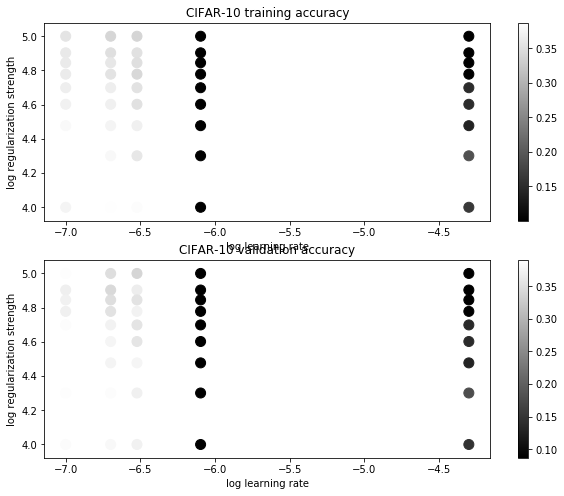

In [60]:
# Visualize the cross-validation results
import math
x_scatter = [math.log10(x[0]) for x in results]
y_scatter = [math.log10(x[1]) for x in results]

# plot training accuracy
marker_size = 100
colors = [results[x][0] for x in results]
plt.subplot(2, 1, 1)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel('log learning rate')
plt.ylabel('log regularization strength')
plt.title('CIFAR-10 training accuracy')

# plot validation accuracy
colors = [results[x][1] for x in results] # default size of markers is 20
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel('log learning rate')
plt.ylabel('log regularization strength')
plt.title('CIFAR-10 validation accuracy')
plt.show()

In [67]:
# Evaluate the best svm on test set
y_test_pred = best_svm.predict(X_test)
test_accuracy = np.mean(y_test == y_test_pred)
print 'linear SVM on raw pixels final test set accuracy: %f' % test_accuracy

linear SVM on raw pixels final test set accuracy: 0.103000


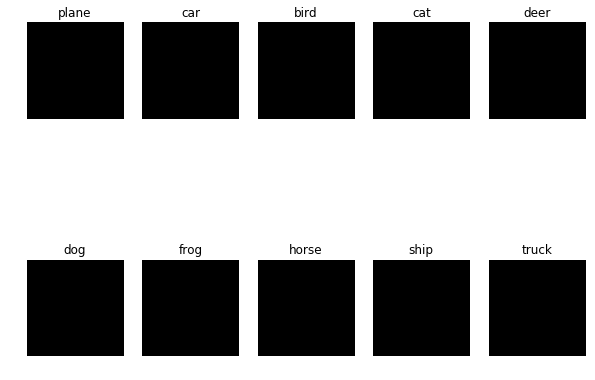

In [66]:
# Visualize the learned weights for each class.
# Depending on your choice of learning rate and regularization strength, these may
# or may not be nice to look at.
w = best_svm.W[:-1,:] # strip out the bias
w = w.reshape(32, 32, 3, 10)
w_min, w_max = np.min(w), np.max(w)
classes = ['plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
for i in xrange(10):
  plt.subplot(2, 5, i + 1)
    
  # Rescale the weights to be between 0 and 255
  wimg = 255.0 * (w[:, :, :, i].squeeze() - w_min) / (w_max - w_min)
  plt.imshow(wimg.astype('uint8'))
  plt.axis('off')
  plt.title(classes[i])

### Inline question 2:
Describe what your visualized SVM weights look like, and offer a brief explanation for why they look they way that they do.

**Your answer:** *fill this in*